In [92]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import math
from scipy.cluster import hierarchy
from sklearn.metrics.cluster import normalized_mutual_info_score
from sklearn import metrics

In [4]:
import scipy.io
import pandas as pd


mat = scipy.io.loadmat('rand.mat')
mat = {k:v for k, v in mat.items() if k[0] != '_'}
for k,v in mat.items():
    z=v[0]
df = pd.DataFrame(z[0][0], 
        columns=['x','y'])

Text(0.5, 1.0, 'Input Data')

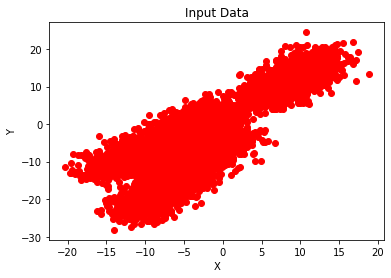

In [10]:
plt.plot(df.iloc[:, 0], df.iloc[:, 1],'ro')
plt.xlabel('X')
plt.ylabel('Y')
plt.title('Input Data')

# part a

In [29]:
def dist(a, b, ax=1):
    return np.linalg.norm(a - b, axis=ax)


def kmeans_clustering(data, k):
    center_x = np.random.randint(np.min(data[:, 0]), np.max(data[:, 0]), size=k)
    center_y = np.random.randint(np.min(data[:, 1]), np.max(data[:, 1]), size=k)
    centers = [list(a) for a in zip(center_x, center_y)]


    new_centers = []
    while not np.array_equal(new_centers, np.array(centers)):

        if new_centers:
            centers = new_centers
            new_centers = []

        clusters = np.zeros(len(data))
        for i in range(len(data)):
            distances = dist(data[i], centers)
            cluster = np.argmin(distances)
            clusters[i] = cluster

        colors = ['r', 'g', 'b', 'y', 'c', 'm', 'k']
        fig, ax = plt.subplots()

        for i in range(k):
            points = np.array([data[j] for j in range(len(data)) if clusters[j] == i])
            if points.size != 0:
                new_centers.append(np.mean(points, axis=0))
                ax.scatter(points[:, 0], points[:, 1], s=7, c=colors[i])

        ax.scatter(np.array(centers)[:, 0], np.array(centers)[:, 1], marker='*', s=200, c='#FAEBD7')
        plt.title('kmeans clustering with k=' + str(k))
        plt.xlabel('feature1')
        plt.ylabel('feature2')
        plt.show()

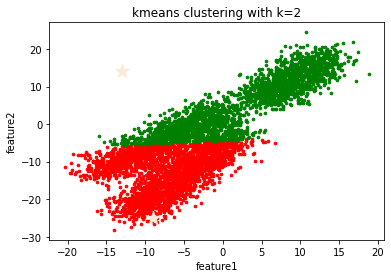

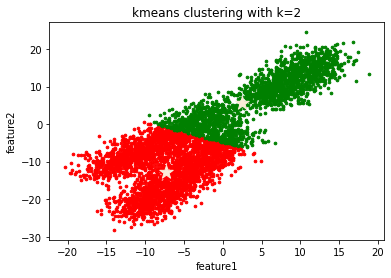

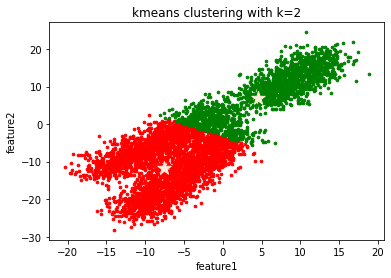

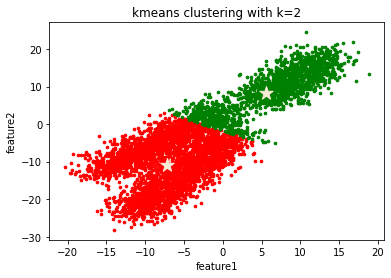

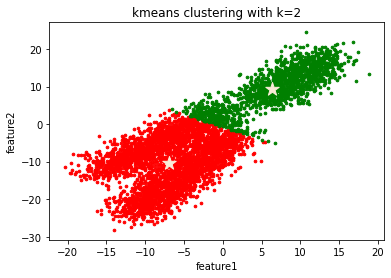

...

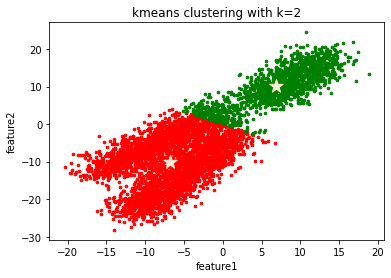

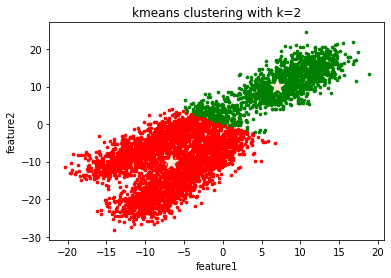

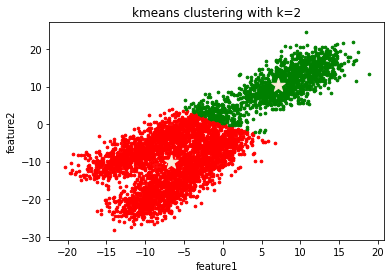

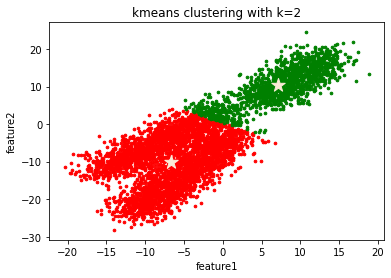

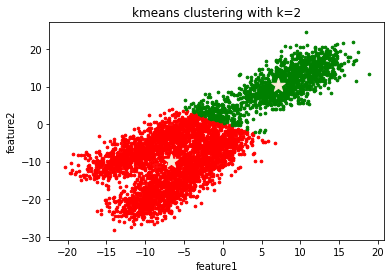

In [30]:
 kmeans_clustering(np.array(df), 2)

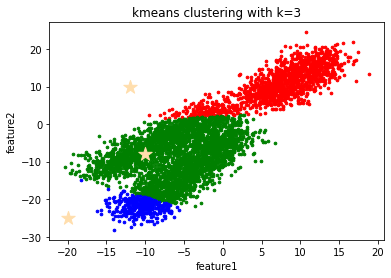

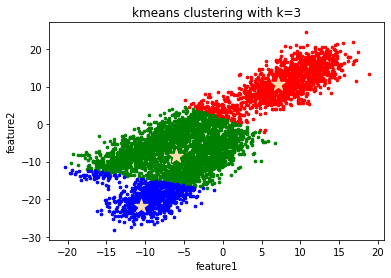

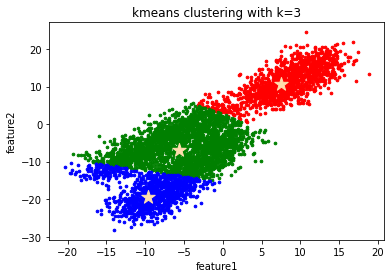

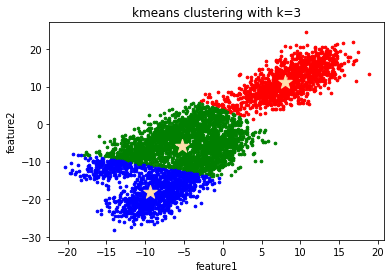

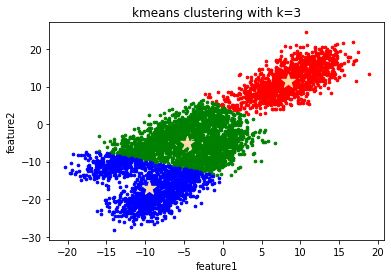

...

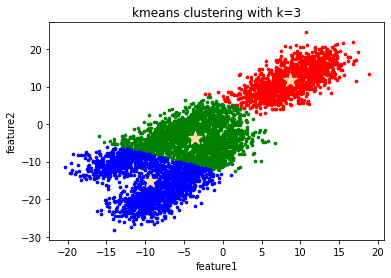

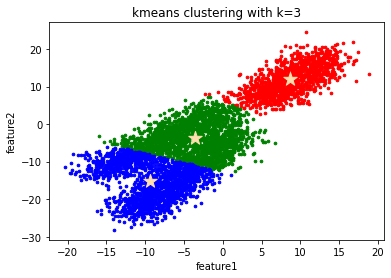

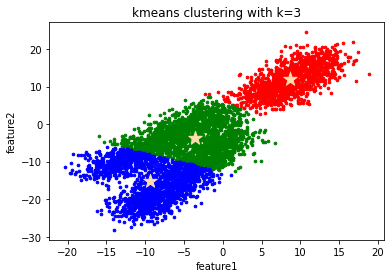

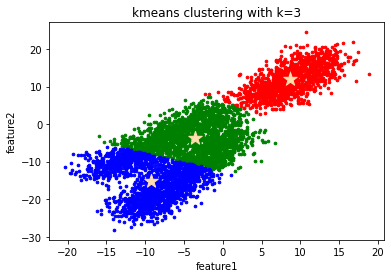

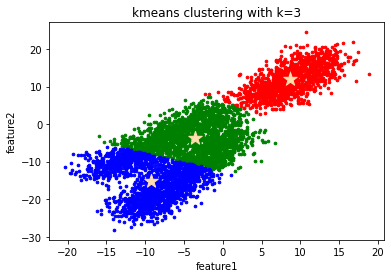

In [22]:
 kmeans_clustering(np.array(df), 3)

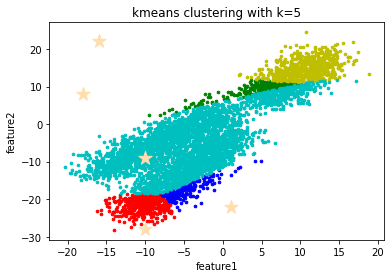

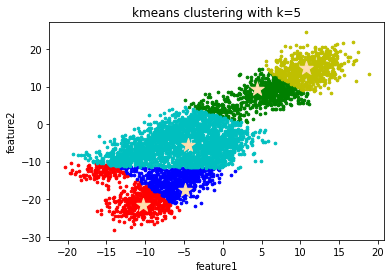

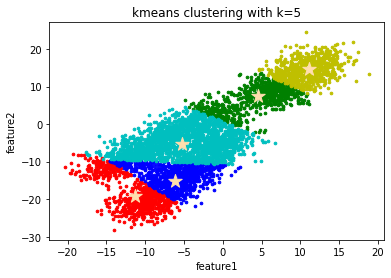

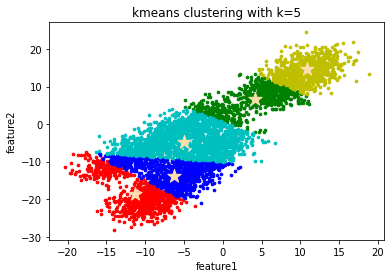

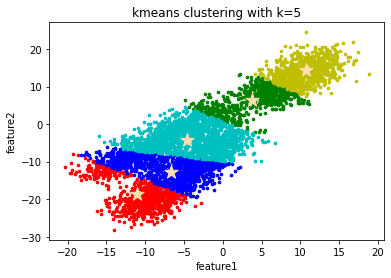

...

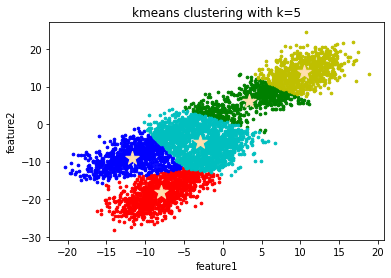

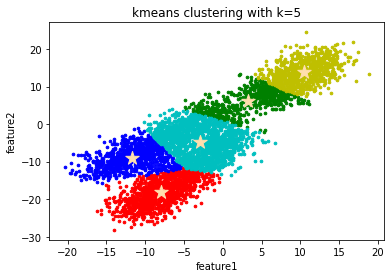

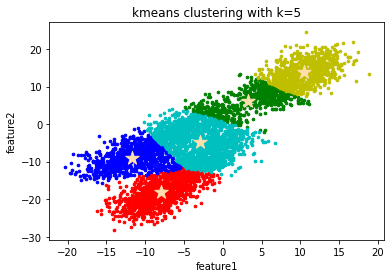

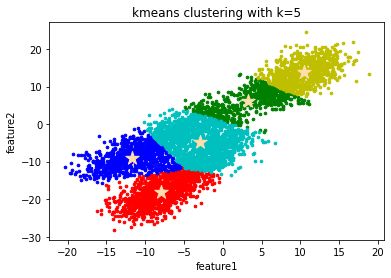

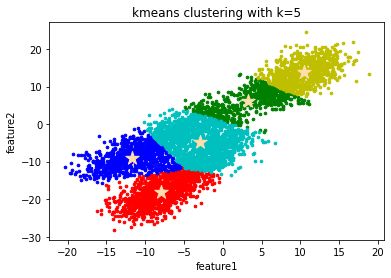

In [23]:
 kmeans_clustering(np.array(df), 5)

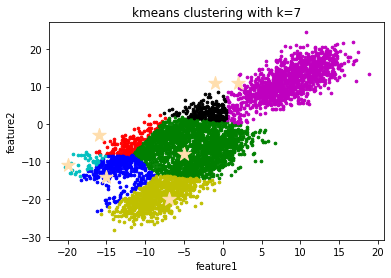

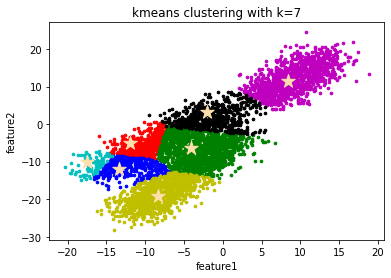

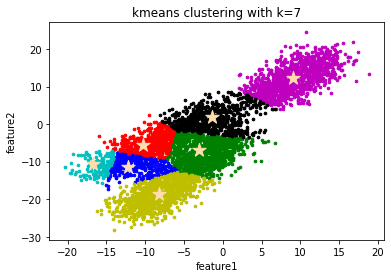

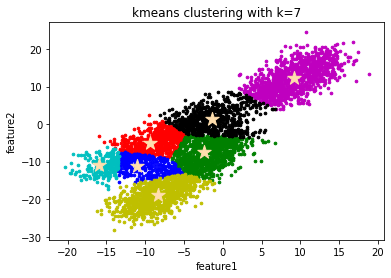

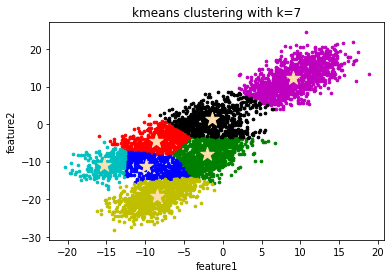

...

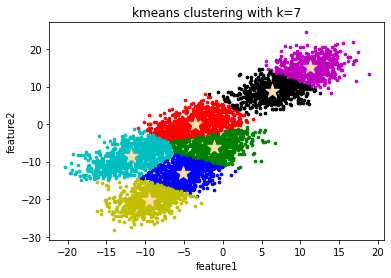

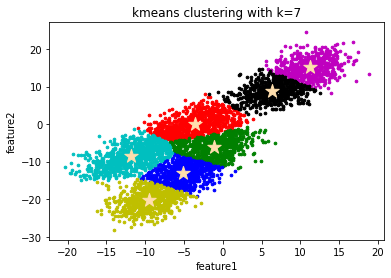

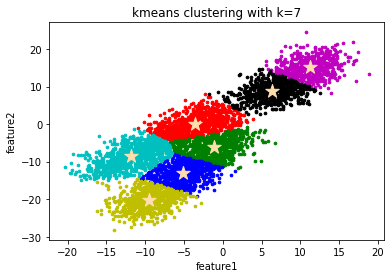

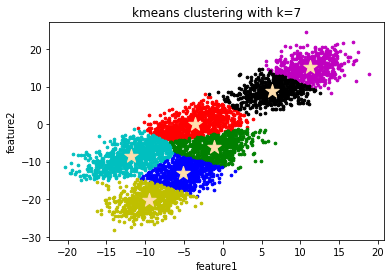

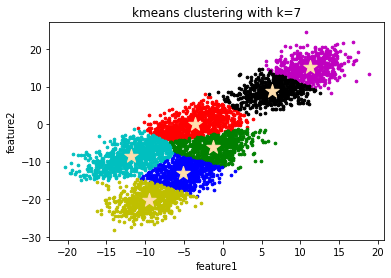

In [24]:
 kmeans_clustering(np.array(df), 7)

# part b

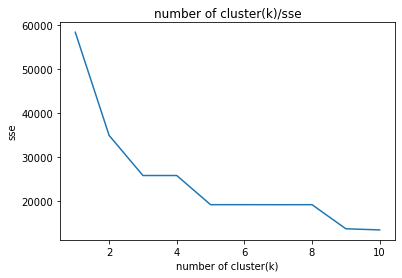

In [39]:
def dist(a, b, ax=1):
    return np.linalg.norm(a - b, axis=ax)
def kmeans_clustering(data, k):
    center_x = np.random.randint(np.min(data[:, 0]), np.max(data[:, 0]), size=k)
    center_y = np.random.randint(np.min(data[:, 1]), np.max(data[:, 1]), size=k)
    centers = [list(a) for a in zip(center_x, center_y)]

    new_centers = []
    while not np.array_equal(new_centers, np.array(centers)):
        if new_centers:
            centers = new_centers
            new_centers = []
        clusters = np.zeros(len(data))
        for i in range(len(data)):
            distances = dist(data[i], centers, 1)
            cluster = np.argmin(distances)
            clusters[i] = cluster

        for i in range(k):
            points = np.array([data[j] for j in range(len(data)) if clusters[j] == i])
            if points.size != 0:
                new_centers.append(np.mean(points, axis=0))

    sse = 0
    for i in range(k):
        points = np.array([data[j] for j in range(len(data)) if clusters[j] == i])
        for p in points:
            sse += dist(p, centers[i], None)

    return sse


k = range(1, 11)
sse = []
for value in k:
    sse.append(kmeans_clustering(np.array(df), value))

plt.plot(k, sse)
plt.title('number of cluster(k)/sse')
plt.xlabel('number of cluster(k)')
plt.ylabel('sse')
plt.show()

# part c

In [40]:
def dist(a, b, ax=1):
    return np.linalg.norm(a - b, axis=ax)


def kmedoids_clustering(data, k):
    centers = data[np.random.choice(data.shape[0], k, replace=False), :]

    plt.scatter(data[:, 0], data[:, 1], c='#050505', s=7)
    plt.scatter(centers[:, 0], centers[:, 1], marker='*', s=200, c='g')
    plt.title('original data with initialized random centroids')
    plt.xlabel('feature1')
    plt.ylabel('feature2')

    new_centers = []
    while not np.array_equal(new_centers, np.array(centers)):

        if new_centers:
            centers = new_centers
            new_centers = []

        clusters = np.zeros(len(data))
        for i in range(len(data)):
            distances = dist(data[i], centers, 1)
            cluster = np.argmin(distances)
            clusters[i] = cluster

        colors = ['r', 'g', 'b', 'y', 'c', 'm', 'k']
        fig, ax = plt.subplots()

        for i in range(k):
            points = np.array([data[j] for j in range(len(data)) if clusters[j] == i])
            if points.size != 0:
                distances = dist(np.mean(points, axis=0), points, 1)
                new_centers.append(points[np.argmin(distances)])
                ax.scatter(points[:, 0], points[:, 1], s=7, c=colors[i])

        ax.scatter(np.array(centers)[:, 0], np.array(centers)[:, 1], marker='*', s=200, c='#FFDEAD')
        plt.title('k-medoids clustering with k=' + str(k))
        plt.xlabel('feature1')
        plt.ylabel('feature2')
        plt.show()

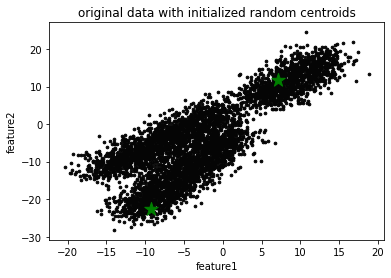

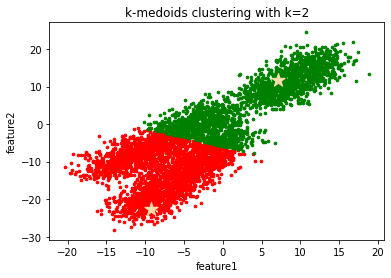

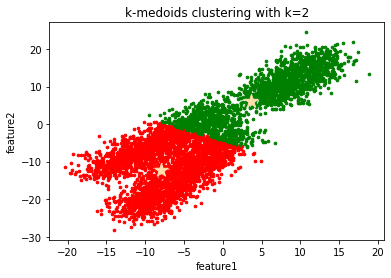

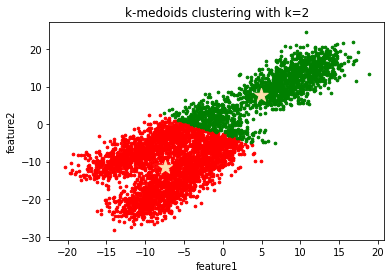

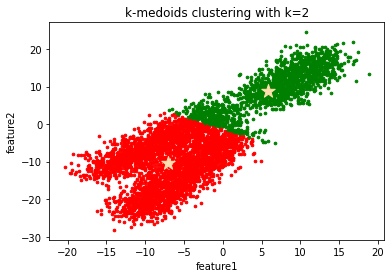

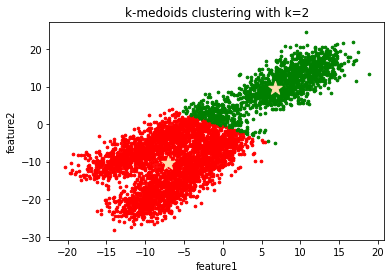

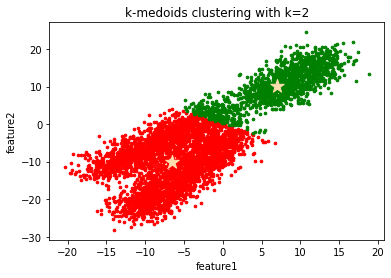

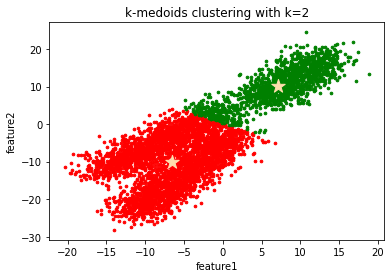

In [34]:
kmedoids_clustering(np.array(df), 2)

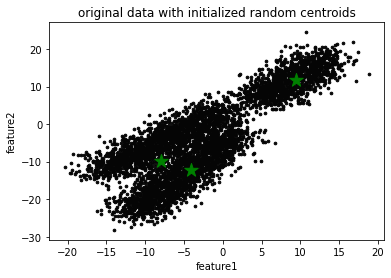

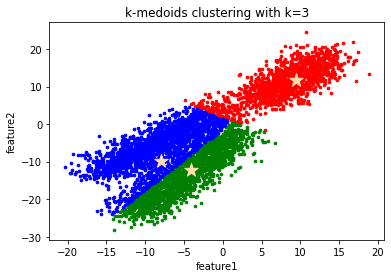

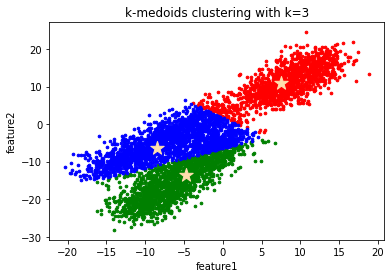

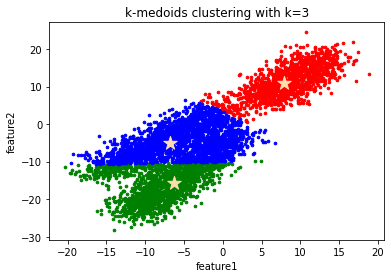

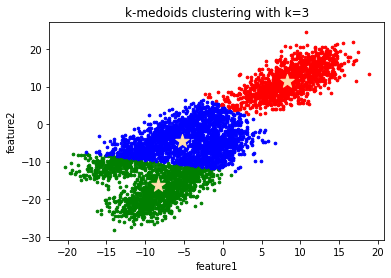

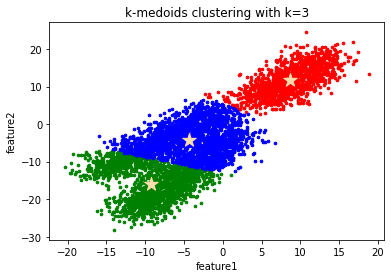

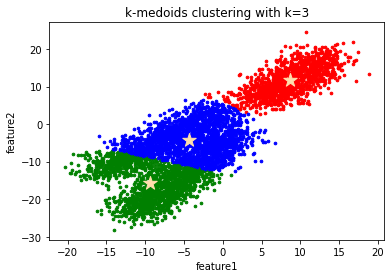

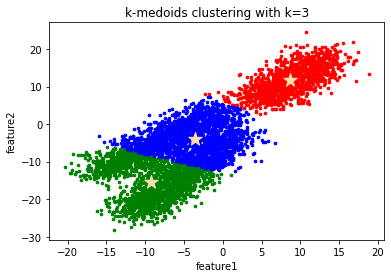

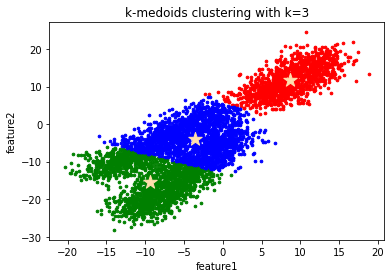

In [36]:
kmedoids_clustering(np.array(df), 3)

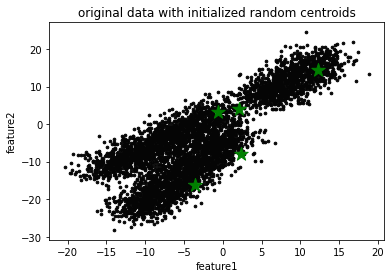

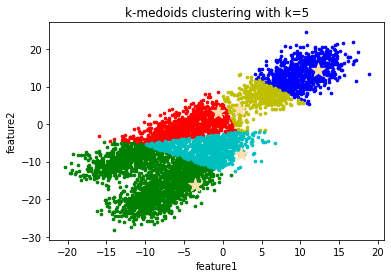

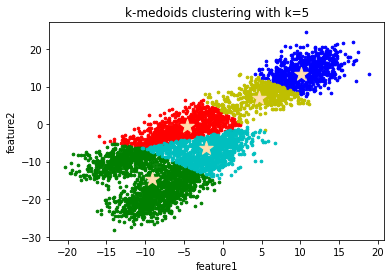

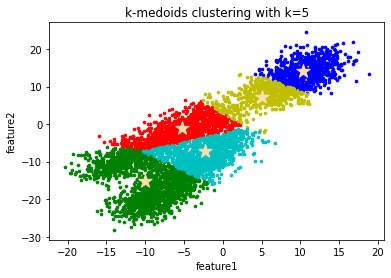

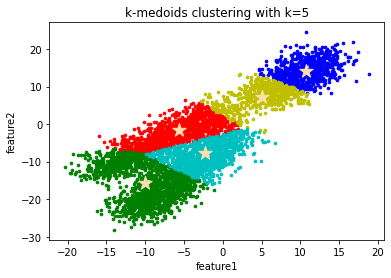

...

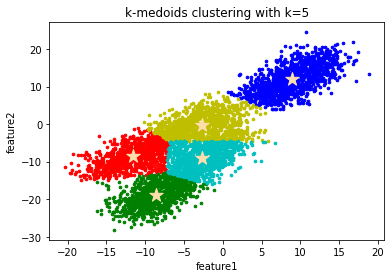

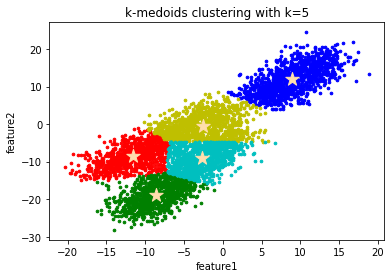

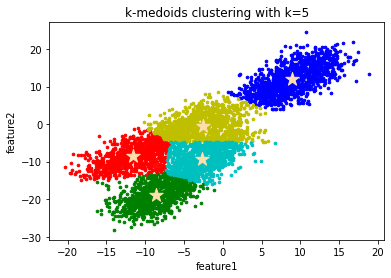

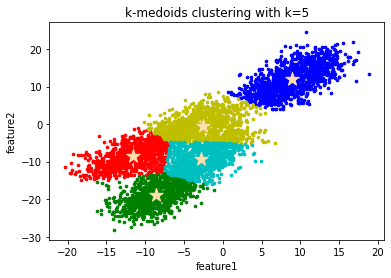

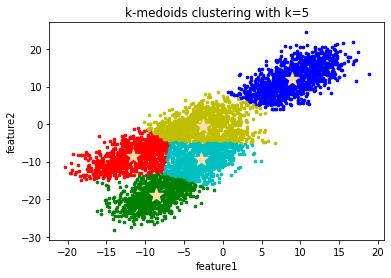

In [37]:
kmedoids_clustering(np.array(df), 5)

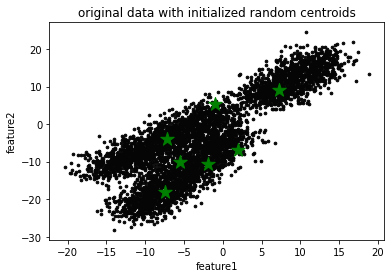

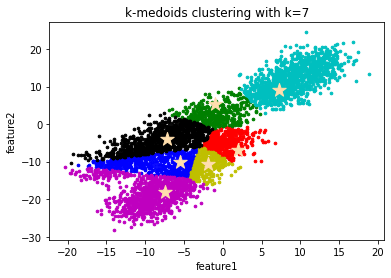

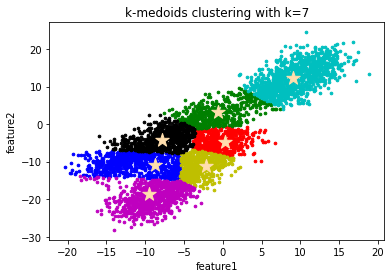

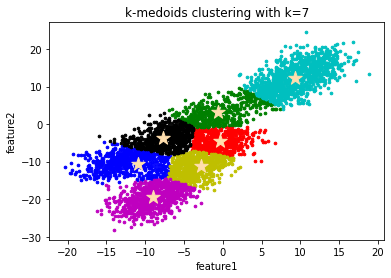

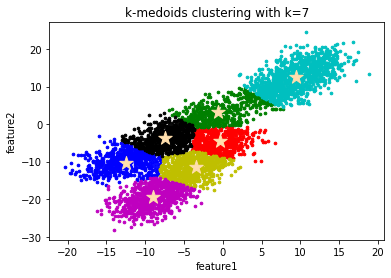

...

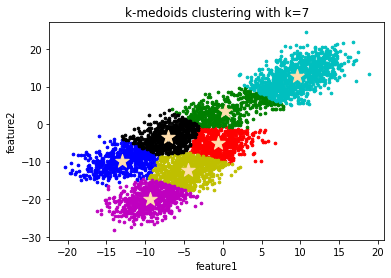

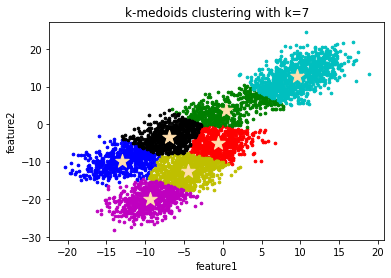

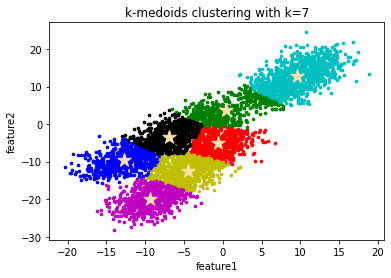

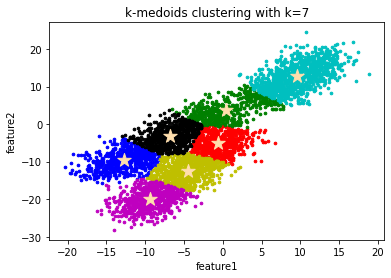

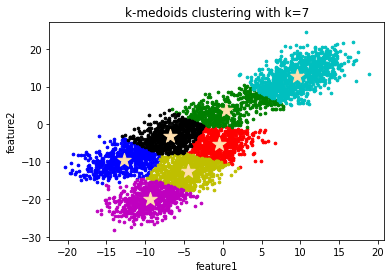

In [38]:
kmedoids_clustering(np.array(df), 7)

# part d

In [41]:
def euc_dist(a, b, ax=1):
    return np.linalg.norm(a - b, axis=ax)

def corr_dist(a, b):
    return 1 - np.corrcoef(a, b)[0, 1]

def find_minimum_index(distances):
    min_row_index = 0
    min_col_index = 0
    min_value = math.inf
    for i in range(len(distances)):
        for j in range(len(distances[i])):
            if distances[i][j] < min_value and i != j:
                min_row_index = i
                min_col_index = j
                min_value = distances[i][j]
    return min_row_index, min_col_index

In [42]:
def hierarchical_bottom_up_clustering_s_e(data):
    clusters = np.zeros(len(data))
    for i in range(len(data)):
        clusters[i] = i

    distances = [[0 for x in range(len(data))] for y in range(len(data))]

    for i in range(len(data)):
        for j in range(len(data)):
            distances[i][j] = euc_dist(data[i], data[j], None)

    for k in range(len(data) - 1):
        min_row_index, min_col_index = find_minimum_index(distances)
        for i in range(len(clusters)):
            if clusters[i] == min_col_index:
                clusters[i] = min_row_index
            if clusters[i] > min_col_index:
                clusters[i] -= 1

        print(min_row_index, '&', min_col_index, 'clusters were joined together in iteration', k + 1,
              'with new cluster number', min_row_index)

        print("data cluster numbers:", clusters)
        print('exp:first sample cluster number is', clusters[0])
        distances = single_linkage(distances, min_row_index, min_col_index)

In [43]:
def hierarchical_bottom_up_clustering_s_c(data):
    clusters = np.zeros(len(data))
    for i in range(len(data)):
        clusters[i] = i

    distances = [[0 for x in range(len(data))] for y in range(len(data))]
    for i in range(len(data)):
        for j in range(len(data)):
            distances[i][j] = corr_dist(data[i], data[j])
    for k in range(len(data) - 1):
        min_row_index, min_col_index = find_minimum_index(distances)
        for i in range(len(clusters)):
            if clusters[i] == min_col_index:
                clusters[i] = min_row_index
            if clusters[i] > min_col_index:
                clusters[i] -= 1
        print(min_row_index, '&', min_col_index, 'clusters were joined together in iteration', k + 1,
              'with new cluster number', min_row_index)
        print("data cluster numbers:", clusters)
        print('exp:first sample cluster number is', clusters[0])
        distances = single_linkage(distances, min_row_index, min_col_index)

In [44]:
def hierarchical_bottom_up_clustering_c_e(data):
    clusters = np.zeros(len(data))
    for i in range(len(data)):
        clusters[i] = i

    distances = [[0 for x in range(len(data))] for y in range(len(data))]

    for i in range(len(data)):
        for j in range(len(data)):
            distances[i][j] = euc_dist(data[i], data[j], None)

    for k in range(len(data) - 1):
        min_row_index, min_col_index = find_minimum_index(distances)
        for i in range(len(clusters)):
            if clusters[i] == min_col_index:
                clusters[i] = min_row_index
            if clusters[i] > min_col_index:
                clusters[i] -= 1
        print(min_row_index, '&', min_col_index, 'clusters were joined together in iteration', k + 1,
              'with new cluster number', min_row_index)
        print("data cluster numbers:", clusters)
        print('exp:first sample cluster number is', clusters[0])
        distances = complete_linkage(distances, min_row_index, min_col_index)
       

In [45]:
def hierarchical_bottom_up_clustering_c_c(data):
    clusters = np.zeros(len(data))
    for i in range(len(data)):
        clusters[i] = i

    distances = [[0 for x in range(len(data))] for y in range(len(data))]
    for i in range(len(data)):
        for j in range(len(data)):
            distances[i][j] = corr_dist(data[i], data[j])

    for k in range(len(data) - 1):
        min_row_index, min_col_index = find_minimum_index(distances)
        for i in range(len(clusters)):
            if clusters[i] == min_col_index:
                clusters[i] = min_row_index
            if clusters[i] > min_col_index:
                clusters[i] -= 1
        print(min_row_index, '&', min_col_index, 'clusters were joined together in iteration', k + 1,
              'with new cluster number', min_row_index)
        print("data cluster numbers:", clusters)
        print('exp:first sample cluster number is', clusters[0])
        distances = complete_linkage(distances, min_row_index, min_col_index)

In [46]:
def hierarchical_bottom_up_clustering_a_e(data):
    clusters = np.zeros(len(data))
    for i in range(len(data)):
        clusters[i] = i

    distances = [[0 for x in range(len(data))] for y in range(len(data))]
    for i in range(len(data)):
        for j in range(len(data)):
            distances[i][j] = euc_dist(data[i], data[j], None)

    for k in range(len(data) - 1):
        min_row_index, min_col_index = find_minimum_index(distances)
        for i in range(len(clusters)):
            if clusters[i] == min_col_index:
                clusters[i] = min_row_index
            if clusters[i] > min_col_index:
                clusters[i] -= 1
        print(min_row_index, '&', min_col_index, 'clusters were joined together in iteration', k + 1,
              'with new cluster number', min_row_index)
        print("data cluster numbers:", clusters)
        print('exp:first sample cluster number is', clusters[0])
        distances = average_linkage(distances, min_row_index, min_col_index)

In [47]:
def hierarchical_bottom_up_clustering_a_c(data):
    clusters = np.zeros(len(data))
    for i in range(len(data)):
        clusters[i] = i

    distances = [[0 for x in range(len(data))] for y in range(len(data))]
    for i in range(len(data)):
        for j in range(len(data)):
            distances[i][j] = corr_dist(data[i], data[j])

    for k in range(len(data) - 1):
        min_row_index, min_col_index = find_minimum_index(distances)
        for i in range(len(clusters)):
            if clusters[i] == min_col_index:
                clusters[i] = min_row_index
            if clusters[i] > min_col_index:
                clusters[i] -= 1

        print(min_row_index, '&', min_col_index, 'clusters were joined together in iteration', k + 1,
              'with new cluster number', min_row_index)

        print("data cluster numbers:", clusters)
        print('exp:first sample cluster number is', clusters[0])
        distances = average_linkage(distances, min_row_index, min_col_index)

In [48]:
def single_linkage(dist, c1, c2):
    distances = dist
    col1 = dist[:][c1]
    col2 = dist[:][c2]
    col1 = np.delete(col1, c2, 0)
    col2 = np.delete(col2, c2, 0)
    distances = np.delete(distances, c2, 0)
    distances = np.delete(distances, c2, 1)
    for i in range(0, c1):
        distances[c1][i] = np.min([dist[c1][i], dist[c2][i]])
        distances[i][c1] = np.min([dist[c1][i], dist[c2][i]])
    distances[c1][c1] = 0
    for i in range(c1 + 1, len(distances)):
        distances[c1][i] = np.min([col1[i], col2[i]])
        distances[i][c1] = np.min([col1[i], col2[i]])
    return distances


def complete_linkage(dist, c1, c2):
    distances = dist
    col1 = dist[:][c1]
    col2 = dist[:][c2]
    col1 = np.delete(col1, c2, 0)
    col2 = np.delete(col2, c2, 0)
    distances = np.delete(distances, c2, 0)
    distances = np.delete(distances, c2, 1)
    for i in range(0, c1):
        distances[c1][i] = np.max([dist[c1][i], dist[c2][i]])
        distances[i][c1] = np.max([dist[c1][i], dist[c2][i]])
    distances[c1][c1] = 0
    for i in range(c1 + 1, len(distances)):
        distances[c1][i] = np.max([col1[i], col2[i]])
        distances[i][c1] = np.max([col1[i], col2[i]])
    return distances


def average_linkage(dist, c1, c2):
    distances = dist
    col1 = dist[:][c1]
    col2 = dist[:][c2]
    col1 = np.delete(col1, c2, 0)
    col2 = np.delete(col2, c2, 0)
    distances = np.delete(distances, c2, 0)
    distances = np.delete(distances, c2, 1)
    for i in range(0, c1):
        distances[c1][i] = np.mean([dist[c1][i], dist[c2][i]])
        distances[i][c1] = np.mean([dist[c1][i], dist[c2][i]])
    distances[c1][c1] = 0
    for i in range(c1 + 1, len(distances)):
        distances[c1][i] = np.mean([col1[i], col2[i]])
        distances[i][c1] = np.mean([col1[i], col2[i]])
    return distances

In [49]:
data = pd.read_csv('gene_ex.csv', header=None)

In [52]:
hierarchical_bottom_up_clustering_s_e(np.array(data))

285 & 974 clusters were joined together in iteration 1 with new cluster number 285
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 17

276 & 664 clusters were joined together in iteration 3 with new cluster number 276
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 17

697 & 871 clusters were joined together in iteration 5 with new cluster number 697
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 17

111 & 826 clusters were joined together in iteration 7 with new cluster number 111
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 17

165 & 697 clusters were joined together in iteration 9 with new cluster number 165
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 17

98 & 216 clusters were joined together in iteration 11 with new cluster number 98
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 176

95 & 293 clusters were joined together in iteration 13 with new cluster number 95
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 176

111 & 638 clusters were joined together in iteration 15 with new cluster number 111
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

403 & 687 clusters were joined together in iteration 17 with new cluster number 403
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.  33. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 1

33 & 646 clusters were joined together in iteration 19 with new cluster number 33
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.  33. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 175

73 & 468 clusters were joined together in iteration 21 with new cluster number 73
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.  33. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 175

497 & 550 clusters were joined together in iteration 23 with new cluster number 497
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.  33. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 1

413 & 414 clusters were joined together in iteration 25 with new cluster number 413
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.  33. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 1

872 & 973 clusters were joined together in iteration 27 with new cluster number 872
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.  33. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 1

61 & 790 clusters were joined together in iteration 29 with new cluster number 61
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.  33. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 175

64 & 616 clusters were joined together in iteration 31 with new cluster number 64
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.  33. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 175

891 & 902 clusters were joined together in iteration 33 with new cluster number 891
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.  33. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 1

95 & 623 clusters were joined together in iteration 35 with new cluster number 95
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.  33. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 175

257 & 272 clusters were joined together in iteration 37 with new cluster number 257
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.  33. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 1

450 & 744 clusters were joined together in iteration 39 with new cluster number 450
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.  33. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 1

343 & 352 clusters were joined together in iteration 41 with new cluster number 343
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.  33. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 1

342 & 602 clusters were joined together in iteration 43 with new cluster number 342
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.  33.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163.  33. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 1

73 & 160 clusters were joined together in iteration 45 with new cluster number 73
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.  33.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159.  73. 160. 161. 162.  33. 163. 164.
 165. 166. 167. 168. 169. 170. 171. 172. 173

286 & 886 clusters were joined together in iteration 47 with new cluster number 286
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.  33.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159.  73. 160. 161. 162.  33. 163. 164.
 165. 166. 167. 168. 169. 170. 171. 172. 1

204 & 380 clusters were joined together in iteration 49 with new cluster number 204
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.  33.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159.  73. 160. 161. 162.  33. 163. 164.
 165. 166. 167. 168. 169. 170. 171. 172. 1

403 & 792 clusters were joined together in iteration 51 with new cluster number 403
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.  33.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159.  73. 160. 161. 162.  33. 163. 164.
 165. 166. 167. 168. 169. 170. 171. 172. 1

108 & 434 clusters were joined together in iteration 53 with new cluster number 108
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.  33.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159.  73. 160. 161. 162.  33. 163. 164.
 165. 166. 167. 168. 169. 170. 171. 172. 1

198 & 341 clusters were joined together in iteration 55 with new cluster number 198
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.  33.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159.  73. 160. 161. 162.  33. 163. 164.
 165. 166. 167. 168. 169. 170. 171. 172. 1

198 & 619 clusters were joined together in iteration 57 with new cluster number 198
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.  33.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159.  73. 160. 161. 162.  33. 163. 164.
 165. 166. 167. 168. 169. 170. 171. 172. 1

293 & 376 clusters were joined together in iteration 59 with new cluster number 293
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.  33.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159.  73. 160. 161. 162.  33. 163. 164.
 165. 166. 167. 168. 169. 170. 171. 172. 1

285 & 305 clusters were joined together in iteration 61 with new cluster number 285
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.  33.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159.  73. 160. 161. 162.  33. 163. 164.
 165. 166. 167. 168. 169. 170. 171. 172. 1

1 & 675 clusters were joined together in iteration 63 with new cluster number 1
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.  33.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159.  73. 160. 161. 162.  33. 163. 164.
 165. 166. 167. 168. 169. 170. 171. 172. 173. 

1 & 167 clusters were joined together in iteration 65 with new cluster number 1
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.  33.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159.  73. 160. 161. 162.  33. 163. 164.
 165. 166.   1. 167. 168. 169. 170. 171. 172. 

73 & 386 clusters were joined together in iteration 67 with new cluster number 73
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.  33.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159.  73. 160. 161. 162.  33. 163. 164.
 165. 166.   1. 167. 168. 169. 170. 171. 172

403 & 601 clusters were joined together in iteration 69 with new cluster number 403
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.  33.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159.  73. 160. 161. 162.  33. 163. 164.
 165. 166.   1. 167. 168. 169. 170. 171. 1

676 & 896 clusters were joined together in iteration 71 with new cluster number 676
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.  33.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159.  73. 160. 161. 162.  33. 163. 164.
 165. 166.   1. 167. 168. 169. 170. 171. 1

184 & 364 clusters were joined together in iteration 73 with new cluster number 184
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.  33.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159.  73. 160. 161. 162.  33. 163. 164.
 165. 166.   1. 167. 168. 169. 170. 171. 1

304 & 373 clusters were joined together in iteration 75 with new cluster number 304
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.  33.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159.  73. 160. 161. 162.  33. 163. 164.
 165. 166.   1. 167. 168. 169. 170. 171. 1

73 & 108 clusters were joined together in iteration 77 with new cluster number 73
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107.  73. 108. 109.  33.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158.  73. 159. 160. 161.  33. 162. 163.
 164. 165.   1. 166. 167. 168. 169. 170. 171

280 & 611 clusters were joined together in iteration 79 with new cluster number 280
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107.  73. 108. 109.  33.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158.  73. 159. 160. 161.  33. 162. 163.
 164. 165.   1. 166. 167. 168. 169. 170. 1

33 & 427 clusters were joined together in iteration 81 with new cluster number 33
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107.  73. 108. 109.  33.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158.  73. 159. 160. 161.  33. 162. 163.
 164. 165.   1. 166. 167. 168. 169. 170. 171

83 & 722 clusters were joined together in iteration 83 with new cluster number 83
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107.  73. 108. 109.  33.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158.  73. 159. 160. 161.  33. 162. 163.
 164. 165.   1. 166. 167. 168. 169. 170. 171

95 & 97 clusters were joined together in iteration 85 with new cluster number 95
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  95.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.  73. 107. 108.  33.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157.  73. 158. 159. 160.  33. 161. 162.
 163. 164.   1. 165. 166. 167. 168. 169. 170.

194 & 580 clusters were joined together in iteration 87 with new cluster number 194
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  95.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.  73. 107. 108.  33.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157.  73. 158. 159. 160.  33. 161. 162.
 163. 164.   1. 165. 166. 167. 168. 169. 1

194 & 251 clusters were joined together in iteration 89 with new cluster number 194
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  95.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.  73. 107. 108.  33.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157.  73. 158. 159. 160.  33. 161. 162.
 163. 164.   1. 165. 166. 167. 168. 169. 1

95 & 394 clusters were joined together in iteration 91 with new cluster number 95
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  95.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.  73. 107. 108.  33.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157.  73. 158. 159. 160.  33. 161. 162.
 163. 164.   1. 165. 166. 167. 168. 169. 170

61 & 110 clusters were joined together in iteration 93 with new cluster number 61
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  95.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.  73. 107. 108.  33.
 109.  61. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135.
 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149.
 150. 151. 152. 153. 154. 155. 156.  73. 157. 158. 159.  33. 160. 161.
 162. 163.   1. 164. 165. 166. 167. 168. 169

192 & 801 clusters were joined together in iteration 95 with new cluster number 192
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  95.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.  73. 107. 108.  33.
 109.  61. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135.
 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149.
 150. 151. 152. 153. 154. 155. 156.  73. 157. 158. 159.  33. 160. 161.
 162. 163.   1. 164. 165. 166. 167. 168. 1

95 & 860 clusters were joined together in iteration 97 with new cluster number 95
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  95.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.  73. 107. 108.  33.
 109.  61. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135.
 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149.
 150. 151. 152. 153. 154. 155. 156.  73. 157. 158. 159.  33. 160. 161.
 162. 163.   1. 164. 165. 166. 167. 168. 169

192 & 281 clusters were joined together in iteration 99 with new cluster number 192
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  95.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.  73. 107. 108.  33.
 109.  61. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135.
 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149.
 150. 151. 152. 153. 154. 155. 156.  73. 157. 158. 159.  33. 160. 161.
 162. 163.   1. 164. 165. 166. 167. 168. 1

305 & 800 clusters were joined together in iteration 101 with new cluster number 305
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  95.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.  73. 107. 108.  33.
 109.  61. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135.
 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149.
 150. 151. 152. 153. 154. 155. 156.  73. 157. 158. 159.  33. 160. 161.
 162. 163.   1. 164. 165. 166. 167. 168. 

29 & 33 clusters were joined together in iteration 103 with new cluster number 29
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  29.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  94.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.  72. 106. 107.  29.
 108.  60. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155.  72. 156. 157. 158.  29. 159. 160.
 161. 162.   1. 163. 164. 165. 166. 167. 168

153 & 196 clusters were joined together in iteration 105 with new cluster number 153
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  29.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  94.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.  72. 106. 107.  29.
 108.  60. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155.  72. 156. 157. 158.  29. 159. 160.
 161. 162.   1. 163. 164. 165. 166. 167. 

29 & 406 clusters were joined together in iteration 107 with new cluster number 29
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  29.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  94.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.  72. 106. 107.  29.
 108.  60. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125.  29. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147.
 148. 149. 150. 151. 152. 153. 154.  72. 155. 156. 157.  29. 158. 159.
 160. 161.   1. 162. 163. 164. 165. 166. 16

438 & 764 clusters were joined together in iteration 109 with new cluster number 438
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  29.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  94.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.  72. 106. 107.  29.
 108.  60. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125.  29. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147.
 148. 149. 150. 151. 152. 153. 154.  72. 155. 156. 157.  29. 158. 159.
 160. 161.   1. 162. 163. 164. 165. 166. 

93 & 373 clusters were joined together in iteration 111 with new cluster number 93
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  29.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  83.  84.  85.  29.  86.  87.  88.  89.  90.  91.  92.  93.  94.  93.
  95.  96.  97.  98.  99. 100. 101. 102. 103. 104.  72. 105. 106.  29.
 107.  60. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124.  29. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146.
 147. 148. 149. 150. 151. 152. 153.  72. 154. 155. 156.  29. 157. 158.
 159. 160.   1. 161. 162. 163. 164. 165. 16

29 & 412 clusters were joined together in iteration 113 with new cluster number 29
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  29.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  83.  84.  85.  29.  86.  87.  88.  89.  90.  91.  92.  93.  94.  93.
  95.  96.  97.  98.  99. 100. 101. 102. 103. 104.  72. 105. 106.  29.
 107.  60. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124.  29. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146.
 147. 148. 149. 150. 151. 152. 153.  72. 154. 155. 156.  29. 157. 158.
 159. 160.   1. 161. 162. 163. 164. 165. 16

29 & 686 clusters were joined together in iteration 115 with new cluster number 29
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  29.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  83.  84.  85.  29.  86.  87.  88.  89.  90.  91.  92.  93.  94.  93.
  95.  96.  97.  98.  99. 100. 101. 102. 103. 104.  72. 105. 106.  29.
 107.  60. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124.  29. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146.
 147. 148. 149. 150. 151. 152. 153.  72. 154. 155. 156.  29. 157. 158.
 159. 160.   1. 161. 162. 163. 164. 165. 16

209 & 382 clusters were joined together in iteration 117 with new cluster number 209
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  29.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  83.  84.  85.  29.  86.  87.  88.  89.  90.  91.  92.  93.  94.  93.
  95.  96.  97.  98.  99. 100. 101. 102. 103. 104.  72. 105. 106.  29.
 107.  60. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124.  29. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146.
 147. 148. 149. 150. 151. 152. 153.  72. 154. 155. 156.  29. 157. 158.
 159. 160.   1. 161. 162. 163. 164. 165. 

93 & 194 clusters were joined together in iteration 119 with new cluster number 93
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  29.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  83.  84.  85.  29.  86.  87.  88.  89.  90.  91.  92.  93.  94.  93.
  95.  96.  97.  98.  99. 100. 101. 102. 103. 104.  72. 105. 106.  29.
 107.  60. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124.  29. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146.
 147. 148. 149. 150. 151. 152. 153.  72. 154. 155. 156.  29. 157. 158.
 159. 160.   1. 161. 162. 163. 164. 165. 16

155 & 297 clusters were joined together in iteration 121 with new cluster number 155
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  29.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  83.  84.  85.  29.  86.  87.  88.  89.  90.  91.  92.  93.  94.  93.
  95.  96.  97.  98.  99. 100. 101. 102. 103. 104.  72. 105. 106.  29.
 107.  60. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124.  29. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146.
 147. 148. 149. 150. 151. 152. 153.  72. 154. 155. 156.  29. 157. 158.
 159. 160.   1. 161. 162. 163. 164. 165. 

579 & 722 clusters were joined together in iteration 124 with new cluster number 579
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  29.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  29.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  29.  85.  86.  87.  88.  89.  90.  91.  92.  93.  92.
  94.  95.  96.  97.  98.  99. 100. 101. 102. 103.  72. 104. 105.  29.
 106.  60. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123.  29. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145.
 146. 147. 148. 149. 150. 151. 152.  72. 153. 154. 155.  29. 156. 157.
 158. 159.   1. 160. 161. 162. 163. 164. 

150 & 670 clusters were joined together in iteration 126 with new cluster number 150
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  29.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  29.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  29.  85.  86.  87.  88.  89.  90.  91.  92.  93.  92.
  94.  95.  96.  97.  98.  99. 100. 101. 102. 103.  72. 104. 105.  29.
 106.  60. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123.  29. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145.
 146. 147. 148. 149. 150. 151. 152.  72. 153. 154. 155.  29. 156. 157.
 158. 159.   1. 160. 161. 162. 163. 164. 

29 & 700 clusters were joined together in iteration 129 with new cluster number 29
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  29.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  29.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  29.  85.  86.  87.  88.  89.  90.  91.  29.  92.  29.
  93.  94.  95.  96.  97.  98.  99. 100. 101. 102.  72. 103. 104.  29.
 105.  60. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122.  29. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144.
 145. 146. 147. 148. 149. 150. 151.  72. 152. 153. 154.  29. 155. 156.
 157. 158.   1. 159. 160. 161. 162. 163. 16

168 & 544 clusters were joined together in iteration 131 with new cluster number 168
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  29.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  29.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  29.  85.  86.  87.  88.  89.  90.  91.  29.  92.  29.
  93.  94.  95.  96.  97.  98.  99. 100. 101. 102.  72. 103. 104.  29.
 105.  60. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122.  29. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144.
 145. 146. 147. 148.  72. 149. 150.  72. 151. 152. 153.  29. 154. 155.
 156. 157.   1. 158. 159. 160. 161. 162. 

29 & 259 clusters were joined together in iteration 133 with new cluster number 29
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  29.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  29.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  29.  85.  86.  87.  88.  89.  90.  91.  29.  92.  29.
  93.  94.  95.  96.  97.  98.  99. 100. 101. 102.  72. 103. 104.  29.
 105.  60. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122.  29. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144.
 145. 146. 147. 148.  72. 149. 150.  72. 151. 152. 153.  29. 154. 155.
 156. 157.   1. 158. 159. 160. 161. 162. 16

29 & 102 clusters were joined together in iteration 135 with new cluster number 29
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  29.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  29.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  29.  72.  73.  74.  75.  76.  77.  78.  79.  80.
  81.  82.  83.  29.  84.  85.  86.  87.  88.  89.  90.  29.  91.  29.
  92.  93.  94.  95.  96.  97.  98.  99. 100. 101.  71.  29. 102.  29.
 103.  59. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120.  29. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.
 143. 144. 145. 146.  71. 147. 148.  71. 149. 150. 151.  29. 152. 153.
 154. 155.   1. 156. 157. 158. 159. 160. 16

29 & 692 clusters were joined together in iteration 138 with new cluster number 29
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  29.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  29.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  29.  72.  73.  74.  75.  76.  77.  78.  79.  80.
  81.  82.  83.  29.  84.  85.  86.  87.  88.  89.  90.  29.  91.  29.
  92.  93.  94.  95.  96.  97.  98.  99. 100. 101.  71.  29. 102.  29.
 103.  59. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120.  29. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.
 143. 144. 145. 146.  71. 147. 148.  71. 149. 150. 151.  29. 152. 153.
 154. 155.   1. 156. 157. 158. 159. 160. 16

29 & 71 clusters were joined together in iteration 141 with new cluster number 29
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  29.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  29.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  29.  29.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  29.  83.  84.  85.  86.  87.  88.  89.  29.  90.  29.
  91.  92.  93.  94.  95.  96.  97.  98.  99. 100.  29.  29. 101.  29.
 102.  59. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119.  29. 120. 121. 122. 123. 124. 125. 126. 127.
 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141.
 142. 143. 144. 145.  29. 146. 147.  29. 148. 149. 150.  29. 151. 152.
 153. 154.   1. 155. 156. 157. 158. 159. 160

29 & 279 clusters were joined together in iteration 143 with new cluster number 29
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  29.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  29.  58.  59.  60.  61.  29.  62.  63.  64.  65.  66.
  67.  68.  69.  29.  29.  70.  71.  72.  73.  74.  75.  76.  77.  78.
  79.  80.  81.  29.  82.  83.  84.  85.  86.  87.  88.  29.  89.  29.
  90.  91.  92.  93.  94.  95.  96.  97.  98.  99.  29.  29. 100.  29.
 101.  59. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113.
 114. 115. 116. 117. 118.  29. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140.
 141. 142. 143. 144.  29. 145. 146.  29. 147. 148. 149.  29. 150. 151.
 152. 153.   1. 154. 155. 156. 157. 158. 15

344 & 768 clusters were joined together in iteration 145 with new cluster number 344
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.   2.  29.  30.  31.   2.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.   2.  57.  58.  59.  60.   2.  61.  62.  63.  64.  65.
  66.  67.  68.   2.   2.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.   2.  81.  82.  83.  84.  85.  86.  87.   2.  88.   2.
  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.   2.   2.  99.   2.
 100.  58. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117.   2. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143.   2. 144. 145.   2. 146. 147. 148.   2. 149. 150.
 151. 152.   1. 153. 154. 155. 156. 157. 

2 & 565 clusters were joined together in iteration 147 with new cluster number 2
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.   2.  29.  30.  31.   2.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.   2.  57.  58.  59.  60.   2.  61.  62.  63.  64.  65.
  66.  67.  68.   2.   2.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.   2.  81.  82.  83.  84.  85.  86.  87.   2.  88.   2.
  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.   2.   2.  99.   2.
 100.  58. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117.   2. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143.   2. 144. 145.   2. 146. 147. 148.   2. 149. 150.
 151. 152.   1. 153. 154. 155. 156. 157. 158.

2 & 96 clusters were joined together in iteration 149 with new cluster number 2
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.   2.  29.  30.  31.   2.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.   2.  57.  58.  59.  60.   2.  61.  62.  63.  64.  65.
  66.  67.  68.   2.   2.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.   2.  81.  82.  83.  84.  85.  86.  87.   2.  88.   2.
  89.  90.  91.  92.  93.  94.  95.   2.  96.  97.   2.   2.  98.   2.
  99.  58. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116.   2. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142.   2. 143. 144.   2. 145. 146. 147.   2. 148. 149.
 150. 151.   1. 152. 153. 154. 155. 156. 157. 

2 & 254 clusters were joined together in iteration 151 with new cluster number 2
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.   2.  29.  30.  31.   2.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.   2.  57.  58.  59.  60.   2.  61.  62.  63.  64.  65.
  66.  67.  68.   2.   2.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.   2.  81.  82.  83.  84.  85.  86.  87.   2.  88.   2.
  89.  90.  91.  92.  93.  94.  95.   2.  96.  97.   2.   2.  98.   2.
  99.  58. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116.   2. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142.   2. 143. 144.   2. 145. 146. 147.   2. 148. 149.
 150. 151.   1. 152. 153. 154. 155. 156. 157.

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.   2.  29.  30.  31.   2.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.   2.  57.  58.  59.  60.   2.  61.  62.  63.  64.  65.
  66.  67.  68.   2.   2.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.   2.  81.  82.  83.  84.  85.  86.  87.   2.  88.   2.
  89.  90.  91.  92.  93.  94.  95.   2.  96.  97.   2.   2.  98.   2.
  99.  58. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116.   2. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142.   2. 143. 144.   2. 145. 146. 147.   2. 148. 149.
 150. 151.   1. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
 163.   2.   2. 164. 165. 166. 167. 168.   2. 169. 170.

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.   2.  29.  30.  31.   2.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.   2.  57.  58.  59.  60.   2.  61.  62.  63.  64.  65.
  66.  67.  68.   2.   2.  69.  70.  71.  72.  73.  74.  75.  76.   2.
  77.  78.  79.   2.  80.  81.  82.  83.  84.  85.  86.   2.  87.   2.
  88.  89.  90.  91.  92.  93.  94.   2.  95.  96.   2.   2.  97.   2.
  98.  58.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115.   2. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141.   2. 142. 143.   2. 144. 145. 146.   2. 147. 148.
 149. 150.   1. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161.
 162.   2.   2. 163. 164. 165. 166. 167.   2. 168. 169.

88 & 318 clusters were joined together in iteration 157 with new cluster number 88
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.   2.  29.  30.  31.   2.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.   2.  57.  58.  59.  60.   2.  61.  62.  63.  64.  65.
  66.  67.  68.   2.   2.  69.  70.  71.  72.  73.  74.  75.  76.   2.
  77.  78.  79.   2.  80.  81.  82.  83.  84.  85.  86.   2.  87.   2.
  88.  89.  90.  91.  92.  93.  94.   2.  95.  96.   2.   2.  97.   2.
  98.  58.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115.   2. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141.   2. 142. 143.   2. 144.   5. 145.   2. 146. 147.
 148. 149.   1. 150. 151. 152. 153. 154. 15

366 & 821 clusters were joined together in iteration 159 with new cluster number 366
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.   2.  29.  30.  31.   2.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.   2.  57.  58.  59.  60.   2.  61.  62.  63.  64.  65.
  66.  67.  68.   2.   2.  69.  70.  71.  72.  73.  74.  75.  76.   2.
  77.  78.  79.   2.  80.  81.  82.  83.  84.  85.  86.   2.  87.   2.
  88.  89.  90.  91.  92.  93.  94.   2.  95.  96.   2.   2.  97.   2.
  98.  58.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115.   2. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141.   2. 142. 143.   2. 144.   5. 145.   2. 146. 147.
 148. 149.   1. 150. 151. 152. 153. 154. 

2 & 528 clusters were joined together in iteration 161 with new cluster number 2
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.   2.  29.  30.  31.   2.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.   2.  57.  58.  59.  60.   2.  61.  62.  63.  64.  65.
  66.  67.  68.   2.   2.  69.  70.  71.  72.  73.  74.  75.  76.   2.
  77.  78.  79.   2.  80.  81.  82.  83.  84.  85.  86.   2.  87.   2.
  88.  89.  90.  91.  92.  93.  94.   2.  95.  96.   2.   2.  97.   2.
  98.  58.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115.   2. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141.   2. 142. 143.   2. 144.   5. 145.   2. 146. 147.
 148. 149.   1. 150. 151. 152. 153. 154. 155.

2 & 332 clusters were joined together in iteration 164 with new cluster number 2
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.   2.  29.  30.  31.   2.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.   2.  57.  58.  59.  60.   2.  61.  62.  63.  64.  65.
  66.  67.  68.   2.   2.  69.  70.  71.  72.  73.  74.  75.  76.   2.
  77.  78.  79.   2.  80.  81.  82.  83.  84.  85.  86.   2.  87.   2.
  88.  89.  90.  91.  92.  93.  94.   2.  95.  96.   2.   2.  97.   2.
  98.  58.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115.   2. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141.   2. 142. 143.   2. 144.   5. 145.   2. 146. 147.
 148. 149.   1. 150. 151.   2. 152. 153. 154.

2 & 684 clusters were joined together in iteration 167 with new cluster number 2
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.   2.  29.  30.  31.   2.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.   2.  57.  58.  59.  60.   2.  61.  62.  63.  64.  65.
  66.  67.  68.   2.   2.  69.  70.  71.  72.  73.  74.  75.  76.   2.
  77.  78.  79.   2.  80.  81.  82.  83.  84.  85.  86.   2.  87.   2.
  88.  89.  90.  91.  92.  93.  94.   2.  95.  96.   2.   2.  97.   2.
  98.  58.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115.   2. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141.   2. 142. 143.   2. 144.   5. 145.   2. 146. 147.
 148. 149.   1. 150. 151.   2. 152. 153. 154.

31 & 606 clusters were joined together in iteration 169 with new cluster number 31
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.   2.  29.  30.  31.   2.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.   2.  57.  58.  59.  60.   2.  61.  62.  63.  64.  65.
  66.  67.  68.   2.   2.  69.  70.  71.  72.  73.  74.  75.  76.   2.
  77.  78.  79.   2.  80.  81.  82.  83.  84.  85.  86.   2.  87.   2.
  88.  89.  90.  91.  92.  93.  94.   2.  95.  96.   2.   2.  97.   2.
  98.  58.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115.   2. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130.   2. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140.   2. 141. 142.   2. 143.   5. 144.   2. 145. 146.
 147. 148.   1. 149. 150.   2. 151. 152. 15

2 & 66 clusters were joined together in iteration 172 with new cluster number 2
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.   2.  29.  30.  31.   2.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.   2.  57.   2.  58.  59.   2.  60.  61.  62.  63.  64.
  65.   2.  66.   2.   2.  67.  68.  69.  70.  71.  72.  73.  74.   2.
  75.  76.  77.   2.  78.  79.  80.  81.  82.  83.  84.   2.  85.   2.
  86.  87.  88.  89.  90.  91.  92.   2.  93.  94.   2.   2.  95.   2.
  96.   2.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113.   2. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128.   2. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138.   2. 139. 140.   2. 141.   5. 142.   2. 143. 144.
 145. 146.   1. 147. 148.   2. 149. 150. 151. 

2 & 824 clusters were joined together in iteration 174 with new cluster number 2
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.   2.  29.  30.  31.   2.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.   2.  57.   2.  58.  59.   2.  60.  61.  62.  63.  64.
  65.   2.  66.   2.   2.  67.  68.  69.  70.  71.  72.  73.  74.   2.
  75.  76.  77.   2.  78.  79.  80.  81.  82.  83.  84.   2.  85.   2.
  86.  87.  88.  89.  90.  91.  92.   2.  93.  94.   2.   2.  95.   2.
  96.   2.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113.   2. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128.   2. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138.   2. 139. 140.   2. 141.   5. 142.   2. 143. 144.
 145. 146.   1. 147. 148.   2. 149. 150. 151.

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
   2.   2.  28.  29.  30.   2.  31.  32.  33.  34.  35.  36.  37.  38.
  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.
  53.  54.  55.   2.  56.   2.  57.  58.   2.  59.  60.  61.  62.  63.
  64.   2.  65.   2.   2.  66.  67.  68.  69.  70.  71.  72.  73.   2.
  74.  75.  76.   2.  77.  78.  79.  80.  81.  82.  83.   2.  84.   2.
  85.  86.  87.  88.  89.  90.  91.   2.  92.  93.   2.   2.  94.   2.
  95.   2.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112.   2. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127.   2. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137.   2. 138. 139.   2. 140.   5. 141.   2. 142. 143.
 144. 145.   1. 146. 147.   2. 148. 149. 150. 151. 152. 153. 154. 155.
 156.   2.   2. 157. 158. 159. 160. 161.   2. 162. 163.

249 & 691 clusters were joined together in iteration 178 with new cluster number 249
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
   2.   2.  28.  29.  30.   2.  31.  32.  33.  34.  35.  36.  37.  38.
  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.
  53.  54.  55.   2.  56.   2.  57.  58.   2.  59.  60.  61.  62.  63.
  64.   2.  65.   2.   2.  66.  67.  68.  69.  70.  71.  72.  73.   2.
  74.  75.  76.   2.  77.  78.  79.  80.  81.  82.  83.   2.  84.   2.
  85.  86.  87.  88.  89.  90.  91.   2.  92.  93.   2.   2.  94.   2.
  95.   2.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112.   2. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127.   2. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137.   2. 138. 139.   2. 140.   5. 141.   2. 142. 143.
 144. 145.   1. 146. 147.   2. 148. 149. 

39 & 228 clusters were joined together in iteration 180 with new cluster number 39
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
   2.   2.  28.  29.  30.   2.  31.  32.  33.  34.  35.  36.  37.  38.
  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.
  53.  54.  55.   2.  56.   2.  57.  58.   2.  59.  60.  61.  62.  63.
  64.   2.  65.   2.   2.  66.  67.  68.  69.  70.  71.  72.  73.   2.
  74.  75.  76.   2.  77.  78.  79.  80.  81.  82.  83.   2.  84.   2.
  85.  86.  87.  88.  89.  90.  91.   2.  92.  93.   2.   2.  94.   2.
  95.   2.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112.   2. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127.   2. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137.   2. 138. 139.   2. 140.   5. 141.   2. 142. 143.
 144. 145.   1. 146. 147.   2. 148. 149. 15

2 & 228 clusters were joined together in iteration 182 with new cluster number 2
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
   2.   2.  28.  29.  30.   2.  31.  32.  33.  34.  35.  36.  37.  38.
  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.
  53.  54.  55.   2.  56.   2.  57.  58.   2.  59.  60.  61.  62.  63.
  64.   2.  65.   2.   2.  66.  67.  68.  69.  70.  71.  72.  73.   2.
  74.  75.  76.   2.  77.  78.  79.  80.  81.  82.  83.   2.  84.   2.
  85.  86.  87.  88.  89.  90.  91.   2.  92.  93.   2.   2.  94.   2.
  95.   2.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112.   2. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127.   2. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137.   2. 138. 139.   2. 140.   5. 141.   2. 142. 143.
 144. 145.   1. 146. 147.   2. 148. 149. 150.

187 & 328 clusters were joined together in iteration 184 with new cluster number 187
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
   2.   2.  28.  29.  30.   2.  31.  32.  33.  34.  35.  36.  37.  38.
  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.
  53.  54.  55.   2.  56.   2.  57.  58.   2.  59.  60.  61.  62.  63.
  64.   2.  65.   2.   2.  66.  67.  68.  69.  70.  71.  72.  73.   2.
  74.  75.  76.   2.  77.  78.  79.  80.  81.  82.  83.   2.  84.   2.
  85.  86.  87.  88.  89.  90.  91.   2.  92.  93.   2.   2.  94.   2.
  95.   2.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112.   2. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127.   2. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137.   2. 138. 139.   2. 140.   5. 141.   2. 142. 143.
 144. 145.   1. 146. 147.   2. 148. 149. 

2 & 374 clusters were joined together in iteration 186 with new cluster number 2
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
   2.   2.  28.  29.  30.   2.  31.  32.  33.  34.  35.  36.  37.  38.
  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.
  53.  54.  55.   2.  56.   2.  57.  58.   2.  59.  60.  61.  62.  63.
  64.   2.  65.   2.   2.  66.  67.  68.  69.  70.  71.  72.  73.   2.
  74.  75.  76.   2.  77.  78.  79.  80.  81.  82.  83.   2.  84.   2.
  85.  86.  87.  88.  89.  90.  91.   2.  92.  93.   2.   2.  94.   2.
  95.   2.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112.   2. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127.   2. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137.   2. 138. 139.   2. 140.   5. 141.   2. 142. 143.
   2. 144.   1. 145. 146.   2. 147. 148. 149.

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   2.   7.   8.   9.  10.  11.  12.
  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.
   2.   2.  27.  28.  29.   2.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.   2.  55.   2.  56.  57.   2.  58.  59.  60.  61.  62.
  63.   2.  64.   2.   2.  65.  66.  67.  68.  69.  70.  71.  72.   2.
  73.  74.  75.   2.  76.  77.  78.  79.  80.  81.  82.   2.  83.   2.
  84.  85.  86.  87.  88.  89.  90.   2.  91.  92.   2.   2.  93.   2.
  94.   2.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111.   2. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126.   2. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136.   2. 137. 138.   2. 139.   5. 140.   2. 141. 142.
   2. 143.   1. 144. 145.   2. 146. 147. 148. 149. 150. 151. 152. 153.
 154.   2.   2. 155. 156. 157. 158. 159.   2. 160. 161.

 806. 807.   1. 808. 809.   1.]
exp:first sample cluster number is 0.0
1 & 106 clusters were joined together in iteration 191 with new cluster number 1
data cluster numbers: [  0.   1.   1.   2.   3.   4.   5.   1.   6.   7.   8.   9.  10.  11.
  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
   1.   1.  26.  27.  28.   1.  29.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.
  51.  52.  53.   1.  54.   1.  55.  56.   1.  57.  58.  59.  60.  61.
  62.   1.  63.   1.   1.  64.  65.  66.  67.  68.  69.  70.  71.   1.
  72.  73.  74.   1.  75.  76.  77.  78.  79.  80.  81.   1.  82.   1.
  83.  84.  85.  86.  87.  88.  89.   1.  90.  91.   1.   1.  92.   1.
  93.   1.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.
   1. 106. 107. 108. 109.   1. 110. 111.   1. 112. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123.   1. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133.   1. 134. 135.   1. 136.

436 & 466 clusters were joined together in iteration 193 with new cluster number 436
data cluster numbers: [  0.   1.   1.   2.   3.   4.   5.   1.   6.   7.   8.   9.  10.  11.
  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
   1.   1.  26.  27.  28.   1.  29.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.
  51.  52.  53.   1.  54.   1.  55.  56.   1.  57.  58.  59.  60.  61.
  62.   1.  63.   1.   1.  64.  65.  66.  67.  68.  69.  70.  71.   1.
  72.  73.  74.   1.  75.  76.  77.  78.  79.  80.  81.   1.  82.   1.
  83.  84.  85.  86.  87.  88.  89.   1.  90.  91.   1.   1.  92.   1.
  93.   1.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.
   1. 106. 107. 108. 109.   1. 110. 111.   1. 112. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123.   1. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133.   1. 134. 135.   1. 136.   4. 137.   1. 138. 139.
   1. 140.   1. 141. 142.   1. 143. 144. 

 801. 802.   1. 803. 804.   1.]
exp:first sample cluster number is 0.0
1 & 315 clusters were joined together in iteration 196 with new cluster number 1
data cluster numbers: [  0.   1.   1.   2.   3.   4.   5.   1.   6.   7.   8.   9.  10.  11.
  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
   1.   1.  26.  27.  28.   1.  29.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.
  51.  52.  53.   1.  54.   1.  55.  56.   1.  57.  58.  59.  60.  61.
  62.   1.  63.   1.   1.  64.  65.  66.  67.  68.  69.  70.  71.   1.
  72.  73.  74.   1.  75.  76.  77.  78.  79.  80.  81.   1.  82.   1.
  83.  84.  85.  86.  87.  88.  89.   1.  90.  91.   1.   1.  92.   1.
  93.   1.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.
   1. 106. 107. 108. 109.   1. 110. 111.   1. 112. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123.   1. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133.   1. 134. 135.   1. 136.

406 & 489 clusters were joined together in iteration 199 with new cluster number 406
data cluster numbers: [  0.   1.   1.   2.   3.   4.   5.   1.   6.   7.   8.   9.  10.  11.
  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
   1.   1.  26.  27.  28.   1.  29.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.
  51.  52.  53.   1.  54.   1.  55.  56.   1.  57.  58.  59.  60.  61.
  62.   1.  63.   1.   1.  64.  65.  66.  67.  68.  69.  70.  71.   1.
  72.  73.  74.   1.  75.  76.  77.  78.  79.  80.  81.   1.  82.   1.
  83.  84.  85.  86.  87.  88.  89.   1.  90.  91.   1.   1.  92.   1.
  93.   1.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.
   1. 106. 107. 108. 109.   1. 110. 111.   1. 112. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123.   1. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133.   1. 134. 135.   1. 136.   4.   1.   1. 137. 138.
   1. 139.   1. 140. 141.   1. 142. 143. 

235 & 758 clusters were joined together in iteration 201 with new cluster number 235
data cluster numbers: [  0.   0.   0.   1.   2.   3.   4.   0.   5.   6.   7.   8.   9.  10.
  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.
   0.   0.  25.  26.  27.   0.  28.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.
  50.  51.  52.   0.  53.   0.  54.  55.   0.  56.  57.  58.  59.  60.
  61.   0.  62.   0.   0.  63.  64.  65.  66.  67.  68.  69.  70.   0.
  71.  72.  73.   0.  74.  75.  76.  77.  78.  79.  80.   0.  81.   0.
  82.  83.  84.  85.  86.  87.  88.   0.  89.  90.   0.   0.  91.   0.
  92.   0.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104.
   0. 105. 106. 107. 108.   0. 109. 110.   0. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122.   0. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132.   0. 133. 134.   0. 135.   3.   0.   0. 136. 137.
   0. 138.   0. 139. 140.   0. 141. 142. 

3 & 718 clusters were joined together in iteration 203 with new cluster number 3
data cluster numbers: [  0.   0.   0.   1.   2.   3.   4.   0.   5.   6.   7.   8.   9.  10.
  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.
   0.   0.  25.  26.  27.   0.  28.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.
  50.  51.  52.   0.  53.   0.  54.  55.   0.  56.  57.  58.  59.  60.
  61.   0.  62.   0.   0.  63.  64.  65.  66.  67.  68.  69.  70.   0.
  71.  72.  73.   0.  74.  75.  76.  77.  78.  79.  80.   0.  81.   0.
  82.  83.  84.  85.  86.  87.  88.   0.  89.  90.   0.   0.  91.   0.
  92.   0.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104.
   0. 105. 106. 107. 108.   0. 109. 110.   0. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122.   0. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132.   0. 133. 134.   0. 135.   3.   0.   0. 136. 137.
   0. 138.   0. 139. 140.   0. 141. 142. 143.

79 & 164 clusters were joined together in iteration 205 with new cluster number 79
data cluster numbers: [  0.   0.   0.   1.   2.   3.   4.   0.   5.   6.   7.   8.   9.  10.
  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.
   0.   0.  25.  26.  27.   0.  28.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.
  50.  51.  52.   0.  53.   0.  54.  55.   0.  56.  57.  58.  59.  60.
  61.   0.  62.   0.   0.  63.  64.  65.  66.  67.  68.  69.  70.   0.
  71.  72.  73.   0.  74.  75.  76.  77.  78.  79.  80.   0.  81.   0.
  82.  83.  84.  85.  86.  87.  88.   0.  89.  90.   0.   0.  91.   0.
  92.   0.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104.
   0. 105. 106. 107. 108.   0. 109. 110.   0. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122.   0. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132.   0. 133. 134.   0. 135.   3.   0.   0. 136. 137.
   0. 138.   0. 139. 140.   0. 141. 142. 14

0 & 3 clusters were joined together in iteration 207 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.  25.  26.   0.  27.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.
  49.  50.  51.   0.  52.   0.  53.  54.   0.  55.  56.  57.  58.  59.
  60.   0.  61.   0.   0.  62.  63.  64.  65.  66.  67.  68.  69.   0.
  70.  71.  72.   0.  73.  74.  75.  76.  77.  78.  79.   0.  80.   0.
  81.  82.  83.  84.  85.  86.  87.   0.  88.  89.   0.   0.  90.   0.
  91.   0.  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103.
   0. 104. 105. 106. 107.   0. 108. 109.   0. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121.   0. 122. 123. 124. 125. 126. 127.
 128. 129. 130. 131.   0. 132. 133.   0. 134.   0.   0.   0. 135. 136.
   0. 137.   0. 138. 139.   0. 140. 141. 142. 1

219 & 260 clusters were joined together in iteration 209 with new cluster number 219
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.  25.  26.   0.  27.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.
  49.  50.  51.   0.  52.   0.  53.  54.   0.  55.  56.  57.  58.  59.
  60.   0.  61.   0.   0.  62.  63.  64.  65.  66.  67.  68.  69.   0.
  70.  71.  72.   0.  73.  74.  75.  76.  77.  78.  79.   0.  80.   0.
  81.  82.  83.  84.  85.  86.  87.   0.  88.  89.   0.   0.  90.   0.
  91.   0.  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103.
   0. 104. 105. 106. 107.   0. 108. 109.   0. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121.   0. 122. 123. 124. 125. 126. 127.
 128. 129. 130. 131.   0. 132. 133.   0. 134.   0.   0.   0. 135. 136.
   0. 137.   0. 138. 139.   0. 140. 141. 

0 & 644 clusters were joined together in iteration 211 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.  25.  26.   0.  27.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.
  49.  50.  51.   0.  52.   0.  53.  54.   0.  55.  56.  57.  58.  59.
  60.   0.  61.   0.   0.  62.  63.  64.  65.  66.  67.  68.  69.   0.
  70.  71.  72.   0.  73.  74.  75.  76.  77.  78.  79.   0.  80.   0.
  81.  82.  83.  84.  85.  86.  87.   0.  88.  89.   0.   0.  90.   0.
  91.   0.  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103.
   0. 104. 105. 106. 107.   0. 108. 109.   0. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121.   0. 122. 123. 124. 125. 126. 127.
 128. 129. 130. 131.   0. 132. 133.   0. 134.   0.   0.   0. 135. 136.
   0. 137.   0. 138. 139.   0. 140. 141. 142.

169 & 279 clusters were joined together in iteration 213 with new cluster number 169
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.  25.  26.   0.  27.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.
  49.  50.  51.   0.  52.   0.  53.  54.   0.  55.  56.  57.  58.  59.
  60.   0.  61.   0.   0.  62.  63.  64.  65.  66.  67.  68.  69.   0.
  70.  71.  72.   0.  73.  74.  75.  76.  77.  78.  79.   0.  80.   0.
  81.  82.  83.  84.  85.  86.  87.   0.  88.  89.   0.   0.  90.   0.
  91.   0.  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103.
   0. 104. 105. 106. 107.   0. 108. 109.   0. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121.   0. 122. 123. 124. 125. 126. 127.
 128. 129. 130. 131.   0. 132. 133.   0. 134.   0.   0.   0. 135. 136.
   0. 137.   0. 138. 139.   0. 140. 141. 

417 & 429 clusters were joined together in iteration 215 with new cluster number 417
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.  25.  26.   0.  27.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.
  49.  50.  51.   0.  52.   0.  53.  54.   0.  55.  56.  57.  58.  59.
  60.   0.  61.   0.   0.  62.  63.  64.  65.  66.  67.  68.  69.   0.
  70.  71.  72.   0.  73.  74.  75.  76.  77.  78.  79.   0.  80.   0.
  81.  82.  83.  84.  85.  86.  87.   0.  88.  89.   0.   0.  90.   0.
  91.   0.  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103.
   0. 104. 105. 106. 107.   0. 108. 109.   0. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121.   0. 122. 123. 124. 125. 126. 127.
 128. 129. 130. 131.   0. 132. 133.   0. 134.   0.   0.   0. 135. 136.
   0. 137.   0. 138. 139.   0. 140. 141. 

135 & 332 clusters were joined together in iteration 217 with new cluster number 135
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.  25.  26.   0.  27.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.
  49.  50.  51.   0.  52.   0.  53.  54.   0.  55.  56.  57.  58.  59.
  60.   0.  61.   0.   0.  62.  63.  64.  65.  66.  67.  68.  69.   0.
  70.  71.  72.   0.  73.  74.  75.  76.  77.  78.  79.   0.  80.   0.
  81.  82.  83.  84.  85.  86.  87.   0.  88.  89.   0.   0.  90.   0.
  91.   0.  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103.
   0. 104. 105. 106. 107.   0. 108. 109.   0. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121.   0. 122. 123. 124. 125. 126. 127.
 128. 129. 130. 131.   0. 132. 133.   0. 134.   0.   0.   0. 135. 136.
   0. 137.   0. 138. 139.   0. 140. 141. 

344 & 584 clusters were joined together in iteration 219 with new cluster number 344
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.   0.  25.   0.  26.  27.  28.  29.  30.  31.  32.  33.
  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.
  48.  49.  50.   0.  51.   0.  52.  53.   0.  54.  55.  56.  57.  58.
  59.   0.  60.   0.   0.  61.  62.  63.  64.  65.  66.  67.  68.   0.
  69.  70.  71.   0.  72.  73.  74.  75.  76.  77.  78.   0.  79.   0.
  80.  81.  82.  83.  84.  85.  86.   0.  87.  88.   0.   0.  89.   0.
  90.   0.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102.
   0. 103. 104. 105. 106.   0. 107. 108.   0. 109. 110. 111. 112. 113.
 114. 115. 116. 117. 118. 119. 120.   0. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130.   0. 131. 132.   0. 133.   0.   0.   0. 134. 135.
   0. 136.   0. 137. 138.   0. 139. 140. 

0 & 769 clusters were joined together in iteration 221 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.   0.  25.   0.  26.  27.  28.  29.  30.  31.  32.  33.
  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.
  48.  49.  50.   0.  51.   0.  52.  53.   0.  54.  55.  56.  57.  58.
  59.   0.  60.   0.   0.  61.  62.  63.  64.  65.  66.  67.  68.   0.
  69.  70.  71.   0.  72.  73.  74.  75.  76.  77.  78.   0.  79.   0.
  80.  81.  82.  83.  84.  85.  86.   0.  87.  88.   0.   0.  89.   0.
  90.   0.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102.
   0. 103. 104. 105. 106.   0. 107. 108.   0. 109. 110. 111. 112. 113.
 114. 115. 116. 117. 118. 119. 120.   0. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130.   0. 131. 132.   0. 133.   0.   0.   0. 134. 135.
   0. 136.   0. 137. 138.   0. 139. 140. 141.

0 & 705 clusters were joined together in iteration 224 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.   0.  25.   0.  26.  27.  28.  29.  30.  31.  32.  33.
  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.
  48.  49.  50.   0.  51.   0.  52.  53.   0.  54.  55.  56.  57.  58.
  59.   0.  60.   0.   0.  61.  62.  63.  64.  65.  66.  67.  68.   0.
  69.  70.  71.   0.  72.  73.  74.  75.  76.  77.  78.   0.  79.   0.
  80.  81.  82.  83.  84.  85.  86.   0.  87.  88.   0.   0.  89.   0.
  90.   0.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102.
   0. 103. 104. 105. 106.   0. 107. 108.   0. 109. 110. 111. 112. 113.
 114. 115. 116. 117. 118. 119. 120.   0. 121. 122.   0. 123. 124. 125.
 126. 127. 128. 129.   0. 130. 131.   0. 132.   0.   0.   0. 133. 134.
   0. 135.   0. 136. 137.   0. 138. 139. 140.

0 & 312 clusters were joined together in iteration 226 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.   0.  25.   0.  26.  27.  28.  29.  30.  31.  32.  33.
  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.
  48.  49.  50.   0.  51.   0.  52.  53.   0.  54.  55.  56.  57.  58.
  59.   0.  60.   0.   0.  61.  62.  63.  64.  65.  66.  67.  68.   0.
  69.  70.  71.   0.  72.  73.  74.  75.  76.  77.  78.   0.  79.   0.
  80.  81.  82.  83.  84.  85.  86.   0.  87.  88.   0.   0.  89.   0.
  90.   0.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102.
   0. 103. 104. 105. 106.   0. 107. 108.   0. 109. 110. 111. 112. 113.
 114. 115. 116. 117. 118. 119. 120.   0. 121. 122.   0. 123. 124. 125.
 126. 127. 128. 129.   0. 130. 131.   0. 132.   0.   0.   0. 133. 134.
   0. 135.   0. 136. 137.   0. 138. 139. 140.

33 & 300 clusters were joined together in iteration 228 with new cluster number 33
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.   0.  25.   0.  26.  27.  28.  29.  30.  31.  32.  33.
  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.
  48.  49.  50.   0.  51.   0.  52.  53.   0.  54.  55.  56.  57.  58.
  59.   0.  60.   0.   0.  61.  62.  63.  64.  65.  66.  67.  68.   0.
  69.  70.  71.   0.  72.  73.  74.  75.  76.  77.  78.   0.  79.   0.
  80.  81.  82.  83.  84.  85.  86.   0.  87.  88.   0.   0.  89.   0.
  90.   0.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102.
   0. 103. 104. 105. 106.   0. 107. 108.   0. 109. 110. 111. 112. 113.
 114. 115. 116. 117. 118. 119. 120.   0. 121. 122.   0. 123. 124. 125.
 126. 127. 128. 129.   0. 130. 131.   0. 132.   0.   0.   0. 133. 134.
   0. 135.   0. 136. 137.   0. 138. 139. 14

137 & 570 clusters were joined together in iteration 230 with new cluster number 137
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.   0.  25.   0.  26.  27.  28.  29.  30.  31.  32.  33.
  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.
  48.  49.  50.   0.  51.   0.  52.  53.   0.  54.  55.  56.  57.  58.
  59.   0.  60.   0.   0.  61.  62.  63.  64.  65.  66.  67.  68.   0.
  69.  70.  71.   0.  72.  73.  74.  75.  76.  77.  78.   0.  79.   0.
  80.  81.  82.  83.  84.  85.  86.   0.  87.  88.   0.   0.  89.   0.
  90.   0.  91.   0.  92.  93.  94.  95.  96.  97.  98.  99. 100. 101.
   0. 102. 103. 104. 105.   0. 106. 107.   0. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119.   0. 120. 121.   0. 122. 123. 124.
 125. 126. 127. 128.   0. 129. 130.   0. 131.   0.   0.   0. 132. 133.
   0. 134.   0. 135. 136.   0. 137. 138. 

0 & 676 clusters were joined together in iteration 232 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.   0.  25.   0.  26.  27.  28.  29.  30.  31.  32.  33.
  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.
  48.  49.  50.   0.  51.   0.  52.  53.   0.  54.  55.  56.  57.  58.
  59.   0.  60.   0.   0.  61.  62.  63.  64.  65.  66.  67.  68.   0.
  69.  70.  71.   0.  72.  73.  74.  75.  76.  77.  78.   0.  79.   0.
  80.  81.  82.  83.  84.  85.  86.   0.  87.  88.   0.   0.  89.   0.
  90.   0.  91.   0.  92.  93.  94.  95.  96.  97.  98.  99. 100. 101.
   0. 102. 103. 104. 105.   0. 106. 107.   0. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119.   0. 120. 121.   0. 122. 123. 124.
 125. 126. 127. 128.   0. 129. 130.   0. 131.   0.   0.   0. 132. 133.
   0. 134.   0. 135. 136.   0. 137. 138. 139.

0 & 338 clusters were joined together in iteration 234 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.   0.  25.   0.  26.   0.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.
  47.  48.  49.   0.  50.   0.  51.  52.   0.  53.  54.  55.  56.  57.
  58.   0.  59.   0.   0.  60.  61.  62.  63.  64.  65.  66.  67.   0.
  68.  69.  70.   0.  71.  72.  73.  74.  75.  76.  77.   0.  78.   0.
  79.  80.  81.  82.  83.  84.  85.   0.  86.  87.   0.   0.  88.   0.
  89.   0.  90.   0.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100.
   0. 101. 102. 103. 104.   0. 105. 106.   0. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118.   0. 119. 120.   0. 121. 122. 123.
 124. 125. 126. 127.   0. 128. 129.   0. 130.   0.   0.   0. 131. 132.
   0. 133.   0. 134. 135.   0. 136. 137. 138.

78 & 679 clusters were joined together in iteration 237 with new cluster number 78
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.   0.  25.   0.  26.   0.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.
  47.  48.  49.   0.  50.   0.  51.  52.   0.  53.  54.  55.  56.  57.
  58.   0.  59.   0.   0.  60.  61.  62.  63.  64.  65.  66.  67.   0.
  68.  69.  70.   0.  71.  72.  73.  74.  75.  76.  77.   0.  78.   0.
  79.  80.  81.  82.  83.  84.  85.   0.  86.  87.   0.   0.  88.   0.
  89.   0.  90.   0.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100.
   0. 101. 102. 103. 104.   0. 105. 106.   0. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118.   0. 119. 120.   0. 121. 122. 123.
 124. 125. 126. 127.   0. 128. 129.   0. 130.   0.   0.   0. 131. 132.
   0. 133.   0. 134. 135.   0. 136. 137. 13

0 & 711 clusters were joined together in iteration 239 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.   0.  25.   0.  26.   0.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.
  47.  48.  49.   0.  50.   0.  51.  52.   0.  53.  54.  55.  56.  57.
  58.   0.  59.   0.   0.  60.  61.  62.  63.  64.  65.  66.  67.   0.
  68.  69.  70.   0.  71.  72.  73.  74.  75.  76.  77.   0.  78.   0.
  79.  80.  81.  82.  83.  84.  85.   0.  86.  87.   0.   0.  88.   0.
  89.   0.  90.   0.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100.
   0. 101. 102. 103. 104.   0. 105. 106.   0. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118.   0. 119. 120.   0. 121. 122. 123.
 124. 125. 126. 127.   0. 128. 129.   0. 130.   0.   0.   0. 131. 132.
   0. 133.   0. 134. 135.   0. 136. 137. 138.

0 & 170 clusters were joined together in iteration 241 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.   0.  25.   0.  26.   0.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.
  47.  48.  49.   0.  50.   0.  51.  52.   0.  53.  54.  55.  56.  57.
  58.   0.  59.   0.   0.  60.  61.  62.  63.  64.  65.  66.  67.   0.
  68.  69.  70.   0.  71.  72.  73.  74.  75.  76.  77.   0.  78.   0.
  79.  80.  81.  82.  83.  84.  85.   0.  86.  87.   0.   0.  88.   0.
  89.   0.  90.   0.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100.
   0. 101. 102. 103. 104.   0. 105. 106.   0. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118.   0. 119. 120.   0. 121. 122. 123.
 124. 125. 126. 127.   0. 128. 129.   0. 130.   0.   0.   0. 131. 132.
   0. 133.   0. 134. 135.   0. 136. 137. 138.

362 & 681 clusters were joined together in iteration 243 with new cluster number 362
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.   0.  25.   0.  26.   0.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.
  47.  48.  49.   0.  50.   0.  51.  52.   0.  53.  54.  55.  56.  57.
  58.   0.  59.   0.   0.  60.  61.  62.  63.  64.  65.  66.  67.   0.
  68.  69.  70.   0.  71.  72.  73.  74.  75.  76.  77.   0.  78.   0.
  79.  80.  81.  82.  83.  84.  85.   0.  86.  87.   0.   0.  88.   0.
  89.   0.  90.   0.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100.
   0. 101. 102. 103. 104.   0. 105. 106.   0. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118.   0. 119. 120.   0. 121. 122. 123.
 124. 125. 126. 127.   0. 128. 129.   0. 130.   0.   0.   0. 131. 132.
   0. 133.   0. 134. 135.   0. 136. 137. 

0 & 200 clusters were joined together in iteration 246 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.   0.  25.   0.  26.   0.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.
  47.  48.  49.   0.  50.   0.  51.  52.   0.  53.  54.  55.  56.  57.
  58.   0.  59.   0.   0.  60.  61.  62.  63.  64.  65.  66.  67.   0.
  68.  69.  70.   0.  71.  72.  73.  74.  75.  76.  77.   0.  78.   0.
  79.  80.  81.  82.  83.  84.  85.   0.  86.  87.   0.   0.  88.   0.
  89.   0.  90.   0.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100.
   0. 101. 102. 103. 104.   0. 105. 106.   0. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118.   0. 119. 120.   0. 121. 122. 123.
 124. 125. 126. 127.   0. 128. 129.   0. 130.   0.   0.   0. 131. 132.
   0. 133.   0. 134. 135.   0. 136. 137. 138.

0 & 516 clusters were joined together in iteration 248 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.   0.  25.   0.  26.   0.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.
  47.  48.  49.   0.  50.   0.  51.  52.   0.  53.  54.  55.  56.  57.
  58.   0.  59.   0.   0.  60.  61.  62.  63.  64.  65.  66.  67.   0.
  68.  69.  70.   0.  71.  72.  73.  74.  75.  76.  77.   0.  78.   0.
  79.  80.  81.  82.  83.  84.  85.   0.  86.  87.   0.   0.  88.   0.
  89.   0.  90.   0.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100.
   0. 101. 102. 103. 104.   0. 105. 106.   0. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118.   0. 119. 120.   0. 121. 122. 123.
 124. 125. 126. 127.   0. 128. 129.   0. 130.   0.   0.   0. 131. 132.
   0. 133.   0. 134. 135.   0. 136. 137. 138.

0 & 567 clusters were joined together in iteration 250 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.   0.  25.   0.  26.   0.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.
  47.  48.  49.   0.  50.   0.  51.  52.   0.  53.  54.  55.  56.  57.
  58.   0.  59.   0.   0.  60.  61.  62.  63.  64.  65.  66.  67.   0.
  68.  69.  70.   0.  71.  72.  73.  74.  75.  76.  77.   0.  78.   0.
  79.  80.  81.  82.  83.  84.  85.   0.  86.  87.   0.   0.  88.   0.
  89.   0.  90.   0.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100.
   0. 101. 102. 103. 104.   0. 105. 106.   0. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118.   0. 119. 120.   0. 121. 122. 123.
 124. 125. 126. 127.   0. 128. 129.   0. 130.   0.   0.   0. 131. 132.
   0. 133.   0. 134. 135.   0. 136. 137. 138.

data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.   0.  25.   0.  26.   0.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.
  47.  48.  49.   0.  50.   0.  51.  52.   0.  53.  54.  55.  56.  57.
  58.   0.  59.   0.   0.  60.  61.  62.  63.  64.  65.  66.  67.   0.
  68.  69.  70.   0.  71.  72.  73.  74.  75.  76.  77.   0.  78.   0.
  79.  80.  81.  82.  83.  84.  85.   0.  86.  87.   0.   0.  88.   0.
  89.   0.  90.   0.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100.
   0. 101. 102. 103. 104.   0. 105. 106.   0. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118.   0. 119. 120.   0. 121. 122. 123.
 124. 125. 126. 127.   0. 128. 129.   0. 130.   0.   0.   0. 131. 132.
   0. 133.   0. 134. 135.   0. 136. 137. 138. 139. 140. 141. 142. 143.
 144.   0.   0. 145. 146. 147. 148. 149.   0. 150. 151.

0 & 211 clusters were joined together in iteration 254 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.   0.  25.   0.  26.   0.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.
  47.  48.  49.   0.  50.   0.  51.  52.   0.  53.  54.  55.  56.  57.
  58.   0.  59.   0.   0.  60.  61.  62.  63.  64.  65.  66.  67.   0.
  68.  69.  70.   0.  71.  72.  73.  74.  75.  76.  77.   0.  78.   0.
  79.  80.  81.  82.  83.  84.  85.   0.  86.  87.   0.   0.  88.   0.
  89.   0.  90.   0.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100.
   0. 101. 102. 103. 104.   0. 105. 106.   0. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118.   0. 119. 120.   0. 121. 122. 123.
 124. 125. 126. 127.   0. 128. 129.   0. 130.   0.   0.   0. 131. 132.
   0. 133.   0. 134. 135.   0. 136. 137. 138.

0 & 541 clusters were joined together in iteration 257 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.   0.  25.   0.  26.   0.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.
  47.  48.  49.   0.  50.   0.  51.  52.   0.  53.  54.  55.  56.  57.
  58.   0.  59.   0.   0.  60.  61.  62.  63.  64.  65.  66.  67.   0.
  68.  69.  70.   0.  71.  72.  73.  74.  75.  76.  77.   0.  78.   0.
  79.  80.  81.  82.  83.  84.  85.   0.  86.  87.   0.   0.  88.   0.
  89.   0.  90.   0.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100.
   0. 101. 102. 103. 104.   0. 105. 106.   0. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118.   0. 119. 120.   0. 121. 122. 123.
 124. 125. 126. 127.   0. 128. 129.   0. 130.   0.   0.   0. 131. 132.
   0. 133.   0. 134. 135.   0. 136. 137. 138.

0 & 76 clusters were joined together in iteration 259 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.   0.  25.   0.  26.   0.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.
  47.  48.  49.   0.  50.   0.  51.  52.   0.  53.  54.  55.  56.  57.
  58.   0.  59.   0.   0.  60.  61.  62.  63.  64.  65.  66.  67.   0.
  68.  69.  70.   0.  71.  72.  73.  74.  75.   0.  76.   0.  77.   0.
  78.  79.  80.  81.  82.  83.  84.   0.  85.  86.   0.   0.  87.   0.
  88.   0.  89.   0.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99.
   0. 100. 101. 102. 103.   0. 104. 105.   0. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117.   0. 118. 119.   0. 120. 121. 122.
 123. 124. 125. 126.   0. 127. 128.   0. 129.   0.   0.   0. 130. 131.
   0. 132.   0. 133. 134.   0. 135. 136. 137. 

0 & 122 clusters were joined together in iteration 261 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.   0.  25.   0.  26.   0.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.
  47.  48.  49.   0.  50.   0.  51.  52.   0.  53.  54.  55.  56.  57.
  58.   0.  59.   0.   0.  60.  61.  62.  63.  64.  65.  66.  67.   0.
  68.  69.  70.   0.  71.  72.  73.  74.  75.   0.  76.   0.  77.   0.
  78.  79.  80.  81.  82.  83.  84.   0.  85.  86.   0.   0.  87.   0.
  88.   0.  89.   0.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99.
   0. 100. 101. 102. 103.   0. 104. 105.   0. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117.   0. 118. 119.   0. 120. 121.   0.
 122. 123. 124. 125.   0. 126. 127.   0. 128.   0.   0.   0. 129. 130.
   0. 131.   0. 132. 133.   0. 134. 135. 136.

161 & 287 clusters were joined together in iteration 263 with new cluster number 161
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.   0.  25.   0.  26.   0.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.
  47.  48.  49.   0.  50.   0.  51.  52.   0.  53.  54.  55.  56.  57.
  58.   0.  59.   0.   0.  60.  61.  62.  63.  64.  65.  66.  67.   0.
  68.  69.  70.   0.  71.  72.  73.  74.  75.   0.  76.   0.  77.   0.
  78.  79.  80.  81.  82.  83.  84.   0.  85.  86.   0.   0.  87.   0.
  88.   0.  89.   0.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99.
   0. 100. 101. 102. 103.   0. 104. 105.   0. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117.   0. 118. 119.   0. 120. 121.   0.
 122. 123. 124. 125.   0. 126. 127.   0. 128.   0.   0.   0. 129. 130.
   0. 131.   0. 132. 133.   0. 134. 135. 

0 & 262 clusters were joined together in iteration 265 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.   0.  25.   0.  26.   0.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.
  47.  48.  49.   0.  50.   0.  51.  52.   0.  53.  54.  55.  56.  57.
  58.   0.  59.   0.   0.  60.  61.  62.  63.  64.  65.  66.  67.   0.
  68.  69.  70.   0.  71.  72.  73.  74.  75.   0.  76.   0.  77.   0.
  78.  79.  80.  81.  82.  83.  84.   0.  85.  86.   0.   0.  87.   0.
  88.   0.  89.   0.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99.
   0. 100. 101. 102. 103.   0. 104. 105.   0. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117.   0. 118. 119.   0. 120. 121.   0.
 122. 123. 124. 125.   0. 126. 127.   0. 128.   0.   0.   0. 129. 130.
   0. 131.   0. 132. 133.   0. 134. 135. 136.

80 & 192 clusters were joined together in iteration 267 with new cluster number 80
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.   0.  25.   0.  26.   0.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.
  47.  48.  49.   0.  50.   0.  51.  52.   0.  53.  54.  55.  56.  57.
  58.   0.  59.   0.   0.  60.  61.  62.  63.  64.  65.  66.  67.   0.
  68.  69.  70.   0.  71.  72.  73.  74.  75.   0.  76.   0.  77.   0.
  78.  79.  80.  81.  82.  83.  84.   0.  85.  86.   0.   0.  87.   0.
  88.   0.  89.   0.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99.
   0. 100. 101. 102. 103.   0. 104. 105.   0. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117.   0. 118. 119.   0. 120. 121.   0.
 122. 123. 124. 125.   0. 126. 127.   0. 128.   0.   0.   0. 129. 130.
   0. 131.   0. 132. 133.   0. 134. 135. 13

171 & 222 clusters were joined together in iteration 269 with new cluster number 171
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.   0.  25.   0.  26.   0.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.
  47.  48.  49.   0.  50.   0.  51.  52.   0.  53.  54.  55.  56.  57.
  58.   0.  59.   0.   0.  60.  61.  62.  63.  64.  65.  66.  67.   0.
  68.  69.  70.   0.  71.  72.  73.  74.  75.   0.  76.   0.  77.   0.
  78.  79.  80.  81.  82.  83.  84.   0.  85.  86.   0.   0.  87.   0.
  88.   0.  89.   0.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99.
   0. 100. 101. 102. 103.   0. 104. 105.   0. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117.   0. 118. 119.   0. 120. 121.   0.
 122. 123. 124. 125.   0. 126. 127.   0. 128.   0.   0.   0. 129. 130.
   0. 131.   0. 132. 133.   0. 134. 135. 

0 & 245 clusters were joined together in iteration 271 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.   0.  25.   0.  26.   0.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.
  47.  48.  49.   0.  50.   0.  51.  52.   0.  53.  54.  55.  56.  57.
  58.   0.  59.   0.   0.  60.  61.  62.  63.  64.  65.  66.  67.   0.
  68.  69.  70.   0.  71.  72.  73.  74.  75.   0.  76.   0.  77.   0.
  78.  79.   0.  80.  81.  82.  83.   0.  84.  85.   0.   0.  86.   0.
  87.   0.  88.   0.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.
   0.  99. 100. 101. 102.   0. 103. 104.   0. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116.   0. 117. 118.   0. 119. 120.   0.
 121. 122. 123. 124.   0. 125. 126.   0. 127.   0.   0.   0. 128. 129.
   0. 130.   0. 131. 132.   0. 133. 134. 135.

0 & 571 clusters were joined together in iteration 273 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.   0.  25.   0.  26.   0.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.
  47.  48.  49.   0.  50.   0.  51.  52.   0.  53.  54.  55.  56.  57.
  58.   0.  59.   0.   0.  60.  61.  62.  63.  64.  65.  66.  67.   0.
  68.  69.  70.   0.  71.  72.  73.  74.  75.   0.  76.   0.  77.   0.
   0.  78.   0.  79.  80.  81.  82.   0.  83.  84.   0.   0.  85.   0.
  86.   0.  87.   0.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
   0.  98.  99. 100. 101.   0. 102. 103.   0. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115.   0. 116. 117.   0. 118. 119.   0.
 120. 121. 122. 123.   0. 124. 125.   0. 126.   0.   0.   0. 127. 128.
   0. 129.   0. 130. 131.   0. 132. 133. 134.

0 & 321 clusters were joined together in iteration 275 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.   0.  25.   0.  26.   0.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.
  47.  48.  49.   0.  50.   0.  51.  52.   0.  53.  54.  55.  56.  57.
  58.   0.  59.   0.   0.  60.  61.  62.  63.  64.  65.  66.  67.   0.
  68.  69.  70.   0.  71.  72.  73.  74.  75.   0.  76.   0.  77.   0.
   0.  78.   0.  79.  80.  81.  82.   0.  83.  84.   0.   0.  85.   0.
  86.   0.  87.   0.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
   0.  98.  99. 100. 101.   0. 102. 103.   0. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115.   0. 116. 117.   0. 118. 119.   0.
 120. 121. 122. 123.   0. 124. 125.   0. 126.   0.   0.   0. 127. 128.
   0. 129.   0. 130. 131.   0. 132. 133. 134.

data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.   0.  25.   0.  26.   0.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.
  47.  48.  49.   0.  50.   0.  51.  52.   0.  53.  54.  55.  56.  57.
  58.   0.  59.   0.   0.  60.  61.  62.  63.  64.  65.  66.  67.   0.
  68.  69.  70.   0.  71.  72.  73.  74.  75.   0.  76.   0.  77.   0.
   0.  78.   0.  79.  80.  81.  82.   0.  83.  84.   0.   0.  85.   0.
  86.   0.  87.   0.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
   0.  98.  99. 100. 101.   0. 102. 103.   0. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115.   0. 116. 117.   0. 118. 119.   0.
 120. 121. 122. 123.   0. 124. 125.   0. 126.   0.   0.   0. 127. 128.
   0. 129.   0. 130. 131.   0. 132. 133. 134. 135. 136.   0. 137. 138.
 139.   0.   0. 140. 141. 142. 143. 144.   0. 145. 146.

0 & 527 clusters were joined together in iteration 279 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.   0.  25.   0.  26.   0.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.   0.  38.  39.  40.  41.  42.  43.  44.  45.
  46.  47.  48.   0.  49.   0.  50.  51.   0.  52.  53.  54.  55.  56.
  57.   0.  58.   0.   0.  59.  60.  61.  62.  63.  64.  65.  66.   0.
  67.  68.  69.   0.  70.  71.  72.  73.  74.   0.  75.   0.  76.   0.
   0.  77.   0.  78.  79.  80.  81.   0.  82.  83.   0.   0.  84.   0.
  85.   0.  86.   0.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.
   0.  97.  98.  99. 100.   0. 101. 102.   0. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114.   0. 115. 116.   0. 117. 118.   0.
 119. 120. 121. 122.   0. 123. 124.   0. 125.   0.   0.   0. 126. 127.
   0. 128.   0. 129. 130.   0. 131. 132. 133.

0 & 249 clusters were joined together in iteration 281 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.   0.   0.   0.  25.   0.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.   0.  37.  38.  39.  40.  41.  42.  43.  44.
  45.  46.  47.   0.  48.   0.  49.  50.   0.  51.  52.  53.  54.  55.
  56.   0.  57.   0.   0.  58.  59.  60.  61.  62.  63.  64.  65.   0.
  66.  67.  68.   0.  69.  70.  71.  72.  73.   0.  74.   0.  75.   0.
   0.  76.   0.  77.  78.  79.  80.   0.  81.  82.   0.   0.  83.   0.
  84.   0.  85.   0.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
   0.  96.  97.  98.  99.   0. 100. 101.   0. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113.   0. 114. 115.   0. 116. 117.   0.
 118. 119. 120. 121.   0. 122. 123.   0. 124.   0.   0.   0. 125. 126.
   0. 127.   0. 128. 129.   0. 130. 131. 132.

0 & 544 clusters were joined together in iteration 283 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.   0.   0.   0.  25.   0.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.   0.  37.  38.  39.  40.  32.  41.  42.  43.
  44.  45.  46.   0.  47.   0.  48.  49.   0.  50.  51.  52.  53.  54.
  55.   0.  56.   0.   0.  57.  58.  59.  60.  61.  62.  63.  64.   0.
  65.  66.  67.   0.  68.  69.  70.  71.  72.   0.  73.   0.  74.   0.
   0.  75.   0.  76.  77.  78.  79.   0.  80.  81.   0.   0.  82.   0.
  83.   0.  84.   0.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.
   0.  95.  96.  97.  98.   0.  99. 100.   0. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112.   0. 113. 114.   0. 115. 116.   0.
 117. 118. 119. 120.   0. 121. 122.   0. 123.   0.   0.   0. 124. 125.
   0. 126.   0. 127. 128.   0. 129. 130. 131.

0 & 590 clusters were joined together in iteration 285 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.   0.   0.   0.  25.   0.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.   0.  37.  38.  39.  40.  32.  41.  42.  43.
  44.  45.  46.   0.  47.   0.  48.  49.   0.  50.  51.  52.  53.  54.
  55.   0.  56.   0.   0.  57.  58.  59.  60.  61.  62.  63.  64.   0.
  65.  66.  67.   0.  68.  69.  70.  71.  72.   0.  73.   0.  74.   0.
   0.  75.   0.  76.  77.  78.  79.   0.  80.  81.   0.   0.  82.   0.
  83.   0.  84.   0.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.
   0.  95.  96.  97.  98.   0.  99. 100.   0. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112.   0. 113. 114.   0. 115. 116.   0.
 117. 118. 119. 120.   0. 121. 122.   0. 123.   0.   0.   0. 124. 125.
   0. 126.   0. 127. 128.   0. 129. 130. 131.

32 & 674 clusters were joined together in iteration 287 with new cluster number 32
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.   0.   0.   0.  25.   0.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.   0.  37.  38.  39.  40.  32.  41.  42.  43.
  44.  45.  46.   0.  47.   0.  48.  49.   0.  50.  51.  52.  53.  54.
  55.   0.  56.   0.   0.  57.  58.  59.  60.  61.  62.  63.  64.   0.
  65.  66.  67.   0.  68.  69.  70.  71.  72.   0.  73.   0.  74.   0.
   0.  75.   0.  76.  77.  78.  79.   0.  80.  81.   0.   0.  82.   0.
  83.   0.  84.   0.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.
   0.  95.  96.  97.  98.   0.  99. 100.   0. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112.   0. 113. 114.   0. 115. 116.   0.
 117. 118. 119. 120.   0. 121. 122.   0. 123.   0.   0.   0. 124. 125.
   0. 126.   0. 127. 128.   0. 129. 130. 13

0 & 62 clusters were joined together in iteration 289 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   4.   5.   6.   7.   8.   9.
  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.
   0.   0.  24.   0.   0.   0.  25.   0.  26.  27.  28.  29.  30.  31.
   0.  32.  33.  34.  35.   0.  36.  37.  38.  39.   0.  40.  41.  42.
  43.  44.  45.   0.  46.   0.  47.  48.   0.  49.  50.  51.  52.  53.
  54.   0.  55.   0.   0.  56.  57.  58.  59.  60.  61.   0.  62.   0.
  63.  64.  65.   0.  66.  67.  68.  69.  70.   0.  71.   0.  72.   0.
   0.  73.   0.  74.  75.  76.  77.   0.  78.  79.   0.   0.  80.   0.
  81.   0.  82.   0.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.
   0.  93.  94.  95.  96.   0.  97.  98.   0.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110.   0. 111. 112.   0. 113. 114.   0.
 115. 116. 117. 118.   0. 119. 120.   0. 121.   0.   0.   0. 122. 123.
   0. 124.   0. 125. 126.   0. 127. 128. 129. 

0 & 4 clusters were joined together in iteration 291 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.
   0.   0.  23.   0.   0.   0.  24.   0.  25.  26.  27.  28.  29.  30.
   0.  31.  32.  33.  34.   0.  35.  36.  37.  38.   0.  39.  40.  41.
  42.  43.  44.   0.  45.   0.  46.  47.   0.  48.  49.  50.  51.  52.
  53.   0.  54.   0.   0.  55.  56.  57.  58.  59.  60.   0.  61.   0.
  62.  63.  64.   0.  65.  66.  67.  68.  69.   0.  70.   0.  71.   0.
   0.  72.   0.  73.  74.  75.  76.   0.  77.  78.   0.   0.  79.   0.
  80.   0.  81.   0.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
   0.  92.  93.  94.  95.   0.  96.  97.   0.  98.  99. 100. 101. 102.
 103. 104. 105. 106. 107. 108. 109.   0. 110. 111.   0. 112. 113.   0.
 114. 115. 116. 117.   0. 118. 119.   0. 120.   0.   0.   0. 121. 122.
   0. 123.   0. 124. 125.   0. 126. 127. 128. 1

0 & 75 clusters were joined together in iteration 293 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.
   0.   0.  23.   0.   0.   0.  24.   0.  25.  26.  27.  28.  29.  30.
   0.  31.  32.  33.  34.   0.  35.  36.  37.  38.   0.  39.  40.  41.
  42.  43.  44.   0.  45.   0.  46.  47.   0.  48.  49.  50.  51.  52.
  53.   0.  54.   0.   0.  55.  56.  57.  58.  59.  60.   0.  61.   0.
  62.  63.  64.   0.  65.  66.  67.  68.  69.   0.  70.   0.  71.   0.
   0.  72.   0.  73.  74.   0.  75.   0.  76.  77.   0.   0.  78.   0.
  79.   0.  80.   0.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.
   0.  91.  92.  93.  94.   0.  95.  96.   0.  97.  98.  99. 100. 101.
 102. 103. 104. 105. 106. 107. 108.   0. 109. 110.   0. 111. 112.   0.
 113. 114. 115. 116.   0. 117. 118.   0. 119.   0.   0.   0. 120. 121.
   0. 122.   0. 123. 124.   0. 125. 126. 127. 

0 & 58 clusters were joined together in iteration 295 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.
   0.   0.  23.   0.   0.   0.  24.   0.  25.  26.  27.  28.  29.  30.
   0.  31.  32.  33.  34.   0.  35.  36.  37.  38.   0.  39.  40.  41.
  42.  43.  44.   0.  45.   0.  46.  47.   0.  48.  49.  50.  51.  52.
  53.   0.  54.   0.   0.  55.  56.  57.   0.  58.  59.   0.  60.   0.
  61.  62.  63.   0.  64.  65.  66.  67.  68.   0.  69.   0.  70.   0.
   0.  71.   0.  72.  73.   0.  74.   0.  75.  76.   0.   0.  77.   0.
  78.   0.  79.   0.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
   0.  90.  91.  92.  93.   0.  94.  95.   0.  96.  97.  98.  99. 100.
 101. 102. 103. 104. 105. 106. 107.   0. 108. 109.   0. 110. 111.   0.
 112. 113. 114. 115.   0. 116. 117.   0. 118.   0.   0.   0. 119. 120.
   0. 121.   0. 122. 123.   0. 124. 125. 126. 

0 & 606 clusters were joined together in iteration 297 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.
   0.   0.  23.   0.   0.   0.  24.   0.  25.  26.  27.  28.  29.  30.
   0.  31.  32.  33.  34.   0.  35.  36.  37.  38.   0.  39.  40.  41.
  42.  43.  44.   0.  45.   0.  46.  47.   0.  48.  49.  50.  51.  52.
  53.   0.  54.   0.   0.  55.  56.  57.   0.  58.  59.   0.  60.   0.
  61.  62.  63.   0.  64.  65.  66.  67.  68.   0.  69.   0.  70.   0.
   0.  71.   0.  72.  73.   0.  74.   0.  75.  76.   0.   0.  77.   0.
  78.   0.  79.   0.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
   0.  90.  91.  92.  93.   0.  94.  95.   0.  96.  97.  98.  99. 100.
 101. 102. 103. 104. 105. 106. 107.   0. 108. 109.   0. 110. 111.   0.
 112. 113. 114. 115.   0. 116. 117.   0. 118.   0.   0.   0. 119. 120.
   0. 121.   0. 122. 123.   0. 124. 125. 126.

0 & 653 clusters were joined together in iteration 299 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.
   0.   0.  23.   0.   0.   0.  24.   0.  25.  26.  27.  28.  29.  30.
   0.  31.  32.  33.  34.   0.  35.  36.  37.  38.   0.  39.  40.  41.
  42.  43.  44.   0.  45.   0.  46.  47.   0.  48.  49.  50.  51.  52.
  53.   0.  54.   0.   0.  55.  56.  57.   0.  58.  59.   0.  60.   0.
  61.  62.  63.   0.  64.  65.  66.  67.  68.   0.  69.   0.  70.   0.
   0.  71.   0.   0.  72.   0.  73.   0.  74.  75.   0.   0.  76.   0.
  77.   0.  78.   0.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.
   0.  89.  90.  91.  92.   0.  93.  94.   0.  95.  96.  97.  98.  99.
 100. 101. 102. 103. 104. 105. 106.   0. 107. 108.   0. 109. 110.   0.
 111. 112. 113. 114.   0. 115. 116.   0. 117.   0.   0.   0. 118. 119.
   0. 120.   0. 121. 122.   0. 123. 124. 125.

0 & 561 clusters were joined together in iteration 301 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.
   0.   0.  23.   0.   0.   0.  24.   0.  25.  26.  27.  28.  29.   0.
   0.  30.  31.  32.  33.   0.  34.  35.  36.  37.   0.  38.  39.  40.
  41.  42.  43.   0.  44.   0.  45.  46.   0.  47.  48.  49.  50.  51.
  52.   0.  53.   0.   0.  54.  55.  56.   0.  57.  58.   0.  59.   0.
  60.  61.  62.   0.  63.  64.  65.  66.  67.   0.  68.   0.  69.   0.
   0.  70.   0.   0.  71.   0.  72.   0.  73.  74.   0.   0.  75.   0.
  76.   0.  77.   0.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
   0.  88.  89.  90.  91.   0.  92.  93.   0.  94.  95.  96.  97.  98.
  99. 100. 101. 102. 103. 104. 105.   0. 106. 107.   0. 108. 109.   0.
 110. 111. 112. 113.   0. 114. 115.   0. 116.   0.   0.   0. 117. 118.
   0. 119.   0. 120. 121.   0. 122. 123. 124.

0 & 37 clusters were joined together in iteration 303 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.
   0.   0.  23.   0.   0.   0.  24.   0.  25.  26.  27.  28.  29.   0.
   0.  30.  31.  32.  33.   0.  34.  35.  36.   0.   0.  37.  38.  39.
  40.  41.  42.   0.  43.   0.  44.  45.   0.  46.  47.  48.  49.  50.
  51.   0.  52.   0.   0.  53.  54.  55.   0.  56.  57.   0.  58.   0.
  59.  60.  61.   0.  62.  63.  64.  65.  66.   0.  67.   0.  68.   0.
   0.  69.   0.   0.  70.   0.  71.   0.  72.  73.   0.   0.  74.   0.
  75.   0.  76.   0.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
   0.  87.  88.  89.  90.   0.  91.  92.   0.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104.   0. 105. 106.   0. 107. 108.   0.
 109. 110. 111. 112.   0. 113. 114.   0. 115.   0.   0.   0. 116. 117.
   0. 118.   0. 119. 120.   0. 121. 122. 123. 

0 & 253 clusters were joined together in iteration 305 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.
   0.   0.  23.   0.   0.   0.  24.   0.  25.  26.  27.  28.  29.   0.
   0.  30.  31.  32.  33.   0.  34.  35.  36.   0.   0.  37.  38.  39.
  40.  41.  42.   0.  43.   0.  44.  45.   0.  46.  47.  48.  49.  50.
  51.   0.  52.   0.   0.  53.  54.  55.   0.  56.  57.   0.  58.   0.
  59.  60.  61.   0.  62.  63.  64.  65.  66.   0.  67.   0.  68.   0.
   0.  69.   0.   0.  70.   0.  71.   0.  72.  73.   0.   0.  74.   0.
  75.   0.  76.   0.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
   0.  87.  88.  89.  90.   0.  91.  92.   0.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104.   0. 105. 106.   0. 107. 108.   0.
 109. 110. 111. 112.   0. 113. 114.   0. 115.   0.   0.   0. 116. 117.
   0. 118.   0. 119. 120.   0. 121. 122. 123.

0 & 170 clusters were joined together in iteration 307 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.
   0.   0.  23.   0.   0.   0.  24.   0.  25.  26.  27.  28.  29.   0.
   0.  30.  31.  32.  33.   0.  34.  35.  36.   0.   0.  37.  38.  39.
  40.  41.  42.   0.  43.   0.  44.  45.   0.  46.  47.  48.  49.  50.
  51.   0.  52.   0.   0.  53.  54.  55.   0.  56.  57.   0.  58.   0.
  59.  60.  61.   0.  62.  63.  64.  65.  66.   0.  67.   0.  68.   0.
   0.  69.   0.   0.  70.   0.  71.   0.  72.  73.   0.   0.  74.   0.
  75.   0.  76.   0.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
   0.  87.  88.  89.  90.   0.  91.  92.   0.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104.   0. 105. 106.   0. 107. 108.   0.
 109. 110. 111. 112.   0. 113. 114.   0. 115.   0.   0.   0. 116. 117.
   0. 118.   0. 119. 120.   0. 121. 122. 123.

0 & 465 clusters were joined together in iteration 309 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.
   0.   0.  23.   0.   0.   0.  24.   0.  25.  26.  27.  28.  29.   0.
   0.  30.  31.  32.  33.   0.  34.  35.  36.   0.   0.  37.  38.  39.
  40.  41.  42.   0.  43.   0.  44.  45.   0.  46.  47.  48.  49.  50.
  51.   0.  52.   0.   0.  53.  54.  55.   0.  56.  57.   0.  58.   0.
  59.  60.  61.   0.  62.  63.  64.  65.  66.   0.  67.   0.  68.   0.
   0.  69.   0.   0.  70.   0.  71.   0.  72.  73.   0.   0.  74.   0.
  75.   0.  76.   0.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
   0.  87.  88.  89.  90.   0.  91.  92.   0.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104.   0. 105. 106.   0. 107. 108.   0.
 109. 110. 111. 112.   0. 113. 114.   0. 115.   0.   0.   0. 116. 117.
   0. 118.   0. 119. 120.   0. 121. 122. 123.

0 & 121 clusters were joined together in iteration 311 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.
   0.   0.  23.   0.   0.   0.  24.   0.  25.  26.  27.  28.  29.   0.
   0.  30.  31.  32.  33.   0.  34.  35.  36.   0.   0.  37.  38.  39.
  40.  41.  42.   0.  43.   0.  44.  45.   0.  46.  47.  48.  49.  50.
  51.   0.  52.   0.   0.  53.  54.  55.   0.  56.  57.   0.  58.   0.
  59.  60.  61.   0.  62.  63.  64.  65.  66.   0.  67.   0.  68.   0.
   0.  69.   0.   0.  70.   0.  71.   0.  72.  73.   0.   0.  74.   0.
  75.   0.  76.   0.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
   0.  87.  88.  89.  90.   0.  91.  92.   0.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104.   0. 105. 106.   0. 107. 108.   0.
 109. 110. 111. 112.   0. 113. 114.   0. 115.   0.   0.   0. 116. 117.
   0. 118.   0. 119. 120.   0.   0. 121. 122.

0 & 245 clusters were joined together in iteration 313 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.
   0.   0.  23.   0.   0.   0.  24.   0.  25.  26.  27.  28.  29.   0.
   0.  30.  31.  32.  33.   0.  34.  35.  36.   0.   0.  37.  38.  39.
  40.  41.  42.   0.  43.   0.  44.  45.   0.  46.  47.  48.  49.  50.
  51.   0.  52.   0.   0.  53.  54.  55.   0.  56.  57.   0.  58.   0.
  59.  60.  61.   0.  62.  63.  64.  65.  66.   0.  67.   0.  68.   0.
   0.  69.   0.   0.  70.   0.  71.   0.  72.  73.   0.   0.  74.   0.
  75.   0.  76.   0.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
   0.  87.  88.  89.  90.   0.  91.  92.   0.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104.   0. 105. 106.   0. 107. 108.   0.
 109. 110. 111. 112.   0. 113. 114.   0. 115.   0.   0.   0. 116. 117.
   0. 118.   0. 119. 120.   0.   0. 121. 122.

0 & 311 clusters were joined together in iteration 315 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.
   0.   0.  23.   0.   0.   0.  24.   0.  25.  26.  27.  28.  29.   0.
   0.  30.  31.  32.  33.   0.  34.  35.  36.   0.   0.  37.  38.  39.
  40.  41.  42.   0.  43.   0.  44.  45.   0.  46.  47.  48.  49.  50.
  51.   0.  52.   0.   0.  53.  54.  55.   0.  56.  57.   0.  58.   0.
  59.  60.  61.   0.  62.  63.  64.  65.  66.   0.  67.   0.  68.   0.
   0.  69.   0.   0.  70.   0.  71.   0.  72.  73.   0.   0.  74.   0.
  75.   0.  76.   0.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
   0.  87.  88.  89.  90.   0.  91.  92.   0.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104.   0. 105. 106.   0. 107. 108.   0.
 109. 110. 111. 112.   0. 113. 114.   0. 115.   0.   0.   0. 116. 117.
   0. 118.   0. 119. 120.   0.   0. 121. 122.

0 & 288 clusters were joined together in iteration 317 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.
   0.   0.  23.   0.   0.   0.  24.   0.  25.  26.  27.  28.  29.   0.
   0.  30.  31.  32.  33.   0.  34.  35.  36.   0.   0.  37.  38.  39.
  40.  41.  42.   0.  43.   0.  44.  45.   0.  46.  47.  48.  49.  50.
  51.   0.  52.   0.   0.  53.  54.  55.   0.  56.  57.   0.  58.   0.
  59.  60.  61.   0.  62.  63.  64.  65.  66.   0.  67.   0.  68.   0.
   0.  69.   0.   0.  70.   0.  71.   0.  72.  73.   0.   0.  74.   0.
  75.   0.  76.   0.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
   0.  87.  88.  89.  90.   0.  91.  92.   0.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104.   0. 105. 106.   0. 107. 108.   0.
 109. 110. 111.   0.   0. 112. 113.   0. 114.   0.   0.   0. 115. 116.
   0. 117.   0. 118. 119.   0.   0. 120. 121.

129 & 645 clusters were joined together in iteration 319 with new cluster number 129
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.
   0.   0.  23.   0.   0.   0.  24.   0.  25.  26.  27.  28.  29.   0.
   0.  30.  31.  32.  33.   0.  34.  35.  36.   0.   0.  37.  38.  39.
  40.  41.  42.   0.  43.   0.  44.  45.   0.  46.  47.  48.  49.  50.
  51.   0.  52.   0.   0.  53.  54.  55.   0.  56.  57.   0.  58.   0.
  59.  60.  61.   0.  62.  63.  64.  65.  66.   0.  67.   0.  68.   0.
   0.  69.   0.   0.  70.   0.  71.   0.  72.  73.   0.   0.  74.   0.
  75.   0.  76.   0.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
   0.  87.  88.  89.  90.   0.  91.  92.   0.  93.  94.  95.  96.  97.
  98.  99. 100. 101.   0. 102. 103.   0. 104. 105.   0. 106. 107.   0.
 108. 109. 110.   0.   0. 111. 112.   0. 113.   0.   0.   0. 114. 115.
   0. 116.   0. 117. 118.   0.   0. 119. 

0 & 57 clusters were joined together in iteration 321 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.
   0.   0.  23.   0.   0.   0.  24.   0.  25.  26.  27.  28.  29.   0.
   0.  30.  31.  32.  33.   0.  34.  35.  36.   0.   0.  37.  38.  39.
  40.  41.  42.   0.  43.   0.  44.  45.   0.  46.  47.  48.  49.  50.
  51.   0.  52.   0.   0.  53.  54.  55.   0.  56.   0.   0.  57.   0.
  58.  59.  60.   0.  61.  62.  63.  64.  65.   0.  66.   0.  67.   0.
   0.  68.   0.   0.  69.   0.  70.   0.  71.  72.   0.   0.  73.   0.
  74.   0.  75.   0.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
   0.  86.  87.  88.  89.   0.  90.  91.   0.  92.  93.  94.  95.  96.
  97.  98.  99. 100.   0. 101. 102.   0. 103. 104.   0. 105. 106.   0.
 107. 108. 109.   0.   0. 110. 111.   0. 112.   0.   0.   0. 113. 114.
   0. 115.   0. 116. 117.   0.   0. 118. 119. 

0 & 186 clusters were joined together in iteration 323 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.
   0.   0.  23.   0.   0.   0.  24.   0.  25.  26.  27.  28.  29.   0.
   0.  30.  31.  32.  33.   0.  34.  35.  36.   0.   0.  37.  38.  39.
  40.  41.  42.   0.  43.   0.  44.  45.   0.  46.  47.  48.  49.  50.
  51.   0.  52.   0.   0.  53.  54.  55.   0.  56.   0.   0.  57.   0.
  58.  59.  60.   0.  61.  62.  63.  64.  65.   0.  27.   0.  66.   0.
   0.  67.   0.   0.  68.   0.  69.   0.  70.  71.   0.   0.  72.   0.
  73.   0.  74.   0.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
   0.  85.  86.  87.  88.   0.  89.  90.   0.  91.  92.  93.  94.  95.
  96.  97.  98.  99.   0. 100. 101.   0. 102. 103.   0. 104. 105.   0.
 106. 107. 108.   0.   0. 109. 110.   0. 111.   0.   0.   0. 112. 113.
   0. 114.   0. 115. 116.   0.   0. 117. 118.

70 & 497 clusters were joined together in iteration 325 with new cluster number 70
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.
   0.   0.  23.   0.   0.   0.  24.   0.  25.  26.  27.  28.  29.   0.
   0.  30.  31.  32.  33.   0.  34.  35.  36.   0.   0.  37.  38.  39.
  40.  41.  42.   0.  43.   0.  44.  45.   0.  46.  47.  48.  49.  50.
  51.   0.  52.   0.   0.  53.  54.  55.   0.  56.   0.   0.  57.   0.
  58.  59.  60.   0.  61.  62.  63.  64.  65.   0.  27.   0.  66.   0.
   0.  67.   0.   0.  68.   0.  69.   0.  70.  71.   0.   0.  72.   0.
  73.   0.  74.   0.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
   0.  85.  86.  87.  88.   0.  89.  90.   0.  91.  92.  93.  94.  95.
  96.  97.  98.  99.   0. 100. 101.   0. 102. 103.   0. 104. 105.   0.
 106. 107. 108.   0.   0. 109. 110.   0. 111.   0.   0.   0. 112. 113.
   0. 114.   0. 115. 116.   0.   0. 117. 11

0 & 302 clusters were joined together in iteration 327 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.
   0.   0.  23.   0.   0.   0.  24.   0.  25.  26.  27.  28.  29.   0.
   0.  30.  31.  32.  33.   0.  34.  35.  36.   0.   0.  37.  38.  39.
  40.  41.  42.   0.  43.   0.  44.  45.   0.  46.  47.  48.  49.  50.
  51.   0.  52.   0.   0.  53.  54.  55.   0.  56.   0.   0.  57.   0.
  58.  59.  60.   0.  61.  62.  63.  64.  65.   0.  27.   0.  66.   0.
   0.  67.   0.   0.  68.   0.  69.   0.  70.  71.   0.   0.  72.   0.
  73.   0.  74.   0.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
   0.  85.  86.  87.  88.   0.  89.  90.   0.  91.  92.  93.  94.  95.
  96.  97.  98.  99.   0. 100. 101.   0. 102. 103.   0. 104. 105.   0.
 106. 107. 108.   0.   0. 109. 110.   0. 111.   0.   0.   0. 112. 113.
   0. 114.   0. 115. 116.   0.   0. 117. 118.

0 & 515 clusters were joined together in iteration 329 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.
   0.   0.  23.   0.   0.   0.  24.   0.  25.  26.  27.  28.  29.   0.
   0.  30.  31.  32.  33.   0.  34.  35.  36.   0.   0.  37.  38.  39.
  40.  41.  42.   0.  43.   0.  44.  45.   0.  46.  47.  48.  49.  50.
  51.   0.  52.   0.   0.  53.  54.  55.   0.  56.   0.   0.  57.   0.
  58.  59.  60.   0.  61.  62.  63.  64.  65.   0.  27.   0.  66.   0.
   0.  67.   0.   0.  68.   0.  69.   0.  70.  71.   0.   0.  72.   0.
  73.   0.  74.   0.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
   0.  85.  86.  87.  88.   0.  89.  90.   0.  91.  92.  93.  94.  95.
  96.  97.  98.  99.   0. 100. 101.   0. 102. 103.   0. 104. 105.   0.
 106. 107. 108.   0.   0. 109. 110.   0. 111.   0.   0.   0. 112. 113.
   0. 114.   0. 115. 116.   0.   0. 117. 118.

0 & 166 clusters were joined together in iteration 331 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.
   0.   0.  23.   0.   0.   0.  24.   0.  25.  26.  27.  28.  29.   0.
   0.  30.  31.  32.  33.   0.  34.  35.  36.   0.   0.  37.  38.  39.
  40.  41.  42.   0.  43.   0.  44.  45.   0.  46.  47.  48.  49.  50.
  51.   0.  52.   0.   0.  53.  54.  55.   0.  56.   0.   0.  57.   0.
  58.  59.  60.   0.  61.  62.  63.  64.  65.   0.  27.   0.  66.   0.
   0.  67.   0.   0.  68.   0.  69.   0.  70.  71.   0.   0.  72.   0.
  73.   0.  74.   0.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
   0.  85.  86.  87.  88.   0.  89.  90.   0.  91.  92.  93.  94.  95.
  96.  97.  98.  99.   0. 100. 101.   0. 102. 103.   0. 104. 105.   0.
 106. 107. 108.   0.   0. 109. 110.   0. 111.   0.   0.   0. 112. 113.
   0. 114.   0. 115. 116.   0.   0. 117. 118.

0 & 101 clusters were joined together in iteration 333 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.
   0.   0.  23.   0.   0.   0.  24.   0.  25.  26.  27.  28.  29.   0.
   0.  30.  31.  32.  33.   0.  34.  35.  36.   0.   0.  37.  38.  39.
  40.  41.  42.   0.  43.   0.  44.  45.   0.  46.  47.  48.  49.  50.
  51.   0.  52.   0.   0.  53.  54.  55.   0.  56.   0.   0.  57.   0.
  58.  59.  60.   0.  61.  62.  63.  64.  65.   0.  27.   0.  66.   0.
   0.  67.   0.   0.  68.   0.  69.   0.  70.  71.   0.   0.  72.   0.
  73.   0.  74.   0.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
   0.  85.  86.  87.  88.   0.  89.  90.   0.  91.  92.  93.  94.  95.
  96.  97.  98.  99.   0. 100.   0.   0. 101. 102.   0. 103. 104.   0.
 105. 106. 107.   0.   0. 108. 109.   0. 110.   0.   0.   0. 111. 112.
   0. 113.   0. 114. 115.   0.   0. 116. 117.

243 & 514 clusters were joined together in iteration 335 with new cluster number 243
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.
   0.   0.  23.   0.   0.   0.  24.   0.  25.  26.  27.  28.  29.   0.
   0.  30.  31.  32.  33.   0.  34.  35.  36.   0.   0.  37.  38.  39.
  40.  41.  42.   0.  43.   0.  44.  45.   0.  46.  47.  48.  49.  50.
  51.   0.  52.   0.   0.  53.  54.  55.   0.  56.   0.   0.  57.   0.
  58.  59.  60.   0.  61.  62.  63.  64.  65.   0.  27.   0.  66.   0.
   0.  67.   0.   0.  68.   0.  69.   0.  70.  71.   0.   0.  72.   0.
  73.   0.  74.   0.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
   0.  85.  86.  87.  88.   0.  89.  90.   0.  91.  92.  93.  94.  95.
  96.  97.  98.  99.   0. 100.   0.   0. 101. 102.   0. 103. 104.   0.
 105. 106. 107.   0.   0. 108. 109.   0. 110.   0.   0.   0. 111. 112.
   0. 113.   0. 114. 115.   0.   0. 116. 

0 & 265 clusters were joined together in iteration 337 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.
   0.   0.  23.   0.   0.   0.  24.   0.  25.  26.   0.  27.  28.   0.
   0.  29.  30.  31.  32.   0.  33.  34.  35.   0.   0.  36.  37.  38.
  39.  40.  41.   0.  42.   0.  43.  44.   0.  45.  46.  47.  48.  49.
  50.   0.  51.   0.   0.  52.  53.  54.   0.  55.   0.   0.  56.   0.
  57.  58.  59.   0.  60.  61.  62.  63.  64.   0.   0.   0.  65.   0.
   0.  66.   0.   0.  67.   0.  68.   0.  69.  70.   0.   0.  71.   0.
  72.   0.  73.   0.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
   0.  84.  85.  86.  87.   0.  88.  89.   0.  90.  91.  92.  93.  94.
  95.  96.  97.  98.   0.  99.   0.   0. 100. 101.   0. 102. 103.   0.
 104. 105. 106.   0.   0. 107. 108.   0. 109.   0.   0.   0. 110. 111.
   0. 112.   0. 113. 114.   0.   0. 115. 116.

0 & 458 clusters were joined together in iteration 339 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.
   0.   0.  23.   0.   0.   0.  24.   0.  25.  26.   0.  27.  28.   0.
   0.  29.  30.  31.  32.   0.  33.  34.  35.   0.   0.  36.  37.  38.
  39.  40.  41.   0.  42.   0.  43.  44.   0.  45.  46.  47.  48.  49.
  50.   0.  51.   0.   0.  52.  53.  54.   0.  55.   0.   0.  56.   0.
  57.  58.  59.   0.  60.  61.  62.  63.  64.   0.   0.   0.  65.   0.
   0.  66.   0.   0.  67.   0.  68.   0.  69.  70.   0.   0.  71.   0.
  72.   0.  73.   0.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
   0.  84.  85.  86.  87.   0.  88.  89.   0.  90.  91.  92.  93.  94.
  95.  96.  97.  98.   0.  99.   0.   0. 100. 101.   0. 102. 103.   0.
 104. 105. 106.   0.   0. 107. 108.   0. 109.   0.   0.   0. 110. 111.
   0. 112.   0. 113. 114.   0.   0. 115. 116.

0 & 540 clusters were joined together in iteration 341 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.
   0.   0.  23.   0.   0.   0.  24.   0.  25.  26.   0.  27.  28.   0.
   0.  29.  30.  31.  32.   0.  33.  34.  35.   0.   0.  36.  37.  38.
  39.  40.  41.   0.  42.   0.  43.  44.   0.  45.  46.  47.  48.  49.
  50.   0.  51.   0.   0.  52.  53.  54.   0.  55.   0.   0.  56.   0.
  57.  58.  59.   0.  60.  61.  62.  63.  64.   0.   0.   0.  65.   0.
   0.  66.   0.   0.  67.   0.  68.   0.  69.  70.   0.   0.  71.   0.
  72.   0.  73.   0.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
   0.  84.  85.  86.  87.   0.  88.  89.   0.  90.  91.  92.  93.  94.
  95.  96.  97.  98.   0.  99.   0.   0. 100. 101.   0. 102. 103.   0.
 104. 105. 106.   0.   0. 107. 108.   0. 109.   0.   0.   0. 110. 111.
   0. 112.   0. 113. 114.   0.   0. 115. 116.

0 & 593 clusters were joined together in iteration 343 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.
   0.   0.  23.   0.   0.   0.  24.   0.  25.  26.   0.  27.  28.   0.
   0.  29.  30.  31.  32.   0.  33.  34.  35.   0.   0.  36.  37.  38.
  39.  40.   0.   0.  41.   0.  42.  43.   0.  44.  45.  46.  47.  48.
  49.   0.  50.   0.   0.  51.  52.  53.   0.  54.   0.   0.  55.   0.
  56.  57.  58.   0.  59.  60.  61.  62.  63.   0.   0.   0.  64.   0.
   0.  65.   0.   0.  66.   0.  67.   0.  68.  69.   0.   0.  70.   0.
  71.   0.  72.   0.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
   0.  83.  84.  85.  86.   0.  87.  88.   0.  89.  90.  91.  92.  93.
  94.  95.  96.  97.   0.  98.   0.   0.  99. 100.   0. 101. 102.   0.
 103. 104. 105.   0.   0. 106. 107.   0. 108.   0.   0.   0. 109. 110.
   0. 111.   0. 112. 113.   0.   0. 114. 115.

0 & 250 clusters were joined together in iteration 345 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.
   0.   0.  23.   0.   0.   0.  24.   0.  25.  26.   0.  27.  28.   0.
   0.  29.  30.  31.  32.   0.  33.  34.  35.   0.   0.  36.  37.  38.
  39.  40.   0.   0.  41.   0.  42.  43.   0.  44.  45.  46.  47.  48.
  49.   0.  50.   0.   0.  51.  52.  53.   0.  54.   0.   0.  55.   0.
  56.  57.  58.   0.  59.  60.  61.  62.  63.   0.   0.   0.  64.   0.
   0.  65.   0.   0.  66.   0.  67.   0.  68.  69.   0.   0.  70.   0.
  71.   0.  72.   0.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
   0.  83.  84.  85.  86.   0.  87.  88.   0.  89.  90.  91.  92.  93.
  94.  95.  96.  97.   0.  98.   0.   0.  99. 100.   0. 101. 102.   0.
 103. 104. 105.   0.   0. 106. 107.   0. 108.   0.   0.   0. 109. 110.
   0. 111.   0. 112. 113.   0.   0. 114. 115.

0 & 131 clusters were joined together in iteration 347 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.
   0.   0.  23.   0.   0.   0.  24.   0.  25.  26.   0.  27.  28.   0.
   0.  29.  30.  31.  32.   0.  33.  34.  35.   0.   0.  36.  37.   0.
  38.  39.   0.   0.  40.   0.  41.  42.   0.  43.  44.  45.  46.  47.
  48.   0.  49.   0.   0.  50.  51.  52.   0.  53.   0.   0.  54.   0.
  55.  56.  57.   0.  58.  59.  60.  61.  62.   0.   0.   0.  63.   0.
   0.  64.   0.   0.  65.   0.  66.   0.  67.  68.   0.   0.  69.   0.
  70.   0.  71.   0.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
   0.  82.  83.  84.  85.   0.  86.  87.   0.  88.  89.  90.  91.  92.
  93.  94.  95.  96.   0.  97.   0.   0.  98.  99.   0. 100. 101.   0.
 102. 103. 104.   0.   0. 105. 106.   0. 107.   0.   0.   0. 108. 109.
   0. 110.   0. 111. 112.   0.   0. 113. 114.

0 & 96 clusters were joined together in iteration 349 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.
   0.   0.  23.   0.   0.   0.  24.   0.  25.  26.   0.  27.  28.   0.
   0.  29.  30.  31.  32.   0.  33.  34.  35.   0.   0.  36.  37.   0.
  38.  39.   0.   0.  40.   0.  41.  42.   0.  43.  44.  45.  46.  47.
  48.   0.  49.   0.   0.  50.  51.  52.   0.  53.   0.   0.  54.   0.
  55.  56.  57.   0.  58.  59.  60.  61.  62.   0.   0.   0.  63.   0.
   0.  64.   0.   0.  65.   0.  66.   0.  67.  68.   0.   0.  69.   0.
  70.   0.  71.   0.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
   0.  82.  83.  84.  85.   0.  86.  87.   0.  88.  89.  90.  91.  92.
  93.  94.  95.   0.   0.  96.   0.   0.  63.  97.   0.  98.  99.   0.
 100. 101. 102.   0.   0. 103. 104.   0. 105.   0.   0.   0. 106. 107.
   0. 108.   0. 109. 110.   0.   0. 111. 112. 

0 & 113 clusters were joined together in iteration 351 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.
   0.   0.  23.   0.   0.   0.  24.   0.  25.  26.   0.  27.  28.   0.
   0.  29.  30.  31.  32.   0.  33.  34.  35.   0.   0.  36.  37.   0.
  38.  39.   0.   0.  40.   0.  41.  42.   0.  43.  44.  45.  46.  47.
  48.   0.  49.   0.   0.  50.  51.  52.   0.  53.   0.   0.  54.   0.
  55.  56.  57.   0.  58.  59.  60.  61.  62.   0.   0.   0.  63.   0.
   0.  64.   0.   0.  65.   0.  66.   0.  67.  68.   0.   0.  69.   0.
  70.   0.  71.   0.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
   0.  82.  83.  84.  85.   0.  86.  87.   0.  88.  89.  90.  91.  92.
  93.  94.  95.   0.   0.  96.   0.   0.  63.  97.   0.  98.  99.   0.
 100. 101. 102.   0.   0. 103. 104.   0. 105.   0.   0.   0. 106. 107.
   0. 108.   0. 109. 110.   0.   0. 111. 112.

0 & 618 clusters were joined together in iteration 353 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.
   0.   0.  23.   0.   0.   0.  24.   0.  25.  26.   0.  27.  28.   0.
   0.  29.  30.  31.  32.   0.  33.  34.  35.   0.   0.  36.  37.   0.
  38.  39.   0.   0.  40.   0.  41.  42.   0.  43.   0.  44.  45.  46.
  47.   0.  48.   0.   0.  49.  50.  51.   0.  52.   0.   0.  53.   0.
  54.  55.  56.   0.  57.  58.  59.  60.  61.   0.   0.   0.  62.   0.
   0.  63.   0.   0.  64.   0.  65.   0.  66.  67.   0.   0.  68.   0.
  69.   0.  70.   0.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.
   0.  81.  82.  83.  84.   0.  85.  86.   0.  87.  88.  89.  90.  91.
  92.  93.  94.   0.   0.  95.   0.   0.  62.  96.   0.  97.  98.   0.
  99. 100. 101.   0.   0. 102. 103.   0. 104.   0.   0.   0. 105. 106.
   0. 107.   0. 108. 109.   0.   0. 110. 111.

0 & 517 clusters were joined together in iteration 355 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.
   0.   0.  23.   0.   0.   0.  24.   0.  25.  26.   0.  27.  28.   0.
   0.  29.  30.  31.  32.   0.  33.  34.  35.   0.   0.  36.  37.   0.
  38.  39.   0.   0.  40.   0.  41.  42.   0.  43.   0.  44.  45.  46.
  47.   0.  48.   0.   0.  49.  50.  51.   0.  52.   0.   0.  53.   0.
  54.  55.  56.   0.  57.  58.  59.  60.  61.   0.   0.   0.  62.   0.
   0.  63.   0.   0.  64.   0.  65.   0.  66.  67.   0.   0.  68.   0.
  69.   0.  70.   0.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.
   0.  81.  82.  83.  84.   0.  85.  86.   0.  87.  88.  89.  90.  91.
  92.  93.  94.   0.   0.  95.   0.   0.  62.  96.   0.  97.  98.   0.
  99. 100. 101.   0.   0. 102. 103.   0. 104.   0.   0.   0. 105. 106.
   0. 107.   0. 108. 109.   0.   0. 110. 111.

176 & 604 clusters were joined together in iteration 357 with new cluster number 176
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.
   0.   0.  23.   0.   0.   0.  24.   0.  25.  26.   0.  27.  28.   0.
   0.  29.  30.  31.  32.   0.  33.  34.  35.   0.   0.  36.  37.   0.
  38.  39.   0.   0.  40.   0.  41.  42.   0.  43.   0.  44.  45.  46.
  47.   0.  48.   0.   0.  49.  50.  51.   0.  52.   0.   0.  53.   0.
  54.  55.  56.   0.  57.  58.  59.  60.  61.   0.   0.   0.  62.   0.
   0.  63.   0.   0.  64.   0.  65.   0.  66.  67.   0.   0.  68.   0.
  69.   0.  70.   0.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.
   0.  81.  82.  83.  84.   0.  85.  86.   0.  87.  88.  89.  90.  91.
  92.  93.  94.   0.   0.  95.   0.   0.  62.  96.   0.  97.  98.   0.
  99. 100. 101.   0.   0. 102. 103.   0. 104.   0.   0.   0. 105. 106.
   0. 107.   0. 108. 109.   0.   0. 110. 

0 & 235 clusters were joined together in iteration 359 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.
   0.   0.  23.   0.   0.   0.  24.   0.  25.  26.   0.  27.  28.   0.
   0.  29.  30.  31.  32.   0.  33.  34.  35.   0.   0.  36.  37.   0.
  38.  39.   0.   0.  40.   0.  41.  42.   0.  43.   0.  44.  45.  46.
  47.   0.  48.   0.   0.  49.  50.  51.   0.  52.   0.   0.  53.   0.
  54.  55.  56.   0.  57.  58.  59.  60.  61.   0.   0.   0.  62.   0.
   0.  63.   0.   0.  64.   0.  65.   0.  66.  67.   0.   0.  68.   0.
  69.   0.  70.   0.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.
   0.  81.  82.  83.  84.   0.  85.  86.   0.  87.  88.  89.  90.  91.
  92.  93.  94.   0.   0.  95.   0.   0.  62.  96.   0.  97.  98.   0.
  99. 100. 101.   0.   0. 102. 103.   0. 104.   0.   0.   0. 105. 106.
   0. 107.   0. 108. 109.   0.   0. 110. 111.

225 & 439 clusters were joined together in iteration 361 with new cluster number 225
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.   0.  21.
   0.   0.  22.   0.   0.   0.  23.   0.  24.  25.   0.  26.  27.   0.
   0.  28.  29.  30.  31.   0.  32.  33.  34.   0.   0.  35.  36.   0.
  37.  38.   0.   0.  39.   0.  40.  41.   0.  42.   0.  43.  44.  45.
  46.   0.  47.   0.   0.  48.  49.  50.   0.  51.   0.   0.  52.   0.
  53.  54.  55.   0.  56.  57.  58.  59.  60.   0.   0.   0.  61.   0.
   0.  62.   0.   0.  63.   0.  64.   0.  65.  66.   0.   0.  67.   0.
  68.   0.  69.   0.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
   0.  80.  81.  82.  83.   0.  84.  85.   0.  86.  87.  88.  89.  90.
  91.  92.  93.   0.   0.  94.   0.   0.  61.  95.   0.  96.  97.   0.
  98.  99. 100.   0.   0. 101. 102.   0. 103.   0.   0.   0. 104. 105.
   0. 106.   0. 107. 108.   0.   0. 109. 

0 & 595 clusters were joined together in iteration 363 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.   0.  21.
   0.   0.  22.   0.   0.   0.  23.   0.  24.  25.   0.  26.  27.   0.
   0.  28.  29.  30.  31.   0.  32.  33.  34.   0.   0.  35.  36.   0.
  37.  38.   0.   0.  39.   0.  40.  41.   0.  42.   0.  43.  44.  45.
  46.   0.  47.   0.   0.  48.  49.  50.   0.  51.   0.   0.  52.   0.
  53.  54.  55.   0.  56.  57.  58.  59.  60.   0.   0.   0.  61.   0.
   0.  62.   0.   0.  63.   0.  64.   0.  65.  66.   0.   0.  67.   0.
  68.   0.  69.   0.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
   0.  80.  81.  82.  83.   0.  84.  85.   0.  86.  87.  88.  89.  90.
  91.  92.  93.   0.   0.  94.   0.   0.  61.  95.   0.  96.  97.   0.
  98.  99. 100.   0.   0. 101. 102.   0. 103.   0.   0.   0. 104. 105.
   0. 106.   0. 107. 108.   0.   0. 109. 110.

0 & 242 clusters were joined together in iteration 365 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.   0.  21.
   0.   0.  22.   0.   0.   0.  23.   0.  24.  25.   0.  26.  27.   0.
   0.  28.  29.  30.  31.   0.  32.  33.  34.   0.   0.  35.  36.   0.
  37.  38.   0.   0.  39.   0.  40.  41.   0.  42.   0.  43.  44.  45.
  46.   0.  47.   0.   0.  48.  49.  50.   0.  51.   0.   0.  52.   0.
  53.  54.  55.   0.  56.  57.  58.  59.  60.   0.   0.   0.  61.   0.
   0.  62.   0.   0.  63.   0.  64.   0.  65.  66.   0.   0.  67.   0.
  68.   0.  69.   0.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
   0.  80.  81.  82.  83.   0.  84.  85.   0.  86.  87.  88.  89.  90.
  91.  92.  93.   0.   0.  94.   0.   0.  61.  95.   0.  96.  97.   0.
  98.  99. 100.   0.   0. 101. 102.   0. 103.   0.   0.   0. 104. 105.
   0. 106.   0. 107. 108.   0.   0. 109. 110.

0 & 187 clusters were joined together in iteration 367 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.   0.  21.
   0.   0.  22.   0.   0.   0.  23.   0.  24.  25.   0.  26.  27.   0.
   0.  28.  29.  30.  31.   0.  32.  33.  34.   0.   0.  35.  36.   0.
  37.  38.   0.   0.  39.   0.  40.  41.   0.  42.   0.  43.  44.  45.
  46.   0.  47.   0.   0.  48.  49.  50.   0.  51.   0.   0.  52.   0.
  53.  54.  55.   0.  56.  57.  58.  59.  60.   0.   0.   0.  61.   0.
   0.  62.   0.   0.  63.   0.  64.   0.  65.  66.   0.   0.  67.   0.
  68.   0.  69.   0.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
   0.  80.  81.  82.  83.   0.  84.  85.   0.  86.  87.  88.  89.  90.
  91.  92.  93.   0.   0.  94.   0.   0.  61.  95.   0.  96.  97.   0.
  98.  99. 100.   0.   0. 101. 102.   0. 103.   0.   0.   0. 104. 105.
   0. 106.   0. 107. 108.   0.   0. 109. 110.

0 & 263 clusters were joined together in iteration 369 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.   0.  21.
   0.   0.  22.   0.   0.   0.  23.   0.  24.  25.   0.  26.  27.   0.
   0.  28.  29.  30.  31.   0.  32.  33.  34.   0.   0.  35.  36.   0.
  37.  38.   0.   0.  39.   0.  40.  41.   0.  42.   0.  43.  44.  45.
  46.   0.  47.   0.   0.  48.  49.  50.   0.  51.   0.   0.  52.   0.
  53.  54.  55.   0.  56.  57.  58.  59.  60.   0.   0.   0.  61.   0.
   0.  62.   0.   0.  63.   0.  64.   0.  65.  66.   0.   0.  67.   0.
  68.   0.  69.   0.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
   0.  80.  81.  82.  83.   0.  84.  85.   0.  86.  87.  88.  89.  90.
  91.  92.  93.   0.   0.  94.   0.   0.  61.  95.   0.  96.  97.   0.
  98.  99. 100.   0.   0. 101. 102.   0. 103.   0.   0.   0. 104. 105.
   0. 106.   0. 107. 108.   0.   0. 109. 110.

0 & 104 clusters were joined together in iteration 371 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.   0.  21.
   0.   0.  22.   0.   0.   0.  23.   0.  24.  25.   0.  26.  27.   0.
   0.  28.  29.  30.  31.   0.  32.  33.  34.   0.   0.  35.  36.   0.
  37.  38.   0.   0.  39.   0.  40.  41.   0.  42.   0.  43.  44.  45.
  46.   0.  47.   0.   0.  48.  49.  50.   0.  51.   0.   0.  52.   0.
  53.  54.  55.   0.  56.  57.  58.  59.  60.   0.   0.   0.  61.   0.
   0.  62.   0.   0.  63.   0.  64.   0.  65.  66.   0.   0.  67.   0.
  68.   0.  69.   0.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
   0.  80.  81.  82.  83.   0.  84.  85.   0.  86.  87.  88.  89.  90.
  91.  92.  93.   0.   0.  94.   0.   0.  61.  95.   0.  96.  97.   0.
  98.  99. 100.   0.   0. 101. 102.   0. 103.   0.   0.   0.   0. 104.
   0. 105.   0. 106. 107.   0.   0. 108. 109.

0 & 283 clusters were joined together in iteration 373 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.   0.  21.
   0.   0.  22.   0.   0.   0.  23.   0.  24.  25.   0.  26.  27.   0.
   0.  28.  29.  30.  31.   0.  32.  33.  34.   0.   0.  35.  36.   0.
  37.  38.   0.   0.  39.   0.  40.  41.   0.  42.   0.  43.  44.  45.
  46.   0.  47.   0.   0.  48.  49.  50.   0.  51.   0.   0.  52.   0.
  53.  54.  55.   0.  56.  57.  58.  59.  60.   0.   0.   0.  61.   0.
   0.  62.   0.   0.  63.   0.  64.   0.  65.  66.   0.   0.  67.   0.
  68.   0.  69.   0.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
   0.  80.  81.  82.  83.   0.  84.  85.   0.  86.  87.  88.  89.  90.
  91.  92.  93.   0.   0.  94.   0.   0.  61.  95.   0.  96.  97.   0.
  98.  99. 100.   0.   0. 101. 102.   0. 103.   0.   0.   0.   0. 104.
   0. 105.   0. 106. 107.   0.   0. 108. 109.

0 & 513 clusters were joined together in iteration 375 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.   0.  21.
   0.   0.  22.   0.   0.   0.  23.   0.  24.  25.   0.  26.  27.   0.
   0.  28.  29.  30.  31.   0.  32.  33.  34.   0.   0.  35.  36.   0.
  37.  38.   0.   0.  39.   0.  40.  41.   0.  42.   0.  43.  44.  45.
  46.   0.  47.   0.   0.  48.  49.  50.   0.  51.   0.   0.  52.   0.
  53.  54.  55.   0.  56.  57.  58.  59.  60.   0.   0.   0.  61.   0.
   0.  62.   0.   0.  63.   0.  64.   0.  65.  66.   0.   0.  67.   0.
  68.   0.  69.   0.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
   0.  80.  81.  82.  83.   0.  84.  85.   0.  86.  87.  88.  89.  90.
  91.  92.  93.   0.   0.  94.   0.   0.  61.  95.   0.  96.  97.   0.
  98.  99. 100.   0.   0. 101. 102.   0. 103.   0.   0.   0.   0. 104.
   0. 105.   0. 106. 107.   0.   0. 108. 109.

0 & 209 clusters were joined together in iteration 377 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.   0.  21.
   0.   0.  22.   0.   0.   0.  23.   0.  24.  25.   0.  26.  27.   0.
   0.  28.  29.  30.  31.   0.  32.  33.  34.   0.   0.  35.  36.   0.
  37.  38.   0.   0.  39.   0.  40.  41.   0.  42.   0.  43.  44.  45.
  46.   0.  47.   0.   0.  48.  49.  50.   0.  51.   0.   0.  52.   0.
  53.  54.  55.   0.  56.  57.  58.  59.  60.   0.   0.   0.  61.   0.
   0.  62.   0.   0.  63.   0.  64.   0.  65.  66.   0.   0.  67.   0.
  68.   0.  69.   0.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
   0.  80.  81.  82.  83.   0.  84.  85.   0.  86.  87.  88.  89.  90.
  91.  92.  93.   0.   0.  94.   0.   0.  61.  95.   0.  96.  97.   0.
  98.  99. 100.   0.   0. 101. 102.   0. 103.   0.   0.   0.   0. 104.
   0. 105.   0. 106. 107.   0.   0. 108. 109.

0 & 252 clusters were joined together in iteration 379 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.   0.  21.
   0.   0.  22.   0.   0.   0.  23.   0.  24.  25.   0.  26.  27.   0.
   0.  28.   0.  29.  30.   0.  31.  32.  33.   0.   0.  34.  35.   0.
  36.  37.   0.   0.  38.   0.  39.  40.   0.  41.   0.  42.  43.  44.
  45.   0.  46.   0.   0.  47.  48.  49.   0.  50.   0.   0.  51.   0.
  52.  53.  54.   0.  55.  56.  57.  58.  59.   0.   0.   0.  60.   0.
   0.  61.   0.   0.  62.   0.  63.   0.  64.  65.   0.   0.  66.   0.
  67.   0.  68.   0.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
   0.  79.  80.  81.  82.   0.  83.  84.   0.  85.  86.  87.  88.  89.
  90.  91.  92.   0.   0.  93.   0.   0.  60.  94.   0.  95.  96.   0.
  97.  98.  99.   0.   0. 100. 101.   0. 102.   0.   0.   0.   0. 103.
   0. 104.   0. 105. 106.   0.   0. 107. 108.

0 & 184 clusters were joined together in iteration 381 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.   0.  21.
   0.   0.  22.   0.   0.   0.  23.   0.  24.  25.   0.  26.  27.   0.
   0.  28.   0.  29.  30.   0.  31.  32.  33.   0.   0.  34.  35.   0.
  36.  37.   0.   0.  38.   0.  39.  40.   0.  41.   0.  42.  43.  44.
  45.   0.  46.   0.   0.  47.  48.  49.   0.  50.   0.   0.  51.   0.
  52.  53.  54.   0.  55.  56.  57.  58.  59.   0.   0.   0.  60.   0.
   0.  61.   0.   0.  62.   0.  63.   0.  64.  65.   0.   0.  66.   0.
  67.   0.  68.   0.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
   0.  79.  80.  81.  82.   0.  83.  84.   0.  85.  86.  87.  88.  89.
  90.  91.  92.   0.   0.  93.   0.   0.  60.  94.   0.  95.  96.   0.
  97.  98.  99.   0.   0. 100. 101.   0. 102.   0.   0.   0.   0. 103.
   0. 104.   0. 105. 106.   0.   0. 107. 108.

0 & 211 clusters were joined together in iteration 383 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   4.   5.   6.   7.   8.
   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.  20.   0.  21.
   0.   0.  22.   0.   0.   0.  23.   0.  24.  25.   0.  26.  27.   0.
   0.  28.   0.  29.  30.   0.  31.  32.  33.   0.   0.  34.  35.   0.
  36.  37.   0.   0.  38.   0.  39.  40.   0.  41.   0.  42.  43.  44.
  45.   0.  46.   0.   0.  47.  48.  49.   0.  50.   0.   0.  51.   0.
  52.  53.  54.   0.  55.  56.  57.  58.  59.   0.   0.   0.  60.   0.
   0.  61.   0.   0.  62.   0.  63.   0.  64.  65.   0.   0.  66.   0.
  67.   0.  68.   0.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
   0.  79.  80.  81.  82.   0.  83.  84.   0.  85.  86.  87.  88.  89.
  90.  91.  92.   0.   0.  93.   0.   0.  60.  94.   0.  95.  96.   0.
  97.  98.  99.   0.   0. 100. 101.   0. 102.   0.   0.   0.   0. 103.
   0. 104.   0. 105. 106.   0.   0. 107. 108.

0 & 4 clusters were joined together in iteration 385 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.  14.  15.  16.  17.  18.  19.   0.  20.
   0.   0.  21.   0.   0.   0.  22.   0.  23.  24.   0.  25.  26.   0.
   0.  27.   0.  28.  29.   0.  30.  31.  32.   0.   0.  33.  34.   0.
  35.  36.   0.   0.  37.   0.  38.  39.   0.  40.   0.  41.  42.  43.
  44.   0.  45.   0.   0.  46.  47.  48.   0.  49.   0.   0.  50.   0.
  51.  52.  53.   0.  54.  55.  56.  57.  58.   0.   0.   0.  59.   0.
   0.  60.   0.   0.  61.   0.  62.   0.  63.  64.   0.   0.  65.   0.
  66.   0.  67.   0.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
   0.  78.  79.  80.  81.   0.  82.  83.   0.  84.  85.  86.  87.  88.
  89.  90.  91.   0.   0.  92.   0.   0.  59.  93.   0.  94.  95.   0.
  96.  97.  98.   0.   0.  99. 100.   0. 101.   0.   0.   0.   0. 102.
   0. 103.   0. 104. 105.   0.   0. 106. 107.  

0 & 14 clusters were joined together in iteration 387 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.  18.
   0.   0.  19.   0.   0.   0.  20.   0.  21.  22.   0.  23.  24.   0.
   0.  25.   0.  26.  27.   0.  28.  29.  30.   0.   0.  31.  32.   0.
  33.  34.   0.   0.  35.   0.  36.  37.   0.  38.   0.  39.  40.  41.
  42.   0.  43.   0.   0.  44.  45.  46.   0.  47.   0.   0.  48.   0.
  49.  50.  51.   0.  52.  53.  54.  55.  56.   0.   0.   0.  57.   0.
   0.  58.   0.   0.  59.   0.  60.   0.  61.  62.   0.   0.  63.   0.
  64.   0.  65.   0.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
   0.  76.  77.  78.  79.   0.  80.  81.   0.  82.  83.  84.  85.  86.
  87.  88.  89.   0.   0.  90.   0.   0.  57.  91.   0.  92.  93.   0.
  94.  95.  96.   0.   0.  97.  98.   0.  99.   0.   0.   0.   0. 100.
   0. 101.   0. 102. 103.   0.   0. 104. 105. 

0 & 456 clusters were joined together in iteration 390 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.  18.
   0.   0.  19.   0.   0.   0.  20.   0.  21.  22.   0.  23.  24.   0.
   0.  25.   0.  26.  27.   0.  28.  29.  30.   0.   0.  31.  32.   0.
  33.  34.   0.   0.  35.   0.  36.  37.   0.  38.   0.  39.  40.  41.
  42.   0.  43.   0.   0.  44.  45.  46.   0.  47.   0.   0.  48.   0.
  49.  50.  51.   0.  52.  53.  54.  55.  56.   0.   0.   0.  57.   0.
   0.  58.   0.   0.  59.   0.  60.   0.  61.  62.   0.   0.  63.   0.
  64.   0.  65.   0.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
   0.  76.  77.  78.  79.   0.  80.  81.   0.  82.  83.  84.  85.  86.
  87.  88.  89.   0.   0.  90.   0.   0.  57.  91.   0.  92.  93.   0.
  94.  95.  96.   0.   0.  97.  98.   0.  99.   0.   0.   0.   0. 100.
   0. 101.   0. 102. 103.   0.   0. 104. 105.

0 & 600 clusters were joined together in iteration 392 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.  18.
   0.   0.  19.   0.   0.   0.  20.   0.  21.  22.   0.  23.  24.   0.
   0.  25.   0.  26.  27.   0.  28.  29.  30.   0.   0.  31.  32.   0.
  33.  34.   0.   0.  35.   0.  36.  37.   0.  38.   0.  39.  40.  41.
  42.   0.  43.   0.   0.  44.  45.  46.   0.  47.   0.   0.  48.   0.
  49.  50.  51.   0.  52.  53.  54.  55.  56.   0.   0.   0.  57.   0.
   0.  58.   0.   0.  59.   0.  60.   0.  61.  62.   0.   0.  63.   0.
  64.   0.  65.   0.  66.  67.   0.  68.  69.  70.  71.  72.  73.  74.
   0.  75.  76.  77.  78.   0.  79.  80.   0.  81.  82.  83.  84.  85.
  86.  87.  88.   0.   0.  89.   0.   0.  57.  90.   0.  91.  92.   0.
  93.  94.  95.   0.   0.  96.  97.   0.  98.   0.   0.   0.   0.  99.
   0. 100.   0. 101. 102.   0.   0. 103. 104.

0 & 257 clusters were joined together in iteration 394 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.  18.
   0.   0.  19.   0.   0.   0.  20.   0.  21.  22.   0.  23.  24.   0.
   0.  25.   0.  26.  27.   0.  28.  29.  30.   0.   0.  31.  32.   0.
  33.  34.   0.   0.  35.   0.  36.  37.   0.  38.   0.  39.  40.  41.
  42.   0.  43.   0.   0.  44.  45.  46.   0.  47.   0.   0.  48.   0.
  49.  50.  51.   0.  52.  53.  54.  55.  56.   0.   0.   0.  57.   0.
   0.  58.   0.   0.  59.   0.  60.   0.  61.  62.   0.   0.  63.   0.
  64.   0.  65.   0.  66.  67.   0.  68.  69.  70.  71.  72.  73.  74.
   0.  75.  76.  77.  78.   0.  79.  80.   0.  81.  82.  83.  84.  85.
  86.  87.  88.   0.   0.  89.   0.   0.  57.  90.   0.  91.  92.   0.
  93.  94.  95.   0.   0.  96.  97.   0.  98.   0.   0.   0.   0.  99.
   0. 100.   0. 101. 102.   0.   0. 103. 104.

306 & 324 clusters were joined together in iteration 396 with new cluster number 306
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.  18.
   0.   0.  19.   0.   0.   0.  20.   0.  21.  22.   0.  23.  24.   0.
   0.  25.   0.  26.  27.   0.  28.  29.  30.   0.   0.  31.  32.   0.
  33.  34.   0.   0.  35.   0.  36.  37.   0.  38.   0.  39.  40.  41.
  42.   0.  43.   0.   0.  44.  45.  46.   0.  47.   0.   0.  48.   0.
  49.  50.  51.   0.  52.  53.  54.  55.  56.   0.   0.   0.  57.   0.
   0.  58.   0.   0.  59.   0.  60.   0.  61.  62.   0.   0.  63.   0.
  64.   0.  65.   0.  66.  67.   0.  68.  69.  70.  71.  72.  73.  74.
   0.  75.  76.  77.  78.   0.  79.  80.   0.  81.  82.  83.  84.  85.
  86.  87.  88.   0.   0.  89.   0.   0.  57.  90.   0.  91.  92.   0.
  93.  94.  95.   0.   0.  96.  97.   0.  98.   0.   0.   0.   0.  99.
   0. 100.   0. 101. 102.   0.   0. 103. 

0 & 534 clusters were joined together in iteration 400 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.  18.
   0.   0.  19.   0.   0.   0.  20.   0.  21.  22.   0.  23.  24.   0.
   0.  25.   0.  26.  27.   0.  28.  29.  30.   0.   0.  31.  32.   0.
  33.  34.   0.   0.  35.   0.  36.  37.   0.  38.   0.  39.  40.  41.
  42.   0.  43.   0.   0.  44.  45.  46.   0.  47.   0.   0.  48.   0.
  49.  50.  51.   0.  52.  53.  54.  55.  56.   0.   0.   0.  57.   0.
   0.  58.   0.   0.  59.   0.  60.   0.  61.  62.   0.   0.  63.   0.
  64.   0.  65.   0.  66.  67.   0.  68.  69.  70.  71.  72.  73.  74.
   0.  75.  76.  77.  78.   0.  79.  80.   0.  81.  82.  83.  84.  85.
  86.  87.  88.   0.   0.  89.   0.   0.  57.  90.   0.  91.  92.   0.
  93.  94.  95.   0.   0.  96.  97.   0.  98.   0.   0.   0.   0.  99.
   0. 100.   0. 101. 102.   0.   0. 103. 104.

0 & 173 clusters were joined together in iteration 402 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.  18.
   0.   0.  19.   0.   0.   0.  20.   0.  21.  22.   0.  23.  24.   0.
   0.  25.   0.  26.  27.   0.  28.  29.  30.   0.   0.  31.  32.   0.
  33.  34.   0.   0.  35.   0.  36.  37.   0.  38.   0.  39.  40.  41.
  42.   0.  43.   0.   0.  44.  45.  46.   0.  47.   0.   0.  48.   0.
  49.  50.  51.   0.  52.  53.  54.  55.  56.   0.   0.   0.  57.   0.
   0.  58.   0.   0.  59.   0.  60.   0.  61.  62.   0.   0.  63.   0.
  64.   0.  65.   0.  66.  67.   0.  68.  69.  70.  71.  72.  73.  74.
   0.  75.  76.  77.  78.   0.  79.  80.   0.  81.  82.  83.  84.  85.
  86.  87.  88.   0.   0.  89.   0.   0.  57.  90.   0.  91.  92.   0.
  93.  94.  95.   0.   0.  96.  97.   0.  98.   0.   0.   0.   0.  99.
   0. 100.   0. 101. 102.   0.   0. 103. 104.

0 & 425 clusters were joined together in iteration 404 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.  18.
   0.   0.  19.   0.   0.   0.  20.   0.  21.  22.   0.  23.  24.   0.
   0.  25.   0.  26.  27.   0.  28.  29.  30.   0.   0.  31.  32.   0.
  33.  34.   0.   0.  35.   0.  36.  37.   0.  38.   0.  39.  40.  41.
  42.   0.  43.   0.   0.  44.  45.  46.   0.  47.   0.   0.  48.   0.
  49.  50.  51.   0.  52.  53.  54.  55.  56.   0.   0.   0.  57.   0.
   0.  58.   0.   0.  59.   0.  60.   0.  61.  62.   0.   0.  63.   0.
  64.   0.  65.   0.  66.  67.   0.  68.  69.  70.  71.  72.  73.  74.
   0.  75.  76.  77.  78.   0.  79.  80.   0.  81.  82.  83.  84.  85.
  86.  87.  88.   0.   0.  89.   0.   0.  57.  90.   0.  91.  92.   0.
  93.  94.  95.   0.   0.  96.  97.   0.  98.   0.   0.   0.   0.  99.
   0. 100.   0. 101. 102.   0.   0. 103. 104.

0 & 241 clusters were joined together in iteration 406 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.  18.
   0.   0.  19.   0.   0.   0.  20.   0.  21.  22.   0.  23.  24.   0.
   0.  25.   0.  26.  27.   0.  28.  29.  30.   0.   0.  31.  32.   0.
  33.  34.   0.   0.  35.   0.  36.  37.   0.  38.   0.  39.  40.  41.
  42.   0.  43.   0.   0.  44.  45.  46.   0.  47.   0.   0.  48.   0.
  49.  50.  51.   0.  52.  53.  54.  55.  56.   0.   0.   0.  57.   0.
   0.  58.   0.   0.  59.   0.  60.   0.  61.  62.   0.   0.  63.   0.
  64.   0.  65.   0.  66.  67.   0.  68.  69.  70.  71.  72.  73.  74.
   0.  75.  76.  77.  78.   0.  79.  80.   0.  81.  82.  83.  84.  85.
  86.  87.  88.   0.   0.  89.   0.   0.  57.  90.   0.  91.  92.   0.
  93.  94.  95.   0.   0.  96.  97.   0.  98.   0.   0.   0.   0.  99.
   0. 100.   0. 101. 102.   0.   0. 103. 104.

0 & 558 clusters were joined together in iteration 409 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.  18.
   0.   0.  19.   0.   0.   0.  20.   0.  21.  22.   0.  23.  24.   0.
   0.  25.   0.  26.  27.   0.  28.  29.  30.   0.   0.  31.  32.   0.
  33.  34.   0.   0.  35.   0.  36.  37.   0.  38.   0.  39.  40.  41.
  42.   0.  43.   0.   0.  44.  45.  46.   0.  47.   0.   0.  48.   0.
  49.  50.  51.   0.  52.  53.  54.  55.  56.   0.   0.   0.  57.   0.
   0.  58.   0.   0.  59.   0.  60.   0.  61.  62.   0.   0.  63.   0.
  64.   0.  65.   0.  66.  67.   0.  68.  69.  70.  71.  72.  73.  74.
   0.  75.  76.  77.  78.   0.  79.  80.   0.  81.  82.  83.  84.  85.
  86.  87.  88.   0.   0.  89.   0.   0.  57.  90.   0.  91.  92.   0.
  93.  94.  95.   0.   0.  96.  97.   0.  98.   0.   0.   0.   0.  99.
   0. 100.   0. 101. 102.   0.   0. 103. 104.

0 & 74 clusters were joined together in iteration 411 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.  18.
   0.   0.  19.   0.   0.   0.  20.   0.  21.  22.   0.  23.  24.   0.
   0.  25.   0.  26.  27.   0.  28.  29.  30.   0.   0.  31.  32.   0.
  33.  34.   0.   0.  35.   0.  36.  37.   0.  38.   0.  39.  40.  41.
  42.   0.  43.   0.   0.  44.  45.  46.   0.  47.   0.   0.  48.   0.
  49.  50.  51.   0.  52.  53.  54.  55.  56.   0.   0.   0.  57.   0.
   0.  58.   0.   0.  59.   0.  60.   0.  61.  62.   0.   0.  63.   0.
  64.   0.  65.   0.  66.  67.   0.  68.  69.  70.  71.  72.  73.   0.
   0.  74.  75.  76.  77.   0.  78.  79.   0.  80.  81.  82.  83.  84.
  85.  86.  87.   0.   0.  88.   0.   0.  57.  89.   0.  90.  91.   0.
  92.  93.  94.   0.   0.  95.  96.   0.  97.   0.   0.   0.   0.  98.
   0.  99.   0. 100. 101.   0.   0. 102. 103. 

0 & 270 clusters were joined together in iteration 414 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.  18.
   0.   0.  19.   0.   0.   0.  20.   0.  21.  22.   0.  23.  24.   0.
   0.  25.   0.  26.  27.   0.  28.  29.  30.   0.   0.  31.  32.   0.
  33.  34.   0.   0.  35.   0.  36.  37.   0.  38.   0.  39.  40.  41.
  42.   0.  43.   0.   0.  44.  45.  46.   0.  47.   0.   0.  48.   0.
  49.  50.  51.   0.  52.  53.  54.  55.  56.   0.   0.   0.  57.   0.
   0.  58.   0.   0.  59.   0.  60.   0.  61.  62.   0.   0.  63.   0.
  64.   0.  65.   0.  66.  67.   0.  68.  69.  70.  71.  72.  73.   0.
   0.  74.  75.  76.  77.   0.  78.  79.   0.  80.  81.  82.  83.  84.
  85.  86.  87.   0.   0.  88.   0.   0.  57.  89.   0.  90.  91.   0.
  92.  93.  94.   0.   0.  95.  96.   0.  97.   0.   0.   0.   0.  98.
   0.  99.   0. 100. 101.   0.   0. 102. 103.

335 & 367 clusters were joined together in iteration 416 with new cluster number 335
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.  18.
   0.   0.  19.   0.   0.   0.  20.   0.  21.  22.   0.  23.  24.   0.
   0.  25.   0.  26.  27.   0.  28.  29.  30.   0.   0.  31.  32.   0.
  33.  34.   0.   0.  35.   0.  36.  37.   0.  38.   0.  39.  40.  41.
  42.   0.  43.   0.   0.  44.  45.  46.   0.  47.   0.   0.  48.   0.
  49.  50.  51.   0.  52.  53.  54.  55.  56.   0.   0.   0.  57.   0.
   0.  58.   0.   0.  59.   0.  60.   0.  61.  62.   0.   0.  63.   0.
  64.   0.  65.   0.  66.  67.   0.  68.  69.  70.  71.  72.  73.   0.
   0.  74.  75.  76.  77.   0.  78.  79.   0.  80.  81.  82.  83.  84.
  85.  86.  87.   0.   0.  88.   0.   0.  57.  89.   0.  90.  91.   0.
  92.  93.  94.   0.   0.  95.  96.   0.  97.   0.   0.   0.   0.  98.
   0.  99.   0. 100. 101.   0.   0. 102. 

0 & 70 clusters were joined together in iteration 419 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.  18.
   0.   0.  19.   0.   0.   0.  20.   0.  21.  22.   0.  23.  24.   0.
   0.  25.   0.  26.  27.   0.  28.  29.  30.   0.   0.  31.  32.   0.
  33.  34.   0.   0.  35.   0.  36.  37.   0.  38.   0.  39.  40.  41.
  42.   0.  43.   0.   0.  44.  45.  46.   0.  47.   0.   0.  48.   0.
  49.  50.  51.   0.  52.  53.  54.  55.  56.   0.   0.   0.   0.   0.
   0.  57.   0.   0.  58.   0.  59.   0.  60.  61.   0.   0.  62.   0.
  63.   0.  64.   0.  65.  66.   0.  67.  68.  69.   0.  70.  71.   0.
   0.  72.  73.  74.  75.   0.  76.  77.   0.  78.  79.  80.  81.  82.
  83.  84.  85.   0.   0.  86.   0.   0.   0.  87.   0.  88.  89.   0.
  90.  91.  92.   0.   0.  93.  94.   0.  95.   0.   0.   0.   0.  96.
   0.  97.   0.  98.  99.   0.   0. 100. 101. 

0 & 236 clusters were joined together in iteration 421 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.  18.
   0.   0.  19.   0.   0.   0.  20.   0.  21.  22.   0.  23.  24.   0.
   0.  25.   0.  26.  27.   0.  28.  29.  30.   0.   0.  31.  32.   0.
  33.  34.   0.   0.  35.   0.  36.  37.   0.  38.   0.  39.  40.  41.
  42.   0.   0.   0.   0.  43.  44.  45.   0.  46.   0.   0.  47.   0.
  48.  49.  50.   0.  51.  52.  53.  54.  55.   0.   0.   0.   0.   0.
   0.  56.   0.   0.  57.   0.  58.   0.  59.  60.   0.   0.  61.   0.
  62.   0.  63.   0.  64.  65.   0.  66.  67.  68.   0.  69.  70.   0.
   0.  71.  72.  73.  74.   0.  75.  76.   0.  77.  78.  79.  80.  81.
  82.  83.  84.   0.   0.  85.   0.   0.   0.  86.   0.  87.  88.   0.
  89.  90.  91.   0.   0.  92.  93.   0.  94.   0.   0.   0.   0.  95.
   0.  96.   0.  97.  98.   0.   0.  99. 100.

0 & 427 clusters were joined together in iteration 424 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.  18.
   0.   0.  19.   0.   0.   0.  20.   0.  21.  22.   0.  23.  24.   0.
   0.  25.   0.  26.  27.   0.  28.  29.  30.   0.   0.  31.  32.   0.
  33.  34.   0.   0.  35.   0.  36.  37.   0.  38.   0.  39.  40.  41.
  42.   0.   0.   0.   0.  43.  44.  45.   0.  46.   0.   0.  47.   0.
  48.  49.  50.   0.  51.  52.  53.  54.  55.   0.   0.   0.   0.   0.
   0.  56.   0.   0.  57.   0.  58.   0.  59.  60.   0.   0.  61.   0.
  62.   0.  63.   0.  64.  65.   0.  66.  67.  68.   0.  69.  70.   0.
   0.  71.  72.  73.  74.   0.  75.  76.   0.  77.  78.  79.  80.  81.
  82.  83.  84.   0.   0.  85.   0.   0.   0.  86.   0.  87.  88.   0.
  89.  90.  91.   0.   0.  92.  93.   0.  94.   0.   0.   0.   0.  95.
   0.  96.   0.  97.  98.   0.   0.  99. 100.

data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.  18.
   0.   0.  19.   0.   0.   0.  20.   0.  21.  22.   0.  23.  24.   0.
   0.  25.   0.  26.  27.   0.  28.  29.  30.   0.   0.  31.  32.   0.
  33.  34.   0.   0.  35.   0.  36.  37.   0.  38.   0.  39.  40.  41.
  42.   0.   0.   0.   0.  43.  44.  45.   0.  46.   0.   0.  47.   0.
  48.  49.  50.   0.  51.  52.  53.  54.  55.   0.   0.   0.   0.   0.
   0.  56.   0.   0.  57.   0.  58.   0.  59.  60.   0.   0.  61.   0.
  62.   0.  63.   0.  64.  65.   0.  66.  67.  68.   0.  69.  70.   0.
   0.  71.  72.  73.  74.   0.  75.  76.   0.  77.  78.  79.  80.  81.
  82.  83.  84.   0.   0.  85.   0.   0.   0.  86.   0.  87.  88.   0.
  89.  90.  91.   0.   0.  92.  93.   0.  94.   0.   0.   0.   0.  95.
   0.  96.   0.  97.  98.   0.   0.  99. 100.   0. 101.   0. 102.   0.
 103.   0.   0. 104. 105. 106. 107. 108.   0. 109. 110.

0 & 81 clusters were joined together in iteration 428 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.  18.
   0.   0.  19.   0.   0.   0.  20.   0.  21.  22.   0.  23.  24.   0.
   0.  25.   0.  26.  27.   0.  28.  29.  30.   0.   0.  31.  32.   0.
  33.  34.   0.   0.  35.   0.  36.  37.   0.  38.   0.  39.  40.  41.
  42.   0.   0.   0.   0.  43.  44.  45.   0.  46.   0.   0.  47.   0.
  48.  49.  50.   0.  51.  52.  53.  54.  55.   0.   0.   0.   0.   0.
   0.  56.   0.   0.  57.   0.  58.   0.  59.  60.   0.   0.  61.   0.
  62.   0.  63.   0.  64.  65.   0.  66.  67.  68.   0.  69.  70.   0.
   0.  71.  72.  73.  74.   0.  75.  76.   0.  77.  78.   0.  79.  80.
   0.  81.  82.   0.   0.  83.   0.   0.   0.  84.   0.  85.  86.   0.
  87.  88.  89.   0.   0.  90.  91.   0.  92.   0.   0.   0.   0.  93.
   0.  94.   0.  95.  96.   0.   0.  97.  98. 

0 & 242 clusters were joined together in iteration 432 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.  18.
   0.   0.  19.   0.   0.   0.  20.   0.  21.  22.   0.  23.  24.   0.
   0.  25.   0.  26.  27.   0.  28.  29.  30.   0.   0.  31.  32.   0.
  33.  34.   0.   0.  35.   0.  36.  37.   0.  38.   0.  39.  40.  41.
  42.   0.   0.   0.   0.  43.  44.  45.   0.  46.   0.   0.  47.   0.
  48.  49.  50.   0.  51.  52.  53.  54.  55.   0.   0.   0.   0.   0.
   0.  56.   0.   0.  57.   0.  58.   0.  59.  60.   0.   0.  61.   0.
  62.   0.  63.   0.  64.  65.   0.  66.  67.  68.   0.  69.  70.   0.
   0.  71.  72.  73.  74.   0.  75.  76.   0.  77.  78.   0.  79.  80.
   0.  81.  82.   0.   0.  83.   0.   0.   0.  84.   0.  85.  86.   0.
  87.  88.  89.   0.   0.  90.  91.   0.  92.   0.   0.   0.   0.  93.
   0.  94.   0.  95.  96.   0.   0.  97.  98.

66 & 557 clusters were joined together in iteration 435 with new cluster number 66
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.  18.
   0.   0.  19.   0.   0.   0.  20.   0.  21.  22.   0.  23.  24.   0.
   0.  25.   0.  26.  27.   0.  28.  29.  30.   0.   0.  31.  32.   0.
  33.  34.   0.   0.  35.   0.  36.  37.   0.  38.   0.  39.  40.  41.
  42.   0.   0.   0.   0.  43.  44.  45.   0.  46.   0.   0.  47.   0.
  48.  49.  50.   0.  51.  52.  53.  54.  55.   0.   0.   0.   0.   0.
   0.  56.   0.   0.  57.   0.  58.   0.  59.  60.   0.   0.  61.   0.
  62.   0.  63.   0.  64.  65.   0.  66.  67.  68.   0.  69.  70.   0.
   0.  71.  72.  73.  74.   0.  75.  76.   0.  77.  78.   0.  79.  80.
   0.  81.  82.   0.   0.  83.   0.   0.   0.  84.   0.  85.  86.   0.
  87.  88.  89.   0.   0.  90.  91.   0.  92.   0.   0.   0.   0.  93.
   0.  94.   0.  95.  96.   0.   0.  97.  9

0 & 142 clusters were joined together in iteration 438 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.  18.
   0.   0.  19.   0.   0.   0.  20.   0.  21.  22.   0.  23.  24.   0.
   0.  25.   0.  26.  27.   0.  28.  29.  30.   0.   0.  31.  32.   0.
  33.  34.   0.   0.  35.   0.  36.  37.   0.  38.   0.  39.  40.  41.
  42.   0.   0.   0.   0.  43.  44.  45.   0.  46.   0.   0.  47.   0.
  48.  49.  50.   0.  51.  52.  53.  54.  55.   0.   0.   0.   0.   0.
   0.  56.   0.   0.  57.   0.  58.   0.  59.  60.   0.   0.  61.   0.
  62.   0.  63.   0.  64.  65.   0.  66.  67.  68.   0.  69.  70.   0.
   0.  71.  72.  73.  74.   0.  75.  76.   0.  77.  78.   0.  79.  80.
   0.  81.  82.   0.   0.  83.   0.   0.   0.  84.   0.  85.  86.   0.
  87.  88.  89.   0.   0.  90.  91.   0.  92.   0.   0.   0.   0.  93.
   0.  94.   0.  95.  96.   0.   0.  97.  98.

0 & 447 clusters were joined together in iteration 440 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.  18.
   0.   0.  19.   0.   0.   0.  20.   0.  21.  22.   0.  23.  24.   0.
   0.  25.   0.  26.  27.   0.  28.  29.  30.   0.   0.  31.  32.   0.
  33.  34.   0.   0.  35.   0.  36.  37.   0.  38.   0.  39.  40.  41.
  42.   0.   0.   0.   0.  43.  44.  45.   0.  46.   0.   0.  47.   0.
  48.  49.  50.   0.  51.  52.  53.  54.  55.   0.   0.   0.   0.   0.
   0.  56.   0.   0.  57.   0.  58.   0.  59.  60.   0.   0.  61.   0.
  62.   0.  63.   0.  64.  65.   0.  66.  67.  68.   0.  69.  70.   0.
   0.  71.  72.  73.  74.   0.  75.  76.   0.  77.  78.   0.  79.  80.
   0.  81.  82.   0.   0.  83.   0.   0.   0.  84.   0.  85.  86.   0.
  87.  88.  89.   0.   0.  90.  91.   0.  92.   0.   0.   0.   0.  93.
   0.  94.   0.  95.  96.   0.   0.  97.  98.

264 & 345 clusters were joined together in iteration 443 with new cluster number 264
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.  18.
   0.   0.  19.   0.   0.   0.  20.   0.  21.  22.   0.  23.  24.   0.
   0.  25.   0.  26.  27.   0.  28.  29.  30.   0.   0.  31.  32.   0.
  33.  34.   0.   0.  35.   0.  36.  37.   0.  38.   0.  39.  40.  41.
  42.   0.   0.   0.   0.  43.  44.  45.   0.  46.   0.   0.  47.   0.
  48.  49.  50.   0.  51.  52.  53.  54.  55.   0.   0.   0.   0.   0.
   0.  56.   0.   0.  57.   0.  58.   0.  59.  60.   0.   0.  61.   0.
  62.   0.  63.   0.  64.  65.   0.  66.  67.  68.   0.  69.  70.   0.
   0.  71.  72.  73.  74.   0.  75.  76.   0.  77.  78.   0.  79.  80.
   0.  81.   0.   0.   0.  82.   0.   0.   0.  83.   0.  84.  85.   0.
  86.  87.  88.   0.   0.  89.  90.   0.  91.   0.   0.   0.   0.  92.
   0.  93.   0.  94.  95.   0.   0.  96. 

0 & 550 clusters were joined together in iteration 446 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.  18.
   0.   0.  19.   0.   0.   0.  20.   0.  21.  22.   0.  23.  24.   0.
   0.  25.   0.  26.  27.   0.  28.  29.  30.   0.   0.  31.  32.   0.
  33.  34.   0.   0.   0.   0.  35.  36.   0.  37.   0.  38.  39.  40.
  41.   0.   0.   0.   0.  42.  43.  44.   0.  45.   0.   0.  46.   0.
  47.  48.  49.   0.  50.  51.  52.  53.  54.   0.   0.   0.   0.   0.
   0.  55.   0.   0.  56.   0.  57.   0.  58.  59.   0.   0.  60.   0.
  61.   0.  62.   0.  63.  64.   0.  65.  66.  67.   0.  68.  69.   0.
   0.  70.  71.  72.  73.   0.  74.  75.   0.  76.  77.   0.  78.  79.
   0.  80.   0.   0.   0.  81.   0.   0.   0.  82.   0.  83.  84.   0.
  85.  86.  87.   0.   0.  88.  89.   0.  90.   0.   0.   0.   0.  91.
   0.  92.   0.  93.  94.   0.   0.  95.  96.

0 & 237 clusters were joined together in iteration 449 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.  18.
   0.   0.  19.   0.   0.   0.  20.   0.  21.  22.   0.  23.  24.   0.
   0.  25.   0.  26.  27.   0.  28.  29.  30.   0.   0.  31.  32.   0.
  33.  34.   0.   0.   0.   0.  35.  36.   0.  37.   0.  38.  39.  40.
  41.   0.   0.   0.   0.  42.  43.  44.   0.  45.   0.   0.  46.   0.
  47.  48.  49.   0.  50.  51.  52.  53.  54.   0.   0.   0.   0.   0.
   0.  55.   0.   0.  56.   0.  57.   0.  58.  59.   0.   0.  60.   0.
  61.   0.  62.   0.  63.  64.   0.  65.  66.  67.   0.  68.  69.   0.
   0.  70.  71.  72.  73.   0.  74.  75.   0.  76.  77.   0.  78.  79.
   0.  80.   0.   0.   0.  81.   0.   0.   0.  82.   0.  83.  84.   0.
  85.  86.  87.   0.   0.  88.  89.   0.  90.   0.   0.   0.   0.  91.
   0.  92.   0.  93.  94.   0.   0.  95.  96.

0 & 417 clusters were joined together in iteration 451 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.  18.
   0.   0.  19.   0.   0.   0.  20.   0.  21.  22.   0.  23.  24.   0.
   0.  25.   0.  26.  27.   0.  28.  29.  30.   0.   0.  31.  32.   0.
  33.  34.   0.   0.   0.   0.  35.  36.   0.  37.   0.  38.  39.  40.
  41.   0.   0.   0.   0.  42.  43.  44.   0.  45.   0.   0.  46.   0.
  47.  48.  49.   0.  50.  51.  52.  53.  54.   0.   0.   0.   0.   0.
   0.  55.   0.   0.  56.   0.  57.   0.  58.  59.   0.   0.  60.   0.
  61.   0.  62.   0.  63.  64.   0.  65.  66.  67.   0.  68.  69.   0.
   0.  70.  71.  72.  73.   0.  74.  75.   0.  76.  77.   0.  78.  79.
   0.  80.   0.   0.   0.  81.   0.   0.   0.  82.   0.  83.  84.   0.
  85.  86.  87.   0.   0.  88.  89.   0.  90.   0.   0.   0.   0.  91.
   0.  92.   0.  93.  94.   0.   0.  95.  96.

0 & 47 clusters were joined together in iteration 453 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.  18.
   0.   0.  19.   0.   0.   0.  20.   0.  21.  22.   0.  23.  24.   0.
   0.  25.   0.  26.  27.   0.  28.  29.  30.   0.   0.  31.  32.   0.
  33.  34.   0.   0.   0.   0.  35.  36.   0.  37.   0.  38.  39.  40.
  41.   0.   0.   0.   0.  42.  43.  44.   0.  45.   0.   0.  46.   0.
   0.  47.  48.   0.  49.  50.  51.  52.  53.   0.   0.   0.   0.   0.
   0.  54.   0.   0.  55.   0.  56.   0.  57.  58.   0.   0.  59.   0.
  60.   0.  61.   0.  62.  63.   0.  64.  65.  66.   0.  67.  68.   0.
   0.  69.  70.  71.  72.   0.  73.  74.   0.  75.  76.   0.  77.  78.
   0.  79.   0.   0.   0.  80.   0.   0.   0.  81.   0.  82.  83.   0.
  84.  85.  86.   0.   0.  87.  88.   0.  89.   0.   0.   0.   0.  90.
   0.  91.   0.  92.  93.   0.   0.  94.  95. 

0 & 126 clusters were joined together in iteration 456 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.  18.
   0.   0.  19.   0.   0.   0.  20.   0.  21.  22.   0.  23.  24.   0.
   0.  25.   0.  26.  27.   0.  28.  29.  30.   0.   0.  31.  32.   0.
  33.  34.   0.   0.   0.   0.  35.  36.   0.  37.   0.  38.  39.  40.
  41.   0.   0.   0.   0.  42.  43.  44.   0.  45.   0.   0.  46.   0.
   0.  47.  48.   0.  49.  50.  51.  52.  53.   0.   0.   0.   0.   0.
   0.  54.   0.   0.   0.   0.  55.   0.  56.  57.   0.   0.  58.   0.
  59.   0.  60.   0.  61.  62.   0.  63.  64.  65.   0.  66.  67.   0.
   0.  68.  69.  70.  71.   0.  72.  73.   0.  74.  75.   0.  76.  77.
   0.  78.   0.   0.   0.  79.   0.   0.   0.  80.   0.  81.  82.   0.
  83.  84.  85.   0.   0.  86.  87.   0.  88.   0.   0.   0.   0.  89.
   0.  90.   0.  91.  92.   0.   0.  93.  94.

data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.  18.
   0.   0.  19.   0.   0.   0.  20.   0.  21.  22.   0.  23.  24.   0.
   0.  25.   0.  26.  27.   0.  28.  29.  30.   0.   0.  31.  32.   0.
  33.  34.   0.   0.   0.   0.  35.  36.   0.  37.   0.  38.  39.  40.
  41.   0.   0.   0.   0.  42.  43.  44.   0.  45.   0.   0.  46.   0.
   0.  47.  48.   0.  49.   0.  50.  51.  52.   0.   0.   0.   0.   0.
   0.  53.   0.   0.   0.   0.  54.   0.  55.  56.   0.   0.  57.   0.
  58.   0.  59.   0.  60.  61.   0.  62.  63.  64.   0.  65.  66.   0.
   0.  67.  68.  69.  70.   0.  71.  72.   0.  73.  74.   0.  75.  76.
   0.  77.   0.   0.   0.  78.   0.   0.   0.  79.   0.  80.  81.   0.
  82.  83.  84.   0.   0.  85.  86.   0.  87.   0.   0.   0.   0.  88.
   0.  89.   0.  90.  91.   0.   0.  92.  93.   0.  94.   0.  95.   0.
  96.   0.   0.  97.  98.  99. 100. 101.   0. 102. 103.

0 & 30 clusters were joined together in iteration 460 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.   0.
   0.   0.  18.   0.   0.   0.  19.   0.  20.  21.   0.  22.  23.   0.
   0.  24.   0.  25.  26.   0.  27.  28.  29.   0.   0.   0.  30.   0.
  31.  32.   0.   0.   0.   0.  33.  34.   0.  35.   0.  36.  37.  38.
  39.   0.   0.   0.   0.  40.  41.  42.   0.  43.   0.   0.  44.   0.
   0.  45.  46.   0.  47.   0.  48.  49.  50.   0.   0.   0.   0.   0.
   0.  51.   0.   0.   0.   0.  52.   0.  53.  54.   0.   0.  55.   0.
  56.   0.  57.   0.  58.  59.   0.  60.  61.  62.   0.  63.  64.   0.
   0.  65.  66.  67.  68.   0.  69.  70.   0.  71.  72.   0.  73.  74.
   0.  75.   0.   0.   0.  76.   0.   0.   0.  77.   0.  78.  79.   0.
  80.  81.  82.   0.   0.  83.  84.   0.  85.   0.   0.   0.   0.  86.
   0.  87.   0.  88.  89.   0.   0.  90.  91. 

0 & 92 clusters were joined together in iteration 462 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.   0.
   0.   0.  18.   0.   0.   0.  19.   0.  20.  21.   0.  22.  23.   0.
   0.  24.   0.  25.  26.   0.  27.  28.  29.   0.   0.   0.  30.   0.
  31.  32.   0.   0.   0.   0.  33.  34.   0.  35.   0.  36.  37.  38.
  39.   0.   0.   0.   0.  40.  41.  42.   0.  43.   0.   0.  44.   0.
   0.  45.  46.   0.  47.   0.  48.  49.  50.   0.   0.   0.   0.   0.
   0.  51.   0.   0.   0.   0.  52.   0.  53.  54.   0.   0.  55.   0.
  56.   0.  57.   0.  58.  59.   0.  60.  61.  62.   0.  63.  64.   0.
   0.  65.  66.  67.  68.   0.  69.  70.   0.  71.  72.   0.  73.  74.
   0.  75.   0.   0.   0.  76.   0.   0.   0.  77.   0.  78.  79.   0.
  80.  81.  82.   0.   0.  83.  84.   0.  85.   0.   0.   0.   0.  86.
   0.  87.   0.  88.  89.   0.   0.  90.  91. 

0 & 61 clusters were joined together in iteration 465 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.   0.
   0.   0.  18.   0.   0.   0.  19.   0.  20.  21.   0.  22.  23.   0.
   0.  24.   0.  25.  26.   0.  27.  28.  29.   0.   0.   0.  30.   0.
  31.  32.   0.   0.   0.   0.  33.  34.   0.  35.   0.  36.  37.  38.
  39.   0.   0.   0.   0.  40.  41.  42.   0.  43.   0.   0.  44.   0.
   0.  45.  46.   0.  47.   0.  48.  49.  50.   0.   0.   0.   0.   0.
   0.  51.   0.   0.   0.   0.  52.   0.  53.  54.   0.   0.  55.   0.
  56.   0.  57.   0.  58.  59.   0.  60.   0.  61.   0.  62.  63.   0.
   0.  64.  65.  66.  67.   0.  68.  69.   0.  70.  71.   0.  72.  73.
   0.  74.   0.   0.   0.  75.   0.   0.   0.  76.   0.  77.  78.   0.
  79.  80.  81.   0.   0.  82.  83.   0.  84.   0.   0.   0.   0.  85.
   0.  86.   0.  87.  88.   0.   0.  89.  90. 

0 & 105 clusters were joined together in iteration 467 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.   0.
   0.   0.  18.   0.   0.   0.  19.   0.  20.  21.   0.  22.  23.   0.
   0.  24.   0.  25.  26.   0.  27.  28.  29.   0.   0.   0.  30.   0.
  31.  32.   0.   0.   0.   0.  33.  34.   0.  35.   0.  36.  37.  38.
  39.   0.   0.   0.   0.  40.  41.  42.   0.  43.   0.   0.  44.   0.
   0.  45.  46.   0.  47.   0.  48.  49.  50.   0.   0.   0.   0.   0.
   0.  51.   0.   0.   0.   0.  52.   0.  53.  54.   0.   0.  55.   0.
  56.   0.  57.   0.  58.  59.   0.  60.   0.  61.   0.  62.  63.   0.
   0.  64.  65.  66.  67.   0.  68.  69.   0.  70.  71.   0.  72.  73.
   0.  74.   0.   0.   0.  75.   0.   0.   0.  76.   0.  77.  78.   0.
  79.  80.  81.   0.   0.  82.  83.   0.  84.   0.   0.   0.   0.  85.
   0.  86.   0.  87.  88.   0.   0.  89.  90.

data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.   0.
   0.   0.  18.   0.   0.   0.  19.   0.  20.  21.   0.  22.  23.   0.
   0.  24.   0.  25.  26.   0.  27.  28.  29.   0.   0.   0.  30.   0.
  31.  32.   0.   0.   0.   0.  33.  34.   0.  35.   0.  36.  37.  38.
  39.   0.   0.   0.   0.  40.  41.  42.   0.  43.   0.   0.  44.   0.
   0.  45.  46.   0.  47.   0.  48.  49.  50.   0.   0.   0.   0.   0.
   0.  51.   0.   0.   0.   0.  52.   0.  53.  54.   0.   0.  55.   0.
  56.   0.  57.   0.  58.  59.   0.  60.   0.  61.   0.  62.  63.   0.
   0.  64.  65.  66.  67.   0.  68.  69.   0.  70.  71.   0.  72.  73.
   0.  74.   0.   0.   0.  75.   0.   0.   0.  76.   0.  77.  78.   0.
  79.  80.  81.   0.   0.  82.  83.   0.  84.   0.   0.   0.   0.  85.
   0.  86.   0.  87.  88.   0.   0.  89.  90.   0.   0.   0.  91.   0.
  92.   0.   0.  93.  94.  95.  96.   0.   0.  97.  98.

0 & 238 clusters were joined together in iteration 472 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.   0.
   0.   0.  18.   0.   0.   0.  19.   0.  20.  21.   0.  22.  23.   0.
   0.  24.   0.  25.  26.   0.  27.  28.  29.   0.   0.   0.  30.   0.
  31.  32.   0.   0.   0.   0.  33.  34.   0.  35.   0.  36.  37.  38.
  39.   0.   0.   0.   0.  40.  41.  42.   0.  43.   0.   0.  44.   0.
   0.  45.  46.   0.  47.   0.  48.  49.  50.   0.   0.   0.   0.   0.
   0.  51.   0.   0.   0.   0.  52.   0.  53.  54.   0.   0.  55.   0.
  56.   0.  57.   0.  58.  59.   0.  60.   0.  61.   0.  62.  63.   0.
   0.  64.  65.  66.  67.   0.  68.  69.   0.  70.  71.   0.  72.  73.
   0.  74.   0.   0.   0.  75.   0.   0.   0.  76.   0.  77.  78.   0.
  79.  80.  81.   0.   0.  82.  83.   0.  84.   0.   0.   0.   0.  85.
   0.  86.   0.  87.  88.   0.   0.  89.  90.

0 & 96 clusters were joined together in iteration 475 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.   0.
   0.   0.  18.   0.   0.   0.  19.   0.  20.  21.   0.  22.  23.   0.
   0.  24.   0.  25.  26.   0.  27.  28.  29.   0.   0.   0.  30.   0.
  31.  32.   0.   0.   0.   0.  33.  34.   0.  35.   0.  36.  37.  38.
  39.   0.   0.   0.   0.  40.  41.  42.   0.  43.   0.   0.  44.   0.
   0.  45.  46.   0.  47.   0.  48.  49.  50.   0.   0.   0.   0.   0.
   0.  51.   0.   0.   0.   0.  52.   0.  53.  54.   0.   0.  55.   0.
  56.   0.  57.   0.  58.  59.   0.  60.   0.  61.   0.  62.  63.   0.
   0.  64.  65.  66.  67.   0.  68.  69.   0.  70.  71.   0.  72.  73.
   0.  74.   0.   0.   0.  75.   0.   0.   0.  76.   0.  77.  78.   0.
  79.  80.  81.   0.   0.  82.  83.   0.  84.   0.   0.   0.   0.  85.
   0.  86.   0.  87.  88.   0.   0.  89.  90. 

0 & 238 clusters were joined together in iteration 477 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.   0.
   0.   0.  18.   0.   0.   0.  19.   0.  20.  21.   0.  22.  23.   0.
   0.  24.   0.  25.  26.   0.  27.  28.  29.   0.   0.   0.  30.   0.
  31.  32.   0.   0.   0.   0.  33.  34.   0.  35.   0.  36.  37.  38.
  39.   0.   0.   0.   0.  40.  41.  42.   0.  43.   0.   0.  44.   0.
   0.  45.  46.   0.  47.   0.  48.  49.  50.   0.   0.   0.   0.   0.
   0.  51.   0.   0.   0.   0.  52.   0.  53.  54.   0.   0.  55.   0.
  56.   0.  57.   0.  58.  59.   0.  60.   0.  61.   0.  62.  63.   0.
   0.  64.  65.  66.  67.   0.  68.  69.   0.  70.  71.   0.  72.  73.
   0.  74.   0.   0.   0.  75.   0.   0.   0.  76.   0.  77.  78.   0.
  79.  80.  81.   0.   0.  82.  83.   0.  84.   0.   0.   0.   0.  85.
   0.  86.   0.  87.  88.   0.   0.  89.  90.

data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.   0.
   0.   0.  18.   0.   0.   0.  19.   0.  20.  21.   0.  22.  23.   0.
   0.  24.   0.  25.  26.   0.  27.  28.  29.   0.   0.   0.  30.   0.
  31.  32.   0.   0.   0.   0.  33.  34.   0.  35.   0.  36.  37.  38.
  39.   0.   0.   0.   0.  40.  41.  42.   0.  43.   0.   0.  44.   0.
   0.  45.  46.   0.  47.   0.  48.  49.  50.   0.   0.   0.   0.   0.
   0.  51.   0.   0.   0.   0.  52.   0.   0.  53.   0.   0.  54.   0.
  55.   0.  56.   0.  57.  58.   0.  59.   0.  60.   0.  61.  62.   0.
   0.  63.  64.  65.  66.   0.  67.  68.   0.  69.  70.   0.  71.  72.
   0.  73.   0.   0.   0.  74.   0.   0.   0.  75.   0.  76.  77.   0.
  78.  79.  80.   0.   0.  81.  82.   0.  83.   0.   0.   0.   0.  84.
   0.  85.   0.  86.  87.   0.   0.  88.  89.   0.   0.   0.  90.   0.
  91.   0.   0.  92.  93.  94.   0.   0.   0.  95.  96.

0 & 64 clusters were joined together in iteration 482 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.   0.
   0.   0.  18.   0.   0.   0.  19.   0.  20.  21.   0.  22.  23.   0.
   0.  24.   0.  25.  26.   0.  27.  28.  29.   0.   0.   0.  30.   0.
  31.  32.   0.   0.   0.   0.  33.  34.   0.  35.   0.  36.  37.  38.
  39.   0.   0.   0.   0.  40.  41.  42.   0.  43.   0.   0.  44.   0.
   0.  45.  46.   0.  47.   0.  48.  49.  50.   0.   0.   0.   0.   0.
   0.  51.   0.   0.   0.   0.  52.   0.   0.  53.   0.   0.  54.   0.
  55.   0.  56.   0.  57.  58.   0.  59.   0.  60.   0.  61.  62.   0.
   0.  63.   0.  64.  65.   0.  66.  67.   0.  68.  69.   0.  70.  71.
   0.  72.   0.   0.   0.  73.   0.   0.   0.  74.   0.  75.  76.   0.
  77.  78.  79.   0.   0.  80.  81.   0.  82.   0.   0.   0.   0.  83.
   0.  84.   0.  85.  86.   0.   0.  87.  88. 

185 & 412 clusters were joined together in iteration 484 with new cluster number 185
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.   0.
   0.   0.  18.   0.   0.   0.  19.   0.  20.  21.   0.  22.  23.   0.
   0.  24.   0.  25.  26.   0.  27.  28.  29.   0.   0.   0.  30.   0.
  31.  32.   0.   0.   0.   0.  33.  34.   0.  35.   0.  36.  37.  38.
  39.   0.   0.   0.   0.  40.  41.  42.   0.  43.   0.   0.  44.   0.
   0.  45.  46.   0.  47.   0.  48.  49.  50.   0.   0.   0.   0.   0.
   0.  51.   0.   0.   0.   0.  52.   0.   0.  53.   0.   0.  54.   0.
  55.   0.  56.   0.  57.  58.   0.  59.   0.  60.   0.  61.  62.   0.
   0.  63.   0.  64.  65.   0.  66.  67.   0.  68.  69.   0.  70.  71.
   0.  72.   0.   0.   0.  73.   0.   0.   0.  74.   0.  75.  76.   0.
  77.  78.  79.   0.   0.  80.  81.   0.  82.   0.   0.   0.   0.  83.
   0.  84.   0.  85.  86.   0.   0.  87. 

0 & 495 clusters were joined together in iteration 487 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.   0.
   0.   0.  18.   0.   0.   0.  19.   0.  20.  21.   0.  22.  23.   0.
   0.  24.   0.  25.  26.   0.  27.  28.  29.   0.   0.   0.  30.   0.
  31.  32.   0.   0.   0.   0.  33.  34.   0.  35.   0.  36.  37.  38.
  39.   0.   0.   0.   0.  40.  41.  42.   0.  43.   0.   0.  44.   0.
   0.  45.  46.   0.  47.   0.  48.  49.  50.   0.   0.   0.   0.   0.
   0.  51.   0.   0.   0.   0.  52.   0.   0.  53.   0.   0.  54.   0.
  55.   0.  56.   0.  57.  58.   0.  59.   0.  60.   0.  61.  62.   0.
   0.  63.   0.  64.  65.   0.  66.  67.   0.  68.  69.   0.  70.  71.
   0.  72.   0.   0.   0.  73.   0.   0.   0.  74.   0.  75.  76.   0.
  77.  78.  79.   0.   0.  80.  81.   0.  82.   0.   0.   0.   0.  83.
   0.  84.   0.  85.  86.   0.   0.  87.   0.

0 & 152 clusters were joined together in iteration 490 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.   0.
   0.   0.  18.   0.   0.   0.  19.   0.  20.  21.   0.  22.  23.   0.
   0.  24.   0.  25.  26.   0.  27.  28.  29.   0.   0.   0.  30.   0.
  31.  32.   0.   0.   0.   0.  33.  34.   0.  35.   0.  36.  37.  38.
  39.   0.   0.   0.   0.  40.  41.  42.   0.  43.   0.   0.  44.   0.
   0.  45.  46.   0.  47.   0.  48.  49.  50.   0.   0.   0.   0.   0.
   0.  51.   0.   0.   0.   0.  52.   0.   0.  53.   0.   0.  54.   0.
  55.   0.  56.   0.  57.  58.   0.  59.   0.  60.   0.  61.  62.   0.
   0.  63.   0.  64.  65.   0.  66.  67.   0.  68.  69.   0.  70.  71.
   0.  72.   0.   0.   0.  73.   0.   0.   0.  74.   0.  75.  76.   0.
  77.  78.  79.   0.   0.  80.  81.   0.  82.   0.   0.   0.   0.  83.
   0.  84.   0.  85.  86.   0.   0.  87.   0.

0 & 54 clusters were joined together in iteration 493 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.   0.
   0.   0.  18.   0.   0.   0.  19.   0.  20.  21.   0.  22.  23.   0.
   0.  24.   0.  25.  26.   0.  27.  28.  29.   0.   0.   0.  30.   0.
  31.  32.   0.   0.   0.   0.   0.  33.   0.  34.   0.  35.  36.  37.
  38.   0.   0.   0.   0.  39.  40.  41.   0.  42.   0.   0.  43.   0.
   0.  44.  45.   0.  46.   0.  47.  48.  49.   0.   0.   0.   0.   0.
   0.  50.   0.   0.   0.   0.  51.   0.   0.  52.   0.   0.  53.   0.
   0.   0.  54.   0.  55.  56.   0.  57.   0.  58.   0.  59.  60.   0.
   0.  61.   0.  62.  63.   0.  64.  65.   0.  66.  67.   0.  68.  69.
   0.  70.   0.   0.   0.  71.   0.   0.   0.  72.   0.  73.  74.   0.
  75.  76.  77.   0.   0.  78.  79.   0.  80.   0.   0.   0.   0.  81.
   0.  82.   0.  83.  84.   0.   0.  85.   0. 

0 & 47 clusters were joined together in iteration 496 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.   0.
   0.   0.  18.   0.   0.   0.  19.   0.  20.  21.   0.  22.  23.   0.
   0.  24.   0.  25.  26.   0.  27.  28.  29.   0.   0.   0.  30.   0.
  31.  32.   0.   0.   0.   0.   0.  33.   0.  34.   0.  35.  36.  37.
  38.   0.   0.   0.   0.  39.  40.  41.   0.  42.   0.   0.  43.   0.
   0.  44.  45.   0.  46.   0.   0.  47.  48.   0.   0.   0.   0.   0.
   0.  49.   0.   0.   0.   0.  50.   0.   0.  51.   0.   0.  52.   0.
   0.   0.  53.   0.  54.  55.   0.  56.   0.  57.   0.  58.  59.   0.
   0.  60.   0.  61.  62.   0.  63.  64.   0.  65.  66.   0.  67.  68.
   0.  69.   0.   0.   0.  70.   0.   0.   0.  71.   0.  72.  73.   0.
  74.  75.  76.   0.   0.  77.  78.   0.  79.   0.   0.   0.   0.  80.
   0.  81.   0.  82.  83.   0.   0.  84.   0. 

0 & 142 clusters were joined together in iteration 499 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.   0.
   0.   0.  18.   0.   0.   0.  19.   0.  20.  21.   0.  22.  23.   0.
   0.  24.   0.  25.  26.   0.  27.  28.  29.   0.   0.   0.  30.   0.
  31.  32.   0.   0.   0.   0.   0.  33.   0.  34.   0.  35.  36.  37.
  38.   0.   0.   0.   0.  39.  40.  41.   0.  42.   0.   0.  43.   0.
   0.  44.  45.   0.  46.   0.   0.  47.  48.   0.   0.   0.   0.   0.
   0.  49.   0.   0.   0.   0.  50.   0.   0.  51.   0.   0.  52.   0.
   0.   0.  53.   0.  54.  55.   0.  56.   0.  57.   0.  58.  59.   0.
   0.  60.   0.  61.  62.   0.  63.  64.   0.  65.  66.   0.  67.  68.
   0.  69.   0.   0.   0.  70.   0.   0.   0.  71.   0.  72.  73.   0.
  74.  75.  76.   0.   0.  77.  78.   0.  79.   0.   0.   0.   0.  80.
   0.  81.   0.  82.  83.   0.   0.  84.   0.

0 & 225 clusters were joined together in iteration 502 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.   0.
   0.   0.  18.   0.   0.   0.  19.   0.  20.  21.   0.  22.  23.   0.
   0.  24.   0.  25.  26.   0.  27.  28.  29.   0.   0.   0.  30.   0.
  31.  32.   0.   0.   0.   0.   0.  33.   0.  34.   0.  35.  36.  37.
  38.   0.   0.   0.   0.  39.  40.  41.   0.  42.   0.   0.  43.   0.
   0.  44.  45.   0.  46.   0.   0.  47.  48.   0.   0.   0.   0.   0.
   0.  49.   0.   0.   0.   0.  50.   0.   0.  51.   0.   0.  52.   0.
   0.   0.  53.   0.  54.  55.   0.  56.   0.  57.   0.  58.  59.   0.
   0.  60.   0.  61.  62.   0.  63.  64.   0.  65.  66.   0.  67.  68.
   0.  69.   0.   0.   0.  70.   0.   0.   0.  71.   0.  72.  73.   0.
  74.  75.  76.   0.   0.  77.  78.   0.  79.   0.   0.   0.   0.  80.
   0.  81.   0.  82.  83.   0.   0.  84.   0.

146 & 166 clusters were joined together in iteration 505 with new cluster number 146
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.   0.
   0.   0.  18.   0.   0.   0.  19.   0.  20.  21.   0.  22.  23.   0.
   0.  24.   0.  25.  26.   0.  27.  28.  29.   0.   0.   0.  30.   0.
  31.  32.   0.   0.   0.   0.   0.  33.   0.  34.   0.  35.  36.  37.
  38.   0.   0.   0.   0.  39.  40.  41.   0.  42.   0.   0.  43.   0.
   0.  44.  45.   0.  46.   0.   0.  47.  48.   0.   0.   0.   0.   0.
   0.  49.   0.   0.   0.   0.  50.   0.   0.  51.   0.   0.  52.   0.
   0.   0.  53.   0.  54.  55.   0.  56.   0.  57.   0.  58.  59.   0.
   0.  60.   0.  61.  62.   0.  63.  64.   0.  65.  66.   0.  67.  68.
   0.   0.   0.   0.   0.  69.   0.   0.   0.  70.   0.  71.  72.   0.
  73.  74.  75.   0.   0.  76.  77.   0.  78.   0.   0.   0.   0.  79.
   0.  80.   0.  81.  82.   0.   0.  83. 

0 & 75 clusters were joined together in iteration 508 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.   0.
   0.   0.  18.   0.   0.   0.  19.   0.  20.  21.   0.  22.  23.   0.
   0.  24.   0.  25.  26.   0.  27.  28.  29.   0.   0.   0.  30.   0.
  31.  32.   0.   0.   0.   0.   0.  33.   0.  34.   0.  35.  36.  37.
  38.   0.   0.   0.   0.  39.  40.  41.   0.  42.   0.   0.   0.   0.
   0.  43.  44.   0.  45.   0.   0.  46.  47.   0.   0.   0.   0.   0.
   0.  48.   0.   0.   0.   0.  49.   0.   0.  50.   0.   0.  51.   0.
   0.   0.  52.   0.  53.  54.   0.  55.   0.  56.   0.  57.  58.   0.
   0.  59.   0.  60.  61.   0.  62.  63.   0.  64.  65.   0.  66.  67.
   0.   0.   0.   0.   0.  68.   0.   0.   0.  69.   0.  70.  71.   0.
  72.  73.  74.   0.   0.   0.  75.   0.  76.   0.   0.   0.   0.  77.
   0.  78.   0.   0.  79.   0.   0.  80.   0. 

0 & 363 clusters were joined together in iteration 511 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.   0.
   0.   0.  18.   0.   0.   0.  19.   0.  20.  21.   0.  22.  23.   0.
   0.  24.   0.  25.  26.   0.  27.  28.  29.   0.   0.   0.  30.   0.
  31.  32.   0.   0.   0.   0.   0.  33.   0.  34.   0.  35.  36.  37.
  38.   0.   0.   0.   0.  39.  40.  41.   0.  42.   0.   0.   0.   0.
   0.  43.  44.   0.  45.   0.   0.  46.  47.   0.   0.   0.   0.   0.
   0.  48.   0.   0.   0.   0.  49.   0.   0.  50.   0.   0.  51.   0.
   0.   0.  52.   0.  53.  54.   0.  55.   0.  56.   0.  57.  58.   0.
   0.  59.   0.  60.  61.   0.  62.  63.   0.  64.  65.   0.  66.  67.
   0.   0.   0.   0.   0.  68.   0.   0.   0.  69.   0.  70.  71.   0.
  72.  73.  74.   0.   0.   0.  75.   0.  76.   0.   0.   0.   0.  77.
   0.  78.   0.   0.  79.   0.   0.  80.   0.

0 & 203 clusters were joined together in iteration 515 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.   0.
   0.   0.  18.   0.   0.   0.  19.   0.  20.  21.   0.  22.  23.   0.
   0.  24.   0.  25.  26.   0.  27.  28.  29.   0.   0.   0.  30.   0.
  31.  32.   0.   0.   0.   0.   0.  33.   0.  34.   0.  35.  36.  37.
  38.   0.   0.   0.   0.  39.  40.  41.   0.  42.   0.   0.   0.   0.
   0.  43.  44.   0.  45.   0.   0.  46.  47.   0.   0.   0.   0.   0.
   0.  48.   0.   0.   0.   0.  49.   0.   0.  50.   0.   0.  51.   0.
   0.   0.  52.   0.  53.  54.   0.  55.   0.  56.   0.  57.  58.   0.
   0.  59.   0.  60.  61.   0.  62.  63.   0.  64.  65.   0.  66.  67.
   0.   0.   0.   0.   0.  68.   0.   0.   0.  69.   0.  70.  71.   0.
  72.  73.   0.   0.   0.   0.  74.   0.  75.   0.   0.   0.   0.  76.
   0.  77.   0.   0.  78.   0.   0.  79.   0.

41 & 65 clusters were joined together in iteration 517 with new cluster number 41
data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.   0.
   0.   0.  18.   0.   0.   0.   0.   0.  19.  20.   0.  21.  22.   0.
   0.  23.   0.  24.  25.   0.  26.  27.  28.   0.   0.   0.  29.   0.
  30.  31.   0.   0.   0.   0.   0.  32.   0.  33.   0.  34.  35.  36.
  37.   0.   0.   0.   0.  38.  39.  40.   0.  41.   0.   0.   0.   0.
   0.  42.  43.   0.  44.   0.   0.  45.  46.   0.   0.   0.   0.   0.
   0.  47.   0.   0.   0.   0.  48.   0.   0.  49.   0.   0.  50.   0.
   0.   0.  51.   0.  52.  53.   0.  54.   0.  55.   0.  56.  57.   0.
   0.  58.   0.  59.  60.   0.  61.  62.   0.  63.  64.   0.  41.  65.
   0.   0.   0.   0.   0.  66.   0.   0.   0.  67.   0.  68.  69.   0.
  70.  71.   0.   0.   0.   0.  72.   0.  73.   0.   0.   0.   0.  74.
   0.  75.   0.   0.  76.   0.   0.  77.   0

data cluster numbers: [  0.   0.   0.   1.   2.   0.   3.   0.   0.   0.   4.   5.   6.   7.
   8.   9.  10.  11.  12.  13.   0.  14.  15.  16.  17.   0.   0.   0.
   0.   0.  18.   0.   0.   0.   0.   0.  19.  20.   0.  21.  22.   0.
   0.  23.   0.  24.  25.   0.  26.  27.  28.   0.   0.   0.  29.   0.
  30.  31.   0.   0.   0.   0.   0.  32.   0.  33.   0.  34.  35.  36.
  37.   0.   0.   0.   0.  38.  39.  40.   0.  41.   0.   0.   0.   0.
   0.  42.  43.   0.  44.   0.   0.  45.  46.   0.   0.   0.   0.   0.
   0.  47.   0.   0.   0.   0.  48.   0.   0.  49.   0.   0.  50.   0.
   0.   0.  51.   0.  52.  53.   0.  54.   0.  55.   0.  56.  57.   0.
   0.  58.   0.  59.  60.   0.  61.  62.   0.  63.  64.   0.  41.  65.
   0.   0.   0.   0.   0.  66.   0.   0.   0.  67.   0.  68.  69.   0.
  70.  71.   0.   0.   0.   0.  72.   0.  73.   0.   0.   0.   0.  74.
   0.  75.   0.   0.  76.   0.   0.  77.   0.   0.   0.   0.  78.   0.
   0.   0.   0.  79.  80.  81.   0.   0.   0.  82.  83.

0 & 53 clusters were joined together in iteration 522 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   2.   0.   0.   0.   0.   0.   3.   4.   5.   6.
   7.   8.   9.  10.  11.  12.   0.  13.  14.  15.  16.   0.   0.   0.
   0.   0.  17.   0.   0.   0.   0.   0.  18.  19.   0.  20.  21.   0.
   0.  22.   0.  23.  24.   0.  25.  26.  27.   0.   0.   0.  28.   0.
  29.  30.   0.   0.   0.   0.   0.  31.   0.  32.   0.  33.  34.  35.
  36.   0.   0.   0.   0.  37.  38.  39.   0.  40.   0.   0.   0.   0.
   0.  41.  42.   0.  43.   0.   0.  44.  45.   0.   0.   0.   0.   0.
   0.  46.   0.   0.   0.   0.  47.   0.   0.  48.   0.   0.  49.   0.
   0.   0.  50.   0.  51.  52.   0.   0.   0.  53.   0.  54.  55.   0.
   0.  56.   0.  57.  58.   0.  59.  60.   0.  61.  62.   0.  40.  63.
   0.   0.   0.   0.   0.  64.   0.   0.   0.  65.   0.  66.  67.   0.
  68.  69.   0.   0.   0.   0.  70.   0.  71.   0.   0.   0.   0.  72.
   0.  73.   0.   0.  74.   0.   0.  75.   0. 

0 & 472 clusters were joined together in iteration 525 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.  12.  13.  14.  15.   0.   0.   0.
   0.   0.  16.   0.   0.   0.   0.   0.  17.  18.   0.  19.  20.   0.
   0.  21.   0.  22.  23.   0.  24.  25.  26.   0.   0.   0.  27.   0.
  28.  29.   0.   0.   0.   0.   0.  30.   0.  31.   0.  32.  33.  34.
  35.   0.   0.   0.   0.  36.  37.  38.   0.  39.   0.   0.   0.   0.
   0.  40.  41.   0.  42.   0.   0.  43.  44.   0.   0.   0.   0.   0.
   0.  45.   0.   0.   0.   0.  46.   0.   0.  47.   0.   0.  48.   0.
   0.   0.  49.   0.  50.  51.   0.   0.   0.  52.   0.  53.  54.   0.
   0.  55.   0.  56.  57.   0.  58.  59.   0.  60.  61.   0.  39.  62.
   0.   0.   0.   0.   0.  63.   0.   0.   0.  64.   0.  65.  66.   0.
  67.  68.   0.   0.   0.   0.  69.   0.  70.   0.   0.   0.   0.  71.
   0.  72.   0.   0.  73.   0.   0.  74.   0.

0 & 385 clusters were joined together in iteration 529 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.  12.  13.  14.  15.   0.   0.   0.
   0.   0.  16.   0.   0.   0.   0.   0.  17.  18.   0.  19.  20.   0.
   0.  21.   0.  22.  23.   0.  24.  25.  26.   0.   0.   0.  27.   0.
  28.  29.   0.   0.   0.   0.   0.  30.   0.  31.   0.  32.  33.  34.
  35.   0.   0.   0.   0.  36.  37.  38.   0.  39.   0.   0.   0.   0.
   0.   0.  40.   0.  41.   0.   0.  42.  43.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  44.   0.   0.  45.   0.   0.  46.   0.
   0.   0.  47.   0.  48.  49.   0.   0.   0.  50.   0.  51.  52.   0.
   0.  53.   0.  54.  55.   0.  56.  57.   0.  58.  59.   0.  39.  60.
   0.   0.   0.   0.   0.  61.   0.   0.   0.  62.   0.  63.  64.   0.
  65.  66.   0.   0.   0.   0.  67.   0.  68.   0.   0.   0.   0.  69.
   0.  70.   0.   0.  71.   0.   0.  72.   0.

0 & 141 clusters were joined together in iteration 532 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.  12.  13.  14.  15.   0.   0.   0.
   0.   0.  16.   0.   0.   0.   0.   0.  17.  18.   0.  19.   0.   0.
   0.  20.   0.  21.  22.   0.  23.  24.  25.   0.   0.   0.  26.   0.
  27.  28.   0.   0.   0.   0.   0.  29.   0.  30.   0.  31.  32.  33.
  34.   0.   0.   0.   0.  35.  36.  37.   0.  38.   0.   0.   0.   0.
   0.   0.  39.   0.  40.   0.   0.  41.  42.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  43.   0.   0.  44.   0.   0.  45.   0.
   0.   0.  46.   0.  47.  48.   0.   0.   0.  49.   0.  50.  51.   0.
   0.  52.   0.  53.  54.   0.  55.  56.   0.  57.  58.   0.  38.  59.
   0.   0.   0.   0.   0.  60.   0.   0.   0.  61.   0.  62.  63.   0.
  64.  65.   0.   0.   0.   0.  66.   0.  67.   0.   0.   0.   0.  68.
   0.  69.   0.   0.  70.   0.   0.  71.   0.

data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.  12.  13.  14.  15.   0.   0.   0.
   0.   0.  16.   0.   0.   0.   0.   0.  17.  18.   0.  19.   0.   0.
   0.  20.   0.  21.  22.   0.  23.  24.  25.   0.   0.   0.  26.   0.
  27.  28.   0.   0.   0.   0.   0.  29.   0.  30.   0.  31.  32.  33.
  34.   0.   0.   0.   0.  35.  36.  37.   0.  38.   0.   0.   0.   0.
   0.   0.  39.   0.  40.   0.   0.  41.  42.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  43.   0.   0.  44.   0.   0.  45.   0.
   0.   0.  46.   0.  47.  48.   0.   0.   0.  49.   0.  50.  51.   0.
   0.  52.   0.  53.  54.   0.  55.  56.   0.  57.  58.   0.  38.  59.
   0.   0.   0.   0.   0.  60.   0.   0.   0.  61.   0.  62.  63.   0.
  64.  65.   0.   0.   0.   0.  66.   0.  67.   0.   0.   0.   0.  68.
   0.  69.   0.   0.  70.   0.   0.  71.   0.   0.   0.   0.  72.   0.
   0.   0.   0.  73.  74.  75.   0.   0.   0.  76.  77.

0 & 140 clusters were joined together in iteration 536 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.  12.  13.  14.  15.   0.   0.   0.
   0.   0.  16.   0.   0.   0.   0.   0.  17.  18.   0.  19.   0.   0.
   0.  20.   0.  21.  22.   0.  23.  24.  25.   0.   0.   0.  26.   0.
  27.  28.   0.   0.   0.   0.   0.  29.   0.  30.   0.  31.  32.  33.
  34.   0.   0.   0.   0.  35.  36.  37.   0.  38.   0.   0.   0.   0.
   0.   0.  39.   0.  40.   0.   0.  41.  42.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  43.   0.   0.  44.   0.   0.  45.   0.
   0.   0.  46.   0.  47.  48.   0.   0.   0.  49.   0.  50.  51.   0.
   0.  52.   0.  53.  54.   0.  55.  56.   0.  57.  58.   0.  38.  59.
   0.   0.   0.   0.   0.  60.   0.   0.   0.  61.   0.  62.  63.   0.
  64.  65.   0.   0.   0.   0.  66.   0.  67.   0.   0.   0.   0.  68.
   0.  69.   0.   0.  70.   0.   0.  71.   0.

0 & 298 clusters were joined together in iteration 538 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.  12.  13.  14.  15.   0.   0.   0.
   0.   0.  16.   0.   0.   0.   0.   0.  17.  18.   0.  19.   0.   0.
   0.  20.   0.  21.  22.   0.  23.  24.  25.   0.   0.   0.  26.   0.
  27.  28.   0.   0.   0.   0.   0.  29.   0.  30.   0.  31.  32.  33.
  34.   0.   0.   0.   0.  35.  36.  37.   0.  38.   0.   0.   0.   0.
   0.   0.  39.   0.  40.   0.   0.  41.  42.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  43.   0.   0.  44.   0.   0.  45.   0.
   0.   0.  46.   0.  47.  48.   0.   0.   0.  49.   0.  50.  51.   0.
   0.  52.   0.  53.  54.   0.  55.  56.   0.  57.  58.   0.  38.  59.
   0.   0.   0.   0.   0.  60.   0.   0.   0.  61.   0.  62.  63.   0.
  64.  65.   0.   0.   0.   0.  66.   0.  67.   0.   0.   0.   0.  68.
   0.  69.   0.   0.  70.   0.   0.  71.   0.

0 & 309 clusters were joined together in iteration 541 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.  12.  13.  14.  15.   0.   0.   0.
   0.   0.  16.   0.   0.   0.   0.   0.  17.  18.   0.  19.   0.   0.
   0.  20.   0.  21.  22.   0.  23.  24.  25.   0.   0.   0.  26.   0.
  27.  28.   0.   0.   0.   0.   0.  29.   0.  30.   0.  31.  32.  33.
  34.   0.   0.   0.   0.  35.  36.  37.   0.  38.   0.   0.   0.   0.
   0.   0.  39.   0.  40.   0.   0.  41.  42.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  43.   0.   0.  44.   0.   0.  45.   0.
   0.   0.  46.   0.  47.  48.   0.   0.   0.  49.   0.  50.  51.   0.
   0.  52.   0.  53.  54.   0.  55.  56.   0.  57.  58.   0.  38.  59.
   0.   0.   0.   0.   0.  60.   0.   0.   0.  61.   0.  62.  63.   0.
  64.  65.   0.   0.   0.   0.  66.   0.  67.   0.   0.   0.   0.  68.
   0.  69.   0.   0.  70.   0.   0.  71.   0.

0 & 33 clusters were joined together in iteration 544 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.  12.  13.  14.  15.   0.   0.   0.
   0.   0.  16.   0.   0.   0.   0.   0.  17.  18.   0.  19.   0.   0.
   0.  20.   0.  21.  22.   0.  23.  24.  25.   0.   0.   0.  26.   0.
  27.  28.   0.   0.   0.   0.   0.  29.   0.  30.   0.  31.  32.   0.
  33.   0.   0.   0.   0.  34.  35.  36.   0.  37.   0.   0.   0.   0.
   0.   0.  38.   0.  39.   0.   0.  40.  41.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  42.   0.   0.  43.   0.   0.  44.   0.
   0.   0.  45.   0.  46.  47.   0.   0.   0.  48.   0.  49.  50.   0.
   0.  51.   0.  52.  53.   0.  54.  55.   0.  56.  57.   0.  37.  58.
   0.   0.   0.   0.   0.  59.   0.   0.   0.  60.   0.  61.  62.   0.
  63.  64.   0.   0.   0.   0.  65.   0.  66.   0.   0.   0.   0.  67.
   0.  68.   0.   0.  69.   0.   0.  70.   0. 

data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.  12.  13.  14.  15.   0.   0.   0.
   0.   0.  16.   0.   0.   0.   0.   0.  17.  18.   0.  19.   0.   0.
   0.  20.   0.  21.  22.   0.  23.  24.  25.   0.   0.   0.  26.   0.
  27.  28.   0.   0.   0.   0.   0.  29.   0.  30.   0.  31.  32.   0.
  33.   0.   0.   0.   0.  34.  35.  36.   0.  37.   0.   0.   0.   0.
   0.   0.  38.   0.  39.   0.   0.  40.  41.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  42.   0.   0.  43.   0.   0.  44.   0.
   0.   0.  45.   0.  46.  47.   0.   0.   0.  48.   0.  49.  50.   0.
   0.  51.   0.  52.  53.   0.  54.  55.   0.  56.  57.   0.  37.  58.
   0.   0.   0.   0.   0.  59.   0.   0.   0.  60.   0.  61.  62.   0.
  63.  64.   0.   0.   0.   0.  65.   0.  66.   0.   0.   0.   0.  67.
   0.  68.   0.   0.  69.   0.   0.  70.   0.   0.   0.   0.  71.   0.
   0.   0.   0.  72.  73.  74.   0.   0.   0.  75.  76.

9 & 239 clusters were joined together in iteration 550 with new cluster number 9
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.  12.  13.  14.  15.   0.   0.   0.
   0.   0.  16.   0.   0.   0.   0.   0.  17.  18.   0.  19.   0.   0.
   0.  20.   0.  21.  22.   0.  23.  24.  25.   0.   0.   0.  26.   0.
  27.  28.   0.   0.   0.   0.   0.  29.   0.  30.   0.  31.  32.   0.
  33.   0.   0.   0.   0.  34.  35.  36.   0.  37.   0.   0.   0.   0.
   0.   0.  38.   0.  39.   0.   0.  40.  41.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  42.   0.   0.  43.   0.   0.  44.   0.
   0.   0.  45.   0.  46.  47.   0.   0.   0.  48.   0.  49.  50.   0.
   0.  51.   0.  52.  53.   0.  54.  55.   0.  56.  57.   0.  37.  58.
   0.   0.   0.   0.   0.  59.   0.   0.   0.  60.   0.  61.  62.   0.
  63.  64.   0.   0.   0.   0.  65.   0.  66.   0.   0.   0.   0.  67.
   0.  68.   0.   0.  69.   0.   0.  70.   0.

data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.  12.  13.  14.  15.   0.   0.   0.
   0.   0.  16.   0.   0.   0.   0.   0.  17.  18.   0.  19.   0.   0.
   0.  20.   0.  21.  22.   0.  23.  24.  25.   0.   0.   0.  26.   0.
  27.  28.   0.   0.   0.   0.   0.  29.   0.  30.   0.  31.  32.   0.
  33.   0.   0.   0.   0.  34.  35.  36.   0.  37.   0.   0.   0.   0.
   0.   0.  38.   0.  39.   0.   0.  40.  41.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  42.   0.   0.  43.   0.   0.  44.   0.
   0.   0.  45.   0.  46.  47.   0.   0.   0.  48.   0.  49.  50.   0.
   0.  51.   0.  52.  53.   0.  54.  55.   0.  56.  57.   0.  37.  58.
   0.   0.   0.   0.   0.  59.   0.   0.   0.  60.   0.  61.  62.   0.
  63.  64.   0.   0.   0.   0.  65.   0.  66.   0.   0.   0.   0.  67.
   0.  68.   0.   0.  69.   0.   0.  70.   0.   0.   0.   0.  71.   0.
   0.   0.   0.  72.  73.  74.   0.   0.   0.  75.  76.

0 & 78 clusters were joined together in iteration 557 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.  12.  13.  14.  15.   0.   0.   0.
   0.   0.  16.   0.   0.   0.   0.   0.  17.  18.   0.  19.   0.   0.
   0.  20.   0.  21.  22.   0.  23.  24.  25.   0.   0.   0.  26.   0.
  27.  28.   0.   0.   0.   0.   0.  29.   0.  30.   0.  31.  32.   0.
  33.   0.   0.   0.   0.  34.  35.  36.   0.  37.   0.   0.   0.   0.
   0.   0.  38.   0.  39.   0.   0.  40.  41.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  42.   0.   0.  43.   0.   0.  44.   0.
   0.   0.  45.   0.  46.  47.   0.   0.   0.  48.   0.  49.  50.   0.
   0.  51.   0.  52.  53.   0.  54.  55.   0.  56.  57.   0.  37.  58.
   0.   0.   0.   0.   0.  59.   0.   0.   0.  60.   0.  61.  62.   0.
  63.  64.   0.   0.   0.   0.  65.   0.  66.   0.   0.   0.   0.  67.
   0.  68.   0.   0.  69.   0.   0.  70.   0. 

0 & 406 clusters were joined together in iteration 560 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.  12.  13.  14.  15.   0.   0.   0.
   0.   0.  16.   0.   0.   0.   0.   0.  17.  18.   0.  19.   0.   0.
   0.  20.   0.  21.  22.   0.  23.  24.  25.   0.   0.   0.  26.   0.
  27.  28.   0.   0.   0.   0.   0.  29.   0.  30.   0.  31.  32.   0.
  33.   0.   0.   0.   0.  34.  35.  36.   0.  37.   0.   0.   0.   0.
   0.   0.  38.   0.  39.   0.   0.  40.  41.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  42.   0.   0.  43.   0.   0.  44.   0.
   0.   0.  45.   0.  46.  47.   0.   0.   0.  48.   0.  49.  50.   0.
   0.  51.   0.  52.  53.   0.  54.  55.   0.  56.  57.   0.  37.  58.
   0.   0.   0.   0.   0.  59.   0.   0.   0.  60.   0.  61.  62.   0.
  63.  64.   0.   0.   0.   0.  65.   0.  66.   0.   0.   0.   0.  67.
   0.  68.   0.   0.  69.   0.   0.  70.   0.

0 & 434 clusters were joined together in iteration 564 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.  12.  13.  14.  15.   0.   0.   0.
   0.   0.  16.   0.   0.   0.   0.   0.  17.  18.   0.  19.   0.   0.
   0.  20.   0.  21.  22.   0.  23.  24.  25.   0.   0.   0.  26.   0.
  27.  28.   0.   0.   0.   0.   0.  29.   0.  30.   0.  31.  32.   0.
  33.   0.   0.   0.   0.  34.  35.  36.   0.  37.   0.   0.   0.   0.
   0.   0.  38.   0.  39.   0.   0.  40.  41.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  42.   0.   0.  43.   0.   0.  44.   0.
   0.   0.  45.   0.  46.  47.   0.   0.   0.  48.   0.  49.  50.   0.
   0.  51.   0.  52.  53.   0.  54.  55.   0.  56.  57.   0.  37.  58.
   0.   0.   0.   0.   0.  59.   0.   0.   0.  60.   0.  61.  62.   0.
  63.  64.   0.   0.   0.   0.  65.   0.  66.   0.   0.   0.   0.  67.
   0.  68.   0.   0.  69.   0.   0.  70.   0.

data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.  12.  13.  14.  15.   0.   0.   0.
   0.   0.  16.   0.   0.   0.   0.   0.  17.  18.   0.  19.   0.   0.
   0.  20.   0.  21.  22.   0.  23.  24.  25.   0.   0.   0.  26.   0.
  27.  28.   0.   0.   0.   0.   0.   0.   0.  29.   0.  30.  31.   0.
  32.   0.   0.   0.   0.  33.  34.  35.   0.  36.   0.   0.   0.   0.
   0.   0.  37.   0.  38.   0.   0.  39.  40.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  41.   0.   0.  42.   0.   0.  43.   0.
   0.   0.  44.   0.  45.  46.   0.   0.   0.  47.   0.  48.  49.   0.
   0.  50.   0.  51.  52.   0.  53.  54.   0.  55.  56.   0.  36.  57.
   0.   0.   0.   0.   0.  58.   0.   0.   0.  59.   0.  60.  61.   0.
  62.  63.   0.   0.   0.   0.  64.   0.  65.   0.   0.   0.   0.  66.
   0.  67.   0.   0.  68.   0.   0.  69.   0.   0.   0.   0.  70.   0.
   0.   0.   0.  71.  72.  73.   0.   0.   0.  74.  75.

data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.  12.  13.  14.  15.   0.   0.   0.
   0.   0.  16.   0.   0.   0.   0.   0.  17.  18.   0.  19.   0.   0.
   0.  20.   0.  21.  22.   0.  23.  24.  25.   0.   0.   0.  26.   0.
  27.  28.   0.   0.   0.   0.   0.   0.   0.  29.   0.  30.  31.   0.
  32.   0.   0.   0.   0.  33.  34.  35.   0.  36.   0.   0.   0.   0.
   0.   0.  37.   0.  38.   0.   0.  39.  40.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  41.   0.   0.  42.   0.   0.  43.   0.
   0.   0.  44.   0.  45.  46.   0.   0.   0.  47.   0.  48.  49.   0.
   0.  50.   0.  51.  52.   0.  53.  54.   0.  55.  56.   0.  36.  57.
   0.   0.   0.   0.   0.  58.   0.   0.   0.  59.   0.  60.  61.   0.
  62.  63.   0.   0.   0.   0.  64.   0.  65.   0.   0.   0.   0.  66.
   0.  67.   0.   0.  68.   0.   0.  69.   0.   0.   0.   0.  70.   0.
   0.   0.   0.  71.  72.  73.   0.   0.   0.  74.  75.

0 & 329 clusters were joined together in iteration 574 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.  12.  13.  14.  15.   0.   0.   0.
   0.   0.  16.   0.   0.   0.   0.   0.  17.  18.   0.  19.   0.   0.
   0.  20.   0.  21.  22.   0.  23.  24.   0.   0.   0.   0.  25.   0.
  26.  27.   0.   0.   0.   0.   0.   0.   0.  28.   0.  29.  30.   0.
  31.   0.   0.   0.   0.  32.  33.  34.   0.   0.   0.   0.   0.   0.
   0.   0.  35.   0.  36.   0.   0.  37.  38.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  39.   0.   0.  40.   0.   0.  41.   0.
   0.   0.  42.   0.  43.  44.   0.   0.   0.  45.   0.  46.  47.   0.
   0.  48.   0.  49.  50.   0.  51.  52.   0.  53.  54.   0.   0.  55.
   0.   0.   0.   0.   0.  56.   0.   0.   0.  57.   0.  58.  59.   0.
  60.  61.   0.   0.   0.   0.  62.   0.  63.   0.   0.   0.   0.  64.
   0.  65.   0.   0.  66.   0.   0.  67.   0.

0 & 375 clusters were joined together in iteration 576 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.  12.  13.  14.  15.   0.   0.   0.
   0.   0.  16.   0.   0.   0.   0.   0.  17.  18.   0.  19.   0.   0.
   0.  20.   0.  21.  22.   0.  23.  24.   0.   0.   0.   0.  25.   0.
  26.  27.   0.   0.   0.   0.   0.   0.   0.  28.   0.  29.  30.   0.
  31.   0.   0.   0.   0.  32.  33.  34.   0.   0.   0.   0.   0.   0.
   0.   0.  35.   0.  36.   0.   0.  37.  38.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  39.   0.   0.  40.   0.   0.  41.   0.
   0.   0.  42.   0.  43.  44.   0.   0.   0.  45.   0.  46.  47.   0.
   0.  48.   0.  49.  50.   0.  51.  52.   0.  53.  54.   0.   0.  55.
   0.   0.   0.   0.   0.  56.   0.   0.   0.  57.   0.  58.  59.   0.
  60.  61.   0.   0.   0.   0.  62.   0.  63.   0.   0.   0.   0.  64.
   0.  65.   0.   0.  66.   0.   0.  67.   0.

0 & 391 clusters were joined together in iteration 579 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.  12.  13.  14.  15.   0.   0.   0.
   0.   0.  16.   0.   0.   0.   0.   0.  17.  18.   0.  19.   0.   0.
   0.  20.   0.  21.  22.   0.  23.  24.   0.   0.   0.   0.  25.   0.
  26.  27.   0.   0.   0.   0.   0.   0.   0.  28.   0.  29.  30.   0.
  31.   0.   0.   0.   0.  32.  33.  34.   0.   0.   0.   0.   0.   0.
   0.   0.  35.   0.  36.   0.   0.  37.  38.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  39.   0.   0.  40.   0.   0.  41.   0.
   0.   0.  42.   0.  43.  44.   0.   0.   0.  45.   0.  46.  47.   0.
   0.  48.   0.  49.  50.   0.  51.  52.   0.  53.  54.   0.   0.  55.
   0.   0.   0.   0.   0.  56.   0.   0.   0.  57.   0.  58.  59.   0.
  60.  61.   0.   0.   0.   0.  62.   0.  63.   0.   0.   0.   0.  64.
   0.  65.   0.   0.  66.   0.   0.  67.   0.

0 & 62 clusters were joined together in iteration 583 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.  12.  13.  14.  15.   0.   0.   0.
   0.   0.  16.   0.   0.   0.   0.   0.  17.  18.   0.  19.   0.   0.
   0.  20.   0.  21.  22.   0.  23.  24.   0.   0.   0.   0.  25.   0.
  26.  27.   0.   0.   0.   0.   0.   0.   0.  28.   0.  29.  30.   0.
  31.   0.   0.   0.   0.  32.  33.  34.   0.   0.   0.   0.   0.   0.
   0.   0.  35.   0.  36.   0.   0.  37.  38.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  39.   0.   0.  40.   0.   0.  41.   0.
   0.   0.  42.   0.  43.  44.   0.   0.   0.  45.   0.  46.  47.   0.
   0.  48.   0.  49.  50.   0.  51.  52.   0.  53.  54.   0.   0.  55.
   0.   0.   0.   0.   0.  56.   0.   0.   0.  57.   0.  58.  59.   0.
  60.  61.   0.   0.   0.   0.   0.   0.  62.   0.   0.   0.   0.  63.
   0.  64.   0.   0.  65.   0.   0.  66.   0. 

0 & 144 clusters were joined together in iteration 587 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.  12.  13.  14.  15.   0.   0.   0.
   0.   0.  16.   0.   0.   0.   0.   0.  17.  18.   0.  19.   0.   0.
   0.  20.   0.  21.  22.   0.  23.  24.   0.   0.   0.   0.  25.   0.
  26.  27.   0.   0.   0.   0.   0.   0.   0.  28.   0.  29.  30.   0.
  31.   0.   0.   0.   0.  32.  33.  34.   0.   0.   0.   0.   0.   0.
   0.   0.  35.   0.  36.   0.   0.  37.  38.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  39.   0.   0.  40.   0.   0.  41.   0.
   0.   0.  42.   0.  43.   0.   0.   0.   0.  44.   0.  45.  46.   0.
   0.  47.   0.  48.  49.   0.  50.  51.   0.  52.  53.   0.   0.  54.
   0.   0.   0.   0.   0.  55.   0.   0.   0.  56.   0.  57.  58.   0.
  59.  60.   0.   0.   0.   0.   0.   0.  61.   0.   0.   0.   0.  62.
   0.  63.   0.   0.  64.   0.   0.  65.   0.

data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.  12.  13.  14.  15.   0.   0.   0.
   0.   0.  16.   0.   0.   0.   0.   0.  17.  18.   0.  19.   0.   0.
   0.  20.   0.  21.  22.   0.  23.  24.   0.   0.   0.   0.  25.   0.
  26.  27.   0.   0.   0.   0.   0.   0.   0.  28.   0.  29.  30.   0.
  31.   0.   0.   0.   0.  32.  33.  34.   0.   0.   0.   0.   0.   0.
   0.   0.  35.   0.  36.   0.   0.  37.  38.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  39.   0.   0.  40.   0.   0.  41.   0.
   0.   0.  42.   0.  43.   0.   0.   0.   0.  44.   0.  45.  46.   0.
   0.  47.   0.  48.  49.   0.  50.  51.   0.  52.  53.   0.   0.  54.
   0.   0.   0.   0.   0.  55.   0.   0.   0.  56.   0.  57.  58.   0.
  59.  60.   0.   0.   0.   0.   0.   0.  61.   0.   0.   0.   0.  62.
   0.  63.   0.   0.  64.   0.   0.  65.   0.   0.   0.   0.  66.   0.
   0.   0.   0.  67.  68.  69.   0.   0.   0.  70.  71.

0 & 276 clusters were joined together in iteration 595 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.  12.  13.  14.  15.   0.   0.   0.
   0.   0.  16.   0.   0.   0.   0.   0.  17.  18.   0.  19.   0.   0.
   0.  20.   0.  21.  22.   0.  23.  24.   0.   0.   0.   0.  25.   0.
  26.  27.   0.   0.   0.   0.   0.   0.   0.  28.   0.  29.  30.   0.
  31.   0.   0.   0.   0.  32.  33.  34.   0.   0.   0.   0.   0.   0.
   0.   0.  35.   0.  36.   0.   0.  37.  38.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  39.   0.   0.  40.   0.   0.  41.   0.
   0.   0.  42.   0.  43.   0.   0.   0.   0.  44.   0.  45.  46.   0.
   0.  47.   0.  48.  49.   0.  50.  51.   0.  52.  53.   0.   0.  54.
   0.   0.   0.   0.   0.  55.   0.   0.   0.  56.   0.  57.  58.   0.
  59.  60.   0.   0.   0.   0.   0.   0.  61.   0.   0.   0.   0.  62.
   0.  63.   0.   0.  64.   0.   0.  65.   0.

data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.  12.  13.  14.  15.   0.   0.   0.
   0.   0.  16.   0.   0.   0.   0.   0.  17.  18.   0.  19.   0.   0.
   0.  20.   0.  21.  22.   0.  23.  24.   0.   0.   0.   0.  25.   0.
  26.  27.   0.   0.   0.   0.   0.   0.   0.  28.   0.  29.  30.   0.
  31.   0.   0.   0.   0.  32.  33.  34.   0.   0.   0.   0.   0.   0.
   0.   0.  35.   0.  36.   0.   0.  37.  38.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  39.   0.   0.  40.   0.   0.  41.   0.
   0.   0.  42.   0.  43.   0.   0.   0.   0.  44.   0.  45.  46.   0.
   0.  47.   0.  48.  49.   0.  50.  51.   0.  52.  53.   0.   0.  54.
   0.   0.   0.   0.   0.  55.   0.   0.   0.  56.   0.  57.  58.   0.
  59.  60.   0.   0.   0.   0.   0.   0.  61.   0.   0.   0.   0.  62.
   0.  63.   0.   0.  64.   0.   0.  65.   0.   0.   0.   0.  66.   0.
   0.   0.   0.  67.  68.  69.   0.   0.   0.  70.  71.

0 & 99 clusters were joined together in iteration 603 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.  12.  13.  14.  15.   0.   0.   0.
   0.   0.  16.   0.   0.   0.   0.   0.  17.  18.   0.  19.   0.   0.
   0.  20.   0.  21.  22.   0.  23.  24.   0.   0.   0.   0.  25.   0.
  26.  27.   0.   0.   0.   0.   0.   0.   0.  28.   0.  29.  30.   0.
  31.   0.   0.   0.   0.  32.  33.  34.   0.   0.   0.   0.   0.   0.
   0.   0.  35.   0.  36.   0.   0.  37.  38.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  39.   0.   0.  40.   0.   0.  41.   0.
   0.   0.  42.   0.  43.   0.   0.   0.   0.  44.   0.  45.  46.   0.
   0.  47.   0.  48.  49.   0.  50.  51.   0.  52.  53.   0.   0.  54.
   0.   0.   0.   0.   0.  55.   0.   0.   0.  56.   0.  57.  58.   0.
  59.  60.   0.   0.   0.   0.   0.   0.  61.   0.   0.   0.   0.  62.
   0.  63.   0.   0.  64.   0.   0.  65.   0. 

0 & 26 clusters were joined together in iteration 608 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.  12.  13.  14.  15.   0.   0.   0.
   0.   0.  16.   0.   0.   0.   0.   0.  17.  18.   0.  19.   0.   0.
   0.  20.   0.  21.  22.   0.  23.  24.   0.   0.   0.   0.  25.   0.
   0.  26.   0.   0.   0.   0.   0.   0.   0.  27.   0.  28.  29.   0.
  30.   0.   0.   0.   0.  31.  32.  33.   0.   0.   0.   0.   0.   0.
   0.   0.  34.   0.  35.   0.   0.  36.  37.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  38.   0.   0.  39.   0.   0.  40.   0.
   0.   0.  41.   0.  42.   0.   0.   0.   0.  43.   0.  44.  45.   0.
   0.  46.   0.  47.  48.   0.  49.  50.   0.  51.  52.   0.   0.  53.
   0.   0.   0.   0.   0.  54.   0.   0.   0.  55.   0.  56.  57.   0.
  58.  59.   0.   0.   0.   0.   0.   0.  60.   0.   0.   0.   0.  61.
   0.  62.   0.   0.  63.   0.   0.  64.   0. 

data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.  12.  13.  14.  15.   0.   0.   0.
   0.   0.  16.   0.   0.   0.   0.   0.  17.  18.   0.  19.   0.   0.
   0.  20.   0.  21.  22.   0.  23.  24.   0.   0.   0.   0.  25.   0.
   0.  26.   0.   0.   0.   0.   0.   0.   0.  27.   0.  28.  29.   0.
  30.   0.   0.   0.   0.  31.  32.  33.   0.   0.   0.   0.   0.   0.
   0.   0.  34.   0.  35.   0.   0.  36.  37.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  38.   0.   0.  39.   0.   0.  40.   0.
   0.   0.  41.   0.  42.   0.   0.   0.   0.  43.   0.  44.  45.   0.
   0.  46.   0.  47.  48.   0.  49.  50.   0.  51.   0.   0.   0.  52.
   0.   0.   0.   0.   0.  53.   0.   0.   0.  54.   0.  55.  56.   0.
  57.  58.   0.   0.   0.   0.   0.   0.  59.   0.   0.   0.   0.  60.
   0.  61.   0.   0.  62.   0.   0.  63.   0.   0.   0.   0.  64.   0.
   0.   0.   0.  65.  66.  67.   0.   0.   0.  68.   0.

0 & 21 clusters were joined together in iteration 616 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.  12.  13.  14.  15.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  16.  17.   0.  18.   0.   0.
   0.  19.   0.  20.   0.   0.  21.  22.   0.   0.   0.   0.  23.   0.
   0.  24.   0.   0.   0.   0.   0.   0.   0.  25.   0.  26.  27.   0.
  28.   0.   0.   0.   0.  29.  30.  31.   0.   0.   0.   0.   0.   0.
   0.   0.  32.   0.  33.   0.   0.  34.  35.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  36.   0.   0.   0.   0.   0.  37.   0.
   0.   0.  38.   0.  39.   0.   0.   0.   0.  40.   0.  41.  42.   0.
   0.  43.   0.  44.  45.   0.  46.  47.   0.  48.   0.   0.   0.  49.
   0.   0.   0.   0.   0.  50.   0.   0.   0.  51.   0.  52.  53.   0.
  54.  55.   0.   0.   0.   0.   0.   0.  56.   0.   0.   0.   0.  57.
   0.  58.   0.   0.  59.   0.   0.  60.   0. 

0 & 18 clusters were joined together in iteration 620 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.  12.  13.  14.  15.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  16.  17.   0.   0.   0.   0.
   0.  18.   0.  19.   0.   0.  20.  21.   0.   0.   0.   0.  22.   0.
   0.  23.   0.   0.   0.   0.   0.   0.   0.   0.   0.  24.  25.   0.
  26.   0.   0.   0.   0.  27.  28.  29.   0.   0.   0.   0.   0.   0.
   0.   0.  30.   0.  31.   0.   0.  32.  33.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  34.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  35.   0.  36.   0.   0.   0.   0.  37.   0.  38.  39.   0.
   0.  40.   0.  41.  42.   0.  43.  44.   0.  45.   0.   0.   0.  46.
   0.   0.   0.   0.   0.  47.   0.   0.   0.  48.   0.  49.  50.   0.
  51.  52.   0.   0.   0.   0.   0.   0.  53.   0.   0.   0.   0.  54.
   0.  55.   0.   0.  56.   0.   0.  57.   0. 

0 & 299 clusters were joined together in iteration 625 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.  12.  13.  14.  15.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  16.   0.   0.   0.   0.   0.
   0.  17.   0.  18.   0.   0.  19.  20.   0.   0.   0.   0.  21.   0.
   0.  22.   0.   0.   0.   0.   0.   0.   0.   0.   0.  23.  24.   0.
  25.   0.   0.   0.   0.  26.  27.  28.   0.   0.   0.   0.   0.   0.
   0.   0.  29.   0.  30.   0.   0.  31.  32.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  33.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  34.   0.  35.   0.   0.   0.   0.  36.   0.  37.  38.   0.
   0.  39.   0.  40.  41.   0.  42.  43.   0.  44.   0.   0.   0.  45.
   0.   0.   0.   0.   0.  46.   0.   0.   0.  47.   0.  48.  49.   0.
  50.  51.   0.   0.   0.   0.   0.   0.  52.   0.   0.   0.   0.  53.
   0.  54.   0.   0.  55.   0.   0.  56.   0.

0 & 12 clusters were joined together in iteration 629 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.   0.  12.  13.  14.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  15.   0.   0.   0.   0.   0.
   0.  16.   0.  17.   0.   0.  18.  19.   0.   0.   0.   0.  20.   0.
   0.  21.   0.   0.   0.   0.   0.   0.   0.   0.   0.  22.  23.   0.
  24.   0.   0.   0.   0.  25.  26.  27.   0.   0.   0.   0.   0.   0.
   0.   0.  28.   0.  29.   0.   0.  30.  31.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  32.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  33.   0.  34.   0.   0.   0.   0.  35.   0.  36.  37.   0.
   0.  38.   0.  39.  40.   0.  41.  42.   0.  43.   0.   0.   0.  44.
   0.   0.   0.   0.   0.  45.   0.   0.   0.  46.   0.  47.  48.   0.
  49.  50.   0.   0.   0.   0.   0.   0.  51.   0.   0.   0.   0.  52.
   0.  53.   0.   0.  54.   0.   0.  55.   0. 

   0.   0.   0. 365. 366.   0.]
exp:first sample cluster number is 0.0
161 & 169 clusters were joined together in iteration 634 with new cluster number 161
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.   0.  12.  13.  14.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  15.   0.   0.   0.   0.   0.
   0.  16.   0.  17.   0.   0.   0.  18.   0.   0.   0.   0.  19.   0.
   0.  20.   0.   0.   0.   0.   0.   0.   0.   0.   0.  21.  22.   0.
  23.   0.   0.   0.   0.  24.  25.  26.   0.   0.   0.   0.   0.   0.
   0.   0.  27.   0.  28.   0.   0.  29.  30.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  31.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  32.   0.  33.   0.   0.   0.   0.  34.   0.  35.  36.   0.
   0.  37.   0.  38.  39.   0.  40.  41.   0.  42.   0.   0.   0.  43.
   0.   0.   0.   0.   0.  44.   0.   0.   0.  45.   0.  46.  47.   0.
  48.  49.   0.   0.   0.   0.   0.   0. 

data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.   0.  12.  13.  14.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  15.   0.   0.   0.   0.   0.
   0.  16.   0.  17.   0.   0.   0.  18.   0.   0.   0.   0.  19.   0.
   0.  20.   0.   0.   0.   0.   0.   0.   0.   0.   0.  21.  22.   0.
  23.   0.   0.   0.   0.  24.  25.  26.   0.   0.   0.   0.   0.   0.
   0.   0.  27.   0.  28.   0.   0.  29.  30.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  31.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  32.   0.  33.   0.   0.   0.   0.  34.   0.  35.  36.   0.
   0.  37.   0.  38.  39.   0.  40.  41.   0.  42.   0.   0.   0.  43.
   0.   0.   0.   0.   0.  44.   0.   0.   0.  45.   0.  46.  47.   0.
  48.  49.   0.   0.   0.   0.   0.   0.  50.   0.   0.   0.   0.  51.
   0.  52.   0.   0.  53.   0.   0.  54.   0.   0.   0.   0.  55.   0.
   0.   0.   0.  56.  57.  58.   0.   0.   0.  59.   0.

0 & 308 clusters were joined together in iteration 642 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.   0.  12.  13.  14.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  15.   0.   0.   0.   0.   0.
   0.  16.   0.  17.   0.   0.   0.  18.   0.   0.   0.   0.  19.   0.
   0.  20.   0.   0.   0.   0.   0.   0.   0.   0.   0.  21.  22.   0.
  23.   0.   0.   0.   0.  24.  25.  26.   0.   0.   0.   0.   0.   0.
   0.   0.  27.   0.  28.   0.   0.  29.  30.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  31.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  32.   0.  33.   0.   0.   0.   0.  34.   0.  35.  36.   0.
   0.   0.   0.  37.  38.   0.  39.  40.   0.  41.   0.   0.   0.  42.
   0.   0.   0.   0.   0.  43.   0.   0.   0.  44.   0.  45.  46.   0.
  47.  48.   0.   0.   0.   0.   0.   0.  49.   0.   0.   0.   0.  50.
   0.  51.   0.   0.  52.   0.   0.  53.   0.

0 & 307 clusters were joined together in iteration 646 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.   0.  12.  13.  14.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  15.   0.   0.   0.   0.   0.
   0.  16.   0.  17.   0.   0.   0.  18.   0.   0.   0.   0.  19.   0.
   0.  20.   0.   0.   0.   0.   0.   0.   0.   0.   0.  21.  22.   0.
  23.   0.   0.   0.   0.  24.  25.  26.   0.   0.   0.   0.   0.   0.
   0.   0.  27.   0.  28.   0.   0.  29.  30.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  31.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  32.   0.  33.   0.   0.   0.   0.  34.   0.  35.  36.   0.
   0.   0.   0.  37.  38.   0.  39.  40.   0.  41.   0.   0.   0.  42.
   0.   0.   0.   0.   0.  43.   0.   0.   0.  44.   0.  45.  46.   0.
  47.  48.   0.   0.   0.   0.   0.   0.  49.   0.   0.   0.   0.  50.
   0.  51.   0.   0.  52.   0.   0.  53.   0.

0 & 115 clusters were joined together in iteration 650 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.   0.  12.  13.  14.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  15.   0.   0.   0.   0.   0.
   0.  16.   0.  17.   0.   0.   0.  18.   0.   0.   0.   0.  19.   0.
   0.  20.   0.   0.   0.   0.   0.   0.   0.   0.   0.  21.  22.   0.
  23.   0.   0.   0.   0.  24.  25.  26.   0.   0.   0.   0.   0.   0.
   0.   0.  27.   0.  28.   0.   0.  29.  30.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  31.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  32.   0.  33.   0.   0.   0.   0.  34.   0.  35.  36.   0.
   0.   0.   0.  37.  38.   0.  39.  40.   0.  41.   0.   0.   0.  42.
   0.   0.   0.   0.   0.  43.   0.   0.   0.  44.   0.  45.  46.   0.
  47.  48.   0.   0.   0.   0.   0.   0.  49.   0.   0.   0.   0.  50.
   0.  51.   0.   0.  52.   0.   0.  53.   0.

0 & 34 clusters were joined together in iteration 655 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.   0.  12.  13.  14.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  15.   0.   0.   0.   0.   0.
   0.  16.   0.  17.   0.   0.   0.  18.   0.   0.   0.   0.  19.   0.
   0.  20.   0.   0.   0.   0.   0.   0.   0.   0.   0.  21.  22.   0.
  23.   0.   0.   0.   0.  24.  25.  26.   0.   0.   0.   0.   0.   0.
   0.   0.  27.   0.  28.   0.   0.  29.  30.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  31.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  32.   0.  33.   0.   0.   0.   0.   0.   0.  34.  35.   0.
   0.   0.   0.  36.  37.   0.  38.  39.   0.  40.   0.   0.   0.  41.
   0.   0.   0.   0.   0.  42.   0.   0.   0.  43.   0.  44.  45.   0.
  46.  47.   0.   0.   0.   0.   0.   0.  48.   0.   0.   0.   0.  49.
   0.  50.   0.   0.  51.   0.   0.  52.   0. 

   0.   0.   0. 339. 340.   0.]
exp:first sample cluster number is 0.0
0 & 109 clusters were joined together in iteration 660 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.   0.  12.  13.  14.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  15.   0.   0.   0.   0.   0.
   0.  16.   0.  17.   0.   0.   0.  18.   0.   0.   0.   0.  19.   0.
   0.  20.   0.   0.   0.   0.   0.   0.   0.   0.   0.  21.  22.   0.
  23.   0.   0.   0.   0.  24.  25.  26.   0.   0.   0.   0.   0.   0.
   0.   0.  27.   0.  28.   0.   0.  29.  30.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  31.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  32.   0.  33.   0.   0.   0.   0.   0.   0.  34.  35.   0.
   0.   0.   0.  36.  37.   0.  38.  39.   0.  40.   0.   0.   0.  41.
   0.   0.   0.   0.   0.  42.   0.   0.   0.  43.   0.  44.  45.   0.
  46.  47.   0.   0.   0.   0.   0.   0.  48.

146 & 188 clusters were joined together in iteration 664 with new cluster number 146
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.   0.   0.  12.  13.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  14.   0.   0.   0.   0.   0.
   0.  15.   0.  16.   0.   0.   0.  17.   0.   0.   0.   0.  18.   0.
   0.  19.   0.   0.   0.   0.   0.   0.   0.   0.   0.  20.  21.   0.
  22.   0.   0.   0.   0.  23.   0.  24.   0.   0.   0.   0.   0.   0.
   0.   0.  25.   0.  26.   0.   0.  27.  28.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  29.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  30.   0.  31.   0.   0.   0.   0.   0.   0.  32.  33.   0.
   0.   0.   0.  34.  35.   0.  36.  37.   0.  38.   0.   0.   0.  39.
   0.   0.   0.   0.   0.  40.   0.   0.   0.  41.   0.  42.  43.   0.
  44.  45.   0.   0.   0.   0.   0.   0.  46.   0.   0.   0.   0.  47.
   0.  48.   0.   0.  49.   0.   0.  50. 

0 & 248 clusters were joined together in iteration 669 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.   0.   0.  12.  13.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  14.   0.   0.   0.   0.   0.
   0.  15.   0.  16.   0.   0.   0.  17.   0.   0.   0.   0.  18.   0.
   0.  19.   0.   0.   0.   0.   0.   0.   0.   0.   0.  20.  21.   0.
  22.   0.   0.   0.   0.  23.   0.  24.   0.   0.   0.   0.   0.   0.
   0.   0.  25.   0.  26.   0.   0.  27.  28.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  29.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  30.   0.  31.   0.   0.   0.   0.   0.   0.  32.  33.   0.
   0.   0.   0.  34.  35.   0.  36.  37.   0.  38.   0.   0.   0.  39.
   0.   0.   0.   0.   0.  40.   0.   0.   0.  41.   0.  42.  43.   0.
  44.  45.   0.   0.   0.   0.   0.   0.  46.   0.   0.   0.   0.  47.
   0.  48.   0.   0.  49.   0.   0.  50.   0.

0 & 111 clusters were joined together in iteration 673 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.   0.   0.  12.  13.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  14.   0.   0.   0.   0.   0.
   0.  15.   0.  16.   0.   0.   0.  17.   0.   0.   0.   0.  18.   0.
   0.  19.   0.   0.   0.   0.   0.   0.   0.   0.   0.  20.  21.   0.
  22.   0.   0.   0.   0.  23.   0.  24.   0.   0.   0.   0.   0.   0.
   0.   0.  25.   0.  26.   0.   0.  27.  28.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  29.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  30.   0.  31.   0.   0.   0.   0.   0.   0.  32.  33.   0.
   0.   0.   0.  34.  35.   0.  36.  37.   0.  38.   0.   0.   0.  39.
   0.   0.   0.   0.   0.  40.   0.   0.   0.  41.   0.  42.  43.   0.
  44.  45.   0.   0.   0.   0.   0.   0.  46.   0.   0.   0.   0.  47.
   0.  48.   0.   0.  49.   0.   0.  50.   0.

data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.   0.   0.  12.  13.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  14.   0.   0.   0.   0.   0.
   0.  15.   0.  16.   0.   0.   0.  17.   0.   0.   0.   0.  18.   0.
   0.  19.   0.   0.   0.   0.   0.   0.   0.   0.   0.  20.  21.   0.
  22.   0.   0.   0.   0.  23.   0.  24.   0.   0.   0.   0.   0.   0.
   0.   0.  25.   0.  26.   0.   0.  27.  28.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  29.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  30.   0.  31.   0.   0.   0.   0.   0.   0.  32.  33.   0.
   0.   0.   0.  34.  35.   0.  36.  37.   0.  38.   0.   0.   0.  39.
   0.   0.   0.   0.   0.  40.   0.   0.   0.  41.   0.  42.  43.   0.
  44.  45.   0.   0.   0.   0.   0.   0.  46.   0.   0.   0.   0.  47.
   0.  48.   0.   0.  49.   0.   0.  50.   0.   0.   0.   0.  51.   0.
   0.   0.   0.  52.  53.  54.   0.   0.   0.  55.   0.

data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.   0.   0.  12.  13.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  14.   0.   0.   0.   0.   0.
   0.  15.   0.  16.   0.   0.   0.  17.   0.   0.   0.   0.  18.   0.
   0.  19.   0.   0.   0.   0.   0.   0.   0.   0.   0.  20.  21.   0.
  22.   0.   0.   0.   0.  23.   0.  24.   0.   0.   0.   0.   0.   0.
   0.   0.  25.   0.   0.   0.   0.  26.  27.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  28.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  29.   0.  30.   0.   0.   0.   0.   0.   0.  31.  32.   0.
   0.   0.   0.  33.  34.   0.  35.  36.   0.  37.   0.   0.   0.  38.
   0.   0.   0.   0.   0.  39.   0.   0.   0.  40.   0.  41.  42.   0.
  43.  44.   0.   0.   0.   0.   0.   0.  45.   0.   0.   0.   0.  46.
   0.  47.   0.   0.  48.   0.   0.  49.   0.   0.   0.   0.  50.   0.
   0.   0.   0.  51.  52.  53.   0.   0.   0.  54.   0.

0 & 225 clusters were joined together in iteration 686 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.   0.   0.  12.  13.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  14.   0.   0.   0.   0.   0.
   0.  15.   0.  16.   0.   0.   0.  17.   0.   0.   0.   0.  18.   0.
   0.  19.   0.   0.   0.   0.   0.   0.   0.   0.   0.  20.  21.   0.
  22.   0.   0.   0.   0.  23.   0.  24.   0.   0.   0.   0.   0.   0.
   0.   0.  25.   0.   0.   0.   0.  26.  27.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  28.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  29.   0.  30.   0.   0.   0.   0.   0.   0.  31.  32.   0.
   0.   0.   0.  33.  34.   0.  35.  36.   0.  37.   0.   0.   0.  38.
   0.   0.   0.   0.   0.  39.   0.   0.   0.  40.   0.  41.  42.   0.
  43.  44.   0.   0.   0.   0.   0.   0.  45.   0.   0.   0.   0.  46.
   0.  47.   0.   0.  48.   0.   0.  49.   0.

0 & 66 clusters were joined together in iteration 692 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.   0.   0.  12.  13.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  14.   0.   0.   0.   0.   0.
   0.  15.   0.  16.   0.   0.   0.  17.   0.   0.   0.   0.  18.   0.
   0.  19.   0.   0.   0.   0.   0.   0.   0.   0.   0.  20.  21.   0.
  22.   0.   0.   0.   0.  23.   0.  24.   0.   0.   0.   0.   0.   0.
   0.   0.  25.   0.   0.   0.   0.  26.  27.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  28.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  29.   0.  30.   0.   0.   0.   0.   0.   0.  31.  32.   0.
   0.   0.   0.  33.  34.   0.  35.  36.   0.  37.   0.   0.   0.  38.
   0.   0.   0.   0.   0.  39.   0.   0.   0.  40.   0.  41.  42.   0.
  43.  44.   0.   0.   0.   0.   0.   0.  45.   0.   0.   0.   0.  46.
   0.  47.   0.   0.  48.   0.   0.  49.   0. 

data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.   0.   0.  12.  13.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  14.   0.   0.   0.   0.   0.
   0.  15.   0.  16.   0.   0.   0.  17.   0.   0.   0.   0.  18.   0.
   0.  19.   0.   0.   0.   0.   0.   0.   0.   0.   0.  20.  21.   0.
  22.   0.   0.   0.   0.  23.   0.  24.   0.   0.   0.   0.   0.   0.
   0.   0.  25.   0.   0.   0.   0.  26.  27.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  28.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  29.   0.  30.   0.   0.   0.   0.   0.   0.  31.  32.   0.
   0.   0.   0.  33.  34.   0.  35.  36.   0.  37.   0.   0.   0.  38.
   0.   0.   0.   0.   0.  39.   0.   0.   0.  40.   0.  41.  42.   0.
  43.  44.   0.   0.   0.   0.   0.   0.  45.   0.   0.   0.   0.  46.
   0.  47.   0.   0.  48.   0.   0.  49.   0.   0.   0.   0.  50.   0.
   0.   0.   0.  51.  52.  53.   0.   0.   0.  54.   0.

data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.   0.   0.  12.  13.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  14.   0.   0.   0.   0.   0.
   0.  15.   0.  16.   0.   0.   0.  17.   0.   0.   0.   0.  18.   0.
   0.  19.   0.   0.   0.   0.   0.   0.   0.   0.   0.  20.  21.   0.
  22.   0.   0.   0.   0.  23.   0.  24.   0.   0.   0.   0.   0.   0.
   0.   0.  25.   0.   0.   0.   0.  26.  27.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  28.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  29.   0.  30.   0.   0.   0.   0.   0.   0.  31.  32.   0.
   0.   0.   0.  33.  34.   0.  35.  36.   0.  37.   0.   0.   0.  38.
   0.   0.   0.   0.   0.  39.   0.   0.   0.  40.   0.  41.  42.   0.
  43.  44.   0.   0.   0.   0.   0.   0.  45.   0.   0.   0.   0.  46.
   0.  47.   0.   0.  48.   0.   0.  49.   0.   0.   0.   0.  50.   0.
   0.   0.   0.  51.  52.  53.   0.   0.   0.  54.   0.

data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.   0.   0.  12.  13.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  14.   0.   0.   0.   0.   0.
   0.  15.   0.  16.   0.   0.   0.  17.   0.   0.   0.   0.  18.   0.
   0.  19.   0.   0.   0.   0.   0.   0.   0.   0.   0.  20.  21.   0.
  22.   0.   0.   0.   0.  23.   0.  24.   0.   0.   0.   0.   0.   0.
   0.   0.  25.   0.   0.   0.   0.  26.  27.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  28.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  29.   0.  30.   0.   0.   0.   0.   0.   0.  31.  32.   0.
   0.   0.   0.  33.  34.   0.  35.  36.   0.  37.   0.   0.   0.  38.
   0.   0.   0.   0.   0.  39.   0.   0.   0.  40.   0.  41.  42.   0.
  43.  44.   0.   0.   0.   0.   0.   0.  45.   0.   0.   0.   0.  46.
   0.  47.   0.   0.  48.   0.   0.  49.   0.   0.   0.   0.  50.   0.
   0.   0.   0.  51.  52.  53.   0.   0.   0.  54.   0.

0 & 89 clusters were joined together in iteration 714 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.   0.   0.  12.  13.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.  14.   0.  15.   0.   0.   0.  16.   0.   0.   0.   0.  17.   0.
   0.  18.   0.   0.   0.   0.   0.   0.   0.   0.   0.  19.  20.   0.
  21.   0.   0.   0.   0.  22.   0.  23.   0.   0.   0.   0.   0.   0.
   0.   0.  24.   0.   0.   0.   0.  25.  26.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  27.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  28.   0.  29.   0.   0.   0.   0.   0.   0.  30.  31.   0.
   0.   0.   0.  32.  33.   0.  34.  35.   0.  36.   0.   0.   0.  37.
   0.   0.   0.   0.   0.  38.   0.   0.   0.  39.   0.  40.  41.   0.
  42.  43.   0.   0.   0.   0.   0.   0.  44.   0.   0.   0.   0.  45.
   0.  46.   0.   0.  47.   0.   0.  48.   0. 

0 & 101 clusters were joined together in iteration 720 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.   0.   0.  12.  13.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.  14.   0.  15.   0.   0.   0.  16.   0.   0.   0.   0.  17.   0.
   0.  18.   0.   0.   0.   0.   0.   0.   0.   0.   0.  19.  20.   0.
  21.   0.   0.   0.   0.  22.   0.  23.   0.   0.   0.   0.   0.   0.
   0.   0.  24.   0.   0.   0.   0.  25.  26.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  27.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  28.   0.  29.   0.   0.   0.   0.   0.   0.  30.  31.   0.
   0.   0.   0.  32.  33.   0.  34.  35.   0.  36.   0.   0.   0.  37.
   0.   0.   0.   0.   0.  38.   0.   0.   0.  39.   0.  40.  41.   0.
  42.   0.   0.   0.   0.   0.   0.   0.  43.   0.   0.   0.   0.  44.
   0.  45.   0.   0.  46.   0.   0.  47.   0.

data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.   0.   0.  12.  13.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.  14.   0.  15.   0.   0.   0.  16.   0.   0.   0.   0.  17.   0.
   0.  18.   0.   0.   0.   0.   0.   0.   0.   0.   0.  19.  20.   0.
  21.   0.   0.   0.   0.  22.   0.  23.   0.   0.   0.   0.   0.   0.
   0.   0.  24.   0.   0.   0.   0.  25.  26.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  27.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  28.   0.  29.   0.   0.   0.   0.   0.   0.  30.  31.   0.
   0.   0.   0.  32.  33.   0.  34.  35.   0.  36.   0.   0.   0.  37.
   0.   0.   0.   0.   0.  38.   0.   0.   0.  39.   0.  40.  41.   0.
  42.   0.   0.   0.   0.   0.   0.   0.  43.   0.   0.   0.   0.  44.
   0.  45.   0.   0.  46.   0.   0.  47.   0.   0.   0.   0.  48.   0.
   0.   0.   0.  49.  50.  51.   0.   0.   0.  52.   0.

0 & 235 clusters were joined together in iteration 733 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.   0.   0.  12.  13.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.  14.   0.  15.   0.   0.   0.  16.   0.   0.   0.   0.  17.   0.
   0.  18.   0.   0.   0.   0.   0.   0.   0.   0.   0.  19.  20.   0.
  21.   0.   0.   0.   0.  22.   0.  23.   0.   0.   0.   0.   0.   0.
   0.   0.  24.   0.   0.   0.   0.  25.  26.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  27.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  28.   0.  29.   0.   0.   0.   0.   0.   0.  30.  31.   0.
   0.   0.   0.  32.  33.   0.  34.  35.   0.  36.   0.   0.   0.  37.
   0.   0.   0.   0.   0.  38.   0.   0.   0.  39.   0.  40.  41.   0.
  42.   0.   0.   0.   0.   0.   0.   0.  43.   0.   0.   0.   0.  44.
   0.  45.   0.   0.  46.   0.   0.  47.   0.

0 & 238 clusters were joined together in iteration 740 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.   0.   0.  12.  13.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.  14.   0.  15.   0.   0.   0.  16.   0.   0.   0.   0.  17.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  18.  19.   0.
  20.   0.   0.   0.   0.  21.   0.  22.   0.   0.   0.   0.   0.   0.
   0.   0.  23.   0.   0.   0.   0.  24.  25.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  26.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  27.   0.  28.   0.   0.   0.   0.   0.   0.  29.  30.   0.
   0.   0.   0.  31.  32.   0.  33.  34.   0.  35.   0.   0.   0.  36.
   0.   0.   0.   0.   0.  37.   0.   0.   0.  38.   0.  39.  40.   0.
  41.   0.   0.   0.   0.   0.   0.   0.  42.   0.   0.   0.   0.  43.
   0.  44.   0.   0.  45.   0.   0.  46.   0.

data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.   0.   0.  12.  13.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.  14.   0.  15.   0.   0.   0.  16.   0.   0.   0.   0.  17.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  18.  19.   0.
  20.   0.   0.   0.   0.  21.   0.  22.   0.   0.   0.   0.   0.   0.
   0.   0.  23.   0.   0.   0.   0.  24.  25.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  26.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  27.   0.  28.   0.   0.   0.   0.   0.   0.  29.  30.   0.
   0.   0.   0.  31.  32.   0.  33.  34.   0.  35.   0.   0.   0.   0.
   0.   0.   0.   0.   0.  36.   0.   0.   0.  37.   0.  38.  39.   0.
  40.   0.   0.   0.   0.   0.   0.   0.  41.   0.   0.   0.   0.  42.
   0.  43.   0.   0.  44.   0.   0.  45.   0.   0.   0.   0.   0.   0.
   0.   0.   0.  46.  47.  48.   0.   0.   0.  49.   0.

111 & 143 clusters were joined together in iteration 752 with new cluster number 111
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.   0.   0.  12.  13.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.  14.   0.  15.   0.   0.   0.  16.   0.   0.   0.   0.  17.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  18.  19.   0.
  20.   0.   0.   0.   0.  21.   0.  22.   0.   0.   0.   0.   0.   0.
   0.   0.  23.   0.   0.   0.   0.  24.  25.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  26.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  27.   0.  28.   0.   0.   0.   0.   0.   0.  29.  30.   0.
   0.   0.   0.  31.  32.   0.  33.  34.   0.  35.   0.   0.   0.   0.
   0.   0.   0.   0.   0.  36.   0.   0.   0.  37.   0.  38.  39.   0.
  40.   0.   0.   0.   0.   0.   0.   0.  41.   0.   0.   0.   0.  42.
   0.  43.   0.   0.  44.   0.   0.  45. 

0 & 200 clusters were joined together in iteration 758 with new cluster number 0
data cluster numbers: [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   2.   3.   4.   5.
   6.   7.   8.   9.  10.  11.   0.   0.   0.  12.  13.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.  14.   0.  15.   0.   0.   0.  16.   0.   0.   0.   0.  17.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  18.  19.   0.
  20.   0.   0.   0.   0.  21.   0.  22.   0.   0.   0.   0.   0.   0.
   0.   0.  23.   0.   0.   0.   0.  24.  25.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  26.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  27.   0.  28.   0.   0.   0.   0.   0.   0.  29.  30.   0.
   0.   0.   0.  31.  32.   0.  33.  34.   0.  35.   0.   0.   0.   0.
   0.   0.   0.   0.   0.  36.   0.   0.   0.  37.   0.  38.  39.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  40.   0.   0.   0.   0.  41.
   0.  42.   0.   0.  43.   0.   0.  44.   0.

data cluster numbers: [  0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   1.   2.   3.   4.
   5.   6.   7.   8.   9.  10.   0.   0.   0.  11.  12.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.  13.   0.  14.   0.   0.   0.  15.   0.   0.   0.   0.  16.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  17.  18.   0.
   0.   0.   0.   0.   0.  19.   0.  20.   0.   0.   0.   0.   0.   0.
   0.   0.  21.   0.   0.   0.   0.  22.  23.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  24.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  25.   0.  26.   0.   0.   0.   0.   0.   0.  27.  28.   0.
   0.   0.   0.  29.  30.   0.  31.  32.   0.  33.   0.   0.   0.   0.
   0.   0.   0.   0.   0.  34.   0.   0.   0.  35.   0.  36.  37.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  38.   0.   0.   0.   0.  39.
   0.  40.   0.   0.  41.   0.   0.  42.   0.   0.   0.   0.   0.   0.
   0.   0.   0.  43.  44.  45.   0.   0.   0.   0.   0.

0 & 50 clusters were joined together in iteration 772 with new cluster number 0
data cluster numbers: [  0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   1.   2.   3.   4.
   5.   6.   7.   8.   9.  10.   0.   0.   0.  11.  12.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.  13.   0.  14.   0.   0.   0.  15.   0.   0.   0.   0.  16.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  17.   0.   0.
   0.   0.   0.   0.   0.  18.   0.  19.   0.   0.   0.   0.   0.   0.
   0.   0.  20.   0.   0.   0.   0.  21.  22.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  23.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  24.   0.  25.   0.   0.   0.   0.   0.   0.  26.  27.   0.
   0.   0.   0.  28.  29.   0.  30.  31.   0.  32.   0.   0.   0.   0.
   0.   0.   0.   0.   0.  33.   0.   0.   0.  34.   0.  35.  36.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  37.   0.   0.   0.   0.  38.
   0.  39.   0.   0.  40.   0.   0.  41.   0. 

0 & 65 clusters were joined together in iteration 780 with new cluster number 0
data cluster numbers: [  0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   1.   2.   3.   4.
   5.   6.   7.   1.   8.   9.   0.   0.   0.  10.  11.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.  12.   0.  13.   0.   0.   0.  14.   0.   0.   0.   0.  15.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  16.   0.   0.
   0.   0.   0.   0.   0.  17.   0.  18.   0.   0.   0.   0.   0.   0.
   0.   0.  19.   0.   0.   0.   0.  20.  21.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  22.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  23.   0.  24.   0.   0.   0.   0.   0.   0.  25.  26.   0.
   0.   0.   0.  27.  28.   0.  29.  30.   0.  31.   0.   0.   0.   0.
   0.   0.   0.   0.   0.  32.   0.   0.   0.  33.   0.  34.  35.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  36.   0.   0.   0.   0.   0.
   0.  37.   0.   0.  38.   0.   0.  39.   0. 

0 & 208 clusters were joined together in iteration 788 with new cluster number 0
data cluster numbers: [  0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   1.   2.   3.   4.
   5.   6.   7.   1.   8.   9.   0.   0.   0.  10.  11.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.  12.   0.  13.   0.   0.   0.  14.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  15.   0.   0.
   0.   0.   0.   0.   0.  16.   0.  17.   0.   0.   0.   0.   0.   0.
   0.   0.  18.   0.   0.   0.   0.  19.  20.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  21.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  22.   0.  23.   0.   0.   0.   0.   0.   0.  24.  25.   0.
   0.   0.   0.  26.  27.   0.  28.  29.   0.  30.   0.   0.   0.   0.
   0.   0.   0.   0.   0.  31.   0.   0.   0.  32.   0.  33.  34.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  35.   0.   0.   0.   0.   0.
   0.  36.   0.   0.  37.   0.   0.  38.   0.

0 & 176 clusters were joined together in iteration 798 with new cluster number 0
data cluster numbers: [  0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   1.   2.   3.   4.
   5.   6.   7.   1.   8.   9.   0.   0.   0.  10.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.  11.   0.  12.   0.   0.   0.  13.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  14.   0.   0.
   0.   0.   0.   0.   0.  15.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  16.   0.   0.   0.   0.   0.  17.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  18.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  19.   0.  20.   0.   0.   0.   0.   0.   0.  21.  22.   0.
   0.   0.   0.  23.  24.   0.  25.  26.   0.  27.   0.   0.   0.   0.
   0.   0.   0.   0.   0.  28.   0.   0.   0.  29.   0.  30.  31.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  32.   0.   0.   0.   0.   0.
   0.  33.   0.   0.  34.   0.   0.  35.   0.

0 & 34 clusters were joined together in iteration 807 with new cluster number 0
data cluster numbers: [  0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   1.   2.   3.   4.
   5.   6.   7.   1.   8.   9.   0.   0.   0.  10.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.  11.   0.  12.   0.   0.   0.  13.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  14.   0.   0.
   0.   0.   0.   0.   0.  15.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  16.   0.   0.   0.   0.   0.  17.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  18.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  19.   0.  20.   0.   0.   0.   0.   0.   0.  21.  22.   0.
   0.   0.   0.  23.  24.   0.  25.  26.   0.  27.   0.   0.   0.   0.
   0.   0.   0.   0.   0.  28.   0.   0.   0.  29.   0.  30.  31.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  32.   0.   0.   0.   0.   0.
   0.  33.   0.   0.   0.   0.   0.  34.   0. 

0 & 181 clusters were joined together in iteration 814 with new cluster number 0
data cluster numbers: [  0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   1.   2.   3.   4.
   5.   6.   7.   1.   8.   9.   0.   0.   0.  10.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.  11.   0.  12.   0.   0.   0.  13.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  14.   0.   0.
   0.   0.   0.   0.   0.  15.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  16.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  17.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  18.   0.  19.   0.   0.   0.   0.   0.   0.  20.  21.   0.
   0.   0.   0.  22.  23.   0.  24.  25.   0.  26.   0.   0.   0.   0.
   0.   0.   0.   0.   0.  27.   0.   0.   0.  28.   0.  29.  30.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  31.   0.   0.   0.   0.   0.
   0.  32.   0.   0.   0.   0.   0.  33.   0.

   0.   0.   0. 181.   0.   0.]
exp:first sample cluster number is 0.0
0 & 45 clusters were joined together in iteration 819 with new cluster number 0
data cluster numbers: [  0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   1.   2.   3.   4.
   5.   6.   7.   1.   8.   9.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.  10.   0.  11.   0.   0.   0.  12.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  13.   0.   0.
   0.   0.   0.   0.   0.  14.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  15.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  16.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  17.   0.  18.   0.   0.   0.   0.   0.   0.  19.  20.   0.
   0.   0.   0.  21.  22.   0.  23.  24.   0.  25.   0.   0.   0.   0.
   0.   0.   0.   0.   0.  26.   0.   0.   0.  27.   0.  28.  29.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  30. 

0 & 52 clusters were joined together in iteration 827 with new cluster number 0
data cluster numbers: [  0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   1.   2.   3.   4.
   1.   5.   6.   1.   7.   8.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   9.   0.  10.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  11.   0.   0.
   0.   0.   0.   0.   0.  12.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  13.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  14.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  15.   0.  16.   0.   0.   0.   0.   0.   0.  17.  18.   0.
   0.   0.   0.  19.  20.   0.  21.  22.   0.  23.   0.   0.   0.   0.
   0.   0.   0.   0.   0.  24.   0.   0.   0.  25.   0.  26.  27.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  28.   0.   0.   0.   0.   0.
   0.  29.   0.   0.   0.   0.   0.  30.   0. 

1 & 67 clusters were joined together in iteration 838 with new cluster number 1
data cluster numbers: [  0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   1.   2.   3.   4.
   1.   1.   5.   1.   6.   7.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   8.   0.   9.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  10.   0.   0.
   0.   0.   0.   0.   0.  11.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  12.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  13.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  14.   0.  15.   0.   0.   0.   0.   0.   0.  16.  17.   0.
   0.   0.   0.  18.  19.   0.   0.  20.   0.  21.   0.   0.   0.   0.
   0.   0.   0.   0.   0.  22.   0.   0.   0.  23.   0.  24.  25.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  26.   0.   0.   0.   0.   0.
   0.  27.   0.   0.   0.   0.   0.  28.   0. 

1 & 91 clusters were joined together in iteration 849 with new cluster number 1
data cluster numbers: [  0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   1.   2.   3.   4.
   1.   1.   5.   1.   1.   6.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   7.   0.   8.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   9.   0.   0.
   0.   0.   0.   0.   0.  10.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  11.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  12.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  13.   0.  14.   0.   0.   0.   0.   0.   0.  15.  16.   0.
   0.   0.   0.   0.  17.   0.   0.  18.   0.  19.   0.   0.   0.   0.
   0.   0.   0.   0.   0.  20.   0.   0.   0.  21.   0.  22.  23.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.  24.   0.   0.   0.   0.   0.  25.   0. 

   0.   0.   0. 139.   0.   0.]
exp:first sample cluster number is 0.0
0 & 124 clusters were joined together in iteration 861 with new cluster number 0
data cluster numbers: [  0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   1.   2.   3.   4.
   1.   1.   5.   1.   1.   6.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   7.   0.   8.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   9.   0.   0.
   0.   0.   0.   0.   0.  10.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  11.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  12.   0.   0.   0.   0.   0.   0.   0.
   0.   0.  13.   0.  14.   0.   0.   0.   0.   0.   0.  15.  16.   0.
   0.   0.   0.   0.  17.   0.   0.  18.   0.  19.   0.   0.   0.   0.
   0.   0.   0.   0.   0.  20.   0.   0.   0.  21.   0.  22.  23.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.

   0.   0.   0. 126.   0.   0.]
exp:first sample cluster number is 0.0
0 & 102 clusters were joined together in iteration 874 with new cluster number 0
data cluster numbers: [  0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   1.   2.   3.   4.
   1.   1.   5.   1.   1.   6.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   7.   0.   8.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   9.   0.   0.
   0.   0.   0.   0.   0.  10.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  11.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  12.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.  13.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.  14.   0.   0.  15.   0.  16.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.  17.   0.  18.  19.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.

0 & 102 clusters were joined together in iteration 886 with new cluster number 0
data cluster numbers: [  0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   1.   2.   3.   4.
   1.   1.   5.   1.   1.   6.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   7.   0.   8.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   9.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  10.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  11.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.  12.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.  13.   0.   0.   0.   0.  14.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.  15.   0.  16.  17.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.  18.   0.   0.   0.   0.   0.  19.   0.

   0.   0.   0. 101.   0.   0.]
exp:first sample cluster number is 0.0
0 & 7 clusters were joined together in iteration 899 with new cluster number 0
data cluster numbers: [  0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   1.   2.   3.   4.
   1.   1.   5.   1.   1.   6.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   7.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   8.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   9.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.  10.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.  11.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.  12.   0.   0.   0.   0.  13.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.  14.   0.   0.  15.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.  

  0.  0.  0.  0.  0.  0.  0. 84.  0.  0.]
exp:first sample cluster number is 0.0
0 & 83 clusters were joined together in iteration 916 with new cluster number 0
data cluster numbers: [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  1.  2.  3.  4.  1.  1.  5.  1.
  1.  6.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  7.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  8.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  9.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0. 10.  0.  0.  0.  0. 11.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0. 12.  0.  0. 13.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0. 14.  0.  0.  0.  0.  0. 15.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0. 16.  0.  0.  0.
  0.  0.  0.  

  0.  0.  0.  0.  0.  0.  0. 73.  0.  0.]
exp:first sample cluster number is 0.0
0 & 66 clusters were joined together in iteration 927 with new cluster number 0
data cluster numbers: [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  1.  2.  3.  4.  1.  1.  5.  1.
  1.  6.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  7.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  8.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  9.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0. 10.  0.  0.  0.  0. 11.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0. 12.  0.  0. 13.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0. 14.  0.  0.  0.  0.  0. 15.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0. 16.  0.  0.  0.
  0.  0.  0.  

0 & 44 clusters were joined together in iteration 945 with new cluster number 0
data cluster numbers: [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  1.  2.  1.  3.  1.  1.  1.  1.
  1.  1.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  4.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  5.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  6.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  7.  0.  0.  8.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  9.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0. 10.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0. 11.  0.
  0.  0.  0.  0.  0.  

1 & 17 clusters were joined together in iteration 959 with new cluster number 1
data cluster numbers: [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  1.  2.  1.  1.  1.  1.  1.  1.
  1.  1.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  3.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  4.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  5.  0.  0.  6.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  7.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  8.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  

  0.  0.  0.  0.  0.  0.  0. 18.  0.  0.]
exp:first sample cluster number is 0.0
1 & 8 clusters were joined together in iteration 982 with new cluster number 1
data cluster numbers: [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  1.  2.  1.  1.  1.  1.  1.  1.
  1.  1.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  3.  0.  0.  4.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0

In [53]:
hierarchical_bottom_up_clustering_s_c(np.array(data))

564 & 510 clusters were joined together in iteration 1 with new cluster number 564
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 17

556 & 504 clusters were joined together in iteration 3 with new cluster number 556
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 17

595 & 560 clusters were joined together in iteration 5 with new cluster number 595
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 17

519 & 583 clusters were joined together in iteration 7 with new cluster number 519
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 17

523 & 526 clusters were joined together in iteration 9 with new cluster number 523
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 17

501 & 519 clusters were joined together in iteration 11 with new cluster number 501
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

539 & 548 clusters were joined together in iteration 13 with new cluster number 539
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

559 & 586 clusters were joined together in iteration 15 with new cluster number 559
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

501 & 579 clusters were joined together in iteration 17 with new cluster number 501
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

509 & 523 clusters were joined together in iteration 19 with new cluster number 509
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

501 & 526 clusters were joined together in iteration 21 with new cluster number 501
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

501 & 526 clusters were joined together in iteration 23 with new cluster number 501
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

501 & 537 clusters were joined together in iteration 25 with new cluster number 501
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

522 & 542 clusters were joined together in iteration 27 with new cluster number 522
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

517 & 549 clusters were joined together in iteration 29 with new cluster number 517
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

501 & 527 clusters were joined together in iteration 31 with new cluster number 501
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

509 & 541 clusters were joined together in iteration 33 with new cluster number 509
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

531 & 562 clusters were joined together in iteration 35 with new cluster number 531
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

501 & 557 clusters were joined together in iteration 37 with new cluster number 501
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

534 & 547 clusters were joined together in iteration 39 with new cluster number 534
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

501 & 557 clusters were joined together in iteration 41 with new cluster number 501
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

15 & 507 clusters were joined together in iteration 43 with new cluster number 15
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14. 506.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.
  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 175

531 & 501 clusters were joined together in iteration 45 with new cluster number 531
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14. 505.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.
  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 1

500 & 521 clusters were joined together in iteration 47 with new cluster number 500
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14. 505.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.
  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 1

502 & 506 clusters were joined together in iteration 49 with new cluster number 502
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14. 505.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.
  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 1

502 & 518 clusters were joined together in iteration 51 with new cluster number 502
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14. 505.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.
  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 1

502 & 521 clusters were joined together in iteration 53 with new cluster number 502
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14. 505.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.
  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 1

499 & 500 clusters were joined together in iteration 55 with new cluster number 499
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14. 503.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.
  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 1

514 & 540 clusters were joined together in iteration 57 with new cluster number 514
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14. 503.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.
  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 1

11 & 537 clusters were joined together in iteration 59 with new cluster number 11
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14. 502.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.
  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 175

14 & 499 clusters were joined together in iteration 61 with new cluster number 14
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14. 501.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.
  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 175

10 & 15 clusters were joined together in iteration 63 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14. 500.  10.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 174.

14 & 17 clusters were joined together in iteration 65 with new cluster number 14
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  10.  10.  15.  16.  14.  17.  18.  19.  20.  21.  22.  23.  24.
  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.
  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.
  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.
  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.
  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.
  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.
 165. 166. 167. 168. 169. 170. 171. 172. 173.

10 & 524 clusters were joined together in iteration 67 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  10.  10.  10.  14.  15.  10.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135.
 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149.
 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163.
 164. 165. 166. 167. 168. 169. 170. 171. 172

10 & 509 clusters were joined together in iteration 69 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  10.  10.  10.  10.  14.  10.  15.  16.  17.  18.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.
  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.
  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
 163. 164. 165. 166. 167. 168. 169. 170. 171

10 & 509 clusters were joined together in iteration 71 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  10.  10.  10.  10.  14.  10.  15.  16.  17.  18.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.
  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.
  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
 163. 164. 165. 166. 167. 168. 169. 170. 171

10 & 514 clusters were joined together in iteration 73 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  10.  10.  10.  10.  14.  10.  15.  16.  17.  18.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.
  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.
  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
 163. 164. 165. 166. 167. 168. 169. 170. 171

10 & 524 clusters were joined together in iteration 75 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  10.  10.  10.  10.  14.  10.  15.  16.  17.  18.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.
  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.
  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
 163. 164. 165. 166. 167. 168. 169. 170. 171

10 & 498 clusters were joined together in iteration 77 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  10.  10.  10.  10.  14.  10.  15.  16.  17.  18.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.
  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.
  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
 163. 164. 165. 166. 167. 168. 169. 170. 171

10 & 496 clusters were joined together in iteration 79 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  10.  10.  10.  10.  14.  10.  15.  16.  17.  18.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.
  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.
  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
 163. 164. 165. 166. 167. 168. 169. 170. 171

10 & 11 clusters were joined together in iteration 81 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  10.  10.  10.  10.  13.  10.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147.
 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161.
 162. 163. 164. 165. 166. 167. 168. 169. 170.

361 & 474 clusters were joined together in iteration 83 with new cluster number 361
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  10.  10.  10.  10.  13.  10.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147.
 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161.
 162. 163. 164. 165. 166. 167. 168. 169. 1

10 & 516 clusters were joined together in iteration 85 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  10.  10.  10.  10.  13.  10.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147.
 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161.
 162. 163. 164. 165. 166. 167. 168. 169. 170

10 & 511 clusters were joined together in iteration 87 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  10.  10.  10.  10.  13.  10.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147.
 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161.
 162. 163. 164. 165. 166. 167. 168. 169. 170

10 & 511 clusters were joined together in iteration 89 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  10.  10.  10.  10.  13.  10.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147.
 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161.
 162. 163. 164. 165. 166. 167. 168. 169. 170

10 & 502 clusters were joined together in iteration 91 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  10.  10.  10.  10.  13.  10.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147.
 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161.
 162. 163. 164. 165. 166. 167. 168. 169. 170

10 & 501 clusters were joined together in iteration 93 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  10.  10.  10.  10.  13.  10.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147.
 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161.
 162. 163. 164. 165. 166. 167. 168. 169. 170

10 & 501 clusters were joined together in iteration 95 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  10.  10.  10.  10.  13.  10.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147.
 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161.
 162. 163. 164. 165. 166. 167. 168. 169. 170

10 & 13 clusters were joined together in iteration 97 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  10.  10.  10.  10.  10.  10.  13.  14.  15.  16.  17.  18.  19.  20.
  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.
  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.
  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.
  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.
  91.  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146.
 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160.
 161. 162. 163. 164. 165. 166. 167. 168. 169.

10 & 12 clusters were joined together in iteration 99 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  10.
  10.  10.  10.  10.  10.  10.  12.  13.  14.  15.  16.  17.  18.  19.
  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.
  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
  90.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145.
 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159.
 160. 161. 162. 163. 164. 165. 166. 167. 168.

10 & 491 clusters were joined together in iteration 101 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  10.
  10.  10.  10.  10.  10.  10.  12.  13.  14.  15.  16.  17.  18.  19.
  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.
  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
  90.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145.
 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159.
 160. 161. 162. 163. 164. 165. 166. 167. 16

10 & 499 clusters were joined together in iteration 103 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  10.
  10.  10.  10.  10.  10.  10.  12.  13.  14.  15.  16.  17.  18.  19.
  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.
  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
  90.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145.
 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159.
 160. 161. 162. 163. 164. 165. 166. 167. 16

174 & 840 clusters were joined together in iteration 105 with new cluster number 174
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.
  47.  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.
  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.
  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.
  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102.
 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144.
 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158.
 159. 160. 161. 162. 163. 164. 165. 166. 

217 & 414 clusters were joined together in iteration 107 with new cluster number 217
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.
  47.  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.
  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.
  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.
  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102.
 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144.
 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158.
 159. 160. 161. 162. 163. 164. 165. 166. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.
  47.  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.
  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.
  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.
  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102.
 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144.
 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158.
 159. 160. 161. 162. 163. 164. 165. 166. 167. 168. 169. 170. 171. 172.
 173. 174. 175. 176. 177. 178. 179. 180. 181. 182. 183.

10 & 857 clusters were joined together in iteration 111 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.
  47.  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.
  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.
  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.
  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102.
 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144.
 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158.
 159. 160. 161. 162. 163. 164. 165. 166. 16

10 & 489 clusters were joined together in iteration 113 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.
  47.  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.
  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.
  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.
  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102.
 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144.
 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158.
 159. 160. 161. 162. 163. 164. 165. 166. 16

10 & 489 clusters were joined together in iteration 115 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.
  47.  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.
  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.
  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.
  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102.
 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144.
 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158.
 159. 160. 161. 162. 163. 164. 165. 166. 16

89 & 208 clusters were joined together in iteration 117 with new cluster number 89
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.
  47.  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.
  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.
  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.
 207.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100. 101.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143.
 144. 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157.
 158. 159. 160. 161. 162. 163. 164. 165. 16

10 & 145 clusters were joined together in iteration 119 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.
  47.  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.
  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.
  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.
 206.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100. 101.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143.
 144.  10. 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156.
 157. 158. 159. 160. 161. 162. 163. 164. 16

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.
  47.  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.
  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.
  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.
 206.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100. 101.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143.
 144.  10. 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156.
 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167. 168. 169. 170.
 171. 172. 173. 174. 175. 176. 177. 178. 179. 180. 181.

95 & 790 clusters were joined together in iteration 123 with new cluster number 95
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.
  47.  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.
  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.
  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.
 206.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100. 101.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143.
 144.  10. 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156.
 157. 158. 159. 160. 161. 162. 163. 164. 16

802 & 846 clusters were joined together in iteration 125 with new cluster number 802
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.
  47.  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.
  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.
  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.
 206.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100. 101.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143.
 144.  10. 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156.
 157. 158. 159. 160. 161. 162. 163. 164. 

10 & 563 clusters were joined together in iteration 128 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.
  47.  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.
  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.
  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.
 206.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100. 101.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143.
 144.  10. 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156.
 157. 158. 159. 160. 161. 162. 163. 164. 16

1 & 635 clusters were joined together in iteration 131 with new cluster number 1
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  10.  44.  45.
  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
 205.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100.
 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.
 143.  10. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.
 156. 157. 158. 159. 160. 161. 162. 163. 164.

6 & 335 clusters were joined together in iteration 133 with new cluster number 6
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  10.  44.  45.
  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
 205.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100.
 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.
 143.  10. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.
 156. 157. 158. 159. 160. 161. 162. 163. 164.

10 & 625 clusters were joined together in iteration 136 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  10.  44.  45.
  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
 205.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100.
 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.
 143.  10. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.
 156. 157. 158. 159. 160. 161. 162. 163. 16

398 & 694 clusters were joined together in iteration 138 with new cluster number 398
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  10.  44.  45.
  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
 205.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100.
 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.
 143.  10. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.
 156. 157. 158. 159. 160. 161. 162. 163. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  10.  44.  45.
  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
 205.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100.
 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.
 143.  10. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.
 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167. 168. 169.
 170. 171. 172. 173. 174. 175. 176. 177. 178. 179. 180.

216 & 660 clusters were joined together in iteration 142 with new cluster number 216
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  10.  44.  45.
  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
 205.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100.
 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.
 143.  10. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.
 156. 157. 158. 159. 160. 161. 162. 163. 

696 & 526 clusters were joined together in iteration 144 with new cluster number 696
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  10.  44.  45.
  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
 205.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100.
 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.
 143.  10. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.
 156. 157. 158. 159. 160. 161. 162. 163. 

24 & 171 clusters were joined together in iteration 147 with new cluster number 24
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  10.  44.  45.
  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
 204.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100.
 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.
 143.  10. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.
 156. 157. 158. 159. 160. 161. 162. 163. 16

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  10.  44.  45.
  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
 204.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100.
 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.
 143.  10. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.
 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167. 168. 169.
 170.  24. 171. 172. 173. 174. 175. 176. 177. 178. 179.

525 & 650 clusters were joined together in iteration 152 with new cluster number 525
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  10.  44.  45.
  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
 204.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100.
 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.
 143.  10. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.
 156. 157. 158. 159. 160. 161. 162. 163. 

282 & 411 clusters were joined together in iteration 154 with new cluster number 282
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  10.  44.  45.
  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
 204.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100.
 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.
 143.  10. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.
 156. 157. 158. 159. 160. 161. 162. 163. 

38 & 345 clusters were joined together in iteration 157 with new cluster number 38
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  10.  44.  45.
  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
 204.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100.
 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.
 143.  10. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.
 156. 157. 158. 159. 160. 161. 162. 163. 16

10 & 798 clusters were joined together in iteration 159 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  10.  44.  45.
  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
 204.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100.
 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.
 143.  10. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.
 156. 157. 158. 159. 160. 161. 162. 163. 16

33 & 248 clusters were joined together in iteration 161 with new cluster number 33
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  10.  44.  45.
  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
 204.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100.
 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.
 143.  10. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.
 156. 157. 158. 159. 160. 161. 162. 163. 16

143 & 147 clusters were joined together in iteration 163 with new cluster number 143
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  10.  44.  45.
  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
 203.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100.
 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.
 143.  10. 144. 145. 146. 143. 147. 148. 149. 150. 151. 152. 153. 154.
 155. 156. 157. 158. 159. 160. 161. 162. 

556 & 384 clusters were joined together in iteration 165 with new cluster number 556
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  10.  44.  45.
  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
 203.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100.
 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.
 143.  10. 144. 145. 146. 143. 147. 148. 149. 150. 151. 152. 153. 154.
 155. 156. 157. 158. 159. 160. 161. 162. 

13 & 688 clusters were joined together in iteration 167 with new cluster number 13
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  10.  44.  45.
  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
 203.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100.
 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.
 143.  10. 144. 145. 146. 143. 147. 148. 149. 150. 151. 152. 153. 154.
 155. 156. 157. 158. 159. 160. 161. 162. 16

168 & 473 clusters were joined together in iteration 169 with new cluster number 168
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  10.  44.  45.
  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
 203.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100.
 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.
 143.  10. 144. 145. 146. 143. 147. 148. 149. 150. 151. 152. 153. 154.
 155. 156. 157. 158. 159. 160. 161. 162. 

10 & 33 clusters were joined together in iteration 171 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  10.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  10.  43.  44.
  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.
  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.
  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
 202.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99.
 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113.
 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127.
 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141.
 142.  10. 143. 144. 145. 142. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162

174 & 628 clusters were joined together in iteration 173 with new cluster number 174
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  10.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  10.  43.  44.
  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.
  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.
  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
 201.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99.
 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113.
 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127.
 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141.
 142.  10. 143. 144. 145. 142. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 

10 & 223 clusters were joined together in iteration 175 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  10.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  10.  43.  44.
  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.
  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.
  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
 201.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99.
 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113.
 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127.
 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141.
 142.  10. 143. 144. 145. 142. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 16

215 & 711 clusters were joined together in iteration 177 with new cluster number 215
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  10.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  10.  43.  44.
  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.
  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.
  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
 201.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99.
 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113.
 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127.
 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141.
 142.  10. 143. 144. 145. 142. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 

266 & 507 clusters were joined together in iteration 180 with new cluster number 266
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  10.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  10.  43.  44.
  45.  46.  47.  48.  49.  10.  50.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 200.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140.
 141.  10. 142. 143. 144. 141. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 

20 & 227 clusters were joined together in iteration 182 with new cluster number 20
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  10.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  10.  43.  44.
  45.  46.  47.  48.  49.  10.  50.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 200.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140.
 141.  10. 142. 143. 144. 141. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 16

192 & 345 clusters were joined together in iteration 184 with new cluster number 192
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  10.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  10.  43.  44.
  45.  46.  47.  48.  49.  10.  50.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 200.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140.
 141.  10. 142. 143. 144. 141. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 

71 & 617 clusters were joined together in iteration 187 with new cluster number 71
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  10.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  10.  43.  44.
  45.  46.  47.  48.  49.  10.  50.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 199.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140.
 141.  10. 142. 143. 144. 141. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 16

105 & 498 clusters were joined together in iteration 189 with new cluster number 105
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  10.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  10.  43.  44.
  45.  46.  47.  48.  49.  10.  50.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 199.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140.
 141.  10. 142. 143. 144. 141. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 

391 & 809 clusters were joined together in iteration 191 with new cluster number 391
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  10.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  10.  43.  44.
  45.  46.  47.  48.  49.  10.  50.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 199.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140.
 141.  10. 142. 143. 144. 141. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 

27 & 470 clusters were joined together in iteration 193 with new cluster number 27
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  10.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  10.  43.  44.
  45.  46.  47.  48.  49.  10.  50.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 199.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140.
 141.  10. 142. 143. 144. 141. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 16

 802. 803. 804. 805. 391. 712.]
exp:first sample cluster number is 0.0
412 & 95 clusters were joined together in iteration 195 with new cluster number 412
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  10.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  10.  43.  44.
  45.  46.  47.  48.  49.  10.  50.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 198.  86.  87.  88.  89.  90.  91.  92.  93.  94. 411.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140.  10. 141. 142. 143. 140. 144. 145. 1

10 & 529 clusters were joined together in iteration 198 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.
  10.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  10.  43.  44.
  45.  46.  47.  48.  49.  10.  50.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 198.  86.  87.  88.  89.  90.  91.  92.  93.  94. 411.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140.  10. 141. 142. 143. 140. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 16

10 & 11 clusters were joined together in iteration 200 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.
  10.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  10.  42.  43.
  44.  45.  46.  47.  48.  10.  49.  50.  51.  52.  53.  54.  55.  56.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 197.  85.  86.  87.  88.  89.  90.  91.  92.  93. 409.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139.  10. 140. 141. 142. 139. 143. 144. 145. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 158. 159

10 & 199 clusters were joined together in iteration 203 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.
  10.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  10.  42.  43.
  44.  45.  46.  47.  48.  10.  49.  50.  51.  52.  53.  54.  55.  56.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 197.  85.  86.  87.  88.  89.  90.  91.  92.  93. 408.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139.  10. 140. 141. 142. 139. 143. 144. 145. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 158. 15

96 & 648 clusters were joined together in iteration 205 with new cluster number 96
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.
  10.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  10.  42.  43.
  44.  45.  46.  47.  48.  10.  49.  50.  51.  52.  53.  54.  55.  56.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 197.  85.  86.  87.  88.  89.  90.  91.  92.  93. 408.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139.  10. 140. 141. 142. 139. 143. 144. 145. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 158. 15

8 & 42 clusters were joined together in iteration 208 with new cluster number 8
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.
  10.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  10.   8.  42.
  43.  44.  45.  46.  47.  10.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  10.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
 195.  83.  84.  85.  86.  87.  88.  89.  90.  91. 406.  92.  93.  94.
  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.
 137.  10. 138. 139. 140. 137. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 

10 & 37 clusters were joined together in iteration 211 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.
  10.  32.  33.  34.  35.  36.  10.  37.  38.  39.  40.  10.   8.  41.
  42.  43.  44.  45.  46.  10.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  10.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
 194.  82.  83.  84.  85.  86.  87.  88.  89.  90. 405.  91.  92.  93.
  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135.
 136.  10. 137. 138. 139. 136. 140. 141. 142. 143. 144. 145. 146. 147.
 148. 149. 150. 151. 152. 153. 154. 155. 156

10 & 101 clusters were joined together in iteration 213 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.
  10.  32.  33.  34.  35.  36.  10.  37.  38.  39.  40.  10.   8.  41.
  42.  43.  44.  45.  46.  10.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  10.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
 193.  82.  83.  84.  85.  86.  87.  88.  89.  90. 404.  91.  92.  93.
  94.  95.  96.  97.  98.  99. 100.  10. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135.  10. 136. 137. 138. 135. 139. 140. 141. 142. 143. 144. 145. 146.
 147. 148. 149. 150. 151. 152. 153. 154. 15

48 & 244 clusters were joined together in iteration 215 with new cluster number 48
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.
  10.  32.  33.  34.  35.  36.  10.  37.  38.  39.  40.  10.   8.  41.
  42.  43.  44.  45.  46.  10.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  10.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
 193.  82.  83.  84.  85.  86.  87.  88.  89.  90. 403.  91.  92.  93.
  94.  95.  96.  97.  98.  99. 100.  10. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135.  10. 136. 137. 138. 135. 139. 140. 141. 142. 143. 144. 145. 146.
 147. 148. 149. 150. 151. 152. 153. 154. 15

136 & 477 clusters were joined together in iteration 217 with new cluster number 136
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.
  10.  32.  33.  34.  35.  36.  10.  37.  38.  39.  40.  10.   8.  41.
  42.  43.  44.  45.  46.  10.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  10.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
 192.  82.  83.  84.  85.  86.  87.  88.  89.  90. 402.  91.  92.  93.
  94.  95.  96.  97.  98.  99. 100.  10. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135.  10. 136. 137. 138. 135. 139. 140. 141. 142. 143. 144. 145. 146.
 147. 148. 149. 150. 151. 152. 153. 154. 

230 & 539 clusters were joined together in iteration 219 with new cluster number 230
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.
  10.  32.  33.  34.  35.  36.  10.  37.  38.  39.  40.  10.   8.  41.
  42.  43.  44.  45.  46.  10.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  10.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
 192.  82.  83.  84.  85.  86.  87.  88.  89.  90. 402.  91.  92.  93.
  94.  95.  96.  97.  98.  99. 100.  10. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135.  10. 136. 137. 138. 135. 139. 140. 141. 142. 143. 144. 145. 146.
 147. 148. 149. 150. 151. 152. 153. 154. 

112 & 420 clusters were joined together in iteration 221 with new cluster number 112
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.
  10.  32.  33.  34.  35.  36.  10.  37.  38.  39.  40.  10.   8.  41.
  42.  43.  44.  45.  46.  10.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  10.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
 191.  82.  83.  84.  85.  86.  87.  88.  89.  90. 401.  91.  92.  93.
  94.  95.  96.  97.  98.  99. 100.  10. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.  69.
 134.  10. 135. 136. 137. 134. 138. 139. 140. 141. 142. 143. 144. 145.
 146. 147. 148. 149. 150. 151. 152. 153. 

205 & 382 clusters were joined together in iteration 223 with new cluster number 205
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.
  10.  32.  33.  34.  35.  36.  10.  37.  38.  39.  40.  10.   8.  41.
  42.  43.  44.  45.  46.  10.  10.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  10.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.
  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.
 190.  81.  82.  83.  84.  85.  86.  87.  88.  89. 399.  90.  91.  92.
  93.  94.  95.  96.  97.  98.  99.  10. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.  68.
 133.  10. 134. 135. 136. 133. 137. 138. 139. 140. 141. 142. 143. 144.
 145. 146. 147. 148. 149. 150. 151. 152. 

21 & 547 clusters were joined together in iteration 225 with new cluster number 21
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.
  10.  32.  33.  34.  35.  36.  10.  37.  38.  39.  40.  10.   8.  41.
  42.  43.  44.  45.  46.  10.  10.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  10.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.
  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.
 190.  81.  82.  83.  84.  85.  86.  87.  88.  89. 399.  90.  91.  92.
  93.  94.  95.  96.  97.  98.  99.  10. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.  68.
 133.  10. 134. 135. 136. 133. 137. 138. 139. 140. 141. 142. 143. 144.
 145. 146. 147. 148. 149. 150. 151. 152. 15

488 & 734 clusters were joined together in iteration 227 with new cluster number 488
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.
  10.  32.  33.  34.  35.  36.  10.  37.  38.  39.  40.  10.   8.  41.
  42.  43.  44.  45.  46.  10.  10.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  10.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.
  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.
 190.  81.  82.  83.  84.  85.  86.  87.  88.  89. 399.  90.  91.  92.
  93.  94.  95.  96.  97.  98.  99.  10. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.  68.
 133.  10. 134. 135. 136. 133. 137. 138. 139. 140. 141. 142. 143. 144.
 145. 146. 147. 148. 149. 150. 151. 152. 

10 & 457 clusters were joined together in iteration 229 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.
  10.  32.  33.  34.  35.  36.  10.  37.  38.  39.  40.  10.   8.  41.
  42.  43.  44.  45.  46.  10.  10.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  10.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.
  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.
 189.  81.  82.  83.  84.  85.  86.  87.  88.  89. 398.  90.  91.  92.
  93.  94.  95.  96.  97.  98.  99.  10. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.  68.
 133.  10. 134. 135. 136. 133. 137. 138. 139. 140. 141. 142. 143. 144.
 145. 146. 147. 148. 149. 150. 151. 152. 15

63 & 606 clusters were joined together in iteration 231 with new cluster number 63
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.
  10.  32.  33.  34.  35.  36.  10.  37.  38.  39.  40.  10.   8.  41.
  42.  43.  44.  45.  46.  10.  10.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  10.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.
  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.
 189.  81.  82.  83.  84.  85.  86.  87.  88.  89. 398.  90.  91.  92.
  93.  94.  95.  96.  97.  98.  99.  10. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.  68.
 133.  10. 134. 135. 136. 133. 137. 138. 139. 140. 141. 142. 143. 144.
 145. 146. 147. 148. 149. 150. 151. 152. 15

259 & 714 clusters were joined together in iteration 233 with new cluster number 259
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.
  10.  32.  33.  34.  35.  36.  10.  37.  38.  39.  40.  10.   8.  41.
  42.  43.  44.  45.  46.  10.  10.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  10.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.
  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.
 189.  81.  82.  83.  84.  85.  86.  87.  88.  89. 397.  90.  91.  92.
  93.  94.  95.  96.  97.  98.  99.  10. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.  68.
 133.  10. 134. 135. 136. 133. 137. 138. 139. 140. 141. 142. 143. 144.
 145. 146. 147. 148. 149. 150. 151. 152. 

64 & 293 clusters were joined together in iteration 235 with new cluster number 64
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.
  10.  32.  33.  34.  35.  36.  10.  37.  38.  39.  40.  10.   8.  41.
  42.  43.  44.  45.  46.  10.  10.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  10.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.
  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.
 189.  81.  82.  83.  84.  85.  86.  87.  88.  89. 396.  90.  91.  92.
  93.  94.  95.  96.  97.  98.  99.  10. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.  68.
 133.  10. 134. 135. 136. 133. 137. 138. 139. 140. 141. 142. 143. 144.
 145. 146. 147. 148. 149. 150. 151. 152. 15

465 & 727 clusters were joined together in iteration 237 with new cluster number 465
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.
  10.  32.  33.  34.  35.  36.  10.  37.  38.  39.  40.  10.   8.  41.
  42.  43.  44.  45.  46.  10.  10.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  10.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.
  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.
 189.  81.  82.  83.  84.  85.  86.  87.  88.  89. 396.  90.  91.  92.
  93.  94.  95.  96.  97.  98.  99.  10. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.  68.
 133.  10. 134. 135. 136. 133. 137. 138. 139. 140. 141. 142. 143. 144.
 145. 146. 147. 148. 149. 150. 151. 152. 

239 & 24 clusters were joined together in iteration 239 with new cluster number 239
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 238.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  38.  39.  10.   8.  40.
  41.  42.  43.  44.  45.  10.  10.  46.  47.  48.  49.  50.  51.  52.
  53.  54.  55.  10.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
 188.  80.  81.  82.  83.  84.  85.  86.  87.  88. 395.  89.  90.  91.
  92.  93.  94.  95.  96.  97.  98.  10.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.  67.
 132.  10. 133. 134. 135. 132. 136. 137. 138. 139. 140. 141. 142. 143.
 144. 145. 146. 147. 148. 149. 150. 151. 1

414 & 750 clusters were joined together in iteration 241 with new cluster number 414
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 238.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  38.  39.  10.   8.  40.
  41.  42.  43.  44.  45.  10.  10.  46.  47.  48.  49.  50.  51.  52.
  53.  54.  55.  10.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
 188.  80.  81.  82.  83.  84.  85.  86.  87.  88. 394.  89.  90.  91.
  92.  93.  94.  95.  96.  97.  98.  10.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.  67.
 132.  10. 133. 134. 135. 132. 136. 137. 138. 139. 140. 141. 142. 143.
 144. 145. 146. 147. 148. 149. 150. 151. 

298 & 316 clusters were joined together in iteration 243 with new cluster number 298
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 238.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  38.  39.  10.   8.  40.
  41.  42.  43.  44.  45.  10.  10.  46.  47.  48.  49.  50.  51.  52.
  53.  54.  55.  10.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
 188.  80.  81.  82.  83.  84.  85.  86.  87.  88. 393.  89.  90.  91.
  92.  93.  94.  95.  96.  97.  98.  10.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.  67.
 132.  10. 133. 134. 135. 132. 136. 137. 138. 139. 140. 141. 142. 143.
 144. 145. 146. 147. 148. 149. 150. 151. 

468 & 576 clusters were joined together in iteration 246 with new cluster number 468
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 238.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  38.  39.  10.   8.  40.
  41.  42.  43.  44.  45.  10.  10.  46.  47.  48.  49.  50.  51.  52.
  53.  54.  55.  10.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
 188.  80.  81.  82.  83.  84.  85.  86.  87.  88. 393.  89.  90.  91.
  92.  93.  94.  95.  96.  97.  98.  10.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.  67.
 132.  10. 133. 134. 135. 132. 136. 137. 138. 139. 140. 141. 142. 143.
 144. 145. 146. 147. 148. 149. 150. 151. 

283 & 670 clusters were joined together in iteration 248 with new cluster number 283
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 238.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  38.  39.  10.   8.  40.
  41.  42.  43.  44.  45.  10.  10.  46.  47.  48.  49.  50.  51.  52.
  53.  54.  55.  10.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
 188.  80.  81.  82.  83.  84.  85.  86.  87.  88. 393.  89.  90.  91.
  92.  93.  94.  95.  96.  97.  98.  10.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.  67.
 132.  10. 133. 134. 135. 132. 136. 137. 138. 139. 140. 141. 142. 143.
 144. 145. 146. 147. 148. 149. 150. 151. 

10 & 184 clusters were joined together in iteration 250 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 237.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  38.  39.  10.   8.  40.
  41.  42.  43.  44.  45.  10.  10.  46.  47.  48.  49.  50.  51.  52.
  53.  54.  55.  10.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
 187.  80.  81.  82.  83.  84.  85.  86.  87.  88. 392.  89.  90.  91.
  92.  93.  94.  95.  96.  97.  98.  10.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.  67.
 132.  10. 133. 134. 135. 132. 136. 137. 138. 139. 140. 141. 142. 143.
 144. 145. 146. 147. 148. 149. 150. 151. 15

38 & 489 clusters were joined together in iteration 253 with new cluster number 38
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 235.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  38.  39.  10.   8.  40.
  41.  42.  43.  44.  45.  10.  10.  46.  47.  48.  49.  50.  51.  52.
  53.  54.  55.  10.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
 186.  80.  81.  82.  83.  84.  85.  86.  87.  88. 390.  89.  90.  91.
  92.  93.  94.  95.  96.  97.  98.  10.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.  67.
 132.  10. 133. 134. 135. 132. 136. 137. 138. 139. 140. 141. 142. 143.
 144. 145. 146. 147. 148. 149. 150. 151. 15

673 & 719 clusters were joined together in iteration 255 with new cluster number 673
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 235.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  38.  39.  10.   8.  40.
  41.  42.  43.  44.  45.  10.  10.  46.  47.  48.  49.  50.  51.  52.
  53.  54.  55.  10.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
 186.  80.  81.  82.  83.  84.  85.  86.  87.  88. 390.  89.  90.  91.
  92.  93.  94.  95.  96.  97.  98.  10.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.  67.
 132.  10. 133. 134. 135. 132. 136. 137. 138. 139. 140. 141. 142. 143.
 144. 145. 146. 147. 148. 149. 150. 151. 

375 & 476 clusters were joined together in iteration 257 with new cluster number 375
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 235.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  38.  39.  10.   8.  40.
  41.  42.  43.  44.  45.  10.  10.  46.  47.  48.  49.  50.  51.  52.
  53.  54.  55.  10.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
 186.  80.  81.  82.  83.  84.  85.  86.  87.  88. 389.  89.  90.  91.
  92.  93.  94.  95.  96.  97.  98.  10.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.  67.
 132.  10. 133. 134. 135. 132. 136. 137. 138. 139. 140. 141. 142. 143.
 144. 145. 146. 147. 148. 149. 150. 151. 

36 & 379 clusters were joined together in iteration 259 with new cluster number 36
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 235.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  38.  39.  10.   8.  40.
  41.  42.  43.  44.  45.  10.  10.  46.  47.  48.  49.  50.  51.  52.
  53.  54.  55.  10.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
 186.  80.  81.  82.  83.  84.  85.  86.  87.  88. 388.  89.  90.  91.
  92.  93.  94.  95.  96.  97.  98.  10.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.  67.
 132.  10. 133. 134. 135. 132. 136. 137. 138. 139. 140. 141. 142. 143.
 144. 145. 146. 147. 148. 149. 150. 151. 15

450 & 732 clusters were joined together in iteration 261 with new cluster number 450
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 234.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  38.  39.  10.   8.  40.
  41.  42.  43.  44.  45.  10.  10.  46.  47.  48.  49.  50.  51.  52.
  53.  54.  55.  10.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
 185.  80.  81.  82.  83.  84.  85.  86.  87.  88. 387.  89.  90.  91.
  92.  93.  94.  95.  96.  97.  98.  10.  99. 100. 101. 102. 103. 104.
 105. 106.  10. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.  67.
 131.  10. 132. 133. 134. 131. 135. 136. 137. 138. 139. 140. 141. 142.
 143. 144. 145. 146. 147. 148. 149. 150. 

135 & 475 clusters were joined together in iteration 263 with new cluster number 135
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 234.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  38.  39.  10.   8.  40.
  41.  42.  43.  44.  45.  10.  10.  46.  47.  48.  49.  50.  51.  52.
  53.  54.  55.  10.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
 185.  80.  81.  82.  83.  84.  85.  86.  87.  88. 387.  89.  90.  91.
  92.  93.  94.  95.  96.  97.  98.  10.  99. 100. 101. 102. 103. 104.
 105. 106.  10. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.  67.
 131.  10. 132. 133. 134. 131. 135. 136. 137. 138. 139. 140. 141. 142.
 143. 144. 145. 146. 147. 148. 149. 150. 

199 & 215 clusters were joined together in iteration 265 with new cluster number 199
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 233.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  38.  39.  10.   8.  40.
  41.  42.  43.  44.  45.  10.  10.  46.  47.  48.  49.  50.  51.  52.
  53.  54.  55.  10.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
 185.  80.  81.  82.  83.  84.  85.  86.  87.  88. 386.  89.  90.  91.
  92.  93.  94.  95.  96.  97.  98.  10.  99. 100. 101. 102. 103. 104.
 105. 106.  10. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.  67.
 131.  10. 132. 133. 134. 131. 135. 136. 137. 138. 139. 140. 141. 142.
 143. 144. 145. 146. 147. 148. 149. 150. 

319 & 388 clusters were joined together in iteration 267 with new cluster number 319
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 232.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  38.  39.  10.   8.  40.
  41.  42.  43.  44.  45.  10.  10.  46.  47.  48.  49.  50.  51.  52.
  53.  54.  55.  10.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
 184.  80.  81.  82.  83.  69.  84.  85.  86.  87. 385.  88.  89.  90.
  91.  92.  93.  94.  95.  96.  97.  10.  98.  99. 100. 101. 102. 103.
 104. 105.  10. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.  67.
 130.  10. 131. 132. 133. 130. 134. 135. 136. 137. 138. 139. 140. 141.
 142. 143. 144. 145. 146. 147. 148. 149. 

77 & 248 clusters were joined together in iteration 269 with new cluster number 77
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 232.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  38.  39.  10.   8.  40.
  41.  42.  43.  44.  45.  10.  10.  46.  47.  48.  49.  50.  51.  52.
  53.  54.  55.  10.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
 184.  80.  81.  82.  83.  69.  84.  85.  86.  87. 384.  88.  89.  90.
  91.  92.  93.  94.  95.  96.  97.  10.  98.  99. 100. 101. 102. 103.
 104. 105.  10. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.  67.
 130.  10. 131. 132. 133. 130. 134. 135. 136. 137. 138. 139. 140. 141.
 142. 143. 144. 145. 146. 147. 148. 149. 15

140 & 362 clusters were joined together in iteration 271 with new cluster number 140
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 232.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  38.  39.  10.   8.  40.
  41.  42.  43.  44.  45.  10.  10.  46.  47.  48.  49.  50.  51.  52.
  53.  54.  55.  10.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
 184.  80.  81.  82.  83.  69.  84.  85.  86.  87. 382.  88.  89.  90.
  91.  92.  93.  94.  95.  96.  97.  10.  98.  99. 100. 101. 102. 103.
 104. 105.  10. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.  67.
 130.  10. 131. 132. 133. 130. 134. 135. 136. 137. 138. 139. 140. 141.
 142. 143. 144. 145. 146. 147. 148. 149. 

516 & 86 clusters were joined together in iteration 273 with new cluster number 516
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 231.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  38.  39.  10.   8.  40.
  41.  42.  43.  44.  45.  10.  10.  46.  47.  48.  49.  50.  51.  52.
  53.  54.  55.  10.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
 183.  80.  81.  82.  83.  69.  84.  85. 515.  86. 380.  87.  88.  89.
  90.  91.  92.  93.  94.  95.  96.  10.  97.  98.  99. 100. 101. 102.
 103. 104.  10. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.  67.
 129.  10. 130. 131. 132. 129. 133. 134. 135. 136. 137. 138. 139. 140.
 141. 142. 143. 144. 145. 146. 147. 148. 1

21 & 51 clusters were joined together in iteration 275 with new cluster number 21
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 230.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  38.  39.  10.   8.  40.
  41.  42.  43.  44.  45.  10.  10.  46.  47.  48.  49.  50.  21.  51.
  52.  53.  54.  10.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
 182.  79.  80.  81.  82.  68.  83.  84. 514.  85. 379.  86.  87.  88.
  89.  90.  91.  92.  93.  94.  95.  10.  96.  97.  98.  99. 100. 101.
 102. 103.  10. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127.  66.
 128.  10. 129. 130. 131. 128. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148

4 & 309 clusters were joined together in iteration 277 with new cluster number 4
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 230.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  38.  39.  10.   8.  40.
  41.  42.  43.  44.  45.  10.  10.  46.  47.  48.  49.  50.  21.  51.
  52.  53.  54.  10.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
 182.  79.  80.  81.  82.  68.  83.  84. 512.  85. 377.  86.  87.  88.
  89.  90.  91.  92.  93.  94.  95.  10.  96.  97.  98.  99. 100. 101.
 102. 103.  10. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127.  66.
 128.  10. 129. 130. 131. 128. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148.

96 & 246 clusters were joined together in iteration 279 with new cluster number 96
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 230.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  38.  39.  10.   8.  40.
  41.  42.  43.  44.  45.  10.  10.  46.  47.  48.  49.  50.  21.  51.
  52.  53.  54.  10.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
 182.  79.  80.  81.  82.  68.  83.  84. 510.  85. 375.  86.  87.  88.
  89.  90.  91.  92.  93.  94.  95.  10.  96.  97.  98.  99. 100. 101.
 102. 103.  10. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127.  66.
 128.  10. 129. 130. 131. 128. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 14

10 & 90 clusters were joined together in iteration 281 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 229.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  38.  39.  10.   8.  40.
  41.  42.  43.  44.  45.  10.  10.  46.  47.  48.  49.  50.  21.  51.
  52.  53.  54.  10.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
 181.  79.  80.  81.  82.  68.  83.  84. 509.  85. 374.  86.  87.  88.
  89.  10.  90.  91.  92.  93.  94.  10.  95.  96.  97.  98.  99. 100.
 101. 102.  10. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113.
 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.  66.
 127.  10. 128. 129. 130. 127. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147

87 & 662 clusters were joined together in iteration 283 with new cluster number 87
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 228.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  38.  39.  10.   8.  40.
  41.  42.  43.  44.  45.  10.  10.  46.  47.  48.  49.  50.  21.  51.
  52.  53.  54.  10.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
 180.  79.  80.  81.  82.  68.  83.  84. 508.  85. 373.  86. 661.  87.
  88.  10.  89.  90.  91.  92.  93.  10.  94.  95.  96.  97.  98.  99.
 100. 101.  10. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.  66.
 126.  10. 127. 128. 129. 126. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 14

311 & 519 clusters were joined together in iteration 285 with new cluster number 311
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 228.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  38.  39.  10.   8.  40.
  41.  42.  43.  44.  45.  10.  10.  46.  47.  48.  49.  50.  21.  51.
  52.  53.  54.  10.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
 180.  79.  80.  81.  82.  68.  83.  84. 507.  85. 372.  86. 659.  87.
  88.  10.  89.  90.  91.  92.  93.  10.  94.  95.  96.  97.  98.  99.
 100. 101.  10. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.  66.
 126.  10. 127. 128. 129. 126. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 

45 & 478 clusters were joined together in iteration 287 with new cluster number 45
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 228.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  38.  39.  10.   8.  40.
  41.  42.  43.  44.  45.  10.  10.  46.  47.  48.  49.  50.  21.  51.
  52.  53.  54.  10.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
 180.  79.  80.  81.  82.  68.  83.  84. 506.  85. 372.  86. 658.  87.
  88.  10.  89.  90.  91.  92.  93.  10.  94.  95.  96.  97.  98.  99.
 100. 101.  10. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.  66.
 126.  10. 127. 128. 129. 126. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 14

127 & 519 clusters were joined together in iteration 289 with new cluster number 127
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 228.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  38.  39.  10.   8.  40.
  41.  42.  43.  44.  45.  10.  10.  46.  47.  48.  49.  50.  21.  51.
  52.  53.  54.  10.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
 180.  79.  80.  81.  82.  68.  83.  84. 505.  85. 372.  86. 656.  87.
  88.  10.  89.  90.  91.  92.  93.  10.  94.  95.  96.  97.  98.  99.
 100. 101.  10. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.  66.
 126.  10. 127. 128. 129. 126. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 

528 & 189 clusters were joined together in iteration 291 with new cluster number 528
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 227.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  38.  39.  10.   8.  40.
  41.  42.  43.  44.  45.  10.  10.  46.  47.  48.  49.  50.  21.  51.
  52.  53.  54.  10.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
 180.  79.  80.  81.  82.  68.  83.  84. 503.  85. 370.  86. 654.  87.
  88.  10.  89.  90.  91.  92.  93.  10.  94.  95.  96.  97.  98.  99.
 100. 101.  10. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.  66.
 126.  10. 127. 128. 129. 126. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 

79 & 267 clusters were joined together in iteration 293 with new cluster number 79
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 227.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  38.  39.  10.   8.  40.
  41.  42.  43.  44.  45.  10.  10.  46.  47.  48.  49.  50.  21.  51.
  52.  53.  54.  10.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
 180.  79.  80.  81.  82.  68.  83.  84. 502.  85. 369.  86. 652.  87.
  88.  10.  89.  90.  91.  92.  93.  10.  94.  95.  96.  97.  98.  99.
 100. 101.  10. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.  66.
 126.  10. 127. 128. 129. 126. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 14

538 & 543 clusters were joined together in iteration 295 with new cluster number 538
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 227.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  38.  39.  10.   8.  40.
  41.  42.  43.  44.  45.  10.  10.  46.  47.  48.  49.  50.  21.  51.
  52.  53.  54.  10.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
 180.  79.  80.  81.  82.  68.  83.  84. 502.  85. 369.  86. 651.  87.
  88.  10.  89.  90.  91.  92.  93.  10.  94.  95.  96.  97.  98.  99.
 100. 101.  10. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.  66.
 126.  10. 127. 128. 129. 126. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 

38 & 509 clusters were joined together in iteration 297 with new cluster number 38
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 227.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  38.  39.  10.   8.  40.
  41.  42.  43.  44.  45.  10.  10.  46.  47.  48.  49.  50.  21.  51.
  52.  53.  54.  10.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
 180.  79.  80.  81.  82.  68.  83.  84. 501.  85. 369.  86. 649.  87.
  88.  10.  89.  90.  91.  92.  93.  10.  94.  95.  96.  97.  98.  99.
 100. 101.  10. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.  66.
 126.  10. 127. 128. 129. 126. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 14

10 & 403 clusters were joined together in iteration 299 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 227.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  38.  39.  10.   8.  40.
  41.  42.  43.  44.  45.  10.  10.  46.  47.  48.  49.  50.  21.  51.
  52.  53.  54.  10.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
 180.  79.  80.  81.  82.  68.  83.  84. 499.  85. 369.  86. 647.  87.
  88.  10.  89.  90.  91.  92.  93.  10.  94.  95.  96.  97.  98.  99.
 100. 101.  10. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.  66.
 126.  10. 127. 128. 129. 126. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 14

214 & 496 clusters were joined together in iteration 301 with new cluster number 214
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 227.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  38.  39.  10.   8.  40.
  41.  42.  43.  44.  45.  10.  10.  46.  47.  48.  49.  50.  21.  51.
  52.  53.  54.  10.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
 180.  79.  80.  81.  82.  68.  83.  84. 497.  85. 368.  86. 645.  87.
  88.  10.  89.  90.  91.  92.  93.  10.  94.  95.  96.  97.  98.  99.
 100. 101.  10. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.  66.
 126.  10. 127. 128. 129. 126. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 

342 & 434 clusters were joined together in iteration 303 with new cluster number 342
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 227.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  38.  39.  10.   8.  40.
  41.  42.  43.  44.  45.  10.  10.  46.  47.  48.  49.  50.  21.  51.
  52.  53.  54.  10.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
 180.  79.  80.  81.  82.  68.  83.  84. 495.  85. 368.  86. 643.  87.
  88.  10.  89.  90.  91.  92.  93.  10.  94.  95.  96.  97.  98.  99.
 100. 101.  10. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.  66.
 126.  10. 127. 128. 129. 126. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 

267 & 577 clusters were joined together in iteration 305 with new cluster number 267
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 227.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  38.  39.  10.   8.  40.
  41.  42.  43.  44.  45.  10.  10.  46.  47.  48.  49.  50.  21.  51.
  52.  53.  54.  10.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
 180.  79.  80.  81.  82.  68.  83.  84. 495.  85. 368.  86. 641.  87.
  88.  10.  89.  90.  91.  92.  93.  10.  94.  95.  96.  97.  98.  99.
 100. 101.  10. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.  66.
 126.  10. 127. 128. 129. 126. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 

268 & 607 clusters were joined together in iteration 307 with new cluster number 268
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 227.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  38.  39.  10.   8.  40.
  41.  42.  43.  44.  45.  10.  10.  46.  47.  48.  49.  50.  21.  51.
  52.  53.  54.  10.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
 180.  79.  80.  81.  82.  68.  83.  84. 495.  85. 368.  86. 639.  87.
  88.  10.  89.  90.  91.  92.  93.  10.  94.  95.  96.  97.  98.  99.
 100. 101.  10. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.  66.
 126.  10. 127. 128. 129. 126. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 

56 & 180 clusters were joined together in iteration 309 with new cluster number 56
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 225.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  38.  39.  10.   8.  40.
  41.  42.  43.  44.  45.  10.  10.  46.  47.  48.  49.  50.  21.  51.
  52.  53.  54.  10.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
 179.  79.  80.  81.  82.  68.  83.  84. 493.  85. 366.  86. 637.  87.
  10.  10.  88.  89.  90.  91.  92.  10.  93.  94.  95.  96.  97.  98.
  99. 100.  10. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.  66.
 125.  10. 126. 127. 128. 125. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 14

187 & 241 clusters were joined together in iteration 311 with new cluster number 187
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 225.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  38.  39.  10.   8.  40.
  41.  42.  43.  44.  45.  10.  10.  46.  47.  48.  49.  50.  21.  51.
  52.  53.  54.  10.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
 179.  79.  80.  81.  82.  68.  83.  84. 491.  85. 365.  86. 635.  87.
  10.  10.  88.  89.  90.  91.  92.  10.  93.  94.  95.  96.  97.  98.
  99. 100.  10. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.  66.
 125.  10. 126. 127. 128. 125. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 

337 & 557 clusters were joined together in iteration 313 with new cluster number 337
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 225.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  38.  39.  10.   8.  40.
  41.  42.  43.  44.  45.  10.  10.  46.  47.  48.  49.  50.  21.  51.
  52.  53.  54.  10.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
 179.  79.  80.  81.  82.  68.  83.  84. 491.  85. 365.  86. 633.  87.
  10.  10.  88.  89.  90.  91.  92.  10.  93.  94.  95.  96.  97.  98.
  99. 100.  10. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.  66.
 125.  10. 126. 127. 128. 125. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 

10 & 38 clusters were joined together in iteration 315 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 224.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  10.  38.  10.   8.  39.
  40.  41.  42.  43.  44.  10.  10.  45.  46.  47.  48.  49.  21.  50.
  51.  52.  53.  10.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
 178.  78.  79.  80.  81.  67.  82.  83. 489.  84. 364.  85. 631.  86.
  10.  10.  87.  88.  89.  90.  91.  10.  92.  93.  94.  95.  96.  97.
  98.  99.  10. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.  65.
 124.  10. 125. 126. 127. 124. 128. 129. 130. 131. 132. 133. 134. 135.
 136. 137. 138. 139. 140. 141. 142. 143. 144

24 & 47 clusters were joined together in iteration 317 with new cluster number 24
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 223.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  10.  38.  10.   8.  39.
  40.  41.  42.  43.  44.  10.  10.  45.  46.  24.  47.  48.  21.  49.
  50.  51.  52.  10.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.
  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.
 177.  77.  78.  79.  80.  66.  81.  82. 488.  83. 363.  84. 630.  85.
  10.  10.  86.  87.  88.  89.  90.  10.  91.  92.  93.  94.  95.  96.
  97.  98.  10.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.  64.
 123.  10. 124. 125. 126. 123. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143

622 & 667 clusters were joined together in iteration 319 with new cluster number 622
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 223.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  10.  38.  10.   8.  39.
  40.  41.  42.  43.  44.  10.  10.  45.  46.  24.  47.  48.  21.  49.
  50.  51.  52.  10.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.
  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.
 177.  77.  78.  79.  80.  66.  81.  82. 487.  83. 363.  84. 629.  85.
  10.  10.  86.  87.  88.  89.  90.  10.  91.  92.  93.  94.  95.  96.
  97.  98.  10.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.  64.
 123.  10. 124. 125. 126. 123. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 

520 & 526 clusters were joined together in iteration 321 with new cluster number 520
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 223.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  10.  38.  10.   8.  39.
  40.  41.  42.  43.  44.  10.  10.  45.  46.  24.  47.  48.  21.  49.
  50.  51.  52.  10.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.
  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.
 177.  77.  78.  79.  80.  66.  81.  82. 486.  83. 363.  84. 627.  85.
  10.  10.  86.  87.  88.  89.  90.  10.  91.  92.  93.  94.  95.  96.
  97.  98.  10.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.  64.
 123.  10. 124. 125. 126. 123. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 

21 & 57 clusters were joined together in iteration 323 with new cluster number 21
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 222.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  10.  38.  10.   8.  39.
  40.  41.  42.  43.  44.  10.  10.  45.  46.  24.  47.  48.  21.  49.
  50.  51.  52.  10.  53.  54.  55.  56.  21.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
 176.  76.  77.  78.  79.  65.  80.  81. 484.  82. 362.  83. 625.  84.
  10.  10.  85.  86.  87.  88.  89.  10.  90.  91.  92.  93.  94.  95.
  96.  97.  10.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.  63.
 122.  10. 123. 124. 125. 122. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142

181 & 603 clusters were joined together in iteration 325 with new cluster number 181
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 222.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  10.  38.  10.   8.  39.
  40.  41.  42.  43.  44.  10.  10.  45.  46.  24.  47.  48.  21.  49.
  50.  51.  52.  10.  53.  54.  55.  56.  21.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
 176.  76.  77.  78.  79.  65.  80.  81. 484.  82. 362.  83. 623.  84.
  10.  10.  85.  86.  87.  88.  89.  10.  90.  91.  92.  93.  94.  95.
  96.  97.  10.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.  63.
 122.  10. 123. 124. 125. 122. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 

21 & 283 clusters were joined together in iteration 327 with new cluster number 21
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 222.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  10.  38.  10.   8.  39.
  40.  41.  42.  43.  44.  10.  10.  45.  46.  24.  47.  48.  21.  49.
  50.  51.  52.  10.  53.  54.  55.  56.  21.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
 176.  76.  77.  78.  79.  65.  80.  81. 482.  82. 360.  83. 621.  84.
  10.  10.  85.  86.  87.  88.  89.  10.  90.  91.  92.  93.  94.  95.
  96.  97.  10.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.  63.
 122.  10. 123. 124. 125. 122. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 14

635 & 662 clusters were joined together in iteration 329 with new cluster number 635
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 222.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  10.  38.  10.   8.  39.
  40.  41.  42.  43.  44.  10.  10.  45.  46.  24.  47.  48.  21.  49.
  50.  51.  52.  10.  53.  54.  55.  56.  21.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
 176.  76.  77.  78.  79.  65.  80.  81. 481.  82. 359.  83. 620.  84.
  10.  10.  85.  86.  87.  88.  89.  10.  90.  91.  92.  93.  94.  95.
  96.  97.  10.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.  63.
 122.  10. 123. 124. 125. 122. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 

231 & 334 clusters were joined together in iteration 331 with new cluster number 231
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 222.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  10.  38.  10.   8.  39.
  40.  41.  42.  43.  44.  10.  10.  45.  46.  24.  47.  48.  21.  49.
  50.  51.  52.  10.  53.  54.  55.  56.  21.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
 176.  76.  77.  78.  79.  65.  80.  81. 479.  82. 358.  83. 618.  84.
  10.  10.  85.  86.  87.  88.  89.  10.  90.  91.  92.  93.  94.  95.
  96.  97.  10.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.  63.
 122.  10. 123. 124. 125. 122. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 

433 & 533 clusters were joined together in iteration 333 with new cluster number 433
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 222.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  10.  38.  10.   8.  39.
  40.  41.  42.  43.  44.  10.  10.  45.  46.  24.  47.  48.  21.  49.
  50.  51.  52.  10.  53.  54.  55.  56.  21.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
 176.  76.  77.  78.  79.  65.  80.  81. 478.  82. 358.  83. 616.  84.
  10.  10.  85.  86.  87.  88.  89.  10.  90.  91.  92.  93.  94.  95.
  96.  97.  10.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.  63.
 122.  10. 123. 124. 125. 122. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 

99 & 653 clusters were joined together in iteration 335 with new cluster number 99
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 222.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  10.  38.  10.   8.  39.
  40.  41.  42.  43.  44.  10.  10.  45.  46.  24.  47.  48.  21.  49.
  50.  51.  52.  10.  53.  54.  55.  56.  21.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
 176.  76.  77.  78.  79.  65.  80.  81. 477.  82. 357.  83. 615.  84.
  10.  10.  85.  86.  87.  88.  89.  10.  90.  91.  92.  93.  94.  95.
  96.  97.  10.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.  63.
 122.  10. 123. 124. 125. 122. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 14

248 & 286 clusters were joined together in iteration 337 with new cluster number 248
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 222.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  10.  38.  10.   8.  39.
  40.  41.  42.  43.  44.  10.  10.  45.  46.  24.  47.  48.  21.  49.
  50.  51.  52.  10.  53.  54.  55.  56.  21.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
 176.  76.  77.  78.  79.  65.  80.  81. 476.  82. 356.  83. 613.  84.
  10.  10.  85.  86.  87.  88.  89.  10.  90.  91.  92.  93.  94.  95.
  96.  97.  10.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.  63.
 122.  10. 123. 124. 125. 122. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 

251 & 585 clusters were joined together in iteration 339 with new cluster number 251
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 222.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  10.  38.  10.   8.  39.
  40.  41.  42.  43.  44.  10.  10.  45.  46.  24.  47.  48.  21.  49.
  50.  51.  52.  10.  53.  54.  55.  56.  21.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
 176.  76.  77.  78.  79.  65.  80.  81. 475.  82. 356.  83. 611.  84.
  10.  10.  85.  86.  87.  88.  89.  10.  90.  91.  92.  93.  94.  95.
  96.  97.  10.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.  63.
 122.  10. 123. 124. 125. 122. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 

10 & 231 clusters were joined together in iteration 341 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 222.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  10.  38.  10.   8.  39.
  40.  41.  42.  43.  44.  10.  10.  45.  46.  24.  47.  48.  21.  49.
  50.  51.  52.  10.  53.  54.  55.  56.  21.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
 176.  76.  77.  78.  79.  65.  80.  81. 473.  82. 355.  83. 609.  84.
  10.  10.  85.  86.  87.  88.  89.  10.  90.  91.  92.  93.  94.  95.
  96.  97.  10.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.  63.
 122.  10. 123. 124. 125. 122. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 14

9 & 479 clusters were joined together in iteration 343 with new cluster number 9
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 222.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  10.  38.  10.   8.  39.
  40.  41.  42.  43.  44.  10.  10.  45.  46.  24.  47.  48.  21.  49.
  50.  51.  52.  10.  53.  54.  55.  56.  21.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
 176.  76.  77.  78.  79.  65.  80.  81. 473.  82. 355.  83. 607.  84.
  10.  10.  85.  86.  87.  88.  89.  10.  90.  91.  92.  93.  94.  95.
  96.  97.  10.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.  63.
 122.  10. 123. 124. 125. 122. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142.

73 & 417 clusters were joined together in iteration 345 with new cluster number 73
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 221.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  10.  38.  10.   8.  39.
  40.  41.  42.  43.  44.  10.  10.  45.  46.  24.  47.  48.  21.  49.
  50.  51.  52.  10.  53.  54.  55.  56.  21.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
 176.  76.  77.  78.  79.  65.  80.  81. 471.  82. 354.  83. 605.  84.
  10.  10.  85.  86.  87.  88.  89.  10.  90.  91.  92.  93.  94.  95.
  96.  97.  10.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.  63.
 122.  10. 123. 124. 125. 122. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 14

66 & 309 clusters were joined together in iteration 347 with new cluster number 66
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 221.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  10.  38.  10.   8.  39.
  40.  41.  42.  43.  44.  10.  10.  45.  46.  24.  47.  48.  21.  49.
  50.  51.  52.  10.  53.  54.  55.  56.  21.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
 176.  76.  77.  78.  79.  65.  80.  81. 469.  82. 353.  83. 603.  84.
  10.  10.  85.  86.  87.  88.  89.  10.  90.  91.  92.  93.  94.  95.
  96.  97.  10.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.  63.
 122.  10. 123. 124. 125. 122. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 14

307 & 602 clusters were joined together in iteration 349 with new cluster number 307
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 221.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  10.  38.  10.   8.  39.
  40.  41.  42.  43.  44.  10.  10.  45.  46.  24.  47.  48.  21.  49.
  50.  51.  52.  10.  53.  54.  55.  56.  21.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
 176.  76.  77.  78.  79.  65.  80.  81. 468.  82. 352.  83. 307.  84.
  10.  10.  85.  86.  87.  88.  89.  10.  90.  91.  92.  93.  94.  95.
  96.  97.  10.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.  63.
 122.  10. 123. 124. 125. 122. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 

10 & 319 clusters were joined together in iteration 351 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 221.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  10.  38.  10.   8.  39.
  40.  41.  42.  43.  44.  10.  10.  45.  46.  24.  47.  48.  21.  49.
  50.  51.  52.  10.  53.  54.  55.  56.  21.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
 176.  76.  77.  78.  79.  65.  80.  81. 466.  82. 351.  83. 307.  84.
  10.  10.  85.  86.  87.  88.  89.  10.  90.  91.  92.  93.  94.  95.
  96.  97.  10.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.  63.
 122.  10. 123. 124. 125. 122. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 14

10 & 522 clusters were joined together in iteration 353 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  10.  11.  12.  13.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 220.  24.  25.  26.  27.  28.  29.  30.
  10.  31.  32.  33.  34.  35.  10.  36.  37.  10.  38.  10.   8.  39.
  40.  41.  42.  43.  44.  10.  10.  45.  46.  24.  47.  48.  21.  49.
  50.  51.  52.  10.  53.  54.  55.  56.  21.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
 175.  76.  77.  78.  79.  65.  80.  81. 465.  82. 350.  83. 306.  84.
  10.  10.  85.  86.  87.  88.  89.  10.  90.  91.  92.  93.  94.  95.
  96.  97.  10.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.  63.
 122.  10. 123. 124. 125. 122. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 14

355 & 377 clusters were joined together in iteration 355 with new cluster number 355
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11.  12.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 219.  23.  24.  25.  26.  27.  28.  29.
   5.  30.  31.  32.  33.  34.   5.  35.  36.   5.  37.   5.   8.  38.
  39.  40.  41.  42.  43.   5.   5.  44.  45.  23.  46.  47.  20.  48.
  49.  50.  51.   5.  52.  53.  54.  55.  20.  56.  57.  58.  59.  60.
  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.
 174.  75.  76.  77.  78.  64.  79.  80. 463.  81. 349.  82. 305.  83.
   5.   5.  84.  85.  86.  87.  88.   5.  89.  90.  91.  92.  93.  94.
  95.  96.   5.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.  62.
 121.   5. 122. 123. 124. 121. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139. 140. 

5 & 220 clusters were joined together in iteration 357 with new cluster number 5
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11.  12.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 219.  23.  24.  25.  26.  27.  28.  29.
   5.  30.  31.  32.  33.  34.   5.  35.  36.   5.  37.   5.   8.  38.
  39.  40.  41.  42.  43.   5.   5.  44.  45.  23.  46.  47.  20.  48.
  49.  50.  51.   5.  52.  53.  54.  55.  20.  56.  57.  58.  59.  60.
  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.
 174.  75.  76.  77.  78.  64.  79.  80. 462.  81. 348.  82. 304.  83.
   5.   5.  84.  85.  86.  87.  88.   5.  89.  90.  91.  92.  93.  94.
  95.  96.   5.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.  62.
 121.   5. 122. 123. 124. 121. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139. 140. 141.

421 & 431 clusters were joined together in iteration 359 with new cluster number 421
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11.  12.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 218.  23.  24.  25.  26.  27.  28.  29.
   5.  30.  31.  32.  33.  34.   5.  35.  36.   5.  37.   5.   8.  38.
  39.  40.  41.  42.  43.   5.   5.  44.  45.  23.  46.  47.  20.  48.
  49.  50.  51.   5.  52.  53.  54.  55.  20.  56.  57.  58.  59.  60.
  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.
 173.  75.  76.  77.  78.  64.  79.  80. 460.  81. 347.  82. 303.  83.
   5.   5.  84.  85.  86.  87.  88.   5.  89.  90.  91.  92.  93.  94.
  95.  96.   5.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.  62.
 121.   5. 122. 123. 124. 121. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139. 140. 

168 & 618 clusters were joined together in iteration 361 with new cluster number 168
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11.  12.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 218.  23.  24.  25.  26.  27.  28.  29.
   5.  30.  31.  32.  33.  34.   5.  35.  36.   5.  37.   5.   8.  38.
  39.  40.  41.  42.  43.   5.   5.  44.  45.  23.  46.  47.  20.  48.
  49.  50.  51.   5.  52.  53.  54.  55.  20.  56.  57.  58.  59.  60.
  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.
 173.  75.  76.  77.  78.  64.  79.  80. 459.  81. 346.  82. 302.  83.
   5.   5.  84.  85.  86.  87.  88.   5.  89.  90.  91.  92.  93.  94.
  95.  96.   5.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.  62.
 121.   5. 122. 123. 124. 121. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139. 140. 

156 & 494 clusters were joined together in iteration 363 with new cluster number 156
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11.  12.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 217.  23.  24.  25.  26.  27.  28.  29.
   5.  30.  31.  32.  33.  34.   5.  35.  36.   5.  37.   5.   8.  38.
  39.  40.  41.  42.  43.   5.   5.  44.  45.  23.  46.  47.  20.  48.
  49.  50.  51.   5.  52.  53.  54.  55.  20.  56.  57.  58.  59.  60.
  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.
 173.  75.  76.  77.  78.  64.  79.  80. 458.  81. 345.  82. 301.  83.
   5.   5.  84.  85.  86.  87.  88.   5.  89.  90.  91.  92.  93.  94.
  95.  96.   5.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.  62.
 121.   5. 122. 123. 124. 121. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139. 140. 

5 & 43 clusters were joined together in iteration 365 with new cluster number 5
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11.  12.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 216.  23.  24.  25.  26.  27.  28.  29.
   5.  30.  31.  32.  33.  34.   5.  35.  36.   5.  37.   5.   8.  38.
  39.  40.  41.  42.   5.   5.   5.  43.  44.  23.  45.  46.  20.  47.
  48.  49.  50.   5.  51.  52.  53.  54.  20.  55.  56.  57.  58.  59.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
 172.  74.  75.  76.  77.  63.  78.  79. 457.  80. 344.  81. 300.  82.
   5.   5.  83.  84.  85.  86.  87.   5.  88.  89.  90.  91.  92.  93.
  94.  95.   5.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.  61.
 120.   5. 121. 122. 123. 120. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138. 139. 140. 

596 & 192 clusters were joined together in iteration 367 with new cluster number 596
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11.  12.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 214.  23.  24.  25.  26.  27.  28.  29.
   5.  30.  31.  32.  33.  34.   5.  35.  36.   5.  37.   5.   8.  38.
  39.  40.  41.  42.   5.   5.   5.  43.  44.  23.  45.  46.  20.  47.
  48.  49.  50.   5.  51.  52.  53.  54.  20.  55.  56.  57.  58.  59.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
 171.  74.  75.  76.  77.  63.  78.  79. 455.  80. 342.  81. 298.  82.
   5.   5.  83.  84.  85.  86.  87.   5.  88.  89.  90.  91.  92.  93.
  94.  95.   5.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.  61.
  23.   5. 120. 121. 122.  23. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137. 138. 

128 & 407 clusters were joined together in iteration 369 with new cluster number 128
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11.  12.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 214.  23.  24.  25.  26.  27.  28.  29.
   5.  30.  31.  32.  33.  34.   5.  35.  36.   5.  37.   5.   8.  38.
  39.  40.  41.  42.   5.   5.   5.  43.  44.  23.  45.  46.  20.  47.
  48.  49.  50.   5.  51.  52.  53.  54.  20.  55.  56.  57.  58.  59.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
 171.  74.  75.  76.  77.  63.  78.  79. 454.  80. 342.  81. 298.  82.
   5.   5.  83.  84.  85.  86.  87.   5.  88.  89.  90.  91.  92.  93.
  94.  95.   5.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.  61.
  23.   5. 120. 121. 122.  23. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137. 138. 

59 & 187 clusters were joined together in iteration 371 with new cluster number 59
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11.  12.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 213.  23.  24.  25.  26.  27.  28.  29.
   5.  30.  31.  32.  33.  34.   5.  35.  36.   5.  37.   5.   8.  38.
  39.  40.  41.  42.   5.   5.   5.  43.  44.  23.  45.  46.  20.  47.
  48.  49.  50.   5.  51.  52.  53.  54.  20.  55.  56.  57.  58.  59.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
 171.  74.  75.  76.  77.  63.  78.  79. 453.  80. 341.  81. 297.  82.
   5.   5.  83.  84.  85.  86.  87.   5.  88.  89.  90.  91.  92.  93.
  94.  95.   5.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.  61.
  23.   5. 120. 121. 122.  23. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137. 138. 13

535 & 577 clusters were joined together in iteration 374 with new cluster number 535
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11.  12.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 213.  23.  24.  25.  26.  27.  28.  29.
   5.  30.  31.  32.  33.  34.   5.  35.  36.   5.  37.   5.   8.  38.
  39.  40.  41.  42.   5.   5.   5.  43.  44.  23.  45.  46.  20.  47.
  48.  49.  50.   5.  51.  52.  53.  54.  20.  55.  56.  57.  58.  59.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
 171.  74.  75.  76.  77.  63.  78.  79. 452.  80. 341.  81. 297.  82.
   5.   5.  83.  84.  85.  86.  87.   5.  88.  89.  90.  91.  92.  93.
  94.  95.   5.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.  61.
  23.   5. 120. 121. 122.  23. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137. 138. 

5 & 614 clusters were joined together in iteration 376 with new cluster number 5
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11.  12.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 213.  23.  24.  25.  26.  27.  28.  29.
   5.  30.  31.  32.  33.  34.   5.  35.  36.   5.  37.   5.   8.  38.
  39.  40.  41.  42.   5.   5.   5.  43.  44.  23.  45.  46.  20.  47.
  48.  49.  50.   5.  51.  52.  53.  54.  20.  55.  56.  57.  58.  59.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
 171.  74.  75.  76.  77.  63.  78.  79. 451.  80. 341.  81. 297.  82.
   5.   5.  83.  84.  85.  86.  87.   5.  88.  89.  90.  91.  92.  93.
  94.  95.   5.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.  61.
  23.   5. 120. 121. 122.  23. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137. 138. 139.

61 & 249 clusters were joined together in iteration 378 with new cluster number 61
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11.  12.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 213.  23.  24.  25.  26.  27.  28.  29.
   5.  30.  31.  32.  33.  34.   5.  35.  36.   5.  37.   5.   8.  38.
  39.  40.  41.  42.   5.   5.   5.  43.  44.  23.  45.  46.  20.  47.
  48.  49.  50.   5.  51.  52.  53.  54.  20.  55.  56.  57.  58.  59.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
 171.  74.  75.  76.  77.  63.  78.  79. 449.  80. 340.  81. 296.  82.
   5.   5.  83.  84.  85.  86.  87.   5.  88.  89.  90.  91.  92.  93.
  94.  95.   5.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.  61.
  23.   5. 120. 121. 122.  23. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137. 138. 13

34 & 170 clusters were joined together in iteration 380 with new cluster number 34
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11.  12.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 211.  23.  24.  25.  26.  27.  28.  29.
   5.  30.  31.  32.  33.  34.   5.  35.  36.   5.  37.   5.   8.  38.
  39.  40.  41.  42.   5.   5.   5.  43.  44.  23.  45.  46.  20.  47.
  48.  49.  50.   5.  51.  52.  53.  54.  20.  55.  56.  57.  58.  59.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  34.  34.  74.  75.  76.  63.  77.  78. 447.  79. 338.  80. 294.  81.
   5.   5.  82.  83.  84.  85.  86.   5.  87.  88.  89.  90.  91.  92.
  93.  94.   5.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.  61.
  23.   5. 119. 120. 121.  23. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136. 137. 13

20 & 244 clusters were joined together in iteration 382 with new cluster number 20
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11.  12.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 210.  23.  24.  25.  26.  27.  28.  29.
   5.  30.  31.  32.  33.  34.   5.  35.  36.   5.  37.   5.   8.  38.
  39.  40.  41.  42.   5.   5.   5.  43.  44.  23.  45.  46.  20.  47.
  48.  49.  50.   5.  51.  52.  53.  54.  20.  55.  56.  57.  58.  59.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  34.  34.  74.  75.  76.  63.  77.  78. 445.  79. 336.  80. 292.  81.
   5.   5.  82.  83.  84.  85.  86.   5.  87.  88.  89.  90.  91.  92.
  93.  94.   5.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.  61.
  23.   5. 119. 120. 121.  23. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136. 137. 13

108 & 382 clusters were joined together in iteration 384 with new cluster number 108
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11.  12.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 209.  23.  24.  25.  26.  27.  28.  29.
   5.  30.  31.  32.  33.  34.   5.  35.  36.   5.  37.   5.   8.  38.
  39.  40.  41.  42.   5.   5.   5.  43.  44.  23.  45.  46.  20.  47.
  48.  49.  50.   5.  51.  52.  53.  54.  20.  55.  56.  57.  58.  59.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  34.  34.  74.  75.  76.  63.  77.  78. 443.  79. 335.  80. 291.  81.
   5.   5.  82.  83.  84.  85.  86.   5.  87.  88.  89.  90.  91.  92.
  93.  94.   5.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.  61.
  23.   5. 119. 120. 121.  23. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136. 137. 

5 & 34 clusters were joined together in iteration 386 with new cluster number 5
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11.  12.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 207.  23.  24.  25.  26.  27.  28.  29.
   5.  30.  31.  32.  33.   5.   5.  34.  35.   5.  36.   5.   8.  37.
  38.  39.  40.  41.   5.   5.   5.  42.  43.  23.  44.  45.  20.  46.
  47.  48.  49.   5.  50.  51.  52.  53.  20.  54.  55.  56.  57.  58.
  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.
   5.   5.  73.  74.  75.  62.  76.  77. 441.  78. 333.  79. 289.  80.
   5.   5.  81.  82.  83.  84.  85.   5.  86.  87.  88.  89.  90.  91.
  92.  93.   5.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.  60.
  23.   5. 118.   5. 119.  23. 120. 121. 122. 123. 124. 125. 126. 127.
 128. 129. 130. 131. 132. 133. 134. 135. 136. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11.  12.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 206.  23.  24.  25.  26.  27.  28.  29.
   5.  30.  31.  32.  33.   5.   5.  34.  35.   5.  36.   5.   8.  37.
  38.  39.  40.  41.   5.   5.   5.  42.  43.  23.  44.  45.  20.  46.
  47.  48.  49.   5.  50.  51.  52.  53.  20.  54.  55.  56.  57.  58.
  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.
   5.   5.  73.  74.  75.  62.  76.  77. 439.  78. 331.  79. 288.  80.
   5.   5.  81.  82.  83.  84.  85.   5.  86.  87.  88.  89.  90.  91.
  92.  93.   5.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.  60.
  23.   5. 118.   5. 119.  23. 120. 121. 122. 123. 124. 125. 126. 127.
 128. 129. 130. 131. 132. 133. 134.  97. 135. 136.   0. 137. 138. 139.
 140.  22. 141. 142. 143. 144. 145.  58.  58. 146. 147.

161 & 484 clusters were joined together in iteration 390 with new cluster number 161
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11.  12.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 206.  23.  24.  25.  26.  27.  28.  29.
   5.  30.  31.  32.  33.   5.   5.  34.  35.   5.  36.   5.   8.  37.
  38.  39.  40.  41.   5.   5.   5.  42.  43.  23.  44.  45.  20.  46.
  47.  48.  49.   5.  50.  51.  52.  53.  20.  54.  55.  56.  57.  58.
  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.
   5.   5.  73.  74.  75.  62.  76.  77. 438.  78. 331.  79. 288.  80.
   5.   5.  81.  82.  83.  84.  85.   5.  86.  87.  88.  89.  90.  91.
  92.  93.   5.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.  60.
  23.   5. 118.   5. 119.  23. 120. 121. 122. 123. 124. 125. 126. 127.
 128. 129. 130. 131. 132. 133. 134.  97. 

5 & 97 clusters were joined together in iteration 392 with new cluster number 5
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11.  12.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 205.  23.  24.  25.  26.  27.  28.  29.
   5.  30.  31.  32.  33.   5.   5.  34.  35.   5.  36.   5.   8.  37.
  38.  39.  40.  41.   5.   5.   5.  42.  43.  23.  44.  45.  20.  46.
  47.  48.  49.   5.  50.  51.  52.  53.  20.  54.  55.  56.  57.  58.
  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.
   5.   5.  73.  74.  75.  62.  76.  77. 436.  78. 330.  79. 287.  80.
   5.   5.  81.  82.  83.  84.  85.   5.  86.  87.  88.  89.  90.  91.
  92.  93.   5.  94.  95.  96.   5.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116.  60.
  23.   5. 117.   5. 118.  23. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133.   5. 134. 

121 & 458 clusters were joined together in iteration 396 with new cluster number 121
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11.  12.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 204.  23.  24.  25.  26.  27.  28.  29.
   5.  30.  31.  32.  33.   5.   5.  34.  35.   5.  36.   5.   8.  37.
  38.  39.  40.  41.   5.   5.   5.  42.  43.  23.  44.  45.  20.  46.
  47.  48.  49.   5.  50.  51.  52.  53.  20.  54.  55.  56.  57.  58.
  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.
   5.   5.  73.  74.  75.  62.  76.  77. 434.  78. 329.  79. 286.  80.
   5.   5.  81.  82.  83.  84.  85.   5.  86.  87.  88.  89.  90.  91.
  92.  93.   5.  94.  95.  96.   5.  97.  98.  99. 100. 101.   5. 102.
 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.  60.
  23.   5. 116.   5. 117.  23. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132.   5. 

24 & 60 clusters were joined together in iteration 398 with new cluster number 24
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11.  12.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 203.  23.  24.  25.  26.  27.  28.  29.
   5.  30.  31.  32.  33.   5.   5.  34.  35.   5.  36.   5.   8.  37.
  38.  39.  40.  41.   5.   5.   5.  42.  43.  23.  44.  45.  20.  46.
  47.  48.  49.   5.  50.  51.  52.  53.  20.  54.  55.  56.  57.  58.
  59.  24.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
   5.   5.  72.  73.  74.  61.  75.  76. 432.  77. 328.  78. 285.  79.
   5.   5.  80.  81.  82.  83.  84.   5.  85.  86.  87.  88.  89.  90.
  91.  92.   5.  93.  94.  95.   5.  96.  97.  98.  99. 100.   5. 101.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.  24.
  23.   5. 115.   5. 116.  23. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131.   5. 132

4 & 416 clusters were joined together in iteration 402 with new cluster number 4
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11.  12.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 203.  23.  24.  25.  26.  27.  28.  29.
   5.  30.  31.  32.  33.   5.   5.  34.  35.   5.  36.   5.   8.  37.
  38.  39.  40.  41.   5.   5.   5.  42.  43.  23.  44.  45.  20.  46.
  47.  48.  49.   5.  50.  51.  52.  53.  20.  54.  55.  56.  57.  58.
  59.  24.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
   5.   5.  72.  73.  74.  61.  75.  76. 428.  77. 325.  78. 282.  79.
   5.   5.  80.  81.  82.  83.  84.   5.  85.  86.  87.  88.  89.  90.
  91.  92.   5.  93.  94.  95.   5.  96.  97.  98.  99. 100.   5. 101.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.  24.
  23.   5. 115.   5. 116.  23. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131.   5. 132.

438 & 515 clusters were joined together in iteration 404 with new cluster number 438
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11.  12.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 203.  23.  24.  25.  26.  27.  28.  29.
   5.  30.  31.  32.  33.   5.   5.  34.  35.   5.  36.   5.   8.  37.
  38.  39.  40.  41.   5.   5.   5.  42.  43.  23.  44.  45.  20.  46.
  47.  48.  49.   5.  50.  51.  52.  53.  20.  54.  55.  56.  57.  58.
  59.  24.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
   5.   5.  72.  73.  74.  61.  75.  76. 428.  77. 325.  78. 282.  79.
   5.   5.  80.  81.  82.  83.  84.   5.  85.  86.  87.  88.  89.  90.
  91.  92.   5.  93.  94.  95.   5.  96.  97.  98.  99. 100.   5. 101.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.  24.
  23.   5. 115.   5. 116.  23. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131.   5. 

5 & 20 clusters were joined together in iteration 406 with new cluster number 5
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11.  12.  13.  14.  15.  16.
  17.  18.  19.   5.  20.  21. 202.  22.  23.  24.  25.  26.  27.  28.
   5.  29.  30.  31.  32.   5.   5.  33.  34.   5.  35.   5.   8.  36.
  37.  38.  39.  40.   5.   5.   5.  41.  42.  22.  43.  44.   5.  45.
  46.  47.  48.   5.  49.  50.  51.  52.   5.  53.  54.  55.  56.  57.
  58.  23.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
   5.   5.  71.  72.  73.  60.  74.  75. 426.  76. 324.  77. 281.  78.
   5.   5.  79.  80.  81.  82.  83.   5.  84.  85.  86.  87.  88.  89.
  90.  91.   5.  92.  93.  94.   5.  95.  96.  97.  98.  99.   5. 100.
 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113.  23.
  22.   5. 114.   5. 115.  22. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130.   5. 131. 

416 & 12 clusters were joined together in iteration 408 with new cluster number 416
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 415.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 201.  21.  22.  23.  24.  25.  26.  27.
   5.  28.  29.  30.  31.   5.   5.  32.  33.   5.  34.   5.   8.  35.
  36.  37.  38.  39.   5.   5.   5.  40.  41.  21.  42.  43.   5.  44.
  45.  46.  47.   5.  48.  49.  50.  51.   5.  52.  53.  54.  55.  56.
  57.  22.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
   5.   5.  70.  71.  72.  59.  73.  74. 425.  75. 323.  76. 280.  77.
   5.   5.  78.  79.  80.  81.  82.   5.  83.  84.  85.  86.  87.  88.
  89.  90.   5.  91.  92.  93.   5.  94.  95.  96.  97.  98.   5.  99.
 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.  22.
  21.   5. 113.   5. 114.  21. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129.   5. 1

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 415.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 201.  21.  22.  23.  24.  25.  26.  27.
   5.  28.  29.  30.  31.   5.   5.  32.  33.   5.  34.   5.   8.  35.
  36.  37.  38.  39.   5.   5.   5.  40.  41.  21.  42.  43.   5.  44.
  45.  46.  47.   5.  48.  49.  50.  51.   5.  52.  53.  54.  55.  56.
  57.  22.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
   5.   5.  70.  71.  72.  59.  73.  74. 424.  75. 323.  76. 280.  77.
   5.   5.  78.  79.  80.  81.  82.   5.  83.  84.  85.  86.  87.  88.
  89.  90.   5.  91.  92.  93.   5.  94.  95.  96.  97.  98.   5.  99.
 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.  22.
  21.   5. 113.   5. 114.  21. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129.   5. 130. 131.   0. 132. 133. 134.
 135.  20. 136. 137. 138. 139. 140.  56.  56. 141. 142.

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 413.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 199.  21.   5.  22.  23.  24.  25.  26.
   5.  27.  28.  29.  30.   5.   5.  31.  32.   5.  33.   5.   8.  34.
  35.  36.  37.  38.   5.   5.   5.  39.  40.  21.  41.  42.   5.  43.
  44.  45.  46.   5.  47.  48.  49.  50.   5.  51.  52.  53.  54.  55.
  56.   5.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
   5.   5.  69.  70.  71.  58.  72.  73. 422.  74. 321.  75. 278.  76.
   5.   5.  77.  78.  79.  80.  81.   5.  82.  83.  84.  85.  86.  87.
  88.  89.   5.  90.  91.  92.   5.  93.  94.  95.  96.  97.   5.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.   5.
  21.   5. 112.   5. 113.  21. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128.   5. 129. 130.   0. 131. 132. 133.
 134.  20. 135. 136. 137. 138. 139.  55.  55. 140. 141.

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 412.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 199.  21.   5.  22.  23.  24.  25.  26.
   5.  27.  28.  29.  30.   5.   5.  31.  32.   5.  33.   5.   8.  34.
  35.  36.  37.  38.   5.   5.   5.  39.  40.  21.  41.  42.   5.  43.
  44.  45.  46.   5.  47.  48.  49.  50.   5.  51.  52.  53.  54.  55.
  56.   5.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
   5.   5.  69.  70.  71.  58.  72.  73. 421.  74. 320.  75. 278.  76.
   5.   5.  77.  78.  79.  80.  81.   5.  82.  83.  84.  85.  86.  87.
  88.  89.   5.  90.  91.  92.   5.  93.  94.  95.  96.  97.   5.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.   5.
  21.   5. 112.   5. 113.  21. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128.   5. 129. 130.   0. 131. 132. 133.
 134.  20. 135. 136. 137. 138. 139.  55.  55. 140. 141.

373 & 532 clusters were joined together in iteration 416 with new cluster number 373
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 412.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 199.  21.   5.  22.  23.  24.  25.  26.
   5.  27.  28.  29.  30.   5.   5.  31.  32.   5.  33.   5.   8.  34.
  35.  36.  37.  38.   5.   5.   5.  39.  40.  21.  41.  42.   5.  43.
  44.  45.  46.   5.  47.  48.  49.  50.   5.  51.  52.  53.  54.  55.
  56.   5.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
   5.   5.  69.  70.  71.  58.  72.  73. 421.  74. 320.  75. 278.  76.
   5.   5.  77.  78.  79.  80.  81.   5.  82.  83.  84.  85.  86.  87.
  88.  89.   5.  90.  91.  92.   5.  93.  94.  95.  96.  97.   5.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.   5.
  21.   5. 112.   5. 113.  21. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128.   5. 

144 & 316 clusters were joined together in iteration 418 with new cluster number 144
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 410.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 199.  21.   5.  22.  23.  24.  25.  26.
   5.  27.  28.  29.  30.   5.   5.  31.  32.   5.  33.   5.   8.  34.
  35.  36.  37.  38.   5.   5.   5.  39.  40.  21.  41.  42.   5.  43.
  44.  45.  46.   5.  47.  48.  49.  50.   5.  51.  52.  53.  54.  55.
  56.   5.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
   5.   5.  69.  70.  71.  58.  72.  73. 419.  74. 318.  75. 277.  76.
   5.   5.  77.  78.  79.  80.  81.   5.  82.  83.  84.  85.  86.  87.
  88.  89.   5.  90.  91.  92.   5.  93.  94.  95.  96.  97.   5.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.   5.
  21.   5. 112.   5. 113.  21. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128.   5. 

370 & 428 clusters were joined together in iteration 420 with new cluster number 370
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 409.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 199.  21.   5.  22.  23.  24.  25.  26.
   5.  27.  28.  29.  30.   5.   5.  31.  32.   5.  33.   5.   8.  34.
  35.  36.  37.  38.   5.   5.   5.  39.  40.  21.  41.  42.   5.  43.
  44.  45.  46.   5.  47.  48.  49.  50.   5.  51.  52.  53.  54.  55.
  56.   5.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
   5.   5.  69.  70.  71.  58.  72.  73. 418.  74. 317.  75. 276.  76.
   5.   5.  77.  78.  79.  80.  81.   5.  82.  83.  84.  85.  86.  87.
  88.  89.   5.  90.  91.  92.   5.  93.  94.  95.  96.  97.   5.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.   5.
  21.   5. 112.   5. 113.  21. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128.   5. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 407.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 198.  21.   5.  22.  23.  24.  25.  26.
   5.  27.  28.  29.  30.   5.   5.  31.  32.   5.  33.   5.   8.  34.
  35.  36.  37.  38.   5.   5.   5.  39.  40.  21.  41.  42.   5.  43.
  44.  45.  46.   5.  47.  48.  49.  50.   5.  51.  52.  53.  54.  55.
  56.   5.  57.  58.  59.   5.  60.  61.  62.  63.  64.  65.  66.  67.
   5.   5.  68.  69.  70.  58.  71.  72. 415.  73. 316.  74. 275.  75.
   5.   5.  76.  77.  78.  79.  80.   5.  81.  82.  83.  84.  85.  86.
  87.  88.   5.  89.  90.  91.   5.  92.  93.  94.  95.  96.   5.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.   5.
  21.   5. 111.   5. 112.  21. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127.   5. 128. 129.   0. 130. 131. 132.
 133.  20. 134. 135. 136. 137. 138.  55.  55. 139. 140.

141 & 540 clusters were joined together in iteration 426 with new cluster number 141
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 405.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 198.  21.   5.  22.  23.  24.  25.  26.
   5.  27.  28.  29.  30.   5.   5.  31.  32.   5.  33.   5.   8.  34.
  35.  36.  37.  38.   5.   5.   5.  39.  40.  21.  41.  42.   5.  43.
  44.  45.  46.   5.  47.  48.  49.  50.   5.  51.  52.  53.  54.  55.
  56.   5.  57.  58.  59.   5.  60.  61.  62.  63.  64.  65.  66.  67.
   5.   5.  68.  69.  70.  58.  71.  72. 413.  73. 316.  74. 275.  75.
   5.   5.  76.  77.  78.  79.  80.   5.  81.  82.  83.  84.  85.  86.
  87.  88.   5.  89.  90.  91.   5.  92.  93.  94.  95.  96.   5.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.   5.
  21.   5. 111.   5. 112.  21. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127.   5. 

464 & 503 clusters were joined together in iteration 429 with new cluster number 464
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 403.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 197.  21.   5.  22.  23.  24.  25.  26.
   5.  27.  28.  29.  30.   5.   5.  31.  32.   5.  33.   5.   8.  34.
  35.  36.  37.  38.   5.   5.   5.  39.  40.  21.  41.  42.   5.  43.
  44.  45.  46.   5.  47.  48.  49.  50.   5.  51.  52.  53.  54.  55.
  56.   5.  57.  58.  59.   5.  60.  61.  62.  63.  64.  65.  66.  67.
   5.   5.  68.  69.  70.  58.  71.  72. 411.  73. 314.  74. 273.  75.
   5.   5.  76.  77.  78.  79.  80.   5.  81.  82.  83.  84.  85.  86.
  87.  88.   5.  89.  90.  91.   5.  92.  93.  94.  95.  96.   5.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.   5.
  21.   5. 111.   5. 112.  21. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127.   5. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 402.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 196.  21.   5.  22.  23.  24.  25.  26.
   5.  27.  28.  29.  30.   5.   5.  31.  32.   5.  33.   5.   8.  34.
  35.  36.  37.  38.   5.   5.   5.  39.  40.  21.  41.  42.   5.  43.
  44.  45.  46.   5.  47.  48.  49.  50.   5.  51.  52.  53.  54.  55.
  56.   5.  57.  58.  59.   5.  60.  61.  62.  63.  64.  65.  66.  67.
   5.   5.  68.  69.  70.  58.  71.  72. 410.  73. 313.  74. 272.  75.
   5.   5.  76.  77.  78.  79.  80.   5.  81.  82.  83.  84.  85.  86.
  87.  88.   5.  89.  90.  91.   5.  92.  93.  94.  95.  96.   5.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.   5.
  21.   5. 111.   5. 112.  21. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127.   5. 128. 129.   0. 130. 131. 132.
 133.  20. 134. 135. 136. 137. 138.  55.  55. 139. 140.

21 & 370 clusters were joined together in iteration 433 with new cluster number 21
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 400.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 195.  21.   5.  22.  23.  24.  25.  26.
   5.  27.  28.  29.  30.   5.   5.  31.  32.   5.  33.   5.   8.  34.
  35.  36.  37.  38.   5.   5.   5.  39.  40.  21.  41.  42.   5.  43.
  44.  45.  46.   5.  47.  48.  49.  50.   5.  51.  52.  53.  54.  55.
  56.   5.  57.  58.  59.   5.  60.  61.  62.  63.  64.  65.  66.  67.
   5.   5.  68.  69.  70.  58.  71.  72. 408.  73. 312.  74. 271.  75.
   5.   5.  76.  77.  78.  79.  80.   5.  81.  82.  83.  84.  85.  86.
  87.  88.   5.  89.  90.  91.   5.  92.  93.  94.  95.  96.   5.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.   5.
  21.   5. 111.   5. 112.  21. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127.   5. 12

4 & 357 clusters were joined together in iteration 436 with new cluster number 4
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 397.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 193.  21.   5.  22.  23.  24.  25.  26.
   5.  27.  28.  29.  30.   5.   5.  31.  32.   5.  33.   5.   8.  34.
  35.  36.  37.  38.   5.   5.   5.  39.  40.  21.  41.  42.   5.  43.
  44.  45.  46.   5.  47.  48.  49.  50.   5.  51.  52.  53.  54.  55.
  56.   5.  57.  58.  59.   5.  60.  61.  62.  63.  64.  65.  66.  67.
   5.   5.  68.  69.  70.  58.  71.  72. 405.  73. 310.  74. 269.  75.
   5.   5.  76.  77.  78.  79.  80.   5.  81.  82.  83.  84.  85.  86.
  87.  88.   5.  89.  90.  91.   5.  92.  93.  94.  95.  96.   5.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.   5.
  21.   5. 111.   5. 112.  21. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127.   5. 128.

14 & 366 clusters were joined together in iteration 438 with new cluster number 14
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 395.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 193.  21.   5.  22.  23.  24.  25.  26.
   5.  27.  28.  29.  30.   5.   5.  31.  32.   5.  33.   5.   8.  34.
  35.  36.  37.  38.   5.   5.   5.  39.  40.  21.  41.  42.   5.  43.
  44.  45.  46.   5.  47.  48.  49.  50.   5.  51.  52.  53.  54.  55.
  56.   5.  57.  58.  59.   5.  60.  61.  62.  63.  64.  65.  66.  67.
   5.   5.  68.  69.  70.  58.  71.  72. 403.  73. 309.  74. 269.  75.
   5.   5.  76.  77.  78.  79.  80.   5.  81.  82.  83.  84.  85.  86.
  87.  88.   5.  89.  90.  91.   5.  92.  93.  94.  95.  96.   5.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.   5.
  21.   5. 111.   5. 112.  21. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127.   5. 12

160 & 531 clusters were joined together in iteration 442 with new cluster number 160
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 393.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 191.  21.   5.  22.  23.  24.  25.  26.
   5.  27.  28.  29.  30.   5.   5.  31.  32.   5.  33.   5.   8.  34.
  35.  36.  37.  38.   5.   5.   5.  39.  40.  21.  41.  42.   5.  43.
  44.  45.  46.   5.  47.  48.  49.  50.   5.  51.  52.  53.  54.  55.
  56.   5.  57.  58.  59.   5.  60.  61.  62.  63.  64.  65.  66.  67.
   5.   5.  68.  69.  70.  58.  71.   1. 400.  72. 307.  73. 267.  74.
   5.   5.  75.  76.  77.  78.  79.   5.  80.  81.  82.  83.  84.  85.
  86.  87.   5.  88.  89.   5.   5.  90.  91.  92.  93.  94.   5.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.   5.
  21.   5. 109.   5. 110.  21. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125.   5. 

5 & 182 clusters were joined together in iteration 445 with new cluster number 5
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 392.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 190.  21.   5.  22.  23.  24.  25.  26.
   5.  27.  28.  29.  30.   5.   5.  31.  32.   5.  33.   5.   8.  34.
  35.  36.  37.  38.   5.   5.   5.  39.  40.  21.  41.  42.   5.  43.
  44.  45.  46.   5.  47.  48.  49.  50.   5.  51.  52.  53.  54.  55.
  56.   5.  57.  58.  59.   5.  60.  61.  62.  63.  64.  65.  66.  67.
   5.   5.  68.  69.  70.  58.  71.   1. 399.  72. 306.  73. 266.  74.
   5.   5.  75.  76.  77.  78.  79.   5.  80.  81.  82.  83.  84.  85.
  86.  87.   5.  88.  89.   5.   5.  90.  91.  92.  93.  94.   5.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.   5.
  21.   5. 109.   5. 110.  21. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125.   5. 126.

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 390.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 189.  21.   5.  22.  23.  24.  25.  26.
   5.  27.  28.  29.  30.   5.   5.  31.  32.   5.  33.   5.   8.  34.
  35.  36.  37.  38.   5.   5.   5.  39.  40.  21.  41.  42.   5.  43.
  44.  45.  46.   5.  47.  48.  49.  50.   5.  51.  52.  53.  54.  55.
   5.   5.  56.  57.  58.   5.  59.  60.  61.  62.  63.  64.  65.  66.
   5.   5.  67.  68.  69.  57.  70.   1. 397.  71. 304.  72. 264.  73.
   5.   5.  74.  75.  76.  77.  78.   5.  79.  80.  81.  82.  83.  84.
  85.  86.   5.  87.  88.   5.   5.  89.  90.  91.  92.  93.   5.  94.
  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107.   5.
  21.   5. 108.   5. 109.  21. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124.   5. 125. 126.   0. 127. 128. 129.
 130.  20. 131. 132. 133. 134. 135.  55.  55. 136. 137.

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 389.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 188.  21.   5.  22.  23.  24.  25.  26.
   5.  27.  28.  29.  30.   5.   5.  31.  32.   5.  33.   5.   8.  34.
  35.  36.  37.  38.   5.   5.   5.  39.  40.  21.  41.  42.   5.  43.
  44.  45.  46.   5.  47.  48.  49.  50.   5.  51.  52.  53.  54.  55.
   5.   5.  56.  57.  58.   5.  59.  60.  61.  62.  63.  64.  65.  66.
   5.   5.  67.  68.  69.  57.  70.   1. 396.  71. 303.  72. 263.  73.
   5.   5.  74.  75.  76.  77.  78.   5.  79.  80.  81.  82.  83.  84.
  85.  86.   5.  87.  88.   5.   5.  89.  90.  91.  92.  93.   5.  94.
  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107.   5.
  21.   5. 108.   5. 109.  21. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124.   5. 125. 126.   0. 127. 128. 129.
 130.  20. 131. 132. 133. 134. 135.  55.  55. 136. 137.

5 & 453 clusters were joined together in iteration 451 with new cluster number 5
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 388.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 187.  21.   5.  22.  23.  24.  25.  26.
   5.  27.  28.  29.  30.   5.   5.  31.  32.   5.  33.   5.   8.  34.
  35.  36.  37.  38.   5.   5.   5.  39.  40.  21.  41.  42.   5.  43.
  44.  45.  46.   5.  47.  48.  49.  50.   5.  51.  52.  53.  54.  55.
   5.   5.  56.  57.  58.   5.  59.  60.  61.  62.  63.  64.  65.  66.
   5.   5.  67.  68.  69.  57.  70.   1. 395.  71. 302.  72. 262.  73.
   5.   5.  74.  75.  76.  77.  78.   5.  79.  80.  81.  82.  83.  84.
  85.  86.   5.  87.  88.   5.   5.  89.  90.  91.  92.  93.   5.  94.
  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107.   5.
  21.   5. 108.   5. 109.  21. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124.   5. 125.

 544. 545. 546. 409. 288. 491.]
exp:first sample cluster number is 0.0
138 & 250 clusters were joined together in iteration 454 with new cluster number 138
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 385.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 185.  21.   5.  22.  23.  24.  25.  26.
   5.  27.  28.  29.  30.   5.   5.  31.  32.   5.  33.   5.   8.  34.
  35.  36.  37.  38.   5.   5.   5.  39.  40.  21.  41.  42.   5.  43.
  44.  45.  46.   5.  47.  48.  49.  50.   5.  51.  52.  53.  54.  55.
   5.   5.  56.  57.  58.   5.  59.  60.  61.  62.  63.  64.  65.  66.
   5.   5.  67.  68.  69.  57.  70.   1. 392.  71. 299.  72. 259.  73.
   5.   5.  74.  75.  76.  77.  78.   5.  79.  80.  81.  82.  83.  84.
  85.  86.   5.  87.  88.   5.   5.  89.  90.  91.  92.  93.   5.  94.
  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107.   5.
  21.   5. 108.   5. 109.  21. 110. 111. 

5 & 353 clusters were joined together in iteration 458 with new cluster number 5
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 382.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 184.  21.   5.  22.  23.  24.  25.  26.
   5.  27.  28.  29.  30.   5.   5.  31.  32.   5.  33.   5.   8.  34.
  35.  36.  37.  38.   5.   5.   5.  39.  40.  21.  41.  42.   5.  43.
  44.  45.  46.   5.  47.  48.  49.  50.   5.  51.  52.  53.  54.  55.
   5.   5.  56.  57.  58.   5.  59.  60.  61.  62.  63.  64.  65.  66.
   5.   5.  67.  68.  69.  57.  70.   1. 389.  71. 298.  72. 258.  73.
   5.   5.  74.  75.  76.  77.  78.   5.  79.  80.  81.  82.  83.  84.
  85.  86.   5.  87.  88.   5.   5.  89.  90.  91.  92.  93.   5.  94.
  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107.   5.
  21.   5. 108.   5. 109.  21. 110. 111.  86. 112. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123.   5. 124.

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 382.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 184.  21.   5.  22.  23.  24.  25.  26.
   5.  27.  28.  29.  30.   5.   5.  31.  32.   5.  33.   5.   8.  34.
  35.  36.  37.  38.   5.   5.   5.  39.  40.  21.  41.  42.   5.  43.
  44.  45.  46.   5.  47.  48.  49.  50.   5.  51.  52.  53.  54.  55.
   5.   5.  56.  57.  58.   5.  59.  60.  61.  62.  63.  64.  65.  66.
   5.   5.  67.  68.  69.  57.  70.   1. 389.  71. 298.  72. 258.  73.
   5.   5.  74.  75.  76.  77.  78.   5.  79.  80.  81.  82.  83.  84.
  85.  86.   5.  87.  88.   5.   5.  89.  90.  91.  92.  93.   5.  94.
  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107.   5.
  21.   5. 108.   5. 109.  21. 110. 111.  86. 112. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123.   5. 124. 125.   0. 126. 127. 128.
 129.  20. 130. 131. 132. 133. 134.  55.  55. 135. 136.

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 381.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 184.  21.   5.  22.  23.  24.  25.  26.
   5.  27.  28.  29.  30.   5.   5.  31.  32.   5.  33.   5.   8.  34.
  35.  36.  37.  38.   5.   5.   5.  39.  40.  21.  41.  42.   5.  43.
  44.  45.  46.   5.  47.  48.  49.  50.   5.  51.  52.  53.  54.  55.
   5.   5.  56.  57.  58.   5.  59.  60.  61.  62.  63.  64.  65.  66.
   5.   5.  67.  68.  69.  57.  70.   1. 388.  71. 297.  72. 257.  73.
   5.   5.  74.  75.  76.  77.  78.   5.  79.  80.  81.  82.  83.  84.
  85.  86.   5.  87.  88.   5.   5.  89.  90.  91.  92.  93.   5.  94.
  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107.   5.
  21.   5. 108.   5. 109.  21. 110. 111.  86. 112. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123.   5. 124. 125.   0. 126. 127. 128.
 129.  20. 130. 131. 132. 133. 134.  55.  55. 135. 136.

253 & 503 clusters were joined together in iteration 464 with new cluster number 253
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 380.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 184.  21.   5.  22.  23.  24.  25.  26.
   5.  27.  28.  29.  30.   5.   5.  31.  32.   5.  33.   5.   8.  34.
  35.  36.  37.  38.   5.   5.   5.  39.  40.  21.  41.  42.   5.  43.
  44.  45.  46.   5.  47.  48.  49.  50.   5.  51.  52.  53.  54.  55.
   5.   5.  56.  57.  58.   5.  59.  60.  61.  62.  63.  64.  65.  66.
   5.   5.  67.  68.  69.  57.  70.   1. 387.  71. 297.  72. 257.  73.
   5.   5.  74.  75.  76.  77.  78.   5.  79.  80.  81.  82.  83.  84.
  85.  86.   5.  87.  88.   5.   5.  89.  90.  91.  92.  93.   5.  94.
  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107.   5.
  21.   5. 108.   5. 109.  21. 110. 111.  86. 112. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123.   5. 

23 & 462 clusters were joined together in iteration 467 with new cluster number 23
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 379.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 184.  21.   5.  22.  23.  24.  25.  26.
   5.  27.  28.  29.  30.   5.   5.  31.  32.   5.  33.   5.   8.  34.
  35.  36.  37.  38.   5.   5.   5.  39.  40.  21.  41.  42.   5.  43.
  44.  45.  46.   5.  47.  48.  49.  50.   5.  51.  52.  53.  54.  55.
   5.   5.  56.  57.  58.   5.  59.  60.  61.  62.  63.  64.  65.  66.
   5.   5.  67.  68.  69.  57.  70.   1. 386.  71. 296.  72. 256.  73.
   5.   5.  74.  75.  76.  77.  78.   5.  79.  80.  81.  82.  83.  84.
  85.  86.   5.  87.  88.   5.   5.  89.  90.  91.  92.  93.   5.  94.
  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107.   5.
  21.   5. 108.   5. 109.  21. 110. 111.  86. 112. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123.   5. 12

5 & 443 clusters were joined together in iteration 470 with new cluster number 5
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 378.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 183.  21.   5.  22.  23.  24.  25.  26.
   5.  27.  28.  29.  30.   5.   5.  31.  32.   5.  33.   5.   8.  34.
  35.  36.  37.  38.   5.   5.   5.  39.  40.  21.  41.  42.   5.  43.
  44.  45.  46.   5.  47.  48.  49.  50.   5.  51.  52.  53.  54.  55.
   5.   5.  56.  57.  58.   5.  59.  60.  61.  62.  63.  64.  65.  66.
   5.   5.  67.  68.  69.  57.  70.   1. 385.  71. 295.  72. 255.  73.
   5.   5.  74.  75.  76.  77.  78.   5.  79.  80.  81.  82.  83.  84.
  85.  86.   5.  87.  88.   5.   5.  89.  90.  91.  92.  93.   5.  94.
  95.   5.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.   5.
  21.   5. 107.   5. 108.  21. 109. 110.  86. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122.   5. 123.

37 & 319 clusters were joined together in iteration 473 with new cluster number 37
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 376.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 182.  21.   5.  22.  23.  24.  25.  26.
   5.  27.  28.  29.  30.   5.   5.  31.  32.   5.  33.   5.   8.  34.
  35.  36.  37.  38.   5.   5.   5.  39.  40.  21.  41.  42.   5.  43.
  44.  45.  46.   5.  47.  48.  49.  50.   5.  51.  52.  53.  54.  55.
   5.   5.  56.  57.  58.   5.  59.  60.  61.  62.  63.  64.  65.  66.
   5.   5.  67.  68.  69.  57.  70.   1. 383.  71. 294.  72. 254.  73.
   5.   5.  74.  75.  76.  77.  78.   5.  79.  80.  81.  82.  83.  84.
  85.  86.   5.  87.  88.   5.   5.  89.  90.  91.  92.  93.   5.  94.
  95.   5.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.   5.
  21.   5. 107.   5. 108.  21. 109. 110.  86. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122.   5. 12

117 & 456 clusters were joined together in iteration 476 with new cluster number 117
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 375.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 181.  21.   5.  22.  23.  24.  25.  26.
   5.  27.  28.  29.  30.   5.   5.  31.   5.   5.  32.   5.   8.  33.
  34.  35.  36.  37.   5.   5.   5.  38.  39.  21.  40.  41.   5.  42.
  43.  44.  45.   5.  46.  47.  48.  49.   5.  50.  51.  52.  53.  54.
   5.   5.  55.  56.  57.   5.  58.  59.  60.  61.  62.  63.  64.  65.
   5.   5.  66.  67.  68.  56.  69.   1. 382.  70. 293.  71. 253.  72.
   5.   5.  73.  74.  75.  76.  77.   5.  78.  79.  80.  81.  82.  83.
  84.  85.   5.  86.  87.   5.   5.  88.  89.  90.  91.  92.   5.  93.
  94.   5.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.   5.
  21.   5. 106.   5. 107.  21. 108. 109.  85. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121.   5. 

5 & 180 clusters were joined together in iteration 479 with new cluster number 5
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 373.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 180.  21.   5.  22.  23.  24.  25.  26.
   5.  27.  28.  29.  30.   5.   5.  31.   5.   5.  32.   5.   8.  33.
  34.  35.  36.  37.   5.   5.   5.  38.  39.  21.  40.  41.   5.  42.
  43.  44.  45.   5.  46.  47.  48.  49.   5.  50.  51.  52.  53.  54.
   5.   5.  55.  56.  57.   5.  58.  59.  60.  61.  62.  63.  64.  65.
   5.   5.  66.  67.  68.  56.  69.   1. 380.  70. 291.  71. 251.  72.
   5.   5.  73.  74.  75.  76.  77.   5.  78.  79.  80.  81.  82.  83.
  84.  85.   5.  86.  87.   5.   5.  88.  89.  90.  91.  92.   5.  93.
  94.   5.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.   5.
  21.   5. 106.   5. 107.  21. 108. 109.  85. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121.   5. 122.

 516. 517. 518. 394. 278. 468.]
exp:first sample cluster number is 0.0
5 & 127 clusters were joined together in iteration 482 with new cluster number 5
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 370.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 179.  21.   5.  22.  23.  24.  25.  26.
   5.  27.  28.  29.  30.   5.   5.  31.   5.   5.  32.   5.   8.  33.
  34.  35.  36.  37.   5.   5.   5.  38.  39.  21.  40.  41.   5.  42.
  43.  44.  45.   5.  46.  47.  48.  49.   5.  50.  51.  52.  53.  54.
   5.   5.  55.  56.  57.   5.  58.  59.  60.  61.  62.  63.  64.  65.
   5.   5.  66.  67.  68.  56.  69.   1. 377.  70. 289.  71. 249.  72.
   5.   5.  73.  74.  75.  76.  77.   5.  78.  79.  80.  81.  82.  83.
  84.  85.   5.  86.  87.   5.   5.  88.  89.  90.  91.  92.   5.  93.
  94.   5.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.   5.
  21.   5. 106.   5. 107.  21. 108. 109.  85.

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 367.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 179.  21.   5.  22.  23.  24.  25.  26.
   5.  27.  28.  29.  30.   5.   5.  31.   5.   5.  32.   5.   8.  33.
  34.  35.  36.  37.   5.   5.   5.  38.  39.  21.  40.  41.   5.  42.
  43.  44.  45.   5.  46.  47.  48.  49.   5.  50.  51.  52.  53.  54.
   5.   5.  55.  56.  57.   5.  58.  59.  60.  61.  62.  63.  64.  65.
   5.   5.  66.  67.  68.  56.  69.   1. 374.  70. 287.  71. 247.  72.
   5.   5.  73.  74.  75.  76.  77.   5.  78.  79.  80.  81.  82.  83.
  84.  85.   5.  86.  87.   5.   5.  88.  89.  90.  91.  92.   5.  93.
  94.   5.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.   5.
  21.   5. 106.   5. 107.  21. 108. 109.  85. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121.   5. 122. 123.   0. 124. 125. 126.
   5.  20. 127. 128. 129. 130. 131.  54.  54. 132. 133.

281 & 309 clusters were joined together in iteration 487 with new cluster number 281
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 365.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 179.  21.   5.  22.  23.  24.  25.  26.
   5.  27.  28.  29.  30.   5.   5.  31.   5.   5.  32.   5.   8.  33.
  34.  35.  36.  37.   5.   5.   5.  38.  39.  21.  40.  41.   5.  42.
  43.  44.  45.   5.  46.  47.  48.  49.   5.  50.  51.  52.  53.  54.
   5.   5.  55.  56.  57.   5.  58.  59.  60.  61.  62.  63.  64.  65.
   5.   5.  66.  67.  68.  56.  69.   1. 372.  70. 286.  71. 247.  72.
   5.   5.  73.  74.  75.  76.  77.   5.  78.  79.  80.  81.  82.  83.
  84.  85.   5.  86.  87.   5.   5.  88.  89.  90.  91.  92.   5.  93.
  94.   5.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.   5.
  21.   5. 106.   5. 107.  21. 108. 109.  85. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121.   5. 

184 & 402 clusters were joined together in iteration 489 with new cluster number 184
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 364.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 178.  21.   5.  22.  23.  24.  25.  26.
   5.  27.  28.  29.  30.   5.   5.  31.   5.   5.  32.   5.   8.  33.
  34.  35.  36.  37.   5.   5.   5.  38.  39.  21.  40.  41.   5.  42.
  43.  44.  45.   5.  46.  47.  48.  49.   5.  50.  51.  52.  53.  54.
   5.   5.  55.  56.  57.   5.  58.  59.  60.  61.  62.  63.  64.  65.
   5.   5.  66.  67.  68.  56.  69.   1. 371.  70. 285.  71. 246.  72.
   5.   5.  73.  74.  75.  76.  77.   5.  78.  79.  80.  81.  82.  83.
  84.  85.   5.  86.  87.   5.   5.  88.  89.  90.  91.  92.   5.  93.
  94.   5.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.   5.
  21.   5. 106.   5. 107.  21. 108. 109.  85. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121.   5. 

177 & 194 clusters were joined together in iteration 491 with new cluster number 177
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 363.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 178.  21.   5.  22.  23.  24.  25.  26.
   5.  27.  28.  29.  30.   5.   5.  31.   5.   5.  32.   5.   8.  33.
  34.  35.  36.  37.   5.   5.   5.  38.  39.  21.  40.  41.   5.  42.
  43.  44.  45.   5.  46.  47.  48.  49.   5.  50.  51.  52.  53.  54.
   5.   5.  55.  56.  57.   5.  58.  59.  60.  61.  62.  63.  64.  65.
   5.   5.  66.  67.  68.  56.  69.   1. 370.  70. 284.  71. 245.  72.
   5.   5.  73.  74.  75.  76.  77.   5.  78.  79.  80.  81.  82.  83.
  84.  85.   5.  86.  87.   5.   5.  88.  89.  90.  91.  92.   5.  93.
  94.   5.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.   5.
  21.   5. 106.   5. 107.  21. 108. 109.  85. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121.   5. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 362.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 178.  21.   5.  22.  23.  24.  25.  26.
   5.  27.  28.  29.  30.   5.   5.  31.   5.   5.  32.   5.   8.  33.
  34.  35.  36.  37.   5.   5.   5.  38.  39.  21.  40.  41.   5.  42.
  43.  44.  45.   5.  46.  47.  48.  49.   5.  50.  51.  52.  53.  54.
   5.   5.  55.  56.  57.   5.  58.  59.  60.  61.  62.  63.  64.  65.
   5.   5.  66.  67.  68.  56.  69.   1. 369.  70. 284.  71. 245.  72.
   5.   5.  73.  74.  75.  76.  77.   5.  78.  79.  80.  81.  82.  83.
  84.  85.   5.  86.  87.   5.   5.  88.  89.  90.  91.  92.   5.  93.
  94.   5.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.   5.
  21.   5. 106.   5. 107.  21. 108. 109.  85. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121.   5. 122. 123.   0. 124. 125. 126.
   5.  20. 127. 128. 129. 130. 131.  54.  54. 132. 133.

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 362.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 178.  21.   5.  22.  23.  24.  25.  26.
   5.  27.  28.  29.  30.   5.   5.  31.   5.   5.  32.   5.   8.  33.
  34.  35.  36.  37.   5.   5.   5.  38.  39.  21.  40.  41.   5.  42.
  43.  44.  45.   5.  46.  47.  48.  49.   5.  50.  51.  52.  53.  54.
   5.   5.  55.  56.  57.   5.  58.  59.  60.  61.  62.  63.  64.  65.
   5.   5.  66.  67.  68.  56.  69.   1. 369.  70. 284.  71. 245.  72.
   5.   5.  73.  74.  75.  76.  77.   5.  78.  79.  80.  81.  82.  83.
  84.  85.   5.  86.  87.   5.   5.  88.  89.  90.  91.  92.   5.  93.
  94.   5.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.   5.
  21.   5. 106.   5. 107.  21. 108. 109.  85. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121.   5. 122. 123.   0. 124. 125. 126.
   5.  20. 127. 128. 129. 130. 131.  54.  54. 132. 133.

5 & 332 clusters were joined together in iteration 498 with new cluster number 5
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 359.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 177.  21.   5.  22.  23.  24.  25.  26.
   5.  27.  28.  29.  30.   5.   5.  31.   5.   5.  32.   5.   8.  33.
  34.  35.  36.  37.   5.   5.   5.  38.  39.  21.  40.  41.   5.  42.
  43.  44.  45.   5.  46.  47.  48.  49.   5.  50.  51.  52.  53.  54.
   5.   5.  55.  56.  57.   5.  58.  59.  60.  61.  62.  63.  64.  65.
   5.   5.  66.  67.  68.  56.  69.   1. 366.  70. 282.  71. 243.  72.
   5.   5.  73.  74.  75.  76.  77.   5.  78.  79.  80.  81.  82.  83.
  84.  85.   5.  86.  87.   5.   5.  88.  89.  90.  91.  92.   5.  93.
  94.   5.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.   5.
  21.   5. 106.   5. 107.  21. 108. 109.  85. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121.   5. 122.

27 & 309 clusters were joined together in iteration 501 with new cluster number 27
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 356.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 176.  21.   5.  22.  23.  24.  25.  26.
   5.  27.  28.  29.  30.   5.   5.  31.   5.   5.  32.   5.   8.  33.
  34.  35.  36.  37.   5.   5.   5.  38.  39.  21.  40.  41.   5.   5.
  42.  43.  44.   5.  45.  46.  47.  48.   5.  49.  50.  51.  52.  53.
   5.   5.  54.  55.  56.   5.  57.  58.  59.  60.  61.  62.  63.  64.
   5.   5.  65.  66.  67.  55.  68.   1. 363.  69. 280.  70. 241.  71.
   5.   5.  72.  73.  74.  75.  76.   5.  77.  78.  79.  80.  81.  82.
  83.  84.   5.  85.  86.   5.   5.  87.  88.  89.  90.  91.   5.  92.
  93.   5.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104.   5.
  21.   5. 105.   5. 106.  21. 107. 108.  84. 109. 110. 111. 112. 113.
 114. 115. 116. 117. 118. 119. 120.   5. 12

87 & 305 clusters were joined together in iteration 503 with new cluster number 87
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 355.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 176.  21.   5.  22.  23.  24.  25.  26.
   5.  27.  28.  29.  30.   5.   5.  31.   5.   5.  32.   5.   8.  33.
  34.  35.  36.  37.   5.   5.   5.  38.  39.  21.  40.  41.   5.   5.
  42.  43.  44.   5.  45.  46.  47.  48.   5.  49.  50.  51.  52.  53.
   5.   5.  54.  55.  56.   5.  57.  58.  59.  60.  61.  62.  63.  64.
   5.   5.  65.  66.  67.  55.  68.   1. 362.  69. 280.  70. 241.  71.
   5.   5.  72.  73.  74.  75.  76.   5.  77.  78.  79.  80.  81.  82.
  83.  84.   5.  85.  86.   5.   5.  87.  88.  89.  90.  91.   5.  92.
  93.   5.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104.   5.
  21.   5. 105.   5. 106.  21. 107. 108.  84. 109. 110. 111. 112. 113.
 114. 115. 116. 117. 118. 119. 120.   5. 12

 493. 494. 495. 375. 269. 445.]
exp:first sample cluster number is 0.0
5 & 109 clusters were joined together in iteration 505 with new cluster number 5
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 353.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20. 175.  21.   5.  22.  23.  24.  25.  26.
   5.  27.  28.  29.  30.   5.   5.  31.   5.   5.  32.   5.   8.  33.
  34.  35.  36.  37.   5.   5.   5.  38.  39.  21.  40.  41.   5.   5.
  42.  43.  44.   5.  45.  46.  47.  48.   5.  49.  50.  51.  52.  53.
   5.   5.  54.  55.  56.   5.  57.  58.  59.  60.  61.  62.  63.  64.
   5.   5.  65.  66.  67.  55.  68.   1. 360.  69. 279.  70. 240.  71.
   5.   5.  72.  73.  74.  75.  76.   5.  77.  78.  79.  80.  81.  82.
  83.  84.   5.  85.  86.   5.   5.  87.  88.  89.  90.  91.   5.  92.
  93.   5.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104.   5.
  21.   5. 105.   5. 106.  21. 107. 108.  84.

5 & 21 clusters were joined together in iteration 508 with new cluster number 5
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 350.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20.   1.   5.   5.  21.  22.  23.  24.  25.
   5.  26.  27.  28.  29.   5.   5.  30.   5.   5.  31.   5.   8.  32.
  33.  34.  35.  36.   5.   5.   5.  37.  38.   5.  39.  40.   5.   5.
  41.  42.  43.   5.  44.  45.  46.  47.   5.  48.  49.  50.  51.  52.
   5.   5.  53.  54.  55.   5.  56.  57.  58.  59.  60.  61.  62.  63.
   5.   5.  64.  65.  66.  54.  67.   1. 357.   5. 276.  68. 237.  69.
   5.   5.  70.  71.  72.  73.  74.   5.  75.  76.  77.  78.  79.  80.
  81.  82.   5.  83.  84.   5.   5.  85.  86.  87.  88.  89.   5.  90.
  91.   5.  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102.   5.
   5.   5. 103.   5. 104.   5. 105. 106.  82.   5. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117.   5. 118. 

17 & 130 clusters were joined together in iteration 510 with new cluster number 17
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 348.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20.   1.   5.   5.  21.  22.  23.  24.  25.
   5.  26.  27.  28.  29.   5.   5.  30.   5.   5.  31.   5.   8.  32.
  33.  34.  35.  36.   5.   5.   5.  37.  38.   5.  39.  40.   5.   5.
  41.  42.  43.   5.  44.  45.  46.  47.   5.  48.  49.  50.  51.  52.
   5.   5.  53.  54.  55.   5.  56.  57.  58.  59.  60.  61.  62.  63.
   5.   5.  64.  65.  66.  54.  67.   1. 355.   5. 274.  68. 235.  69.
   5.   5.  70.  71.  72.  73.  74.   5.  75.  76.  77.  78.  79.  80.
  81.  82.   5.  83.  84.   5.   5.  85.  86.  87.  88.  89.   5.  90.
  91.   5.  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102.   5.
   5.   5. 103.   5. 104.   5. 105. 106.  82.   5. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117.   5. 11

5 & 128 clusters were joined together in iteration 513 with new cluster number 5
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 346.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20.   1.   5.   5.  21.  22.  23.  24.  25.
   5.  26.  27.  28.  29.   5.   5.  30.   5.   5.  31.   5.   8.  32.
  33.  34.  35.  36.   5.   5.   5.  37.  38.   5.  39.  40.   5.   5.
  41.  42.  43.   5.  44.  45.  46.  47.   5.  48.  49.  50.  51.  52.
   5.   5.  53.  54.  55.   5.  56.  57.  58.  59.  60.  61.  62.  63.
   5.   5.  64.  65.  66.  54.  67.   1. 353.   5. 272.  68. 233.  69.
   5.   5.  70.  71.  72.  73.  74.   5.  75.  76.  77.  78.  79.  80.
  81.  82.   5.  83.  84.   5.   5.  85.  86.  87.  88.  89.   5.  90.
  91.   5.  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102.   5.
   5.   5. 103.   5. 104.   5. 105. 106.  82.   5. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117.   5. 118.

5 & 133 clusters were joined together in iteration 516 with new cluster number 5
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 344.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20.   1.   5.   5.  21.  22.  23.  24.  25.
   5.  26.  27.  28.  29.   5.   5.  30.   5.   5.  31.   5.   8.  32.
  33.  34.  35.  36.   5.   5.   5.  37.  38.   5.  39.  40.   5.   5.
  41.  42.  43.   5.  44.  45.  46.  47.   5.  48.  49.  50.  51.  52.
   5.   5.  53.  54.  55.   5.  56.  57.  58.  59.  60.  61.  62.  63.
   5.   5.  64.  65.  66.  54.  67.   1. 351.   5. 270.  68. 231.  69.
   5.   5.  70.  71.  72.  73.  74.   5.  75.  76.  77.  78.  79.  80.
  81.  82.   5.  83.  84.   5.   5.  85.  86.  87.  88.  89.   5.  90.
  91.   5.  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102.   5.
   5.   5. 103.   5. 104.   5. 105. 106.  82.   5. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117.   5. 118.

141 & 481 clusters were joined together in iteration 519 with new cluster number 141
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 344.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20.   1.   5.   5.  21.  22.  23.  24.  25.
   5.  26.  27.  28.  29.   5.   5.  30.   5.   5.  31.   5.   8.  32.
  33.  34.  35.  36.   5.   5.   5.  37.  38.   5.  39.  40.   5.   5.
  41.  42.  43.   5.  44.  45.  46.  47.   5.  48.  49.  50.  51.  52.
   5.   5.  53.  54.  55.   5.  56.  57.  58.  59.  60.  61.  62.  63.
   5.   5.  64.  65.  66.  54.  67.   1. 351.   5. 270.  68. 231.  69.
   5.   5.  70.  71.  72.  73.  74.   5.  75.  76.  77.  78.  79.  80.
  81.  82.   5.  83.  84.   5.   5.  85.  86.  87.  88.  89.   5.  90.
  91.   5.  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102.   5.
   5.   5. 103.   5. 104.   5. 105. 106.  82.   5. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117.   5. 

50 & 263 clusters were joined together in iteration 522 with new cluster number 50
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 342.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20.   1.   5.   5.  21.  22.  23.  24.  25.
   5.  26.  27.  28.  29.   5.   5.  30.   5.   5.  31.   5.   8.  32.
  33.  34.  35.  36.   5.   5.   5.  37.  38.   5.  39.  40.   5.   5.
  41.  42.  43.   5.  44.  45.  46.  47.   5.  48.  49.  50.  51.  52.
   5.   5.  53.  54.  55.   5.  56.  57.  58.  59.  60.  61.  62.  63.
   5.   5.  64.  65.  66.  54.  67.   1. 349.   5. 268.  68. 231.  69.
   5.   5.  70.  71.  72.  73.  74.   5.  75.  76.  77.  78.  79.  80.
  81.  82.   5.  83.  84.   5.   5.  85.  86.  87.  88.  89.   5.  90.
  91.   5.  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102.   5.
   5.   5. 103.   5. 104.   5. 105. 106.  82.   5. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117.   5. 11

46 & 238 clusters were joined together in iteration 525 with new cluster number 46
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 339.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20.   1.   5.   5.  21.  22.  23.  24.  25.
   5.  26.  27.  28.  29.   5.   5.  30.   5.   5.  31.   5.   8.  32.
  33.  34.   5.  35.   5.   5.   5.  36.  37.   5.  38.  39.   5.   5.
  40.  41.  42.   5.  43.  44.  45.  46.   5.  47.  48.  49.  50.  51.
   5.   5.  52.  53.  54.   5.  55.  56.  57.  58.  59.  60.  61.  62.
   5.   5.  63.  64.  65.  53.  66.   1. 346.   5. 265.  67. 229.  68.
   5.   5.  69.  70.  71.  72.  73.   5.  74.  75.  76.  77.  78.  79.
  80.  81.   5.  82.  83.   5.   5.  84.  85.  86.  87.  88.   5.  89.
  90.   5.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100. 101.   5.
   5.   5. 102.   5. 103.   5. 104. 105.  81.   5. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116.   5. 11

279 & 325 clusters were joined together in iteration 528 with new cluster number 279
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 337.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20.   1.   5.   5.  21.  22.  23.  24.  25.
   5.  26.  27.  28.  29.   5.   5.  30.   5.   5.  31.   5.   8.  32.
  33.  34.   5.  35.   5.   5.   5.  36.  37.   5.  38.  39.   5.   5.
  40.  41.  42.   5.  43.  44.  45.  46.   5.  47.  48.  49.  50.  51.
   5.   5.  52.  53.  54.   5.  55.  56.  57.  58.  59.  60.  61.  62.
   5.   5.  63.  64.  65.  53.  66.   1. 344.   5. 264.  67. 228.  68.
   5.   5.  69.  70.  71.  72.  73.   5.  74.  75.  76.  77.  78.  73.
  79.  80.   5.  81.  82.   5.   5.  83.  84.  85.  86.  87.   5.  88.
  89.   5.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100.   5.
   5.   5. 101.   5. 102.   5. 103. 104.  80.   5. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115.   5. 

334 & 296 clusters were joined together in iteration 531 with new cluster number 334
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 334.  12.  13.  14.  15.
  16.  17.  18.   5.  19.  20.   1.   5.   5.  21.  22.  23.  24.  25.
   5.  26.  27.  28.  29.   5.   5.  30.   5.   5.  31.   5.   8.  32.
  33.  34.   5.  35.   5.   5.   5.  36.  37.   5.  38.  39.   5.   5.
  40.  41.  42.   5.  43.  44.  45.  46.   5.  47.  48.  49.  50.  51.
   5.   5.  52.  53.  54.   5.  55.  56.  57.  58.  59.  60.  61.  62.
   5.   5.  63.  64.  65.  53.  66.   1. 341.   5. 263.  67. 228.  68.
   5.   5.  69.  70.  71.  72.  73.   5.  74.  75.  76.  77.  78.  73.
  79.  80.   5.  81.  82.   5.   5.  83.  84.  85.  86.  87.   5.  88.
  89.   5.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100.   5.
   5.   5. 101.   5. 102.   5. 103. 104.  80.   5. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115.   5. 

5 & 205 clusters were joined together in iteration 534 with new cluster number 5
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 294.  12.  13.  14.  15.
  16.   5.  17.   5.  18.  19.   1.   5.   5.  20.  21.  22.  23.  24.
   5.  25.  26.  27.  28.   5.   5.  29.   5.   5.  30.   5.   8.  31.
  32.  33.   5.  34.   5.   5.   5.  35.  36.   5.  37.  38.   5.   5.
  39.  40.  41.   5.  42.  43.  44.  45.   5.  46.  47.  48.  49.  50.
   5.   5.  51.  52.  53.   5.  54.  55.  56.  57.  58.  59.  60.  61.
   5.   5.  62.  63.  64.  52.  65.   1. 338.   5. 261.  66. 226.  67.
   5.   5.  68.  69.  70.  71.  72.   5.  73.  74.  75.  76.  77.  72.
  78.  79.   5.  80.  81.   5.   5.  82.  83.  84.  85.  86.   5.  87.
  88.   5.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99.   5.
   5.   5. 100.   5. 101.   5. 102. 103.  79.   5. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114.   5. 115.

119 & 126 clusters were joined together in iteration 537 with new cluster number 119
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 292.  12.  13.  14.  15.
  16.   5.  17.   5.  18.  19.   1.   5.   5.  20.  21.  22.  23.  24.
   5.  25.  26.  27.  28.   5.   5.  29.   5.   5.  30.   5.   8.  31.
  32.  33.   5.  34.   5.   5.   5.  35.  36.   5.  37.  38.   5.   5.
  39.  40.  41.   5.  42.  43.  44.  45.   5.  46.  47.  48.  49.  50.
   5.   5.  51.  52.  53.   5.  54.  55.  56.  57.  58.  59.  60.  61.
   5.   5.  62.  63.  64.  52.  65.   1. 336.   5. 259.  66. 224.  67.
   5.   5.  68.  69.  70.  71.  72.   5.  73.  74.  75.  76.  77.  72.
  78.  79.   5.  80.  81.   5.   5.  82.  83.  84.  85.  86.   5.  87.
  88.   5.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99.   5.
   5.   5. 100.   5. 101.   5. 102. 103.  79.   5. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114.   5. 

197 & 357 clusters were joined together in iteration 541 with new cluster number 197
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 291.  12.  13.  14.  15.
  16.   5.  17.   5.  18.  19.   1.   5.   5.  20.  21.  22.  23.  24.
   5.  25.  26.  27.  28.   5.   5.  29.   5.   5.  30.   5.   8.  31.
  32.  33.   5.  34.   5.   5.   5.  35.  36.   5.  37.  38.   5.   5.
  39.  40.  41.   5.  42.  43.  44.  45.   5.  46.  47.  48.  49.  50.
   5.   5.  51.  52.  53.   5.  54.  55.  56.  57.  58.  59.  60.  61.
   5.   5.  62.  63.  64.  52.  65.   1. 334.   5. 258.  66. 223.  67.
   5.   5.  68.  69.  70.  71.  72.   5.  73.  74.  75.  76.  77.  72.
  78.  79.   5.  80.  81.   5.   5.  82.  83.  84.  85.  86.   5.  87.
  88.   5.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99.   5.
   5.   5. 100.   5. 101.   5. 102. 103.  79.   5. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114.   5. 

82 & 187 clusters were joined together in iteration 545 with new cluster number 82
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 289.  12.  13.  14.  15.
  16.   5.  17.   5.  18.  19.   1.   5.   5.  20.  21.  22.  23.  24.
   5.  25.  26.  27.  28.   5.   5.  29.   5.   5.  30.   5.   8.  31.
  32.  33.   5.  34.   5.   5.   5.  35.  36.   5.  37.  38.   5.   5.
  39.  40.  41.   5.  42.  43.  44.  45.   5.  46.  47.  48.  49.  50.
   5.   5.  51.  52.  53.   5.  54.  55.  56.  57.  58.  59.  60.  61.
   5.   5.  62.  63.  64.  52.  65.   1. 331.   5. 256.  66. 221.  67.
   5.   5.  68.  69.  70.  71.  72.   5.  73.  74.  75.  76.  77.  72.
  78.  79.   5.  80.  81.   5.   5.  82.  83.  84.  85.  86.   5.  87.
  88.   5.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.  99.   5.
   5.   5. 100.   5. 101.   5. 102. 103.  79.   5. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114.   5. 11

52 & 89 clusters were joined together in iteration 549 with new cluster number 52
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.   5.   5.   5.   5.
   5.   5.   5.   5.   5.   5.   5.  10.  11. 286.  12.  13.  14.  15.
  16.   5.  17.   5.  18.  19.   1.   5.   5.  20.  21.  22.  23.  24.
   5.  25.  26.  27.  28.   5.   5.  29.   5.   5.  30.   5.   8.  31.
  32.  33.   5.  34.   5.   5.   5.  35.  36.   5.  37.  38.   5.   5.
  39.  40.  41.   5.  42.  43.  44.  45.   5.  46.  47.  48.  49.  50.
   5.   5.  51.  52.  53.   5.  54.  55.  56.  57.  58.  59.  60.  61.
   5.   5.  62.  63.  64.  52.  65.   1. 328.   5. 253.  66. 218.  67.
   5.   5.  68.  69.  70.  71.  72.   5.  73.  74.  75.  76.  77.  72.
  78.  79.   5.  80.  81.   5.   5.  82.  83.  84.  85.  86.   5.  87.
  88.   5.  52.  89.  90.  91.  92.  93.  94.  95.  96.  97.  98.   5.
   5.   5.  99.   5. 100.   5. 101. 102.  79.   5. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113.   5. 114

data cluster numbers: [  0.   1.   2.   3.   4.   4.   5.   6.   7.   8.   4.   4.   4.   4.
   4.   4.   4.   4.   4.   4.   4.   9.  10. 283.  11.  12.  13.  14.
  15.   4.  16.   4.  17.  18.   1.   4.   4.  19.  20.  21.  22.  23.
   4.  24.  25.  26.  27.   4.   4.  28.   4.   4.  29.   4.   7.  30.
  31.  32.   4.  33.   4.   4.   4.  34.  35.   4.  36.  37.   4.   4.
  38.  39.  40.   4.  41.  42.  43.  44.   4.  45.  46.  47.  48.  49.
   4.   4.  50.  51.  52.   4.  53.  54.  55.  56.  57.  58.  59.  60.
   4.   4.  61.  62.  63.  51.  64.   1. 325.   4. 251.  65. 216.  66.
   4.   4.  67.  68.  69.  70.  71.   4.  72.  73.  74.  75.  76.  71.
  77.  78.   4.  79.  80.   4.   4.  81.  82.  83.  84.  85.   4.  86.
  87.   4.  51.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.   4.
   4.   4.  98.   4.  99.   4. 100. 101.  78.   4. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112.   4. 113. 114.   0. 115. 116. 117.
   4.  18. 118. 119. 120. 121. 122.  49.  49.   4. 117.

46 & 124 clusters were joined together in iteration 555 with new cluster number 46
data cluster numbers: [  0.   1.   2.   3.   4.   4.   5.   6.   7.   8.   4.   4.   4.   4.
   4.   4.   4.   4.   4.   4.   4.   9.  10. 281.  11.  12.  13.  14.
  15.   4.  16.   4.  17.  18.   1.   4.   4.  19.  20.  21.  22.  23.
   4.  24.  25.  26.  27.   4.   4.  28.   4.   4.  29.   4.   7.  30.
  31.  32.   4.  33.   4.   4.   4.  34.  35.   4.  36.  37.   4.   4.
  38.  39.  40.   4.  41.  42.  43.  44.   4.  45.  46.  47.  48.  49.
   4.   4.  50.  51.  52.   4.  53.  54.  55.  56.  57.  58.  59.  60.
   4.   4.  61.  62.  63.  51.  64.   1. 323.   4. 249.  65. 214.  66.
   4.   4.  67.  68.  69.  70.  71.   4.  72.  73.  74.  75.  76.  71.
  77.  78.   4.  79.  80.   4.   4.  81.  82.  83.  84.  85.   4.  86.
  87.   4.  51.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.   4.
   4.   4.  98.   4.  99.   4. 100. 101.  78.   4. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112.   4. 11

4 & 309 clusters were joined together in iteration 558 with new cluster number 4
data cluster numbers: [  0.   1.   2.   3.   4.   4.   5.   6.   7.   8.   4.   4.   4.   4.
   4.   4.   4.   4.   4.   4.   4.   9.  10. 281.  11.  12.  13.  14.
  15.   4.  16.   4.  17.  18.   1.   4.   4.  19.  20.  21.  22.  23.
   4.  24.  25.  26.  27.   4.   4.  28.   4.   4.  29.   4.   7.  30.
  31.  32.   4.  33.   4.   4.   4.  34.  35.   4.  36.  37.   4.   4.
  38.  39.  40.   4.  41.  42.  43.  44.   4.  45.  46.  47.  48.  49.
   4.   4.  50.  51.  52.   4.  53.  54.  55.  56.  57.  58.  59.  60.
   4.   4.  61.  62.  63.  51.  64.   1. 321.   4. 249.  65. 214.  66.
   4.   4.  67.  68.  69.  70.  71.   4.  72.  73.  74.  75.  76.  71.
  77.  78.   4.  79.  80.   4.   4.  81.  82.  83.  84.  85.   4.  86.
  87.   4.  51.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.   4.
   4.   4.  98.   4.  99.   4. 100. 101.  78.   4. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112.   4. 113.

4 & 285 clusters were joined together in iteration 562 with new cluster number 4
data cluster numbers: [  0.   1.   2.   3.   4.   4.   5.   6.   7.   8.   4.   4.   4.   4.
   4.   4.   4.   4.   4.   4.   4.   9.  10. 280.  11.  12.  13.  14.
  15.   4.  16.   4.  17.  18.   1.   4.   4.  19.  20.  21.   1.  22.
   4.  23.  24.  25.  26.   4.   4.  27.   4.   4.  28.   4.   7.  29.
  30.  31.   4.  32.   4.   4.   4.  33.  34.   4.  35.  36.   4.   4.
  37.  38.  39.   4.  40.  41.  42.  43.   4.  44.  45.  46.  47.  48.
   4.   4.  49.  50.  51.   4.  52.  53.  54.  55.  56.  57.  58.  59.
   4.   4.  60.  61.  62.  50.  63.   1. 318.   4. 248.  64. 213.  65.
   4.   4.  66.  67.  68.  69.  70.   4.  71.  72.  73.  74.  75.  70.
  76.  77.   4.  78.  79.   4.   4.  80.  81.  82.  83.  84.   4.  85.
  86.   4.  50.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.   4.
   4.   4.  97.   4.  98.   4.  99. 100.  77.   4. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111.   4. 112.

98 & 173 clusters were joined together in iteration 565 with new cluster number 98
data cluster numbers: [  0.   1.   2.   3.   4.   4.   5.   6.   7.   8.   4.   4.   4.   4.
   4.   4.   4.   4.   4.   4.   4.   9.  10. 279.  11.  12.  13.  14.
  15.   4.  16.   4.  17.  18.   1.   4.   4.  19.  20.  21.   1.  22.
   4.  23.  24.  25.  26.   4.   4.  27.   4.   4.  28.   4.   7.  29.
  30.  31.   4.  32.   4.   4.   4.  33.  34.   4.  35.  36.   4.   4.
  37.  38.  39.   4.  40.  41.  42.  43.   4.  44.  45.  46.  47.  48.
   4.   4.  49.  50.  51.   4.  52.  53.  54.  55.  56.  57.  58.  59.
   4.   4.  60.  61.  62.  50.  63.   1. 317.   4. 247.  64. 212.  65.
   4.   4.  66.  67.  68.  69.  70.   4.  71.  72.  73.  74.  75.  70.
  76.  77.   4.  78.  79.   4.   4.  80.  81.  82.  83.  84.   4.  85.
  86.   4.  50.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.   4.
   4.   4.  97.   4.  98.   4.  99. 100.  77.   4. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111.   4. 11

4 & 33 clusters were joined together in iteration 568 with new cluster number 4
data cluster numbers: [  0.   1.   2.   3.   4.   4.   5.   6.   7.   8.   4.   4.   4.   4.
   4.   4.   4.   4.   4.   4.   4.   9.  10. 276.  11.  12.  13.  14.
  15.   4.  16.   4.  17.  18.   1.   4.   4.  19.  20.  21.   1.  22.
   4.  23.  24.  25.  26.   4.   4.  27.   4.   4.  28.   4.   7.  29.
  30.  31.   4.  32.   4.   4.   4.   4.   4.   4.  33.  34.   4.   4.
  35.  36.  37.   4.  38.  39.  40.  41.   4.  42.  43.  44.  45.  46.
   4.   4.  47.  48.  49.   4.  50.  51.  52.  53.  54.  55.  56.  57.
   4.   4.  58.  59.  60.  48.  61.   1. 314.   4. 244.  62. 209.  63.
   4.   4.  64.  65.  66.  67.  68.   4.  69.  70.  71.  72.  73.  68.
  74.  75.   4.  76.  77.   4.   4.  78.  79.  80.  81.  82.   4.  83.
  84.   4.  48.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.   4.
   4.   4.  95.   4.  96.   4.  97.  98.  75.   4.  99. 100. 101. 102.
 103. 104. 105. 106. 107. 108. 109.   4. 110. 

99 & 171 clusters were joined together in iteration 572 with new cluster number 99
data cluster numbers: [  0.   1.   2.   3.   4.   4.   5.   6.   7.   8.   4.   4.   4.   4.
   4.   4.   4.   4.   4.   4.   4.   9.  10. 274.  11.  12.  13.  14.
  15.   4.  16.   4.  17.  18.   1.   4.   4.  19.  20.  21.   1.  22.
   4.  23.  24.  25.  26.   4.   4.  27.   4.   4.  28.   4.   7.  29.
  30.  31.   4.  32.   4.   4.   4.   4.   4.   4.  33.  34.   4.   4.
  35.  36.  37.   4.  38.  39.  40.  41.   4.  42.   4.  43.  44.  45.
   4.   4.  46.  47.  48.   4.  49.  50.  51.  52.  53.  54.  55.  56.
   4.   4.  57.  58.  59.  47.  60.   1. 312.   4. 242.  61. 207.  62.
   4.   4.  63.  64.  65.  66.  67.   4.  68.  69.  70.  71.  72.  67.
  73.  74.   4.  75.  76.   4.   4.  77.  78.  79.  80.  81.   4.  82.
  83.   4.  47.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.   4.
   4.   4.  94.   4.  95.   4.  96.  97.  74.   4.  98.  99. 100. 101.
 102. 103. 104. 105. 106. 107. 108.   4. 10

280 & 327 clusters were joined together in iteration 575 with new cluster number 280
data cluster numbers: [  0.   1.   2.   3.   4.   4.   5.   6.   7.   8.   4.   4.   4.   4.
   4.   4.   4.   4.   4.   4.   4.   9.  10. 273.  11.  12.  13.  14.
  15.   4.  16.   4.  17.  18.   1.   4.   4.  19.  20.  21.   1.  22.
   4.  23.  24.  25.  26.   4.   4.  27.   4.   4.  28.   4.   7.  29.
  30.  31.   4.  32.   4.   4.   4.   4.   4.   4.  33.  34.   4.   4.
  35.  36.   4.   4.  37.  38.  39.  40.   4.  41.   4.  42.  43.  44.
   4.   4.  45.  46.  47.   4.  48.  49.  50.  51.  52.  53.  54.  55.
   4.   4.  56.  57.  58.  46.  59.   1. 310.   4. 241.  60. 206.  61.
   4.   4.  62.  63.  64.  65.  66.   4.  67.  68.  69.  70.  71.  66.
  72.  73.   4.  74.  75.   4.   4.  76.  77.  78.  79.  80.   4.  81.
  82.   4.  46.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.   4.
   4.   4.  93.   4.  94.   4.  95.  96.  73.   4.  97.  98.  99. 100.
 101. 102. 103. 104. 105. 106. 107.   4. 

data cluster numbers: [  0.   1.   2.   3.   4.   4.   5.   6.   7.   8.   4.   4.   4.   4.
   4.   4.   4.   4.   4.   4.   4.   9.  10. 271.  11.  12.  13.  14.
  15.   4.  16.   4.  17.  18.   1.   4.   4.  19.  20.  21.   1.  22.
   4.  23.  24.  25.  26.   4.   4.  27.   4.   4.  28.   4.   7.  29.
  30.  31.   4.  32.   4.   4.   4.   4.   4.   4.  33.  34.   4.   4.
  35.  36.   4.   4.  37.   1.  38.  39.   4.  40.   4.  41.  42.  43.
   4.   4.  44.  45.  46.   4.  47.  48.  49.  50.  51.  52.  53.  54.
   4.   4.  55.  56.  57.  45.  58.   1. 308.   4. 239.  59. 204.  60.
   4.   4.  61.  62.  63.  64.  65.   4.  66.  67.  68.  69.  70.  65.
  71.  72.   4.  73.  74.   4.   4.  75.  76.  77.  78.  79.   4.  80.
  81.   4.  45.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.   4.
   4.   4.  92.   4.  93.   4.  94.  28.  72.   4.  95.  96.  97.  98.
  99. 100. 101. 102. 103. 104. 105.   4. 106. 107.   0. 108. 109. 110.
   4.  18. 111. 112. 113. 114. 115.  43.  43.   4. 110.

407 & 175 clusters were joined together in iteration 582 with new cluster number 407
data cluster numbers: [  0.   1.   2.   3.   4.   4.   5.   6.   7.   8.   4.   4.   4.   4.
   4.   4.   4.   4.   4.   4.   4.   9.  10. 267.  11.  12.  13.  14.
  15.   4.  16.   4.  17.  18.   1.   4.   4.  19.  20.  21.   1.  22.
   4.  23.  24.  25.  26.   4.   4.  27.   4.   4.  28.   4.   7.  29.
  30.  31.   4.  32.   4.   4.   4.   4.   4.   4.  33.  34.   4.   4.
  35.  36.   4.   4.  37.   1.  38.  39.   4.  40.   4.  41.  42.  43.
   4.   4.  44.  45.  46.   4.  47.  48.  49.  50.  51.  52.  53.  54.
   4.   4.  55.  56.  57.  45.  58.   1. 304.   4. 235.  59. 201.  60.
   4.   4.  61.  62.  63.  64.  65.   4.  66.  67.  68.  69.  70.  65.
  71.  72.   4.  73.  74.   4.   4.  75.  76.  77.  78.  79.   4.  80.
  81.   4.  45.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.   4.
   4.   4.   4.   4.  92.   4.  93.  28.  72.   4.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104.   4. 

data cluster numbers: [  0.   1.   2.   3.   4.   4.   5.   6.   7.   8.   4.   4.   4.   4.
   4.   4.   4.   4.   4.   4.   4.   9.  10. 265.  11.  12.  13.  14.
  15.   4.  16.   4.  17.  18.   1.   4.   4.  19.  20.  21.   1.  22.
   4.  23.  24.  25.  26.   4.   4.  27.   4.   4.  28.   4.   7.  29.
  30.  31.   4.  32.   4.   4.   4.   4.   4.   4.  33.  34.   4.   4.
  35.  36.   4.   4.  37.   1.  38.  39.   4.  40.   4.  41.  42.  43.
   4.   4.  44.  45.  46.   4.  47.  48.  49.  50.  51.  52.  53.  54.
   4.   4.  55.  56.  57.  45.  58.   1. 302.   4. 233.  59. 199.  60.
   4.   4.  61.  62.  63.  64.  65.   4.  66.  67.   1.  68.  69.  65.
  70.  71.   4.  72.  73.   4.   4.  74.  75.  76.  77.  78.   4.  79.
  80.   4.  45.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.   4.
   4.   4.   4.   4.  91.   4.  92.  28.  71.   4.  93.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103.   4. 104. 105.   0. 106. 107. 108.
   4.  18. 109. 110. 111. 112. 113.  43.  43.   4. 108.

4 & 27 clusters were joined together in iteration 589 with new cluster number 4
data cluster numbers: [  0.   1.   2.   3.   4.   4.   5.   6.   7.   8.   4.   4.   4.   4.
   4.   4.   4.   4.   4.   4.   4.   9.  10. 262.  11.  12.  13.  14.
  15.   4.  16.   4.  17.  18.   1.   4.   4.  19.  20.  21.   1.  22.
   4.  23.  24.  25.  26.   4.   4.   4.   4.   4.  27.   4.   7.  28.
  29.  30.   4.  31.   4.   4.   4.   4.   4.   4.  32.  33.   4.   4.
  34.  35.   4.   4.  36.   1.  37.  38.   4.  39.   4.  40.  41.  42.
   4.   4.  43.  44.  45.   4.  46.  47.  48.  49.  50.  51.  52.  53.
   4.   4.  54.  55.  56.  44.  57.   1. 299.   4. 230.  58. 196.  59.
   4.   4.  60.  61.  62.  63.  64.   4.  65.  66.   1.  67.  68.  64.
  69.  70.   4.  71.  72.   4.   4.  73.  74.  75.  76.  77.   4.  78.
  79.   4.  44.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.   4.
   4.   4.   4.   4.  84.   4.  90.  27.  70.   4.  91.  92.  93.  94.
  95.  96.  97.  98.  99. 100. 101.   4. 102. 

data cluster numbers: [  0.   1.   2.   3.   4.   4.   5.   6.   7.   8.   4.   4.   4.   4.
   4.   4.   4.   4.   4.   4.   4.   9.  10. 261.  11.  12.  13.  14.
  15.   4.  16.   4.  17.  18.   1.   4.   4.  19.  20.  21.   1.  22.
   4.  23.  24.  25.  26.   4.   4.   4.   4.   4.  27.   4.   7.  28.
  29.  30.   4.  31.   4.   4.   4.   4.   4.   4.  32.  33.   4.   4.
  34.  35.   4.   4.  36.   1.  37.  38.   4.  39.   4.   4.  40.  41.
   4.   4.  42.  43.  44.   4.  45.  46.  47.  48.  49.  50.  51.  52.
   4.   4.  53.  54.  55.  43.  56.   1. 298.   4. 229.  57. 195.  58.
   4.   4.  59.  60.  61.  62.  63.   4.  64.  65.   1.  66.  67.  63.
  68.  69.   4.  70.  71.   4.   4.  72.  73.  74.  75.  76.   4.  77.
  78.   4.  43.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.   4.
   4.   4.   4.   4.  83.   4.  89.  27.  69.   4.  90.  91.  92.  93.
  94.  95.  96.  97.  98.  99. 100.   4. 101. 102.   0. 103. 104. 105.
   4.  18. 106. 107. 108. 109. 110.  41.  41.   4. 105.

4 & 346 clusters were joined together in iteration 595 with new cluster number 4
data cluster numbers: [  0.   1.   2.   3.   4.   4.   5.   6.   7.   8.   4.   4.   4.   4.
   4.   4.   4.   4.   4.   4.   4.   9.  10. 259.  11.  12.  13.  14.
  15.   4.  16.   4.  17.  18.   1.   4.   4.  19.  20.  21.   1.  22.
   4.  23.  24.  25.  26.   4.   4.   4.   4.   4.  27.   4.   7.  28.
  29.  30.   4.  31.   4.   4.   4.   4.   4.   4.  32.  33.   4.   4.
  34.  35.   4.   4.  36.   1.  37.  38.   4.  39.   4.   4.  40.  41.
   4.   4.  42.  43.  44.   4.  45.  46.  47.  48.  49.  50.  51.  52.
   4.   4.  53.  54.  55.  43.  56.   1. 296.   4. 227.  57. 193.  58.
   4.   4.  59.  60.  61.  62.  63.   4.  64.  65.   1.  66.  67.  63.
  68.  69.   4.  70.  71.   4.   4.  72.  73.  74.  75.  76.   4.  77.
  78.   4.  43.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.   4.
   4.   4.   4.   4.  83.   4.  89.  27.  69.   4.  90.  91.  92.  93.
  94.  95.  96.  97.  98.  99. 100.   4. 101.

4 & 359 clusters were joined together in iteration 599 with new cluster number 4
data cluster numbers: [  0.   1.   2.   3.   4.   4.   5.   6.   7.   8.   4.   4.   4.   4.
   4.   4.   4.   4.   4.   4.   4.   9.  10. 258.  11.  12.  13.  14.
  15.   4.  16.   4.  17.  18.   1.   4.   4.  19.  20.  21.   1.  22.
   4.  23.  24.  25.  26.   4.   4.   4.   4.   4.  27.   4.   7.  28.
  29.  30.   4.  31.   4.   4.   4.   4.   4.   4.  32.  33.   4.   4.
  34.  35.   4.   4.  36.   1.  37.  38.   4.  39.   4.   4.  40.  41.
   4.   4.  42.  43.  44.   4.  45.  46.  47.  48.  49.  50.  51.  52.
   4.   4.  53.  54.  55.  43.  56.   1. 294.   4. 226.  57. 193.  58.
   4.   4.  59.  60.  61.  62.  63.   4.  64.  65.   1.  66.  67.  63.
  68.  69.   4.  70.  71.   4.   4.  72.  73.  74.  75.  76.   4.  77.
  78.   4.  43.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.   4.
   4.   4.   4.   4.  83.   4.  89.  27.  69.   4.  90.  91.  92.  93.
  94.  95.  96.  97.  98.  99. 100.   4. 101.

356 & 359 clusters were joined together in iteration 603 with new cluster number 356
data cluster numbers: [  0.   1.   2.   3.   4.   4.   5.   6.   7.   8.   4.   4.   4.   4.
   4.   4.   4.   4.   4.   4.   4.   9.  10. 256.  11.  12.  13.  14.
  15.   4.  16.   4.  17.  18.   1.   4.   4.  19.  20.  21.   1.  22.
   4.  23.  24.  25.  26.   4.   4.   4.   4.   4.  27.   4.   7.  28.
  29.  30.   4.  31.   4.   4.   4.   4.   4.   4.  32.  33.   4.   4.
  34.  35.   4.   4.  36.   1.  37.  38.   4.  39.   4.   4.  40.  41.
   4.   4.  42.  43.  44.   4.  45.  46.  47.  48.  49.  50.  51.  52.
   4.   4.  53.  54.  55.  43.  56.   1. 292.   4. 225.  57. 192.  58.
   4.   4.  59.  60.  61.  62.  63.   4.  64.  65.   1.  66.  67.  63.
  68.  69.   4.  70.  71.   4.   4.  72.  73.  74.  75.  76.   4.  77.
  78.   4.  43.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.   4.
   4.   4.   4.   4.  83.   4.  89.  27.  69.   4.  90.  91.  92.  93.
  94.  95.  96.  97.  98.  99. 100.   4. 

4 & 253 clusters were joined together in iteration 606 with new cluster number 4
data cluster numbers: [  0.   1.   2.   3.   4.   4.   5.   6.   7.   8.   4.   4.   4.   4.
   4.   4.   4.   4.   4.   4.   4.   9.  10. 253.  11.  12.  13.  14.
  15.   4.  16.   4.  17.  18.   1.   4.   4.  19.  20.  21.   1.  22.
   4.  23.  24.  25.  26.   4.   4.   4.   4.   4.  27.   4.   7.  28.
  29.  30.   4.  31.   4.   4.   4.   4.   4.   4.  32.  33.   4.   4.
  34.  35.   4.   4.  36.   1.  37.  15.   4.  38.   4.   4.  39.  40.
   4.   4.  41.  42.  43.   4.  44.  45.  46.  47.  48.  49.  50.  51.
   4.   4.  52.  53.  54.  42.  55.   1. 289.   4. 223.  56. 190.  57.
   4.   4.  58.  59.  60.  61.  62.   4.  63.  64.   1.  65.  66.  62.
  67.  68.   4.  69.  70.   4.   4.  71.  72.  73.  74.  75.   4.  76.
  77.   4.  42.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.   4.
   4.   4.   4.   4.  82.   4.  88.  27.  68.   4.  89.  90.  91.  92.
  93.  94.  95.  96.  97.  98.  99.   4. 100.

4 & 375 clusters were joined together in iteration 610 with new cluster number 4
data cluster numbers: [  0.   1.   2.   3.   4.   4.   5.   6.   7.   8.   4.   4.   4.   4.
   4.   4.   4.   4.   4.   4.   4.   9.  10. 252.  11.  12.  13.  14.
  15.   4.  16.   4.  17.  18.   1.   4.   4.  19.  20.  21.   1.  22.
   4.  23.  24.  25.  26.   4.   4.   4.   4.   4.  27.   4.   7.  28.
  29.  30.   4.  31.   4.   4.   4.   4.   4.   4.  32.  33.   4.   4.
  34.  35.   4.   4.  36.   1.  37.  15.   4.  38.   4.   4.  39.  40.
   4.   4.  41.  42.  43.   4.  44.  45.  46.  47.  48.  49.  50.  51.
   4.   4.  52.  53.  54.  42.  55.   1. 288.   4. 222.  56. 189.  57.
   4.   4.  58.  59.  60.  61.  62.   4.  63.  64.   1.  65.  66.  62.
  67.  68.   4.  69.  70.   4.   4.  71.  72.  73.  74.  75.   4.  76.
  77.   4.  42.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.   4.
   4.   4.   4.   4.  82.   4.  88.  27.  68.   4.  89.  90.  91.  92.
  93.  94.  95.  96.  97.  98.  99.   4. 100.

 384. 385.   1.  80.   1. 347.]
exp:first sample cluster number is 0.0
17 & 78 clusters were joined together in iteration 615 with new cluster number 17
data cluster numbers: [  0.   1.   2.   3.   1.   1.   4.   5.   6.   7.   1.   1.   1.   1.
   1.   1.   1.   1.   1.   1.   1.   8.   9. 247.  10.  11.  12.  13.
  14.   1.  15.   1.  16.  17.   1.   1.   1.  18.   1.  19.   1.  20.
   1.  21.  22.  23.  24.   1.   1.   1.   1.   1.  25.   1.   6.  26.
  27.  28.   1.  29.   1.   1.   1.   1.   1.   1.  30.  31.   1.   1.
  32.  33.   1.   1.  34.   1.  35.  14.   1.  36.   1.   1.  37.  38.
   1.   1.  39.  40.  41.   1.  42.  43.  44.  45.  46.  47.  48.  49.
   1.   1.  50.  51.  52.  40.  53.   1. 283.   1. 217.  54. 186.  55.
   1.   1.  56.  57.  58.  59.  60.   1.  61.  62.   1.  63.  64.  60.
  65.  66.   1.  67.  68.   1.   1.  69.  70.  71.  72.  73.   1.  74.
  75.   1.  40.  76.  77.  17.  78.  79.  80.  81.  82.  83.  84.   1.
   1.   1.   1.   1.  79.   1.  85.  25.  66

data cluster numbers: [  0.   1.   2.   3.   1.   1.   4.   5.   6.   7.   1.   1.   1.   1.
   1.   1.   1.   1.   1.   1.   1.   8.   9. 246.  10.  11.  12.  13.
  14.   1.  15.   1.  16.  17.   1.   1.   1.  18.   1.  19.   1.  20.
   1.  21.  22.  23.  24.   1.   1.   1.   1.   1.  25.   1.   6.  26.
  27.  28.   1.  29.   1.   1.   1.   1.   1.   1.  30.  31.   1.   1.
  32.  33.   1.   1.  34.   1.  35.  14.   1.  36.   1.   1.  37.  38.
   1.   1.  39.  40.  41.   1.  42.  43.  44.  45.  46.  47.  48.  49.
   1.   1.  50.  51.  52.  40.  53.   1. 282.   1. 216.  54. 185.  55.
   1.   1.  25.  56.  57.  58.  59.   1.  60.  61.   1.  62.  63.  59.
  64.  65.   1.  66.  67.   1.   1.  68.  69.  70.  71.  72.   1.  73.
  74.   1.  40.  75.  76.  17.  77.  78.  79.  80.  81.  82.  83.   1.
   1.   1.   1.   1.  78.   1.  84.  25.  65.   1.  85.  86.  87.  88.
  89.  90.  91.  92.  93.  94.  95.   1.  96.  97.   0.  98.  99. 100.
   1.  17. 101. 102. 103. 104. 105.  38.  38.   1. 100.

data cluster numbers: [  0.   1.   2.   3.   1.   1.   4.   5.   6.   7.   1.   1.   1.   1.
   1.   1.   1.   1.   1.   1.   1.   8.   9. 244.  10.  11.  12.  13.
  14.   1.  15.   1.  16.  17.   1.   1.   1.  18.   1.  19.   1.  20.
   1.  21.  22.  23.  24.   1.   1.   1.   1.   1.  25.   1.   6.  26.
  27.  28.   1.  29.   1.   1.   1.   1.   1.   1.  30.  31.   1.   1.
  32.  33.   1.   1.  34.   1.  35.  14.   1.  36.   1.   1.  37.  38.
   1.   1.  39.  40.  41.   1.  42.  43.  44.  45.  46.  47.  48.  49.
   1.   1.  50.  51.  52.  40.  53.   1. 280.   1. 214.  54. 183.  55.
   1.   1.  25.  56.  57.  58.  59.   1.  60.  61.   1.  62.  63.  59.
  64.  65.   1.  66.  67.   1.   1.  68.  69.  70.  71.  72.   1.  73.
  74.   1.  40.  75.  76.  17.  77.  78.  79.  80.  81.  82.  83.   1.
   1.   1.   1.   1.  78.   1.  84.  25.  65.   1.  85.  55.  86.  87.
  88.  89.  90.  91.  92.  93.  94.   1.  95.  96.   0.  97.  98.  99.
   1.  17. 100. 101. 102. 103. 104.  38.  38.   1.  99.

data cluster numbers: [  0.   1.   2.   3.   1.   1.   4.   5.   6.   7.   1.   1.   1.   1.
   1.   1.   1.   1.   1.   1.   1.   8.   9. 241.  10.  11.  12.  13.
   1.   1.  14.   1.  15.  16.   1.   1.   1.  17.   1.  18.   1.  19.
   1.  20.  21.  22.  23.   1.   1.   1.   1.   1.  24.   1.   6.  25.
  26.  27.   1.  28.   1.   1.   1.   1.   1.   1.  29.  30.   1.   1.
  31.  32.   1.   1.  33.   1.  34.   1.   1.  35.   1.   1.  36.   1.
   1.   1.  37.  38.  39.   1.  40.  41.  42.  43.  44.  45.  46.  47.
   1.   1.  48.  49.  50.  38.  51.   1. 277.   1. 211.  52. 180.  53.
   1.   1.  24.  54.  55.  56.  57.   1.  58.  59.   1.  60.  61.  57.
  62.  63.   1.  64.  65.   1.   1.  66.  67.  68.  69.  70.   1.  71.
  72.   1.  38.  73.  74.  16.  75.  76.  77.  78.  79.  80.  81.   1.
   1.   1.   1.   1.  76.   1.  82.  24.  63.   1.  83.  53.  84.  85.
  86.  87.  88.  89.  90.  91.  92.   1.  93.  94.   0.  95.  96.  97.
   1.  16.  98.  99. 100. 101. 102.   1.   1.   1.  97.

1 & 107 clusters were joined together in iteration 630 with new cluster number 1
data cluster numbers: [  0.   1.   2.   3.   1.   1.   4.   5.   6.   7.   1.   1.   1.   1.
   1.   1.   1.   1.   1.   1.   1.   8.   9. 238.  10.  11.  12.  13.
   1.   1.  14.   1.  15.  16.   1.   1.   1.  17.   1.  18.   1.  19.
   1.  20.  21.  22.  23.   1.   1.   1.   1.   1.  24.   1.   6.  25.
  26.  27.   1.  28.   1.   1.   1.   1.   1.   1.  29.  30.   1.   1.
  31.  32.   1.   1.  33.   1.  34.   1.   1.  35.   1.   1.  36.   1.
   1.   1.  37.  38.  39.   1.  40.  41.  42.  43.  44.  45.  46.  47.
   1.   1.  48.  49.  50.  38.  51.   1. 273.   1. 209.  52. 178.  53.
   1.   1.  24.  54.  55.  56.  57.   1.  58.  59.   1.  60.  61.  57.
  62.  63.   1.  64.  65.   1.   1.  66.  67.  68.  69.  70.   1.  71.
  72.   1.  38.  73.  74.  16.  75.  76.  77.  78.  79.  80.  81.   1.
   1.   1.   1.   1.  76.   1.  82.  24.  63.   1.  83.  53.  84.  85.
  86.  87.  88.  89.  90.  91.  92.   1.  93.

1 & 296 clusters were joined together in iteration 634 with new cluster number 1
data cluster numbers: [  0.   1.   2.   3.   1.   1.   4.   5.   6.   7.   1.   1.   1.   1.
   1.   1.   1.   1.   1.   1.   1.   8.   9. 237.  10.  11.  12.  13.
   1.   1.  14.   1.  15.  16.   1.   1.   1.  17.   1.  18.   1.  19.
   1.  20.  21.  22.  23.   1.   1.   1.   1.   1.  24.   1.   6.  25.
  26.  27.   1.  28.   1.   1.   1.   1.   1.   1.  29.  30.   1.   1.
  31.  32.   1.   1.  33.   1.  34.   1.   1.  35.   1.   1.  36.   1.
   1.   1.  37.  38.  39.   1.  40.  41.  42.  43.  44.  45.  46.  47.
   1.   1.  48.  49.  50.  38.  51.   1. 272.   1. 208.  52. 178.  53.
   1.   1.  24.  54.  55.  56.  57.   1.  58.  59.   1.  60.  61.  57.
  62.  63.   1.  64.  65.   1.   1.  66.  67.  68.  69.  70.   1.  71.
  72.   1.  38.  73.  74.  16.  75.  76.  77.  78.  79.  80.  81.   1.
   1.   1.   1.   1.  76.   1.  82.  24.  63.   1.  83.  53.  84.  85.
  86.  87.  88.  89.  90.  91.  92.   1.  93.

1 & 247 clusters were joined together in iteration 638 with new cluster number 1
data cluster numbers: [  0.   1.   2.   3.   1.   1.   4.   5.   6.   7.   1.   1.   1.   1.
   1.   1.   1.   1.   1.   1.   1.   8.   9. 237.  10.  11.  12.  13.
   1.   1.  14.   1.  15.  16.   1.   1.   1.  17.   1.  18.   1.  19.
   1.  20.  21.  22.  23.   1.   1.   1.   1.   1.  24.   1.   6.  25.
  26.  27.   1.  28.   1.   1.   1.   1.   1.   1.  29.  30.   1.   1.
  31.  32.   1.   1.  33.   1.  34.   1.   1.  35.   1.   1.  36.   1.
   1.   1.  37.  38.  39.   1.  40.  41.  42.  43.  44.  45.  46.  47.
   1.   1.  48.  49.  50.  38.  51.   1. 271.   1. 208.  52. 178.  53.
   1.   1.  24.  54.  55.  56.  57.   1.  58.  59.   1.  60.  61.  57.
  62.  63.   1.  64.  65.   1.   1.  66.  67.  68.  69.  70.   1.  71.
  72.   1.  38.  73.  74.  16.  75.  76.  77.  78.  79.  80.  81.   1.
   1.   1.   1.   1.  76.   1.  82.  24.  63.   1.  83.  53.  84.  85.
  86.  87.  88.  89.  90.  91.  92.   1.  93.

53 & 349 clusters were joined together in iteration 643 with new cluster number 53
data cluster numbers: [  0.   1.   2.   3.   1.   1.   4.   5.   6.   7.   1.   1.   1.   1.
   1.   1.   1.   1.   1.   1.   1.   8.   9. 234.  10.  11.  12.  13.
   1.   1.  14.   1.  15.  16.   1.   1.   1.  17.   1.  18.   1.  19.
   1.  20.  21.  22.  23.   1.   1.   1.   1.   1.  24.   1.   6.  25.
  26.  27.   1.  28.   1.   1.   1.   1.   1.   1.  29.  30.   1.   1.
  31.  32.   1.   1.  33.   1.  34.   1.   1.  35.   1.   1.  36.   1.
   1.   1.  37.  38.  39.   1.  40.  41.  42.  43.  44.   1.  45.  46.
   1.   1.  47.  48.  49.  38.  50.   1. 268.   1. 205.  51. 175.  52.
   1.   1.  24.  53.  54.  55.  56.   1.  57.  58.   1.  59.  60.  56.
  61.  62.   1.  63.  64.   1.   1.  65.  66.  67.  68.  69.   1.  70.
  71.   1.  38.  72.  73.  16.  74.  75.  76.  77.  78.  79.  80.   1.
   1.   1.   1.   1.  75.   1.  81.  24.  62.   1.  82.  52.  83.  84.
  85.  86.  87.  88.  89.  90.  91.   1.  9

1 & 96 clusters were joined together in iteration 648 with new cluster number 1
data cluster numbers: [  0.   1.   2.   3.   1.   1.   4.   5.   6.   7.   1.   1.   1.   1.
   1.   1.   1.   1.   1.   1.   1.   8.   9. 230.  10.  11.  12.  13.
   1.   1.  14.   1.  15.  16.   1.   1.   1.  17.   1.  18.   1.  19.
   1.  20.  21.  22.  23.   1.   1.   1.   1.   1.  24.   1.   6.  25.
  26.  27.   1.  28.   1.   1.   1.   1.   1.   1.  29.  30.   1.   1.
  31.  32.   1.   1.  33.   1.  34.   1.   1.  35.   1.   1.  36.   1.
   1.   1.  37.  38.  39.   1.  40.  41.  42.  43.  44.   1.  45.  46.
   1.   1.  47.  48.  49.  38.  50.   1. 263.   1. 203.  51. 173.  52.
   1.   1.  24.  53.  54.  55.  56.   1.  57.  58.   1.  59.  60.  56.
  61.  62.   1.  63.  64.   1.   1.   1.  65.  66.  67.  68.   1.  69.
  70.   1.  38.  71.  72.  16.  73.  74.  75.  76.  77.  78.  79.   1.
   1.   1.   1.   1.  74.   1.  80.  24.  62.   1.  81.  52.  82.  83.
  84.  85.  86.  87.  88.  89.  90.   1.  91. 

1 & 165 clusters were joined together in iteration 653 with new cluster number 1
data cluster numbers: [  0.   1.   2.   3.   1.   1.   4.   5.   6.   7.   1.   1.   1.   1.
   1.   1.   1.   1.   1.   1.   1.   8.   9. 227.  10.  11.  12.  13.
   1.   1.  14.   1.  15.  16.   1.   1.   1.  17.   1.  18.   1.  19.
   1.  20.  21.  22.  23.   1.   1.   1.   1.   1.  24.   1.   6.  25.
  26.  27.   1.  28.   1.   1.   1.   1.   1.   1.  29.  30.   1.   1.
  31.  32.   1.   1.  33.   1.  34.   1.   1.  35.   1.   1.  36.   1.
   1.   1.  37.  38.  39.   1.  40.  41.  42.  43.  44.   1.  45.  46.
   1.   1.  47.  48.  49.  38.  50.   1. 260.   1. 200.  51. 170.  52.
   1.   1.  24.  53.  54.  55.  56.   1.  57.  58.   1.  59.  60.  56.
  61.  62.   1.  63.  64.   1.   1.   1.  65.  66.  67.  68.   1.  69.
  70.   1.  38.  71.  72.  16.  73.  74.  75.  76.  77.  78.  79.   1.
   1.   1.   1.   1.  74.   1.  80.  24.  62.   1.  81.  52.  82.  83.
  84.  85.  86.  87.  88.  89.  90.   1.  91.

13 & 211 clusters were joined together in iteration 658 with new cluster number 13
data cluster numbers: [  0.   1.   2.   3.   1.   1.   4.   5.   6.   7.   1.   1.   1.   1.
   1.   1.   1.   1.   1.   1.   1.   8.   9. 222.  10.  11.  12.  13.
   1.   1.  14.   1.  15.  16.   1.   1.   1.  17.   1.  18.   1.  19.
   1.  20.  21.  22.  23.   1.   1.   1.   1.   1.  24.   1.   6.  25.
  26.  27.   1.  28.   1.   1.   1.   1.   1.   1.  29.  30.   1.   1.
  31.  32.   1.   1.  33.   1.  34.   1.   1.  35.   1.   1.  36.   1.
   1.   1.  37.  38.  39.   1.  40.  41.  42.  43.  44.   1.  45.  46.
   1.   1.  47.  48.  49.  38.  50.   1. 255.   1. 198.  51. 168.  52.
   1.   1.  24.  53.  54.  55.  56.   1.  57.  58.   1.  59.  60.  56.
  61.  62.   1.  63.  64.   1.   1.   1.  65.  66.  67.  68.   1.  69.
  70.   1.  38.  71.  72.  16.  73.  38.  74.  75.  76.  77.  78.   1.
   1.   1.   1.   1.  38.   1.  79.  24.  62.   1.  80.  52.  81.  82.
  83.  84.  85.   1.  86.  87.  88.   1.  8

data cluster numbers: [  0.   1.   2.   3.   1.   1.   4.   5.   6.   7.   1.   1.   1.   1.
   1.   1.   1.   1.   1.   1.   1.   8.   9. 219.  10.  11.   1.  12.
   1.   1.  13.   1.  14.  15.   1.   1.   1.  16.   1.  17.   1.  18.
   1.  19.  20.  21.  22.   1.   1.   1.   1.   1.  23.   1.   6.  24.
  25.  26.   1.  27.   1.   1.   1.   1.   1.   1.  28.  29.   1.   1.
  30.  31.   1.   1.  32.   1.  33.   1.   1.  34.   1.   1.  35.   1.
   1.   1.  36.  37.  38.   1.  39.  40.  41.  42.  43.   1.  44.  45.
   1.   1.  46.  47.  48.  37.  49.   1. 252.   1. 195.  50. 165.  51.
   1.   1.  23.  52.  53.  54.  55.   1.  56.  57.   1.  58.  59.  55.
  60.  61.   1.  62.  63.   1.   1.   1.  64.  65.  66.  67.   1.  68.
  69.   1.  37.  70.  71.  15.  72.  37.  73.  74.  75.  76.  77.   1.
   1.   1.   1.   1.  37.   1.  78.  23.  61.   1.  79.  51.  80.  81.
  82.  83.  84.   1.  85.  86.  87.   1.  88.  89.   0.  90.  91.   1.
   1.  15.   1.  92.  93.  94.  95.   1.   1.   1.   1.

267 & 318 clusters were joined together in iteration 669 with new cluster number 267
data cluster numbers: [  0.   1.   2.   3.   1.   1.   4.   5.   6.   7.   1.   1.   1.   1.
   1.   1.   1.   1.   1.   1.   1.   8.   9.   1.  10.  11.   1.  12.
   1.   1.  13.   1.  14.  15.   1.   1.   1.  16.   1.  17.   1.  18.
   1.  19.  20.  21.  22.   1.   1.   1.   1.   1.  23.   1.   6.  24.
  25.  26.   1.  27.   1.   1.   1.   1.   1.   1.  28.  29.   1.   1.
  30.  31.   1.   1.  32.   1.  33.   1.   1.  34.   1.   1.  35.   1.
   1.   1.  36.  37.  38.   1.  39.  40.  41.  42.   4.   1.  43.  44.
   1.   1.  45.  46.  47.  37.  48.   1. 249.   1. 193.  49. 164.  50.
   1.   1.  23.  51.  52.  53.  54.   1.  55.  56.   1.  57.  58.  54.
  59.  60.   1.  61.  62.   1.   1.   1.  63.  64.  65.  66.   1.  67.
  68.   1.  37.  69.  70.  15.  71.  37.  72.  73.  74.  75.  76.   1.
   1.   1.   1.   1.  37.   1.  77.  23.  60.   1.  78.  50.  79.  80.
  81.  82.  83.   1.  84.  85.  86.   1. 

1 & 229 clusters were joined together in iteration 675 with new cluster number 1
data cluster numbers: [  0.   1.   2.   3.   1.   1.   4.   5.   6.   7.   1.   1.   1.   1.
   1.   1.   1.   1.   1.   1.   1.   8.   9.   1.  10.  11.   1.  12.
   1.   1.  13.   1.  14.  15.   1.   1.   1.  16.   1.  17.   1.  18.
   1.  19.  20.  21.  22.   1.   1.   1.   1.   1.  23.   1.   6.  24.
  25.  26.   1.  27.   1.   1.   1.   1.   1.   1.  28.  29.   1.   1.
  30.  31.   1.   1.  32.   1.  33.   1.   1.  34.   1.   1.  35.   1.
   1.   1.  36.  37.  38.   1.  39.  40.  41.  42.   4.   1.  43.  44.
   1.   1.  45.  46.  47.  37.  48.   1. 245.   1. 191.  49. 163.  50.
   1.   1.  23.  51.  52.  53.  54.   1.  55.  56.   1.  57.  58.  54.
  59.  60.   1.  61.  62.   1.   1.   1.  63.  64.  65.  66.   1.  67.
  68.   1.  37.  69.  70.  15.  71.  37.  72.  73.  74.  75.  76.   1.
   1.   1.   1.   1.  37.   1.  77.  23.  60.   1.  78.  50.  79.  80.
  81.  82.  83.   1.  84.  85.  86.   1.  87.

8 & 304 clusters were joined together in iteration 681 with new cluster number 8
data cluster numbers: [  0.   0.   1.   2.   0.   0.   3.   4.   5.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   6.   7.   0.   8.   9.   0.  10.
   0.   0.  11.   0.  12.  13.   0.   0.   0.  14.   0.  15.   0.  16.
   0.  17.  18.  19.  20.   0.   0.   0.   0.   0.  21.   0.   5.  22.
  23.  24.   0.  25.   0.   0.   0.   0.   0.   0.  26.  27.   0.   0.
  28.  29.   0.   0.  30.   0.  31.   0.   0.  32.   0.   0.  33.   0.
   0.   0.  34.  35.  36.   0.  37.  38.  39.  40.   3.   0.  41.  42.
   0.   0.  43.  44.  45.  35.  46.   0. 241.   0. 187.  47. 159.  48.
   0.   0.  21.  49.  50.  51.  52.   0.  53.  54.   0.  55.  56.  52.
  57.  58.   0.  59.  60.   0.   0.   0.  61.  62.  63.  64.   0.  65.
  66.   0.  35.  67.  68.  13.  69.  35.  70.  71.  72.  73.  74.   0.
   0.   0.   0.   0.  35.   0.  75.  21.  58.   0.  76.  48.  77.  78.
  79.  80.  81.   0.  82.  83.  84.   0.  85.

data cluster numbers: [  0.   0.   1.   2.   0.   0.   3.   4.   5.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   6.   7.   0.   8.   9.   0.  10.
   0.   0.  11.   0.  12.  13.   0.   0.   0.  14.   0.  15.   0.  16.
   0.  17.  18.  19.  20.   0.   0.   0.   0.   0.  21.   0.   5.  22.
  23.  24.   0.  25.   0.   0.   0.   0.   0.   0.  26.  27.   0.   0.
  28.  29.   0.   0.  30.   0.  31.   0.   0.  32.   0.   0.  33.   0.
   0.   0.  34.  35.  36.   0.  37.  38.  39.  40.   3.   0.  41.  42.
   0.   0.  43.  44.  45.  35.  46.   0. 236.   0. 182.  47. 154.  48.
   0.   0.  21.  49.  50.  51.  52.   0.  53.  54.   0.  55.  56.  52.
  57.  58.   0.  59.  60.   0.   0.   0.  61.  62.  63.  64.   0.  65.
  66.   0.  35.  67.  68.  13.  69.  35.  41.  70.  71.  72.  73.   0.
   0.   0.   0.   0.  35.   0.  74.  21.  58.   0.  75.  48.   0.  76.
  77.  78.  79.   0.  80.  81.   0.   0.  82.  83.   0.  84.  85.   0.
   0.  13.   0.  86.  87.  88.  89.   0.   0.   0.   0.

0 & 35 clusters were joined together in iteration 691 with new cluster number 0
data cluster numbers: [  0.   0.   1.   2.   0.   0.   3.   4.   5.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   6.   7.   0.   8.   9.   0.  10.
   0.   0.  11.   0.  12.  13.   0.   0.   0.  14.   0.  15.   0.  16.
   0.  17.  18.  19.  20.   0.   0.   0.   0.   0.  21.   0.   5.  22.
  23.  24.   0.  25.   0.   0.   0.   0.   0.   0.  26.  27.   0.   0.
  28.  29.   0.   0.  30.   0.  31.   0.   0.  32.   0.   0.  33.   0.
   0.   0.  34.   0.  35.   0.  36.  37.  38.  39.   3.   0.  40.  41.
   0.   0.  42.  43.  44.   0.  45.   0. 231.   0. 177.  46. 149.  47.
   0.   0.  21.  48.  49.  50.   0.   0.  51.  52.   0.  53.  54.   0.
  55.  56.   0.  57.  58.   0.   0.   0.  59.  60.  61.  62.   0.  63.
  64.   0.   0.  65.  66.  13.  67.   0.  40.  68.  69.  70.  71.   0.
   0.   0.   0.   0.   0.   0.  72.  21.  56.   0.  73.  47.   0.  74.
  75.  76.  77.   0.  78.   0.   0.   0.  79. 

0 & 34 clusters were joined together in iteration 696 with new cluster number 0
data cluster numbers: [  0.   0.   1.   2.   0.   0.   3.   4.   5.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   6.   7.   0.   8.   9.   0.  10.
   0.   0.  11.   0.  12.  13.   0.   0.   0.  14.   0.  15.   0.  16.
   0.  17.  18.  19.  20.   0.   0.   0.   0.   0.  21.   0.   5.  22.
  23.  24.   0.  25.   0.   0.   0.   0.   0.   0.  26.  27.   0.   0.
  28.  29.   0.   0.  30.   0.  31.   0.   0.  32.   0.   0.  33.   0.
   0.   0.   0.   0.  34.   0.  35.  36.  37.  38.   3.   0.  39.  40.
   0.   0.  41.  42.  43.   0.  44.   0. 227.   0. 173.  45. 146.  46.
   0.   0.  21.  47.  48.  49.   0.   0.  50.  51.   0.  52.  53.   0.
  54.  55.   0.  56.  57.   0.   0.   0.  58.  59.  60.  61.   0.  62.
  63.   0.   0.  64.  65.  13.  66.   0.  39.  67.  68.  69.   0.   0.
   0.   0.   0.   0.   0.   0.  70.  21.  55.   0.  71.  46.   0.  72.
  73.  74.  75.   0.  76.   0.   0.   0.  77. 

data cluster numbers: [  0.   0.   1.   2.   0.   0.   3.   4.   5.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   6.   7.   0.   8.   9.   0.  10.
   0.   0.  11.   0.  12.  13.   0.   0.   0.  14.   0.  15.   0.  16.
   0.  17.  18.  19.  20.   0.   0.   0.   0.   0.  21.   0.   5.  22.
  23.  24.   0.  25.   0.   0.   0.   0.   0.   0.  26.  27.   0.   0.
  28.  29.   0.   0.  30.   0.  31.   0.   0.  32.   0.   0.  33.   0.
   0.   0.   0.   0.  34.   0.  35.  36.  37.  38.   3.   0.  39.  40.
   0.   0.  41.  42.  43.   0.  44.   0. 223.   0. 171.  45. 145.  46.
   0.   0.  21.  47.  48.  49.   0.   0.  50.  51.   0.  52.  53.   0.
  54.  55.   0.  56.  57.   0.   0.   0.  58.  59.  60.  61.   0.  62.
  63.   0.   0.  64.  65.  13.  66.   0.  39.  67.  68.  69.   0.   0.
   0.   0.   0.   0.   0.   0.  70.  21.  55.   0.  71.  46.   0.  72.
  73.  74.  75.   0.  76.   0.   0.   0.  77.   0.   0.  78.  79.   0.
   0.  13.   0.  80.  81.  82.  83.   0.   0.   0.   0.

0 & 226 clusters were joined together in iteration 707 with new cluster number 0
data cluster numbers: [  0.   0.   1.   0.   0.   0.   2.   3.   4.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   5.   6.   0.   7.   8.   0.   9.
   0.   0.  10.   0.  11.  12.   0.   0.   0.  13.   0.  14.   0.  15.
   0.  16.  17.  18.  19.   0.   0.   0.   0.   0.  20.   0.   4.  21.
  22.  23.   0.  24.   0.   0.   0.   0.   0.   0.  25.  26.   0.   0.
  27.  28.   0.   0.  29.   0.  30.   0.   0.  31.   0.   0.  32.   0.
   0.   0.   0.   0.  33.   0.  34.  35.  36.  37.   2.   0.  38.  39.
   0.   0.  40.  41.  42.   0.  43.   0. 218.   0. 167.  44. 142.  45.
   0.   0.  20.  46.  47.  48.   0.   0.  49.  50.   0.  51.  52.   0.
  53.  54.   0.  55.  56.   0.   0.   0.  57.  58.  59.  60.   0.  61.
  62.   0.   0.  63.  64.  12.  65.   0.  38.  66.  67.  68.   0.   0.
   0.   0.   0.   0.   0.   0.  69.  20.  54.   0.  70.  45.   0.  71.
  72.  73.  74.   0.  75.   0.   0.   0.  76.

43 & 176 clusters were joined together in iteration 712 with new cluster number 43
data cluster numbers: [  0.   0.   1.   0.   0.   0.   2.   3.   4.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   5.   6.   0.   7.   8.   0.   9.
   0.   0.  10.   0.  11.  12.   0.   0.   0.  13.   0.  14.   0.  15.
   0.  16.  17.  18.  19.   0.   0.   0.   0.   0.  20.   0.   4.  21.
  22.  23.   0.  24.   0.   0.   0.   0.   0.   0.  25.  26.   0.   0.
  27.  28.   0.   0.  29.   0.  30.   0.   0.  31.   0.   0.  32.   0.
   0.   0.   0.   0.  33.   0.   0.  34.  35.  36.   2.   0.  37.  38.
   0.   0.  39.  40.  41.   0.  42.   0. 214.   0. 164.  43. 139.  44.
   0.   0.  20.  45.  46.  47.   0.   0.  48.  49.   0.  50.  51.   0.
  52.  53.   0.  54.  55.   0.   0.   0.  56.  57.  58.  59.   0.  60.
  61.   0.   0.   0.  62.  12.  63.   0.  37.  64.  65.  66.   0.   0.
   0.   0.   0.   0.   0.   0.  67.  20.  53.   0.  68.  44.   0.  69.
  70.  71.  72.   0.  73.   0.   0.   0.  7

0 & 41 clusters were joined together in iteration 718 with new cluster number 0
data cluster numbers: [  0.   0.   1.   0.   0.   0.   2.   3.   4.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   5.   6.   0.   7.   8.   0.   9.
   0.   0.  10.   0.  11.  12.   0.   0.   0.  13.   0.  14.   0.   0.
   0.  15.  16.  17.  18.   0.   0.   0.   0.   0.  19.   0.   4.  20.
  21.   0.   0.  22.   0.   0.   0.   0.   0.   0.  23.  24.   0.   0.
  25.  26.   0.   0.  27.   0.  28.   0.   0.  29.   0.   0.  30.   0.
   0.   0.   0.   0.  31.   0.   0.  32.  33.  34.   2.   0.  35.  36.
   0.   0.  37.  38.  39.   0.  40.   0. 209.   0. 159.   0. 134.  41.
   0.   0.  19.  42.  43.  44.   0.   0.  45.  46.   0.  47.  48.   0.
  49.  50.   0.  51.  52.   0.   0.   0.  53.  54.  55.  56.   0.  57.
  58.   0.   0.   0.  59.  12.  60.   0.  35.  61.  62.  63.   0.   0.
   0.   0.   0.   0.   0.   0.  64.  19.  50.   0.  65.  41.   0.  66.
  67.  68.  69.   0.  70.   0.   0.   0.  71. 

0 & 50 clusters were joined together in iteration 724 with new cluster number 0
data cluster numbers: [  0.   0.   1.   0.   0.   0.   2.   3.   4.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   5.   6.   0.   7.   8.   0.   9.
   0.   0.  10.   0.  11.  12.   0.   0.   0.  13.   0.  14.   0.   0.
   0.  15.  16.  17.  18.   0.   0.   0.   0.   0.  19.   0.   4.  20.
  21.   0.   0.  22.   0.   0.   0.   0.   0.   0.  23.  24.   0.   0.
  25.  26.   0.   0.  27.   0.  28.   0.   0.  29.   0.   0.  30.   0.
   0.   0.   0.   0.  31.   0.   0.  32.  33.  34.   2.   0.  35.  36.
   0.   0.  37.  38.  39.   0.  40.   0. 204.   0. 154.   0. 129.  41.
   0.   0.  19.  42.  43.  44.   0.   0.  45.  46.   0.  47.  48.   0.
  49.   0.   0.  50.  51.   0.   0.   0.  52. 125.  53.  54.   0.  55.
  56.   0.   0.   0.  57.  12.  58.   0.  35.  59.  60.  61.   0.   0.
   0.   0.   0.   0.   0.   0.  62.  19.   0.   0.  63.  41.   0.  64.
  65.  66.  20.   0.  67.   0.   0.   0.  68. 

data cluster numbers: [  0.   0.   1.   0.   0.   0.   2.   3.   4.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   5.   6.   0.   7.   8.   0.   9.
   0.   0.   0.   0.  10.   0.   0.   0.   0.  11.   0.  12.   0.   0.
   0.  13.  14.  15.  16.   0.   0.   0.   0.   0.  17.   0.   4.  18.
  19.   0.   0.  20.   0.   0.   0.   0.   0.   0.  21.  22.   0.   0.
  23.  24.   0.   0.  25.   0.  26.   0.   0.  27.   0.   0.  28.   0.
   0.   0.   0.   0.  29.   0.   0.  30.  31.  32.   2.   0.  33.  34.
   0.   0.  35.  36.  37.   0.  38.   0. 199.   0. 150.   0. 125.  39.
   0.   0.  17.  40.  41.  42.   0.   0.  43.  44.   0.  45.  46.   0.
  47.   0.   0.  48.  49.   0.   0.   0.  50. 121.  51.  52.   0.  53.
  54.   0.   0.   0.  55.   0.  56.   0.  33.  57.  58.  59.   0.   0.
   0.   0.   0.   0.   0.   0.  60.  17.   0.   0.  61.  39.   0.  62.
  63.  64.  18.   0.  65.   0.   0.   0.  66.   0.   0.  67.  68.   0.
   0.   0.   0.  69.  19.  70.   0.   0.   0.   0.   0.

0 & 39 clusters were joined together in iteration 737 with new cluster number 0
data cluster numbers: [  0.   0.   1.   0.   0.   0.   2.   3.   4.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   5.   6.   0.   7.   8.   0.   9.
   0.   0.   0.   0.  10.   0.   0.   0.   0.  11.   0.  12.   0.   0.
   0.  13.  14.  15.  16.   0.   0.   0.   0.   0.  17.   0.   4.  18.
  19.   0.   0.  20.   0.   0.   0.   0.   0.   0.  21.  22.   0.   0.
  23.  24.   0.   0.  25.   0.  26.   0.   0.  27.   0.   0.  28.   0.
   0.   0.   0.   0.  29.   0.   0.  30.  31.  32.   2.   0.  33.  34.
   0.   0.  35.  36.  37.   0.  38.   0. 193.   0. 145.   0. 121.   0.
   0.   0.  17.  39.  40.  41.   0.   0.  42.  43.   0.  44.  45.   0.
  46.   0.   0.  47.  48.   0.   0.   0.  49. 117.  50.  51.   0.  52.
  53.   0.   0.   0.  54.   0.  55.   0.  33.  56.  57.  58.   0.   0.
   0.   0.   0.   0.   0.   0.  30.  17.   0.   0.  59.   0.   0.  60.
  61.  62.  18.   0.  63.   0.   0.   0.  64. 

0 & 98 clusters were joined together in iteration 745 with new cluster number 0
data cluster numbers: [  0.   0.   1.   0.   0.   0.   2.   3.   4.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   5.   6.   0.   7.   8.   0.   9.
   0.   0.   0.   0.  10.   0.   0.   0.   0.  11.   0.  12.   0.   0.
   0.  13.  14.  15.  16.   0.   0.   0.   0.   0.  17.   0.   4.  18.
  19.   0.   0.  20.   0.   0.   0.   0.   0.   0.  21.  22.   0.   0.
  23.  24.   0.   0.  25.   0.  26.   0.   0.  27.   0.   0.  28.   0.
   0.   0.   0.   0.  29.   0.   0.  30.  31.  32.   2.   0.  33.  34.
   0.   0.  35.  36.  37.   0.  38.   0. 186.   0. 138.   0. 116.   0.
   0.   0.  17.  39.  40.  41.   0.   0.  42.  43.   0.  44.  45.   0.
  46.   0.   0.  47.  48.   0.   0.   0.  49. 112.  50.  51.   0.  52.
  53.   0.   0.   0.  54.   0.  55.   0.  33.  56.  57.  58.   0.   0.
   0.   0.   0.   0.   0.   0.  30.  17.   0.   0.  59.   0.   0.  60.
  61.   0.  18.   0.  62.   0.   0.   0.  63. 

data cluster numbers: [  0.   0.   1.   0.   0.   0.   2.   3.   4.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   5.   6.   0.   7.   8.   0.   9.
   0.   0.   0.   0.  10.   0.   0.   0.   0.  11.   0.  12.   0.   0.
   0.  13.  14.  15.  16.   0.   0.   0.   0.   0.  17.   0.   4.  18.
  19.   0.   0.  20.   0.   0.   0.   0.   0.   0.  21.  22.   0.   0.
  23.  24.   0.   0.  25.   0.  13.   0.   0.  26.   0.   0.  27.   0.
   0.   0.   0.   0.  28.   0.   0.  29.  30.  31.   2.   0.   0.  32.
   0.   0.  33.  34.  35.   0.  36.   0. 180.   0. 133.   0. 112.   0.
   0.   0.  17.  37.  38.  39.   0.   0.  40.  41.   0.  42.  43.   0.
  44.   0.   0.  45.  46.   0.   0.   0.  47. 108.  48.  49.   0.  50.
  51.   0.   0.   0.  52.   0.  53.   0.   0.  54.  55.  56.   0.   0.
   0.   0.   0.   0.   0.   0.  29.  17.   0.   0.  57.   0.   0.  58.
  59.   0.  18.   0.  60.   0.   0.   0.  61.   0.   0.   0.  62.   0.
   0.   0.   0.  63.  19.  64.   0.   0.   0.   0.   0.

data cluster numbers: [  0.   0.   1.   0.   0.   0.   2.   3.   4.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   5.   6.   0.   7.   8.   0.   9.
   0.   0.   0.   0.  10.   0.   0.   0.   0.  11.   0.  12.   0.   0.
   0.   6.  13.  14.  15.   0.   0.   0.   0.   0.  16.   0.   4.  17.
  18.   0.   0.  19.   0.   0.   0.   0.   0.   0.  20.  21.   0.   0.
  22.  23.   0.   0.  24.   0.   6.   0.   0.  25.   0.   0.  26.   0.
   0.   0.   0.   0.  27.   0.   0.  28.  29.  30.   2.   0.   0.  31.
   0.   0.  32.  33.  34.   0.  35.   0. 173.   0.  66.   0. 108.   0.
   0.   0.  16.  36.  37.  38.   0.   0.  39.  40.   0.  41.  42.   0.
  43.   0.   0.  44.  45.   0.   0.   0.   0. 104.  46.  47.   0.  48.
   6.   0.   0.   0.  49.   0.  50.   0.   0.  51.  52.  53.   0.   0.
   0.   0.   0.   0.   0.   0.  28.  16.   0.   0.  54.   0.   0.  55.
  56.   0.  17.   0.  57.   0.   0.   0.  58.   0.   0.   0.  49.   0.
   0.   0.   0.  59.  18.  60.   0.   0.   0.   0.   0.

data cluster numbers: [  0.   0.   1.   0.   0.   0.   2.   3.   4.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   5.   6.   0.   0.   7.   0.   8.
   0.   0.   0.   0.   9.   0.   0.   0.   0.  10.   0.  11.   0.   0.
   0.   6.  12.  13.  14.   0.   0.   0.   0.   0.  15.   0.   4.  16.
  17.   0.   0.  18.   0.   0.   0.   0.   0.   0.  19.  20.   0.   0.
  21.  22.   0.   0.  23.   0.   6.   0.   0.  24.   0.   0.  25.   0.
   0.   0.   0.   0.  26.   0.   0.  27.  28.  29.   2.   0.   0.  30.
   0.   0.  31.  32.  33.   0.   0.   0. 168.   0.  63.   0. 104.   0.
   0.   0.  15.  34.  35.  36.   0.   0.  37.  38.   0.  39.  40.   0.
  41.   0.   0.  42.  43.   0.   0.   0.   0.  44.  44.  45.   0.  46.
   6.   0.   0.   0.  47.   0.  48.   0.   0.  49.  50.  51.   0.   0.
   0.   0.   0.   0.   0.   0.  27.  15.   0.   0.  52.   0.   0.  53.
  54.   0.  16.   0.  55.   0.   0.   0.  56.   0.   0.   0.  47.   0.
   0.   0.   0.  57.  17.  58.   0.   0.   0.   0.   0.

 227.   0.   0.   0.   0. 200.]
exp:first sample cluster number is 0.0
0 & 98 clusters were joined together in iteration 773 with new cluster number 0
data cluster numbers: [  0.   0.   1.   0.   0.   0.   2.   3.   4.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   5.   6.   0.   0.   7.   0.   8.
   0.   0.   0.   0.   9.   0.   0.   0.   0.  10.   0.  11.   0.   0.
   0.   6.  12.  13.  14.   0.   0.   0.   0.   0.  15.   0.   4.  16.
  17.   0.   0.  18.   0.   0.   0.   0.   0.   0.  19.  20.   0.   0.
  21.  22.   0.   0.  23.   0.   6.   0.   0.  24.   0.   0.  25.   0.
   0.   0.   0.   0.  26.   0.   0.   0.  27.  28.   2.   0.   0.  29.
   0.   0.  30.  31.  32.   0.   0.   0. 162.   0.  61.   0.  99.   0.
   0.   0.  15.  33.  34.  35.   0.   0.   0.  36.   0.  37.  38.   0.
  39.   0.   0.  40.  41.   0.   0.   0.   0.  42.  42.  43.   0.  44.
   6.   0.   0.   0.  45.   0.  46.   0.   0.  47.  48.  49.   0.   0.
   0.   0.   0.   0.   0.   0.   0.  15.   0. 

0 & 200 clusters were joined together in iteration 778 with new cluster number 0
data cluster numbers: [  0.   0.   1.   0.   0.   0.   2.   3.   4.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   5.   0.   0.   0.   6.   0.   7.
   0.   0.   0.   0.   8.   0.   0.   0.   0.   9.   0.  10.   0.   0.
   0.   0.  11.  12.  13.   0.   0.   0.   0.   0.  14.   0.   4.  15.
  16.   0.   0.  14.   0.   0.   0.   0.   0.   0.  17.  18.   0.   0.
  19.  20.   0.   0.  21.   0.   0.   0.   0.   0.   0.   0.  22.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  23.  24.   2.   0.   0.  25.
   0.   0.  26.  27.  28.   0.   0.   0. 158.   0.  57.   0.  95.   0.
   0.   0.  14.  29.  30.  31.   0.   0.   0.  32.   0.  33.  34.   0.
  35.   0.   0.  36.  37.   0.   0.   0.   0.  38.  38.  39.   0.  40.
   0.   0.   0.   0.  41.   0.  42.   0.   0.  43.  44.  45.   0.   0.
   0.   0.   0.   0.   0.   0.   0.  14.   0.   0.  46.   0.   0.  47.
  48.   0.  15.   0.  49.   0.   0.   0.  50.

data cluster numbers: [  0.   0.   1.   0.   0.   0.   2.   3.   4.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   5.   0.   0.   0.   6.   0.   7.
   0.   0.   0.   0.   8.   0.   0.   0.   0.   9.   0.  10.   0.   0.
   0.   0.  11.  12.  13.   0.   0.   0.   0.   0.   0.   0.   4.  14.
  15.   0.   0.   0.   0.   0.   0.   0.   0.   0.  16.  17.   0.   0.
  18.  19.   0.   0.  20.   0.   0.   0.   0.   0.   0.   0.  21.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  22.  23.   2.   0.   0.  24.
   0.   0.  25.  26.  27.   0.   0.   0. 153.   0.  55.   0.  92.   0.
   0.   0.   0.  28.  29.  30.   0.   0.   0.  31.   0.  32.  33.   0.
  34.   0.   0.  35.  36.   0.   0.   0.   0.  37.  37.  38.   0.  39.
   0.   0.   0.   0.  40.   0.  41.   0.   0.  42.   0.  43.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  44.   0.   0.  45.
  46.   0.  14.   0.  47.   0.   0.   0.  48.   0.   0.   0.  40.   0.
   0.   0.   0.  49.  15.  50.   0.   0.   0.   0.   0.

0 & 2 clusters were joined together in iteration 791 with new cluster number 0
data cluster numbers: [  0.   0.   1.   0.   0.   0.   0.   2.   3.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   4.   0.   0.   0.   5.   0.   6.
   0.   0.   0.   0.   7.   0.   0.   0.   0.   8.   0.   9.   0.   0.
   0.   0.  10.  11.  12.   0.   0.   0.   0.   0.   0.   0.   3.  13.
  14.   0.   0.   0.   0.   0.   0.   0.   0.   0.  15.  16.   0.   0.
  17.  18.   0.   0.  19.   0.   0.   0.   0.   0.   0.   0.  20.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  21.  22.   0.   0.   0.  23.
   0.   0.  24.  25.  26.   0.   0.   0. 147.   0.  53.   0.  88.   0.
   0.   0.   0.  27.  28.  29.   0.   0.   0.  30.   0.  31.  32.   0.
  33.   0.   0.  34.  35.   0.   0.   0.   0.   0.   0.  36.   0.  37.
   0.   0.   0.   0.  38.   0.  39.   0.   0.  40.   0.  41.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  42.   0.   0.  43.
  44.   0.  13.   0.  45.   0.   0.   0.  46.  

data cluster numbers: [  0.   0.   1.   0.   0.   0.   0.   2.   3.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   4.   0.   0.   0.   5.   0.   6.
   0.   0.   0.   0.   7.   0.   0.   0.   0.   8.   0.   9.   0.   0.
   0.   0.  10.  11.  12.   0.   0.   0.   0.   0.   0.   0.   3.  13.
  14.   0.   0.   0.   0.   0.   0.   0.   0.   0.  15.  16.   0.   0.
  17.  18.   0.   0.  19.   0.   0.   0.   0.   0.   0.   0.  20.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  21.   0.   0.   0.   0.  22.
   0.   0.   0.  23.  24.   0.   0.   0. 142.   0.  50.   0.  85.   0.
   0.   0.   0.  25.  26.  27.   0.   0.   0.  28.   0.  29.  30.   0.
   0.   0.   0.  31.  32.   0.   0.   0.   0.   0.   0.  33.   0.  34.
   0.   0.   0.   0.  35.   0.  36.   0.   0.  37.   0.  38.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  39.   0.   0.  40.
  41.   0.  13.   0.  42.   0.   0.   0.  43.   0.   0.   0.  35.   0.
   0.   0.   0.  44.  14.  45.   0.   0.   0.   0.   0.

 193.   0.   0.   0.   0. 171.]
exp:first sample cluster number is 0.0
0 & 34 clusters were joined together in iteration 807 with new cluster number 0
data cluster numbers: [  0.   0.   1.   0.   0.   0.   0.   2.   3.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   4.   0.   0.   0.   5.   0.   6.
   0.   0.   0.   0.   7.   0.   0.   0.   0.   8.   0.   9.   0.   0.
   0.   0.  10.  11.  12.   0.   0.   0.   0.   0.   0.   0.   3.  13.
  14.   0.   0.   0.   0.   0.   0.   0.   0.   0.  15.  16.   0.   0.
  17.  18.   0.   0.  19.   0.   0.   0.   0.   0.   0.   0.  20.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  21.   0.   0.   0.   0.  22.
   0.   0.   0.  23.  24.   0.   0.   0. 137.   0.  49.   0.  82.   0.
   0.   0.   0.  25.  26.  27.   0.   0.   0.  28.   0.  29.  30.   0.
   0.   0.   0.  31.  32.   0.   0.   0.   0.   0.   0.  33.   0.   0.
   0.   0.   0.   0.  34.   0.  35.   0.   0.  36.   0.  37.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0. 

0 & 136 clusters were joined together in iteration 813 with new cluster number 0
data cluster numbers: [  0.   0.   1.   0.   0.   0.   0.   2.   3.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   4.   0.   0.   0.   5.   0.   6.
   0.   0.   0.   0.   7.   0.   0.   0.   0.   8.   0.   9.   0.   0.
   0.   0.  10.  11.  12.   0.   0.   0.   0.   0.   0.   0.   3.  13.
  14.   0.   0.   0.   0.   0.   0.   0.   0.   0.  15.  16.   0.   0.
  17.  18.   0.   0.  19.   0.   0.   0.   0.   0.   0.   0.  20.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  21.   0.   0.   0.   0.  22.
   0.   0.   0.  23.  24.   0.   0.   0. 134.   0.  49.   0.  39.   0.
   0.   0.   0.  25.  26.  27.   0.   0.   0.  28.   0.  29.  30.   0.
   0.   0.   0.  31.  32.   0.   0.   0.   0.   0.   0.  33.   0.   0.
   0.   0.   0.   0.  34.   0.  35.   0.   0.  36.   0.  37.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  38.   0.   0.  39.
  40.   0.  13.   0.  41.   0.   0.   0.  42.

0 & 23 clusters were joined together in iteration 821 with new cluster number 0
data cluster numbers: [  0.   0.   1.   0.   0.   0.   0.   0.   2.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   3.   0.   0.   0.   4.   0.   5.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   6.   0.   7.   0.   0.
   0.   0.   8.   9.  10.   0.   0.   0.   0.   0.   0.   0.   2.  11.
  12.   0.   0.   0.   0.   0.   0.   0.   0.   0.  13.  14.   0.   0.
  15.  16.   0.   0.  17.   0.   0.   0.   0.   0.   0.   0.  18.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  19.   0.   0.   0.   0.  20.
   0.   0.   0.  21.  22.   0.   0.   0. 128.   0.  45.   0.  35.   0.
   0.   0.   0.   0.  23.  24.   0.   0.   0.  25.   0.  26.  27.   0.
   0.   0.   0.  28.  29.   0.   0.   0.   0.   0.   0.  30.   0.   0.
   0.   0.   0.   0.  31.   0.  32.   0.   0.   0.   0.  33.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  34.   0.   0.  35.
  36.   0.  11.   0.  37.   0.   0.   0.  38. 

0 & 107 clusters were joined together in iteration 829 with new cluster number 0
data cluster numbers: [  0.   0.   1.   0.   0.   0.   0.   0.   2.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   3.   0.   0.   0.   4.   0.   5.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   6.   0.   7.   0.   0.
   0.   0.   8.   9.  10.   0.   0.   0.   0.   0.   0.   0.   2.  11.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  12.   0.   0.
  13.  14.   0.   0.  15.   0.   0.   0.   0.   0.   0.   0.  16.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  17.   0.   0.   0.   0.  18.
   0.   0.   0.  19.  20.   0.   0.   0. 122.   0.  42.   0.  33.   0.
   0.   0.   0.   0.  21.  22.   0.   0.   0.  23.   0.  24.  25.   0.
   0.   0.   0.  26.  27.   0.   0.   0.   0.   0.   0.  28.   0.   0.
   0.   0.   0.   0.  29.   0.  30.   0.   0.   0.   0.  31.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  32.   0.   0.  33.
  34.   0.  11.   0.  35.   0.   0.   0.  36.

0 & 110 clusters were joined together in iteration 838 with new cluster number 0
data cluster numbers: [  0.   0.   1.   0.   0.   0.   0.   0.   2.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   3.   0.   0.   0.   4.   0.   5.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   6.   0.   7.   0.   0.
   0.   0.   8.   9.  10.   0.   0.   0.   0.   0.   0.   0.   2.  11.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  12.   0.   0.
  13.  14.   0.   0.  15.   0.   0.   0.   0.   0.   0.   0.  16.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  17.   0.   0.   0.   0.  18.
   0.   0.   0.  19.  20.   0.   0.   0. 114.   0.  41.   0.  32.   0.
   0.   0.   0.   0.  21.  22.   0.   0.   0.  23.   0.  24.  25.   0.
   0.   0.   0.  26.  27.   0.   0.   0.   0.   0.   0.  28.   0.   0.
   0.   0.   0.   0.   0.   0.  29.   0.   0.   0.   0.  30.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  31.   0.   0.  32.
  33.   0.  11.   0.  34.   0.   0.   0.  35.

0 & 46 clusters were joined together in iteration 849 with new cluster number 0
data cluster numbers: [  0.   0.   1.   0.   0.   0.   0.   0.   2.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   3.   0.   0.   0.   4.   0.   5.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   6.   0.   7.   0.   0.
   0.   0.   8.   9.  10.   0.   0.   0.   0.   0.   0.   0.   2.  11.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  12.   0.   0.
  13.  14.   0.   0.  15.   0.   0.   0.   0.   0.   0.   0.  16.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  17.   0.   0.   0.   0.  18.
   0.   0.   0.  19.  20.   0.   0.   0. 106.   0.  39.   0.  31.   0.
   0.   0.   0.   0.  21.   0.   0.   0.   0.  22.   0.  23.  24.   0.
   0.   0.   0.  25.  26.   0.   0.   0.   0.   0.   0.  27.   0.   0.
   0.   0.   0.   0.   0.   0.  28.   0.   0.   0.   0.  29.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  30.   0.   0.  31.
  32.   0.  11.   0.  33.   0.   0.   0.  34. 

 142.   0.   0.   0.   0.   0.]
exp:first sample cluster number is 0.0
15 & 89 clusters were joined together in iteration 858 with new cluster number 15
data cluster numbers: [  0.   0.   1.   0.   0.   0.   0.   0.   2.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   3.   0.   0.   0.   4.   0.   5.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   6.   0.   7.   0.   0.
   0.   0.   8.   9.  10.   0.   0.   0.   0.   0.   0.   0.   2.  11.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  12.   0.   0.
  13.  14.   0.   0.  15.   0.   0.   0.   0.   0.   0.   0.  16.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  17.   0.   0.   0.   0.  18.
   0.   0.   0.  19.  20.   0.   0.   0.  99.   0.  38.   0.  30.   0.
   0.   0.   0.   0.  21.   0.   0.   0.   0.   0.   0.  22.  23.   0.
   0.   0.   0.  24.  25.   0.   0.   0.   0.   0.   0.  26.   0.   0.
   0.   0.   0.   0.   0.   0.  27.   0.   0.   0.   0.  28.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0

0 & 9 clusters were joined together in iteration 865 with new cluster number 0
data cluster numbers: [  0.   0.   1.   0.   0.   0.   0.   0.   2.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   3.   0.   0.   0.   4.   0.   5.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   6.   7.   8.   0.   0.   0.   0.   0.   0.   0.   2.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   9.   0.   0.
  10.  11.   0.   0.  12.   0.   0.   0.   0.   0.   0.   0.  13.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  14.   0.   0.   0.   0.  15.
   0.   0.   0.  16.  17.   0.   0.   0.  93.   0.  33.   0.  27.   0.
   0.   0.   0.   0.  18.   0.   0.   0.   0.   0.   0.  19.  20.   0.
   0.   0.   0.  21.  22.   0.   0.   0.   0.   0.   0.  23.   0.   0.
   0.   0.   0.   0.   0.   0.  24.   0.   0.   0.   0.  25.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  26.   0.   0.  27.
  28.   0.   0.   0.  29.   0.   0.   0.   0.  

0 & 70 clusters were joined together in iteration 877 with new cluster number 0
data cluster numbers: [  0.   0.   1.   0.   0.   0.   0.   0.   2.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   3.   0.   0.   0.   4.   0.   5.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   6.   7.   8.   0.   0.   0.   0.   0.   0.   0.   2.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   9.   0.   0.
  10.  11.   0.   0.  12.   0.   0.   0.   0.   0.   0.   0.  13.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  14.   0.   0.   0.   0.  15.
   0.   0.   0.  16.  17.   0.   0.   0.  85.   0.  30.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  18.  19.   0.
   0.   0.   0.  20.  21.   0.   0.   0.   0.   0.   0.  22.   0.   0.
   0.   0.   0.   0.   0.   0.  23.   0.   0.   0.   0.  24.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  25.   0.   0.   0.
  26.   0.   0.   0.  27.   0.   0.   0.   0. 

data cluster numbers: [  0.   0.   1.   0.   0.   0.   0.   0.   2.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   3.   0.   0.   0.   4.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   5.   6.   0.   0.   0.   0.   0.   0.   0.   0.   2.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   7.   0.   0.
   8.   9.   0.   0.  10.   0.   0.   0.   0.   0.   0.   0.  11.   0.
   0.   0.   0.   0.   0.   0.   0.   0.  12.   0.   0.   0.   0.  13.
   0.   0.   0.  14.  15.   0.   0.   0.  75.   0.  28.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  16.  17.   0.
   0.   0.   0.  18.  19.   0.   0.   0.   0.   0.   0.  20.   0.   0.
   0.   0.   0.   0.   0.   0.  21.   0.   0.   0.   0.  22.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  23.   0.   0.   0.
  24.   0.   0.   0.  25.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.

0 & 11 clusters were joined together in iteration 910 with new cluster number 0
data cluster numbers: [ 0.  0.  0.  0.  0.  0.  0.  0.  1.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  2.  0.  0.  0.  3.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  4.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  1.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  5.  0.  0.  6.  7.
  0.  0.  8.  0.  0.  0.  0.  0.  0.  0.  9.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0. 10.  0.  0.  0.  0. 11.  0.  0.  0. 57.  0.
 22.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0. 12.  0.
  0.  0.  0.  0. 13.  0.  0.  0.  0.  0.  0. 14.  0.  0.  0.  0.  0.  0.
  0.  0. 15.  0.  0.  0.  0. 16.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0. 17.  0.  0.  0. 18.  0.  0.  0. 19.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0. 20.  0.  0.  0.
  0.  0.  0.  0.  0.  

0 & 17 clusters were joined together in iteration 924 with new cluster number 0
data cluster numbers: [ 0.  0.  0.  0.  0.  0.  0.  0.  1.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  2.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  3.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  1.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  4.  0.  0.  5.  6.
  0.  0.  7.  0.  0.  0.  0.  0.  0.  0.  8.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  9.  0.  0.  0.  0. 10.  0.  0.  0. 49.  0.
 19.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0. 11.  0.  0.  0.  0.  0.  0. 12.  0.  0.  0.  0.  0.  0.
  0.  0. 13.  0.  0.  0.  0. 14.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0. 15.  0.  0.  0. 16.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0. 17.  0.  0.  0.
  0.  0.  0.  0.  0.  

0 & 51 clusters were joined together in iteration 944 with new cluster number 0
data cluster numbers: [ 0.  0.  0.  0.  0.  0.  0.  0.  1.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  1.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  2.  0.  0.  3.  4.
  0.  0.  5.  0.  0.  0.  0.  0.  0.  0.  6.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  7.  0.  0.  0.  0.  8.  0.  0.  0. 35.  0.
 14.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  9.  0.  0.  0.  0.  0.  0. 10.  0.  0.  0.  0.  0.  0.
  0.  0. 11.  0.  0.  0.  0. 12.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0. 13.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  

0 & 35 clusters were joined together in iteration 963 with new cluster number 0
data cluster numbers: [ 0.  0.  0.  0.  0.  0.  0.  0.  1.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  1.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  2.  0.  0.  0.  0.  0.  0.  0.  3.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  4.  0.  0.  0.  0.  5.  0.  0.  0. 24.  0.
  9.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  6.  0.  0.  0.  0.  0.  0.
  0.  0.  7.  0.  0.  0.  0.  8.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  

data cluster numbers: [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  1.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  2.  0.  0.  0.  0.  3.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  4.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0. 

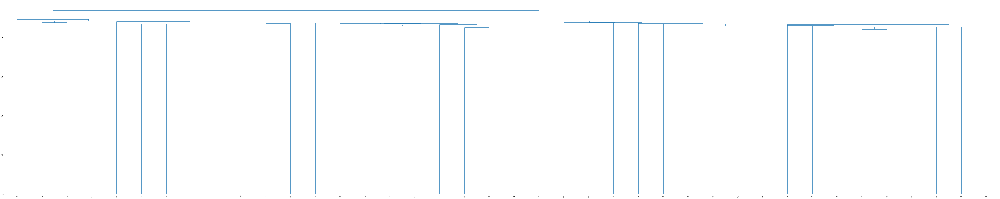

In [54]:
Z1 = hierarchy.linkage(np.array(data.T), 'single', 'euclidean')
plt.figure(figsize=(100, 20))
dn = hierarchy.dendrogram(Z1)

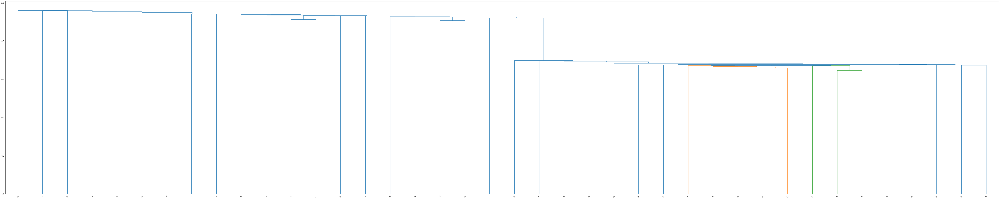

In [55]:
Z2 = hierarchy.linkage(np.array(data.T), 'single', 'correlation')
plt.figure(figsize=(100, 20))
dn = hierarchy.dendrogram(Z2)

In [56]:
hierarchical_bottom_up_clustering_c_e(np.array(data))

285 & 974 clusters were joined together in iteration 1 with new cluster number 285
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 17

276 & 664 clusters were joined together in iteration 3 with new cluster number 276
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 17

697 & 871 clusters were joined together in iteration 5 with new cluster number 697
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 17

111 & 826 clusters were joined together in iteration 7 with new cluster number 111
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 17

98 & 217 clusters were joined together in iteration 9 with new cluster number 98
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 176.

95 & 294 clusters were joined together in iteration 11 with new cluster number 95
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 176

131 & 467 clusters were joined together in iteration 13 with new cluster number 131
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

622 & 976 clusters were joined together in iteration 15 with new cluster number 622
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

190 & 977 clusters were joined together in iteration 17 with new cluster number 190
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

505 & 558 clusters were joined together in iteration 19 with new cluster number 505
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

877 & 979 clusters were joined together in iteration 21 with new cluster number 877
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

905 & 951 clusters were joined together in iteration 23 with new cluster number 905
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

898 & 909 clusters were joined together in iteration 25 with new cluster number 898
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

634 & 793 clusters were joined together in iteration 27 with new cluster number 634
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

382 & 882 clusters were joined together in iteration 29 with new cluster number 382
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

31 & 713 clusters were joined together in iteration 31 with new cluster number 31
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 176

726 & 882 clusters were joined together in iteration 33 with new cluster number 726
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

108 & 441 clusters were joined together in iteration 35 with new cluster number 108
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

97 & 184 clusters were joined together in iteration 37 with new cluster number 97
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 176

290 & 310 clusters were joined together in iteration 39 with new cluster number 290
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

170 & 691 clusters were joined together in iteration 41 with new cluster number 170
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

87 & 277 clusters were joined together in iteration 43 with new cluster number 87
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 176

258 & 689 clusters were joined together in iteration 45 with new cluster number 258
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

310 & 383 clusters were joined together in iteration 47 with new cluster number 310
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

443 & 588 clusters were joined together in iteration 49 with new cluster number 443
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

83 & 747 clusters were joined together in iteration 51 with new cluster number 83
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 176

434 & 927 clusters were joined together in iteration 53 with new cluster number 434
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

319 & 837 clusters were joined together in iteration 55 with new cluster number 319
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

469 & 805 clusters were joined together in iteration 57 with new cluster number 469
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

201 & 730 clusters were joined together in iteration 59 with new cluster number 201
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

224 & 413 clusters were joined together in iteration 61 with new cluster number 224
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

625 & 771 clusters were joined together in iteration 63 with new cluster number 625
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

382 & 838 clusters were joined together in iteration 65 with new cluster number 382
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

505 & 569 clusters were joined together in iteration 67 with new cluster number 505
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

444 & 655 clusters were joined together in iteration 69 with new cluster number 444
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

294 & 419 clusters were joined together in iteration 71 with new cluster number 294
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

147 & 601 clusters were joined together in iteration 73 with new cluster number 147
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

40 & 707 clusters were joined together in iteration 75 with new cluster number 40
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 176

134 & 645 clusters were joined together in iteration 77 with new cluster number 134
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

409 & 693 clusters were joined together in iteration 79 with new cluster number 409
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

481 & 565 clusters were joined together in iteration 81 with new cluster number 481
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

314 & 674 clusters were joined together in iteration 83 with new cluster number 314
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

369 & 883 clusters were joined together in iteration 85 with new cluster number 369
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

209 & 809 clusters were joined together in iteration 87 with new cluster number 209
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

420 & 720 clusters were joined together in iteration 89 with new cluster number 420
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

222 & 601 clusters were joined together in iteration 91 with new cluster number 222
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

7 & 613 clusters were joined together in iteration 93 with new cluster number 7
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 176. 

422 & 687 clusters were joined together in iteration 95 with new cluster number 422
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

388 & 892 clusters were joined together in iteration 97 with new cluster number 388
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

284 & 815 clusters were joined together in iteration 99 with new cluster number 284
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

174 & 676 clusters were joined together in iteration 101 with new cluster number 174
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 

288 & 586 clusters were joined together in iteration 103 with new cluster number 288
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 

96 & 799 clusters were joined together in iteration 105 with new cluster number 96
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 17

451 & 804 clusters were joined together in iteration 107 with new cluster number 451
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 

304 & 401 clusters were joined together in iteration 109 with new cluster number 304
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 

207 & 362 clusters were joined together in iteration 111 with new cluster number 207
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 

161 & 619 clusters were joined together in iteration 114 with new cluster number 161
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 176. 177. 178. 179. 180. 181.
 182. 183.  97. 184. 185. 186. 187. 188. 189. 190. 191.

798 & 804 clusters were joined together in iteration 119 with new cluster number 798
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 

374 & 462 clusters were joined together in iteration 121 with new cluster number 374
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 

115 & 855 clusters were joined together in iteration 123 with new cluster number 115
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 

336 & 857 clusters were joined together in iteration 125 with new cluster number 336
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 

187 & 834 clusters were joined together in iteration 127 with new cluster number 187
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 

64 & 200 clusters were joined together in iteration 129 with new cluster number 64
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 17

42 & 597 clusters were joined together in iteration 131 with new cluster number 42
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 17

681 & 731 clusters were joined together in iteration 133 with new cluster number 681
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 

58 & 613 clusters were joined together in iteration 135 with new cluster number 58
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 17

142 & 200 clusters were joined together in iteration 137 with new cluster number 142
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 

 857. 858. 718. 859. 860. 784.]
exp:first sample cluster number is 0.0
387 & 728 clusters were joined together in iteration 140 with new cluster number 387
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 

267 & 813 clusters were joined together in iteration 142 with new cluster number 267
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 

340 & 608 clusters were joined together in iteration 144 with new cluster number 340
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99.  71. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 174. 175. 176. 177. 178. 179.
 180. 181.  96. 182. 183. 184. 185. 186. 187. 188. 189.

406 & 649 clusters were joined together in iteration 148 with new cluster number 406
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99.  71. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 

442 & 751 clusters were joined together in iteration 150 with new cluster number 442
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99.  71. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 

155 & 674 clusters were joined together in iteration 152 with new cluster number 155
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99.  71. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99.  71. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 174. 175. 176. 177. 178. 179.
 180. 181.  96. 182. 183. 184. 185. 186. 187. 188. 189.

358 & 411 clusters were joined together in iteration 158 with new cluster number 358
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99.  71. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
   9. 166. 167. 168. 169. 170. 171. 172. 

5 & 709 clusters were joined together in iteration 160 with new cluster number 5
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99.  71. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
   9. 166. 167. 168. 169. 170. 171. 172. 173.

519 & 551 clusters were joined together in iteration 162 with new cluster number 519
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99.  71. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
   9. 166. 167. 168. 169. 170. 171. 172. 

81 & 801 clusters were joined together in iteration 165 with new cluster number 81
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99.  71. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
   9. 166. 167. 168. 169. 170. 171. 172. 17

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99.  71. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
   9. 166. 167. 168. 169. 170. 171. 172. 173. 174. 175. 176. 177. 178.
 179. 180.  96. 181. 182. 183. 184. 185. 186. 187. 188.

358 & 784 clusters were joined together in iteration 169 with new cluster number 358
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99.  71. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
   9. 166. 167. 168. 169. 170. 171. 172. 

232 & 548 clusters were joined together in iteration 171 with new cluster number 232
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99.  71. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
   9. 166. 167. 168. 169. 170. 171. 172. 

311 & 560 clusters were joined together in iteration 173 with new cluster number 311
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99.  71. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
   9. 166. 167. 168. 169. 170. 171. 172. 

320 & 398 clusters were joined together in iteration 175 with new cluster number 320
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99.  71. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
   9. 166. 167. 168. 169. 170. 171. 172. 

648 & 738 clusters were joined together in iteration 177 with new cluster number 648
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99.  71. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
   9. 166. 167. 168. 169. 170. 171. 172. 

241 & 422 clusters were joined together in iteration 179 with new cluster number 241
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99.  71. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
   9. 166. 167. 168. 169. 170. 171. 172. 

338 & 683 clusters were joined together in iteration 182 with new cluster number 338
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99.  71. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
   9. 166. 167. 168. 169. 170. 171. 172. 

595 & 794 clusters were joined together in iteration 184 with new cluster number 595
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99.  71. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
   9. 166. 167. 168. 169. 170. 171. 172. 

291 & 786 clusters were joined together in iteration 186 with new cluster number 291
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99.  71. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
   9. 166. 167. 168. 169. 170. 171. 172. 

99 & 173 clusters were joined together in iteration 188 with new cluster number 99
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99.  71. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
   9. 166. 167. 168. 169. 170. 171. 172.  9

295 & 734 clusters were joined together in iteration 191 with new cluster number 295
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99.  71. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
   9. 166. 167. 168. 169. 170. 171. 172. 

2 & 190 clusters were joined together in iteration 193 with new cluster number 2
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99.  71. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150.  85.
 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.
   9. 165. 166. 167. 168. 169. 170. 171.  99.

348 & 773 clusters were joined together in iteration 196 with new cluster number 348
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99.  71. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150.  85.
 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.
   9. 165. 166. 167. 168. 169. 170. 171. 

33 & 606 clusters were joined together in iteration 199 with new cluster number 33
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99.  71. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150.  85.
 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.
   9. 165. 166. 167. 168. 169. 170. 171.  9

17 & 485 clusters were joined together in iteration 201 with new cluster number 17
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99.  71. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150.  85.
 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.
   9. 165. 166. 167. 168. 169. 170. 171.  9

457 & 495 clusters were joined together in iteration 203 with new cluster number 457
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99.  71. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150.  85.
 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.
   9. 165. 166. 167. 168. 169. 170. 171. 

60 & 731 clusters were joined together in iteration 206 with new cluster number 60
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  59.  84.  85.  86.  87.  88.  89.  90.  91.  92.  38.  93.  94.  95.
  96.  97.  98.  71.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149.  84.
 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163.
   9. 164. 165. 166. 167. 168. 169. 170.  9

63 & 259 clusters were joined together in iteration 209 with new cluster number 63
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  59.  84.  85.  86.  87.  88.  89.  90.  91.  92.  38.  93.  94.  95.
  96.  97.  98.  71.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149.  84.
 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163.
   9. 164. 165. 166. 167. 168. 169. 170.  9

291 & 747 clusters were joined together in iteration 211 with new cluster number 291
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  59.  84.  85.  86.  87.  88.  89.  90.  91.  92.  38.  93.  94.  95.
  96.  97.  98.  71.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149.  84.
 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163.
   9. 164. 165. 166. 167. 168. 169. 170. 

402 & 710 clusters were joined together in iteration 213 with new cluster number 402
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  59.  84.  85.  86.  87.  88.  89.  90.  91.  92.  38.  93.  94.  95.
  96.  97.  98.  71.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149.  84.
 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163.
   9. 164. 165. 166. 167. 168. 169. 170. 

727 & 762 clusters were joined together in iteration 216 with new cluster number 727
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  59.  84.  85.  86.  87.  88.  89.  90.  91.  92.  38.  93.  94.  95.
  96.  97.  98.  71.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149.  84.
 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163.
   9. 164. 165. 166. 167. 168. 169. 170. 

611 & 734 clusters were joined together in iteration 218 with new cluster number 611
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  59.  84.  85.  86.  87.  88.  89.  90.  91.  92.  38.  93.  94.  95.
  96.  97.  98.  71.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149.  84.
 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163.
   9. 164. 165. 166. 167. 168. 169. 170. 

 776. 777. 663. 778. 779. 718.]
exp:first sample cluster number is 0.0
283 & 339 clusters were joined together in iteration 221 with new cluster number 283
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  59.  84.  85.  86.  87.  88.  89.  90.  91.  92.  38.  93.  94.  95.
  96.  97.  98.  71.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149.  84.
 150. 151. 152. 153. 154. 155. 156. 157. 

 774. 775. 661. 776. 777. 716.]
exp:first sample cluster number is 0.0
352 & 357 clusters were joined together in iteration 223 with new cluster number 352
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  59.  83.  84.  85.  86.  87.  88.  89.  90.  91.  38.  92.  93.  94.
  95.  96.  97.  70.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135.
 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.  83.
 149. 150. 151. 152. 153. 154. 155. 156. 

26 & 609 clusters were joined together in iteration 225 with new cluster number 26
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  59.  83.  84.  85.  86.  87.  88.  89.  90.  91.  38.  92.  93.  94.
  95.  96.  97.  70.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135.
 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.  83.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
   9. 163. 164. 165. 166. 167. 168. 169.  9

84 & 98 clusters were joined together in iteration 228 with new cluster number 84
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146.  82.
 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160.
   9. 161. 162. 163. 164. 165. 166. 167.  96

387 & 645 clusters were joined together in iteration 231 with new cluster number 387
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146.  82.
 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160.
   9. 161. 162. 163. 164. 165. 166. 167. 

55 & 719 clusters were joined together in iteration 233 with new cluster number 55
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146.  82.
 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160.
   9. 161. 162. 163. 164. 165. 166. 167.  9

217 & 687 clusters were joined together in iteration 235 with new cluster number 217
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146.  82.
 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160.
   9. 161. 162. 163. 164. 165. 166. 167. 

121 & 578 clusters were joined together in iteration 237 with new cluster number 121
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146.  82.
 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160.
   9. 161. 162. 163. 164. 165. 166. 167. 

641 & 674 clusters were joined together in iteration 239 with new cluster number 641
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146.  82.
 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160.
   9. 161. 162. 163. 164. 165. 166. 167. 

277 & 590 clusters were joined together in iteration 241 with new cluster number 277
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146.  82.
 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160.
   9. 161. 162. 163. 164. 165. 166. 167. 

523 & 739 clusters were joined together in iteration 243 with new cluster number 523
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146.  82.
 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160.
   9. 161. 162. 163. 164. 165. 166. 167. 

449 & 460 clusters were joined together in iteration 245 with new cluster number 449
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146.  82.
 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160.
   9. 161. 162. 163. 164. 165. 166. 167. 

284 & 640 clusters were joined together in iteration 247 with new cluster number 284
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146.  82.
 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160.
   9. 161. 162. 163. 164. 165. 166. 167. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146.  82.
 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160.
   9. 161. 162. 163. 164. 165. 166. 167.  96. 168. 169. 170. 171. 172.
 173. 174.  93. 175. 176. 177. 178. 179. 180. 181. 182.

210 & 696 clusters were joined together in iteration 251 with new cluster number 210
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146.  82.
 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160.
   9. 161. 162. 163. 164. 165. 166. 167. 

25 & 630 clusters were joined together in iteration 253 with new cluster number 25
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146.  82.
 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160.
   9. 161. 162. 163. 164. 165. 166. 167.  9

268 & 655 clusters were joined together in iteration 255 with new cluster number 268
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146.  82.
 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160.
   9. 161. 162. 163. 164. 165. 166. 167. 

99 & 696 clusters were joined together in iteration 258 with new cluster number 99
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146.  82.
 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160.
   9. 161. 162. 163. 164. 165. 166. 167.  9

154 & 712 clusters were joined together in iteration 260 with new cluster number 154
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146.  82.
 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160.
   9. 161. 162. 163. 164. 165. 166. 167. 

216 & 640 clusters were joined together in iteration 262 with new cluster number 216
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146.  82.
 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160.
   9. 161. 162. 163. 164. 165. 166. 167. 

204 & 591 clusters were joined together in iteration 265 with new cluster number 204
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146.  82.
 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160.
   9. 161. 162. 163. 164. 165. 166. 167. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146.  82.
 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160.
   9. 161. 162. 163. 164. 165. 166. 167.  96. 168. 169. 170. 171. 172.
 173. 174.  93. 175. 176. 177. 178. 179. 180. 181. 182.

188 & 560 clusters were joined together in iteration 271 with new cluster number 188
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146.  82.
 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160.
   9. 161. 162. 163. 164. 165. 166. 167. 

351 & 395 clusters were joined together in iteration 273 with new cluster number 351
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146.  82.
 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160.
   9. 161. 162. 163. 164. 165. 166. 167. 

41 & 141 clusters were joined together in iteration 275 with new cluster number 41
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  82.
 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159.
   9. 160. 161. 162. 163. 164. 165. 166.  9

189 & 651 clusters were joined together in iteration 277 with new cluster number 189
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  82.
 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159.
   9. 160. 161. 162. 163. 164. 165. 166. 

201 & 202 clusters were joined together in iteration 279 with new cluster number 201
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  82.
 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159.
   9. 160. 161. 162. 163. 164. 165. 166. 

343 & 532 clusters were joined together in iteration 281 with new cluster number 343
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  82.
 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159.
   9. 160. 161. 162. 163. 164. 165. 166. 

74 & 266 clusters were joined together in iteration 283 with new cluster number 74
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  82.
 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159.
   9. 160. 161. 162. 163. 164. 165. 166.  9

80 & 266 clusters were joined together in iteration 286 with new cluster number 80
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  82.
 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159.
   9. 160. 161. 162. 163. 164. 165. 166.  9

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  82.
 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159.
   9. 160. 161. 162. 163. 164. 165. 166.  96. 167. 168. 169. 170. 171.
 172. 173.  93. 174. 175. 176. 177. 178. 179. 180. 181.

554 & 679 clusters were joined together in iteration 291 with new cluster number 554
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  82.
 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159.
   9. 160. 161. 162. 163. 164. 165. 166. 

146 & 151 clusters were joined together in iteration 293 with new cluster number 146
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  82.
 146. 147. 148. 149. 150. 146. 151. 152. 153. 154. 155. 156. 157. 158.
   9. 159. 160. 161. 162. 163. 164. 165. 

4 & 572 clusters were joined together in iteration 296 with new cluster number 4
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  82.
 146. 147. 148. 149. 150. 146. 151. 152. 153. 154. 155. 156. 157. 158.
   9. 159. 160. 161. 162. 163. 164. 165.  96.

38 & 178 clusters were joined together in iteration 298 with new cluster number 38
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  82.
 146. 147. 148. 149. 150. 146. 151. 152. 153. 154. 155. 156. 157. 158.
   9. 159. 160. 161. 162. 163. 164. 165.  9

10 & 479 clusters were joined together in iteration 300 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  82.
 146. 147. 148. 149. 150. 146. 151. 152. 153. 154. 155. 156. 157. 158.
   9. 159. 160. 161. 162. 163. 164. 165.  9

554 & 672 clusters were joined together in iteration 302 with new cluster number 554
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  82.
 146. 147. 148. 149. 150. 146. 151. 152. 153. 154. 155. 156. 157. 158.
   9. 159. 160. 161. 162. 163. 164. 165. 

87 & 191 clusters were joined together in iteration 304 with new cluster number 87
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  82.
 146. 147. 148. 149. 150. 146. 151. 152. 153. 154. 155. 156. 157. 158.
   9. 159. 160. 161. 162. 163. 164. 165.  9

254 & 612 clusters were joined together in iteration 306 with new cluster number 254
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  82.
 146. 147. 148. 149. 150. 146. 151. 152. 153. 154. 155. 156. 157. 158.
   9. 159. 160. 161. 162. 163. 164. 165. 

283 & 599 clusters were joined together in iteration 308 with new cluster number 283
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  82.
 146. 147. 148. 149. 150. 146. 151. 152. 153. 154. 155. 156. 157. 158.
   9. 159. 160. 161. 162. 163. 164. 165. 

136 & 261 clusters were joined together in iteration 310 with new cluster number 136
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  82.
 146. 147. 148. 149. 150. 146. 151. 152. 153. 154. 155. 156. 157. 158.
   9. 159. 160. 161. 162. 163. 164. 165. 

226 & 615 clusters were joined together in iteration 312 with new cluster number 226
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  82.
 146. 147. 148. 149. 150. 146. 151. 152. 153. 154. 155. 156. 157. 158.
   9. 159. 160. 161. 162. 163. 164. 165. 

277 & 327 clusters were joined together in iteration 314 with new cluster number 277
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  82.
 146. 147. 148. 149. 150. 146. 151. 152. 153. 154. 155. 156. 157. 158.
   9. 159. 160. 161. 162. 163. 164. 165. 

326 & 399 clusters were joined together in iteration 316 with new cluster number 326
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  82.
 146. 147. 148. 149. 150. 146. 151. 152. 153. 154. 155. 156. 157. 158.
   9. 159. 160. 161. 162. 163. 164. 165. 

148 & 508 clusters were joined together in iteration 318 with new cluster number 148
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  82.
 146. 147. 148. 149. 150. 146. 151. 152. 153. 154. 155. 156. 157. 158.
   9. 159. 160. 161. 162. 163. 164. 165. 

261 & 292 clusters were joined together in iteration 320 with new cluster number 261
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  82.
 146. 147. 148. 149. 150. 146. 151. 152. 153. 154. 155. 156. 157. 158.
   9. 159. 160. 161. 162. 163. 164. 165. 

506 & 631 clusters were joined together in iteration 322 with new cluster number 506
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  82.
 146. 147. 148. 149. 150. 146. 151. 152. 153. 154. 155. 156. 157. 158.
   9. 159. 160. 161. 162. 163. 164. 165. 

344 & 536 clusters were joined together in iteration 324 with new cluster number 344
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  82.
 146. 147. 148. 149. 150. 146. 151. 152. 153. 154. 155. 156. 157. 158.
   9. 159. 160. 161. 162. 163. 164. 165. 

147 & 556 clusters were joined together in iteration 326 with new cluster number 147
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  82.
 146. 147. 148. 149. 150. 146. 151. 152. 153. 154. 155. 156. 157. 158.
   9. 159. 160. 161. 162. 163. 164. 165. 

107 & 586 clusters were joined together in iteration 328 with new cluster number 107
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  82.
 146. 147. 148. 149. 150. 146. 151. 152. 153. 154. 155. 156. 157. 158.
   9. 159. 160. 161. 162. 163. 164. 165. 

162 & 528 clusters were joined together in iteration 330 with new cluster number 162
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  91.  92.  93.
  94.  95.  96.  69.  97.  84.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  82.
 146. 147. 148. 149. 150. 146. 151. 152. 153. 154. 155. 156. 157. 158.
   9. 159. 160. 161. 162. 163. 164. 165. 

35 & 91 clusters were joined together in iteration 332 with new cluster number 35
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 145. 150. 151. 152. 153. 154. 155. 156. 157.
   9. 158. 159. 160. 161. 162. 163. 164.  95

403 & 433 clusters were joined together in iteration 335 with new cluster number 403
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 145. 150. 151. 152. 153. 154.  90. 155. 156.
   9. 157. 158. 159. 160. 161. 162. 163. 

18 & 447 clusters were joined together in iteration 337 with new cluster number 18
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 145. 150. 151. 152. 153. 154.  90. 155. 156.
   9. 157. 158. 159. 160. 161. 162. 163.  9

325 & 626 clusters were joined together in iteration 340 with new cluster number 325
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 145. 150. 151. 152. 153. 154.  90. 155. 156.
   9. 157. 158. 159. 160. 161. 162. 163. 

259 & 528 clusters were joined together in iteration 342 with new cluster number 259
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 145. 150. 151. 152. 153. 154.  90. 155. 156.
   9. 157. 158. 159. 160. 161. 162. 163. 

294 & 510 clusters were joined together in iteration 344 with new cluster number 294
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 145. 150. 151. 152. 153. 154.  90. 155. 156.
   9. 157. 158. 159. 160. 161. 162. 163. 

15 & 453 clusters were joined together in iteration 346 with new cluster number 15
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 145. 150. 151. 152. 153. 154.  90. 155. 156.
   9. 157. 158. 159. 160. 161. 162. 163.  9

354 & 388 clusters were joined together in iteration 348 with new cluster number 354
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 145. 150. 151. 152. 153. 154.  90. 155. 156.
   9. 157. 158. 159. 160. 161. 162. 163. 

168 & 477 clusters were joined together in iteration 350 with new cluster number 168
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 145. 150. 151. 152. 153. 154.  90. 155. 156.
   9. 157. 158. 159. 160. 161. 162. 163. 

93 & 237 clusters were joined together in iteration 352 with new cluster number 93
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 145. 150. 151. 152. 153. 154.  90. 155. 156.
   9. 157. 158. 159. 160. 161. 162. 163.  9

286 & 356 clusters were joined together in iteration 354 with new cluster number 286
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 145. 150. 151. 152. 153. 154.  90. 155. 156.
   9. 157. 158. 159. 160. 161. 162. 163. 

543 & 641 clusters were joined together in iteration 356 with new cluster number 543
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 145. 150. 151. 152. 153. 154.  90. 155. 156.
   9. 157. 158. 159. 160. 161. 162. 163. 

121 & 271 clusters were joined together in iteration 358 with new cluster number 121
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 145. 150. 151. 152. 153. 154.  90. 155. 156.
   9. 157. 158. 159. 160. 161. 162. 163. 

138 & 521 clusters were joined together in iteration 360 with new cluster number 138
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 145. 150. 151. 152. 153. 154.  90. 155. 156.
   9. 157. 158. 159. 160. 161. 162. 163. 

100 & 189 clusters were joined together in iteration 362 with new cluster number 100
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 145. 150. 151. 152. 153. 154.  90. 155. 156.
   9. 157. 158. 159. 160. 161. 162. 163. 

139 & 548 clusters were joined together in iteration 364 with new cluster number 139
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 145. 150. 151. 152. 153. 154.  90. 155. 156.
   9. 157. 158. 159. 160. 161. 162. 163. 

538 & 625 clusters were joined together in iteration 366 with new cluster number 538
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 145. 150. 151. 152. 153. 154.  90. 155. 156.
   9. 157. 158. 159. 160. 161. 162. 163. 

172 & 280 clusters were joined together in iteration 368 with new cluster number 172
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 145. 150. 151. 152. 153. 154.  90. 155. 156.
   9. 157. 158. 159. 160. 161. 162. 163. 

163 & 576 clusters were joined together in iteration 370 with new cluster number 163
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138.  41. 139. 140. 141. 142. 143.  81.
 144. 145. 146. 147. 148. 144. 149. 150. 151. 152. 153.  89. 154. 155.
   9. 156. 157. 158. 159. 160. 161. 162. 

279 & 536 clusters were joined together in iteration 372 with new cluster number 279
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138.  41. 139. 140. 141. 142. 143.  81.
 144. 145. 146. 147. 148. 144. 149. 150. 151. 152. 153.  89. 154. 155.
   9. 156. 157. 158. 159. 160. 161. 162. 

115 & 597 clusters were joined together in iteration 374 with new cluster number 115
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138.  41. 139. 140. 141. 142. 143.  81.
 144. 145. 146. 147. 148. 144. 149. 150. 151. 152. 153.  89. 154. 155.
   9. 156. 157. 158. 159. 160. 161. 162. 

48 & 471 clusters were joined together in iteration 376 with new cluster number 48
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138.  41. 139. 140. 141. 142. 143.  81.
 144. 145. 146. 147. 148. 144. 149. 150. 151. 152. 153.  89. 154. 155.
   9. 156. 157. 158. 159. 160. 161. 162.  9

153 & 385 clusters were joined together in iteration 378 with new cluster number 153
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138.  41. 139. 140. 141. 142. 143.  81.
 144. 145. 146. 147. 148. 144. 149. 150. 151. 152. 153.  89. 154. 155.
   9. 156. 157. 158. 159. 160. 161. 162. 

42 & 488 clusters were joined together in iteration 380 with new cluster number 42
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138.  41. 139. 140. 141. 142. 143.  81.
 144. 145. 146. 147. 148. 144. 149. 150. 151. 152. 153.  89. 154. 155.
   9. 156. 157. 158. 159. 160. 161. 162.  9

385 & 417 clusters were joined together in iteration 382 with new cluster number 385
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138.  41. 139. 140. 141. 142. 143.  81.
 144. 145. 146. 147. 148. 144. 149. 150. 151. 152. 153.  89. 154. 155.
   9. 156. 157. 158. 159. 160. 161. 162. 

211 & 517 clusters were joined together in iteration 384 with new cluster number 211
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138.  41. 139. 140. 141. 142. 143.  81.
 144. 145. 146. 147. 148. 144. 149. 150. 151. 152. 153.  89. 154. 155.
   9. 156. 157. 158. 159. 160. 161. 162. 

241 & 323 clusters were joined together in iteration 386 with new cluster number 241
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138.  41. 139. 140. 141. 142. 143.  81.
 144. 145. 146. 147. 148. 144. 149. 150. 151. 152. 153.  89. 154. 155.
   9. 156. 157. 158. 159. 160. 161. 162. 

87 & 243 clusters were joined together in iteration 388 with new cluster number 87
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138.  41. 139. 140. 141. 142. 143.  81.
 144. 145. 146. 147. 148. 144. 149. 150. 151. 152. 153.  89. 154. 155.
   9. 156. 157. 158. 159. 160. 161. 162.  9

445 & 457 clusters were joined together in iteration 390 with new cluster number 445
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138.  41. 139. 140. 141. 142. 143.  81.
 144. 145. 146. 147. 148. 144. 149. 150. 151. 152. 153.  89. 154. 155.
   9. 156. 157. 158. 159. 160. 161. 162. 

401 & 452 clusters were joined together in iteration 392 with new cluster number 401
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138.  41. 139. 140. 141. 142. 143.  81.
 144. 145. 146. 147. 148. 144. 149. 150. 151. 152. 153.  89. 154. 155.
   9. 156. 157. 158. 159. 160. 161. 162. 

304 & 336 clusters were joined together in iteration 394 with new cluster number 304
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138.  41. 139. 140. 141. 142. 143.  81.
 144. 145. 146. 147. 148. 144. 149. 150. 151. 152. 153.  89. 154. 155.
   9. 156. 157. 158. 159. 160. 161. 162. 

473 & 560 clusters were joined together in iteration 396 with new cluster number 473
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138.  41. 139. 140. 141. 142. 143.  81.
 144. 145. 146. 147. 148. 144. 149. 150. 151. 152. 153.  89. 154. 155.
   9. 156. 157. 158. 159. 160. 161. 162. 

511 & 562 clusters were joined together in iteration 398 with new cluster number 511
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138.  41. 139. 140. 141. 142. 143.  81.
 144. 145. 146. 147. 148. 144. 149. 150. 151. 152. 153.  89. 154. 155.
   9. 156. 157. 158. 159. 160. 161. 162. 

7 & 113 clusters were joined together in iteration 400 with new cluster number 7
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112.   7. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137.  41. 138. 139. 140. 141. 142.  81.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152.  89. 153. 154.
   9. 155. 156. 157. 158. 159. 160. 161.  94.

43 & 234 clusters were joined together in iteration 402 with new cluster number 43
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112.   7. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137.  41. 138. 139. 140. 141. 142.  81.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152.  89. 153. 154.
   9. 155. 156. 157. 158. 159. 160. 161.  9

76 & 303 clusters were joined together in iteration 404 with new cluster number 76
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112.   7. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137.  41. 138. 139. 140. 141. 142.  81.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152.  89. 153. 154.
   9. 155. 156. 157. 158. 159. 160. 161.  9

181 & 539 clusters were joined together in iteration 406 with new cluster number 181
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112.   7. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137.  41. 138. 139. 140. 141. 142.  81.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152.  89. 153. 154.
   9. 155. 156. 157. 158. 159. 160. 161. 

267 & 546 clusters were joined together in iteration 408 with new cluster number 267
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112.   7. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137.  41. 138. 139. 140. 141. 142.  81.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152.  89. 153. 154.
   9. 155. 156. 157. 158. 159. 160. 161. 

206 & 289 clusters were joined together in iteration 410 with new cluster number 206
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112.   7. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137.  41. 138. 139. 140. 141. 142.  81.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152.  89. 153. 154.
   9. 155. 156. 157. 158. 159. 160. 161. 

399 & 418 clusters were joined together in iteration 412 with new cluster number 399
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112.   7. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137.  41. 138. 139. 140. 141. 142.  81.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152.  89. 153. 154.
   9. 155. 156. 157. 158. 159. 160. 161. 

517 & 546 clusters were joined together in iteration 414 with new cluster number 517
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112.   7. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137.  41. 138. 139. 140. 141. 142.  81.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152.  89. 153. 154.
   9. 155. 156. 157. 158. 159. 160. 161. 

54 & 534 clusters were joined together in iteration 416 with new cluster number 54
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112.   7. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137.  41. 138. 139. 140. 141. 142.  81.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152.  89. 153. 154.
   9. 155. 156. 157. 158. 159. 160. 161.  9

474 & 580 clusters were joined together in iteration 418 with new cluster number 474
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112.   7. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137.  41. 138. 139. 140. 141. 142.  81.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152.  89. 153. 154.
   9. 155. 156. 157. 158. 159. 160. 161. 

138 & 577 clusters were joined together in iteration 420 with new cluster number 138
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112.   7. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137.  41. 138. 139. 140. 141. 142.  81.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152.  89. 153. 154.
   9. 155. 156. 157. 158. 159. 160. 161. 

73 & 574 clusters were joined together in iteration 422 with new cluster number 73
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112.   7. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137.  41. 138. 139. 140. 141. 142.  81.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152.  89. 153. 154.
   9. 155. 156. 157. 158. 159. 160. 161.  9

1 & 249 clusters were joined together in iteration 425 with new cluster number 1
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112.   7. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137.  41. 138. 139. 140. 141. 142.  81.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152.  89. 153. 154.
   9. 155. 156. 157. 158. 159. 160. 161.  94.

84 & 350 clusters were joined together in iteration 427 with new cluster number 84
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112.   7. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137.  41. 138. 139. 140. 141. 142.  81.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152.  89. 153. 154.
   9. 155. 156. 157. 158. 159. 160. 161.  9

196 & 364 clusters were joined together in iteration 429 with new cluster number 196
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112.   7. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137.  41. 138. 139. 140. 141. 142.  81.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152.  89. 153. 154.
   9. 155. 156. 157. 158. 159. 160. 161. 

501 & 542 clusters were joined together in iteration 432 with new cluster number 501
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112.   7. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
  69. 131. 132. 133. 134. 135. 136.  41. 137. 138. 139. 140. 141.  81.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151.  89. 152. 153.
   9. 154. 155. 156. 157. 158. 159. 160. 

298 & 533 clusters were joined together in iteration 434 with new cluster number 298
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112.   7. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
  69. 131. 132. 133. 134. 135. 136.  41. 137. 138. 139. 140. 141.  81.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151.  89. 152. 153.
   9. 154. 155. 156. 157. 158. 159. 160. 

9 & 231 clusters were joined together in iteration 436 with new cluster number 9
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112.   7. 113. 114. 115. 116.
 107. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
  69. 130. 131. 132. 133. 134. 135.  41. 136. 137. 138. 139. 140.  81.
 141. 142. 143. 144. 145. 141. 146. 147. 148. 149. 150.  89. 151. 152.
   9. 153. 154. 155. 156. 157. 158. 159.  94.

461 & 518 clusters were joined together in iteration 438 with new cluster number 461
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112.   7. 113. 114. 115. 116.
 107. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
  69. 130. 131. 132. 133. 134. 135.  41. 136. 137. 138. 139. 140.  81.
 141. 142. 143. 144. 145. 141. 146. 147. 148. 149. 150.  89. 151. 152.
   9. 153. 154. 155. 156. 157. 158. 159. 

146 & 166 clusters were joined together in iteration 441 with new cluster number 146
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112.   7. 113. 114. 115. 116.
 107. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
  69. 130. 131. 132. 133. 134. 135.  41. 136. 137. 138. 139. 140.  81.
 141. 142. 143. 144. 145. 141. 146. 147. 148. 149. 150.  89. 151. 152.
   9. 153. 154. 155. 156. 157. 158. 159. 

exp:first sample cluster number is 0.0
373 & 429 clusters were joined together in iteration 444 with new cluster number 373
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112.   7. 113. 114. 115. 116.
 107. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
  69. 130. 131. 132. 133. 134. 135.  41. 136. 137. 138. 139. 140.  81.
 141. 142. 143. 144. 145. 141. 146. 147. 148. 149. 150.  89. 151. 152.
  

37 & 510 clusters were joined together in iteration 446 with new cluster number 37
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112.   7. 113. 114. 115. 116.
 107. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
  69. 130. 131. 132. 133. 134. 135.  41. 136. 137. 138. 139. 140.  81.
 141. 142. 143. 144. 145. 141. 146. 147. 148. 149. 150.  89. 151. 152.
   9. 153. 154. 155. 156. 157. 158. 159.  9

113 & 197 clusters were joined together in iteration 448 with new cluster number 113
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112.   7. 113. 114. 115. 116.
 107. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
  69. 130. 131. 132. 133. 134. 135.  41. 136. 137. 138. 139. 140.  81.
 141. 142. 143. 144. 145. 141. 146. 147. 148. 149. 150.  89. 151. 152.
   9. 153. 154. 155. 156. 157. 158. 159. 

203 & 244 clusters were joined together in iteration 451 with new cluster number 203
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112.   7. 113. 114. 115. 116.
 107. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
  69. 130. 131. 132. 133. 134. 135.  41. 136. 137. 138. 139. 140.  81.
 141. 142. 143. 144. 145. 141. 146. 147. 148. 149. 150.  89. 151. 152.
   9. 153. 154. 155. 156. 157. 158. 159. 

326 & 499 clusters were joined together in iteration 454 with new cluster number 326
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  94.  83.  95.  96.  97.  98.  99. 100. 101. 102.
 103. 104. 105. 106. 107. 108. 109. 110. 111.   7. 112. 113. 114. 115.
 106. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
  69. 129. 130. 131. 132. 133. 134.  41. 135. 136. 137. 138. 139.  81.
 140. 141. 142. 143. 144. 140. 145. 146. 147. 148. 149.  89. 150. 151.
   9. 152. 153. 154. 155. 156. 157. 158. 

245 & 485 clusters were joined together in iteration 457 with new cluster number 245
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  94.  83.  95.  96.  97.  98.  99. 100. 101. 102.
 103. 104. 105. 106. 107. 108. 109. 110. 111.   7. 112. 113. 114. 115.
 106. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
  69. 129. 130. 131. 132. 133. 134.  41. 135. 136. 137. 138. 139.  81.
 140. 141. 142. 143. 144. 140. 145. 146. 147. 148. 149.  89. 150. 151.
   9. 152. 153. 154. 155. 156. 157. 158. 

120 & 288 clusters were joined together in iteration 459 with new cluster number 120
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  94.  83.  95.  96.  97.  98.  99. 100. 101. 102.
 103. 104. 105. 106. 107. 108. 109. 110. 111.   7. 112. 113. 114. 115.
 106. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
  69. 129. 130. 131. 132. 133. 134.  41. 135. 136. 137. 138. 139.  81.
 140. 141. 142. 143. 144. 140. 145. 146. 147. 148. 149.  89. 150. 151.
   9. 152. 153. 154. 155. 156. 157. 158. 

410 & 416 clusters were joined together in iteration 461 with new cluster number 410
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  94.  83.  95.  96.  97.  98.  99. 100. 101. 102.
 103. 104. 105. 106. 107. 108. 109. 110. 111.   7. 112. 113. 114. 115.
 106. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
  69. 129. 130. 131. 132. 133. 134.  41. 135. 136. 137. 138. 139.  81.
 140. 141. 142. 143. 144. 140. 145. 146. 147. 148. 149.  89. 150. 151.
   9. 152. 153. 154. 155. 156. 157. 158. 

266 & 529 clusters were joined together in iteration 464 with new cluster number 266
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  94.  83.  95.  96.  97.  98.  99. 100. 101. 102.
 103. 104. 105. 106. 107. 108. 109. 110. 111.   7. 112. 113. 114. 115.
 106. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
  69. 129. 130. 131. 132. 133. 134.  41. 135. 136. 137. 138. 139.  81.
 140. 141. 142. 143. 144. 140. 145. 146. 147. 148. 149.  89. 150. 151.
   9. 152. 153. 154. 155. 156. 157. 158. 

56 & 441 clusters were joined together in iteration 466 with new cluster number 56
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  94.  83.  95.  96.  97.  98.  99. 100. 101. 102.
 103. 104. 105. 106. 107. 108. 109. 110. 111.   7. 112. 113. 114. 115.
 106. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.  75. 127.
  69. 128. 129. 130. 131. 132. 133.  41. 134. 135. 136. 137. 138.  81.
 139. 140. 141. 142. 143. 139. 144. 145. 146. 147. 148.  89. 149. 150.
   9. 151. 152. 153. 154. 155. 156. 157.  9

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  94.  83.  95.  96.  97.  98.  99. 100. 101. 102.
 103. 104. 105. 106. 107. 108. 109. 110. 111.   7. 112. 113. 114. 115.
 106. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.  75. 127.
  69. 128. 129. 130. 131. 132. 133.  41. 134. 135. 136. 137. 138.  81.
 139. 140. 141. 142. 143. 139. 144. 145. 146. 147. 148.  89. 149. 150.
   9. 151. 152. 153. 154. 155. 156. 157.  94. 158. 159. 160. 161. 162.
  93. 163.  91. 144. 164. 165. 166. 167.  38. 168. 169.

165 & 223 clusters were joined together in iteration 470 with new cluster number 165
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  94.  83.  95.  96.  97.  98.  99. 100. 101. 102.
 103. 104. 105. 106. 107. 108. 109. 110. 111.   7. 112. 113. 114. 115.
 106. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.  75. 127.
  69. 128. 129. 130. 131. 132. 133.  41. 134. 135. 136. 137. 138.  81.
 139. 140. 141. 142. 143. 139. 144. 145. 146. 147. 148.  89. 149. 150.
   9. 151. 152. 153. 154. 155. 156. 121. 

143 & 152 clusters were joined together in iteration 473 with new cluster number 143
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  94.  83.  95.  96.  97.  98.  99. 100. 101. 102.
 103. 104. 105. 106. 107. 108. 109. 110. 111.   7. 112. 113. 114. 115.
 106. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.  75. 127.
  69. 128. 129. 130. 131. 132. 133.  41. 134. 135. 136. 137. 138.  81.
 139. 140. 141. 142. 143. 139. 144. 145. 146. 147. 148.  89. 149. 150.
   9. 151. 143. 152. 153. 154. 155. 121. 

373 & 411 clusters were joined together in iteration 476 with new cluster number 373
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  94.  83.  95.  96.  97.  98.  99. 100. 101. 102.
 103. 104. 105. 106. 107. 108. 109. 110. 111.   7. 112. 113. 114. 115.
 106. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.  75. 127.
  69. 128. 129. 130. 131. 132. 133.  41. 134. 135. 136. 137. 138.  81.
 139. 140. 141. 142. 143. 139. 144. 145. 146. 147. 148.  89. 149. 150.
   9. 151. 143. 152. 153. 154. 155. 121. 

21 & 204 clusters were joined together in iteration 478 with new cluster number 21
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  94.  83.  95.  96.  97.  98.  99. 100. 101. 102.
 103. 104. 105. 106. 107. 108. 109. 110. 111.   7. 112. 113. 114. 115.
 106. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.  75. 127.
  69. 128. 129. 130. 131. 132. 133.  41. 134. 135. 136. 137. 138.  81.
 139. 140. 141. 142. 143. 139. 144. 145. 146. 147. 148.  89. 149. 150.
   9. 151. 143. 152. 153. 154. 155. 121.  9

345 & 383 clusters were joined together in iteration 481 with new cluster number 345
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  94.  83.  95.  96.  97.  98.  99. 100. 101. 102.
 103. 104. 105. 106. 107. 108. 109. 110. 111.   7. 112. 113. 114. 115.
 106. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.  75. 127.
  69. 128. 129. 130. 131. 132. 133.  41. 134. 135. 136. 137. 138.  81.
 139. 140. 141. 142. 143. 139. 144. 145. 146. 147. 148.  89. 149. 150.
   9. 151. 143. 152. 153. 154. 155. 121. 

178 & 515 clusters were joined together in iteration 484 with new cluster number 178
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  94.  83.  95.  96.  97.  98.  99. 100. 101. 102.
 103. 104. 105. 106. 107. 108. 109. 110. 111.   7. 112. 113. 114. 115.
 106. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.  75. 127.
  69. 128. 129. 130. 131. 132. 133.  41. 134. 135. 136. 137. 138.  81.
 139. 140. 141. 142. 143. 139. 144. 145. 146. 147. 148.  89. 149. 150.
   9. 151. 143. 152. 153. 154. 155. 121. 

105 & 211 clusters were joined together in iteration 487 with new cluster number 105
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  94.  83.  95.  96.  97.  98.  99. 100. 101. 102.
 103. 104. 105. 106. 107. 108. 109. 110. 111.   7. 112. 113. 114. 115.
 106. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.  75. 127.
  69. 128. 129. 130. 131. 132. 133.  41. 134. 135. 136. 137. 138.  81.
 139. 140. 141. 142. 143. 139. 144. 145. 146. 147. 148.  89. 149. 150.
   9. 151. 143. 152. 153. 154. 155. 121. 

272 & 419 clusters were joined together in iteration 490 with new cluster number 272
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  94.  83.  95.  96.  97.  98.  99. 100. 101. 102.
 103. 104. 105. 106. 107. 108. 109. 110. 111.   7. 112. 113. 114. 115.
 106. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.  75. 127.
  69. 128. 129.  72. 130. 131. 132.  41. 133. 134. 135. 136. 137.  81.
 138. 139. 140. 141. 142. 138. 143. 144. 145. 146. 147.  89. 148. 149.
   9. 150. 142. 151. 152. 153. 154. 121. 

125 & 225 clusters were joined together in iteration 493 with new cluster number 125
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  94.  83.  95.  96.  97.  98.  99. 100. 101. 102.
 103. 104. 105. 106. 107. 108. 109. 110. 111.   7. 112. 113. 114. 115.
 106. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.  75. 127.
  69. 128. 129.  72. 130. 131. 132.  41. 133. 134. 135. 136. 137.  81.
 138. 139. 140. 141. 142. 138. 143. 144. 145. 146. 147.  89. 148. 149.
   9. 150. 142. 151. 152. 153. 154. 121. 

179 & 487 clusters were joined together in iteration 496 with new cluster number 179
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  67.  76.  77.  78.  79.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  94.  83.  95.  96.  97.  98.  99. 100. 101. 102.
 103. 104. 105. 106. 107. 108. 109. 110. 111.   7. 112. 113. 114. 115.
 106. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.  75. 127.
  69. 128. 129.  72. 130. 131. 132.  41. 133. 134. 135. 136. 137.  81.
 138. 139. 140. 141. 142. 138. 143. 144. 145. 146. 147.  89. 148. 149.
   9. 150. 142. 151. 152. 153. 154. 121. 

241 & 312 clusters were joined together in iteration 499 with new cluster number 241
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  63.  74.  67.  75.  76.  77.  78.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  93.  82.  94.  95.  96.  97.  98.  99. 100. 101.
 102. 103. 104. 105. 106. 107. 108. 109. 110.   7. 111. 112. 113. 114.
 105. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.  74. 126.
  69. 127. 128.  72. 129. 130. 131.  41. 132. 133. 134. 135. 136.  80.
 137. 138. 139. 140. 141. 137. 142. 143. 144. 145. 146.  88. 147. 148.
   9. 149. 141. 150. 151. 152. 153. 120. 

317 & 428 clusters were joined together in iteration 502 with new cluster number 317
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  63.  74.  67.  75.  76.  77.  78.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  93.  82.  94.  95.  96.  97.  98.  99. 100. 101.
 102. 103. 104. 105. 106. 107. 108. 109. 110.   7. 111. 112. 113. 114.
 105. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.  74. 126.
  69. 127. 128.  72. 129. 130. 131.  41. 132. 133. 134. 135. 136.  80.
 137. 138. 139. 140. 141. 137. 142. 143. 144. 145. 146.  88. 147. 148.
   9. 149. 141. 150. 151. 152. 153. 120. 

60 & 127 clusters were joined together in iteration 505 with new cluster number 60
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  63.  74.  67.  75.  76.  77.  78.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  93.  82.  94.  95.  96.  97.  98.  99. 100. 101.
 102. 103. 104. 105. 106. 107. 108. 109. 110.   7. 111. 112. 113. 114.
 105. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.  74. 126.
  69.  60. 127.  72. 128. 129. 130.  41. 131. 132. 133. 134. 135.  80.
 136. 137. 138. 139. 140. 136. 141. 142. 143. 144. 145.  88. 146. 147.
   9. 148. 140. 149. 150. 151. 152. 120.  9

137 & 212 clusters were joined together in iteration 508 with new cluster number 137
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  63.  74.  67.  75.  76.  77.  78.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  93.  82.  94.  95.  96.  97.  98.  99. 100. 101.
 102. 103. 104. 105. 106. 107. 108. 109. 110.   7. 111. 112. 113. 114.
 105. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.  74. 126.
  69.  60. 127.  72. 128. 129. 130.  41. 131. 132. 133. 134. 135.  80.
 136. 137. 138. 139. 140. 136. 141. 142. 143. 144. 145.  88. 146. 147.
   9. 148. 140. 149. 150. 151. 152. 120. 

404 & 466 clusters were joined together in iteration 511 with new cluster number 404
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  63.  74.  67.  75.  76.  77.  78.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  93.  82.  94.  95.  96.  97.  98.  99. 100. 101.
 102. 103. 104. 105. 106. 107. 108. 109. 110.   7. 111. 112. 113. 114.
 105. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.  74. 126.
  69.  60. 127.  72. 128. 129. 130.  41. 131. 132. 133. 134. 135.  80.
 136. 137. 138. 139. 140. 136. 141. 142. 143. 144. 145.  88. 146. 147.
   9. 148. 140. 149. 150. 151. 152. 120. 

361 & 379 clusters were joined together in iteration 514 with new cluster number 361
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  63.  74.  67.  75.  76.  77.  78.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  93.  82.  94.  95.  96.  97.  98.  99. 100. 101.
 102. 103. 104. 105. 106. 107. 108. 109. 110.   7. 111. 112. 113. 114.
 105. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.  74. 126.
  69.  60. 127.  72. 128. 129. 130.  41. 131. 132. 133. 134. 135.  80.
 136. 137. 138. 139. 140. 136. 141. 142. 143. 144. 145.  88. 146. 147.
   9. 148. 140. 149. 150. 151. 152. 120. 

44 & 422 clusters were joined together in iteration 517 with new cluster number 44
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  63.  74.  67.  75.  76.  77.  78.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  93.  82.  94.  95.  96.  97.  98.  99. 100. 101.
 102. 103. 104. 105. 106. 107. 108. 109. 110.   7. 111. 112. 113. 114.
 105. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.  74. 126.
  69.  60. 127.  72. 128. 129. 130.  41. 131. 132. 133. 134. 135.  80.
 136. 137. 138. 139. 140. 136. 141. 142. 143. 144. 145.  88. 146. 147.
   9. 148. 140. 149. 150. 151. 152. 120.  9

214 & 299 clusters were joined together in iteration 520 with new cluster number 214
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  63.  74.  67.  75.  76.  77.  78.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  93.  82.  94.  95.  96.  97.  98.  99. 100. 101.
 102. 103. 104. 105. 106. 107. 108. 109. 110.   7. 111. 112. 113. 114.
 105. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.  74. 126.
  69.  60. 127.  72. 128. 129. 130.  41. 131. 132. 133. 134. 135.  80.
 136. 137. 138. 139. 140. 136. 141. 142. 143. 144. 145.  88. 146. 147.
   9. 148. 140. 149. 150. 151. 152. 120. 

33 & 452 clusters were joined together in iteration 523 with new cluster number 33
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  63.  74.  67.  75.  76.  77.  78.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  93.  82.  94.  95.  96.  97.  98.  99. 100. 101.
 102. 103. 104. 105. 106. 107. 108. 109. 110.   7. 111. 112. 113. 114.
 105. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.  74. 126.
  69.  60. 127.  72. 128. 129. 130.  41. 131. 132. 133. 134. 135.  80.
 136. 137. 138. 139. 140. 136. 141. 142. 143. 144. 145.  88. 146. 147.
   9. 148. 140. 149. 150. 151. 152. 120.  9

232 & 282 clusters were joined together in iteration 526 with new cluster number 232
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  64.  65.  66.
  67.  68.  69.  70.  71.  72.  62.  73.  66.  74.  75.  76.  77.  78.
  58.  79.  80.  81.  82.  83.  84.  85.  86.  87.  37.  34.  88.  89.
  90.  91.  92.  68.  92.  81.  93.  94.  95.  96.  97.  98.  99. 100.
 101. 102. 103. 104. 105. 106. 107. 108. 109.   7. 110. 111. 112. 113.
 104. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.  73. 125.
  68.  59. 126.  71. 127. 128. 129.  40. 130. 131. 132. 133. 134.  79.
 135. 136. 137. 138. 139. 135. 140. 141. 142. 143. 144.  87. 145. 146.
   9. 147. 139. 148. 149. 150. 151. 119. 

214 & 440 clusters were joined together in iteration 530 with new cluster number 214
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  64.  65.  66.
  67.  68.  69.  70.  71.  72.  62.  73.  66.  45.  74.  75.  76.  77.
  58.  78.  79.  80.  81.  82.  83.  84.  85.  86.  37.  34.  87.  88.
  89.  90.  91.  68.  91.  80.  92.  93.  94.  95.  96.  97.  98.  99.
 100. 101. 102. 103. 104. 105. 106. 107. 108.   7. 109. 110. 111. 112.
 103. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.  73. 124.
  68.  59. 125.  71. 126. 127. 128.  40. 129. 130. 131. 132. 133.  78.
 134. 135. 136. 137. 138. 134. 139. 140. 141. 142. 143.  86. 144. 145.
   9. 146. 138. 147. 148. 149. 150. 118. 

152 & 260 clusters were joined together in iteration 533 with new cluster number 152
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  64.  65.  66.
  67.  68.  69.  70.  71.  72.  62.  73.  66.  45.  74.  75.  76.  77.
  58.  78.  79.  80.  81.  82.  83.  84.  85.  86.  37.  34.  87.  88.
  89.  90.  91.  68.  91.  80.  92.  93.  94.  95.  96.  97.  98.  99.
 100. 101. 102. 103. 104. 105. 106. 107. 108.   7. 109. 110. 111. 112.
 103. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.  73. 124.
  68.  59. 125.  71. 126. 127. 128.  40. 129. 130. 131. 132. 133.  78.
 134. 135. 136. 137. 138. 134. 139. 140. 141. 142. 143.  86. 144. 145.
   9. 146. 138. 147. 148. 149. 150. 118. 

34 & 268 clusters were joined together in iteration 537 with new cluster number 34
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  64.  65.  66.
  67.  68.  69.  70.  71.  72.  62.  73.  66.  45.  74.  75.  76.  77.
  58.  78.  79.  80.  81.  82.  83.  84.  85.  86.  37.  34.  87.  88.
  89.  90.  91.  68.  91.  80.  92.  93.  94.  95.  96.  97.  98.  99.
 100. 101. 102. 103. 104. 105. 106. 107. 108.   7. 109. 110. 111. 112.
 103. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.  73. 124.
  68.  59. 125.  71. 126. 127. 128.  40. 129. 130. 131. 132. 133.  78.
 134. 135. 136. 137. 138. 134. 139. 140. 141. 142. 143.  86. 144. 145.
   9. 146. 138. 147. 148. 149. 150. 118.  9

237 & 296 clusters were joined together in iteration 540 with new cluster number 237
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  64.  65.  66.
  67.  68.  69.  70.  71.  72.  62.  73.  66.  45.  74.  75.  76.  77.
  58.  78.  79.  80.  81.  82.  83.  84.  85.  86.  37.  34.  87.  88.
  89.  90.  91.  68.  91.  80.  92.  93.  94.  95.  96.  97.  98.  99.
 100. 101. 102. 103. 104. 105. 106. 107. 108.   7. 109. 110. 111. 112.
 103. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.  73. 124.
  68.  59. 125.  71. 126. 127. 128.  40. 129. 130. 131. 132. 133.  78.
 134. 135. 136. 137. 138. 134. 139. 140. 141. 142. 143.  86. 144. 145.
   9. 146. 138. 147. 148. 149. 150. 118. 

421 & 442 clusters were joined together in iteration 544 with new cluster number 421
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  64.  65.  66.
  67.  68.  69.  70.  71.  72.  62.  73.  66.  45.  74.  75.  76.  77.
  58.  78.  79.  80.  81.  82.  83.  84.  85.  86.  37.  34.  87.  88.
  89.  90.  91.  68.  91.  80.  92.  93.  94.  95.  96.  97.  98.  99.
 100. 101. 102. 103. 104. 105. 106. 107. 108.   7. 109. 110. 111. 112.
 103. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.  73. 124.
  68.  59. 125.  71. 126. 127. 128.  40. 129. 130. 131. 132. 133.  78.
 134. 135. 136. 137. 138. 134. 139. 140. 141. 142. 143.  86. 144. 145.
   9. 146. 138. 147. 148. 149. 150. 118. 

249 & 390 clusters were joined together in iteration 547 with new cluster number 249
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  64.  65.  66.
  67.  68.  69.  70.  71.  72.  62.  73.  66.  45.  74.  75.  76.  77.
  58.  78.  79.  80.  81.  82.  83.  84.  85.  86.  37.  34.  87.  88.
  89.  90.  91.  68.  91.  80.  92.  93.  94.  95.  96.  97.  98.  99.
 100. 101. 102. 103. 104. 105. 106. 107. 108.   7. 109. 110. 111. 112.
 103. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.  73. 124.
  68.  59. 125.  71. 126. 127. 128.  40. 129. 130. 131. 132. 133.  78.
 134. 135. 136. 137. 138. 134. 139. 140. 141. 142. 143.  86. 144. 145.
   9. 146. 138. 147. 148. 149. 150. 118. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  64.  65.  66.
  67.  68.  69.  70.  71.  72.  62.  73.  66.  45.  74.  75.  76.  77.
  58.  78.  79.  80.  81.  82.  83.  84.  85.  86.  37.  34.  87.  88.
  89.  90.  91.  68.  91.  80.  92.  93.  94.  95.  96.  97.  98.  99.
 100. 101. 102. 103. 104. 105. 106. 107. 108.   7. 109. 110. 111. 112.
 103. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.  73. 124.
  68.  59. 125.  71. 126. 127. 128.  40. 129. 130. 131. 132. 133.  78.
 134. 135. 136. 137. 138. 134. 139. 140. 141. 142. 143.  86. 144. 145.
   9. 146. 138. 147. 148. 149. 150. 118.  91. 151. 152.  23. 153. 154.
  90. 121.  88. 139. 155. 156. 157.  77.  37. 158. 159.

93 & 205 clusters were joined together in iteration 553 with new cluster number 93
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  64.  65.  66.
  67.  68.  69.  70.  71.  72.  62.  73.  66.  45.  74.  75.  76.  77.
  58.  78.  79.  80.  81.  75.  82.  83.  84.  85.  37.  34.  86.  87.
  88.  89.  90.  68.  90.  80.  91.  92.  93.  94.  95.  96.  97.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107.   7. 108. 109. 110. 111.
 102. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.  73. 123.
  68.  59. 124.  71. 125. 126. 127.  40. 128. 129. 130. 131. 132.  78.
 133. 134. 135. 136. 137. 133. 138. 139. 140. 141. 142.  85. 143. 144.
   9. 145. 137. 146. 147. 148. 149. 117.  9

109 & 421 clusters were joined together in iteration 557 with new cluster number 109
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  48.  64.  65.
  66.  67.  68.  69.  70.  71.  62.  72.  65.  45.  73.  74.  75.  76.
  58.  77.  78.  79.  80.  74.  81.  82.  83.  84.  37.  34.  85.  86.
  87.  88.  89.  67.  89.  79.  90.  91.  92.  93.  94.  95.  96.  84.
  97.  98.  99. 100. 101. 102. 103. 104. 105.   7. 106. 107. 108. 103.
 100. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.  72. 120.
  67.  59. 121.  70. 122. 123. 124.  40. 125. 126. 127. 128. 129.  77.
 130. 131. 132. 133. 134. 130. 135. 136. 137. 138. 139.  84. 140. 141.
   9. 142. 134. 143. 144. 145. 146. 114. 

110 & 385 clusters were joined together in iteration 561 with new cluster number 110
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  48.  64.  65.
  66.  67.  68.  69.  70.  71.  62.  72.  65.  45.  73.  74.  75.  76.
  58.  77.  78.  79.  80.  74.  81.  82.  83.  84.  37.  34.  85.  86.
  87.  88.  89.  67.  89.  79.  90.  91.  92.  93.  94.  95.  96.  84.
  97.  98.  99. 100. 101. 102. 103. 104. 105.   7. 106. 107. 108. 103.
 100. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.  72. 120.
  67.  59. 121.  70. 122. 123. 124.  40. 125. 126. 127. 128. 129.  77.
 130. 131. 132. 133. 134. 130. 135. 136. 137. 138. 139.  84. 140. 141.
   9. 142. 134. 143. 144.  41. 145. 114. 

 382. 166.  98. 435. 274.  78.]
exp:first sample cluster number is 0.0
300 & 369 clusters were joined together in iteration 565 with new cluster number 300
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  48.  64.  65.
  66.  67.  68.  69.  70.  71.  62.  72.  65.  45.  73.  74.  75.  76.
  58.  77.  78.  79.  80.  74.  81.  82.  83.  84.  37.  34.  85.  86.
  87.  88.  89.  67.  89.  79.  90.  91.  92.  93.  94.  95.  96.  84.
  97.  98.  99. 100. 101. 102. 103. 104. 105.   7. 106. 107. 108. 103.
 100. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.  72. 120.
  67.  59. 121.  70. 122. 123. 124.  40. 125. 126. 127. 128. 129.  77.
 130. 131. 132. 133. 134. 130. 135. 136. 

314 & 332 clusters were joined together in iteration 567 with new cluster number 314
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  48.  64.  65.
  66.  67.  68.  69.  70.  71.  62.  72.  65.  45.  73.  74.  75.  76.
  58.  77.  78.  79.  80.  74.  81.  82.  83.  84.  37.  34.  85.  86.
  87.  88.  89.  67.  89.  79.  90.  91.  92.  93.  94.  95.  96.  84.
  97.  98.  99. 100. 101. 102. 103. 104. 105.   7. 106. 107. 108. 103.
 100. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.  72. 120.
  67.  59. 121.  70. 122. 123. 124.  40. 125. 126. 127. 128. 129.  77.
 130. 131. 132. 133. 134. 130. 135. 136. 137. 138. 139.  84. 140. 141.
   9. 142. 134. 143. 144.  41. 145. 114. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  48.  64.  65.
  66.  67.  68.  69.  70.  71.  62.  72.  65.  45.  73.  74.  75.  76.
  58.  77.  78.  79.  80.  74.  81.  82.  83.  84.  37.  34.  85.  86.
  87.  88.  89.  67.  89.  79.  90.  91.  92.  93.  94.  95.  96.  84.
  97.  98.  99. 100. 101. 102. 103. 104. 105.   7. 106. 107. 108. 103.
 100. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.  72. 120.
  67.  59. 121.  70. 122. 123. 124.  40. 125. 126. 127. 128. 129.  77.
 130. 131. 132. 133. 134. 130. 135. 136. 137. 138. 139.  84. 140. 141.
   9. 142. 134. 143. 144.  41. 145. 114.  89. 146. 147.  23. 148. 149.
  88. 117.  86. 135. 150. 151. 152.  76.  37. 153. 154.

236 & 300 clusters were joined together in iteration 572 with new cluster number 236
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  48.  64.  65.
  66.  67.  68.  69.  70.  71.  62.  72.  65.  45.  73.  74.  75.  76.
  58.  77.  78.  79.  80.  74.  81.  82.  83.  84.  37.  34.  85.  86.
  87.  88.  89.  67.  89.  79.  90.  91.  92.  93.  94.  95.  96.  84.
  97.  98.  99. 100. 101. 102. 103. 104. 105.   7. 106. 107. 108. 103.
 100. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.  72. 120.
  67.  59. 121.  70. 122. 123. 124.  40. 125. 126. 127. 128. 129.  77.
 130. 131. 132. 133. 134. 130. 135. 136. 137. 138. 139.  84. 140. 141.
   9. 142. 134. 143. 144.  41. 145. 114. 

60 & 300 clusters were joined together in iteration 576 with new cluster number 60
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  48.  64.  65.
  66.  67.  68.  69.  70.  71.  62.  72.  65.  45.  73.  74.  75.  76.
  58.  77.  78.  79.  80.  74.  81.  82.  83.  84.  37.  34.  85.  86.
  87.  88.  89.  67.  89.  79.  90.  91.  92.  93.  94.  95.  96.  84.
  97.  98.  99. 100. 101. 102. 103. 104. 105.   7. 106. 107. 108. 103.
 100. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.  72. 120.
  67.  59. 121.  70. 122. 123. 124.  40. 125. 126. 127. 128. 129.  77.
 130. 131. 132. 133. 134. 130. 135. 136. 137. 138. 139.  84. 140. 141.
   9. 142. 134. 143. 144.  41. 145. 114.  8

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  48.  64.  65.
  66.  67.  68.  20.  69.  70.  62.  71.  65.  45.  72.  73.  74.  75.
  58.  76.  77.  78.  79.  73.  80.  81.  82.  83.  37.  34.  84.  85.
  86.  87.  88.  67.  88.  78.  89.  90.  91.  92.  93.  94.  95.  83.
  96.  97.  98.  99. 100. 101. 102. 103. 104.   7. 105. 106. 107. 102.
  99. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.  71. 119.
  67.  59. 120.  69. 121. 122. 123.  40. 124. 125. 126. 127. 128.  76.
 129. 130. 131. 132. 133. 129. 134. 135. 136. 137. 138.  83. 139. 140.
   9. 141. 133. 142. 143.  41. 144. 113.  88. 145. 146.  23. 147. 148.
  87. 116.  85. 134. 149. 150. 151.  75.  37. 152. 153.

93 & 386 clusters were joined together in iteration 582 with new cluster number 93
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  48.  64.  65.
  66.  67.  68.  20.  69.  70.  62.  71.  65.  45.  72.  73.  74.  75.
  58.  76.  77.  78.  79.  73.  80.  81.  82.  83.  37.  34.  84.  85.
  86.  87.  88.  67.  88.  78.  89.  90.  91.  92.  93.  94.  95.  83.
  96.  97.  98.  99. 100. 101. 102. 103. 104.   7. 105. 106. 107. 102.
  99. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.  71. 119.
  67.  59. 120.  69. 121. 122. 123.  40. 124. 125. 126. 127. 128.  76.
 129. 130. 131. 132. 133. 129. 134. 135. 136. 137. 138.  83. 139. 140.
   9. 141. 133. 142. 136.  41. 143. 113.  8

52 & 197 clusters were joined together in iteration 585 with new cluster number 52
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  48.  64.  65.
  66.  67.  68.  20.  69.  70.  62.  71.  65.  45.  72.  73.  74.  75.
  58.  76.  77.  78.  79.  73.  80.  81.  82.  83.  37.  34.  84.  85.
  86.  87.  88.  67.  88.  78.  89.  90.  91.  92.  93.  94.  95.  83.
  96.   5.  97.  92.  98.  99. 100. 101. 102.   7. 103. 104. 105. 100.
  92. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116.  71. 117.
  67.  59. 118.  69. 119. 120. 121.  40. 122. 123. 124. 125. 126.  76.
 127. 128. 129. 130. 131. 127. 132. 133. 134. 135. 136.  83. 137. 138.
   9. 139. 131. 140. 134.  41. 141. 111.  8

202 & 399 clusters were joined together in iteration 589 with new cluster number 202
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  48.  64.  65.
  66.  67.  68.  20.  69.  70.  62.  71.  65.  45.  72.  73.  74.  75.
  58.  76.  77.  78.  79.  73.  80.  81.  82.  83.  37.  34.  84.  85.
  86.  87.  88.  67.  88.  78.  89.  90.  91.  92.  93.  94.  95.  83.
  96.   5.  97.  92.  98.  99. 100. 101. 102.   7. 103. 104. 105. 100.
  92. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116.  71. 117.
  67.  59. 118.  69. 119. 120. 121.  40. 122. 123. 124. 125. 126.  76.
 127. 128. 129. 130. 131. 127. 132. 133. 134. 135. 136.  83. 137. 138.
   9. 139. 131. 140. 134.  41. 141. 111. 

116 & 376 clusters were joined together in iteration 592 with new cluster number 116
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  48.  64.  65.
  66.  67.  68.  20.  69.  70.  62.  71.  65.  45.  72.  73.  74.  75.
  58.  76.  77.  78.  79.  73.  80.  81.  82.  83.  37.  34.  84.  85.
  86.  87.  88.  67.  88.  78.  89.  90.  91.  92.  93.  94.  95.  83.
  96.   5.  97.  92.  98.  99. 100. 101. 102.   7. 103. 104. 105. 100.
  92. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116.  71. 117.
  67.  59. 118.  69. 119. 120. 121.  40. 122. 123. 124. 125. 126.  76.
 127. 128. 129. 130. 131. 127. 132. 133. 134. 135. 136.  83. 137. 138.
   9. 139. 131. 140. 134.  41. 141. 111. 

192 & 277 clusters were joined together in iteration 594 with new cluster number 192
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  48.  64.  65.
  66.  67.  68.  20.  69.  70.  62.  71.  65.  45.  72.  73.  74.  75.
  58.  76.  77.  78.  79.  73.  80.  81.  82.  83.  37.  34.  84.  85.
  86.  87.  88.  67.  88.  78.  89.  90.  91.  92.  93.  94.  95.  83.
  96.   5.  97.  92.  98.  99. 100. 101. 102.   7. 103. 104. 105. 100.
  92. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116.  71. 117.
  67.  59. 118.  69. 119. 120. 121.  40. 122. 123. 124. 125. 126.  76.
 127. 128. 129. 130. 131. 127. 132. 133. 134. 135. 136.  83. 137. 138.
   9. 139. 131. 140. 134.  41. 141. 111. 

7 & 345 clusters were joined together in iteration 597 with new cluster number 7
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  48.  64.  65.
  66.  67.  68.  20.  69.  70.  62.  71.  65.  45.  72.  73.  74.  75.
  58.  76.  77.  78.  79.  73.  80.  81.  82.  83.  37.  34.  84.  85.
  86.  87.  88.  67.  88.  78.  89.  90.  91.  92.  93.  94.  95.  83.
  96.   5.  97.  92.  98.  99. 100.  39. 101.   7. 102. 103. 104. 100.
  92. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.  71. 116.
  67.  59. 117.  69. 118. 119. 120.  40. 121. 122. 123. 124. 125.  76.
 126. 127. 128. 129. 130. 126. 131. 132. 133. 134. 135.  83. 136. 137.
   9. 138. 130. 139. 133.  41. 140. 110.  88.

117 & 375 clusters were joined together in iteration 600 with new cluster number 117
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  48.  64.  65.
  66.  67.  68.  20.  69.  70.  62.  71.  65.  45.  72.  73.  74.  75.
  58.  76.  77.  78.  79.  73.  80.  81.  82.  83.  37.  34.  84.  85.
  86.  87.  88.  67.  88.  78.  89.  90.  91.  92.  93.  94.  95.  83.
  96.   5.  97.  92.  98.  99. 100.  39. 101.   7. 102. 103. 104. 100.
  92. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.  71. 116.
  67.  59. 117.  69. 118. 119. 120.  40. 121. 122. 123. 124. 125.  76.
 126. 127. 128. 129. 130. 126. 131. 132. 133. 134. 135.  83. 136. 137.
   9. 138. 130. 139. 133.  41. 140. 110. 

147 & 164 clusters were joined together in iteration 603 with new cluster number 147
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  48.  64.  65.
  66.  67.  68.  20.  69.  70.  62.  71.  65.  45.  72.  73.  74.  75.
  58.  76.  77.  78.  79.  73.  80.  81.  82.  83.  37.  34.  84.  85.
  86.  87.  88.  67.  88.  78.  89.  90.  91.  92.  93.  94.  95.  83.
  96.   5.  97.  92.  98.  99. 100.  39. 101.   7. 102. 103. 104. 100.
  92. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.  71. 116.
  67.  59. 117.  69. 118. 119. 120.  40. 121. 122. 123. 124. 125.  76.
 126. 127. 128. 129. 130. 126. 131. 132. 133. 134. 135.  83. 136. 137.
   9. 138. 130. 139. 133.  41. 140. 110. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  48.  64.  65.
  66.  67.  68.  20.  69.  70.  62.  71.  65.  45.  72.  73.  74.  75.
  58.  76.  77.  78.  79.  73.  80.  81.  82.  83.  37.  34.  84.  85.
  86.  87.  88.  67.  88.  78.  89.  90.  91.  92.  93.  94.  95.  83.
  96.   5.  97.  92.  98.  99. 100.  39. 101.   7. 102. 103. 104. 100.
  92. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.  71. 116.
  67.  59. 117.  69. 118. 119. 120.  40. 121. 122. 123. 124. 125.  76.
 126. 127. 128. 129. 130. 126. 131. 132. 133. 134. 135.  83. 136. 137.
   9. 138. 130. 139. 133.  41. 140. 110.  88. 141. 142.  23. 143. 144.
  87. 113.  85. 131. 145. 146. 147.  75.  37. 148. 149.

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  48.  64.  65.
  66.  67.  68.  20.  69.  70.  62.  71.  65.  45.  72.  73.  74.  75.
  58.  76.  77.  78.  79.  73.  80.  81.  82.  83.  37.  34.  84.  85.
  86.  87.  88.  67.  88.  78.  89.  90.  91.  92.  93.  94.  95.  83.
  96.   5.  97.  92.  98.  99. 100.  39. 101.   7. 102. 103. 104. 100.
  92. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.  71. 116.
  67.  59. 117.  69. 118. 119. 120.  40. 121. 122. 123. 124. 125.  76.
 126. 127. 128. 129. 130. 126. 131. 132. 133. 134. 135.  83. 136. 137.
   9. 138. 130. 139. 133.  41. 140. 110.  88. 141. 142.  23. 143. 144.
  87. 113.  85. 131. 145. 146. 147.  75.  37. 148. 149.

29 & 363 clusters were joined together in iteration 613 with new cluster number 29
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  48.  64.  65.
  66.  67.  68.  20.  69.  70.  62.  71.  65.  45.  72.  73.  74.  75.
  58.  76.  77.  78.  79.  73.  80.  81.  82.  83.  37.  34.  84.  85.
  86.  87.  88.  67.  88.  78.  89.  90.  91.  92.  93.  94.  95.  83.
  96.   5.  97.  92.  98.  99. 100.  39. 101.   7. 102. 103. 104. 100.
  92. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.  71. 116.
  67.  59. 117.  69. 118. 119. 120.  40. 121. 122. 123. 124. 125.  76.
 126. 127. 128. 129. 130. 126. 131. 132. 133. 134. 135.  83. 136. 137.
   9. 138. 130. 139. 133.  41. 140. 110.  8

67 & 339 clusters were joined together in iteration 617 with new cluster number 67
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  48.  64.  65.
  66.  67.  68.  20.  69.  70.  62.  71.  65.  45.  72.  73.  74.  75.
  58.  76.  77.  78.  79.  73.  80.  81.  82.  83.  37.  34.  84.  85.
  86.  87.  88.  67.  88.  78.  89.  90.  91.  92.  93.  94.  95.  83.
  96.   5.  97.  92.  98.  99. 100.  39. 101.   7. 102. 103. 104. 100.
  92. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.  71. 116.
  67.  59. 117.  69. 118. 119. 120.  40. 121. 122. 123. 124. 125.  76.
 126. 127. 128. 129. 130. 126. 131. 132. 133. 134. 135.  83. 136. 137.
   9. 138. 130. 139. 133.  41. 140. 110.  8

17 & 318 clusters were joined together in iteration 622 with new cluster number 17
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  48.  64.  65.
  66.  67.  68.  20.  69.  70.  62.  71.  65.  45.  72.  73.  74.  31.
  58.  75.  76.  77.  78.  73.  79.  80.  81.  82.  37.  34.  83.  84.
  85.  86.  87.  67.  87.  77.  88.  89.  90.  91.  92.  93.  94.  82.
  95.   5.  96.  91.  97.  98.  99.  39. 100.   7. 101. 102. 103.  99.
  91. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.  71. 115.
  67.  59. 116.  69. 117. 118. 119.  40. 120. 121. 122. 123. 124.  75.
 125. 126. 127. 128. 129. 125. 130. 131. 132. 133. 134.  82. 135. 136.
   9. 137. 129. 138. 132.  41. 139. 109.  8

6 & 40 clusters were joined together in iteration 627 with new cluster number 6
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.   6.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  59.  60.  61.  62.   8.  47.  63.  64.
  65.  66.  67.  20.  68.  69.  61.  70.  64.  44.  71.  72.  73.  31.
  57.  74.  75.  76.  77.  72.  78.  79.  80.  81.  37.  34.  82.  83.
  84.  85.  86.  66.  86.  76.  87.  88.  89.  90.  91.  92.  93.  81.
  94.   5.  95.  90.  96.  97.  98.  39.  99.   7. 100. 101. 102.  98.
  90. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113.  70. 114.
  66.  58. 115.  68. 116. 117. 118.   6. 119. 120. 121. 122. 123.  74.
 124. 125. 126. 127. 128. 124. 129. 130. 131. 132. 133.  81. 134. 135.
   9. 136. 128. 137. 131.  40. 138. 108.  86. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.   6.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  59.  60.  61.  62.   8.  47.  63.  64.
  65.  66.  67.  20.  68.  69.  61.  70.  64.  44.  71.  72.  73.  31.
  57.  74.  75.  76.  77.  72.  78.  79.  80.  81.  37.  34.  82.  83.
  84.  85.  86.  66.  86.  76.  87.  88.  89.  90.  91.  92.  93.  81.
  94.   5.  95.  90.  96.  97.  98.  39.  99.   7. 100. 101. 102.  98.
  90. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113.  70. 114.
  66.  58. 115.  68. 116. 117. 118.   6. 119. 120. 121. 122. 123.  74.
 124. 125. 126. 127.  37. 124. 128. 129. 130. 131. 132.  81. 133. 134.
   9. 135.  37. 136. 130.  40. 137. 108.  86. 138. 139.  23. 140. 141.
  85. 111.  83. 128. 142. 143. 144.  31.  37. 145. 118.

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.   6.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  59.  60.  61.  62.   8.  47.  63.  64.
  65.  66.  67.  20.  68.  69.  61.  70.  64.  44.  71.  72.  73.  31.
  57.  74.  75.  76.  77.  72.  78.  79.  80.  81.  37.  34.  82.  83.
  84.  85.  86.  66.  86.  76.  87.  88.  89.  90.  91.  92.  93.  81.
  94.   5.  95.  90.  96.  97.  98.  39.  99.   7. 100. 101. 102.  98.
  90. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113.  70. 114.
  66.  58. 115.  68. 116. 117. 118.   6. 119. 120. 121. 122. 123.  74.
 124. 125. 126. 127.  37. 124. 128. 129. 130. 131. 132.  81. 133. 134.
   9. 135.  37. 136. 130.  40. 137. 108.  86. 138. 139.  23. 140. 141.
  85. 111.  83. 128. 142. 143. 144.  31.  37. 145. 118.

117 & 210 clusters were joined together in iteration 639 with new cluster number 117
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.   6.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  59.  60.  61.  62.   8.  47.  63.  64.
  65.  66.  67.  20.  68.  69.  61.  70.  64.  44.  71.  72.  73.  31.
  57.  74.  75.  76.  77.  72.  78.  79.  80.  81.  37.  34.  82.  83.
  84.  85.  86.  66.  86.  76.  87.  88.  89.  90.  91.  92.  93.  81.
  94.   5.  95.  90.  96.  97.  98.  39.  99.   7. 100. 101. 102.  98.
  90. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113.  70. 114.
  66.  58. 115.  68. 116. 117. 118.   6. 119. 120. 121. 122. 123.  74.
 124. 125. 126. 127.  37. 124. 128. 129. 130. 131. 132.  81. 133. 134.
   9. 135.  37. 136. 130.  40. 137. 108. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.   6.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  59.  60.  61.  62.   8.  47.  63.  64.
  65.  66.  67.  20.  68.  69.  61.  70.  64.  44.  71.  72.  73.  31.
  57.  74.  75.  76.  77.  72.  78.  79.  80.  81.  37.  34.  82.  83.
  84.  85.  86.  66.  86.  76.  87.  88.  89.  90.  91.  92.  93.  81.
  94.   5.  95.  90.  96.  97.  98.  39.  99.   7. 100. 101. 102.  98.
  90. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113.  70. 114.
  66.  58. 115.  68. 116. 117. 118.   6. 119. 120. 121. 122. 123.  74.
 124. 125. 126. 127.  37. 124. 128. 129. 130. 131. 132.  81. 133. 134.
   9. 135.  37. 136. 130.  40. 137. 108.  86. 138. 139.  23. 140. 141.
  85. 111.  83. 128. 142. 143. 144.  31.  37. 145. 118.

131 & 257 clusters were joined together in iteration 648 with new cluster number 131
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.   6.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  59.  60.  61.  62.   8.  47.  63.  64.
  65.  66.  67.  20.  68.  69.  61.  70.  64.  44.  71.  72.  73.  31.
  57.  74.  75.  76.  77.  72.  78.  79.  80.  81.  37.  34.  82.  83.
  84.  85.  86.  66.  86.  76.  87.  88.  89.  90.  91.  92.  93.  81.
  94.   5.  95.  90.  96.  97.  98.  39.  99.   7. 100. 101. 102.  98.
  90. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113.  70. 114.
  66.  58. 115.  68. 116. 117. 118.   6. 119. 120. 121. 122. 123.  74.
 124. 125. 126. 127.  37. 124. 128. 129. 130. 131. 132.  81. 133. 134.
   9. 135.  37. 136. 130.  40. 137. 108. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.   6.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  59.  60.  61.  62.   8.  47.  63.  64.
  65.  66.  67.  20.  68.  69.  61.  70.  64.  44.  71.  72.  73.  31.
  57.  74.  75.  76.  77.  72.  78.  79.  80.  81.  37.  34.  82.  83.
  84.  85.  86.  66.  86.  76.  87.  88.  89.  90.  91.  92.  93.  81.
  94.   5.  95.  90.  96.  97.  98.  39.  99.   7. 100. 101. 102.  98.
  90. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113.  70. 114.
  66.  58. 115.  68. 116. 117. 118.   6. 119. 120. 121. 122. 123.  74.
 124. 125. 126. 127.  37. 124. 128. 129. 130. 131. 132.  81. 133. 134.
   9. 135.  37. 136. 130.  40. 137. 108.  86. 138. 139.  23. 140. 141.
  85. 111.  83. 128. 142. 143. 144.  31.  37. 145. 118.

5 & 208 clusters were joined together in iteration 657 with new cluster number 5
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.   6.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  59.  60.  61.  62.   8.  47.  63.  64.
  65.  66.  67.  20.  68.  69.  61.  70.  64.  44.  71.  72.  73.  31.
  57.  74.  75.  76.  77.  72.  78.  79.  80.  81.  37.  34.  82.  83.
  84.  85.  86.  66.  86.  76.  87.  88.  89.  90.  91.  82.  92.  81.
  93.   5.  94.  90.  95.  96.  97.  39.  98.   7.  99. 100. 101.  97.
  90. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.  70. 113.
  66.  58. 114.  68. 115. 116. 117.   6. 118. 119. 120. 121. 122.  74.
 123. 124. 125. 126.  37. 123. 127. 128. 129. 130. 131.  81. 132. 133.
   9. 134.  37. 135. 129.  40. 136. 107.  86.

38 & 240 clusters were joined together in iteration 662 with new cluster number 38
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.   6.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  59.  60.  61.  62.   8.  47.  63.  64.
  65.  66.  67.  20.  68.  69.  61.  70.  64.  44.  71.  72.  73.  31.
  57.  74.  75.  76.  77.  72.  78.  79.  80.  81.  37.  34.  82.  83.
  84.  85.  86.  66.  86.  76.  87.  88.  89.  90.  91.  82.  92.  81.
  93.   5.  94.  90.  95.  96.  97.  39.  98.   7.  99. 100. 101.  97.
  90. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.  70. 113.
  66.  58. 114.  68. 115. 116. 117.   6. 118. 119. 120. 121. 122.  74.
 123. 124. 125. 126.  37. 123. 127. 128. 129. 130. 131.  81. 132. 133.
   9. 134.  37. 135. 129.  40. 136. 107.  8

133 & 161 clusters were joined together in iteration 667 with new cluster number 133
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.   6.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  59.  60.  61.  62.   8.  47.  63.  64.
  65.  66.  67.  20.  68.  69.  61.  70.  64.  44.  71.  72.  73.  31.
  57.  74.  75.  76.  77.  72.  78.  79.  80.  81.  37.  34.  82.  83.
  84.  85.  86.  66.  86.  76.  87.  88.  89.  90.  91.  82.  92.  81.
  93.   5.  94.  90.  95.  96.  97.  39.  98.   7.  99. 100. 101.  97.
  90. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.  70. 113.
  66.  58. 114.  68. 115. 116. 117.   6. 118. 119. 120. 121. 122.  74.
 123. 124. 125. 126.  37. 123. 127. 128. 129. 130. 131.  81. 132. 133.
   9. 134.  37. 135. 129.  40. 136. 107. 

152 & 314 clusters were joined together in iteration 673 with new cluster number 152
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.   6.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  59.  60.  61.  62.   8.  47.  63.  64.
  65.  66.  67.  20.  68.  69.  61.  70.  64.  44.  71.  72.  73.  31.
  57.  74.  75.  76.  77.  72.  78.  79.  80.  81.  37.  34.  82.  83.
  84.  85.  86.  66.  86.  76.  87.  88.  89.  90.  91.  82.  59.  81.
  92.   5.  93.  90.  94.  95.  96.  39.  97.   7.  98.  99. 100.  96.
  90. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.  70. 112.
  66.  58. 113.  68. 114. 115. 116.   6. 117. 118. 119. 120. 121.  74.
 122. 123. 124. 125.  37. 122. 126. 127. 128. 129. 130.  81. 131. 132.
   9. 133.  37. 134. 128.  40. 135. 106. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.   6.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  59.  60.  61.  62.   8.  47.  63.  64.
  65.  66.  67.  20.  68.  69.  61.  70.  64.  44.  71.  72.  73.  31.
  57.  74.  75.  76.  77.  72.  78.  79.  80.  81.  37.  34.  82.  83.
  84.  85.  86.  66.  86.  76.  87.  88.  89.  90.  91.  82.  59.  81.
  92.   5.  93.  90.  94.  95.  96.  39.  97.   7.  98.  99. 100.  96.
  90. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.  70. 112.
  66.  58. 113.  68. 114. 115. 116.   6. 117. 118. 119. 120. 121.  74.
 122. 123. 124. 125.  37. 122. 126. 127. 128. 129. 130.  81. 131. 132.
   9. 133.  37. 134. 128.  40.  49. 106.  86. 135. 136.  23. 137.  48.
  85. 109.  83. 126. 138. 139. 140.  31.  37. 141. 116.

162 & 221 clusters were joined together in iteration 684 with new cluster number 162
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.   6.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  59.  60.  61.  62.   8.  47.  63.  64.
  65.  66.  67.  20.  68.  69.  61.  70.  64.  44.  71.  72.  73.  31.
  57.  74.  75.  76.  77.  72.  78.  79.  80.  81.  37.  34.  82.  83.
  84.  85.  86.  66.  86.  76.  87.  88.  89.  90.  91.  82.  59.  81.
  92.   5.  93.  90.  94.  95.  96.  39.  97.   7.  98.  99. 100.  96.
  90. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.  70. 112.
  66.  58. 113.  68. 114. 115. 116.   6. 117. 118. 119. 120. 121.  74.
 122. 123. 124. 125.  37. 122. 126. 127. 128. 129. 130.  81. 131. 132.
   9. 133.  37. 134. 128.  40.  49. 106. 

60 & 307 clusters were joined together in iteration 690 with new cluster number 60
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.   6.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  59.  60.  61.  62.   8.  47.  63.  64.
  65.  66.  67.  20.  68.  69.  61.  70.  64.  44.  71.  72.  73.  31.
  57.  74.  75.  76.  77.  72.  78.  79.  80.  81.  37.  34.  82.  83.
  84.  85.  86.  66.  86.  76.  87.  88.  89.  90.  91.  82.  59.  81.
  92.   5.  93.  90.  94.  95.  96.  39.  97.   7.  98.  99. 100.  96.
  90. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.  70. 112.
  66.  58. 113.  68. 114. 115. 116.   6. 117. 118. 119. 120. 121.  74.
 122. 123. 124. 125.  37. 122. 126. 127. 128. 129. 130.  81. 131. 132.
   9. 133.  37. 134. 128.  40.  49. 106.  8

103 & 207 clusters were joined together in iteration 696 with new cluster number 103
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.   6.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  59.  60.  61.  62.   8.  47.  63.  64.
  65.  66.  67.  20.  68.  69.  61.  70.  64.  44.  71.  72.  73.  31.
  57.  74.  75.  76.  77.  72.  78.  79.  80.  81.  37.  34.  82.  83.
  84.  85.  86.  66.  86.  76.  87.  88.  89.  90.  91.  82.  59.  81.
  92.   5.  93.  90.  94.  95.  96.  39.  97.   7.  98.  99. 100.  96.
  90. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.  70. 112.
  66.  58. 113.  68. 114. 115. 116.   6. 117. 118. 119. 120. 121.  74.
 122. 123. 124. 120.  37. 122. 125. 126. 127. 128. 129.  81. 130. 131.
   9. 132.  37. 133. 127.  40.  49. 106. 

75 & 147 clusters were joined together in iteration 702 with new cluster number 75
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.   6.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  59.  60.  61.  62.   8.  47.  63.  64.
  65.  66.  67.  20.  68.  69.  61.  70.  64.  44.  71.  72.  73.  31.
  57.  74.  75.  76.  77.  72.  78.  79.  80.  81.  37.  34.  82.  83.
  84.  85.  86.  66.  86.  76.  87.  88.  89.  90.  91.  82.  59.  81.
  92.   5.  93.  90.  94.  95.  96.  39.  97.   7.  98.  99. 100.  96.
  90. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.  70. 112.
  66.  58. 113.  68. 114. 115. 116.   6. 117. 118. 119. 120. 121.  74.
 122. 123. 124. 120.  37. 122. 125. 126. 127. 128. 129.  81. 130. 131.
   9. 132.  37. 133. 127.  40.  49. 106.  8

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.   6.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  59.  60.  61.  62.   8.  47.  63.  64.
  65.  66.  67.  20.  68.  69.  61.  70.  64.  44.  71.  72.  73.  31.
  57.  74.  75.  76.  77.  72.  78.  79.  80.  81.  37.  34.  82.  83.
  84.  85.  86.  66.  86.  76.  87.  88.  89.  90.  91.  82.  59.  81.
  92.   5.  93.  90.  94.  95.  96.  39.  97.   7.  98.  99. 100.  96.
  90. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.  70. 112.
  66.  58. 113.  68. 114. 115. 116.   6. 117. 118. 119. 120. 121.  74.
 122. 123. 124. 120.  37. 122. 125. 126. 127. 128. 129.  81. 130. 131.
   9. 132.  37. 133. 127.  40.  49. 106.  86. 134. 135.  23. 136.  48.
  85. 109.  83. 125. 137. 138. 139.  31.  37. 140. 116.

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.   6.
  40.  41.  42.  43.  44.  45.  46.  47.  45.  48.  49.  50.  51.  52.
  53.  54.  55.  56.  57.  58.  58.  59.  60.  61.   8.  47.  62.  63.
  64.  65.  66.  20.  67.  68.  60.  69.  63.  44.  70.  71.  72.  31.
  56.  73.  74.  75.  76.  71.  77.  78.  79.  80.  37.  34.  81.  82.
  83.  84.  85.  65.  85.  75.  86.  87.  88.  89.  90.  81.  58.  80.
  91.   5.  92.  89.  93.  94.  95.  39.  96.   7.  97.  98.  99.  95.
  89. 100.  31. 101. 102. 103. 104. 105. 106. 107. 108. 109.  69. 110.
  65.  57. 111.  67. 112. 113. 114.   6. 115. 116. 117. 118. 119.  73.
 120. 121. 122. 118.  37. 120. 123. 124. 125. 126. 127.  80. 128. 129.
   9. 130.  37. 131. 125.  40.  48. 104.  85. 132. 133.  23. 134.  45.
  84. 107.  82. 123. 135. 136. 137.  31.  37. 138. 114.

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.   6.
  40.  41.  42.  43.  44.  45.  46.  47.  45.  48.  49.  50.  51.  52.
  53.  54.  55.  56.  57.  58.  58.  59.  60.  61.   8.  47.  62.  63.
  64.  65.  66.  20.  67.  68.  60.  69.  63.  44.  70.  71.  72.  31.
  56.  73.  74.  75.  76.  71.  77.  78.  79.  80.  37.  34.  81.  82.
  83.  84.  85.  65.  85.  75.  86.  87.  88.  89.  90.  81.  58.  80.
  91.   5.  92.  89.  93.  94.  95.  39.  96.   7.  62.  97.  98.  95.
  89.  99.  31. 100. 101. 102. 103. 104. 105. 106. 107. 108.  69. 109.
  65.  57. 110.  67. 111. 112. 113.   6. 114. 115. 116. 117. 118.  73.
 119. 120. 121. 117.  37. 119. 122. 123. 124. 125. 126.  80. 127. 128.
   9. 129.  37. 130. 124.  40.  48. 103.  85. 131. 132.  23.  54.  45.
  84. 106.  82. 122. 133. 134. 135.  31.  37. 136. 113.

11 & 221 clusters were joined together in iteration 721 with new cluster number 11
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.   6.
  40.  41.  42.  43.  44.  45.  46.  47.  45.  48.  49.  50.  51.  52.
  53.  54.  55.  56.  57.  58.  58.  59.  60.  61.   8.  47.  62.  63.
  64.  65.  66.  20.  67.  68.  60.  69.  63.  44.  70.  71.  72.  31.
  56.  73.  74.  75.  76.  71.  77.  78.  79.  80.  37.  34.  81.  82.
  83.  84.  85.  65.  85.  75.  86.  87.  88.  89.  90.  81.  58.  80.
  91.   5.  92.  89.  93.  94.  95.  39.  96.   7.  62.  97.  98.  95.
  89.  99.  31. 100. 101. 102. 103. 104. 105. 106. 107. 108.  69. 109.
  65.  57. 110.  67. 111. 112. 113.   6. 114. 115. 116. 117. 118.  73.
 119. 120. 121. 117.  37. 119. 122. 123. 124. 125. 126.  80. 127. 128.
   9. 129.  37. 130. 124.  40.  48. 103.  8

77 & 173 clusters were joined together in iteration 726 with new cluster number 77
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.   6.
  40.  41.  42.  43.  44.  45.  46.  47.  45.  48.  49.  50.  51.  52.
  53.  54.  55.  56.  57.  58.  58.  59.  60.  61.   8.  47.  62.  63.
  64.  65.  66.  20.  67.  68.  60.  69.  63.  44.  70.  71.  72.  31.
  56.  73.  74.  75.  76.  71.  77.  78.  79.  80.  37.  34.  81.  82.
  83.  84.  85.  65.  85.  75.  86.  87.  88.  89.  90.  81.  58.  80.
  91.   5.  92.  89.  93.  94.  95.  39.  96.   7.  62.  97.  98.  95.
  89.  99.  31. 100. 101. 102. 103. 104. 105. 106. 107. 108.  69. 109.
  65.  57. 110.  67. 111. 112. 113.   6. 114. 115. 116. 117. 118.  73.
 119. 120. 121. 117.  37. 119. 122. 123. 124. 125. 126.  80. 127. 128.
   9. 129.  37. 130. 124.  40.  48. 103.  8

82 & 193 clusters were joined together in iteration 731 with new cluster number 82
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  37.  38.  39.   6.
  40.  41.  42.  43.  44.  45.  46.  47.  45.  48.  49.  50.  51.  52.
  53.  54.  55.  56.  57.  58.  58.  59.   9.  60.   8.  47.  61.  62.
  63.  64.  65.  20.  66.  67.   9.  68.  62.  44.  69.  70.  71.  31.
  56.  72.  73.  74.  75.  70.  76.  77.  78.  79.  37.  34.  80.  81.
  82.  83.  84.  64.  84.  74.  85.  86.  87.  88.  89.  80.  58.  79.
  90.   5.  91.  88.  92.  93.  94.  39.  95.   7.  61.  96.  97.  94.
  88.  98.  31.  99. 100. 101. 102. 103. 104. 105. 106. 107.  68.  79.
  64.  57. 108.  66. 109. 110. 111.   6. 112. 113. 114. 115. 116.  72.
 117. 118. 119. 115.  37. 117. 120. 121. 122. 123. 124.  79. 125. 126.
   9. 127.  37. 128. 122.  40.  48. 102.  8

164 & 250 clusters were joined together in iteration 736 with new cluster number 164
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.   8.  34.  35.  36.  37.  38.   6.
  39.  40.  41.  42.  43.  44.  45.  46.  44.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  57.  58.   9.  59.   8.  46.  60.  61.
  62.  63.  64.  20.  65.  66.   9.  67.  61.  43.  68.  69.  70.  31.
  55.  71.  72.  73.  74.  69.  75.  76.  77.  78.  36.   8.  79.  80.
  81.  82.  83.  63.  83.  73.  84.  85.  29.  86.  87.  79.  57.  78.
  88.   5.  89.  86.  90.  91.  92.  38.  93.   7.  60.  94.  95.  92.
  86.  96.  31.  97.  98.  99. 100. 101. 102. 103. 104. 105.  67.  78.
  63.  56. 106.  65. 107. 108. 109.   6. 110. 111. 112. 113. 114.  71.
  41. 115. 116. 113.  36.  41. 117. 118. 119. 120. 121.  78. 122. 123.
   9. 124.  36. 125. 119.  39.  47. 100. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.   1.  32.  33.   8.  34.  35.  36.  37.  38.   6.
  39.  40.  41.  42.  43.  44.  45.  46.  44.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  57.  58.   9.  59.   8.  46.  60.  61.
  62.  63.  64.  20.  65.  66.   9.  67.  61.  43.  68.  69.  70.  31.
  55.  50.  71.  72.  73.  69.  74.  75.  76.  77.  36.   8.  78.  79.
  80.  81.  82.  63.  82.  72.  83.  84.  29.  85.  86.  78.  57.  77.
  87.   5.  88.  85.  89.  90.  91.  38.  92.   7.  60.  93.  94.  91.
  85.  95.  31.  96.  97.  98.  99. 100. 101. 102. 103. 104.  67.  77.
  63.  56. 105.  65. 106. 107. 108.   6. 109. 110. 111. 112. 113.  50.
  41. 114. 115. 112.  36.  41. 116. 117. 118. 119. 120.  77. 121. 122.
   9. 123.  36. 124. 118.  39.  47.  99.  82. 106. 125.  23.  53.  44.
  81. 102.  79. 116. 126. 127. 128.  31.  36. 129. 108.

  59. 137.   5. 253. 190.  71.]
exp:first sample cluster number is 0.0
10 & 12 clusters were joined together in iteration 747 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  10.  12.
  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.
  27.  28.  29.  30.   1.  31.  32.   8.  33.  34.  35.  36.  37.   6.
  38.  39.  40.  41.  42.  43.  44.  45.  43.  46.  47.  48.  49.  50.
  51.  52.  53.  54.  55.  56.  56.  57.   9.  58.   8.  45.  59.  60.
  61.  62.  63.  19.  64.  65.   9.  66.  60.  42.  67.  68.  69.  30.
  54.  49.  70.  71.  72.  68.  73.  74.  75.  76.  35.   8.  77.  78.
  79.  80.  81.  62.  81.  71.  82.  83.  28.  84.  85.  77.  56.  76.
  86.   5.  87.  84.  88.  89.  90.  37.  91.   7.  59.  92.  93.  90.
  84.  94.  30.  95.  96.  97.  98.  99. 100. 101. 102. 103.  66.  76.
  62.  55. 104.  64. 105. 106. 107.   6. 108. 109. 110. 111. 112.  49.
  40. 113. 114. 111.  35.  40. 115.  47. 116

154 & 178 clusters were joined together in iteration 753 with new cluster number 154
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  10.  12.
  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.
  27.  28.  29.  30.   1.  31.  32.   8.  33.  34.  35.  36.  37.   6.
  38.  39.  40.  41.  42.  43.  44.  45.  43.  46.  47.  48.  49.  50.
  51.  52.  53.  54.  55.  56.  56.  57.   9.  58.   8.  45.  59.  60.
  61.  62.  63.  19.  64.  65.   9.  66.  60.  42.  67.  68.  69.  30.
  54.  49.  70.  71.  72.  68.  73.  36.  74.  75.  35.   8.  76.  77.
  78.  79.  80.  62.  80.  71.  81.  82.  28.  83.  84.  76.  56.  75.
  85.   5.  86.  83.  87.  88.  89.  37.  54.   7.  59.  90.  91.  89.
  83.  92.  30.  93.  94.  95.  96.  97.  98.  99. 100. 101.  66.  75.
  62.  55. 102.  64. 103. 104. 105.   6. 106. 107. 108. 109. 110.  49.
  40. 111. 112. 109.  35.  40. 113.  47. 114. 115. 116.  75. 117. 118.
   9. 119.  35. 120. 114.  38.  46.  96. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  10.  12.
  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.
  27.  28.  29.  30.   1.  31.  32.   8.  33.  34.  35.  36.  37.   6.
  38.  39.  40.  41.  42.  43.  44.  45.  43.  46.  47.  48.  49.  50.
  51.  52.  53.  54.  55.  56.  56.  57.   9.  58.   8.  45.  59.  60.
  61.   0.  62.  19.  63.  64.   9.  65.  60.  42.  66.  67.  68.  30.
  54.  49.  69.  70.  71.  67.  72.  36.  73.  74.  35.   8.  75.  76.
  77.  78.  79.   0.  79.  70.  80.  81.  28.  82.  83.  75.  56.  74.
  84.   5.  85.  82.  86.  87.  88.  37.  54.   7.  59.  89.  44.  88.
  82.  90.  30.  91.  70.  92.  93.  94.  95.  96.  97.  98.  65.  74.
   0.  55.  99.  63. 100. 101. 102.   6. 103. 104. 105. 106. 107.  49.
  40. 108. 109. 106.  35.  40. 110.  47. 111. 112. 113.  74. 114. 115.
   9. 116.  35. 117. 111.  38.  46.  93.  79. 100. 118.  22.  52.  43.
  78.  96.  76. 110. 119. 120. 121.  30.  35. 122. 102.

75 & 220 clusters were joined together in iteration 768 with new cluster number 75
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  10.  12.
  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.
  27.  28.  29.  30.   1.  31.  32.   8.  33.  34.   1.  35.  36.   6.
  37.  38.  39.  40.  41.  42.  43.  44.  42.  45.  46.  47.  48.  49.
  50.  51.  52.  53.  54.  55.  55.  56.   9.  57.   8.  44.  58.  59.
  60.   0.  61.  19.  62.  63.   9.  64.  59.  41.  65.  66.  67.  30.
  53.  48.  68.  69.  70.  66.  71.  35.  72.  73.   1.   8.  74.  75.
  76.  77.  78.   0.  78.  69.  79.  80.  28.  81.  58.  74.  55.  73.
  82.   5.  83.  81.  84.  85.  86.  36.  53.   7.  58.  87.  43.  86.
  81.  88.  30.  89.  69.  90.  91.  92.  93.  94.  95.  96.  64.  73.
   0.  54.  97.  62.  98.  99. 100.   6. 101. 102. 103. 104. 105.  48.
  39. 106. 107. 104.   1.  39. 108.  46. 109. 110. 111.  73. 112. 113.
   9. 114.   1. 115. 109.  37.  45.  91.  7

128 & 209 clusters were joined together in iteration 776 with new cluster number 128
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  10.  12.
  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.
  27.  28.  29.  30.   1.  31.  32.   8.  33.  34.   1.  35.  36.   6.
  37.  38.  39.  40.  41.  42.  43.  44.  42.  45.  46.  47.  48.  49.
  50.  51.  52.  53.  54.  55.  55.  56.   9.  57.   8.  44.  58.  59.
  60.   0.  61.  19.  62.  63.   9.  64.  59.  41.  65.  66.  67.  30.
  53.  48.  68.  69.  70.  66.  71.  35.  72.  73.   1.   8.  74.  75.
  76.  77.  78.   0.  78.  69.  79.  80.  28.  81.  58.  74.  55.  73.
  82.   5.  83.  81.  84.  85.  86.  36.  53.   7.  58.  87.  43.  86.
  81.  88.  30.  89.  69.  90.  91.  92.  93.  94.  95.  96.  64.  73.
   0.  54.  70.  62.  97.  98.  99.   6. 100. 101. 102. 103. 104.  48.
  39. 105. 106. 103.   1.  39. 107.  46. 108. 109. 110.  73. 111. 112.
   9. 113.   1. 114. 108.  37.  45.  91. 

  57. 127.   5. 216. 123.  68.]
exp:first sample cluster number is 0.0
65 & 87 clusters were joined together in iteration 784 with new cluster number 65
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  10.  12.
  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.
  27.  28.  29.  30.   1.  31.  32.   8.  33.  34.   1.  35.  36.   6.
  37.  38.  39.  40.  41.  42.  43.  44.  42.  45.  46.  47.  48.  49.
  50.  51.  52.  53.  54.  55.  55.  56.   9.  57.   8.  44.  58.  59.
  60.   0.  61.  19.  62.  63.   9.  64.  59.  41.  65.  66.  67.  30.
  53.  48.  68.  69.  70.  66.  71.  35.  72.  73.   1.   8.  74.  75.
  76.  77.  78.   0.  78.  69.  79.  80.  28.  81.  58.  74.  55.  73.
  82.   5.  83.  81.  84.  85.  86.  36.  53.   7.  58.  65.  43.  86.
  81.  87.  30.  88.  69.  89.  66.  90.  91.  92.  93.  94.  64.  73.
   0.  54.  70.  62.  95.  96.  97.   6.  98.  99. 100. 101. 102.  48.
  39. 103. 104. 101.   1.  39. 105.  46. 106

77 & 167 clusters were joined together in iteration 791 with new cluster number 77
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   4.   9.  10.   9.  11.
  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.   1.  30.  31.   8.  32.  33.   1.  34.  35.   6.
  36.  37.  38.  39.  40.  41.  42.  43.  41.  44.  45.  46.  47.  48.
  49.  50.  51.  52.  53.  54.  54.  55.   4.  56.   8.  43.  57.  58.
  59.   0.  60.  18.  61.  62.   4.  63.  58.  40.  64.  65.  66.  29.
  52.  47.  67.  68.  69.  65.  70.  34.  71.  72.   1.   8.  73.  74.
  75.  76.  77.   0.  77.  68.  78.  79.  27.  80.  57.  73.  54.  72.
  81.   5.  82.  80.  83.  84.  85.  35.  52.   7.  57.  64.  42.  85.
  80.  86.  29.  87.  68.  88.  65.  89.  90.  91.  92.  93.  63.  72.
   0.  53.  69.  61.  94.  95.  96.   6.  60.  97.  98.  99. 100.  47.
  38. 101. 102.  99.   1.  38. 103.  45. 104. 105. 106.  72. 107. 108.
   4. 109.   1. 110. 104.  36.  44.  65.  7

123 & 190 clusters were joined together in iteration 799 with new cluster number 123
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   4.   9.  10.   9.  11.
  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  21.
  25.  26.  27.  28.   1.  29.  30.   8.  31.  32.   1.  33.  34.   6.
  35.  36.  37.  38.  39.  40.  41.  42.  40.  43.  44.  45.  46.  47.
  48.  49.  50.  51.  52.  53.  53.  54.   4.  55.   8.  42.  56.  57.
  58.   0.  59.  18.  60.  61.   4.  62.  57.  39.  63.  64.  65.  28.
  51.  46.  66.  67.  68.  64.  69.  33.  70.  71.   1.   8.  72.  73.
  74.  75.  76.   0.  76.  67.  77.  78.  26.  79.  56.  72.  53.  71.
  80.   5.  81.  79.  82.  83.  84.  34.  51.   7.  56.  63.  41.  84.
  79.  85.  28.  86.  67.  87.  64.  88.  89.  90.  91.  92.  62.  71.
   0.  52.  68.  60.  93.  94.  65.   6.  59.  95.  96.  97.  98.  46.
  37.  99. 100.  97.   1.  37. 101.  44. 102. 103. 104.  71. 105. 106.
   4. 107.   1. 108. 102.  35.  43.  64. 

108 & 123 clusters were joined together in iteration 807 with new cluster number 108
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   4.   9.  10.   9.  11.
  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  21.
  25.  26.  27.  28.   1.  29.  30.   8.  31.  32.   1.  33.  34.   6.
  35.  36.  37.  38.  23.  39.  40.  41.  39.  42.  43.  44.  45.  46.
  47.  48.  49.  50.  51.  52.  52.  53.   4.  54.   8.  41.  55.  56.
  57.   0.  58.  18.  59.  60.   4.  61.  56.  23.  62.  63.  64.  28.
  50.  45.  65.  66.  67.  63.  68.  33.  69.  70.   1.   8.  71.  72.
  73.  74.  75.   0.  75.  66.  76.  77.  26.  78.  55.  71.  52.  70.
  79.   5.  80.  78.  81.  82.  83.  34.  50.   7.  55.  62.  40.  83.
  78.  84.  28.  85.  66.  86.  63.  87.  88.  89.  90.  91.  61.  70.
   0.  51.  67.  59.  92.  93.  64.   6.  58.  94.  95.  96.  97.  45.
  37.  98.  99.  96.   1.  37. 100.  43. 101. 102. 103.  70. 104. 105.
   4. 106.   1. 107. 101.  35.  42.  63. 

25 & 153 clusters were joined together in iteration 818 with new cluster number 25
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   4.   9.  10.   9.  11.
  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  21.
  25.  26.  27.  28.   1.  22.  29.   8.  30.  31.   1.  32.  33.   6.
  34.  35.  36.  37.  23.  38.  39.  40.  38.  41.  42.  43.  44.  45.
  46.  47.  48.  49.  50.  51.  51.  52.   4.  53.   8.  40.  54.  55.
  56.   0.  57.  18.  58.  59.   4.  60.  55.  23.  61.  62.  63.  28.
  49.  44.  64.  65.  66.  62.  67.  32.  68.  69.   1.   8.  70.  71.
  72.  73.  74.   0.  74.  65.  75.  76.  26.  77.  54.  70.  51.  69.
  78.   5.  79.  77.  80.  81.  82.  33.  49.   7.  54.  61.  39.  82.
  77.  83.  28.  84.  65.  85.  62.  86.  87.  81.  34.  88.  60.  69.
   0.  50.  66.  58.  89.  90.  63.   6.  57.  91.  92.  93.  94.  44.
  36.  95.  96.  93.   1.  36.  97.  42.  98.  99. 100.  69. 101. 102.
   4. 103.   1.   7.  98.  34.  41.  62.  7

26 & 113 clusters were joined together in iteration 827 with new cluster number 26
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   4.   9.  10.   9.  11.
  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  21.
  25.  26.  27.  28.   1.  22.  29.   8.  30.  31.   1.  32.  33.   6.
  34.  35.  36.  37.  23.  38.  39.  40.  38.  41.  42.  43.  44.  45.
  46.  47.  48.  49.  50.  51.  51.  52.   4.  53.   8.  40.  54.  55.
  56.   0.  57.  18.  58.  59.   4.  60.  55.  23.  61.  62.  63.  28.
  49.  44.  64.  65.  66.  62.  67.  32.  68.  69.   1.   8.  70.  71.
  72.  73.  74.   0.  74.  65.  75.  76.  26.  77.  54.  70.  51.  69.
  78.   5.  79.  77.  80.  81.  82.  33.  49.   7.  54.  61.  39.  82.
  77.  83.  28.  84.  65.  85.  62.  86.  87.  81.  34.  56.  60.  69.
   0.  50.  66.  58.  88.  89.  63.   6.  57.  90.  91.  92.  82.  44.
  36.  93.  94.  92.   1.  36.  95.  42.  96.  78.  55.  69.  97.  98.
   4.  99.   1.   7.  96.  34.  41.  62.  7

42 & 112 clusters were joined together in iteration 838 with new cluster number 42
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   4.   9.  10.   9.  11.
  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  21.
  25.  26.  27.  28.   1.  22.  29.   8.  30.  31.   1.  32.  33.   6.
  34.  35.  36.  37.  23.  38.  39.  40.  38.  41.  42.  43.  44.  45.
  46.  47.  48.  49.  50.  51.  51.  52.   4.  53.   8.  40.  54.  55.
  56.   0.  57.  18.  58.  59.   4.  60.  55.  23.  61.  62.  63.  28.
  49.  44.  64.  65.  66.  62.  67.  32.  68.  69.   1.   8.  70.  71.
  72.  73.  74.   0.  74.  65.  75.  76.  26.  77.  54.  70.  51.  69.
  78.   5.  79.  77.  80.  81.  82.  33.  49.   7.  54.  61.  39.  82.
  77.  83.  28.  84.  65.  85.  62.  86.  58.  81.  34.  56.  60.  69.
   0.  50.  66.  58.  87.  88.  63.   6.  57.  89.  90.  74.  82.  44.
  36.  91.  92.  74.   1.  36.  93.  42.  94.  78.  55.  69.  95.  96.
   4.  97.   1.   7.  94.  34.  41.  62.  7

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   4.   9.  10.   9.  11.
  12.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  21.
  25.  26.  27.  28.   1.  22.  29.   8.  30.  31.   1.  32.  33.   6.
  34.  35.  36.  37.  23.  38.  39.  40.  38.  41.  42.  33.  43.  44.
  45.  46.  47.  48.  49.  50.  50.  51.   4.  52.   8.  40.  24.  53.
  54.   0.  55.  18.  56.  57.   4.  58.  53.  23.  59.  60.  61.  28.
  48.  43.  27.  30.  62.  60.  63.  32.  64.  65.   1.   8.  28.   6.
  66.  67.  68.   0.  68.  30.  69.  70.  26.  71.  24.  28.  50.  65.
  72.   5.  73.  71.  74.  75.  76.  33.  48.   7.  24.  59.  39.  76.
  71.  77.  28.  71.  30.  78.  60.  79.  56.  75.  34.  54.  58.  65.
   0.  49.  62.  56.  80.  81.  61.   6.  55.  82.  83.  68.  76.  43.
  36.  84.  85.  68.   1.  36.  58.  42.   2.  72.  53.  65.  86.  87.
   4.  88.   1.   7.   2.  34.  41.  60.  68.  80.  89.  21.  46.  38.
  67.  75.   6.  58.  90.  91.  83.  28.   1.  29.  61.

63 & 95 clusters were joined together in iteration 864 with new cluster number 63
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   4.   9.  10.   9.  11.
  12.  13.  14.  15.  13.  16.  17.  18.  19.  20.  21.  22.  23.  20.
  24.  25.  26.  27.   1.  21.  28.   8.  29.  30.   1.  31.  32.   6.
  33.  19.  34.  35.  22.  36.  37.  38.  36.  39.  40.  32.   1.  41.
  42.  43.  44.  45.  46.  22.  22.  24.   4.  47.   8.  38.  23.  48.
  49.   0.  50.  17.  51.  52.   4.  53.  48.  22.  54.  55.  56.  27.
  45.   1.  26.  29.  57.  55.  58.  31.  43.  59.   1.   8.  27.   6.
  60.  61.  62.   0.  62.  29.  63.  64.  25.  65.  23.  27.  22.  59.
  66.   5.  67.  65.  68.  69.  70.  32.  45.   7.  23.  54.  37.  70.
  65.  71.  27.  65.  29.   8.  55.  72.  51.  69.  33.  49.  53.  59.
   0.  46.  57.  51.  73.  74.  56.   6.  50.  75.  76.  62.  70.   1.
  34.  77.  78.  62.   1.  34.  53.  40.   2.  66.  48.  59.  79.  80.
   4.  81.   1.   7.   2.  33.  39.  55.  62

60 & 85 clusters were joined together in iteration 878 with new cluster number 60
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   4.   9.  10.   9.  11.
  12.  13.  14.  15.  13.  16.  17.  18.  19.  20.  21.  22.  23.  20.
  24.  25.  26.  27.   1.  21.  28.   8.  29.  30.   1.  31.  32.   6.
  33.  19.  34.  35.  22.  36.  37.  38.  36.  39.  40.  32.   1.  41.
  42.  43.  44.   4.  45.  22.  22.  24.   4.  46.   8.  38.  23.  47.
  48.   0.  49.  17.  50.  51.   4.  52.  47.  22.  53.  54.  20.  27.
   4.   1.  26.  29.  55.  54.  56.  31.  43.  57.   1.   8.  27.   6.
  53.  58.  59.   0.  59.  29.  60.  61.  25.  62.  23.  27.  22.  57.
  63.   5.  64.  62.  65.  66.  67.  32.   4.   7.  23.  53.  37.  67.
  62.  68.  27.  62.  29.   8.  54.  69.  50.  66.  33.  48.  52.  57.
   0.  45.  55.  50.  34.  70.  20.   6.  49.  71.  72.  59.  67.   1.
  34.  73.  74.  59.   1.  34.  52.  40.   2.  63.  47.  57.  75.  76.
   4.  77.   1.   7.   2.  33.  39.  54.  59

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   4.   9.  10.   9.  11.
  12.  13.  14.  15.  13.  16.  17.  18.  19.  20.  21.  22.  23.  20.
  24.  25.  26.  27.   1.  21.  28.   8.  29.  30.   1.  31.  32.   6.
  33.  19.  34.  35.  22.  36.  37.  38.  36.  39.  40.  32.   1.  41.
  42.  43.  44.   4.  45.  22.  22.  24.   4.   5.   8.  38.  23.  46.
  47.   0.   1.  17.  48.  49.   4.  50.  46.  22.  51.  52.  20.  27.
   4.   1.  26.  29.  53.  52.  33.  31.  43.  54.   1.   8.  27.   6.
  51.  55.  56.   0.  56.  29.  57.  58.  25.  59.  23.  27.  22.  54.
  60.   5.  61.  59.  30.  62.  63.  32.   4.   7.  23.  51.  37.  63.
  59.  64.  27.  59.  29.   8.  52.  65.  48.  62.  33.  47.  50.  54.
   0.  45.  53.  48.  34.  66.  20.   6.   1.  67.  45.  56.  63.   1.
  34.  68.  69.  56.   1.  34.  50.  40.   2.  60.  46.  54.  70.  37.
   4.  71.   1.   7.   2.  33.  39.  52.  56.  34.  72.  20.  43.  36.
  55.  62.   6.  50.  73.  74.  45.  27.   1.  28.  20.

data cluster numbers: [ 0.  1.  2.  3.  4.  5.  6.  7.  8.  4.  9. 10.  9. 11. 12. 13. 14. 15.
 13. 16. 17. 18. 19. 20. 21. 22. 23. 20. 24. 25. 26. 27.  1. 21. 28.  8.
 29. 30.  1. 31. 32.  6. 33. 19. 34. 35. 22. 36. 37. 38. 36. 39. 40. 32.
  1. 41. 42. 43. 44.  4. 45. 22. 22. 24.  4.  5.  8. 38. 23. 46. 41.  0.
  1. 17. 47. 48.  4. 49. 46. 22. 50. 46. 20. 27.  4.  1. 26. 29. 51. 46.
 33. 31. 43. 52.  1.  8. 27.  6. 50. 53. 50.  0. 50. 29. 54. 55. 25. 56.
 23. 27. 22. 52. 57.  5. 39. 56. 30. 58. 59. 32.  4.  7. 23. 50. 37. 59.
 56. 60. 27. 56. 29.  8. 46. 61. 47. 58. 33. 41. 49. 52.  0. 45. 51. 47.
 34. 62. 20.  6.  1. 63. 45. 50. 59.  1. 34. 64. 65. 50.  1. 34. 49. 40.
  2. 57. 46. 52. 66. 37.  4. 48.  1.  7.  2. 33. 39. 46. 50. 34. 67. 20.
 43. 36. 53. 58.  6. 49. 68. 69. 45. 27.  1. 28. 20. 46. 70. 36.  2. 43.
 71.  4. 27. 55.  4. 47. 36. 34. 36. 20. 33. 26. 56. 50. 22. 54.  0. 48.
 72. 50. 72. 73. 45. 39. 74. 66. 21. 57. 37. 23. 55. 37. 25. 36.  1. 67.
 20. 45. 40. 27. 17. 36. 33. 

 68. 17. 22.  1.  5.  0.  5. 26. 50. 24.]
exp:first sample cluster number is 0.0
74 & 83 clusters were joined together in iteration 916 with new cluster number 74
data cluster numbers: [ 0.  1.  2.  3.  4.  5.  6.  7.  8.  4.  9. 10.  9. 11. 12. 13. 14. 15.
 13. 16. 17. 18. 19. 20.  7. 21. 22. 20. 23. 17. 24. 25.  1.  7. 26.  8.
 27. 28.  1. 29. 30.  6.  8. 19. 31. 32. 21. 33. 34. 35. 33. 36. 37. 30.
  1. 38. 39. 40. 41.  4. 42. 21. 21. 23.  4.  5.  8. 35. 22. 43. 38.  0.
  1. 17. 44. 45.  4. 46. 43. 21. 47. 43. 20. 25.  4.  1. 24. 27. 20. 43.
  8. 29. 40. 48.  1.  8. 25.  6. 47. 34. 47.  0. 47. 27. 49. 50. 17. 38.
 22. 25. 21. 48. 51.  5. 36. 38. 28. 52. 53. 30.  4.  7. 22. 47. 34. 53.
 38. 54. 25. 38. 27.  8. 43. 55. 44. 52.  8. 38. 46. 48.  0. 42. 20. 44.
 31. 56. 20.  6.  1. 57. 42. 47. 53.  1. 31. 58. 59. 47.  1. 31. 46. 37.
  2. 51. 43. 48. 60. 34.  4. 45.  1.  7.  2.  8. 36. 43. 47. 31. 61. 20.
 40. 33. 34. 52.  6. 46. 62. 63. 42. 25.  1. 26. 20. 43. 64. 33.  2. 40.
 65.  4. 25.

53 & 57 clusters were joined together in iteration 930 with new cluster number 53
data cluster numbers: [ 0.  1.  2.  3.  4.  5.  6.  7.  8.  4.  9. 10.  9. 11. 12. 13. 14. 15.
 13. 16. 17. 18. 19. 20.  7. 21. 22. 20. 23. 17. 20. 24.  1.  7. 25.  8.
 26. 27.  1. 28. 29.  6.  8. 19.  4. 30. 21. 31. 32. 33. 31. 34. 35. 29.
  1. 36. 35.  1. 37.  4. 38. 21. 21. 23.  4.  5.  8. 33. 22. 19. 36.  0.
  1. 17. 39. 40.  4. 41. 19. 21. 42. 19. 20. 24.  4.  1. 20. 26. 20. 19.
  8. 28.  1.  6.  1.  8. 24.  6. 42. 32. 42.  0. 42. 26. 43. 41. 17. 36.
 22. 24. 21.  6. 44.  5. 34. 36. 27. 45. 46. 29.  4.  7. 22. 42. 32. 46.
 36. 47. 24. 36. 26.  8. 19. 48. 39. 45.  8. 36. 41.  6.  0. 38. 20. 39.
  4. 39. 20.  6.  1. 49. 38. 42. 46.  1.  4. 50. 51. 42.  1.  4. 41. 35.
  2. 44. 19.  6. 52. 32.  4. 40.  1.  7.  2.  8. 34. 19. 42.  4. 53. 20.
  1. 31. 32. 45.  6. 41. 54. 55. 38. 24.  1. 25. 20. 19. 56. 31.  2.  1.
 47.  4. 24. 41.  4. 39. 31.  4. 31. 20.  8. 20. 36. 42. 21. 43.  0. 40.
  5. 42.  5. 53. 38.

9 & 10 clusters were joined together in iteration 945 with new cluster number 9
data cluster numbers: [ 0.  1.  2.  3.  4.  5.  6.  7.  8.  4.  9.  9.  9. 10. 11. 12. 13. 14.
 12. 11. 15. 16. 17. 18.  7. 19. 20. 18. 21. 15. 18. 22.  1.  7. 23.  8.
 24. 25.  1. 26. 27.  6.  8. 17.  4. 28. 19. 29. 30. 31. 29. 32. 33. 27.
  1. 16. 33.  1. 34.  4.  2. 19. 19. 21.  4.  5.  8. 31. 20. 17. 16.  0.
  1. 15. 35. 36.  4. 37. 17. 19. 38. 17. 18. 22.  4.  1. 18. 24. 18. 17.
  8. 26.  1.  6.  1.  8. 22.  6. 38. 30. 38.  0. 38. 24. 39. 37. 15. 16.
 20. 22. 19.  6. 40.  5. 32. 16. 25. 41. 42. 27.  4.  7. 20. 38. 30. 42.
 16. 43. 22. 16. 24.  8. 17. 32. 35. 41.  8. 16. 37.  6.  0.  2. 18. 35.
  4. 35. 18.  6.  1. 41.  2. 38. 42.  1.  4.  4. 25. 38.  1.  4. 37. 33.
  2. 40. 17.  6. 36. 30.  4. 36.  1.  7.  2.  8. 32. 17. 38.  4. 44. 18.
  1. 29. 30. 41.  6. 37. 22. 43.  2. 22.  1. 23. 18. 17. 45. 29.  2.  1.
 43.  4. 22. 37.  4. 35. 29.  4. 29. 18.  8. 18. 16. 38. 19. 39.  0. 36.
  5. 38.  5. 44.  2. 3

 30. 13.  8.  1.  5.  0.  5. 18. 29.  8.]
exp:first sample cluster number is 0.0
0 & 34 clusters were joined together in iteration 964 with new cluster number 0
data cluster numbers: [ 0.  1.  2.  3.  4.  5.  6.  7.  8.  4.  9.  9.  9. 10. 11. 10. 12. 12.
 10. 11. 13. 14. 15.  8.  7.  2.  8.  8. 16. 13.  8. 17.  1.  7. 18.  8.
 19. 20.  1.  1. 21.  6.  8. 15.  4. 22.  2. 23. 23. 24. 23. 25. 26. 21.
  1. 14. 26.  1. 27.  4.  2.  2.  2. 16.  4.  5.  8. 24.  8. 15. 14.  0.
  1. 13. 28. 21.  4. 29. 15.  2.  3. 15.  8. 17.  4.  1.  8. 19.  8. 15.
  8.  1.  1.  6.  1.  8. 17.  6.  3. 23.  3.  0.  3. 19. 30. 29. 13. 14.
  8. 17.  2.  6. 28.  5. 25. 14. 20. 13. 19. 21.  4.  7.  8.  3. 23. 19.
 14. 31. 17. 14. 19.  8. 15. 25. 28. 13.  8. 14. 29.  6.  0.  2.  8. 28.
  4. 28.  8.  6.  1. 13.  2.  3. 19.  1.  4.  4. 20.  3.  1.  4. 29. 26.
  2. 28. 15.  6. 21. 23.  4. 21.  1.  7.  2.  8. 25. 15.  3.  4. 32.  8.
  1. 23. 23. 13.  6. 29. 17. 31.  2. 17.  1. 18.  8. 15. 33. 23.  2.  1.
 31.  4. 17. 2

5 & 6 clusters were joined together in iteration 986 with new cluster number 5
data cluster numbers: [ 0.  1.  2.  3.  1.  4.  5.  5.  1.  1.  6.  6.  6.  7.  7.  7.  8.  8.
  7.  7.  3.  5.  9.  1.  5.  2.  1.  1. 10.  3.  1. 11.  1.  5. 11.  1.
 12. 13.  1.  1. 12.  5.  1.  9.  1.  2.  2.  5.  5.  5.  5. 13. 12. 12.
  1.  5. 12.  1.  5.  1.  2.  2.  2. 10.  1.  4.  1.  5.  1.  9.  5.  0.
  1.  3. 11. 12.  1. 11.  9.  2.  3.  9.  1. 11.  1.  1.  1. 12.  1.  9.
  1.  1.  1.  5.  1.  1. 11.  5.  3.  5.  3.  0.  3. 12.  0. 11.  3.  5.
  1. 11.  2.  5. 11.  4. 13.  5. 13.  3. 12. 12.  1.  5.  1.  3.  5. 12.
  5. 11. 11.  5. 12.  1.  9. 13. 11.  3.  1.  5. 11.  5.  0.  2.  1. 11.
  1. 11.  1.  5.  1.  3.  2.  3. 12.  1.  1.  1. 13.  3.  1.  1. 11. 12.
  2. 11.  9.  5. 12.  5.  1. 12.  1.  5.  2.  1. 13.  9.  3.  1.  4.  1.
  1.  5.  5.  3.  5. 11. 11. 11.  2. 11.  1. 11.  1.  9.  4.  5.  2.  1.
 11.  1. 11. 11.  1. 11.  5.  1.  5.  1.  1.  1.  5.  3.  2.  0.  0. 12.
  4.  3.  4.  4.  2. 13

In [57]:
hierarchical_bottom_up_clustering_c_c(np.array(data))

564 & 510 clusters were joined together in iteration 1 with new cluster number 564
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 17

556 & 504 clusters were joined together in iteration 3 with new cluster number 556
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 17

595 & 560 clusters were joined together in iteration 5 with new cluster number 595
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 17

519 & 583 clusters were joined together in iteration 7 with new cluster number 519
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 17

523 & 526 clusters were joined together in iteration 9 with new cluster number 523
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 17

540 & 549 clusters were joined together in iteration 11 with new cluster number 540
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

524 & 579 clusters were joined together in iteration 13 with new cluster number 524
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

285 & 960 clusters were joined together in iteration 15 with new cluster number 285
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

578 & 580 clusters were joined together in iteration 17 with new cluster number 578
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

519 & 530 clusters were joined together in iteration 19 with new cluster number 519
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

15 & 507 clusters were joined together in iteration 21 with new cluster number 15
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14. 506.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.
  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 175

501 & 542 clusters were joined together in iteration 23 with new cluster number 501
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14. 505.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.
  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 1

549 & 577 clusters were joined together in iteration 25 with new cluster number 549
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14. 505.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.
  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 1

571 & 507 clusters were joined together in iteration 27 with new cluster number 571
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14. 505.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.
  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 1

11 & 565 clusters were joined together in iteration 29 with new cluster number 11
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14. 505.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.
  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 175

505 & 10 clusters were joined together in iteration 31 with new cluster number 505
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 504.  10.  11.  12.
  13. 504.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 17

499 & 534 clusters were joined together in iteration 33 with new cluster number 499
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 504.  10.  11.  12.
  13. 504.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 1

560 & 522 clusters were joined together in iteration 35 with new cluster number 560
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 504.  10.  11.  12.
  13. 504.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 1

541 & 547 clusters were joined together in iteration 37 with new cluster number 541
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 504.  10.  11.  12.
  13. 504.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 1

533 & 560 clusters were joined together in iteration 39 with new cluster number 533
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 504.  10.  11.  12.
  13. 504.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 1

13 & 559 clusters were joined together in iteration 41 with new cluster number 13
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 504.  10.  11.  12.
  13. 504.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 174

554 & 537 clusters were joined together in iteration 43 with new cluster number 554
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 503.  10.  11.  12.
  13. 503.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 1

502 & 531 clusters were joined together in iteration 45 with new cluster number 502
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 503.  10.  11.  12.
  13. 503.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 1

530 & 548 clusters were joined together in iteration 47 with new cluster number 530
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 503.  10.  11.  12.
  13. 503.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 1

508 & 528 clusters were joined together in iteration 49 with new cluster number 508
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 503.  10.  11.  12.
  13. 503.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 1

524 & 531 clusters were joined together in iteration 51 with new cluster number 524
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 503.  10.  11.  12.
  13. 503.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 1

181 & 892 clusters were joined together in iteration 53 with new cluster number 181
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 503.  10.  11.  12.
  13. 503.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 1

11 & 544 clusters were joined together in iteration 55 with new cluster number 11
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 503.  10.  11.  12.
  13. 503.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 174

505 & 541 clusters were joined together in iteration 57 with new cluster number 505
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 502.  10.  11.  12.
  13. 502.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 1

540 & 544 clusters were joined together in iteration 59 with new cluster number 540
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 502.  10.  11.  12.
  13. 502.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 1

510 & 533 clusters were joined together in iteration 61 with new cluster number 510
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 502.  10.  11.  12.
  13. 502.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 1

96 & 215 clusters were joined together in iteration 63 with new cluster number 96
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 500.  10.  11.  12.
  13. 500.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
 214.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.
 165. 166. 167. 168. 169. 170. 171. 172. 173

520 & 522 clusters were joined together in iteration 65 with new cluster number 520
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 500.  10.  11.  12.
  13. 500.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
 214.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.
 165. 166. 167. 168. 169. 170. 171. 172. 1

531 & 537 clusters were joined together in iteration 67 with new cluster number 531
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 500.  10.  11.  12.
  13. 500.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
 214.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.
 165. 166. 167. 168. 169. 170. 171. 172. 1

514 & 532 clusters were joined together in iteration 69 with new cluster number 514
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 500.  10.  11.  12.
  13. 500.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
 214.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.
 165. 166. 167. 168. 169. 170. 171. 172. 1

494 & 505 clusters were joined together in iteration 71 with new cluster number 494
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 500.  10.  11.  12.
  13. 500.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
 214.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.
 165. 166. 167. 168. 169. 170. 171. 172. 1

527 & 530 clusters were joined together in iteration 73 with new cluster number 527
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 500.  10.  11.  12.
  13. 500.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
 214.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.
 165. 166. 167. 168. 169. 170. 171. 172. 1

501 & 506 clusters were joined together in iteration 75 with new cluster number 501
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 500.  10.  11.  12.
  13. 500.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
 214.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.
 165. 166. 167. 168. 169. 170. 171. 172. 1

85 & 276 clusters were joined together in iteration 77 with new cluster number 85
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 499.  10.  11.  12.
  13. 499.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
 214.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.
 165. 166. 167. 168. 169. 170. 171. 172. 173

11 & 513 clusters were joined together in iteration 79 with new cluster number 11
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 499.  10.  11.  12.
  13. 499.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
 214.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.
 165. 166. 167. 168. 169. 170. 171. 172. 173

609 & 450 clusters were joined together in iteration 81 with new cluster number 609
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 498.  10.  11.  12.
  13. 498.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
 214.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.
 165. 166. 167. 168. 169. 170. 171. 172. 1

506 & 508 clusters were joined together in iteration 83 with new cluster number 506
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 498.  10.  11.  12.
  13. 498.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
 214.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.
 165. 166. 167. 168. 169. 170. 171. 172. 1

1 & 680 clusters were joined together in iteration 85 with new cluster number 1
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 498.  10.  11.  12.
  13. 498.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
 214.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.
 165. 166. 167. 168. 169. 170. 171. 172. 173. 

6 & 345 clusters were joined together in iteration 87 with new cluster number 6
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 497.  10.  11.  12.
  13. 497.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
 214.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.
 165. 166. 167. 168. 169. 170. 171. 172. 173. 

497 & 502 clusters were joined together in iteration 89 with new cluster number 497
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 497.  10.  11.  12.
  13. 497.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
 214.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.
 165. 166. 167. 168. 169. 170. 171. 172. 1

408 & 740 clusters were joined together in iteration 91 with new cluster number 408
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 496.  10.  11.  12.
  13. 496.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
 214.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.
 165. 166. 167. 168. 169. 170. 171. 172. 1

706 & 226 clusters were joined together in iteration 93 with new cluster number 706
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 495.  10.  11.  12.
  13. 495.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
 214.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.
 165. 166. 167. 168. 169. 170. 171. 172. 1

742 & 570 clusters were joined together in iteration 96 with new cluster number 742
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 495.  10.  11.  12.
  13. 495.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
 214.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.
 165. 166. 167. 168. 169. 170. 171. 172. 1

12 & 13 clusters were joined together in iteration 98 with new cluster number 12
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 494.  10.  11.  12.
  12. 494.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.
  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.
  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.
  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.
  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.
  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.
 213.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135.
 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149.
 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163.
 164. 165. 166. 167. 168. 169. 170. 171. 172.

365 & 680 clusters were joined together in iteration 100 with new cluster number 365
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 494.  10.  11.  12.
  12. 494.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.
  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.
  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.
  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.
  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.
  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.
 213.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135.
 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149.
 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163.
 164. 165. 166. 167. 168. 169. 170. 171. 

614 & 778 clusters were joined together in iteration 102 with new cluster number 614
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 493.  10.  11.  12.
  12. 493.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.
  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.
  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.
  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.
  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.
  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.
 213.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135.
 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149.
 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163.
 164. 165. 166. 167. 168. 169. 170. 171. 

419 & 872 clusters were joined together in iteration 104 with new cluster number 419
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 493.  10.  11.  12.
  12. 493.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.
  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.
  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.
  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.
  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.
  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.
 213.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135.
 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149.
 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163.
 164. 165. 166. 167. 168. 169. 170. 171. 

11 & 15 clusters were joined together in iteration 107 with new cluster number 11
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 490.  10.  11.  12.
  12. 490.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 212.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
 163. 164. 165. 166. 167. 168. 169. 170. 171

341 & 695 clusters were joined together in iteration 109 with new cluster number 341
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 490.  10.  11.  12.
  12. 490.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 212.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
 163. 164. 165. 166. 167. 168. 169. 170. 

412 & 544 clusters were joined together in iteration 111 with new cluster number 412
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 490.  10.  11.  12.
  12. 490.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 212.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
 163. 164. 165. 166. 167. 168. 169. 170. 

309 & 640 clusters were joined together in iteration 113 with new cluster number 309
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 489.  10.  11.  12.
  12. 489.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 212.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
 163. 164. 165. 166. 167. 168. 169. 170. 

395 & 601 clusters were joined together in iteration 116 with new cluster number 395
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 487.  10.  11.  12.
  12. 487.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 211.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 149. 154. 155. 156. 157. 158. 159. 160. 161.
 162. 163. 164. 165. 166. 167. 168. 169. 

18 & 733 clusters were joined together in iteration 118 with new cluster number 18
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 487.  10.  11.  12.
  12. 487.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 211.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 149. 154. 155. 156. 157. 158. 159. 160. 161.
 162. 163. 164. 165. 166. 167. 168. 169. 17

363 & 684 clusters were joined together in iteration 121 with new cluster number 363
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 487.  10.  11.  12.
  12. 487.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 211.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 149. 154. 155. 156. 157. 158. 159. 160. 161.
 162. 163. 164. 165. 166. 167. 168. 169. 

183 & 674 clusters were joined together in iteration 123 with new cluster number 183
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 486.  10.  11.  12.
  12. 486.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 210.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 149. 154. 155. 156. 157. 158. 159. 160. 161.
 162. 163. 164. 165. 166. 167. 168. 169. 

494 & 503 clusters were joined together in iteration 125 with new cluster number 494
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 486.  10.  11.  12.
  12. 486.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 210.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 149. 154. 155. 156. 157. 158. 159. 160. 161.
 162. 163. 164. 165. 166. 167. 168. 169. 

225 & 758 clusters were joined together in iteration 127 with new cluster number 225
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 485.  10.  11.  12.
  12. 485.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 210.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 149. 154. 155. 156. 157. 158. 159. 160. 161.
 162. 163. 164. 165. 166. 167. 168. 169. 

140 & 613 clusters were joined together in iteration 129 with new cluster number 140
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 485.  10.  11.  12.
  12. 485.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 210.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 149. 154. 155. 156. 157. 158. 159. 160. 161.
 162. 163. 164. 165. 166. 167. 168. 169. 

257 & 688 clusters were joined together in iteration 131 with new cluster number 257
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 484.  10.  11.  12.
  12. 484.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 210.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 149. 154. 155. 156. 157. 158. 159. 160. 161.
 162. 163. 164. 165. 166. 167. 168. 169. 

474 & 800 clusters were joined together in iteration 133 with new cluster number 474
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 483.  10.  11.  12.
  12. 483.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 210.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 149. 154. 155. 156. 157. 158. 159. 160. 161.
 162. 163. 164. 165. 166. 167. 168. 169. 

89 & 624 clusters were joined together in iteration 136 with new cluster number 89
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 483.  10.  11.  12.
  12. 483.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 210.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 149. 154. 155. 156. 157. 158. 159. 160. 161.
 162. 163. 164. 165. 166. 167. 168. 169. 17

422 & 538 clusters were joined together in iteration 138 with new cluster number 422
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 483.  10.  11.  12.
  12. 483.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 210.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 149. 154. 155. 156. 157. 158. 159. 160. 161.
 162. 163. 164. 165. 166. 167. 168. 169. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 483.  10.  11.  12.
  12. 483.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 210.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 149. 154. 155. 156. 157. 158. 159. 160. 161.
 162. 163. 164. 165. 166. 167. 168. 169. 170. 171. 172. 173. 174. 175.
 176. 177. 178. 179. 180. 181. 182.  79. 183. 184. 185.

103 & 428 clusters were joined together in iteration 142 with new cluster number 103
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 481.  10.  11.  12.
  12. 481.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 209.  94.  95.  96.  97.  98.  99. 100. 101. 102. 427. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147.
 148. 149. 150. 151. 152. 148. 153. 154. 155. 156. 157. 158. 159. 160.
 161. 162. 163. 164. 165. 166. 167. 168. 

303 & 375 clusters were joined together in iteration 144 with new cluster number 303
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 480.  10.  11.  12.
  12. 480.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 209.  94.  95.  96.  97.  98.  99. 100. 101. 102. 426. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147.
 148. 149. 150. 151. 152. 148. 153. 154. 155. 156. 157. 158. 159. 160.
 161. 162. 163. 164. 165. 166. 167. 168. 

341 & 555 clusters were joined together in iteration 146 with new cluster number 341
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 480.  10.  11.  12.
  12. 480.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 209.  94.  95.  96.  97.  98.  99. 100. 101. 102. 426. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147.
 148. 149. 150. 151. 152. 148. 153. 154. 155. 156. 157. 158. 159. 160.
 161. 162. 163. 164. 165. 166. 167. 168. 

105 & 699 clusters were joined together in iteration 149 with new cluster number 105
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 480.  10.  11.  12.
  12. 480.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 209.  94.  95.  96.  97.  98.  99. 100. 101. 102. 426. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147.
 148. 149. 150. 151. 152. 148. 153. 154. 155. 156. 157. 158. 159. 160.
 161. 162. 163. 164. 165. 166. 167. 168. 

8 & 50 clusters were joined together in iteration 151 with new cluster number 8
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 478.  10.  11.  12.
  12. 478.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.   8.  50.
  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.
 208.  93.  94.  95.  96.  97.  98.  99. 100. 101. 425. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146.
 147. 148. 149. 150. 151. 147. 152. 153. 154. 155. 156. 157. 158. 159.
 160. 161. 162. 163. 164. 165. 166. 167. 168. 

272 & 798 clusters were joined together in iteration 153 with new cluster number 272
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 478.  10.  11.  12.
  12. 478.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.   8.  50.
  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.
 208.  93.  94.  95.  96.  97.  98.  99. 100. 101. 425. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146.
 147. 148. 149. 150. 151. 147. 152. 153. 154. 155. 156. 157. 158. 159.
 160. 161. 162. 163. 164. 165. 166. 167. 

149 & 528 clusters were joined together in iteration 156 with new cluster number 149
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 476.  10.  11.  12.
  12. 476.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.   8.  50.
  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.
 207.  93.  94.  95.  96.  97.  98.  99. 100. 101. 423. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146.
 147. 148. 149. 150. 151. 147. 152. 153. 154. 155. 156. 157. 158. 159.
 160. 161. 162. 163. 164. 165. 166. 167. 

488 & 497 clusters were joined together in iteration 158 with new cluster number 488
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 476.  10.  11.  12.
  12. 476.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.   8.  50.
  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.
 207.  93.  94.  95.  96.  97.  98.  99. 100. 101. 423. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146.
 147. 148. 149. 150. 151. 147. 152. 153. 154. 155. 156. 157. 158. 159.
 160. 161. 162. 163. 164. 165. 166. 167. 

80 & 146 clusters were joined together in iteration 160 with new cluster number 80
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 475.  10.  11.  12.
  12. 475.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.   8.  50.
  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.
 206.  93.  94.  95.  96.  97.  98.  99. 100. 101. 422. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145.  80.
 146. 147. 148. 149. 150. 146. 151. 152. 153. 154. 155. 156. 157. 158.
 159. 160. 161. 162. 163. 164. 165. 166. 16

223 & 404 clusters were joined together in iteration 162 with new cluster number 223
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 473.  10.  11.  12.
  12. 473.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.   8.  50.
  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.
 206.  93.  94.  95.  96.  97.  98.  99. 100. 101. 421. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145.  80.
 146. 147. 148. 149. 150. 146. 151. 152. 153. 154. 155. 156. 157. 158.
 159. 160. 161. 162. 163. 164. 165. 166. 

23 & 196 clusters were joined together in iteration 165 with new cluster number 23
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 472.  10.  11.  12.
  12. 472.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.   8.  50.
  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.
 205.  93.  94.  95.  96.  97.  98.  99. 100. 101. 420. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145.  80.
 146. 147. 148. 149. 150. 146. 151. 152. 153. 154. 155. 156. 157. 158.
 159. 160. 161. 162. 163. 164. 165. 166. 16

777 & 280 clusters were joined together in iteration 167 with new cluster number 777
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 471.  10.  11.  12.
  12. 471.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.   8.  50.
  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.
 205.  93.  94.  95.  96.  97.  98.  99. 100. 101. 419. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145.  80.
 146. 147. 148. 149. 150. 146. 151. 152. 153. 154. 155. 156. 157. 158.
 159. 160. 161. 162. 163. 164. 165. 166. 

 828. 829. 830. 831. 399. 741.]
exp:first sample cluster number is 0.0
347 & 580 clusters were joined together in iteration 169 with new cluster number 347
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 471.  10.  11.  12.
  12. 471.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.   8.  50.
  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.
 205.  93.  94.  95.  96.  97.  98.  99. 100. 101. 419. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145.  80.
 146. 147. 148. 149. 150. 146. 151. 152. 

519 & 793 clusters were joined together in iteration 171 with new cluster number 519
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 470.  10.  11.  12.
  12. 470.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.   8.  50.
  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.
 205.  93.  94.  95.  96.  97.  98.  99. 100. 101. 418. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145.  80.
 146. 147. 148. 149. 150. 146. 151. 152. 153. 154. 155. 156. 157. 158.
 159. 160. 161. 162. 163. 164. 165. 166. 

439 & 816 clusters were joined together in iteration 175 with new cluster number 439
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 468.  10.  11.  12.
  12. 468.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 258.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 204.  92.  93.  94.  95.  96.  97.  98.  99. 100. 416. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144.  79.
 145. 146. 147. 148. 149. 145. 150. 151. 152. 153. 154. 155. 156. 157.
 158. 159. 160. 161. 162. 163. 164. 165. 

200 & 659 clusters were joined together in iteration 177 with new cluster number 200
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 467.  10.  11.  12.
  12. 467.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 258.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 204.  92.  93.  94.  95.  96.  97.  98.  99. 100. 415. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144.  79.
 145. 146. 147. 148. 149. 145. 150. 151. 152. 153. 154. 155. 156. 157.
 158. 159. 160. 161. 162. 163. 164. 165. 

207 & 711 clusters were joined together in iteration 179 with new cluster number 207
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 467.  10.  11.  12.
  12. 467.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 258.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 204.  92.  93.  94.  95.  96.  97.  98.  99. 100. 415. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144.  79.
 145. 146. 147. 148. 149. 145. 150. 151. 152. 153. 154. 155. 156. 157.
 158. 159. 160. 161. 162. 163. 164. 165. 

304 & 734 clusters were joined together in iteration 181 with new cluster number 304
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 466.  10.  11.  12.
  12. 466.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 258.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 204.  92.  93.  94.  95.  96.  97.  98.  99. 100. 415. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144.  79.
 145. 146. 147. 148. 149. 145. 150. 151. 152. 153. 154. 155. 156. 157.
 158. 159. 160. 161. 162. 163. 164. 165. 

38 & 257 clusters were joined together in iteration 184 with new cluster number 38
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 464.  10.  11.  12.
  12. 464.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 257.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 204.  92.  93.  94.  95.  96.  97.  98.  99. 100. 413. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144.  79.
 145. 146. 147. 148. 149. 145. 150. 151. 152. 153. 154. 155. 156. 157.
 158. 159. 160. 161. 162. 163. 164. 165. 16

787 & 739 clusters were joined together in iteration 186 with new cluster number 787
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 464.  10.  11.  12.
  12. 464.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 257.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 204.  92.  93.  94.  95.  96.  97.  98.  99. 100. 413. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144.  79.
 145. 146. 147. 148. 149. 145. 150. 151. 152. 153. 154. 155. 156. 157.
 158. 159. 160. 161. 162. 163. 164. 165. 

398 & 531 clusters were joined together in iteration 189 with new cluster number 398
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 463.  10.  11.  12.
  12. 463.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 257.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 204.  92.  93.  94.  95.  96.  97.  98.  99. 100. 412. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144.  79.
 145. 146. 147. 148. 149. 145. 150. 151. 152. 153. 154. 155. 156. 157.
 158. 159. 160. 161. 162. 163. 164. 165. 

120 & 688 clusters were joined together in iteration 192 with new cluster number 120
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 462.  10.  11.  12.
  12. 462.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 257.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 204.  92.  93.  94.  95.  96.  97.  98.  99. 100. 411. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144.  79.
 145. 146. 147. 148. 149. 145. 150. 151. 152. 153. 154. 155. 156. 157.
 158. 159. 160. 161. 162. 163. 164. 165. 

460 & 477 clusters were joined together in iteration 194 with new cluster number 460
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 462.  10.  11.  12.
  12. 462.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 257.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 204.  92.  93.  94.  95.  96.  97.  98.  99. 100. 411. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144.  79.
 145. 146. 147. 148. 149. 145. 150. 151. 152. 153. 154. 155. 156. 157.
 158. 159. 160. 161. 162. 163. 164. 165. 

10 & 464 clusters were joined together in iteration 196 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 462.  10.  11.  12.
  12. 462.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 257.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 204.  92.  93.  94.  95.  96.  97.  98.  99. 100. 411. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144.  79.
 145. 146. 147. 148. 149. 145. 150. 151. 152. 153. 154. 155. 156. 157.
 158. 159. 160. 161. 162. 163. 164. 165. 16

395 & 783 clusters were joined together in iteration 198 with new cluster number 395
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 462.  10.  11.  12.
  12. 462.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 257.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 204.  92.  93.  94.  95.  96.  97.  98.  99. 100. 411. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144.  79.
 145. 146. 147. 148. 149. 145. 150. 151. 152. 153. 154. 155. 156. 157.
 158. 159. 160. 161. 162. 163. 164. 165. 

89 & 273 clusters were joined together in iteration 200 with new cluster number 89
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 460.  10.  11.  12.
  12. 460.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 256.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 204.  92.  93.  94.  95.  96.  97.  98.  99. 100. 409. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144.  79.
 145. 146. 147. 148. 149. 145. 150. 151. 152. 153. 154. 155. 156. 157.
 158. 159. 160. 161. 162. 163. 164. 165. 16

156 & 388 clusters were joined together in iteration 202 with new cluster number 156
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 459.  10.  11.  12.
  12. 459.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 256.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 204.  92.  93.  94.  95.  96.  97.  98.  99. 100. 408. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144.  79.
 145. 146. 147. 148. 149. 145. 150. 151. 152. 153. 154. 155. 156. 157.
 158. 159. 160. 161. 162. 163. 164. 165. 

573 & 99 clusters were joined together in iteration 204 with new cluster number 573
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 457.  10.  11.  12.
  12. 457.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 255.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 203.  92.  93.  94.  95.  96.  97.  98. 572.  99. 406. 100. 101. 102.
 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143.  79.
 144. 145. 146. 147. 148. 144. 149. 150. 151. 152. 153. 154. 155. 156.
 157. 158. 159. 160. 161. 162. 163. 164. 1

4 & 335 clusters were joined together in iteration 206 with new cluster number 4
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 456.  10.  11.  12.
  12. 456.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 255.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 203.  92.  93.  94.  95.  96.  97.  98. 571.  99. 405. 100. 101. 102.
 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143.  79.
 144. 145. 146. 147. 148. 144. 149. 150. 151. 152. 153. 154. 155. 156.
 157. 158. 159. 160. 161. 162. 163. 164. 165.

3 & 614 clusters were joined together in iteration 208 with new cluster number 3
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 455.  10.  11.  12.
  12. 455.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 255.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 203.  92.  93.  94.  95.  96.  97.  98. 570.  99. 404. 100. 101. 102.
 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143.  79.
 144. 145. 146. 147. 148. 144. 149. 150. 151. 152. 153. 154. 155. 156.
 157. 158. 159. 160. 161. 162. 163. 164. 165.

101 & 733 clusters were joined together in iteration 210 with new cluster number 101
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 454.  10.  11.  12.
  12. 454.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 254.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 202.  92.  93.  94.  95.  96.  97.  98. 569.  99. 403. 100. 732. 101.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.  79.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152. 153. 154. 155.
 156. 157. 158. 159. 160. 161. 162. 163. 

317 & 770 clusters were joined together in iteration 212 with new cluster number 317
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 453.  10.  11.  12.
  12. 453.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 254.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 202.  92.  93.  94.  95.  96.  97.  98. 568.  99. 402. 100. 731. 101.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.  79.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152. 153. 154. 155.
 156. 157. 158. 159. 160. 161. 162. 163. 

185 & 533 clusters were joined together in iteration 214 with new cluster number 185
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 453.  10.  11.  12.
  12. 453.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 254.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 202.  92.  93.  94.  95.  96.  97.  98. 566.  99. 402. 100. 729. 101.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.  79.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152. 153. 154. 155.
 156. 157. 158. 159. 160. 161. 162. 163. 

593 & 213 clusters were joined together in iteration 216 with new cluster number 593
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 451.  10.  11.  12.
  12. 451.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 253.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 202.  92.  93.  94.  95.  96.  97.  98. 564.  99. 400. 100. 727. 101.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.  79.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152. 153. 154. 155.
 156. 157. 158. 159. 160. 161. 162. 163. 

555 & 755 clusters were joined together in iteration 218 with new cluster number 555
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 451.  10.  11.  12.
  12. 451.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 253.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 202.  92.  93.  94.  95.  96.  97.  98. 564.  99. 400. 100. 726. 101.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.  79.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152. 153. 154. 155.
 156. 157. 158. 159. 160. 161. 162. 163. 

438 & 491 clusters were joined together in iteration 220 with new cluster number 438
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 451.  10.  11.  12.
  12. 451.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 253.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 202.  92.  93.  94.  95.  96.  97.  98. 563.  99. 400. 100. 724. 101.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.  79.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152. 153. 154. 155.
 156. 157. 158. 159. 160. 161. 162. 163. 

296 & 652 clusters were joined together in iteration 222 with new cluster number 296
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 451.  10.  11.  12.
  12. 451.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 253.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 202.  92.  93.  94.  95.  96.  97.  98. 562.  99. 400. 100. 722. 101.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.  79.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152. 153. 154. 155.
 156. 157. 158. 159. 160. 161. 162. 163. 

454 & 457 clusters were joined together in iteration 225 with new cluster number 454
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 450.  10.  11.  12.
  12. 450.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 253.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 202.  92.  93.  94.  95.  96.  97.  98. 560.  99. 400. 100. 719. 101.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.  79.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152. 153. 154. 155.
 156. 157. 158. 159. 160. 161. 162. 163. 

270 & 304 clusters were joined together in iteration 227 with new cluster number 270
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 449.  10.  11.  12.
  12. 449.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 253.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 202.  92.  93.  94.  95.  96.  97.  98. 558.  99. 399. 100. 717. 101.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.  79.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152. 153. 154. 155.
 156. 157. 158. 159. 160. 161. 162. 163. 

243 & 424 clusters were joined together in iteration 230 with new cluster number 243
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 448.  10.  11.  12.
  12. 448.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 253.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 202.  92.  93.  94.  95.  96.  97.  98. 557.  99. 399. 100. 714. 101.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.  79.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152. 153. 154. 155.
 156. 157. 158. 159. 160. 161. 162. 163. 

450 & 685 clusters were joined together in iteration 232 with new cluster number 450
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 448.  10.  11.  12.
  12. 448.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 253.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 202.  92.  93.  94.  95.  96.  97.  98. 557.  99. 399. 100. 713. 101.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.  79.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152. 153. 154. 155.
 156. 157. 158. 159. 160. 161. 162. 163. 

266 & 330 clusters were joined together in iteration 234 with new cluster number 266
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 447.  10.  11.  12.
  12. 447.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 253.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 202.  92.  93.  94.  95.  96.  97.  98. 556.  99. 398. 100. 711. 101.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.  79.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152. 153. 154. 155.
 156. 157. 158. 159. 160. 161. 162. 163. 

727 & 755 clusters were joined together in iteration 236 with new cluster number 727
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 446.  10.  11.  12.
  12. 446.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 253.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 202.  92.  93.  94.  95.  96.  97.  98. 555.  99. 397. 100. 710. 101.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.  79.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152. 153. 154. 155.
 156. 157. 158. 159. 160. 161. 162. 163. 

123 & 614 clusters were joined together in iteration 238 with new cluster number 123
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 446.  10.  11.  12.
  12. 446.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 253.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 202.  92.  93.  94.  95.  96.  97.  98. 555.  99. 397. 100. 709. 101.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.  79.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152. 153. 154. 155.
 156. 157. 158. 159. 160. 161. 162. 163. 

52 & 514 clusters were joined together in iteration 241 with new cluster number 52
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 446.  10.  11.  12.
  12. 446.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 253.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 202.  92.  93.  94.  95.  96.  97.  98. 554.  99. 397. 100. 706. 101.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.  79.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152. 153. 154. 155.
 156. 157. 158. 159. 160. 161. 162. 163. 16

704 & 347 clusters were joined together in iteration 243 with new cluster number 704
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 444.  10.  11.  12.
  12. 444.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 253.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 202.  92.  93.  94.  95.  96.  97.  98. 552.  99. 395. 100. 704. 101.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.  79.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152. 153. 154. 155.
 156. 157. 158. 159. 160. 161. 162. 163. 

360 & 263 clusters were joined together in iteration 245 with new cluster number 360
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 443.  10.  11.  12.
  12. 443.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 253.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 202.  92.  93.  94.  95.  96.  97.  98. 551.  99. 394. 100. 346. 101.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.  79.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152. 153. 154. 155.
 156. 157. 158. 159. 160. 161. 162. 163. 

133 & 189 clusters were joined together in iteration 247 with new cluster number 133
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 441.  10.  11.  12.
  12. 441.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 252.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 201.  92.  93.  94.  95.  96.  97.  98. 549.  99. 392. 100. 345. 101.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.  79.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152. 153. 154. 155.
 156. 157. 158. 159. 160. 161. 162. 163. 

47 & 714 clusters were joined together in iteration 249 with new cluster number 47
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 440.  10.  11.  12.
  12. 440.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 252.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 201.  92.  93.  94.  95.  96.  97.  98. 548.  99. 392. 100. 345. 101.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.  79.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152. 153. 154. 155.
 156. 157. 158. 159. 160. 161. 162. 163. 16

181 & 590 clusters were joined together in iteration 251 with new cluster number 181
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 440.  10.  11.  12.
  12. 440.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 252.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 201.  92.  93.  94.  95.  96.  97.  98. 547.  99. 392. 100. 345. 101.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.  79.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152. 153. 154. 155.
 156. 157. 158. 159. 160. 161. 162. 163. 

81 & 96 clusters were joined together in iteration 253 with new cluster number 81
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 439.  10.  11.  12.
  12. 439.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 251.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 200.  92.  93.  94.  95.  81.  96.  97. 546.  98. 391.  99. 344. 100.
 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141.  79.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151. 152. 153. 154.
 155. 156. 157. 158. 159. 160. 161. 162. 163

225 & 706 clusters were joined together in iteration 255 with new cluster number 225
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 438.  10.  11.  12.
  12. 438.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 250.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 200.  92.  93.  94.  95.  81.  96.  97. 545.  98. 390.  99. 343. 100.
 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141.  79.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151. 152. 153. 154.
 155. 156. 157. 158. 159. 160. 161. 162. 

219 & 247 clusters were joined together in iteration 257 with new cluster number 219
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 437.  10.  11.  12.
  12. 437.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 249.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 200.  92.  93.  94.  95.  81.  96.  97. 544.  98. 389.  99. 342. 100.
 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141.  79.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151. 152. 153. 154.
 155. 156. 157. 158. 159. 160. 161. 162. 

638 & 686 clusters were joined together in iteration 259 with new cluster number 638
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 437.  10.  11.  12.
  12. 437.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 249.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 200.  92.  93.  94.  95.  81.  96.  97. 543.  98. 389.  99. 342. 100.
 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141.  79.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151. 152. 153. 154.
 155. 156. 157. 158. 159. 160. 161. 162. 

56 & 539 clusters were joined together in iteration 261 with new cluster number 56
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 436.  10.  11.  12.
  12. 436.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 248.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55. 538.  56.  57.  58.  59.  60.  61.  62.
  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.
  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.
 199.  91.  92.  93.  94.  80.  95.  96. 541.  97. 388.  98. 341.  99.
 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113.
 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127.
 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140.  78.
 141. 142. 143. 144. 145. 141. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 16

286 & 393 clusters were joined together in iteration 263 with new cluster number 286
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 248.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55. 536.  56.  57.  58.  59.  60.  61.  62.
  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.
  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.
 199.  91.  92.  93.  94.  80.  95.  96. 539.  97. 388.  98. 341.  99.
 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113.
 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127.
 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140.  78.
 141. 142. 143. 144. 145. 141. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 

400 & 614 clusters were joined together in iteration 266 with new cluster number 400
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 246.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55. 534.  56.  57.  58.  59.  60.  61.  62.
  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.
  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.
 198.  91.  92.  93.  94.  80.  95.  96. 537.  97. 386.  98. 339.  99.
 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113.
 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127.
 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140.  78.
 141. 142. 143. 144. 145. 141. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 120. 

450 & 717 clusters were joined together in iteration 268 with new cluster number 450
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 246.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55. 533.  56.  57.  58.  59.  60.  61.  62.
  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.
  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.
 198.  91.  92.  93.  94.  80.  95.  96. 536.  97. 386.  98. 339.  99.
 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113.
 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127.
 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140.  78.
 141. 142. 143. 144. 145. 141. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 120. 

636 & 550 clusters were joined together in iteration 270 with new cluster number 636
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29. 246.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55. 533.  56.  57.  58.  59.  60.  61.  62.
  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.
  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.
 198.  91.  92.  93.  94.  80.  95.  96. 536.  97. 386.  98. 339.  99.
 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113.
 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127.
 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140.  78.
 141. 142. 143. 144. 145. 141. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 120. 

exp:first sample cluster number is 0.0
523 & 19 clusters were joined together in iteration 272 with new cluster number 523
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 522.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 245.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 532.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 197.  90.  91.  92.  93.  79.  94.  95. 535.  96. 385.  97. 338.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.  77.
 140. 141. 142. 143. 144. 140. 145. 146. 147. 148. 149. 150. 151. 152.
 15

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 521.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 244.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 530.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 196.  90.  91.  92.  93.  79.  94.  95. 533.  96. 384.  97. 337.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.  77.
 140. 141. 142. 143. 144. 140. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 119. 160. 161.   0. 162. 163. 164.
 165. 166. 167. 168. 169. 170. 171.  75. 172. 173. 174.

15 & 431 clusters were joined together in iteration 277 with new cluster number 15
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 520.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 244.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 529.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 196.  90.  91.  92.  93.  79.  94.  95. 532.  96. 384.  97. 337.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.  77.
 140. 141. 142. 143. 144. 140. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 119. 16

597 & 639 clusters were joined together in iteration 279 with new cluster number 597
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 520.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 244.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 529.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 196.  90.  91.  92.  93.  79.  94.  95. 532.  96. 384.  97. 337.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.  77.
 140. 141. 142. 143. 144. 140. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 119. 

482 & 639 clusters were joined together in iteration 281 with new cluster number 482
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 520.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 244.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 529.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 196.  90.  91.  92.  93.  79.  94.  95. 532.  96. 384.  97. 337.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.  77.
 140. 141. 142. 143. 144. 140. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 119. 

205 & 688 clusters were joined together in iteration 283 with new cluster number 205
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 520.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 244.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 528.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 196.  90.  91.  92.  93.  79.  94.  95. 531.  96. 384.  97. 337.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.  77.
 140. 141. 142. 143. 144. 140. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 119. 

582 & 643 clusters were joined together in iteration 285 with new cluster number 582
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 520.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 244.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 528.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 196.  90.  91.  92.  93.  79.  94.  95. 531.  96. 384.  97. 337.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.  77.
 140. 141. 142. 143. 144. 140. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 119. 

176 & 528 clusters were joined together in iteration 287 with new cluster number 176
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 520.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 244.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 176.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 196.  90.  91.  92.  93.  79.  94.  95. 530.  96. 384.  97. 337.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.  77.
 140. 141. 142. 143. 144. 140. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 119. 

441 & 443 clusters were joined together in iteration 289 with new cluster number 441
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 519.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 244.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 176.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 196.  90.  91.  92.  93.  79.  94.  95. 529.  96. 384.  97. 337.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.  77.
 140. 141. 142. 143. 144. 140. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 119. 

114 & 147 clusters were joined together in iteration 291 with new cluster number 114
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 518.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 243.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 175.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 195.  90.  91.  92.  93.  79.  94.  95. 528.  96. 383.  97. 336.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.  77.
 140. 141. 142. 143. 144. 140. 145. 146. 114. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 119. 

490 & 674 clusters were joined together in iteration 293 with new cluster number 490
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 517.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 243.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 175.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 195.  90.  91.  92.  93.  79.  94.  95. 527.  96. 383.  97. 336.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.  77.
 140. 141. 142. 143. 144. 140. 145. 146. 114. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 119. 

317 & 496 clusters were joined together in iteration 295 with new cluster number 317
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 515.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 243.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 175.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 195.  90.  91.  92.  93.  79.  94.  95. 525.  96. 382.  97. 335.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.  77.
 140. 141. 142. 143. 144. 140. 145. 146. 114. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 119. 

60 & 332 clusters were joined together in iteration 297 with new cluster number 60
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 514.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 243.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 175.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 195.  90.  91.  92.  93.  79.  94.  95. 524.  96. 381.  97. 334.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.  77.
 140. 141. 142. 143. 144. 140. 145. 146. 114. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 119. 15

683 & 621 clusters were joined together in iteration 299 with new cluster number 683
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 514.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 243.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 175.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 195.  90.  91.  92.  93.  79.  94.  95. 524.  96. 381.  97. 334.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.  77.
 140. 141. 142. 143. 144. 140. 145. 146. 114. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 119. 

406 & 578 clusters were joined together in iteration 301 with new cluster number 406
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 514.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 243.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 175.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 195.  90.  91.  92.  93.  79.  94.  95. 524.  96. 381.  97. 334.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.  77.
 140. 141. 142. 143. 144. 140. 145. 146. 114. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 119. 

141 & 242 clusters were joined together in iteration 303 with new cluster number 141
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 513.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 242.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 175.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 195.  90.  91.  92.  93.  79.  94.  95. 523.  96. 380.  97. 333.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.  77.
 140. 141. 142. 143. 144. 140. 145. 146. 114. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 119. 

320 & 266 clusters were joined together in iteration 305 with new cluster number 320
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 511.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 242.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 175.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 195.  90.  91.  92.  93.  79.  94.  95. 521.  96. 379.  97. 332.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.  77.
 140. 141. 142. 143. 144. 140. 145. 146. 114. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 119. 

409 & 370 clusters were joined together in iteration 307 with new cluster number 409
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 509.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 242.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 175.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 195.  90.  91.  92.  93.  79.  94.  95. 519.  96. 377.  97. 331.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.  77.
 140. 141. 142. 143. 144. 140. 145. 146. 114. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 119. 

289 & 530 clusters were joined together in iteration 309 with new cluster number 289
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 508.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 242.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 175.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 195.  90.  91.  92.  93.  79.  94.  95. 518.  96. 377.  97. 331.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.  77.
 140. 141. 142. 143. 144. 140. 145. 146. 114. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 119. 

407 & 503 clusters were joined together in iteration 311 with new cluster number 407
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 506.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 242.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 175.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 195.  90.  91.  92.  93.  79.  94.  95. 516.  96. 377.  97. 331.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.  77.
 140. 141. 142. 143. 144. 140. 145. 146. 114. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 119. 

169 & 248 clusters were joined together in iteration 313 with new cluster number 169
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 505.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 242.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 175.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 195.  90.  91.  92.  93.  79.  94.  95. 515.  96. 376.  97. 330.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.  77.
 140. 141. 142. 143. 144. 140. 145. 146. 114. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 119. 

272 & 446 clusters were joined together in iteration 315 with new cluster number 272
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 504.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 242.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 175.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 195.  90.  91.  92.  93.  79.  94.  95. 514.  96. 376.  97. 330.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.  77.
 140. 141. 142. 143. 144. 140. 145. 146. 114. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 119. 

168 & 285 clusters were joined together in iteration 317 with new cluster number 168
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 502.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 241.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 175.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 195.  90.  91.  92.  93.  79.  94.  95. 512.  96. 374.  97. 328.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.  77.
 140. 141. 142. 143. 144. 140. 145. 146. 114. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 119. 

414 & 426 clusters were joined together in iteration 319 with new cluster number 414
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 501.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 241.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 175.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 195.  90.  91.  92.  93.  79.  94.  95. 511.  96. 374.  97. 328.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.  77.
 140. 141. 142. 143. 144. 140. 145. 146. 114. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 119. 

69 & 338 clusters were joined together in iteration 321 with new cluster number 69
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 500.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 241.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 175.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 195.  90.  91.  92.  93.  79.  94.  95. 510.  96. 373.  97. 328.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.  77.
 140. 141. 142. 143. 144. 140. 145. 146. 114. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 119. 15

112 & 473 clusters were joined together in iteration 323 with new cluster number 112
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 498.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 240.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 174.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 194.  90.  91.  92.  93.  79.  94.  95. 508.  96. 372.  97. 327.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 472.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 113. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 118. 

65 & 351 clusters were joined together in iteration 325 with new cluster number 65
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 496.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 240.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 174.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 194.  90.  91.  92.  93.  79.  94.  95. 506.  96. 371.  97. 327.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 471.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 113. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 118. 15

436 & 495 clusters were joined together in iteration 327 with new cluster number 436
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 436.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 240.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 174.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 194.  90.  91.  92.  93.  79.  94.  95. 504.  96. 371.  97. 327.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 470.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 113. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 118. 

406 & 539 clusters were joined together in iteration 329 with new cluster number 406
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 436.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 240.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 174.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 194.  90.  91.  92.  93.  79.  94.  95. 504.  96. 371.  97. 327.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 470.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 113. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 118. 

444 & 604 clusters were joined together in iteration 331 with new cluster number 444
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 435.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 239.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 174.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 193.  90.  91.  92.  93.  79.  94.  95. 503.  96. 370.  97. 326.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 469.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 113. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 118. 

259 & 438 clusters were joined together in iteration 333 with new cluster number 259
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 435.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 239.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 174.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 193.  90.  91.  92.  93.  79.  94.  95. 502.  96. 370.  97. 326.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 468.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 113. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 118. 

177 & 546 clusters were joined together in iteration 335 with new cluster number 177
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 435.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 239.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 174.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 193.  90.  91.  92.  93.  79.  94.  95. 501.  96. 370.  97. 326.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 468.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 113. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 118. 

263 & 646 clusters were joined together in iteration 337 with new cluster number 263
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 434.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 239.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 174.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 193.  90.  91.  92.  93.  79.  94.  95. 500.  96. 370.  97. 326.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 467.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 113. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 118. 

145 & 639 clusters were joined together in iteration 339 with new cluster number 145
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 434.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 239.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 174.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 193.  90.  91.  92.  93.  79.  94.  95. 500.  96. 370.  97. 326.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 467.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 113. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 118. 

648 & 292 clusters were joined together in iteration 341 with new cluster number 648
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 433.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 239.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 174.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 193.  90.  91.  92.  93.  79.  94.  95. 499.  96. 369.  97. 325.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 466.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 113. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 118. 

203 & 281 clusters were joined together in iteration 344 with new cluster number 203
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 432.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 239.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 174.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 193.  90.  91.  92.  93.  79.  94.  95. 498.  96. 368.  97. 324.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 465.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 113. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 118. 

322 & 519 clusters were joined together in iteration 346 with new cluster number 322
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 431.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 239.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 174.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 193.  90.  91.  92.  93.  79.  94.  95. 497.  96. 367.  97. 323.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 464.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 113. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 118. 

242 & 330 clusters were joined together in iteration 348 with new cluster number 242
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 430.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 239.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 174.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 193.  90.  91.  92.  93.  79.  94.  95. 496.  96. 366.  97. 323.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 463.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 113. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 118. 

199 & 578 clusters were joined together in iteration 350 with new cluster number 199
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 429.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 239.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 174.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 193.  90.  91.  92.  93.  79.  94.  95. 495.  96. 366.  97. 323.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 462.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 113. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 118. 

243 & 567 clusters were joined together in iteration 352 with new cluster number 243
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 428.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 239.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 174.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 193.  90.  91.  92.  93.  79.  94.  95. 494.  96. 365.  97. 322.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 461.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 113. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 118. 

13 & 408 clusters were joined together in iteration 354 with new cluster number 13
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 426.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 239.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 174.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 193.  90.  91.  92.  93.  79.  94.  95. 492.  96. 365.  97. 322.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 459.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 113. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 118. 15

378 & 601 clusters were joined together in iteration 356 with new cluster number 378
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 426.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 239.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 174.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 193.  90.  91.  92.  93.  79.  94.  95. 492.  96. 365.  97. 322.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 459.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 113. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 118. 

 639. 640. 641. 510. 350. 590.]
exp:first sample cluster number is 0.0
5 & 531 clusters were joined together in iteration 359 with new cluster number 5
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 426.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 239.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 174.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 193.  90.  91.  92.  93.  79.  94.  95. 491.  96. 365.  97. 322.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 459.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 113.

452 & 528 clusters were joined together in iteration 361 with new cluster number 452
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 426.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 239.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 174.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 193.  90.  91.  92.  93.  79.  94.  95. 491.  96. 365.  97. 322.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 459.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 113. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 118. 

102 & 629 clusters were joined together in iteration 363 with new cluster number 102
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 426.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 239.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 174.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 193.  90.  91.  92.  93.  79.  94.  95. 491.  96. 365.  97. 322.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 459.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 113. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 118. 

154 & 493 clusters were joined together in iteration 365 with new cluster number 154
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 426.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 239.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 174.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 193.  90.  91.  92.  93.  79.  94.  95. 490.  96. 365.  97. 322.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 458.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 113. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 118. 

 630. 631. 632. 506. 350. 583.]
exp:first sample cluster number is 0.0
214 & 289 clusters were joined together in iteration 368 with new cluster number 214
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 424.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 239.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 174.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 193.  90.  91.  92.  93.  79.  94.  95. 488.  96. 364.  97. 321.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 456.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 

328 & 368 clusters were joined together in iteration 371 with new cluster number 328
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 423.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 239.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 174.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 193.  90.  91.  92.  93.  79.  94.  95. 487.  96. 364.  97. 321.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 455.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 113. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 118. 

257 & 559 clusters were joined together in iteration 373 with new cluster number 257
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 423.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 239.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 174.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 193.  90.  91.  92.  93.  79.  94.  95. 487.  96. 364.  97. 321.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 455.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 113. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 118. 

70 & 422 clusters were joined together in iteration 375 with new cluster number 70
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 422.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 239.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 174.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 193.  90.  91.  92.  93.  79.  94.  95. 486.  96. 364.  97. 321.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 454.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 113. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 118. 15

570 & 577 clusters were joined together in iteration 377 with new cluster number 570
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 422.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 239.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 174.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 193.  90.  91.  92.  93.  79.  94.  95. 486.  96. 364.  97. 321.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 454.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 113. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 118. 

197 & 574 clusters were joined together in iteration 379 with new cluster number 197
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 422.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 239.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 174.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 193.  90.  91.  92.  93.  79.  94.  95. 486.  96. 364.  97. 321.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 454.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 113. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 118. 

442 & 524 clusters were joined together in iteration 381 with new cluster number 442
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 422.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 239.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 174.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 193.  90.  91.  92.  93.  79.  94.  95. 486.  96. 364.  97. 321.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 454.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 113. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 118. 

121 & 311 clusters were joined together in iteration 383 with new cluster number 121
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 420.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 238.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 173.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 192.  90.  91.  92.  93.  79.  94.  95. 484.  96. 362.  97. 319.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 452.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 310. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.  77.
 138. 139. 140. 141. 142. 138. 143. 144. 113. 145. 146. 147. 148. 149.
 150. 151. 152. 153. 154. 155. 156. 118. 

36 & 447 clusters were joined together in iteration 385 with new cluster number 36
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 420.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 238.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 173.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 192.  90.  91.  92.  93.  79.  94.  95. 483.  96. 362.  97. 319.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 451.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 310. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.  77.
 138. 139. 140. 141. 142. 138. 143. 144. 113. 145. 146. 147. 148. 149.
 150. 151. 152. 153. 154. 155. 156. 118. 15

291 & 345 clusters were joined together in iteration 387 with new cluster number 291
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 419.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 238.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 173.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 192.  90.  91.  92.  93.  79.  94.  95. 482.  96. 361.  97. 319.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 450.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 310. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.  77.
 138. 139. 140. 141. 142. 138. 143. 144. 113. 145. 146. 147. 148. 149.
 150. 151. 152. 153. 154. 155. 156. 118. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 418.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 238.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 173.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 192.  90.  91.  92.  93.  79.  94.  95. 481.  96. 360.  97. 318.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 449.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 309. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.  77.
 138. 139. 140. 141. 142. 138. 143. 144. 113. 145. 146. 147. 148. 149.
 150. 151. 152. 153. 154. 155. 156. 118. 157. 158.   0. 159. 160. 161.
 162. 163. 164. 165. 166. 167. 168.  75. 169. 170. 171.

210 & 359 clusters were joined together in iteration 391 with new cluster number 210
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 416.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 238.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 173.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 192.  90.  91.  92.  93.  79.  94.  95. 479.  96. 210.  97. 318.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 447.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 309. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.  77.
 138. 139. 140. 141. 142. 138. 143. 144. 113. 145. 146. 147. 148. 149.
 150. 151. 152. 153. 154. 155. 156. 118. 

270 & 300 clusters were joined together in iteration 393 with new cluster number 270
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 414.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 237.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 172.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 191.  90.  91.  92.  93.  79.  94.  95. 477.  96. 209.  97. 316.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 445.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 307. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.  77.
 138. 139. 140. 141. 142. 138. 143. 144. 113. 145. 146. 147. 148. 149.
 150. 151. 152. 153. 154. 155. 156. 118. 

484 & 503 clusters were joined together in iteration 395 with new cluster number 484
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 414.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 237.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 172.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 191.  90.  91.  92.  93.  79.  94.  95. 477.  96. 209.  97. 316.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 445.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 307. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.  77.
 138. 139. 140. 141. 142. 138. 143. 144. 113. 145. 146. 147. 148. 149.
 150. 151. 152. 153. 154. 155. 156. 118. 

307 & 411 clusters were joined together in iteration 397 with new cluster number 307
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 413.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 237.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 172.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 191.  90.  91.  92.  93.  79.  94.  95. 476.  96. 209.  97. 316.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 444.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 307. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.  77.
 138. 139. 140. 141. 142. 138. 143. 144. 113. 145. 146. 147. 148. 149.
 150. 151. 152. 153. 154. 155. 156. 118. 

189 & 601 clusters were joined together in iteration 399 with new cluster number 189
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 412.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 236.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 172.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 190.  90.  91.  92.  93.  79.  94.  95. 475.  96. 208.  97. 315.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 443.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 306. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.  77.
 138. 139. 140. 141. 142. 138. 143. 144. 113. 145. 146. 147. 148. 149.
 150. 151. 152. 153. 154. 155. 156. 118. 

491 & 540 clusters were joined together in iteration 401 with new cluster number 491
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 412.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 236.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 172.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 190.  90.  91.  92.  93.  79.  94.  95. 475.  96. 208.  97. 315.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 443.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 306. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.  77.
 138. 139. 140. 141. 142. 138. 143. 144. 113. 145. 146. 147. 148. 149.
 150. 151. 152. 153. 154. 155. 156. 118. 

44 & 213 clusters were joined together in iteration 403 with new cluster number 44
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 411.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 235.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 172.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 190.  90.  91.  92.  93.  79.  94.  95. 474.  96. 208.  97. 314.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 442.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 305. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.  77.
 138. 139. 140. 141. 142. 138. 143. 144. 113. 145. 146. 147. 148. 149.
 150. 151. 152. 153. 154. 155. 156. 118. 15

354 & 571 clusters were joined together in iteration 405 with new cluster number 354
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 411.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 235.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 172.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 190.  90.  91.  92.  93.  79.  94.  95. 473.  96. 208.  97. 314.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 442.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 305. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.  77.
 138. 139. 140. 141. 142. 138. 143. 144. 113. 145. 146. 147. 148. 149.
 150. 151. 152. 153. 154. 155. 156. 118. 

336 & 349 clusters were joined together in iteration 407 with new cluster number 336
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 410.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 235.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 172.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 190.  90.  91.  92.  93.  79.  94.  95. 472.  96. 208.  97. 314.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 441.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 305. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.  77.
 138. 139. 140. 141. 142. 138. 143. 144. 113. 145. 146. 147. 148. 149.
 150. 151. 152. 153. 154. 155. 156. 118. 

521 & 571 clusters were joined together in iteration 409 with new cluster number 521
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 410.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 235.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 172.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 190.  90.  91.  92.  93.  79.  94.  95. 472.  96. 208.  97. 314.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 441.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 305. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.  77.
 138. 139. 140. 141. 142. 138. 143. 144. 113. 145. 146. 147. 148. 149.
 150. 151. 152. 153. 154. 155. 156. 118. 

149 & 565 clusters were joined together in iteration 411 with new cluster number 149
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 409.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 234.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 172.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 189.  90.  91.  92.  93.  79.  94.  95. 471.  96. 207.  97. 313.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 440.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 304. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.  77.
 138. 139. 140. 141. 142. 138. 143. 144. 113. 145. 146. 147. 148. 149.
 150. 151. 152. 153. 154. 155. 156. 118. 

326 & 437 clusters were joined together in iteration 413 with new cluster number 326
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 409.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 234.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 172.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 189.  90.  91.  92.  93.  79.  94.  95. 470.  96. 207.  97. 313.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 439.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 304. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.  77.
 138. 139. 140. 141. 142. 138. 143. 144. 113. 145. 146. 147. 148. 149.
 150. 151. 152. 153. 154. 155. 156. 118. 

188 & 539 clusters were joined together in iteration 416 with new cluster number 188
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 408.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 233.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 171.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 188.  90.  91.  92.  93.  79.  94.  95. 469.  96. 206.  97. 312.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 438.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 303. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 572. 134. 135. 136.  77.
 137. 138. 139. 140. 141. 137. 142. 143. 113. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 118. 

133 & 200 clusters were joined together in iteration 419 with new cluster number 133
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 406.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 232.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 171.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 188.  90.  91.  92.  93.  79.  94.  95. 467.  96. 205.  97. 310.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 436.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 301. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 569. 134. 135. 136.  77.
 137. 138. 139. 140. 141. 137. 142. 143. 113. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 118. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 405.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 232.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 171.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 188.  90.  91.  92.  93.  79.  94.  95. 466.  96. 205.  97. 310.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 435.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 301. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 567. 134. 135. 136.  77.
 137. 138. 139. 140. 141. 137. 142. 143. 113. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 118. 156. 157.   0. 158. 129. 159.
 160. 161. 162. 163. 164. 165. 166.  75. 167. 168. 169.

120 & 438 clusters were joined together in iteration 423 with new cluster number 120
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 404.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28. 232.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54. 171.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 188.  90.  91.  92.  93.  79.  94.  95. 464.  96. 205.  97. 309.  98.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 434.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 300. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 565. 134. 135. 136.  77.
 137. 138. 139. 140. 141. 137. 142. 143. 113. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 118. 

242 & 28 clusters were joined together in iteration 426 with new cluster number 242
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 401.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 241. 230.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 169.  54.  55.  56.  57.  58.  59.  60.
  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.
  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.
 186.  89.  90.  91.  92.  78.  93.  94. 461.  95. 203.  96. 307.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 431.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 298. 120. 121.  44. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 562. 132. 133. 134.  76.
 135. 136. 137. 138. 139. 135. 140. 141. 112. 142. 143. 144. 145. 146.
 147. 148. 149. 150. 151. 152. 153. 117. 1

387 & 394 clusters were joined together in iteration 428 with new cluster number 387
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 399.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 241. 230.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 169.  54.  55.  56.  57.  58.  59.  60.
  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.
  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.
 186.  89.  90.  91.  92.  78.  93.  94. 459.  95. 203.  96. 306.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 429.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 297. 120. 121.  44. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 560. 132. 133. 134.  76.
 135. 136. 137. 138. 139. 135. 140. 141. 112. 142. 143. 144. 145. 146.
 147. 148. 149. 150. 151. 152. 153. 117. 

152 & 286 clusters were joined together in iteration 430 with new cluster number 152
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 398.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 241. 230.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 169.  54.  55.  56.  57.  58.  59.  60.
  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.
  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.
 186.  89.  90.  91.  92.  78.  93.  94. 458.  95. 203.  96. 305.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 428.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 296. 120. 121.  44. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 559. 132. 133. 134.  76.
 135. 136. 137. 138. 139. 135. 140. 141. 112. 142. 143. 144. 145. 146.
 147. 148. 149. 150. 151. 152. 153. 117. 

7 & 107 clusters were joined together in iteration 432 with new cluster number 7
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 397.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 240. 229.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 168.  54.  55.  56.  57.  58.  59.  60.
  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.
  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.
 185.  89.  90.  91.  92.  78.  93.  94. 456.  95. 202.  96. 304.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106.   7. 107. 108. 109. 427.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 295. 119. 120.  44. 121.
 122. 123. 124. 125. 126. 127. 128. 129. 130. 557. 131. 132. 133.  76.
 134. 135. 136. 137. 138. 134. 139. 140. 111. 141. 142. 143. 144. 145.
 146. 147. 148. 149. 150. 151. 152. 116. 153.

562 & 152 clusters were joined together in iteration 434 with new cluster number 562
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 395.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 238. 227.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 166.  54.  55.  56.  57.  58.  59.  60.
  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.
  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.
 183.  89.  90.  91.  92.  78.  93.  94. 454.  95. 200.  96. 302.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106.   7. 107. 108. 109. 425.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 293. 119. 120.  44. 121.
  30. 122. 123. 124. 125. 126. 127. 128. 129. 555. 130. 131. 132.  76.
 133. 134. 135. 136. 137. 133. 138. 139. 111. 140. 141. 142. 143. 144.
 145. 146. 147. 148. 149. 150. 151. 116. 

12 & 386 clusters were joined together in iteration 436 with new cluster number 12
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 394.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 238. 227.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 166.  54.  55.  56.  57.  58.  59.  60.
  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.
  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.
 183.  89.  90.  91.  92.  78.  93.  94. 453.  95. 200.  96. 302.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106.   7. 107. 108. 109. 424.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 293. 119. 120.  44. 121.
  30. 122. 123. 124. 125. 126. 127. 128. 129. 554. 130. 131. 132.  76.
 133. 134. 135. 136. 137. 133. 138. 139. 111. 140. 141. 142. 143. 144.
 145. 146. 147. 148. 149. 150. 151. 116. 56

391 & 545 clusters were joined together in iteration 438 with new cluster number 391
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 393.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 238. 227.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 166.  54.  55.  56.  57.  58.  59.  60.
  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.
  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.
 183.  89.  90.  91.  92.  78.  93.  94. 452.  95. 200.  96. 302.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106.   7. 107. 108. 109. 423.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 293. 119. 120.  44. 121.
  30. 122. 123. 124. 125. 126. 127. 128. 129. 552. 130. 131. 132.  76.
 133. 134. 135. 136. 137. 133. 138. 139. 111. 140. 141. 142. 143. 144.
 145. 146. 147. 148. 149. 150. 151. 116. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 391.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 237. 226.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 165.  54.  55.  56.  57.  58.  59. 373.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
 182.  88.  89.  90.  91.  77.  92.  93. 450.  94. 199.  95. 301.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105.   7. 106. 107. 108. 421.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 292. 118. 119.  44. 120.
  30. 121. 122. 123. 124. 125. 126. 127. 128. 550. 129. 130. 131.  75.
 132. 133. 134. 135. 136. 132. 137. 138. 110. 139. 140. 141. 142. 143.
 144. 145. 146. 147. 148. 149. 150. 115. 556. 151.   0. 152. 124. 153.
 154. 155. 156. 157. 158. 159. 160.  73. 161. 162. 163.

92 & 386 clusters were joined together in iteration 442 with new cluster number 92
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 390.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 237. 226.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 165.  54.  55.  56.  57.  58.  59. 373.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
 182.  88.  89.  90.  91.  77.  92.  93. 448.  94. 199.  95. 301.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105.   7. 106. 107. 108. 419.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 292. 118. 119.  44. 120.
  30. 121. 122. 123. 124. 125. 126. 127. 128. 548. 129. 130. 131.  75.
 132. 133. 134. 135. 136. 132. 137. 138. 110. 139. 140. 141. 142. 143.
 144. 145. 146. 147. 148. 149. 150. 115. 55

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 390.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 237. 226.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 165.  54.  55.  56.  57.  58.  59. 373.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
 182.  88.  89.  90.  91.  77.  92.  93. 448.  94. 199.  95. 301.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105.   7. 106. 107. 108. 419.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 292. 118. 119.  44. 120.
  30. 121. 122. 123. 124. 125. 126. 127. 128. 546. 129. 130. 131.  75.
 132. 133. 134. 135. 136. 132. 137. 138. 110. 139. 140. 141. 142. 143.
 144. 145. 146. 147. 148. 149. 150. 115. 552. 151.   0. 152. 124. 153.
 154. 155. 156. 157. 158. 159. 160.  73. 161. 162. 163.

97 & 449 clusters were joined together in iteration 446 with new cluster number 97
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 390.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 237. 226.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 165.  54.  55.  56.  57.  58.  59. 373.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
 182.  88.  89.  90.  91.  77.  92.  93. 448.  94. 199.  95. 301.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105.   7. 106. 107. 108. 419.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 292. 118. 119.  44. 120.
  30. 121. 122. 123. 124. 125. 126. 127. 128. 544. 129. 130. 131.  75.
 132. 133. 134. 135. 136. 132. 137. 138. 110. 139. 140. 141. 142. 143.
 144. 145. 146. 147. 148. 149. 150. 115. 55

225 & 241 clusters were joined together in iteration 448 with new cluster number 225
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 389.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 237. 226.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 165.  54.  55.  56.  57.  58.  59. 372.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
 182.  88.  89.  90.  91.  77.  92.  93. 446.  94. 199.  95. 300.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105.   7. 106. 107. 108. 418.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 291. 118. 119.  44. 120.
  30. 121. 122. 123. 124. 125. 126. 127. 128. 542. 129. 130. 131.  75.
 132. 133. 134. 135. 136. 132. 137. 138. 110. 139. 140. 141. 142. 143.
 144. 145. 146. 147. 148. 149. 150. 115. 

14 & 383 clusters were joined together in iteration 450 with new cluster number 14
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 388.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 237. 226.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 165.  54.  55.  56.  57.  58.  59. 372.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
 182.  88.  89.  90.  91.  77.  92.  93. 444.  94. 199.  95. 300.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105.   7. 106. 107. 108. 417.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 291. 118. 119.  44. 120.
  30. 121. 122. 123. 124. 125. 126. 127. 128. 540. 129. 130. 131.  75.
 132. 133. 134. 135. 136. 132. 137. 138. 110. 139. 140. 141. 142. 143.
 144. 145. 146. 147. 148. 149. 150. 115. 54

107 & 531 clusters were joined together in iteration 452 with new cluster number 107
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 387.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 236. 225.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 164.  54.  55.  56.  57.  58.  59. 371.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
 181.  88.  89.  90.  91.  77.  92.  93. 443.  94. 198.  95. 299.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105.   7. 106. 530. 107. 416.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 290. 117. 118.  44. 119.
  30. 120. 121. 122. 123. 124. 125. 126. 127. 538. 128. 129. 130.  75.
 131. 132. 133. 134. 135. 131. 136. 137. 109. 138. 139. 140. 141. 142.
 143. 144. 145. 146. 147. 148. 149. 114. 

69 & 191 clusters were joined together in iteration 454 with new cluster number 69
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 386.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 235. 224.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 164.  54.  55.  56.  57.  58.  59. 370.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
 181.  88.  89.  90.  91.  77.  92.  93. 442.  94. 197.  95. 298.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105.   7. 106. 528. 107. 415.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 289. 117. 118.  44. 119.
  30. 120. 121. 122. 123. 124. 125. 126. 127. 536. 128. 129. 130.  75.
 131. 132. 133. 134. 135. 131. 136. 137. 109. 138. 139. 140. 141. 142.
 143. 144. 145. 146. 147. 148. 149. 114. 54

485 & 512 clusters were joined together in iteration 456 with new cluster number 485
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 386.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 235. 224.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 164.  54.  55.  56.  57.  58.  59. 370.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
 181.  88.  89.  90.  91.  77.  92.  93. 442.  94. 197.  95. 298.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105.   7. 106. 526. 107. 415.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 289. 117. 118.  44. 119.
  30. 120. 121. 122. 123. 124. 125. 126. 127. 534. 128. 129. 130.  75.
 131. 132. 133. 134. 135. 131. 136. 137. 109. 138. 139. 140. 141. 142.
 143. 144. 145. 146. 147. 148. 149. 114. 

372 & 376 clusters were joined together in iteration 458 with new cluster number 372
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 385.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 235. 224.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 164.  54.  55.  56.  57.  58.  59. 370.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
 181.  88.  89.  90.  91.  77.  92.  93. 441.  94. 197.  95. 298.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105.   7. 106. 524. 107. 414.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 289. 117. 118.  44. 119.
  30. 120. 121. 122. 123. 124. 125. 126. 127. 532. 128. 129. 130.  75.
 131. 132. 133. 134. 135. 131. 136. 137. 109. 138. 139. 140. 141. 142.
 143. 144. 145. 146. 147. 148. 149. 114. 

178 & 368 clusters were joined together in iteration 460 with new cluster number 178
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 383.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 234. 223.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 164.  54.  55.  56.  57.  58.  59. 368.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
 180.  88.  89.  90.  91.  77.  92.  93. 439.  94. 196.  95. 297.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105.   7. 106. 522. 107. 412.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 288. 117. 118.  44. 119.
  30. 120. 121. 122. 123. 124. 125. 126. 127. 530. 128. 129. 130.  75.
 131. 132. 133. 134. 135. 131. 136. 137. 109. 138. 139. 140. 141. 142.
 143. 144. 145. 146. 147. 148. 149. 114. 

223 & 231 clusters were joined together in iteration 462 with new cluster number 223
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 382.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 233. 223.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 164.  54.  55.  56.  57.  58.  59. 367.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
 180.  88.  89.  90.  91.  77.  92.  93. 438.  94. 196.  95. 296.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105.   7. 106. 521. 107. 411.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 287. 117. 118.  44. 119.
  30. 120. 121. 122. 123. 124. 125. 126. 127. 529. 128. 129. 130.  75.
 131. 132. 133. 134. 135. 131. 136. 137. 109. 138. 139. 140. 141. 142.
 143. 144. 145. 146. 147. 148. 149. 114. 

220 & 256 clusters were joined together in iteration 465 with new cluster number 220
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 380.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 233. 223.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 164.  54.  55.  56.  57.  58.  59. 365.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
 180.  88.  89.  90.  91.  77.  92.  93. 435.  94. 196.  95. 294.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105.   7. 106. 518. 107. 408.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 285. 117. 118.  44. 119.
  30. 120. 121. 122. 123. 124. 125. 126. 127. 526. 128. 129. 130.  75.
 131. 132. 133. 134. 135. 131. 136. 137. 109. 138. 139. 140. 141. 142.
 143. 144. 145. 146. 147. 148. 149. 114. 

56 & 232 clusters were joined together in iteration 468 with new cluster number 56
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 378.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 232. 223.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 164.  54.  55.  56.  57.  58.  59. 363.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
 180.  88.  89.  90.  91.  77.  92.  93. 432.  94. 196.  95. 293.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105.   7. 106. 515. 107. 406.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 284. 117. 118.  44. 119.
  30. 120. 121. 122. 123. 124. 125. 126. 127. 523. 128. 129. 130.  75.
 131. 132. 133. 134. 135. 131. 136. 137. 109. 138. 139. 140. 141. 142.
 143. 144. 145. 146. 147. 148. 149. 114. 26

517 & 409 clusters were joined together in iteration 471 with new cluster number 517
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 377.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 232. 223.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 164.  54.  55.  56.  57.  58.  59. 362.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
 180.  88.  89.  90.  91.  77.  92.  93. 430.  94. 196.  95. 292.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105.   7. 106. 513. 107. 405.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 283. 117. 118.  44. 119.
  30. 120. 121. 122. 123. 124. 125. 126. 127. 520. 128. 129. 130.  75.
 131. 132. 133. 134. 135. 131. 136. 137. 109. 138. 139. 140. 141. 142.
 143. 144. 145. 146. 147. 148. 149. 114. 

232 & 526 clusters were joined together in iteration 474 with new cluster number 232
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 377.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 232. 223.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 164.  54.  55.  56.  57.  58.  59. 362.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
 180.  88.  89.  90.  91.  77.  92.  93. 430.  94. 196.  95. 292.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105.   7. 106. 512. 107. 405.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 283. 117. 118.  44. 119.
  30. 120. 121. 122. 123. 124. 125. 126. 127. 518. 128. 129. 130.  75.
 131. 132. 133. 134. 135. 131. 136. 137. 109. 138. 139. 140. 141. 142.
 143. 144. 145. 146. 147. 148. 149. 114. 

516 & 520 clusters were joined together in iteration 476 with new cluster number 516
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 376.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 232. 223.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 164.  54.  55.  56.  57.  58.  59. 361.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
 180.  88.  89.  90.  91.  77.  92.  93. 429.  94. 196.  95. 292.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105.   7. 106. 511. 107. 404.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 283. 117. 118.  44. 119.
  30. 120. 121. 122. 123. 124. 125. 126. 127. 517. 128. 129. 130.  75.
 131. 132. 133. 134. 135. 131. 136. 137. 109. 138. 139. 140. 141. 142.
 143. 144. 145. 146. 147. 148. 149. 114. 

51 & 74 clusters were joined together in iteration 480 with new cluster number 51
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 375.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 231. 222.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 163.  54.  55.  56.  57.  58.  59. 360.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  51.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
 179.  87.  88.  89.  90.  76.  91.  92. 428.  93. 195.  94. 291.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104.   7. 105. 508. 106. 403.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 282. 116. 117.  44. 118.
  30. 119. 120. 121. 122. 123. 124. 125. 126. 513. 127. 128. 129.  74.
 130. 131. 132. 133. 134. 130. 135. 136. 108. 137. 138. 139. 140. 141.
 142. 143. 144. 145. 146. 147. 148. 113. 261

80 & 234 clusters were joined together in iteration 482 with new cluster number 80
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 374.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 231. 222.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 163.  54.  55.  56.  57.  58.  59. 359.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  51.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
 179.  87.  88.  89.  90.  76.  91.  92. 427.  93. 195.  94. 290.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104.   7. 105. 506. 106. 402.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 281. 116. 117.  44. 118.
  30. 119. 120. 121. 122. 123. 124. 125. 126. 511. 127. 128. 129.  74.
 130. 131. 132. 133. 134. 130. 135. 136. 108. 137. 138. 139. 140. 141.
 142. 143. 144. 145. 146. 147. 148. 113. 26

235 & 312 clusters were joined together in iteration 484 with new cluster number 235
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 372.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 230. 221.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 162.  54.  55.  56.  57.  58.  59. 357.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  51.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
 178.  87.  88.  89.  90.  76.  91.  92. 425.  93. 194.  94. 289.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104.   7. 105. 504. 106. 400.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 280. 116.  46.  44. 117.
  30. 118. 119. 120. 121. 122. 123. 124. 125. 509. 126. 127. 128.  74.
 129. 130. 131. 132. 133. 129. 134. 135. 108. 136. 137. 138. 139. 140.
 141. 142. 143. 144. 145. 146. 147. 113. 

124 & 504 clusters were joined together in iteration 487 with new cluster number 124
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 371.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 230. 221.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 162.  54.  55.  56.  57.  58.  59. 356.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  51.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
 178.  87.  88.  89.  90.  76.  91.  92. 424.  93. 194.  94. 289.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104.   7. 105. 502. 106. 399.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 280. 116.  46.  44. 117.
  30. 118. 119. 120. 121. 122. 123. 124. 125. 506. 126. 127. 128.  74.
 129. 130. 131. 132. 133. 129. 134. 135. 108. 136. 137. 138. 139. 140.
 141. 142. 143. 144. 145. 146. 147. 113. 

401 & 469 clusters were joined together in iteration 489 with new cluster number 401
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 370.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 230. 221.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 162.  54.  55.  56.  57.  58.  59. 355.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  51.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
 178.  87.  88.  89.  90.  76.  91.  92. 423.  93. 194.  94. 288.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104.   7. 105. 500. 106. 398.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 279. 116.  46.  44. 117.
  30. 118. 119. 120. 121. 122. 123. 124. 125. 504. 126. 127. 128.  74.
 129. 130. 131. 132. 133. 129. 134. 135. 108. 136. 137. 138. 139. 140.
 141. 142. 143. 144. 145. 146. 147. 113. 

2 & 301 clusters were joined together in iteration 491 with new cluster number 2
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 368.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 230. 221.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 162.  54.  55.  56.  57.  58.  59. 353.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  51.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
 178.  87.  88.  89.  90.  76.  91.  92. 421.  93. 194.  94. 288.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104.   7. 105. 498. 106. 396.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 279. 116.  46.  44. 117.
  30. 118. 119. 120. 121. 122. 123. 124. 125. 502. 126. 127. 128.  74.
 129. 130. 131. 132. 133. 129. 134. 135. 108. 136. 137. 138. 139. 140.
 141. 142. 143. 144. 145. 146. 147. 113. 258.

421 & 468 clusters were joined together in iteration 493 with new cluster number 421
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 368.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 230. 221.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 162.  54.  55.  56.  57.  58.  59. 353.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  51.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
 178.  87.  88.  89.  90.  76.  91.  92. 421.  93. 194.  94. 288.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104.   7. 105. 496. 106. 396.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 279. 116.  46.  44. 117.
  30. 118. 119. 120. 121. 122. 123. 124. 125. 500. 126. 127. 128.  74.
 129. 130. 131. 132. 133. 129. 134. 135. 108. 136. 137. 138. 139. 140.
 141. 142. 143. 144. 145. 146. 147. 113. 

448 & 456 clusters were joined together in iteration 496 with new cluster number 448
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 368.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 230. 221.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 162.  54.  55.  56.  57.  58.  59. 353.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  51.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
 178.  87.  88.  89.  90.  76.  91.  92. 421.  93. 194.  94. 288.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104.   7. 105. 494. 106. 396.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 279. 116.  46.  44. 117.
  30. 118. 119. 120. 121. 122. 123. 124. 125. 497. 126. 127. 128.  74.
 129. 130. 131. 132. 133. 129. 134. 135. 108. 136. 137. 138. 139. 140.
 141. 142. 143. 144. 145. 146. 147. 113. 

272 & 369 clusters were joined together in iteration 498 with new cluster number 272
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 367.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 230. 221.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 162.  54.  55.  56.  57.  58.  59. 352.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  51.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
 178.  87.  88.  89.  90.  76.  91.  92. 419.  93. 194.  94. 288.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104.   7. 105. 492. 106. 394.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 279. 116.  46.  44. 117.
  30. 118. 119. 120. 121. 122. 123. 124. 125. 495. 126. 127. 128.  74.
 129. 130. 131. 132. 133. 129. 134. 135. 108. 136. 137. 138. 139. 140.
 141. 142. 143. 144. 145. 146. 147. 113. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 366.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 229. 221.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 162.  54.  55.  56.  57.  58.  59. 351.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  51.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
 178.  87.  88.  89.  90.  76.  91.  92. 418.  93. 194.  94. 287.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104.   7. 105. 490. 106. 393.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 278. 116.  46.  44. 117.
  30. 118. 119. 120. 121. 122. 123. 124. 125. 493. 126. 127. 128.  74.
 129. 130. 131. 132. 133. 129. 134. 135. 108. 136. 137. 138. 139. 140.
 141. 142. 143. 144. 145. 146. 147. 113. 257. 148.   0. 149. 121. 150.
 151. 152. 153. 154. 155. 156. 157.  73. 158. 159. 160.

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 366.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 229. 221.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 162.  54.  55.  56.  57.  58.  59. 351.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  51.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
 178.  87.  88.  89.  90.  76.  91.  92. 418.  93. 194.  94. 287.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104.   7. 105. 488. 106. 393.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 278. 116.  46.  44. 117.
  30. 118. 119. 120. 121. 122. 123. 124. 125. 491. 126. 127. 128.  74.
 129. 130. 131. 132. 133. 129. 134. 135. 108. 136. 137. 138. 139. 140.
 141. 142. 143. 144. 145. 146. 147. 113. 257. 148.   0. 149. 121. 150.
 151. 152. 153. 154. 155. 156. 157.  73. 158. 159. 160.

160 & 464 clusters were joined together in iteration 504 with new cluster number 160
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 365.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 229. 221.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 162.  54.  55.  56.  57.  58.  59. 350.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  51.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
 178.  87.  88.  89.  90.  76.  91.  92. 417.  93. 194.  94. 286.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104.   7. 105. 486. 106. 392.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 278. 116.  46.  44. 117.
  30. 118. 119. 120. 121. 122. 123. 124. 125. 489. 126. 127. 128.  74.
 129. 130. 131. 132. 133. 129. 134. 135. 108. 136. 137. 138. 139. 140.
 141. 142. 143. 144. 145. 146. 147. 113. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 364.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 229. 221.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 162.  54.  55.  56.  57.  58.  59. 349.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  51.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
 178.  87.  88.  89.  90.  76.  91.  92. 415.  93. 194.  94. 286.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104.   7. 105. 484. 106. 390.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 278. 116.  46.  44. 117.
  30. 118. 119. 120. 121. 122. 123. 124. 125. 487. 126. 127. 128.  74.
 129. 130. 131. 132. 133. 129. 134. 135. 108. 136. 137. 138. 139. 140.
 141. 142. 143. 144. 145. 146. 147. 113. 257. 148.   0. 149. 121. 150.
 151. 152. 153. 154. 155. 156. 157.  73. 158. 159. 160.

172 & 297 clusters were joined together in iteration 509 with new cluster number 172
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 362.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 228. 220.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 162.  54.  55.  56.  57.  58.  59. 347.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  51.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
 177.  87.  88.  89.  90.  76.  91.  92. 412.  93. 193.  94. 285.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104.   7. 105. 481. 106. 387.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 277. 116.  46.  44. 117.
  30. 118. 119. 120. 121. 122. 123. 124. 125. 484. 126. 127. 128.  74.
 129. 130. 131. 132. 133. 129. 134. 135. 108. 136. 137. 138. 139. 140.
 141. 142. 143. 144. 145. 146. 147. 113. 

72 & 141 clusters were joined together in iteration 512 with new cluster number 72
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 361.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 227. 219.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 161.  54.  55.  56.  57.  58.  59. 346.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  51.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
 176.  87.  88.  89.  90.  76.  91.  92. 411.  93. 192.  94. 284.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104.   7. 105. 478. 106. 386.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 276. 116.  46.  44. 117.
  30. 118. 119. 120. 121. 122. 123. 124. 125. 481. 126. 127. 128.  74.
 129. 130. 131. 132. 133. 129. 134. 135. 108. 136. 137. 138. 139. 140.
  72. 141. 142. 143. 144. 145. 146. 113. 25

425 & 444 clusters were joined together in iteration 515 with new cluster number 425
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 361.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 227. 219.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 161.  54.  55.  56.  57.  58.  59. 346.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  51.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
 176.  87.  88.  89.  90.  76.  91.  92. 411.  93. 192.  94. 284.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104.   7. 105. 476. 106. 386.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 276. 116.  46.  44. 117.
  30. 118. 119. 120. 121. 122. 123. 124. 125. 479. 126. 127. 128.  74.
 129. 130. 131. 132. 133. 129. 134. 135. 108. 136. 137. 138. 139. 140.
  72. 141. 142. 143. 144. 145. 146. 113. 

138 & 201 clusters were joined together in iteration 518 with new cluster number 138
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 360.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 226. 218.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 161.  54.  55.  56.  57.  58.  59. 345.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  51.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
 176.  87.  88.  89.  90.  76.  91.  92. 409.  93. 192.  94. 283.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104.   7. 105. 474. 106. 384.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 275. 116.  46.  44. 117.
  30. 118. 119. 120. 121. 122. 123. 124. 125. 477. 126. 127. 128.  74.
 129. 130. 131. 132. 133. 129. 134. 135. 108. 136. 137. 138. 139. 140.
  72. 141. 142. 143. 144. 145. 146. 113. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 359.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 226. 218.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 161.  54.  55.  56.  57.  58.  59. 344.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  51.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
 176.  87.  88.  89.  90.  76.  91.  92. 407.  93. 192.  94. 283.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104.   7. 105. 471. 106. 383.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 275. 116.  46.  44. 117.
  30. 118. 119. 120. 121. 122. 123. 124. 125. 474. 126. 127. 128.  74.
 129. 130. 131. 132. 133. 129. 134. 135. 108. 136. 137. 138. 139. 140.
  72. 141. 142. 143. 144. 145. 146. 113. 254. 147.   0. 148. 121. 149.
 150. 151. 152. 153. 154. 155. 156.  73. 157. 158. 159.

158 & 444 clusters were joined together in iteration 524 with new cluster number 158
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 358.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 226. 218.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 161.  54.  55.  56.  57.  58.  59. 343.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  51.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
 176.  87.  88.  89.  90.  76.  91.  92. 405.  93. 192.  94. 283.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104.   7. 105. 468. 106. 382.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 275. 116.  46.  44. 117.
  30. 118. 119. 120. 121. 122. 123. 124. 125. 471. 126. 127. 128.  74.
 129. 130. 131. 132. 133. 129. 134. 135. 108. 136. 137. 138. 139. 140.
  72. 141. 142. 143. 144. 145. 146. 113. 

344 & 350 clusters were joined together in iteration 528 with new cluster number 344
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 357.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 226. 218.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 161.  54.  55.  56.  57.  58.  59. 343.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  51.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
 176.  87.  88.  89.  90.  76.  91.  92. 401.  93. 192.  94. 283.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104.   7. 105. 464. 106. 380.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 275. 116.  46.  44. 117.
  30. 118. 119. 120. 121. 122. 123. 124. 125. 467. 126. 127. 128.  74.
 129. 130. 131. 132. 133. 129. 134. 135. 108. 136. 137. 138. 139. 140.
  72. 141. 142. 143. 144. 145. 146. 113. 

214 & 411 clusters were joined together in iteration 531 with new cluster number 214
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  15.  16.  17.  18. 357.  19.  20.  21.  22.
  23.  24.  25.  26.  27. 226. 218.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 161.  54.  55.  56.  57.  58.  59. 343.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  51.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
 176.  87.  88.  89.  90.  76.  91.  92. 400.  93. 192.  94. 283.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104.   7. 105. 461. 106. 380.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 275. 116.  46.  44. 117.
  30. 118. 119. 120. 121. 122. 123. 124. 125. 464. 126. 127. 128.  74.
 129. 130. 131. 132. 133. 129. 134. 135. 108. 136. 137. 138. 139. 140.
  72. 141. 142. 143. 144. 145. 146. 113. 

388 & 420 clusters were joined together in iteration 534 with new cluster number 388
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  13.  15.  16.  17. 355.  18.  19.  20.  21.
  22.  23.  24.  25.  26. 225. 217.  27.  28.  29.  30.  31.  32.  33.
  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.   8.  46.
  47.  48.  49.  50.  51.  52. 160.  53.  54.  55.  56.  57.  58. 341.
  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.
  50.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 175.  86.  87.  88.  89.  75.  90.  91. 398.  92. 191.  93. 282.  94.
  95.  96.  97.  98.  99. 100. 101. 102. 103.   7. 104. 458. 105. 378.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 274. 115.  45.  43. 116.
  29. 117. 118. 119. 120. 121. 122. 123. 124. 461. 125. 126. 127.  73.
 128. 129. 130. 131. 132. 128. 133. 134. 107. 135. 136. 137. 138. 139.
  71. 140. 141. 142. 143. 144. 145. 112. 

270 & 330 clusters were joined together in iteration 537 with new cluster number 270
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  13.  15.  16.  17. 353.  18.  19.  20.  21.
  22.  23.  24.  25.  26. 225. 217.  27.  28.  29.  30.  31.  32.  33.
  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.   8.  46.
  47.  48.  49.  50.  51.  52. 160.  53.  54.  55.  56.  57.  58. 339.
  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.
  50.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 175.  86.  87.  88.  89.  75.  90.  91. 396.  92. 191.  93. 282.  94.
  95.  96.  97.  98.  99. 100. 101. 102. 103.   7. 104. 456. 105. 376.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 274. 115.  45.  43. 116.
  29. 117. 118. 119. 120. 121. 122. 123. 124. 459. 125. 126. 127.  73.
 128. 129. 130. 131. 132. 128. 133. 134. 107. 135. 136. 137. 138. 139.
  71. 140. 141. 142. 143. 144. 145. 112. 

16 & 431 clusters were joined together in iteration 540 with new cluster number 16
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  13.  15.  16.  17. 353.  18.  19.  20.  21.
  22.  23.  24.  25.  26. 225. 217.  27.  28.  29.  30.  31.  32.  33.
  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.   8.  46.
  47.  48.  49.  50.  51.  52. 160.  53.  54.  55.  56.  57.  58. 339.
  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.
  50.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 175.  86.  87.  88.  89.  75.  90.  91. 395.  92. 191.  93. 282.  94.
  95.  96.  97.  98.  99. 100. 101. 102. 103.   7. 104. 453. 105. 375.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 274. 115.  45.  43. 116.
  29. 117. 118. 119. 120. 121. 122. 123. 124. 456. 125. 126. 127.  73.
 128. 129. 130. 131. 132. 128. 133. 134. 107. 135. 136. 137. 138. 139.
  71. 140. 141. 142. 143. 144. 145. 112. 25

265 & 15 clusters were joined together in iteration 544 with new cluster number 265
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  13. 264.  15.  16. 351.  17.  18.  19.  20.
  21.  22.  23.  24.  25. 224. 216.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.   8.  45.
  46.  47.  48.  49.  50.  51. 159.  52.  53.  54.  55.  56.  57. 337.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  49.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 174.  85.  86.  87.  88.  74.  89.  90. 393.  91. 190.  92. 280.  93.
  94.  95.  96.  97.  98.  99. 100. 101. 102.   7. 103. 449. 104. 373.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 272. 114.  44.  42. 115.
  28. 116. 117. 118. 119. 120. 121. 122. 123. 452. 124. 125. 126.  72.
 127. 128. 129. 130. 131. 127. 132. 133. 106. 134. 135. 136. 137. 138.
  70. 139. 140. 141. 142. 143. 144. 111. 2

286 & 432 clusters were joined together in iteration 547 with new cluster number 286
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  13. 264.  15.  16. 349.  17.  18.  19.  20.
  21.  22.  23.  24.  25. 224. 216.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.   8.  45.
  46.  47.  48.  49.  50.  51. 159.  52.  53.  54.  55.  56.  57. 335.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  49.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 174.  85.  86.  87.  88.  74.  89.  90. 391.  91. 190.  92. 279.  93.
  94.  95.  96.  97.  98.  99. 100. 101. 102.   7. 103. 446. 104. 371.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 271. 114.  44.  42. 115.
  28. 116. 117. 118. 119. 120. 121. 122. 123. 449. 124. 125. 126.  72.
 127. 128. 129. 130. 131. 127. 132. 133. 106. 134. 135. 136. 137. 138.
  70. 139. 140. 141. 142. 143. 144. 111. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  13. 264.  15.  16. 348.  17.  18.  19.  20.
  21.  22.  23.  24.  25. 224. 216.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.   8.  45.
  46.  47.  48.  49.  50.  51. 159.  52.  53.  54.  55.  56.  57. 334.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  49.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 174.  85.  86.  87.  88.  74.  89.  90. 390.  91. 190.  92. 279.  93.
  94.  95.  96.  97.  98.  99. 100. 101. 102.   7. 103. 443. 104. 370.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 271. 114.  44.  42. 115.
  28. 116. 117. 118. 119. 120. 121. 122. 123. 446. 124. 125. 126.  72.
 127. 128. 129. 130. 131. 127. 132. 133. 106. 134. 135. 136. 137. 138.
  70. 139. 140. 141. 142. 143. 144. 111. 251. 145.   0. 146. 119. 147.
 148. 149. 150. 151. 152. 153. 154.  71. 155. 156. 157.

132 & 151 clusters were joined together in iteration 553 with new cluster number 132
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  13. 263.  15.  16. 346.  17.  18.  19.  20.
  21.  22.  23.  24.  25. 223. 215.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.   8.  45.
  46.  47.  48.  49.  50.  51. 158.  52.  53.  54.  55.  56.  57. 333.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  49.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 173.  85.  86.  87.  88.  74.  89.  90. 388.  91. 189.  92. 278.  93.
  94.  95.  96.  97.  98.  99. 100. 101. 102.   7. 103. 440. 104. 368.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 270. 114.  44.  42. 115.
  28. 116. 117. 118. 119. 120. 121. 122. 123. 443. 124. 125. 126.  72.
 127. 128. 129. 130. 131. 127. 132. 133. 106. 134. 135. 136. 137. 138.
  70. 139. 140. 141. 142. 143. 144. 111. 

436 & 36 clusters were joined together in iteration 557 with new cluster number 436
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  13. 260.  15.  16. 343.  17.  18.  19.  20.
  21.  22.  23.  24.  25. 221. 213.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35. 435.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 156.  51.  52.  53.  54.  55.  56. 330.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  48.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
 171.  84.  85.  86.  87.  73.  88.  89. 384.  90. 187.  91. 275.  92.
  93.  94.  95.  96.  97.  98.  99. 100. 101.   7. 102. 436. 103. 365.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 267. 113.  43.  41. 114.
  28. 115. 116. 117. 118. 119. 120. 121. 122. 439. 123. 124. 125.  71.
 126. 127. 128. 129. 130. 126. 131. 132. 105. 133. 134. 135. 136. 137.
  69. 138. 139. 140.  62. 141. 142. 110. 2

75 & 185 clusters were joined together in iteration 561 with new cluster number 75
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14.  11.  13. 259.  15.  16. 342.  17.  18.  19.  20.
  21.  22.  23.  24.  25. 220. 212.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35. 432.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 156.  51.  52.  53.  54.  55.  56. 329.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  48.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
 171.  84.  85.  86.  87.  73.  88.  89. 383.  90. 186.  91. 274.  92.
  93.  94.  95.  96.  97.  98.  99. 100. 101.   7. 102.  36. 103. 364.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 266. 113.  43.  41. 114.
  28. 115. 116. 117. 118. 119. 120. 121. 122. 435. 123. 124. 125.  71.
 126. 127. 128. 129. 130. 126. 131. 132. 105. 133. 134. 135. 136. 137.
  69. 138. 139. 140.  62. 141. 142. 110. 24

93 & 172 clusters were joined together in iteration 565 with new cluster number 93
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  10.  11.
  11.  13.  12.  13.  10.  12. 257.  14.  15. 339.  16.  17.  18.  19.
  20.  21.  22.  23.  24. 218. 210.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34. 428.  35.  36.  37.  38.  39.  40.  41.  42.   8.  43.
  44.  45.  46.  47.  48.  49. 155.  50.  51.  52.  53.  54.  55. 326.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  47.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
 170.  83.  84.  85.  86.  72.  87.  88. 380.  89. 184.  90. 272.  91.
  92.  93.  94.  95.  96.  97.  98.  99. 100.   7. 101.  35. 102. 361.
 103. 104. 105. 106. 107. 108. 109. 110. 111. 264. 112.  42.  40. 113.
  27. 114. 115. 116. 117. 118. 119. 120. 121. 431. 122. 123. 124.  70.
 125. 126. 127. 128. 129. 125. 130. 131. 104. 132. 133. 134. 135. 136.
  68. 137. 138. 139.  61. 140. 141. 109. 24

160 & 427 clusters were joined together in iteration 568 with new cluster number 160
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  10.  11.
  11.  13.  12.  13.  10.  12. 256.  14.  15. 338.  16.  17.  18.  19.
  20.  21.  22.  23.  24. 217. 209.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34. 426.  35.  36.  37.  38.  39.  40.  41.  42.   8.  43.
  44.  45.  46.  47.  48.  49. 154.  50.  51.  52.  53.  54.  55. 325.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  47.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
 169.  83.  84.  57.  85.  72.  86.  87. 379.  88. 183.  89. 271.  90.
  91.  92.  93.  94.  95.  96.  97.  98.  99.   7. 100.  35. 101. 360.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 263. 111.  42.  40. 112.
  27. 113. 114. 115. 116. 117. 118. 119. 120. 428. 121. 122. 123.  70.
 124. 125. 126. 127. 128. 124. 129. 130. 103. 131. 132. 133. 134. 135.
  68. 136. 137. 138.  61. 139. 140. 108. 

400 & 412 clusters were joined together in iteration 572 with new cluster number 400
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  10.  11.
  11.  13.  12.  13.  10.  12. 254.  14.  15. 335.  16.  17.  18.  19.
  20.  21.  22.  23.  24. 215. 207.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34. 422.  35.  36.  37.  38.  39.  40.  41.  42.   8.  43.
  44.  45.  46.  47.  48.  49. 153.  50.  51.  52.  53.  54.  55. 322.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  47.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
 167.  83.  84.  57.  85.  72.  86.  87. 376.  88. 181.  89. 269.  90.
  91.  92.  93.  94.  95.  96.  97.  98.  99.   7. 100.  35. 101. 357.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 261. 111.  42.  40. 112.
  27. 113. 114. 115. 116. 117. 118. 119. 120. 424. 121. 122.  54.  70.
 123. 124. 125. 126. 127. 123. 128. 129. 103. 130. 131. 132. 133. 134.
  68. 135. 136. 137.  61. 138. 139. 108. 

26 & 421 clusters were joined together in iteration 576 with new cluster number 26
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  10.  11.
  11.  13.  12.  13.  10.  12. 253.  14.  15. 332.  16.  17.  18.  19.
  20.  21.  22.  23.  24. 215. 207.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34. 419.  35.  36.  37.  38.  39.  40.  41.  42.   8.  43.
  44.  45.  46.  47.  48.  49. 153.  50.  51.  52.  53.  54.  55. 320.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  47.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
 167.  83.  84.  57.  85.  72.  86.  87. 373.  88. 181.  89. 268.  90.
  91.  92.  93.  94.  95.  96.  97.  98.  99.   7. 100.  35. 101. 354.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 260. 111.  42.  40. 112.
  27. 113. 114. 115. 116. 117. 118. 119. 120.  26. 121. 122.  54.  70.
 123. 124. 125. 126. 127. 123. 128. 129. 103. 130. 131. 132. 133. 134.
  68. 135. 136. 137.  61. 138. 139. 108. 24

137 & 223 clusters were joined together in iteration 580 with new cluster number 137
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  10.  11.
  11.  13.  12.  13.  10.  12. 252.  14.  15. 330.  16.  17.  18.  19.
  20.  21.  22.  23.  24. 215. 207.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34. 415.  35.  36.  37.  38.  39.  40.  41.  42.   8.  43.
  44.  45.  46.  47.  48.  49. 153.  50.  51.  52.  53.  54.  55. 319.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  47.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
 167.  83.  84.  57.  85.  72.  86.  87. 371.  88. 181.  89. 267.  90.
  91.  92.  93.  94.  95.  96.  97.  98.  99.   7. 100.  35. 101. 352.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 259. 111.  42.  40. 112.
  27. 113. 114. 115. 116. 117. 118. 119. 120.  26. 121. 122.  54.  70.
 123. 124. 125. 126. 127. 123. 128. 129. 103. 130. 131. 132. 133. 134.
  68. 135. 136. 137.  61. 138. 139. 108. 

168 & 238 clusters were joined together in iteration 584 with new cluster number 168
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  10.  11.
  11.  13.  12.  13.  10.  12. 251.  14.  15. 328.  16.  17.  18.  19.
  20.  21.  22.  23.  24. 215. 207.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34. 412.  35.  36.  37.  38.  39.  40.  41.  42.   8.  43.
  44.  45.  46.  47.  48.  49. 153.  50.  51.  52.  53.  54.  55. 318.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  47.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
 167.  83.  84.  57.  85.  72.  86.  87. 368.  88. 181.  89. 266.  90.
  91.  92.  93.  94.  95.  96.  97.  98.  99.   7. 100.  35. 101. 349.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 258. 111.  42.  40. 112.
  27. 113. 114. 115. 116. 117. 118. 119. 120.  26. 121. 122.  54.  70.
 123. 124. 125. 126. 127. 123. 128. 129. 103. 130. 131. 132. 133. 134.
  68. 135. 136. 137.  61. 138. 139. 108. 

122 & 394 clusters were joined together in iteration 588 with new cluster number 122
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  10.  11.
  11.  13.  12.  13.  10.  12. 251.  14.  15. 326.  16.  17.  18.  19.
  20.  21.  22.  23.  24. 215. 207.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34. 408.  35.  36.  37.  38.  39.  40.  41.  42.   8.  43.
  44.  45.  46.  47.  48.  49. 153.  50.  51.  52.  53.  54.  55. 317.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  47.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
 167.  83.  84.  57.  85.  72.  86.  87. 366.  88. 181.  89. 265.  90.
  91.  92.  93.  94.  95.  96.  97.  98.  99.   7. 100.  35. 101. 347.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 257. 111.  42.  40. 112.
  27. 113. 114. 115. 116. 117. 118. 119. 120.  26. 121. 122.  54.  70.
 123. 124. 125. 126. 127. 123. 128. 129. 103. 130. 131. 132. 133. 134.
  68. 135. 136. 137.  61. 138. 139. 108. 

114 & 389 clusters were joined together in iteration 593 with new cluster number 114
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  10.  11.
  11.  13.  12.  13.  10.  12. 250.  14.  15. 323.  16.  17.  18.  19.
  20.  21.  22.  23.  24. 214. 206.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34. 403.  35.  36.  37.  38.  39.  40.  41.  42.   8.  43.
  44.  45.  46.  47.  48.  49. 152.  50.  51.  52.  53.  54.  55. 314.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  47.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
 166.  83.  84.  57.  85.  72.  86.  87. 363.  88. 180.  89. 264.  90.
  91.  92.  93.  94.  95.  96.  97.  98.  99.   7. 100.  35. 101. 344.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 256. 111.  42.  40. 112.
  27. 113. 114. 115. 116. 117. 118. 119. 120.  26. 121. 122.  54.  70.
 123. 124. 125. 126. 127. 123. 128. 129. 103. 130.  68. 131. 132. 133.
  68. 134. 135. 136.  61. 137. 138. 108. 

162 & 281 clusters were joined together in iteration 597 with new cluster number 162
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  10.  11.
  11.  13.  12.  13.  10.  12. 250.  14.  15. 322.  16.  17.  18.  19.
  20.  21.  22.  23.  24. 214. 206.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34. 399.  35.  36.  37.  38.  39.  40.  41.  42.   8.  43.
  44.  45.  46.  47.  48.  49. 152.  50.  51.  52.  53.  54.  55. 313.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  47.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
 166.  83.  84.  57.  85.  72.  86.  87. 360.  88. 180.  89. 264.  90.
  91.  92.  93.  94.  95.  96.  97.  98.  99.   7. 100.  35. 101. 341.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 256. 111.  42.  40. 112.
  27. 113. 114. 115. 116. 117. 118. 119. 120.  26. 121. 122.  54.  70.
 123. 124. 125. 126. 127. 123. 128. 129. 103. 130.  68. 131. 132. 133.
  68. 134. 135. 136.  61. 137. 138. 108. 

283 & 361 clusters were joined together in iteration 601 with new cluster number 283
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  10.  11.
  11.  13.  12.  13.  10.  12. 250.  14.  15. 322.  16.  17.  18.  19.
  20.  21.  22.  23.  24. 214. 206.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34. 396.  35.  36.  37.  38.  39.  40.  41.  42.   8.  43.
  44.  45.  46.  47.  48.  49. 152.  50.  51.  52.  53.  54.  55. 313.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  47.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
 166.  83.  84.  57.  85.  72.  86.  87. 360.  88. 180.  89. 264.  90.
  91.  92.  93.  94.  95.  96.  97.  98.  99.   7. 100.  35. 101. 341.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 256. 111.  42.  40. 112.
  27. 113. 114. 115. 116. 117. 118. 119. 120.  26. 121. 122.  54.  70.
 123. 124. 125. 126. 127. 123. 128. 129. 103. 130.  68. 131. 132. 133.
  68. 134. 135. 136.  61. 137. 138. 108. 

313 & 315 clusters were joined together in iteration 606 with new cluster number 313
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  10.  11.
  11.  13.  12.  13.  10.  12. 234.  14.  15. 319.  16.  17.  18.  19.
  20.  21.  22.  23.  24. 214. 206.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34. 391.  35.  36.  37.  38.  39.  40.  41.  42.   8.  43.
  44.  45.  46.  47.  48.  49. 152.  50.  51.  52.  53.  54.  55. 311.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  47.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
 166.  83.  84.  57.  85.  72.  86.  87. 357.  88. 180.  89. 262.  90.
  91.  92.  93.  94.  95.  96.  97.  98.  99.   7. 100.  35. 101. 338.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 254. 111.  42.  40. 112.
  27. 113. 114. 115. 116. 117. 118. 119. 120.  26. 121. 122.  54.  70.
 123. 124. 125. 126. 127. 123. 128. 129. 103. 130.  68. 131. 132. 133.
  68. 134. 135. 136.  61. 137. 138. 108. 

12 & 312 clusters were joined together in iteration 610 with new cluster number 12
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  10.  11.
  11.  13.  12.  13.  10.  12. 234.  14.  15. 318.  16.  17.  18.  19.
  20.  21.  22.  23.  24. 214. 206.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34. 387.  35.  36.  37.  38.  39.  40.  41.  42.   8.  43.
  44.  45.  46.  47.  48.  49. 152.  50.  51.  52.  53.  54.  55. 311.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  47.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
 166.  83.  84.  57.  85.  72.  86.  87. 351.  88. 180.  89. 262.  90.
  91.  92.  93.  94.  95.  96.  97.  98.  99.   7. 100.  35. 101.  95.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 254. 111.  42.  40. 112.
  27. 113. 114. 115. 116. 117. 118. 119. 120.  26. 121. 122.  54.  70.
 123. 124. 125. 126. 127. 123. 128. 129. 103. 130.  68. 131. 132. 133.
  68. 134. 135. 136.  61. 137. 138. 108. 23

9 & 267 clusters were joined together in iteration 614 with new cluster number 9
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  10.  11.
  11.  13.  12.  13.  10.  12. 233.  14.  15. 316.  16.  17.  18.  19.
  20.  21.  22.  23.  24. 213. 205.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34. 380.  35.  36.  37.  38.  39.  40.  41.  42.   8.  43.
  44.  45.  46.  47.  48.  49. 151.  50.  51.  52.  53.  54.  55. 309.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  47.  70.  71.  72.  73.  74.  75.   3.  76.  77.  78.  79.  80.  81.
 165.  82.  83.  57.  84.  72.  85.  86. 348.  87. 179.  88. 261.  89.
  90.  91.  92.  93.  94.  95.  96.  97.  98.   7.  99.  35. 100.  94.
 101. 102. 103. 104. 105. 106. 107. 108. 109. 253. 110.  42.  40. 111.
  27. 112. 113. 114. 115. 116. 117. 118. 119.  26. 120. 121.  54.  70.
 122. 123. 124. 125. 126. 122. 127. 128. 102. 129.  68. 130. 131. 132.
  68. 133. 134. 135.  61. 136. 137. 107. 235.

118 & 271 clusters were joined together in iteration 619 with new cluster number 118
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  10.  11.
  11.  13.  12.  13.  10.  12. 233.  14.  15. 314.  16.  17.  18.  19.
  20.  21.  22.  23.  24. 213. 205.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34. 375.  35.  36.  37.  38.  39.  40.  41.  42.   8.  43.
  44.  45.  46.  47.  48.  49. 151.  50.  51.  52.  53.  54.  55. 307.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  47.  70.  71.  72.  73.  74.  75.   3.  76.  77.  78.  79.  80.  81.
 165.  82.  83.  57.  84.  72.  85.  86. 344.  87. 179.  88. 261.  89.
  90.  91.  92.  93.  94.  95.  96.  97.  98.   7.  99.  35. 100.  94.
 101. 102. 103. 104. 105. 106. 107. 108. 109. 253. 110.  42.  40. 111.
  27. 112. 113. 114. 115. 116. 117. 118. 119.  26. 120. 121.  54.  70.
 122. 123. 124. 125. 126. 122. 127. 128. 102. 129.  68. 130. 131. 132.
  68. 133. 134. 135.  61. 136. 137. 107. 

345 & 368 clusters were joined together in iteration 624 with new cluster number 345
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  10.  11.
  11.  13.  12.  13.  10.  12. 233.  14.  15. 313.  16.  17.  18.  19.
  20.  21.  22.  23.  24. 213. 205.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34. 371.  35.  36.  37.  38.  39.  40.  41.  42.   8.  43.
  44.  45.  46.  47.  48.  49. 151.  50.  51.  52.  53.  54.  55. 306.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  47.  70.  71.  72.  73.  74.  75.   3.  76.  77.  78.  79.  80.  81.
 165.  82.  83.  57.  84.  72.  85.  86. 341.  87. 179.  88. 260.  89.
  90.  91.  92.  93.  94.  95.  96.  97.  98.   7.  99.  35. 100.  94.
 101. 102. 103. 104. 105. 106. 107. 108. 109. 252. 110.  42.  40. 111.
  27. 112. 113. 114. 115. 116. 117. 118. 119.  26. 120. 121.  54.  70.
 122. 123. 124. 125. 126. 122. 127. 128. 102. 129.  68. 130. 131. 132.
  68. 133. 134. 135.  61. 136. 137. 107. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  10.  11.
  11.  13.  12.  13.  10.  12. 233.  14.  15. 311.  16.  17.  18.  19.
  20.  21.  22.  23.  24. 213. 205.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34. 367.  35.  36.  37.  38.  39.  40.  41.  42.   8.  43.
  44.  45.  46.  47.  48.  49. 151.  50.  51.  52.  53.  54.  55. 304.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  47.  70.  71.  72.  73.  74.  75.   3.  76.  77.  78.  79.  80.  81.
 165.  82.  83.  57.  84.  72.  85.  86. 338.  87. 179.  88. 260.  89.
  90.  91.  92.  93.  94.  95.  96.  97.  98.   7.  99.  35. 100.  94.
 101. 102. 103. 104. 105. 106. 107. 108. 109. 252. 110.  42.  40. 111.
  27. 112. 113. 114. 115. 116. 117. 118. 119.  26. 120. 121.  54.  70.
 122. 123. 124. 125. 126. 122. 127. 128. 102. 129.  68. 130. 131. 132.
  68. 133. 134. 135.  61. 136. 137. 107. 235. 138.   0. 139. 115. 140.
 141. 142. 143. 127. 144. 145. 146.  69. 147. 148. 149.

96 & 204 clusters were joined together in iteration 633 with new cluster number 96
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  10.  11.
  11.  13.  12.  13.  10.  12. 232.  14.  15. 310.  16.  17.  18.  19.
  20.  21.  22.  23.  24. 212. 204.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34. 362.  35.  36.  37.  38.  39.  40.  41.  42.   8.  43.
  44.  45.  46.  47.  48.  49. 151.  50.  51.  52.  53.  54.  55. 303.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  47.  70.  71.  72.  73.  74.  75.   3.  76.  77.  78.  79.  80.  81.
 165.  82.  83.  57.  84.  72.  85.  86. 335.  87. 179.  88. 259.  89.
  90.  91.  92.  93.  94.  95.  96.  97.  98.   7.  99.  35. 100.  94.
 101. 102. 103. 104. 105. 106. 107. 108. 109. 251. 110.  42.  40. 111.
  27. 112. 113. 114. 115. 116. 117. 118. 119.  26. 120. 121.  54.  70.
 122. 123. 124. 125. 126. 122. 127. 128. 102. 129.  68. 130. 131. 132.
  68. 133. 134. 135.  61. 136. 137. 107. 23

76 & 175 clusters were joined together in iteration 638 with new cluster number 76
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  10.  11.
  11.  13.  12.  13.  10.  12. 231.  14.  15. 307.  16.  17.  18.  19.
  20.  21.  22.  23.  24. 211. 203.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34. 357.  35.  36.  37.  38.  39.  40.  41.  42.   8.  43.
  44.  45.  46.  47.  48.  49. 151.  50.  51.  52.  53.  54.  55. 300.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  47.  70.  71.  72.  73.  74.  75.   3.  76.  77.  78.  79.  80.  81.
 165.  82.  83.  57.  84.  72.  85.  86. 332.  87. 178.  88. 257.  89.
  90.  91.  92.  93.  94.  95.  96.  97.  98.   7.  99.  35. 100.  94.
 101. 102. 103. 104. 105. 106. 107. 108. 109. 250. 110.  42.  40. 111.
  27. 112. 113. 114. 115. 116. 117. 118. 119.  26. 120. 121.  54.  70.
 122. 123. 124. 125. 126. 122. 127. 128. 102. 129.  68. 130. 131. 132.
  68. 133. 134. 135.  61. 136. 137. 107. 23

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  10.  11.
  11.  13.  12.  13.  10.  12. 229.  14.  15. 305.  16.  17.  18.  19.
  20.  21.  22.  23.  24. 209. 201.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34. 353.  35.  36.  37.  38.  39.  40.  41.  42.   8.  43.
  44.  45.  46.  47.  48.  49. 150.  50.  51.  52.  53.  54.  55. 298.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  47.  70.  71.  72.  73.  74.  75.   3.  76.  77.  78.  79.  80.  81.
 164.  82.  83.  57.  33.  72.  84.  85. 329.  86. 176.  87. 255.  88.
  89.  90.  91.  92.  93.  94.  95.  96.  97.   7.  98.  35.  99.  93.
 100. 101. 102. 103. 104. 105. 106. 107. 108. 248. 109.  42.  40. 110.
  27. 111. 112. 113. 114. 115. 116. 117. 118.  26. 119. 120.  54.  70.
 121. 122. 123. 124. 125. 121. 126. 127. 101. 128.  68. 129. 130. 131.
  68. 132. 133. 134.  61. 135. 136. 106. 231. 137.   0. 138. 114. 139.
 140. 141. 142. 126. 143. 144. 145.  69. 146. 147. 148.

95 & 345 clusters were joined together in iteration 648 with new cluster number 95
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  11.  10.  10.  11.
  11.  11.  12.  11.  10.  12. 225.  13.  14. 301.  15.  16.  17.  18.
  19.  20.  21.  22.  23. 205. 198.  24.  25.  26.  27.  28.  29.  30.
  31.  32.  33. 348.  34.  35.  36.  37.  38.  39.  40.  41.   8.  42.
  43.  44.  45.  46.  47.  48. 147.  49.  50.  51.  52.  53.  54. 294.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  46.  69.  70.  71.  72.  73.  74.   3.  75.  76.  77.  78.  79.  80.
 161.  81.  82.  56.  32.  71.  83.  84. 325.  85. 173.  86. 251.  87.
  88.  89.  90.  91.  92.  93.  94.  95.  96.   7.  97.  34.  98.  92.
  99. 100. 101. 102. 103. 104. 105. 106. 107. 244. 108.  41.  39. 109.
  26. 110. 111.   7. 112. 113. 114. 115. 116.  25. 117. 118.  53.  69.
 119. 120. 121. 122. 123. 119. 124. 125. 100. 126.  67. 127. 128. 129.
  67. 130. 131. 132.  60. 133. 134. 105. 22

131 & 152 clusters were joined together in iteration 652 with new cluster number 131
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  11.  10.  10.  11.
  11.  11.  12.  11.  10.  12. 222.  13.  14. 297.  15.  16.  17.  18.
  19.  20.  21.  22.  23. 202. 195.  24.  25.  26.  27.  28.  29.  30.
  31.  32.  33. 344.  34.  35.  36.  37.  38.  39.  40.  41.   8.  42.
  43.  44.  45.  46.  47.  48. 145.  49.  50.  51.  52.  53.  54. 291.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  46.  69.  70.  71.  72.  73.  74.   3.  75.  76.  77.  78.  79.  80.
 158.  81.  82.  56.  32.  71.  83.  84. 321.  85. 170.  86. 248.  87.
  88.  89.  90.  91.  92.  93.  94.  95.  96.   7.  97.  34.  98.  92.
  99. 100.  88. 101. 102. 103. 104. 105. 106. 241. 107.  41.  39. 108.
  26. 109. 110.   7. 111. 112. 113. 114. 115.  25. 116. 117.  53.  69.
 118. 119. 120. 121. 122. 118. 123. 124. 100. 125.  67. 126. 127. 128.
  67. 129. 130. 131.  60. 132. 133. 104. 

40 & 166 clusters were joined together in iteration 657 with new cluster number 40
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  11.  10.  10.  11.
  11.  11.  12.  11.  10.  12. 220.  13.  14. 292.  15.  16.  17.  18.
  19.  20.  21.  22.  23. 200. 193.  24.  25.  26.  27.  28.  29.  30.
  31.  32.  33. 339.  34.  35.  36.  37.  38.  39.  40.  41.   8.  42.
  43.  44.  45.  46.  47.  48. 144.  49.  50.  51.  52.  53.  54. 286.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  41.  66.  67.
  46.  68.  69.  70.  71.  72.  73.   3.  74.  75.  76.  77.  78.  79.
 157.  80.  81.  56.  32.  70.  82.  83. 316.  84. 168.  85. 245.  86.
  87.  88.  89.  90.  91.  92.  93.  94.  95.   7.  96.  34.  97.  91.
  98.  99.  87. 100. 101. 102. 103. 104. 105. 239. 106.  41.  39. 107.
  26. 108. 109.   7. 110. 111. 112. 113. 114.  25. 115. 116.  53.  68.
 117. 118. 119. 120. 121. 117. 122. 123.  99. 124.  66. 125. 126. 127.
  66. 128. 129. 130.  60. 131. 132. 103. 22

206 & 316 clusters were joined together in iteration 661 with new cluster number 206
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  11.  10.  10.  11.
  11.  11.  10.  11.  10.  10. 218.  12.  13. 290.  14.  15.  16.  17.
  18.  19.  20.  21.  22. 198. 191.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32. 335.  33.  34.  35.  36.  37.  38.  39.  40.   8.  41.
  42.  43.  44.  45.  46.  47. 142.  48.  49.  50.  51.  52.  53. 284.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  40.  65.  66.
  45.  67.  68.  69.  70.  71.  72.   3.  73.  74.  75.  76.  77.  78.
 155.  79.  80.  55.  31.  69.  81.  82. 314.  83. 166.  84. 243.  85.
  86.  87.  88.  89.  90.  91.  92.  93.  94.   7.  95.  33.  96.  90.
  97.  98.  86.  99. 100. 101. 102. 103. 104. 237. 105.  40.  38. 106.
  25. 107. 108.   7. 109. 110. 111. 112. 113.  24. 114. 115.  52.  67.
 116. 117. 118. 119. 120. 116. 121. 122.  98. 123.  65. 124. 125. 126.
  65. 127. 128. 129.  59.  30. 130. 102. 

276 & 330 clusters were joined together in iteration 665 with new cluster number 276
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  11.  10.  10.  11.
  11.  11.  10.  11.  10.  10. 217.  12.  13. 288.  14.  15.  16.  17.
  18.  19.  20.  21.  22. 197. 190.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32. 331.  33.  34.  35.  36.  37.  38.  39.  40.   8.  41.
  42.  43.  44.  45.  46.  47. 142.  48.  49.  50.  51.  52.  53. 282.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  40.  65.  66.
  45.  67.  68.  69.  70.  71.  72.   3.  73.  74.  75.  76.  77.  78.
 155.  79.  80.  55.  31.  69.  81.  82. 311.  83. 166.  84. 241.  85.
  86.  87.  88.  89.  90.  91.  92.  93.  94.   7.  95.  33.  96.  90.
  97.  98.  86.  99. 100. 101. 102. 103. 104. 235. 105.  40.  38. 106.
  25. 107. 108.   7. 109. 110. 111. 112. 113.  24. 114. 115.  52.  67.
 116. 117. 118. 119. 120. 116. 121. 122.  98. 123.  65. 124. 125. 126.
  65. 127. 128. 129.  59.  30. 130. 102. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  11.  10.  10.  11.
  11.  11.  10.  11.  10.  10. 214.  12.  13. 284.  14.  15.  16.  17.
  18.  19.  20.  21.  22. 194. 187.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32. 327.  33.  34.  35.  36.  37.  38.  39.  40.   8.  41.
  42.  43.  44.  45.  46.  47. 141.  48.  49.  50.  51.  52.  53. 278.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  40.  65.  66.
  45.  67.  68.  69.  70.  71.  72.   3.  73.  74.  75.  76.  77.  78.
 154.  79.  80.  55.  31.  69.  81.  82. 307.  83. 165.  84. 237.  85.
  86.  87.  88.  89.  90.  91.  92.  93.  94.   7.  95.  33.  96.  90.
  97.  19.  86.  98.  99. 100. 101. 102. 103. 231. 104.  40.  38. 105.
  25. 106. 107.   7. 108. 109. 110. 111. 112.  24. 113. 114.  52.  67.
 115. 116. 117. 118. 119. 115. 120. 121.  19. 122.  65. 123. 124. 125.
  65. 126. 127. 128.  59.  30. 129. 101. 147. 130.   0. 131. 108. 132.
 133.  25. 134. 120. 135. 136.  28.  66. 137. 138. 139.

122 & 210 clusters were joined together in iteration 673 with new cluster number 122
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  11.  10.  10.  11.
  11.  11.  10.  11.  10.  10. 212.  12.  13. 281.  14.  15.  16.  17.
  18.  19.  20.  21.  22. 193.  89.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32. 323.  33.  34.  35.  36.  37.  38.  39.  40.   8.  41.
  42.  43.  44.  45.  46.  47. 141.  48.  49.  50.  51.  52.  53. 276.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  40.  65.  66.
  45.  67.  68.  69.  70.  71.  72.   3.  73.  74.  75.  76.  77.  78.
 154.  79.  80.  55.  31.  69.  81.  82. 304.  83. 165.  84. 235.  85.
  86.  87.  88.  89.  90.  91.  92.  93.  94.   7.  95.  33.  96.  90.
  97.  19.  86.  98.  99. 100. 101. 102. 103. 229. 104.  40.  38. 105.
  25. 106. 107.   7. 108. 109. 110. 111. 112.  24. 113. 114.  52.  67.
 115. 116. 117. 118. 119. 115. 120. 121.  19. 122.  65. 123. 124. 125.
  65. 126. 127. 128.  59.  30. 129. 101. 

195 & 207 clusters were joined together in iteration 679 with new cluster number 195
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  11.  10.  10.  11.
  11.  11.  10.  11.  10.  10. 210.  12.  13. 275.  14.  15.  16.  17.
  18.  19.  20.  21.  22. 192.  88.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32. 317.  33.  34.  35.  36.  37.  38.  39.  40.   8.  41.
  42.  43.  44.  45.  46.  47. 140.  48.  49.  50.  51.  52.  53. 175.
  54.  55.  56.  57.  57.  58.  59.  60.  61.  62.  63.  40.  64.  65.
  45.  66.  67.  68.  69.  70.  71.   3.  72.  73.  74.  75.  76.  77.
 153.  78.  79.  55.  31.  68.  80.  81. 298.  82. 164.  83. 231.  84.
  85.  86.  87.  88.  89.  90.  91.  92.  93.   7.  94.  33.  95.  89.
  96.  19.  85.  97.  98.  99. 100. 101. 102. 180. 103.  40.  38. 104.
  25. 105. 106.   7. 107. 108. 109. 110. 111.  24. 112. 113.  52.  66.
 114. 115. 116. 117. 118. 114. 119. 120.  19. 121.  64. 122. 123. 124.
  64. 125. 126. 127.  58.  30. 128. 100. 

188 & 260 clusters were joined together in iteration 684 with new cluster number 188
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  11.  10.  10.  11.
  11.  11.  10.  11.  10.  10. 208.  12.  13. 270.  14.  15.  16.  17.
  18.  19.  20.  21.  22. 190.  88.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32. 312.  33.  34.  35.  36.  37.  38.  39.  40.   8.  41.
  42.  43.  44.  45.  46.  47. 140.  48.  49.  50.  51.  52.  53. 173.
  54.  55.  56.  57.  57.  58.  59.  60.  61.  62.  63.  40.  64.  65.
  45.  66.  67.  68.  69.  70.  71.   3.  72.  73.  74.  75.  76.  77.
 153.  78.  79.  55.  31.  68.  80.  81. 293.  82. 161.  83. 228.  84.
  85.  86.  87.  88.  89.  90.  91.  92.  93.   7.  94.  33.  95.  89.
  96.  19.  85.  97.  98.  99. 100. 101. 102. 178. 103.  40.  38. 104.
  25. 105. 106.   7. 107. 108. 109. 110. 111.  24. 112. 113.  52.  66.
 114. 115. 116. 117. 118. 114. 119. 120.  19. 121.  64. 122. 123. 124.
  64. 125. 126. 127.  58.  30. 128. 100. 

223 & 273 clusters were joined together in iteration 690 with new cluster number 223
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  11.  10.  10.  11.
  11.  11.  10.  11.  10.  10. 206.  12.  13. 267.  14.  15.  16.  17.
  18.  19.  20.  21.  22. 188.  88.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32. 306.  33.  34.  35.  36.  37.  38.  39.  40.   8.  41.
  42.  43.  44.  45.  46.  47. 140.  48.  49.  50.  51.  52.  53. 171.
  54.  55.  56.  57.  57.  58.  59.  60.  61.  62.  63.  40.  64.  65.
  45.  66.  67.  68.  69.  70.  71.   3.  72.  73.  74.  75.  76.  77.
 151.  78.  79.  55.  31.  68.  80.  81. 288.  82. 159.  83. 226.  84.
  85.  86.  87.  88.  89.  90.  91.  92.  93.   7.  94.  33.  95.  89.
  96.  19.  85.  97.  98.  99. 100. 101. 102. 176. 103.  40.  38. 104.
  25. 105. 106.   7. 107. 108. 109. 110. 111.  24. 112. 113.  52.  66.
 114. 115. 116. 117. 118. 114. 119. 120.  19. 121.  64. 122. 123. 124.
  64. 125. 126. 127.  58.  30. 128. 100. 

71 & 280 clusters were joined together in iteration 696 with new cluster number 71
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  11.  10.  10.  11.
  11.  11.  10.  11.  10.  10. 204.  12.  13. 264.  14.  15.  16.  17.
  18.  19.  20.  21.  22. 186.  88.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32. 300.  33.  34.  35.  36.  37.  38.  39.  40.   8.  41.
  42.  43.  44.  45.  46.  47. 139.  48.  49.  50.  51.  52.  53. 169.
  54.  55.  56.  57.  57.  58.  59.  60.  61.  62.  63.  40.  64.  65.
  45.  66.  67.  68.  69.  70.  71.   3.  72.  73.  74.  75.  76.  77.
 149.  78.  79.  55.  31.  68.  80.  81. 282.  82. 157.  83. 224.  84.
  85.  86.  87.  88.  89.  90.  91.  92.  93.   7.  94.  33.  95.  89.
  96.  19.  85.  97.  98.  99. 100. 101. 102. 174. 103.  40.  38. 104.
  25. 105. 106.   7. 107. 108. 109. 110. 111.  24. 112. 113.  52.  66.
 114. 115. 116. 117. 118. 114. 119. 120.  19. 121.  64. 122. 123. 124.
  64. 125. 126. 127.  58.  30. 128. 100. 14

73 & 178 clusters were joined together in iteration 702 with new cluster number 73
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  11.  10.  10.  11.
  11.  11.  10.  11.  10.  10. 201.  12.  13. 258.  14.  15.  16.  17.
  18.  19.  20.  21.  22. 184.  88.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32. 294.  33.  34.  35.  36.  37.  38.  39.  40.   8.  41.
  42.  43.  44.  45.  46.  47. 138.  48.  49.  50.  51.  52.  53. 168.
  54.  55.  56.  57.  57.  58.  59.  60.  61.  62.  63.  40.  64.  65.
  45.  66.  67.  68.  69.  70.  71.   3.  72.  73.  74.  75.  76.  77.
 148.  78.  79.  55.  31.  68.  80.  81. 276.  82. 156.  83. 221.  84.
  85.  86.  87.  88.  89.  90.  91.  92.  93.   7.  94.  33.  95.  89.
  96.  19.  85.  97.  98.  99. 100. 101.  68. 173. 102.  40.  38. 103.
  25. 104. 105.   7. 106. 107. 108. 109. 110.  24. 111. 112.  52.  66.
 113. 114. 115. 116. 117. 113. 118. 119.  19. 120.  64. 121. 122. 123.
  64. 124. 125. 126.  58.  30. 127. 100. 14

152 & 210 clusters were joined together in iteration 709 with new cluster number 152
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  11.  10.  10.  11.
  11.  11.  10.  11.  10.  10. 197.  12.  13. 252.  14.  15.  16.  17.
  18.  19.  20.  21.  22. 180.  88.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32. 287.  33.  34.  35.  36.  37.  38.  39.  40.   8.  41.
  42.  43.  44.  45.  46.  47. 138.  48.  49.  50.  51.  52.  53. 167.
  54.  55.  56.  57.  57.  58.  59.  60.  61.  62.  63.  40.  64.  65.
  45.  66.  67.  68.  69.  70.  71.   3.  72.  73.  74.  75.  76.  77.
 148.  78.  79.  55.  31.  68.  80.  81. 269.  82. 155.  83. 216.  84.
  85.  86.  87.  88.  89.  90.  91.  92.  93.   7.  94.  33.  95.  89.
  96.  19.  85.  97.  98.  99. 100. 101.  68. 171. 102.  40.  38. 103.
  25. 104. 105.   7. 106. 107. 108. 109. 110.  24. 111. 112.  52.  66.
 113. 114. 115. 116. 117. 113. 118. 119.  19. 120.  64. 121. 122. 123.
  64. 124. 125. 126.  58.  30. 127. 100. 

225 & 271 clusters were joined together in iteration 715 with new cluster number 225
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  11.  10.  10.  11.
  11.  11.  10.  11.  10.  10. 195.  12.  13. 248.  14.  15.  16.  17.
  18.  19.  20.  21.  22. 178.  87.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32. 282.  33.  34.  35.  36.  37.  38.  39.  40.   8.  41.
  42.  43.  44.  45.  46.  47. 137.  48.  49.  50.  51.  52.  53. 165.
  54.  55.  56.  57.  57.  58.  59.  60.  61.  46.  62.  40.  63.  64.
  45.  65.  66.  67.  68.  69.  70.   3.  71.  72.  73.  74.  75.  76.
 147.  77.  78.  55.  31.  67.  79.  80. 265.  81. 154.  82. 214.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.   7.  93.  33.  94.  88.
  95.  19.  84.  96.  97.  98.  99. 100.  67. 169. 101.  40.  38. 102.
  25. 103. 104.   7. 105. 106. 107. 108. 109.  24. 110. 111.  52.  65.
 112. 113. 114. 115. 116. 112. 117. 118.  19. 119.  63. 120. 121. 122.
  63. 123. 124. 125.  58.  30. 126.  99. 

1 & 124 clusters were joined together in iteration 721 with new cluster number 1
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  11.  10.  10.  11.
  11.  11.  10.  11.  10.  10. 193.  12.  13. 244.  14.  15.  16.  17.
  18.  19.  20.  21.  22. 176.  87.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32. 276.  33.  34.  35.  36.  37.  38.  39.  40.   8.  41.
  42.  43.  44.  45.  46.  47. 136.  48.  49.  50.  51.  52.  53. 163.
  54.  55.  56.  57.  57.  58.  59.  60.  61.  46.  62.  40.  63.  64.
  45.  65.  66.  67.  68.  69.  70.   3.  71.  72.  73.  74.  75.  76.
 146.  77.  78.  55.  31.  67.  79.  80. 261.  81. 153.  82. 212.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.   7.  93.  33.  94.  88.
  95.  19.  84.  96.  97.  98.  99. 100.  67. 167. 101.  40.  38. 102.
  25. 103. 104.   7. 105. 106. 107. 108. 109.  24. 110. 111.  52.  65.
 112. 113. 114. 115. 116. 112. 117. 118.  19. 119.  63. 120. 121. 122.
  63. 123.   1. 124.  58.  30. 125.  99. 140.

0 & 237 clusters were joined together in iteration 727 with new cluster number 0
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  11.  10.  10.  11.
  11.  11.  10.  11.  10.  10. 191.  12.  13. 239.  14.  15.  16.  17.
  18.  19.  20.  21.  22. 174.  87.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32. 270.  33.  34.  35.  36.  37.  38.  39.  40.   8.  41.
  42.  43.  44.  45.  46.  47. 135.  48.  49.  50.  51.  52.  53. 162.
  54.  55.  56.  57.  57.  58.  59.  60.  61.  46.  62.  40.  63.  64.
  45.  65.  66.  67.  68.  69.  70.   3.  71.  72.  73.  74.  75.  76.
 145.  77.  78.  55.  31.  67.  79.  80. 255.  81. 152.  82. 209.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.   7.  93.  33.  94.  88.
  95.  19.  84.  96.  97.  98.  99. 100.  67. 165. 101.  40.  38. 102.
  25.  85. 103.   7. 104. 105. 106. 107. 108.  24. 109. 110.  52.  65.
 111. 112. 113. 114. 115. 111. 116. 117.  19. 118.  63. 119. 120. 121.
  63. 122.   1. 123.  58.  30. 124.  99. 139.

109 & 257 clusters were joined together in iteration 734 with new cluster number 109
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  11.  10.  10.  11.
  11.  11.  10.  11.  10.  10. 188.  12.  13. 235.  14.  15.  16.  17.
  18.  19.  20.  21.  22. 171.  86.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32. 264.  33.  34.  35.  36.  37.  38.  39.  40.   8.  41.
  42.  43.  44.  45.  46.  47. 133.  48.  49.  50.  51.  52.  53. 159.
  54.  55.  56.  57.  57.  58.  59.  60.  37.  46.  61.  40.  62.  63.
  45.  64.  65.  66.  67.  68.  69.   3.  70.  71.  72.  73.  74.  75.
 142.  76.  77.  55.  31.  66.  78.  79. 251.  80. 149.  81. 206.  82.
  83.  84.  85.  86.  87.  88.  89.  90.  91.   7.  92.  33.  93.  87.
  94.  19.  83.  95.  96.  97.  98.  99.  66. 162. 100.  40.  38. 101.
  25.  84. 102.   7. 103. 104. 105. 106. 107.  24. 108. 109.  52.  64.
 110. 111. 112. 113. 114. 110. 115. 116.  19. 117.  62. 118. 119. 120.
  62. 121.   1. 122.  58.  30. 123.  98. 

15 & 89 clusters were joined together in iteration 741 with new cluster number 15
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  11.  10.  10.  11.
  11.  11.  10.  11.  10.  10. 185.  12.  13. 231.  14.  15.  16.  17.
  18.  19.  20.  21.  22. 168.  86.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32. 257.  33.  34.  35.  36.  37.  38.  39.  40.   8.  41.
  42.  43.  44.  45.  46.  47. 131.  48.  49.  50.  51.  52.  53. 156.
  54.  55.  56.  57.  57.  58.  59.  60.  37.  46.  61.  40.  62.  63.
  45.  64.  65.  66.  67.  68.  69.   3.  70.  71.  72.  73.  74.  75.
 140.  76.  77.  55.  31.  66.  78.  79. 245.  80. 147.  81. 203.  82.
  83.  84.  85.  86.  87.  88.  15.  89.  90.   7.  91.  33.  92.  87.
  93.  19.  83.  94.  95.  96.  97.  98.  66. 159.  99.  40.  38. 100.
  25.  84. 101.   7. 102. 103. 104. 105. 106.  24. 107. 108.  52.  64.
 109. 110. 111. 112. 113. 109. 114. 115.  19. 116.  62. 117. 118. 119.
  62. 120.   1. 121.  58.  30. 122.  97. 135

88 & 186 clusters were joined together in iteration 748 with new cluster number 88
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  11.  10.  10.  11.
  11.  11.  10.  11.  10.  10. 182.  12.  13. 226.  14.  15.  16.  17.
  18.  19.  20.  21.  22. 165.  85.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32. 250.  33.  34.  35.  36.  37.  38.  39.  40.   8.  41.
  42.  43.  44.  45.  46.  47. 129.  48.  49.  50.  51.  52.  53. 153.
  54.  55.  56.  57.  57.  58.  59.  60.  37.  46.  61.  40.  62.  63.
  45.  64.  65.  66.  67.  68.  69.   3.  70.  71.  72.  73.  74.  75.
 138.  76.  77.  55.  31.  66.  78.  79. 239.  80. 145.  81. 199.  82.
  83.  84.  36.  85.  86.  87.  15.  88.  89.   7.  90.  33.  91.  86.
  92.  19.  83.  93.  94.  95.  96.  97.  66. 156.  98.  40.  38.  99.
  25.  84. 100.   7. 101. 102. 103. 104. 105.  24. 106. 107.  52.  64.
 108. 109. 110.  52. 111. 108. 112. 113.  19. 114.  62. 115. 116. 117.
  62. 118.   1. 119.  58.  30. 120.  96. 13

204 & 237 clusters were joined together in iteration 756 with new cluster number 204
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  11.  10.  10.  11.
  11.  11.  10.  11.  10.  10. 179.  12.  13. 221.  14.  15.  16.  17.
  18.  19.  20.  21.  22. 162.  83.  23.  24.  25.  26.  16.  27.  28.
  29.  30.  31. 243.  32.  33.  34.  35.  36.  37.  38.  39.   8.  40.
  41.  42.  43.  44.  45.  46. 126.  47.  48.  49.  50.  51.  52. 150.
  53.  54.  55.  56.  56.  57.  58.  59.  36.  45.  60.  39.  61.   2.
  44.  62.  63.  64.  65.  66.  67.   3.  68.  69.  70.  71.  72.  73.
 135.  74.  75.  54.  30.  64.  76.  77. 233.  78. 142.  79. 196.  80.
  81.  82.  35.  83.  84.  85.  15.  86.  87.   7.  88.  32.  89.  84.
  90.  19.  81.  91.  92.  93.  94.  95.  64. 153.  96.  39.  37.  97.
  25.  82.  98.   7.  99. 100. 101. 102. 103.  24. 104. 105.  51.  62.
 106. 107. 108.  51. 109. 106. 110. 111.  19. 112.  61. 113. 114.  68.
  61. 115.   1. 116.  57.  29. 117.  94. 

8 & 59 clusters were joined together in iteration 765 with new cluster number 8
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  11.  10.  10.  11.
  11.  11.  10.  11.  10.  10. 178.  12.  13. 183.  14.  15.  16.  17.
  18.  19.  20.  21.  22. 161.  82.  23.  24.  25.  26.  16.  27.  28.
  29.  30.  31. 234.  32.  33.  34.  35.  36.  37.  38.  39.   8.  40.
  41.  42.  43.  44.  45.  46. 125.  47.  48.  49.  50.  51.  52. 149.
  53.  54.  55.  56.  56.  57.  58.   8.  36.  45.  59.  39.  60.   2.
  44.  61.  62.  63.  64.  65.  66.   3.  67.  68.  69.  70.  71.  72.
 134.  73.  74.  54.  30.  63.  75.  76. 225.  77. 141.  78. 195.  79.
  80.  81.  35.  82.  83.  84.  15.  85.  86.   7.  87.  32.  88.  83.
  89.  19.  80.  90.  91.  92.  93.  94.  63. 152.  95.  39.  37.  96.
  25.  81.  97.   7.  98.  99. 100. 101. 102.  24. 103. 104.  51.  61.
 105. 106. 107.  51. 108. 105. 109. 110.  19. 111.  60. 112. 113.  67.
  60. 114.   1. 115.  57.  29. 116.  93. 129. 

32 & 134 clusters were joined together in iteration 773 with new cluster number 32
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  11.  10.  10.  11.
  11.  11.  10.  11.  10.  10. 175.  12.  13. 180.  14.  15.  16.  17.
  18.  19.  20.   3.  21. 158.  81.  22.  23.  24.  25.  16.  26.  27.
  28.  29.  30. 226.  31.  32.  33.  34.  35.  36.  37.  38.   8.  39.
  40.  41.  42.  43.  44.  45. 123.  46.  47.  48.  49.  50.  51. 146.
  52.  53.  54.  55.  55.  56.  57.   8.  35.  44.  58.  38.  59.   2.
  43.  60.  61.  62.  63.  64.  65.   3.  66.  67.  68.  69.  70.  71.
 132.  72.  73.  53.  29.  62.  74.  75. 217.  76. 138.  77. 190.  78.
  79.  80.  34.  81.  82.  27.  15.  83.  84.   7.  85.  31.  86.  82.
  87.  19.  79.  88.  89.  90.  91.  92.  62. 149.  93.  38.  36.  94.
  24.  80.  95.   7.  96.  97.  98.  99. 100.  23. 101. 102.  50.  60.
 103. 104. 105.  50. 106. 103. 107. 108.  19. 109.  59. 110. 111.  66.
  59. 112.   1. 113.  56.  28. 114.  91. 12

168 & 192 clusters were joined together in iteration 783 with new cluster number 168
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  11.  10.  10.  11.
  11.  11.  10.  11.  10.  10. 171.  12.  13. 176.  14.  15.  16.  17.
  18.  19.  20.   3.  21. 154.  80.  22.  23.  24.  25.  16.  26.  27.
  28.  29.  30. 178.  31.  32.  33.  34.  35.  36.  37.  38.   8.  39.
  40.  41.  42.  43.  44.  45. 121.  46.  47.  48.  49.  50.  51. 143.
  52.  53.  54.  55.  55.  56.  57.   8.  35.  44.  58.  38.  59.   2.
  43.  60.  61.  62.  63.  64.  65.   3.  66.  67.  68.  69.  70.  71.
 130.  72.  69.  53.  29.  62.  73.  74. 208.  75. 135.  76. 185.  77.
  78.  79.  34.  80.  81.  27.  15.  82.  83.   7.  84.  31.  85.  81.
  86.  19.  78.  87.  88.  89.  90.  91.  62. 145.  92.  38.  36.  93.
  24.  79.  94.   7.  95.  96.  97.  98.  99.  23. 100. 101.  50.  60.
 102. 103. 104.  50. 105. 102. 106. 107.  19. 108.  59. 109. 110.  66.
  59. 111.   1. 112.  56.  28. 113.  90. 

1 & 182 clusters were joined together in iteration 792 with new cluster number 1
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  11.  10.  10.  11.
  11.  11.  10.  11.  10.  10. 167.  12.  13. 172.  14.  15.  16.  17.
  18.  19.  20.   3.  21. 151.  79.  22.  23.  24.  25.  16.  26.  27.
  28.  29.  30. 174.  31.  32.  33.  34.  35.  36.  37.  38.   8.  39.
  40.  41.  42.  43.  44.  45. 118.  46.  47.  48.  49.  50.  51. 140.
  52.  53.  54.  55.  55.  56.  57.   8.  35.  44.  58.  38.  59.   2.
  43.  60.  61.  62.  63.  60.  64.   3.  65.  66.  67.  68.  69.  70.
 127.  71.  68.  53.  29.  62.  72.  73. 200.  74. 132.  75. 135.  76.
  77.  78.  34.  79.  80.  27.  15.  81.  82.   7.  83.  31.  84.  80.
  85.  19.  77.  86.  87.  88.  89.  90.  62. 142.  91.  38.  36.  92.
  24.  78.  93.   7.  94.  95.  96.  97.  98.  23.  99. 100.  50.  60.
 101. 102. 103.  50. 104. 101. 105. 106.  19.  37.  59. 107. 108.  65.
  59. 109.   1. 110.  56.  28. 111.  89. 122.

49 & 197 clusters were joined together in iteration 800 with new cluster number 49
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  11.  10.  10.  11.
  11.  11.  10.  11.  10.  10. 163.  12.  13. 167.  14.  15.  16.  17.
  18.  19.  20.   3.  21. 147.  79.  22.  23.  24.  25.  16.  26.  27.
  28.  29.  30. 169.  31.  32.  33.  34.  35.  36.  37.  38.   8.  39.
  40.  41.  42.  43.  44.  45. 118.  46.  47.  48.  49.  50.  51. 137.
  52.  53.  54.  55.  55.  56.  57.   8.  35.  44.  58.  38.  59.   2.
  43.  60.  61.  62.  63.  60.  64.   3.  65.  66.  67.  68.  69.  70.
 127.  71.  68.  53.  29.  62.  72.  73.   6.  74.  31.  75. 133.  76.
  77.  78.  34.  79.  80.  27.  15.  81.  82.   7.  83.  31.  84.  80.
  85.  19.  77.  86.  87.  88.  89.  90.  62. 138.  91.  38.  36.  92.
  24.  78.  93.   7.  94.  95.  96.  97.  98.  23.  99. 100.  50.  60.
 101. 102. 103.  50. 104. 101. 105. 106.  19.  37.  59. 107. 108.  65.
  59. 109.   1. 110.  56.  28. 111.  89. 12

90 & 153 clusters were joined together in iteration 810 with new cluster number 90
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  11.  10.  10.  11.
  11.  11.  10.  11.  10.  10. 158.  12.  13. 160.  14.  15.  16.  17.
  18.  19.  20.   3.  21. 143.  79.  22.  23.  24.  25.  16.  26.  27.
  28.  29.  30. 162.  31.  32.  33.  34.  35.  36.  37.  38.   8.  39.
  40.  41.  42.  43.  44.  45. 118.  46.  47.  48.  49.  50.  51. 134.
  52.  53.  54.  55.  55.  56.  57.   8.  35.  44.  58.  38.  59.   2.
  43.  60.  61.  62.  63.  60.  64.   3.  65.  66.  67.  68.  69.  70.
 126.  71.  68.  53.  29.  62.  72.  73.   6.  74.  31.  75. 132.  76.
  77.  78.  34.  79.  80.  27.  15.  81.  82.   7.  83.  31.  84.  80.
  85.  19.  77.  86.  87.  88.  89.  90.  62. 135.  91.  38.  36.  92.
  24.  78.  93.   7.  94.  95.  96.  97.  98.  23.  99. 100.  50.  60.
 101. 102. 103.  50. 104. 101. 105. 106.  19.  37.  59. 107. 108.  65.
  59. 109.   1. 110.  56.  28. 111.  89. 12

42 & 159 clusters were joined together in iteration 821 with new cluster number 42
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  11.  10.  10.  11.
  11.  11.  10.  11.  10.  10. 152.  12.  13. 154.  14.  15.  16.  17.
  18.  19.  20.   3.  21. 138.  77.  22.  23.  24.  25.  16.  26.  27.
  28.  29.  30. 156.  31.  32.  33.  34.  35.  36.  37.  38.   8.  39.
  40.  41.  42.  43.  44.  45. 114.  46.  47.  48.  49.  50.  51. 129.
  52.  53.  54.  55.  55.  23.  56.   8.  35.  44.  57.  38.  58.   2.
  43.  59.  60.  61.  62.  59.  63.   3.  64.  65.  66.  67.  68.  69.
 121.  70.  67.  53.  29.  61.  71.  72.   6.  73.  31.  74. 127.  75.
  76.  58.  34.  77.  15.  27.  15.  78.  79.   7.  80.  31.  81.  15.
  27.  19.  76.  82.  83.  84.  85.  86.  61. 130.  87.  38.  36.  88.
  24.  58.  89.   7.  90.  91.  92.  93.  94.  23.  95.  96.  50.  59.
  97.  98.  99.  50. 100.  97. 101. 102.  19.  37.  58. 103. 104.  64.
  58. 105.   1. 106.  23.  28. 107.  85. 11

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  11.  10.  10.  11.
  11.  11.  10.  11.  10.  10. 143.  12.  13. 144.  14.  15.  16.  17.
  18.  19.  20.   3.  21. 131.  76.  22.  23.  24.  25.  16.  26.  27.
  28.  29.  30. 146.  31.  32.  33.  34.  35.  36.  37.  38.   8.  39.
  40.  41.  42.  43.  44.  45. 108.  46.  47.  48.  49.  50.  51. 123.
  52.  53.  54.  55.  55.  23.  56.   8.  35.  44.  57.  38.  58.   2.
  43.  59.  60.  61.  48.  59.  62.   3.  63.  64.  65.  66.  67.  68.
 115.  69.  66.  53.  29.  61.  70.  71.   6.  72.  31.  73. 121.  74.
  75.  58.  34.  76.  15.  27.  15.  77.  78.   7.  79.  31.  80.  15.
  27.  19.  75.  81.  82.  55.  83.  84.  61.  40.  85.  38.  36.  86.
  24.  58.  75.   7.  87.  88.  89.  90.  91.  23.  92.  93.  50.  59.
  78.  94.  88.  50.  95.  78.  96.  97.  19.  37.  58.  98.  99.  63.
  58. 100.   1. 101.  23.  28. 102.  83. 111. 103.   0. 104.  87. 105.
  45.  24.  50.  96.  86.   4.  26.   2. 106. 107.  98.

85 & 147 clusters were joined together in iteration 843 with new cluster number 85
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  11.  10.  10.  11.
  11.  11.  10.  11.  10.  10. 137.  12.  13. 138.  14.  15.  16.  17.
  18.  19.  20.   3.  21. 126.  75.  22.  23.  24.  25.  16.  26.  27.
  28.  29.  30. 140.  31.  32.  33.  34.  35.  36.  37.  38.   8.  39.
  40.  41.  42.  43.  44.  45. 104.  46.  47.  48.  49.  50.  51. 119.
  52.  53.  54.  55.  55.  23.  56.   8.  35.  44.  57.  38.  58.   2.
  43.  59.  60.  61.  48.  59.  62.   3.  63.  57.  64.  65.  66.  67.
 111.  68.  65.  53.  29.  61.  69.  70.   6.  71.  31.  72. 117.  73.
  74.  58.  34.  75.  15.  27.  15.  76.  77.   7.  78.  31.  79.  15.
  27.  19.  74.  80.  81.  55.  82.  83.  61.  40.  84.  38.  36.  85.
  24.  58.  74.   7.  35.  86.  87.  88.  89.  23.  90.  91.  50.  59.
  77.  92.  86.  50.  93.  77.  94.  95.  19.  37.  58.   0.  96.  63.
  58.  97.   1.  98.  23.  28.  99.  82. 10

139 & 147 clusters were joined together in iteration 851 with new cluster number 139
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  11.  10.  10.  11.
  11.  11.  10.  11.  10.  10.  52.  12.  13. 132.  14.  15.  16.  17.
  18.  19.  20.   3.  21. 123.  75.  22.  23.  24.  25.  16.  26.  27.
  28.  29.  30. 134.  31.  32.  33.  34.  35.  36.  37.  38.   8.  39.
  40.  41.  42.  43.  44.  45. 104.  46.  47.  48.  49.  50.  51. 118.
  52.  53.  54.  55.  55.  23.  56.   8.  35.  44.  57.  38.  58.   2.
  43.  59.  60.  61.  48.  59.  62.   3.  63.  57.  64.  65.  66.  67.
 110.  68.  65.  53.  29.  61.  69.  70.   6.  71.  31.  72. 116.  73.
  74.  58.  34.  75.  15.  27.  15.  76.  77.   7.  78.  31.  79.  15.
  27.  19.  74.  80.  81.  55.  82.  83.  61.  40.  84.  38.  36.  85.
  24.  58.  74.   7.  35.  86.  87.  88.  89.  23.  90.  91.  50.  59.
  77.  92.  86.  50.  93.  77.  94.  95.  19.  37.  58.   0.  96.  63.
  58.  97.   1.  98.  23.  28.  99.  82. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  11.  10.  10.  11.
  11.  11.  10.  11.  10.  10.  52.  12.  13.  53.  14.  15.  16.  17.
  18.  19.  20.   3.  21. 118.  75.  22.  23.  24.  25.  16.  26.  27.
  28.  29.  30. 125.  31.  32.  33.  34.  35.  36.  37.  38.   8.  39.
  40.  41.  42.  43.  44.  45. 101.  46.  47.  48.  49.  50.  51. 114.
  52.  53.  54.  55.  55.  23.  56.   8.  35.  44.  57.  38.  58.   2.
  43.  59.  60.  61.  48.  59.  62.   3.  63.  57.  64.  65.  66.  67.
 107.  68.  65.  53.  29.  61.  69.  70.   6.  71.  31.  72. 112.  73.
  74.  58.  34.  75.  15.  27.  15.  76.  77.   7.  78.  31.  79.  15.
  27.  19.  74.  80.  81.  55.  82.  83.  61.  40.  84.  38.  36.  85.
  24.  58.  74.   7.  35.  86.  87.  88.   8.  23.  89.  90.  50.  59.
  77.  91.  86.  50.  66.  77.  92.  93.  19.  37.  58.   0.  94.  63.
  58.  95.   1.  96.  23.  28.  34.  82. 103.  97.   0.  88.  35.  98.
  45.  24.  50.  92.  85.   4.  26.   2.  99. 100.   0.

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  11.  10.  10.  11.
  11.  11.  10.  11.  10.  10.  49.  12.  13.  50.  14.  15.  16.  17.
  18.  19.   9.   3.  14. 111.  58.  20.  21.  22.  23.  16.  24.  25.
  26.  27.  28. 117.  29.  30.  31.  32.  33.  34.  35.  36.   8.  37.
  38.  39.  40.  28.  41.  42.  94.  43.  44.  45.  46.  47.  48. 107.
  49.  50.  51.  52.  52.  21.  53.   8.  33.  41.  54.  36.  55.   2.
  28.  56.  57.  58.  45.  56.  59.   3.  60.  54.  61.  62.  63.  64.
 100.  65.  62.  50.  27.  58.  66.  67.   6.  68.  29.  69. 105.  70.
  71.  55.  32.  58.  15.  25.  15.  72.  73.   7.  74.  29.  75.  15.
  25.  19.  71.  76.  77.  52.  78.  79.  58.  38.  80.  36.  34.  81.
  22.  55.  71.   7.  33.  82.  83.  84.   8.  21.  85.  46.  47.  56.
  73.  65.  82.  47.  63.  73.  86.   5.  19.  35.  55.   0.  87.  60.
  55.  88.   1.  89.  21.  26.  32.  78.  96.  90.   0.  84.  33.  91.
  42.  22.  47.  86.  81.   4.  24.   2.  92.  93.   0.

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  48.  11.  12.  49.  13.  14.  15.  16.
  17.  18.   9.   3.  13. 105.  57.  19.  20.  21.  22.  15.  23.  24.
  25.  26.  27. 109.  28.  29.  30.  31.  32.  33.  34.  35.   8.  36.
  37.  38.  39.  27.  40.  41.  89.  42.  43.  44.  45.  46.  47. 101.
  48.  49.  50.  51.  51.  20.  52.   8.  32.  40.  53.  35.  54.   2.
  27.  55.  56.  57.  44.  55.  58.   3.  59.  53.  60.  61.  62.  63.
  94.  64.  61.  49.  26.  57.  65.  66.   6.  67.  28.  68.  99.  69.
  70.  54.  31.  57.  14.  24.  14.  43.  71.   7.  72.  28.  73.  14.
  24.  18.  70.  74.  75.  51.  76.  77.  57.  37.  78.  35.  33.  79.
  21.  54.  70.   7.  32.   2.  80.  81.   8.  20.  82.  45.  46.  55.
  71.  64.   2.  46.  62.  71.  38.   5.  18.  34.  54.   0.  83.  59.
  54.  75.   1.  84.  20.  25.  31.  76.  91.  85.   0.  81.  32.  86.
  41.  21.  46.  38.  79.   4.  23.   2.  87.  88.   0.

11 & 94 clusters were joined together in iteration 894 with new cluster number 11
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  47.  11.  12.  48.  13.  14.  15.  16.
  17.  18.   9.   3.  13.  66.  56.  19.  20.  21.  22.  15.  23.  24.
  25.  26.  27. 100.  28.  29.   6.  30.  31.  32.  33.  34.   8.  35.
  36.  37.  38.  27.  39.  40.  83.  41.  42.  43.  44.  45.  46.  94.
  47.  48.  49.  50.  50.  20.  51.   8.  31.  39.  52.  34.  53.   2.
  27.  54.  55.  56.  43.  54.  49.   3.  57.  52.  58.  41.  59.  60.
  88.  61.  41.  48.  26.  56.  62.   3.   6.  63.  28.  64.  93.  65.
  66.  53.  30.  56.  14.  24.  14.  42.  31.   7.  67.  28.  68.  14.
  24.  18.  66.  69.  70.  50.  71.  72.  56.  36.  73.  34.  32.  74.
  21.  53.  66.   7.  31.   2.  75.  76.   8.  20.  77.  44.  45.  54.
  31.  61.   2.  45.  59.  31.  37.   5.  18.  33.  53.   0.  78.  57.
  53.  70.   1.  57.  20.  25.  30.  71.  85

data cluster numbers: [ 0.  1.  2.  3.  4.  5.  6.  7.  8.  9. 10. 10. 10. 10. 10. 10. 10. 10.
 10. 10. 47. 11. 12. 48. 13. 14. 15. 16. 17. 18.  9.  3. 13. 63. 53. 19.
 20. 21. 22. 15. 23. 24. 25. 26. 27. 95. 28. 29.  6. 30. 31. 32. 33. 34.
  8. 35. 36. 37. 38. 27. 39. 40. 79. 41. 42. 43. 44. 45. 46. 90. 47. 48.
 49. 50. 50. 20. 20.  8. 31. 39. 51. 34. 52.  2. 27. 17.  4. 53. 43. 17.
 49.  3. 54. 51. 55. 41. 56. 57. 84. 58. 41. 48. 26. 53. 59.  3.  6. 60.
 28. 61. 89. 62. 63. 52. 30. 53. 14. 24. 14. 42. 31.  7. 64. 28. 65. 14.
 24. 18. 63. 66. 67. 50. 68. 69. 53. 36. 70. 34. 32. 71. 21. 52. 63.  7.
 31.  2. 72. 73.  8. 20. 74. 44. 45. 17. 31. 58.  2. 45. 56. 31. 37.  5.
 18. 33. 52.  0. 75. 54. 52. 67.  1. 54. 20. 25. 30. 68. 81. 76.  0. 73.
 31. 77. 40. 21. 45. 37. 71.  4. 23.  2. 78. 50.  0. 68. 79. 46. 80. 45.
  8. 31. 15. 81. 54.  7. 29. 58.  1. 16. 56. 82. 83. 75.  0. 25. 63. 93.
 18. 84. 58. 37. 52. 68. 45. 29. 85. 86. 16. 64. 39. 27. 67. 87.  8. 54.
 33. 28. 17. 59. 28. 69. 43. 

5 & 77 clusters were joined together in iteration 910 with new cluster number 5
data cluster numbers: [ 0.  1.  2.  3.  4.  5.  6.  7.  8.  9. 10. 10. 10. 10. 10. 10. 10. 10.
 10. 10. 46. 11. 12. 47. 13. 14. 15. 16. 17. 18.  9.  3. 13. 62. 52. 19.
 20. 21. 22. 15. 23. 24. 25. 26. 27. 87. 28. 29.  6. 30. 31. 32. 33. 22.
  8. 34. 35. 36. 37. 27. 38. 39.  5. 40. 41. 42. 43. 44. 45. 54. 46. 47.
 48. 49. 49. 20. 20.  8. 31. 38. 50. 22. 51.  2. 27. 17.  4. 52. 42. 17.
 48.  3. 53. 50. 54. 40. 55. 56. 79. 57. 40. 47. 26. 52. 58.  3.  6. 59.
 28. 60. 83. 61. 62. 51. 30. 52. 14. 24. 14. 41. 31.  7. 63. 28. 64. 14.
 24. 18. 62. 65. 66. 49. 67. 68. 52. 35. 69. 22. 32. 70. 21. 51. 62.  7.
 31.  2. 71. 16.  8. 20. 72. 43. 44. 17. 31. 57.  2. 44. 55. 31. 36.  5.
 18. 33. 51.  0. 73. 53. 51. 66.  1. 53. 20. 25. 30. 67. 78. 74.  0. 16.
 31. 75. 39. 21. 44. 36. 70.  4. 23.  2. 76. 49.  0. 67.  5. 45. 77. 44.
  8. 31. 15. 78. 53.  7. 29. 57.  1. 16. 55. 75. 76. 73.  0. 25. 62. 85.
 18. 79. 57. 36. 51. 6

23 & 61 clusters were joined together in iteration 919 with new cluster number 23
data cluster numbers: [ 0.  1.  2.  3.  4.  5.  6.  7.  8.  9. 10. 10. 10. 10. 10. 10. 10. 10.
 10. 10. 43. 11. 12. 44. 13. 14. 15. 16. 17. 18.  9.  3. 13. 59. 49. 19.
 20. 21. 22. 15.  7. 23. 24. 25. 26. 79. 27. 28.  6. 29. 30. 31. 32. 22.
  8. 33. 34. 35. 36. 26. 37. 38.  5. 39. 25. 40. 41. 42.  1. 51. 43. 44.
 45. 46. 46. 20. 20.  8. 30. 37. 47. 22. 48.  2. 26. 17.  4. 49. 40. 17.
 45.  3. 50. 47. 51. 39. 52. 53. 73. 54. 39. 44. 25. 49. 55.  3.  6. 56.
 27. 57. 76. 58. 59. 48. 29. 49. 14. 23. 14. 25. 30.  7. 60. 27. 23. 14.
 23. 18. 59. 61. 62. 46. 63. 37. 49. 34. 64. 22. 31. 65. 21. 48. 59.  7.
 30.  2. 66. 16.  8. 20. 67. 41. 42. 17. 30. 54.  2. 42. 52. 30. 35.  5.
 18. 32. 48.  0. 68. 50. 48. 62.  1. 50. 20. 24. 29. 63.  0. 69.  0. 16.
 30. 70. 38. 21. 42. 35. 65.  4.  7.  2. 71. 46.  0. 63.  5.  1. 72. 42.
  8. 30. 15.  0. 50.  7. 28. 54.  1. 16. 52. 70. 71. 68.  0. 24. 59. 43.
 18. 73. 54. 35. 48.

37 & 65 clusters were joined together in iteration 934 with new cluster number 37
data cluster numbers: [ 0.  1.  2.  3.  4.  5.  6.  7.  8.  9. 10. 10. 10. 10. 10. 10. 10. 10.
 10. 10. 40. 11. 12.  3. 13. 14. 15. 16. 17. 18.  9.  3. 13. 52. 43. 19.
 20. 21. 22. 15.  7. 23. 24. 25. 26. 65. 27. 28.  6. 29. 30. 31. 13. 22.
  8. 32. 33. 34. 35. 26. 36. 27.  5. 37. 25. 38. 39. 21.  1. 45. 40.  3.
 19. 41. 41. 20. 20.  8. 30. 36. 42. 22.  9.  2. 26. 17.  4. 43. 38. 17.
 19.  3. 44. 42. 45. 37. 46. 47. 63. 48. 37.  3. 25. 43. 49.  3.  6. 50.
 27. 12.  9. 51. 52.  9. 29. 43. 14. 23. 14. 25. 30.  7. 53. 27. 23. 14.
 23. 18. 52. 54. 23. 41. 55. 36. 43. 33. 56. 22. 31. 24. 21.  9. 52.  7.
 30.  2. 57. 16.  8. 20. 33. 39. 21. 17. 30. 48.  2. 21. 46. 30. 34.  5.
 18. 13.  9.  0. 58. 44.  9. 23.  1. 44. 20. 24. 29. 55.  0. 59.  0. 16.
 30. 60. 27. 21. 21. 34. 24.  4.  7.  2. 61. 41.  0. 55.  5.  1. 62. 21.
  8. 30. 15.  0. 44.  7. 28. 48.  1. 16. 46. 60. 61. 58.  0. 24. 52. 40.
 18. 63. 48. 34.  9.

data cluster numbers: [ 0.  1.  2.  3.  4.  5.  6.  7.  8.  9. 10. 10. 10. 10. 10. 10. 10. 10.
 10. 10. 36. 11. 12.  3. 13. 14. 15.  2. 16. 17.  9.  3. 13. 16.  8. 18.
 19. 20. 21. 15.  7. 22. 23. 24. 25.  6. 26. 17.  6. 27. 28. 29. 13. 21.
  8. 14. 30. 31. 32. 25. 33. 26.  5. 34. 24. 35. 29. 20.  1. 38. 36.  3.
 18. 11. 11. 19. 19.  8. 28. 33.  0. 21.  9.  2. 25. 16.  4.  8. 35. 16.
 18.  3. 37.  0. 38. 34. 39. 25. 37. 40. 34.  3. 24.  8. 38.  3.  6. 41.
 26. 12.  9. 27. 16.  9. 27.  8. 14. 22. 14. 24. 28.  7. 42. 26. 22. 14.
 22. 17. 16.  5. 22. 11. 43. 33.  8. 30. 19. 21. 29. 23. 20.  9. 16.  7.
 28.  2. 44.  2.  8. 19. 30. 29. 20. 16. 28. 40.  2. 20. 39. 28. 31.  5.
 17. 13.  9.  0. 35. 37.  9. 22.  1. 37. 19. 23. 27. 43.  0. 22.  0.  2.
 28. 45. 26. 20. 20. 31. 23.  4.  7.  2. 43. 11.  0. 43.  5.  1. 46. 20.
  8. 28. 15.  0. 37.  7. 17. 40.  1.  2. 39. 45. 43. 35.  0. 23. 16. 36.
 17. 37. 40. 31.  9. 43. 20. 17. 36. 34.  2. 42. 33. 25. 22. 14.  8. 37.
 13. 26. 16. 38. 26. 33. 35. 

5 & 32 clusters were joined together in iteration 968 with new cluster number 5
data cluster numbers: [ 0.  1.  2.  3.  4.  5.  6.  7.  8.  9. 10. 10. 10. 10. 10. 10. 10. 10.
 10. 10. 28. 11. 12.  3. 13. 14. 15.  2. 16. 17.  9.  3. 13. 16.  8. 15.
 11. 18. 19. 15.  7. 20. 21. 17.  4.  6. 22. 17.  6. 23. 13. 24. 13. 19.
  8. 14. 25.  3. 26.  4. 18. 22.  5. 24. 17. 27. 24. 18.  1. 30. 28.  3.
 15. 11. 11. 11. 11.  8. 13. 18.  0. 19.  9.  2.  4. 16.  4.  8. 27. 16.
 15.  3. 29.  0. 30. 24.  7.  4. 29. 31. 24.  3. 17.  8. 30.  3.  6. 21.
 22. 12.  9. 23. 16.  9. 23.  8. 14. 20. 14. 17. 13.  7.  5. 22. 20. 14.
 20. 17. 16.  5. 20. 11. 26. 18.  8. 25. 11. 19. 24. 21. 18.  9. 16.  7.
 13.  2.  6.  2.  8. 11. 25. 24. 18. 16. 13. 31.  2. 18.  7. 13.  3.  5.
 17. 13.  9.  0. 27. 29.  9. 20.  1. 29. 11. 21. 23. 26.  0. 20.  0.  2.
 13.  1. 22. 18. 18.  3. 21.  4.  7.  2. 26. 11.  0. 26.  5.  1. 19. 18.
  8. 13. 15.  0. 29.  7. 17. 31.  1.  2.  7.  1. 26. 27.  0. 21. 16. 28.
 17. 29. 31.  3.  9. 2

data cluster numbers: [ 0.  1.  2.  1.  3.  4.  5.  6.  7.  0.  8.  8.  8.  8.  8.  8.  8.  8.
  8.  8. 10.  9.  7.  1. 10. 11.  4.  2.  2. 12.  0.  1. 10.  2.  7.  4.
  9. 13.  9.  4.  6. 11.  8. 12.  3.  5. 14. 12.  5.  3. 10. 14. 10.  9.
  7. 11.  1.  1. 15.  3. 13. 14.  4. 14. 12. 15. 14. 13.  1.  6. 10.  1.
  4.  9.  9.  9.  9.  7. 10. 13.  0.  9.  0.  2.  3.  2.  3.  7. 15.  2.
  4.  1. 14.  0.  6. 14.  6.  3. 14. 13. 14.  1. 12.  7.  6.  1.  5.  8.
 14.  7.  0.  3.  2.  0.  3.  7. 11. 11. 11. 12. 10.  6.  4. 14. 11. 11.
 11. 12.  2.  4. 11.  9. 15. 13.  7.  1.  9.  9. 14.  8. 13.  0.  2.  6.
 10.  2.  5.  2.  7.  9.  1. 14. 13.  2. 10. 13.  2. 13.  6. 10.  1.  4.
 12. 10.  0.  0. 15. 14.  0. 11.  1. 14.  9.  8.  3. 15.  0. 11.  0.  2.
 10.  1. 14. 13. 13.  1.  8.  3.  6.  2. 15.  9.  0. 15.  4.  1.  9. 13.
  7. 10.  4.  0. 14.  6. 12. 13.  1.  2.  6.  1. 15. 15.  0.  8.  2. 10.
 12. 14. 13.  1.  0. 15. 13. 12. 10. 14.  2.  4. 13.  3. 11. 11.  7. 14.
 10. 14.  2.  6. 14. 13. 15. 

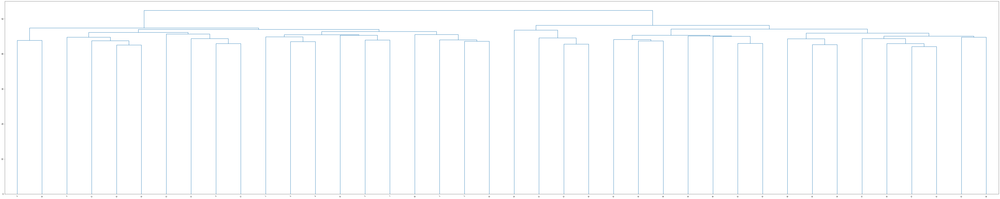

In [58]:
Z3 = hierarchy.linkage(np.array(data.T), 'complete', 'euclidean')
plt.figure(figsize=(100, 20))
dn = hierarchy.dendrogram(Z3)
plt.show()

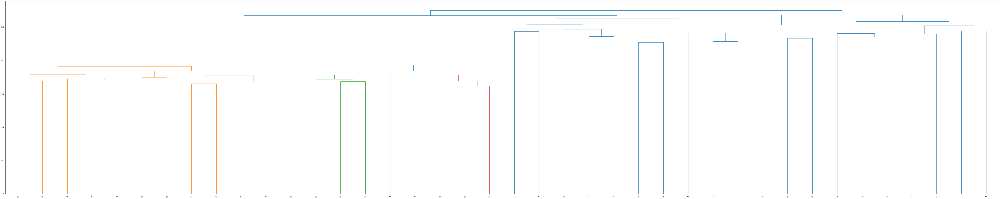

In [59]:
Z4 = hierarchy.linkage(np.array(data.T), 'complete', 'correlation')
plt.figure(figsize=(100, 20))
dn = hierarchy.dendrogram(Z4)
plt.show()

In [60]:
hierarchical_bottom_up_clustering_a_e(np.array(data))

285 & 974 clusters were joined together in iteration 1 with new cluster number 285
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 17

276 & 664 clusters were joined together in iteration 3 with new cluster number 276
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 17

697 & 871 clusters were joined together in iteration 5 with new cluster number 697
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 17

111 & 826 clusters were joined together in iteration 7 with new cluster number 111
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 17

98 & 217 clusters were joined together in iteration 9 with new cluster number 98
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 176.

95 & 294 clusters were joined together in iteration 11 with new cluster number 95
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 176

131 & 467 clusters were joined together in iteration 13 with new cluster number 131
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

622 & 976 clusters were joined together in iteration 15 with new cluster number 622
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

190 & 977 clusters were joined together in iteration 17 with new cluster number 190
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

505 & 558 clusters were joined together in iteration 19 with new cluster number 505
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

877 & 979 clusters were joined together in iteration 21 with new cluster number 877
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

905 & 951 clusters were joined together in iteration 23 with new cluster number 905
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

898 & 909 clusters were joined together in iteration 25 with new cluster number 898
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

634 & 793 clusters were joined together in iteration 27 with new cluster number 634
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

382 & 882 clusters were joined together in iteration 29 with new cluster number 382
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

31 & 713 clusters were joined together in iteration 31 with new cluster number 31
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 176

726 & 882 clusters were joined together in iteration 33 with new cluster number 726
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

108 & 441 clusters were joined together in iteration 35 with new cluster number 108
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

97 & 184 clusters were joined together in iteration 37 with new cluster number 97
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 176

290 & 310 clusters were joined together in iteration 39 with new cluster number 290
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

170 & 691 clusters were joined together in iteration 41 with new cluster number 170
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

87 & 277 clusters were joined together in iteration 43 with new cluster number 87
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 176

258 & 689 clusters were joined together in iteration 45 with new cluster number 258
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

310 & 383 clusters were joined together in iteration 47 with new cluster number 310
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

443 & 588 clusters were joined together in iteration 49 with new cluster number 443
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

83 & 747 clusters were joined together in iteration 51 with new cluster number 83
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 176

434 & 927 clusters were joined together in iteration 53 with new cluster number 434
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

319 & 837 clusters were joined together in iteration 55 with new cluster number 319
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

200 & 895 clusters were joined together in iteration 57 with new cluster number 200
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

469 & 804 clusters were joined together in iteration 59 with new cluster number 469
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

201 & 730 clusters were joined together in iteration 61 with new cluster number 201
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

224 & 413 clusters were joined together in iteration 63 with new cluster number 224
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

541 & 569 clusters were joined together in iteration 65 with new cluster number 541
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

158 & 718 clusters were joined together in iteration 67 with new cluster number 158
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

505 & 569 clusters were joined together in iteration 69 with new cluster number 505
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

444 & 654 clusters were joined together in iteration 71 with new cluster number 444
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

294 & 419 clusters were joined together in iteration 73 with new cluster number 294
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

147 & 601 clusters were joined together in iteration 75 with new cluster number 147
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

40 & 706 clusters were joined together in iteration 77 with new cluster number 40
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 176

134 & 644 clusters were joined together in iteration 79 with new cluster number 134
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

28 & 262 clusters were joined together in iteration 81 with new cluster number 28
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 176

33 & 183 clusters were joined together in iteration 83 with new cluster number 33
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 176

164 & 828 clusters were joined together in iteration 85 with new cluster number 164
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

280 & 867 clusters were joined together in iteration 87 with new cluster number 280
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

93 & 685 clusters were joined together in iteration 89 with new cluster number 93
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 176

208 & 806 clusters were joined together in iteration 91 with new cluster number 208
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

419 & 717 clusters were joined together in iteration 93 with new cluster number 419
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

221 & 599 clusters were joined together in iteration 95 with new cluster number 221
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

7 & 610 clusters were joined together in iteration 97 with new cluster number 7
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 176. 

421 & 684 clusters were joined together in iteration 99 with new cluster number 421
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

386 & 888 clusters were joined together in iteration 101 with new cluster number 386
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 

74 & 424 clusters were joined together in iteration 103 with new cluster number 74
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 17

41 & 363 clusters were joined together in iteration 105 with new cluster number 41
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 17

5 & 630 clusters were joined together in iteration 107 with new cluster number 5
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 176.

309 & 676 clusters were joined together in iteration 109 with new cluster number 309
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 

27 & 205 clusters were joined together in iteration 111 with new cluster number 27
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 17

206 & 360 clusters were joined together in iteration 114 with new cluster number 206
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 

330 & 465 clusters were joined together in iteration 116 with new cluster number 330
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 

354 & 845 clusters were joined together in iteration 119 with new cluster number 354
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 

52 & 836 clusters were joined together in iteration 121 with new cluster number 52
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 17

372 & 460 clusters were joined together in iteration 123 with new cluster number 372
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 

216 & 779 clusters were joined together in iteration 125 with new cluster number 216
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 

360 & 412 clusters were joined together in iteration 127 with new cluster number 360
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 

108 & 264 clusters were joined together in iteration 129 with new cluster number 108
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 

173 & 338 clusters were joined together in iteration 131 with new cluster number 173
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 

402 & 757 clusters were joined together in iteration 133 with new cluster number 402
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 

38 & 94 clusters were joined together in iteration 135 with new cluster number 38
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 175

42 & 593 clusters were joined together in iteration 137 with new cluster number 42
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 17

676 & 726 clusters were joined together in iteration 139 with new cluster number 676
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 

291 & 824 clusters were joined together in iteration 141 with new cluster number 291
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 

142 & 199 clusters were joined together in iteration 144 with new cluster number 142
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 

383 & 723 clusters were joined together in iteration 146 with new cluster number 383
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 

265 & 808 clusters were joined together in iteration 148 with new cluster number 265
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 

210 & 439 clusters were joined together in iteration 151 with new cluster number 210
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 

438 & 748 clusters were joined together in iteration 154 with new cluster number 438
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 175. 176. 177. 178. 179. 180.
 181.  33.  96. 182. 183. 184. 185. 186. 187. 188. 189.

195 & 610 clusters were joined together in iteration 158 with new cluster number 195
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 

110 & 586 clusters were joined together in iteration 160 with new cluster number 110
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
   9. 167. 168. 169. 170. 171. 172. 173. 

356 & 408 clusters were joined together in iteration 163 with new cluster number 356
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
   9. 167. 168. 169. 170. 171. 172. 173. 

246 & 646 clusters were joined together in iteration 166 with new cluster number 246
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
   9. 167. 168. 169. 170. 171. 172. 173. 

516 & 548 clusters were joined together in iteration 168 with new cluster number 516
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
   9. 167. 168. 169. 170. 171. 172. 173. 

0 & 399 clusters were joined together in iteration 170 with new cluster number 0
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
   9. 167. 168. 169. 170. 171. 172. 173. 174.

601 & 629 clusters were joined together in iteration 173 with new cluster number 601
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
   9. 167. 168. 169. 170. 171. 172. 173. 

192 & 320 clusters were joined together in iteration 175 with new cluster number 192
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
   9. 167. 168. 169. 170. 171. 172. 173. 

118 & 812 clusters were joined together in iteration 177 with new cluster number 118
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
   9. 167. 168. 169. 170. 171. 172. 173. 

71 & 100 clusters were joined together in iteration 179 with new cluster number 71
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99.  71. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
   9. 166. 167. 168. 169. 170. 171. 172. 17

128 & 556 clusters were joined together in iteration 182 with new cluster number 128
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99.  71. 100.  87. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.
   9. 165. 166. 167. 168. 169. 170. 171. 

307 & 554 clusters were joined together in iteration 184 with new cluster number 307
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99.  71. 100.  87. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.
   9. 165. 166. 167. 168. 169. 170. 171. 

413 & 692 clusters were joined together in iteration 186 with new cluster number 413
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99.  71. 100.  87. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.
   9. 165. 166. 167. 168. 169. 170. 171. 

345 & 406 clusters were joined together in iteration 189 with new cluster number 345
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99.  71. 100.  87. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.
   9. 165. 166. 167. 168. 169. 170. 171. 

51 & 385 clusters were joined together in iteration 191 with new cluster number 51
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  94.  95.  96.
  97.  98.  99.  71. 100.  87. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.
   9. 165. 166. 167. 168. 169. 170. 171. 17

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  35.  94.  95.
  96.  97.  98.  71.  99.  87. 100. 101. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135.
 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149.
 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163.
   9. 164. 165. 166. 167. 168. 169. 170. 171. 172. 173. 174. 175. 176.
 177.  33.  95. 178. 179. 180. 181. 182. 183. 184. 185.

424 & 678 clusters were joined together in iteration 195 with new cluster number 424
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  35.  94.  95.
  96.  97.  98.  71.  99.  87. 100. 101. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135.
 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149.
 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163.
   9. 164. 165. 166. 167. 168. 169. 170. 

332 & 669 clusters were joined together in iteration 198 with new cluster number 332
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  35.  94.  95.
  96.  97.  98.  71.  99.  87. 100. 101. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135.
 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149.
 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163.
   9. 164. 165. 166. 167. 168. 169. 170. 

98 & 233 clusters were joined together in iteration 200 with new cluster number 98
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  35.  94.  95.
  96.  97.  98.  71.  99.  87. 100. 101. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135.
 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149.
 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163.
   9. 164. 165. 166. 167. 168. 169. 170. 17

165 & 617 clusters were joined together in iteration 202 with new cluster number 165
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  35.  94.  95.
  96.  97.  98.  71.  99.  87. 100. 101. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135.
 136. 137. 138. 139. 140. 141. 142.  41. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
   9. 163. 164. 165. 166. 167. 168. 169. 

286 & 768 clusters were joined together in iteration 204 with new cluster number 286
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  35.  94.  95.
  96.  97.  98.  71.  99.  87. 100. 101. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135.
 136. 137. 138. 139. 140. 141. 142.  41. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
   9. 163. 164. 165. 166. 167. 168. 169. 

258 & 759 clusters were joined together in iteration 206 with new cluster number 258
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  38.  35.  94.  95.
  96.  97.  98.  71.  99.  87. 100. 101. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135.
 136. 137. 138. 139. 140. 141. 142.  41. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
   9. 163. 164. 165. 166. 167. 168. 169. 

268 & 555 clusters were joined together in iteration 208 with new cluster number 268
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  59.  84.  85.  86.  87.  88.  89.  90.  91.  92.  38.  35.  93.  94.
  95.  96.  97.  71.  98.  86.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141.  41. 142. 143. 144. 145. 146. 147.
 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161.
   9. 162. 163. 164. 165. 166. 167. 168. 

84 & 147 clusters were joined together in iteration 210 with new cluster number 84
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  59.  84.  85.  86.  87.  88.  89.  90.  91.  92.  38.  35.  93.  94.
  95.  96.  97.  71.  98.  86.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141.  41. 142. 143. 144. 145. 146.  84.
 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160.
   9. 161. 162. 163. 164. 165. 166. 167. 16

195 & 661 clusters were joined together in iteration 212 with new cluster number 195
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  59.  84.  85.  86.  87.  88.  89.  90.  91.  92.  38.  35.  93.  94.
  95.  96.  97.  71.  98.  86.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141.  41. 142. 143. 144. 145. 146.  84.
 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160.
   9. 161. 162. 163. 164. 165. 166. 167. 

557 & 635 clusters were joined together in iteration 214 with new cluster number 557
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  59.  84.  85.  86.  87.  88.  89.  90.  91.  92.  38.  35.  93.  94.
  95.  96.  97.  71.  98.  86.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141.  41. 142. 143. 144. 145. 146.  84.
 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160.
   9. 161. 162. 163. 164. 165. 166. 167. 

295 & 532 clusters were joined together in iteration 216 with new cluster number 295
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  59.  83.  84.  85.  86.  87.  88.  89.  90.  91.  38.  35.  92.  93.
  94.  95.  96.  70.  97.  85.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  83.
 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159.
   9. 160. 161. 162. 163. 164. 165. 166. 

341 & 751 clusters were joined together in iteration 218 with new cluster number 341
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  59.  83.  84.  85.  86.  87.  88.  89.  90.  91.  38.  35.  92.  93.
  94.  95.  96.  70.  97.  85.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  83.
 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159.
   9. 160. 161. 162. 163. 164. 165. 166. 

192 & 385 clusters were joined together in iteration 220 with new cluster number 192
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  59.  83.  84.  85.  86.  87.  88.  89.  90.  91.  38.  35.  92.  93.
  94.  95.  96.  70.  97.  85.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  83.
 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159.
   9. 160. 161. 162. 163. 164. 165. 166. 

153 & 746 clusters were joined together in iteration 222 with new cluster number 153
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  59.  83.  84.  85.  86.  87.  88.  89.  90.  91.  38.  35.  92.  93.
  94.  95.  96.  70.  97.  85.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  83.
 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159.
   9. 160. 161. 162. 163. 164. 165. 166. 

447 & 485 clusters were joined together in iteration 224 with new cluster number 447
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  59.  83.  84.  85.  86.  87.  88.  89.  90.  91.  38.  35.  92.  93.
  94.  95.  96.  70.  97.  85.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  83.
 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159.
   9. 160. 161. 162. 163. 164. 165. 166. 

404 & 717 clusters were joined together in iteration 227 with new cluster number 404
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  59.  83.  84.  85.  86.  87.  88.  89.  90.  91.  38.  35.  92.  93.
  94.  95.  96.  70.  97.  85.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  83.
 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159.
   9. 160. 161. 162. 163. 164. 165. 166. 

167 & 755 clusters were joined together in iteration 230 with new cluster number 167
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  59.  83.  84.  85.  86.  87.  88.  89.  90.  91.  38.  35.  92.  93.
  94.  95.  96.  70.  97.  85.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  83.
 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159.
   9. 160. 161. 162. 163. 164. 165. 166. 

287 & 729 clusters were joined together in iteration 232 with new cluster number 287
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  59.  83.  84.  85.  86.  87.  88.  89.  90.  91.  38.  35.  92.  93.
  94.  95.  96.  70.  97.  85.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  83.
 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159.
   9. 160. 161. 162. 163. 164. 165. 166. 

389 & 675 clusters were joined together in iteration 234 with new cluster number 389
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  59.  83.  84.  85.  86.  87.  88.  89.  90.  91.  38.  35.  92.  93.
  94.  95.  96.  70.  97.  85.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  83.
 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156.  91. 157. 158.
   9. 159. 160. 161. 162. 163. 164. 165. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  59.  83.  84.  85.  86.  87.  88.  89.  90.  91.  38.  35.  92.  93.
  94.  95.  96.  70.  97.  85.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  83.
 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156.  91. 157. 158.
   9. 159. 160. 161. 162. 163. 164. 165. 166. 167. 168. 169. 170. 171.
 172.  33.  93. 173. 174. 175. 176. 177. 178. 179. 180.

406 & 689 clusters were joined together in iteration 238 with new cluster number 406
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  59.  83.  84.  85.  86.  87.  88.  89.  90.  91.  38.  35.  92.  93.
  94.  95.  96.  70.  97.  85.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  83.
 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156.  91. 157. 158.
   9. 159. 160. 161. 162. 163. 164. 165. 

38 & 178 clusters were joined together in iteration 240 with new cluster number 38
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  59.  83.  84.  85.  86.  87.  88.  89.  90.  91.  38.  35.  92.  93.
  94.  95.  96.  70.  97.  85.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  83.
 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156.  91. 157. 158.
   9. 159. 160. 161. 162. 163. 164. 165. 16

704 & 737 clusters were joined together in iteration 242 with new cluster number 704
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  59.  83.  84.  85.  86.  87.  88.  89.  90.  91.  38.  35.  92.  93.
  94.  95.  96.  70.  97.  85.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  83.
 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156.  91. 157. 158.
   9. 159. 160. 161. 162. 163. 164. 165. 

233 & 413 clusters were joined together in iteration 244 with new cluster number 233
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  59.  83.  84.  85.  86.  87.  88.  89.  90.  91.  38.  35.  92.  93.
  94.  95.  96.  70.  97.  85.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  83.
 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156.  91. 157. 158.
   9. 159. 160. 161. 162. 163. 164. 165. 

228 & 589 clusters were joined together in iteration 246 with new cluster number 228
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  59.  83.  84.  85.  86.  87.  88.  89.  90.  91.  38.  35.  92.  93.
  94.  95.  96.  70.  97.  85.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  83.
 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156.  91. 157. 158.
   9. 159. 160. 161. 162. 163. 164. 165. 

342 & 347 clusters were joined together in iteration 248 with new cluster number 342
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  59.  83.  84.  85.  86.  87.  88.  89.  90.  91.  38.  35.  92.  93.
  94.  95.  96.  70.  97.  85.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  83.
 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156.  91. 157. 158.
   9. 159. 160. 161. 162. 163. 164. 165. 

26 & 591 clusters were joined together in iteration 250 with new cluster number 26
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  59.  83.  84.  85.  86.  87.  88.  89.  90.  91.  38.  35.  92.  93.
  94.  95.  96.  70.  97.  85.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140.  41. 141. 142. 143. 144. 145.  83.
 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156.  91. 157. 158.
   9. 159. 160. 161. 162. 163. 164. 165. 16

8 & 65 clusters were joined together in iteration 252 with new cluster number 8
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.  90. 156. 157.
   9. 158. 159. 160. 161. 162. 163. 164. 165. 

534 & 573 clusters were joined together in iteration 254 with new cluster number 534
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.  90. 156. 157.
   9. 158. 159. 160. 161. 162. 163. 164. 

292 & 707 clusters were joined together in iteration 257 with new cluster number 292
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.  90. 156. 157.
   9. 158. 159. 160. 161. 162. 163. 164. 

518 & 692 clusters were joined together in iteration 259 with new cluster number 518
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.  90. 156. 157.
   9. 158. 159. 160. 161. 162. 163. 164. 

103 & 700 clusters were joined together in iteration 261 with new cluster number 103
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.  90. 156. 157.
   9. 158. 159. 160. 161. 162. 163. 164. 

216 & 278 clusters were joined together in iteration 263 with new cluster number 216
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.  90. 156. 157.
   9. 158. 159. 160. 161. 162. 163. 164. 

120 & 559 clusters were joined together in iteration 265 with new cluster number 120
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.  90. 156. 157.
   9. 158. 159. 160. 161. 162. 163. 164. 

86 & 541 clusters were joined together in iteration 268 with new cluster number 86
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.  90. 156. 157.
   9. 158. 159. 160. 161. 162. 163. 164. 16

509 & 713 clusters were joined together in iteration 270 with new cluster number 509
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.  90. 156. 157.
   9. 158. 159. 160. 161. 162. 163. 164. 

435 & 446 clusters were joined together in iteration 272 with new cluster number 435
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.  90. 156. 157.
   9. 158. 159. 160. 161. 162. 163. 164. 

207 & 674 clusters were joined together in iteration 275 with new cluster number 207
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.  90. 156. 157.
   9. 158. 159. 160. 161. 162. 163. 164. 

25 & 610 clusters were joined together in iteration 277 with new cluster number 25
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.  90. 156. 157.
   9. 158. 159. 160. 161. 162. 163. 164. 16

239 & 670 clusters were joined together in iteration 279 with new cluster number 239
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.  90. 156. 157.
   9. 158. 159. 160. 161. 162. 163. 164. 

151 & 539 clusters were joined together in iteration 281 with new cluster number 151
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.  90. 156. 157.
   9. 158. 159. 160. 161. 162. 163. 164. 

442 & 468 clusters were joined together in iteration 283 with new cluster number 442
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.  90. 156. 157.
   9. 158. 159. 160. 161. 162. 163. 164. 

2 & 257 clusters were joined together in iteration 285 with new cluster number 2
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.  90. 156. 157.
   9. 158. 159. 160. 161. 162. 163. 164. 165.

58 & 671 clusters were joined together in iteration 287 with new cluster number 58
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.  90. 156. 157.
   9. 158. 159. 160. 161. 162. 163. 164. 16

378 & 700 clusters were joined together in iteration 289 with new cluster number 378
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.  90. 156. 157.
   9. 158. 159. 160. 161. 162. 163. 164. 

201 & 570 clusters were joined together in iteration 292 with new cluster number 201
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.  90. 156. 157.
   9. 158. 159. 160. 161. 162. 163. 164. 

1 & 159 clusters were joined together in iteration 294 with new cluster number 1
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.  90. 156. 157.
   9. 158.   1. 159. 160. 161. 162. 163. 164.

239 & 612 clusters were joined together in iteration 297 with new cluster number 239
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.  90. 156. 157.
   9. 158.   1. 159. 160. 161. 162. 163. 

215 & 360 clusters were joined together in iteration 299 with new cluster number 215
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.  90. 156. 157.
   9. 158.   1. 159. 160. 161. 162. 163. 

184 & 536 clusters were joined together in iteration 301 with new cluster number 184
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.  90. 156. 157.
   9. 158.   1. 159. 160. 161. 162. 163. 

249 & 291 clusters were joined together in iteration 303 with new cluster number 249
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.  90. 156. 157.
   9. 158.   1. 159. 160. 161. 162. 163. 

294 & 367 clusters were joined together in iteration 305 with new cluster number 294
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.  90. 156. 157.
   9. 158.   1. 159. 160. 161. 162. 163. 

63 & 592 clusters were joined together in iteration 307 with new cluster number 63
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.  90. 156. 157.
   9. 158.   1. 159. 160. 161. 162. 163. 16

213 & 545 clusters were joined together in iteration 309 with new cluster number 213
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139.  41. 140. 141. 142. 143. 144.  82.
 145. 146. 147. 148. 149. 150. 151. 152. 153. 154. 155.  90. 156. 157.
   9. 158.   1. 159. 160. 161. 162. 163. 

5 & 106 clusters were joined together in iteration 312 with new cluster number 5
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105.   5. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138.  41. 139. 140. 141. 142. 143.  82.
 144. 145. 146. 147. 148. 149. 150. 151. 152. 153. 154.  90. 155. 156.
   9. 157.   1. 158. 159. 160. 161. 162. 163.

290 & 605 clusters were joined together in iteration 314 with new cluster number 290
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105.   5. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138.  41. 139. 140. 141. 142. 143.  82.
 144. 145. 146. 147. 148. 149. 150. 151. 152. 153. 154.  90. 155. 156.
   9. 157.   1. 158. 159. 160. 161. 162. 

197 & 241 clusters were joined together in iteration 316 with new cluster number 197
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105.   5. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138.  41. 139. 140. 141. 142. 143.  82.
 144. 145. 146. 147. 148. 149. 150. 151. 152. 153. 154.  90. 155. 156.
   9. 157.   1. 158. 159. 160. 161. 162. 

102 & 368 clusters were joined together in iteration 318 with new cluster number 102
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105.   5. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138.  41. 139. 140. 141. 142. 143.  82.
 144. 145. 146. 147. 148. 149. 150. 151. 152. 153. 154.  90. 155. 156.
   9. 157.   1. 158. 159. 160. 161. 162. 

78 & 261 clusters were joined together in iteration 320 with new cluster number 78
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105.   5. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138.  41. 139. 140. 141. 142. 143.  82.
 144. 145. 146. 147. 148. 149. 150. 151. 152. 153. 154.  90. 155. 156.
   9. 157.   1. 158. 159. 160. 161. 162. 16

2 & 353 clusters were joined together in iteration 322 with new cluster number 2
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105.   5. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138.  41. 139. 140. 141. 142. 143.  82.
 144. 145. 146. 147. 148. 149. 150. 151. 152. 153. 154.  90. 155. 156.
   9. 157.   1. 158. 159. 160. 161. 162. 163.

206 & 330 clusters were joined together in iteration 324 with new cluster number 206
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  59.  82.  83.  84.  85.  86.  87.  88.  89.  90.  38.  35.  91.  92.
  93.  94.  95.  69.  96.  84.  97.  98.  99. 100. 101. 102. 103. 104.
 105.   5. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138.  41. 139. 140. 141. 142. 143.  82.
 144. 145. 146. 147. 148. 149. 150. 151. 152. 153. 154.  90. 155. 156.
   9. 157.   1. 158. 159. 160. 161. 162. 

479 & 486 clusters were joined together in iteration 326 with new cluster number 479
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.   9.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104.   5. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137.  41. 138. 139. 140. 141. 142.  81.
 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.  89. 154. 155.
   9. 156.   1. 157. 158. 159. 160. 161. 

524 & 643 clusters were joined together in iteration 328 with new cluster number 524
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.   9.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104.   5. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137.  41. 138. 139. 140. 141. 142.  81.
 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.  89. 154. 155.
   9. 156.   1. 157. 158. 159. 160. 161. 

143 & 148 clusters were joined together in iteration 330 with new cluster number 143
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.   9.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104.   5. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137.  41. 138. 139. 140. 141. 142.  81.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152.  89. 153. 154.
   9. 155.   1. 156. 157. 158. 159. 160. 

56 & 492 clusters were joined together in iteration 332 with new cluster number 56
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.   9.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104.   5. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137.  41. 138. 139. 140. 141. 142.  81.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152.  89. 153. 154.
   9. 155.   1. 156. 157. 158. 159. 160. 16

189 & 341 clusters were joined together in iteration 334 with new cluster number 189
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.   9.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104.   5. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137.  41. 138. 139. 140. 141. 142.  81.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152.  89. 153. 154.
   9. 155.   1. 156. 157. 158. 159. 160. 

177 & 610 clusters were joined together in iteration 336 with new cluster number 177
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.   9.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104.   5. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137.  41. 138. 139. 140. 141. 142.  81.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152.  89. 153. 154.
   9. 155.   1. 156. 157. 158. 159. 160. 

524 & 637 clusters were joined together in iteration 338 with new cluster number 524
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.   9.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104.   5. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137.  41. 138. 139. 140. 141. 142.  81.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152.  89. 153. 154.
   9. 155.   1. 156. 157. 158. 159. 160. 

327 & 372 clusters were joined together in iteration 340 with new cluster number 327
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.   9.  80.
  59.  81.  82.  83.  84.  85.  86.  87.  88.  89.  38.  35.  90.  91.
  92.  93.  94.  69.  95.  83.  96.  97.  98.  99. 100. 101. 102. 103.
 104.   5. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137.  41. 138. 139. 140. 141. 142.  81.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152.  89. 153. 154.
   9. 155.   1. 156. 157. 158. 159. 160. 

505 & 599 clusters were joined together in iteration 342 with new cluster number 505
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101. 102.
 103.   5. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136.  41. 137. 138. 139. 140. 141.  80.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151.  88. 152. 153.
   9. 154.   1. 155. 156. 157. 158. 159. 

66 & 316 clusters were joined together in iteration 344 with new cluster number 66
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101. 102.
 103.   5. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136.  41. 137. 138. 139. 140. 141.  80.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151.  88. 152. 153.
   9. 154.   1. 155. 156. 157. 158. 159. 16

42 & 494 clusters were joined together in iteration 346 with new cluster number 42
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101. 102.
 103.   5. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136.  41. 137. 138. 139. 140. 141.  80.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151.  88. 152. 153.
   9. 154.   1. 155. 156. 157. 158. 159. 16

20 & 309 clusters were joined together in iteration 348 with new cluster number 20
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101. 102.
 103.   5. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136.  41. 137. 138. 139. 140. 141.  80.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151.  88. 152. 153.
   9. 154.   1. 155. 156. 157. 158. 159. 16

307 & 514 clusters were joined together in iteration 350 with new cluster number 307
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101. 102.
 103.   5. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136.  41. 137. 138. 139. 140. 141.  80.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151.  88. 152. 153.
   9. 154.   1. 155. 156. 157. 158. 159. 

477 & 608 clusters were joined together in iteration 352 with new cluster number 477
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101. 102.
 103.   5. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136.  41. 137. 138. 139. 140. 141.  80.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151.  88. 152. 153.
   9. 154.   1. 155. 156. 157. 158. 159. 

397 & 409 clusters were joined together in iteration 354 with new cluster number 397
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101. 102.
 103.   5. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136.  41. 137. 138. 139. 140. 141.  80.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151.  88. 152. 153.
   9. 154.   1. 155. 156. 157. 158. 159. 

498 & 535 clusters were joined together in iteration 356 with new cluster number 498
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101. 102.
 103.   5. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136.  41. 137. 138. 139. 140. 141.  80.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151.  88. 152. 153.
   9. 154.   1. 155. 156. 157. 158. 159. 

488 & 599 clusters were joined together in iteration 358 with new cluster number 488
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101. 102.
 103.   5. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136.  41. 137. 138. 139. 140. 141.  80.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151.  88. 152. 153.
   9. 154.   1. 155. 156. 157. 158. 159. 

51 & 336 clusters were joined together in iteration 360 with new cluster number 51
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101. 102.
 103.   5. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136.  41. 137. 138. 139. 140. 141.  80.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151.  88. 152. 153.
   9. 154.   1. 155. 156. 157. 158. 159. 16

47 & 183 clusters were joined together in iteration 362 with new cluster number 47
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101. 102.
 103.   5. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136.  41. 137. 138. 139. 140. 141.  80.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151.  88. 152. 153.
   9. 154.   1. 155. 156. 157. 158. 159. 16

475 & 593 clusters were joined together in iteration 364 with new cluster number 475
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101. 102.
 103.   5. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136.  41. 137. 138. 139. 140. 141.  80.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151.  88. 152. 153.
   9. 154.   1. 155. 156. 157. 158. 159. 

30 & 571 clusters were joined together in iteration 366 with new cluster number 30
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101. 102.
 103.   5. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136.  41. 137. 138. 139. 140. 141.  80.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151.  88. 152. 153.
   9. 154.   1. 155. 156. 157. 158. 159. 16

143 & 522 clusters were joined together in iteration 368 with new cluster number 143
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101. 102.
 103.   5. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136.  41. 137. 138. 139. 140. 141.  80.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151.  88. 152. 153.
   9. 154.   1. 155. 156. 157. 158. 159. 

156 & 497 clusters were joined together in iteration 370 with new cluster number 156
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101. 102.
 103.   5. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136.  41. 137. 138. 139. 140. 141.  80.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151.  88. 152. 153.
   9. 154.   1. 155. 156. 157. 158. 159. 

379 & 452 clusters were joined together in iteration 372 with new cluster number 379
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101. 102.
 103.   5. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136.  41. 137. 138. 139. 140. 141.  80.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151.  88. 152. 153.
   9. 154.   1. 155. 156. 157. 158. 159. 

255 & 502 clusters were joined together in iteration 374 with new cluster number 255
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101. 102.
 103.   5. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136.  41. 137. 138. 139. 140. 141.  80.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151.  88. 152. 153.
   9. 154.   1. 155. 156. 157. 158. 159. 

298 & 505 clusters were joined together in iteration 376 with new cluster number 298
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101. 102.
 103.   5. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136.  41. 137. 138. 139. 140. 141.  80.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151.  88. 152. 153.
   9. 154.   1. 155. 156. 157. 158. 159. 

150 & 522 clusters were joined together in iteration 378 with new cluster number 150
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101. 102.
 103.   5. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136.  41. 137. 138. 139. 140. 141.  80.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151.  88. 152. 153.
   9. 154.   1. 155. 156. 157. 158. 159. 

38 & 507 clusters were joined together in iteration 380 with new cluster number 38
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101. 102.
 103.   5. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136.  41. 137. 138. 139. 140. 141.  80.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151.  88. 152. 153.
   9. 154.   1. 155. 156. 157. 158. 159. 16

29 & 262 clusters were joined together in iteration 382 with new cluster number 29
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101. 102.
 103.   5. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136.  41. 137. 138. 139. 140. 141.  80.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151.  88. 152. 153.
   9. 154.   1. 155. 156. 157. 158. 159. 16

382 & 418 clusters were joined together in iteration 384 with new cluster number 382
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101. 102.
 103.   5. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136.  41. 137. 138. 139. 140. 141.  80.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151.  88. 152. 153.
   9. 154.   1. 155. 156. 157. 158. 159. 

309 & 582 clusters were joined together in iteration 386 with new cluster number 309
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101. 102.
 103.   5. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136.  41. 137. 138. 139. 140. 141.  80.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151.  88. 152. 153.
   9. 154.   1. 155. 156. 157. 158. 159. 

15 & 427 clusters were joined together in iteration 389 with new cluster number 15
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101.  88.
 102.   5. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135.  41. 136. 137. 138. 139. 140.  80.
 141. 142. 143. 144. 145. 141. 146. 147. 148. 149. 150.  88. 151. 152.
   9. 153.   1. 154. 155. 156. 157. 158. 15

298 & 346 clusters were joined together in iteration 391 with new cluster number 298
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101.  88.
 102.   5. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135.  41. 136. 137. 138. 139. 140.  80.
 141. 142. 143. 144. 145. 141. 146. 147. 148. 149. 150.  88. 151. 152.
   9. 153.   1. 154. 155. 156. 157. 158. 

99 & 462 clusters were joined together in iteration 393 with new cluster number 99
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101.  88.
 102.   5. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135.  41. 136. 137. 138. 139. 140.  80.
 141. 142. 143. 144. 145. 141. 146. 147. 148. 149. 150.  88. 151. 152.
   9. 153.   1. 154. 155. 156. 157. 158. 15

510 & 602 clusters were joined together in iteration 395 with new cluster number 510
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101.  88.
 102.   5. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
  41. 129. 130. 131. 132. 133. 134.  41. 135. 136. 137. 138. 139.  80.
 140. 141. 142. 143. 144. 140. 145. 146. 147. 148. 149.  88. 150. 151.
   9. 152.   1. 153. 154. 155. 156. 157. 

98 & 115 clusters were joined together in iteration 397 with new cluster number 98
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101.  88.
 102.   5. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
  98. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127.
  41. 128. 129. 130. 131. 132. 133.  41. 134. 135. 136. 137. 138.  80.
 139. 140. 141. 142. 143. 139. 144. 145. 146. 147. 148.  88. 149. 150.
   9. 151.   1. 152. 153. 154. 155. 156. 15

273 & 511 clusters were joined together in iteration 399 with new cluster number 273
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101.  88.
 102.   5. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
  98. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127.
  41. 128. 129. 130. 131. 132. 133.  41. 134. 135. 136. 137. 138.  80.
 139. 140. 141. 142. 143. 139. 144. 145. 146. 147. 148.  88. 149. 150.
   9. 151.   1. 152. 153. 154. 155. 156. 

188 & 241 clusters were joined together in iteration 401 with new cluster number 188
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101.  88.
 102.   5. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
  98. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127.
  41. 128. 129. 130. 131. 132. 133.  41. 134. 135. 136. 137. 138.  80.
 139. 140. 141. 142. 143. 139. 144. 145. 146. 147. 148.  88. 149. 150.
   9. 151.   1. 152. 153. 154. 155. 156. 

84 & 349 clusters were joined together in iteration 403 with new cluster number 84
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101.  88.
 102.   5. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
  98. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127.
  41. 128. 129. 130. 131. 132. 133.  41. 134. 135. 136. 137. 138.  80.
 139. 140. 141. 142. 143. 139. 144. 145. 146. 147. 148.  88. 149. 150.
   9. 151.   1. 152. 153. 154. 155. 156. 15

133 & 513 clusters were joined together in iteration 405 with new cluster number 133
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101.  88.
 102.   5. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
  98. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127.
  41. 128. 129. 130. 131. 132. 133.  41. 134. 135. 136. 137. 138.  80.
 139. 140. 141. 142. 143. 139. 144. 145. 146. 147. 148.  88. 149. 150.
   9. 151.   1. 152. 153. 154. 155. 156. 

226 & 464 clusters were joined together in iteration 407 with new cluster number 226
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101.  88.
 102.   5. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
  98. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127.
  41. 128. 129. 130. 131. 132. 133.  41. 134. 135. 136. 137. 138.  80.
 139. 140. 141. 142. 143. 139. 144. 145. 146. 147. 148.  88. 149. 150.
   9. 151.   1. 152. 153. 154. 155. 156. 

364 & 385 clusters were joined together in iteration 409 with new cluster number 364
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101.  88.
 102.   5. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
  98. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127.
  41. 128. 129. 130. 131. 132. 133.  41. 134. 135. 136. 137. 138.  80.
 139. 140. 141. 142. 143. 139. 144. 145. 146. 147. 148.  88. 149. 150.
   9. 151.   1. 152. 153. 154. 155. 156. 

90 & 148 clusters were joined together in iteration 412 with new cluster number 90
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101.  88.
 102.   5. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
  98. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127.
  41. 128. 129. 130. 131. 132. 133.  41. 134. 135. 136. 137. 138.  80.
 139. 140. 141. 142. 143. 139. 144. 145. 146. 147.  90.  88. 148. 149.
   9. 150.   1. 151. 152. 153. 154. 155. 15

28 & 516 clusters were joined together in iteration 415 with new cluster number 28
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101.  88.
 102.   5. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114.
  98. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127.
  41. 128. 129. 130. 131. 132. 133.  41. 134. 135. 136. 137. 138.  80.
 139. 140. 141. 142. 143. 139. 144. 145. 146. 147.  90.  88. 148. 149.
   9. 150.   1. 151. 152. 153. 154. 155. 15

210 & 501 clusters were joined together in iteration 417 with new cluster number 210
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101.  88.
 102.   5. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 107.
  98. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
  41. 127. 128. 129. 130. 131. 132.  41. 133. 134. 135. 136. 137.  80.
 138. 139. 140. 141. 142. 138. 143. 144. 145. 146.  90.  88. 147. 148.
   9. 149.   1. 150. 151. 152. 153. 154. 

112 & 553 clusters were joined together in iteration 419 with new cluster number 112
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101.  88.
 102.   5. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 107.
  98. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
  41. 127. 128. 129. 130. 131. 132.  41. 133. 134. 135. 136. 137.  80.
 138. 139. 140. 141. 142. 138. 143. 144. 145. 146.  90.  88. 147. 148.
   9. 149.   1. 150. 151. 152. 153. 154. 

25 & 476 clusters were joined together in iteration 422 with new cluster number 25
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101.  88.
 102.   5. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 107.
  98. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
  41. 127. 128. 129. 130. 131. 132.  41. 133. 134. 135. 136. 137.  80.
 138. 139. 140. 141. 142. 138. 143. 144. 145. 146.  90.  88. 147. 148.
   9. 149.   1. 150. 151. 152. 153. 154. 15

182 & 294 clusters were joined together in iteration 424 with new cluster number 182
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101.  88.
 102.   5. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 107.
  98. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
  41. 127. 128. 129. 130. 131. 132.  41. 133. 134. 135. 136. 137.  80.
 138. 139. 140. 141. 142. 138. 143. 144. 145. 146.  90.  88. 147. 148.
   9. 149.   1. 150. 151. 152. 153. 154. 

42 & 152 clusters were joined together in iteration 426 with new cluster number 42
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101.  88.
 102.   5. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 107.
  98. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
  41. 127. 128. 129. 130. 131. 132.  41. 133. 134. 135. 136. 137.  80.
 138. 139. 140. 141. 142. 138. 143. 144. 145. 146.  90.  88. 147. 148.
   9. 149.   1. 150. 151.  42. 152. 153. 15

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101.  88.
 102.   5. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 107.
  98. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
  41. 127. 128. 129. 130. 131. 132.  41. 133. 134. 135. 136. 137.  80.
 138. 139. 140. 141. 142. 138. 143. 144. 145. 146.  90.  88. 147. 148.
   9. 149.   1. 150. 151.  42. 152. 153. 154. 155. 156. 157. 158. 159.
  92.  33.  90. 160. 161. 162. 163. 164.  38. 165. 166.

68 & 249 clusters were joined together in iteration 430 with new cluster number 68
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101.  88.
 102.   5. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 107.
  98. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
  41. 127. 128. 129. 130. 131. 132.  41. 133. 134. 135. 136. 137.  80.
 138. 139. 140. 141. 142. 138. 143. 144. 145. 146.  90.  88. 147. 148.
   9. 149.   1. 150. 151.  42. 152. 153. 15

191 & 556 clusters were joined together in iteration 432 with new cluster number 191
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101.  88.
 102.   5. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 107.
  98. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
  41. 127. 128. 129. 130. 131. 132.  41. 133. 134. 135. 136. 137.  80.
 138. 139. 140. 141. 142. 138. 143. 144. 145. 146.  90.  88. 147. 148.
   9. 149.   1. 150. 151.  42. 152. 153. 

231 & 297 clusters were joined together in iteration 436 with new cluster number 231
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101.  88.
 102.   5. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 107.
  98. 114. 115. 116. 117. 118. 119. 120. 121. 122.  82. 123. 124. 125.
  41. 126. 127. 128. 129. 130. 131.  41. 132. 133. 134. 135. 136.  80.
 137. 138. 139. 140. 141. 137. 142. 143. 144. 145.  90.  88. 146. 147.
   9. 148.   1. 149. 150.  42. 151. 152. 

34 & 227 clusters were joined together in iteration 438 with new cluster number 34
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101.  88.
 102.   5. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 107.
  98. 114. 115. 116. 117. 118. 119. 120. 121. 122.  82. 123. 124. 125.
  41. 126. 127. 128. 129. 130. 131.  41. 132. 133. 134. 135. 136.  80.
 137. 138. 139. 140. 141. 137. 142. 143. 144. 145.  90.  88. 146. 147.
   9. 148.   1. 149. 150.  42. 151. 152. 15

171 & 519 clusters were joined together in iteration 441 with new cluster number 171
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101.  88.
 102.   5. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 107.
  98. 114. 115. 116. 117. 118. 119. 120. 121. 122.  82. 123. 124. 125.
  41. 126. 127. 128. 129. 130. 131.  41. 132. 133. 134. 135. 136.  80.
 137. 138. 139. 140. 141. 137. 142. 143. 144. 145.  90.  88. 146. 147.
   9. 148.   1. 149. 150.  42. 151. 152. 

1 & 291 clusters were joined together in iteration 443 with new cluster number 1
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101.  88.
 102.   5. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 107.
  98. 114. 115. 116. 117. 118. 119. 120. 121. 122.  82. 123. 124. 125.
  41. 126. 127. 128. 129. 130. 131.  41. 132. 133. 134. 135. 136.  80.
 137. 138. 139. 140. 141. 137. 142. 143. 144. 145.  90.  88. 146. 147.
   9. 148.   1. 149. 150.  42. 151. 152. 153.

347 & 387 clusters were joined together in iteration 446 with new cluster number 347
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101.  88.
 102.   5. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 107.
  98. 114. 115. 116. 117. 118. 119. 120. 121. 122.  82. 123. 124. 125.
  41. 126. 127. 128. 129. 130. 131.  41. 132. 133. 134. 135. 136.  80.
 137. 138. 139. 140. 141. 137. 142. 143. 144. 145.  90.  88. 146. 147.
   9. 148.   1. 149. 150.  42. 151. 152. 

118 & 306 clusters were joined together in iteration 449 with new cluster number 118
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101.  88.
 102.   5. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 107.
  98. 114. 115. 116. 117. 118. 119. 120. 121. 122.  82. 123. 124. 125.
  41. 126. 127. 128. 129. 130. 131.  41. 132. 133. 134. 135. 136.  80.
 137. 138. 139. 140. 141. 137. 142. 143. 144. 145.  90.  88. 146. 147.
   9. 148.   1. 149. 150.  42. 151. 152. 

429 & 509 clusters were joined together in iteration 452 with new cluster number 429
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101.  88.
 102.   5. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 107.
  98. 114. 115. 116. 117. 118. 119. 120. 121. 122.  82. 123. 124. 125.
  41. 126. 127. 128. 129. 130. 131.  41. 132. 133. 134. 135. 136.  80.
 137. 138. 139. 140. 141. 137. 142. 143. 144. 145.  90.  88. 146. 147.
   9. 148.   1. 149. 150.  42. 151. 152. 

24 & 522 clusters were joined together in iteration 455 with new cluster number 24
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101.  88.
 102.   5. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 107.
  98. 114. 115. 116. 117. 118. 119. 120. 121. 122.  82. 123. 124. 125.
  41. 126. 127. 128. 129. 130. 131.  41. 132. 133. 134. 135. 136.  80.
 137. 138. 139. 140. 141. 137. 142. 143. 144. 145.  90.  88. 146. 147.
   9. 148.   1. 149. 150.  42. 151. 152. 15

199 & 219 clusters were joined together in iteration 458 with new cluster number 199
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101.  88.
 102.   5. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 107.
  98. 114. 115. 116. 117. 118. 119. 120. 121. 122.  82. 123. 124. 125.
  41. 126. 127. 128. 129. 130. 131.  41. 132. 133. 134. 135. 136.  80.
 137. 138. 139. 140. 141. 137. 142. 143. 144. 145.  90.  88. 146. 147.
   9. 148.   1. 149. 150.  42. 151. 152. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101.  88.
 102.   5. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 107.
  98. 114. 115. 116. 117. 118. 119. 120. 121. 122.  82. 123. 124. 125.
  41. 126. 127. 128. 129. 130. 131.  41. 132. 133. 134. 135. 136.  80.
 137. 138. 139. 140. 141. 137. 142. 143. 144. 145.  90.  88. 146. 147.
   9. 148.   1. 149. 150.  42. 151. 152. 153. 154. 155. 156. 157. 158.
  92.  33.  90. 159. 160. 161. 162. 163.  38. 164. 165.

19 & 353 clusters were joined together in iteration 463 with new cluster number 19
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101.  88.
 102.   5. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 107.
  98. 114. 115. 116. 117. 118. 119. 120. 121. 122.  82. 123. 124. 125.
  41. 126. 127. 128. 129. 130. 131.  41. 132. 133. 134. 135. 136.  80.
 137. 138. 139. 140. 141. 137. 142. 143. 144. 145.  90.  88. 146. 147.
   9. 148.   1. 149. 150.  42. 151. 152. 15

75 & 126 clusters were joined together in iteration 465 with new cluster number 75
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101.  88.
 102.   5. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 107.
  98. 114. 115. 116. 117. 118. 119. 120. 121. 122.  82. 123. 124. 125.
  41.  75. 126. 127. 128. 129. 130.  41. 131. 132. 133. 134. 135.  80.
 136. 137. 138. 139. 140. 136. 141. 142. 143. 144.  90.  88. 145. 146.
   9. 147.   1. 148. 149.  42. 150. 151. 15

52 & 142 clusters were joined together in iteration 468 with new cluster number 52
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  69.  70.   7.  71.  72.  73.  74.  75.  76.  77.  78.   9.  79.
  59.  80.  81.  82.  83.  84.  85.  86.  87.  88.  38.  35.  89.  90.
  91.  92.  93.  69.  94.  82.  95.  96.  97.  98.  99. 100. 101.  88.
 102.   5. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 107.
  98. 114. 115. 116. 117. 118. 119. 120. 121. 122.  82. 123. 124. 125.
  41.  75. 126. 127. 128. 129. 130.  41. 131. 132. 133. 134. 135.  80.
 136. 137. 138. 139. 140. 136. 141.  52. 142. 143.  90.  88. 144. 145.
   9. 146.   1. 147. 148.  42. 149. 150. 15

41 & 69 clusters were joined together in iteration 470 with new cluster number 41
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  84.  85.  86.  87.  38.  35.  88.  89.
  90.  91.  92.  41.  93.  81.  94.  95.  96.  97.  98.  99. 100.  87.
 101.   5. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 106.
  97. 113. 114. 115. 116. 117. 118. 119. 120. 121.  81. 122. 123. 124.
  41.  74. 125. 126. 127. 128. 129.  41. 130. 131. 132. 133. 134.  79.
 135. 136. 137. 138. 139. 135. 140.  52. 141. 142.  89.  87. 143. 144.
   9. 145.   1. 146. 147.  42. 148. 149. 150

31 & 156 clusters were joined together in iteration 472 with new cluster number 31
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  84.  85.  86.  87.  38.  35.  88.  89.
  90.  91.  92.  41.  93.  81.  94.  95.  96.  97.  98.  99. 100.  87.
 101.   5. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 106.
  97. 113. 114. 115. 116. 117. 118. 119. 120. 121.  81. 122. 123. 124.
  41.  74. 125. 126. 127. 128. 129.  41. 130. 131. 132. 133. 134.  79.
 135. 136. 137. 138. 139. 135. 140.  52. 141. 142.  89.  87. 143. 144.
   9. 145.   1. 146. 147.  42. 148. 149. 15

151 & 425 clusters were joined together in iteration 474 with new cluster number 151
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  84.  85.  86.  87.  38.  35.  88.  89.
  90.  91.  92.  41.  93.  81.  94.  95.  96.  97.  98.  99. 100.  87.
 101.   5. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 106.
  97. 113. 114. 115. 116. 117. 118. 119. 120. 121.  81. 122. 123. 124.
  41.  74. 125. 126. 127. 128. 129.  41. 130. 131. 132. 133. 134.  79.
 135. 136. 137. 138. 139. 135. 140.  52. 141. 142.  89.  87. 143. 144.
   9. 145.   1. 146. 147.  42. 148. 149. 

237 & 262 clusters were joined together in iteration 476 with new cluster number 237
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  84.  85.  86.  87.  38.  35.  88.  89.
  90.  91.  92.  41.  93.  81.  94.  95.  96.  97.  98.  99. 100.  87.
 101.   5. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 106.
  97. 113. 114. 115. 116. 117. 118. 119. 120. 121.  81. 122. 123. 124.
  41.  74. 125. 126. 127. 128. 129.  41. 130. 131. 132. 133. 134.  79.
 135. 136. 137. 138. 139. 135. 140.  52. 141. 142.  89.  87. 143. 144.
   9. 145.   1. 146. 147.  42. 148. 149. 

292 & 506 clusters were joined together in iteration 478 with new cluster number 292
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  84.  85.  86.  87.  38.  35.  88.  89.
  90.  91.  92.  41.  93.  81.  94.  95.  96.  97.  98.  99. 100.  87.
 101.   5. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 112. 106.
  97. 113. 114. 115. 116. 117. 118. 119. 120. 121.  81. 122. 123. 124.
  41.  74. 125. 126. 127. 128. 129.  41. 130. 131. 132. 133. 134.  79.
 135. 136. 137. 138. 139. 135. 140.  52. 141. 142.  89.  87. 143. 144.
   9. 145.   1. 146. 147.  42. 148. 149. 

119 & 177 clusters were joined together in iteration 480 with new cluster number 119
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  84.  85.  86.  87.  38.  35.  88.  89.
  90.  91.  92.  41.  93.  81.  94.  95.  96.  97.  98.  70.  99.  87.
 100.   5. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 105.
  97. 112. 113. 114. 115. 116. 117. 118. 119. 120.  81. 121. 122. 123.
  41.  74. 124. 125. 126. 127. 128.  41. 129. 130. 131. 132. 133.  79.
 134. 135. 136. 137. 138. 134. 139.  52. 140. 141.  89.  87. 142. 143.
   9. 144.   1. 145. 146.  42. 147. 148. 

400 & 472 clusters were joined together in iteration 482 with new cluster number 400
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  84.  85.  86.  87.  38.  35.  88.  89.
  90.  91.  92.  41.  93.  81.  94.  95.  96.  97.  98.  70.  99.  87.
 100.   5. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 105.
  97. 112. 113. 114. 115. 116. 117. 118. 119. 120.  81. 121. 122. 123.
  41.  74. 124. 125. 126. 127. 128.  41. 129. 130. 131. 132. 133.  79.
 134. 135. 136. 137. 138. 134. 139.  52. 140. 141.  89.  87. 142. 143.
   9. 144.   1. 145. 146.  42. 147. 148. 

327 & 338 clusters were joined together in iteration 485 with new cluster number 327
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  84.  85.  86.  87.  38.  35.  88.  89.
  90.  91.  92.  41.  93.  81.  94.  95.  96.  97.  98.  70.  99.  87.
 100.   5. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 105.
  97. 112. 113. 114. 115. 116. 117. 118. 119. 120.  81. 121. 122. 123.
  41.  74. 124. 125. 126. 127. 128.  41. 129. 130. 131. 132. 133.  79.
 134. 135. 136. 137. 138. 134. 139.  52. 140. 141.  89.  87. 142. 143.
   9. 144.   1. 145. 146.  42. 147. 148. 

 416. 511. 214. 512. 290.  40.]
exp:first sample cluster number is 0.0
180 & 317 clusters were joined together in iteration 488 with new cluster number 180
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  84.  85.  86.  87.  38.  35.  88.  89.
  90.  91.  92.  41.  93.  81.  94.  95.  96.  97.  98.  70.  99.  87.
 100.   5. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 105.
  97. 112. 113. 114. 115. 116. 117. 118. 119. 120.  81. 121. 122. 123.
  41.  74. 124. 125. 126. 127. 128.  41. 129. 130. 131. 132. 133.  79.
 134. 135. 136. 137. 138. 134. 139.  52. 

29 & 241 clusters were joined together in iteration 490 with new cluster number 29
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  84.  85.  86.  87.  38.  35.  88.  89.
  90.  91.  92.  41.  93.  81.  94.  95.  96.  97.  98.  70.  99.  87.
 100.   5. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 105.
  97. 112. 113. 114. 115. 116. 117. 118. 119. 120.  81. 121. 122. 123.
  41.  74. 124. 125. 126. 127. 128.  41. 129. 130. 131. 132. 133.  79.
 134. 135. 136. 137. 138. 134. 139.  52. 140. 141.  89.  87. 142. 143.
   9. 144.   1. 145. 146.  42. 147. 148. 14

266 & 477 clusters were joined together in iteration 493 with new cluster number 266
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  84.  85.  86.  87.  38.  35.  88.  89.
  90.  91.  92.  41.  93.  81.  94.  95.  96.  97.  98.  70.  99.  87.
 100.   5. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 105.
  97. 112. 113. 114. 115. 116. 117. 118. 119. 120.  81. 121. 122. 123.
  41.  74. 124. 125. 126. 127. 128.  41. 129. 130. 131. 132. 133.  79.
 134. 135. 136. 137. 138. 134. 139.  52. 140. 141.  89.  87. 142. 143.
   9. 144.   1. 145. 146.  42. 147. 148. 

5 & 213 clusters were joined together in iteration 496 with new cluster number 5
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  84.  85.  86.  87.  38.  35.  88.  89.
  90.  91.  92.  41.  93.  81.  94.  95.  96.  97.  98.  70.  99.  87.
 100.   5. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 105.
  97. 112. 113. 114. 115. 116. 117. 118. 119. 120.  81. 121. 122. 123.
  41.  74. 124. 125. 126. 127. 128.  41. 129. 130. 131. 132. 133.  79.
 134. 135. 136. 137. 138. 134. 139.  52. 140. 141.  89.  87. 142. 143.
   9. 144.   1. 145. 146.  42. 147. 148. 149.

306 & 446 clusters were joined together in iteration 499 with new cluster number 306
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  84.  85.  86.  87.  38.  35.  88.  89.
  90.  91.  92.  41.  93.  81.  94.  95.  96.  97.  98.  70.  99.  87.
 100.   5. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 105.
  97. 112. 113. 114. 115. 116. 117. 118. 119. 120.  81. 121. 122. 123.
  41.  74. 124. 125. 126. 127. 128.  41. 129. 130. 131. 132. 133.  79.
 134. 135. 136. 137. 138. 134. 139.  52. 140. 141.  89.  87. 142. 143.
   9. 144.   1. 145. 146.  42. 147. 148. 

73 & 122 clusters were joined together in iteration 502 with new cluster number 73
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  84.  85.  86.  87.  38.  35.  88.  89.
  90.  91.  92.  41.  93.  81.  94.  95.  96.  97.  98.  70.  99.  87.
 100.   5. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111. 105.
  97. 112. 113. 114. 115. 116. 117. 118. 119. 120.  81. 121.  73. 122.
  41.  74. 123. 124. 125. 126. 127.  41. 128. 129. 130. 131. 132.  79.
 133. 134. 135. 136. 137. 133. 138.  52. 139. 140.  89.  87. 141. 142.
   9. 143.   1. 144. 145.  42. 146. 147. 14

99 & 420 clusters were joined together in iteration 505 with new cluster number 99
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  84.  85.  86.  87.  38.  35.  88.  89.
  27.  90.  91.  41.  92.  81.  93.  94.  95.  96.  97.  70.  98.  87.
  99.   5. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 104.
  96. 111. 112. 113. 114. 115. 116. 117. 118. 119.  81. 120.  73. 121.
  41.  74. 122. 123. 124. 125. 126.  41. 127. 128. 129. 130. 131.  79.
 132. 133. 134. 135. 136. 132. 137.  52. 138. 139.  89.  87. 140. 141.
   9. 142.   1. 143. 144.  42. 145. 146. 14

85 & 211 clusters were joined together in iteration 508 with new cluster number 85
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  84.  85.  86.  87.  38.  35.  88.  89.
  27.  90.  91.  41.  92.  81.  93.  94.  95.  96.  97.  70.  98.  87.
  99.   5. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 104.
  96. 111. 112. 113. 114. 115. 116. 117. 118. 119.  81. 120.  73. 121.
  41.  74. 122. 123. 124. 125. 126.  41. 127. 128. 129. 130. 131.  79.
 132. 133. 134. 135. 136. 132. 137.  52. 138. 139.  89.  87. 140. 141.
   9. 142.   1. 143. 144.  42. 145. 146. 14

68 & 92 clusters were joined together in iteration 511 with new cluster number 68
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  84.  85.  86.  87.  38.  35.  88.  89.
  27.  90.  91.  41.  68.  81.  92.  93.  94.  95.  96.  70.  97.  87.
  98.   5.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 103.
  95. 110. 111. 112. 113. 114. 115. 116. 117. 118.  81. 119.  73. 120.
  41.  74. 121. 122. 123. 124. 125.  41. 126. 127. 128. 129. 130.  79.
 131. 132. 133. 134. 135. 131. 136.  52. 137. 138.  89.  87. 139. 140.
   9. 141.   1. 142. 143.  42. 144. 145. 146

88 & 126 clusters were joined together in iteration 514 with new cluster number 88
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  84.  85.  86.  87.  38.  35.  88.  89.
  27.  90.  91.  41.  68.  81.  92.  93.  94.  95.  96.  70.  97.  87.
  98.   5.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 103.
  95. 110. 111. 112. 113. 114. 115. 116. 117. 118.  81. 119.  73. 120.
  41.  74. 121. 122. 123. 124. 125.  41.  88. 126. 127. 128. 129.  79.
 130. 131. 132. 133. 134. 130. 135.  52. 136. 137.  89.  87. 138. 139.
   9. 140.   1. 141. 142.  42. 143. 144. 14

185 & 456 clusters were joined together in iteration 517 with new cluster number 185
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  22.  84.  85.  86.  38.  35.  87.  88.
  27.  89.  90.  41.  68.  81.  91.  92.  93.  94.  95.  70.  96.  86.
  97.   5.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 102.
  94. 109. 110. 111. 112. 113. 114. 115. 116. 117.  81. 118.  73. 119.
  41.  74. 120. 121. 122. 123. 124.  41.  87. 125. 126. 127. 128.  79.
 129. 130. 131. 132. 133. 129. 134.  52. 135. 136.  88.  86. 137. 138.
   9. 139.   1. 140. 141.  42. 142. 143. 

38 & 133 clusters were joined together in iteration 520 with new cluster number 38
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  22.  84.  85.  86.  38.  35.  87.  88.
  27.  89.  90.  41.  68.  81.  91.  92.  93.  94.  95.  70.  96.  86.
  97.   5.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 102.
  94. 109. 110. 111. 112. 113. 114. 115. 116. 117.  81. 118.  73. 119.
  41.  74. 120. 121. 122. 123. 124.  41.  87. 125. 126. 127. 128.  79.
 129. 130. 131. 132.  38. 129. 133.  52. 134. 135.  88.  86. 136. 137.
   9. 138.   1. 139. 140.  42. 141. 142. 14

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  22.  84.  85.  86.  38.  35.  87.  88.
  27.  89.  90.  41.  68.  81.  91.  92.  93.  94.  95.  70.  96.  86.
  97.   5.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 102.
  94. 109. 110. 111. 112. 113. 114. 115. 116. 117.  81. 118.  73. 119.
  41.  74. 120. 121. 122. 123. 124.  41.  87. 125. 126. 127. 128.  79.
 129. 130. 131. 132.  38. 129. 133.  52. 134. 135.  88.  86. 136. 137.
   9. 138.   1. 139. 140.  42. 141. 142. 143. 144. 145. 146. 147. 148.
  89.  33.  88.  31. 149. 150. 151.  78.  38. 152. 153.

354 & 360 clusters were joined together in iteration 527 with new cluster number 354
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  22.  84.  85.  86.  38.  35.  87.  88.
  27.  89.  90.  41.  68.  81.  91.  92.  93.  94.  95.  70.  96.  86.
  97.   5.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 102.
  94. 109. 110. 111. 112. 113. 114. 115. 116. 117.  81. 118.  73. 119.
  41.  74. 120. 121. 122. 123. 124.  41.  87. 125. 126. 127. 128.  79.
 129. 130. 131. 132.  38. 129. 133.  52. 134. 135.  88.  86. 136. 137.
   9. 138.   1. 139. 140.  42. 141. 142. 

130 & 203 clusters were joined together in iteration 530 with new cluster number 130
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  22.  84.  85.  86.  38.  35.  87.  88.
  27.  89.  90.  41.  68.  81.  91.  92.  93.  94.  95.  70.  96.  86.
  97.   5.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 102.
  94. 109. 110. 111. 112. 113. 114. 115. 116. 117.  81. 118.  73. 119.
  41.  74. 120. 121. 122. 123. 124.  41.  87. 125. 126. 127. 128.  79.
 129. 130. 131. 132.  38. 129. 133.  52. 134. 135.  88.  86. 136. 137.
   9. 138.   1. 139. 140.  42. 141. 142. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  22.  84.  85.  86.  38.  35.  87.  88.
  27.  89.  90.  41.  68.  81.  91.  92.  93.  94.  95.  70.  96.  86.
  97.   5.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 102.
  94. 109. 110. 111. 112. 113. 114. 115. 116. 117.  81. 118.  73. 119.
  41.  74. 120. 121. 122. 123. 124.  41.  87. 125. 126. 127. 128.  79.
 129. 130. 131. 132.  38. 129. 133.  52. 134. 135.  88.  86. 136. 137.
   9. 138.   1. 139. 140.  42. 141. 142. 143. 144. 145. 146. 147. 148.
  89.  33.  88.  31. 149. 150. 151.  78.  38. 152. 153.

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  22.  84.  85.  86.  38.  35.  87.  88.
  27.  89.  90.  41.  68.  81.  91.  92.  93.  94.  95.  70.  96.  86.
  97.   5.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 102.
  94. 109. 110. 111. 112. 113. 114. 115. 116. 117.  81. 118.  73. 119.
  41.  74. 120. 121. 122. 123. 124.  41.  87. 125. 126. 127. 128.  79.
 129. 130. 131. 132.  38. 129. 133.  52. 134. 135.  88.  86. 136. 137.
   9. 138.   1. 139. 140.  42. 141. 142. 143. 144. 145. 146. 147. 148.
  89.  33.  88.  31. 149. 150. 151.  78.  38. 152. 153.

 384. 462.   5. 463. 175.  40.]
exp:first sample cluster number is 0.0
141 & 449 clusters were joined together in iteration 537 with new cluster number 141
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  22.  84.  85.  86.  38.  35.  87.  88.
  27.  89.  90.  41.  68.  81.  91.  92.  93.  94.  95.  70.  96.  86.
  97.   5.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 102.
  94. 109. 110. 111. 112. 113. 114. 115. 116. 117.  81. 118.  73. 119.
  41.  74. 120. 121. 122. 123. 124.  41.  87. 125. 126. 127. 128.  79.
 129. 130. 131. 132.  38. 129. 133.  52. 

114 & 141 clusters were joined together in iteration 539 with new cluster number 114
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  22.  84.  85.  86.  38.  35.  87.  88.
  27.  89.  90.  41.  68.  81.  91.  92.  93.  94.  95.  70.  96.  86.
  97.   5.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 102.
  94. 109. 110. 111. 112. 113. 114. 115. 116. 117.  81. 118.  73. 119.
  41.  74. 120. 121. 122. 123. 124.  41.  87. 125. 126. 127. 128.  79.
 129. 130. 131. 132.  38. 129. 133.  52. 134. 135.  88.  86. 136. 118.
   9. 137.   1. 138. 139.  42. 140. 114. 

331 & 355 clusters were joined together in iteration 542 with new cluster number 331
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  22.  84.  85.  86.  38.  35.  87.  88.
  27.  89.  90.  41.  68.  81.  91.  92.  93.  94.  95.  70.  96.  86.
  97.   5.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 102.
  94. 109. 110. 111. 112. 113. 114. 115. 116. 117.  81. 118.  73. 119.
  41.  74. 120. 121. 122. 123. 124.  41.  87. 125. 126. 127. 128.  79.
 129. 130. 131. 132.  38. 129. 133.  52. 134. 135.  88.  86. 136. 118.
   9. 137.   1. 138. 139.  42. 140. 114. 

295 & 338 clusters were joined together in iteration 546 with new cluster number 295
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  22.  84.  85.  86.  38.  35.  87.  88.
  27.  89.  90.  41.  68.  81.  91.  92.  93.  94.  95.  70.  96.  86.
  97.   5.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 102.
  94. 109. 110. 111. 112. 113. 114. 115. 116. 117.  81. 118.  73. 119.
  41.  74. 120. 121. 122. 123. 124.  41.  87. 125. 126. 127. 128.  79.
 129. 130. 131. 132.  38. 129. 133.  52. 134. 135.  88.  86. 136. 118.
   9. 137.   1. 138. 139.  42. 140. 114. 

180 & 275 clusters were joined together in iteration 549 with new cluster number 180
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  22.  84.  85.  86.  38.  35.  87.  88.
  27.  89.  90.  41.  68.  81.  91.  92.  93.  94.  95.  70.  96.  86.
  97.   5.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 102.
  94. 109. 110. 111. 112. 113. 114. 115. 116. 117.  81. 118.  73. 119.
  41.  74. 120. 121. 122. 123. 124.  41.  87. 125. 126. 127. 128.  79.
 129. 130. 131. 132.  38. 129. 133.  52. 134. 135.  88.  86. 136. 118.
   9. 137.   1. 138. 139.  42. 140. 114. 

326 & 333 clusters were joined together in iteration 552 with new cluster number 326
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  22.  84.  85.  86.  38.  35.  87.  88.
  27.  89.  90.  41.  68.  81.  91.  92.  93.  94.  95.  70.  96.  86.
  97.   5.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 102.
  94. 109. 110. 111. 112. 113. 114. 115. 116. 117.  81. 118.  73. 119.
  41.  74. 120. 121. 122. 123. 124.  41.  87. 125. 126. 127. 128.  79.
 129. 130. 131. 132.  38. 129. 133.  52. 134. 135.  88.  86. 136. 118.
   9. 137.   1. 138. 139.  42. 140. 114. 

161 & 444 clusters were joined together in iteration 555 with new cluster number 161
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  22.  84.  85.  86.  38.  35.  87.  88.
  27.  89.  90.  41.  68.  81.  91.  92.  93.  94.  95.  70.  96.  86.
  97.   5.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 102.
  94. 109. 110. 111. 112. 113. 114. 115. 116. 117.  81. 118.  73. 119.
  41.  74. 120. 121. 122. 123. 124.  41.  87. 125. 126. 127. 128.  79.
 129. 130. 131. 132.  38. 129. 133.  52. 134. 135.  88.  86. 136. 118.
   9. 137.   1. 138. 139.  42. 140. 114. 

300 & 318 clusters were joined together in iteration 558 with new cluster number 300
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  22.  84.  85.  86.  38.  35.  87.  88.
  27.  89.  90.  41.  68.  81.  91.  92.  93.  94.  95.  70.  96.  86.
  97.   5.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 102.
  94. 109. 110. 111. 112. 113. 114. 115. 116. 117.  81. 118.  73. 119.
  41.  74. 120. 121. 122. 123. 124.  41.  87. 125. 126. 127. 128.  79.
 129. 130. 131. 132.  38. 129. 133.  52. 134. 135.  88.  86. 136. 118.
   9. 137.   1. 138. 139.  42. 140. 114. 

156 & 179 clusters were joined together in iteration 562 with new cluster number 156
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  22.  84.  85.  86.  38.  35.  87.  88.
  27.  89.  90.  41.  68.  81.  91.  92.  93.  94.  95.  70.  96.  86.
  97.   5.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 102.
  94. 109. 110. 111. 112. 113. 114. 115. 116. 117.  81. 118.  73. 119.
  41.  74. 120. 121. 122. 123. 124.  41.  87. 125. 126. 127. 128.  79.
 129. 130. 131. 132.  38. 129. 133.  52. 134. 135.  88.  86. 136. 118.
   9. 137.   1. 138. 139.  42. 140. 114. 

2 & 113 clusters were joined together in iteration 566 with new cluster number 2
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  22.  84.  85.  86.  38.  35.  87.  88.
  27.  89.  90.  41.  68.  81.  91.  92.  93.  94.  95.  70.  96.  86.
  97.   5.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 102.
  94. 109. 110. 111. 112.   2. 113. 114. 115. 116.  81. 117.  73. 118.
  41.  74. 119. 120. 121. 122. 123.  41.  87. 124. 125. 126. 127.  79.
 128. 129. 130. 131.  38. 128. 132.  52. 133. 134.  88.  86. 135. 117.
   9. 136.   1. 137. 138.  42. 139. 113. 140.

71 & 162 clusters were joined together in iteration 569 with new cluster number 71
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  22.  84.  85.  86.  38.  35.  87.  88.
  27.  89.  90.  41.  68.  81.  91.  92.  93.  94.  95.  70.  96.  86.
  97.   5.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 102.
  94. 109. 110. 111. 112.   2. 113. 114. 115. 116.  81. 117.  73. 118.
  41.  74. 119. 120. 121. 122. 123.  41.  87. 124. 125. 126. 127.  79.
 128. 129. 130. 131.  38. 128. 132.  52. 133. 134.  88.  86. 135. 117.
   9. 136.   1. 137. 138.  42. 139. 113. 14

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  22.  84.  85.  86.  38.  35.  87.  88.
  27.  89.  90.  41.  68.  81.  91.  92.  93.  94.  95.  70.  96.  86.
  97.   5.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 102.
  94. 109. 110. 111. 112.   2. 113. 114. 115. 116.  81. 117.  73. 118.
  41.  74. 119. 120. 121. 122. 123.  41.  87. 124. 125. 126. 127.  79.
 128. 129. 130. 131.  38. 128. 132.  52. 133. 134.  88.  86. 135. 117.
   9. 136.   1. 137. 138.  42. 139. 113. 140. 141. 104. 125. 142. 143.
  89.  33.  88.  31. 144. 145. 146.  78.  38. 147. 148.

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  22.  84.  85.  86.  38.  35.  87.  88.
  27.  89.  90.  41.  68.  81.  91.  92.  93.  94.  95.  70.  96.  86.
  97.   5.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 102.
  94. 109. 110. 111. 112.   2. 113. 114. 115. 116.  81. 117.  73. 118.
  41.  74. 119. 120. 121. 122. 123.  41.  87. 124. 125. 126. 127.  79.
 128. 129. 130. 131.  38. 128. 132.  52. 133. 134.  88.  86. 135. 117.
   9. 136.   1. 137. 138.  42. 139. 113. 140. 141. 104. 125. 142. 143.
  89.  33.  88.  31. 144. 145. 146.  78.  38. 147. 148.

75 & 168 clusters were joined together in iteration 579 with new cluster number 75
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  22.  84.  85.  86.  38.  35.  87.  88.
  27.  89.  90.  41.  68.  81.  91.  92.  93.  94.  95.  70.  96.  86.
  97.   5.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 102.
  94. 109. 110. 111. 112.   2. 113. 114. 115. 116.  81. 117.  73. 118.
  41.  74. 119. 120. 121. 122. 123.  41.  87. 124. 125. 126. 127.  79.
 128. 129. 130. 131.  38. 128. 132.  52. 133. 134.  88.  86. 135. 117.
   9. 136.   1. 137. 138.  42. 139. 113. 14

 353. 160.   5. 417. 167.  40.]
exp:first sample cluster number is 0.0
46 & 231 clusters were joined together in iteration 583 with new cluster number 46
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  22.  84.  85.  86.  38.  35.  87.  88.
  27.  89.  90.  41.  68.  81.  91.  92.  93.  94.  95.  70.  96.  86.
  97.   5.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 102.
  94. 109. 110. 111. 112.   2. 113. 114. 115. 116.  81. 117.  73. 118.
  41.  74. 119. 120. 121. 122. 123.  41.  87. 124. 125. 126. 127.  79.
 128. 129. 130. 131.  38. 128. 132.  52. 13

60 & 406 clusters were joined together in iteration 586 with new cluster number 60
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  22.  84.  85.  86.  38.  35.  87.  88.
  27.  89.  90.  41.  68.  81.  91.  92.  93.  94.  95.  70.  96.  86.
  97.   5.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 102.
  94. 109. 110. 111. 112.   2. 113. 114. 115. 116.  81. 117.  73. 118.
  41.  74. 119. 120. 121. 122. 123.  41.  87. 124. 125. 126. 127.  79.
 128. 129. 130. 131.  38. 128. 132.  52. 133. 134.  88.  86. 135. 117.
   9. 136.   1. 137. 138.  42. 139. 113. 14

77 & 253 clusters were joined together in iteration 589 with new cluster number 77
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  70.  71.  72.  73.  74.  75.  76.  77.   9.  78.
  59.  79.  80.  81.  82.  83.  22.  84.  85.  86.  38.  35.  87.  88.
  27.  89.  90.  41.  68.  81.  91.  92.  93.  94.  95.  70.  96.  86.
  97.   5.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 102.
  94. 109. 110. 111. 112.   2. 113. 114. 115. 116.  81. 117.  73. 118.
  41.  74.  27. 119. 120. 121. 122.  41.  87. 123. 124. 125. 126.  79.
 127. 128. 129. 130.  38. 127. 131.  52. 132. 133.  88.  86. 134. 117.
   9. 135.   1. 136. 137.  42. 138. 113. 13

337 & 388 clusters were joined together in iteration 593 with new cluster number 337
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  29.  70.  71.  72.  73.  74.  75.  76.   9.  77.
  59.  78.  79.  80.  81.  82.  22.  83.  84.  85.  38.  35.  86.  87.
  27.  88.  89.  41.  68.  80.  90.  91.  92.  93.  94.  29.  95.  85.
  96.   5.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 101.
  93. 108. 109. 110. 111.   2. 112. 113. 114. 115.  80. 116.  72. 117.
  41.  73.  27. 118. 119. 120. 121.  41.  86. 122. 123. 124. 125.  78.
 126. 127. 128. 129.  38. 126. 130.  52. 131. 132.  87.  85. 133. 116.
   9. 134.   1. 135. 136.  42. 137. 112. 

39 & 333 clusters were joined together in iteration 598 with new cluster number 39
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  61.  62.  63.  64.   8.  65.  66.  67.
  68.  41.  69.   7.  29.  70.  71.  72.  73.  74.  75.  76.   9.  77.
  59.  78.  79.  80.  81.  82.  22.  83.  84.  85.  38.  35.  86.  87.
  27.  88.  89.  41.  68.  80.  90.  91.  92.  93.  94.  29.  95.  85.
  96.   5.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 101.
  93. 108. 109. 110. 111.   2. 112. 113. 114. 115.  80. 116.  72. 117.
  41.  73.  27. 118. 119. 120. 121.  41.  86. 122. 123. 124. 125.  78.
 126. 127. 128. 129.  38. 126. 130.  52. 131. 132.  87.  85. 133. 116.
   9. 134.   1. 135. 136.  42. 137. 112. 13

23 & 373 clusters were joined together in iteration 602 with new cluster number 23
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  41.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  64.  65.  66.
  67.  41.  68.   7.  29.  69.  70.  71.  50.  72.  73.  74.   9.  75.
  58.  76.  77.  78.  79.  80.  22.  81.  82.  83.  38.  35.  84.  85.
  27.  86.  87.  41.  67.  78.  88.  89.  90.  91.  92.  29.  93.  83.
  94.   5.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.  99.
  91. 106. 107. 108. 109.   2. 110. 111. 112. 113.  78. 114.  71. 115.
  41.  50.  27. 116. 117. 118. 119.  41.  84. 120. 121. 122. 123.  76.
 124. 125. 126. 127.  38. 124. 128.  51. 129. 130.  85.  83. 131. 114.
   9. 132.   1. 133. 134.  42. 135. 110. 13

102 & 252 clusters were joined together in iteration 606 with new cluster number 102
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  41.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  64.  65.  66.
  67.  41.  68.   7.  29.  69.  70.  71.  50.  72.  73.  74.   9.  75.
  58.  76.  77.  78.  79.  80.  22.  81.  82.  83.  38.  35.  84.  85.
  27.  86.  87.  41.  67.  78.  88.  89.  90.  91.  92.  29.  93.  83.
  94.   5.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.  99.
  91. 106. 107. 108. 109.   2. 110. 111. 112. 113.  78. 114.  71. 115.
  41.  50.  27. 116. 117. 118. 119.  41.  84. 120. 121. 122. 123.  76.
 124. 125. 126. 127.  38. 124. 128.  51. 129.  85.  85.  83. 130. 114.
   9. 131.   1. 132. 133.  42. 134. 110. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  41.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  64.  65.  66.
  67.  41.  68.   7.  29.  69.  70.  71.  50.  72.  73.  74.   9.  75.
  58.  76.  77.  78.  79.  80.  22.  81.  82.  83.  38.  35.  84.  85.
  27.  86.  87.  41.  67.  78.  88.  89.  90.  91.  92.  29.  93.  83.
  94.   5.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.  99.
  91. 106. 107. 108. 109.   2. 110. 111. 112. 113.  78. 114.  71. 115.
  41.  50.  27. 116. 117. 118. 119.  41.  84. 120. 121. 122. 123.  76.
 124. 125. 126. 127.  38. 124. 128.  51. 129.  85.  85.  83. 130. 114.
   9. 131.   1. 132. 133.  42. 134. 110. 135. 136. 101. 121. 137. 138.
  86.  33.  85.  31. 139. 140. 141.  75.  38. 142. 143.

62 & 146 clusters were joined together in iteration 612 with new cluster number 62
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  41.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  64.  65.  66.
  67.  41.  68.   7.  29.  69.  70.  71.  50.  72.  73.  74.   9.  75.
  58.  76.  77.  78.  79.  80.  22.  81.  82.  83.  38.  35.  84.  85.
  27.  86.  87.  41.  67.  78.  88.  89.  90.  91.  92.  29.  93.  83.
  94.   5.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.  99.
  91. 106. 107. 108. 109.   2. 110. 111. 112. 113.  78. 114.  71. 115.
  41.  50.  27. 116. 117. 118. 119.  41.  84. 120. 121. 122. 123.  76.
 124. 125. 126. 127.  38. 124. 128.  51. 129.  85.  85.  83. 130. 114.
   9. 131.   1. 132. 133.  42. 134. 110. 13

91 & 232 clusters were joined together in iteration 615 with new cluster number 91
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  41.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  64.  65.  66.
  67.  41.  68.   7.  29.  69.  70.  71.  50.  72.  73.  74.   9.  75.
  58.  76.  77.  78.  79.  80.  22.  81.  82.  83.  38.  35.  84.  85.
  27.  86.  87.  41.  67.  78.  88.  89.  90.  91.  92.  29.  93.  83.
  94.   5.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.  99.
  91. 106. 107. 108. 109.   2. 110. 111. 112. 113.  78. 114.  71. 115.
  41.  50.  27. 116. 117. 118. 119.  41.  84. 120. 121. 122. 123.  76.
 124. 125. 126. 127.  38. 124. 128.  51. 129.  85.  85.  83. 130. 114.
   9. 131.   1. 132. 133.  42. 134. 110. 13

127 & 156 clusters were joined together in iteration 618 with new cluster number 127
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  41.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  64.  65.  66.
  67.  41.  68.   7.  29.  69.  70.  71.  50.  72.  73.  74.   9.  75.
  58.  76.  77.  78.  79.  80.  22.  81.  82.  83.  38.  35.  84.  85.
  27.  86.  87.  41.  67.  78.  88.  89.  90.  91.  92.  29.  93.  83.
  94.   5.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.  99.
  91. 106. 107. 108. 109.   2. 110. 111. 112. 113.  78. 114.  71. 115.
  41.  50.  27. 116. 117. 118. 119.  41.  84. 120. 121. 122. 123.  76.
 124. 125. 126. 127.  38. 124. 128.  51. 129.  85.  85.  83. 130. 114.
   9. 131.   1. 132. 133.  42. 134. 110. 

20 & 357 clusters were joined together in iteration 621 with new cluster number 20
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  41.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  64.  65.  66.
  67.  41.  68.   7.  29.  69.  70.  71.  50.  72.  73.  74.   9.  75.
  58.  76.  77.  78.  79.  80.  22.  81.  82.  83.  38.  35.  84.  85.
  27.  86.  87.  41.  67.  78.  88.  89.  90.  91.  92.  29.  93.  83.
  94.   5.  95.  96.  97.  98.  99. 100. 101. 102.  58. 103. 104.  99.
  91. 105. 106. 107. 108.   2. 109. 110. 111. 112.  78. 113.  71. 114.
  41.  50.  27. 115. 116. 117. 118.  41.  84. 119. 120. 121. 122.  76.
 123. 124. 125. 126.  38. 123. 127.  51. 128.  85.  85.  83. 129. 113.
   9. 130.   1. 131. 132.  42. 133. 109. 13

 323. 153.   5. 374. 158.  40.]
exp:first sample cluster number is 0.0
110 & 346 clusters were joined together in iteration 626 with new cluster number 110
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  41.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  64.  65.  66.
  67.  41.  68.   7.  29.  69.  70.  71.  50.  72.  73.  74.   9.  75.
  58.  76.  77.  78.  79.  80.  22.  81.  82.  83.  38.  35.  84.  85.
  27.  86.  87.  41.  67.  78.  88.  89.  90.  91.  92.  29.  93.  83.
  94.   5.  95.  96.  97.  98.  99. 100. 101. 102.  58. 103. 104.  99.
  91. 105. 106. 107. 108.   2. 109. 110. 111. 112.  78. 113.  71. 114.
  41.  50.  27. 115. 116. 117. 118.  41.  84. 119. 120. 121. 122.  76.
 123. 124. 125. 126.  38. 123. 127.  51. 

42 & 182 clusters were joined together in iteration 628 with new cluster number 42
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  41.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  64.  65.  66.
  67.  41.  68.   7.  29.  69.  70.  71.  50.  72.  73.  74.   9.  75.
  58.  76.  77.  78.  79.  80.  22.  81.  82.  83.  38.  35.  84.  85.
  27.  86.  87.  41.  67.  78.  88.  89.  90.  91.  92.  29.  93.  83.
  94.   5.  95.  96.  97.  98.  99. 100. 101. 102.  58. 103. 104.  99.
  91. 105. 106. 107. 108.   2. 109. 110. 111. 112.  78. 113.  71. 114.
  41.  50.  27. 115. 116. 117. 118.  41.  84. 119. 120. 121. 122.  76.
 123. 124. 125. 126.  38. 123. 127.  51. 128.  85.  85.  83. 129. 113.
   9. 130.   1. 131. 132.  42. 133. 109. 13

63 & 209 clusters were joined together in iteration 632 with new cluster number 63
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  41.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  64.  65.  66.
  67.  41.  68.   7.  29.  69.  70.  71.  50.  72.  73.  74.   9.  75.
  58.  76.  77.  78.  79.  80.  22.  81.  82.  83.  38.  35.  84.  85.
  27.  86.  87.  41.  67.  78.  88.  89.  90.  91.  92.  29.  93.  83.
  94.   5.  95.  96.  97.  98.  99. 100. 101. 102.  58. 103. 104.  99.
  91. 105. 106. 107. 108.   2. 109. 110. 111. 112.  78. 113.  71. 114.
  41.  50.  27. 115. 116. 117. 118.  41.  84. 119. 120. 121. 122.  76.
 123. 124. 125. 126.  38. 123.  31.  51. 127.  85.  85.  83. 128. 113.
   9. 129.   1. 130. 131.  42. 132. 109. 13

33 & 202 clusters were joined together in iteration 637 with new cluster number 33
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  41.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  64.  65.  66.
  67.  41.  68.   7.  29.  69.  70.  71.  50.  72.  73.  74.   9.  75.
  58.  76.  77.  78.  79.  80.  22.  81.  82.  83.  38.  35.  84.  85.
  27.  86.  25.  41.  67.  78.  87.  88.  89.  90.  91.  29.  92.  83.
  93.   5.  94.  95.  96.  97.  98.  99. 100. 101.  58. 102. 103.  98.
  90. 104. 105. 106. 107.   2. 108. 109. 110. 111.  78. 112.  71. 113.
  41.  50.  27. 114. 115. 116. 117.  41.  84. 118. 119. 120. 121.  76.
 122. 123. 124. 125.  38. 122.  31.  51. 126.  85.  85.  83. 127. 112.
   9. 128.   1. 129.  68.  42. 130. 108. 13

77 & 209 clusters were joined together in iteration 641 with new cluster number 77
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  41.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  64.  65.  66.
  67.  41.  68.   7.  29.  69.  70.  71.  50.  72.  73.  74.   9.  75.
  58.  76.  77.  78.  79.  80.  22.  81.  82.  83.  38.  35.  84.  85.
  27.  86.  25.  41.  67.  78.  87.  88.  89.  90.  91.  29.  92.  83.
  93.   5.  94.  95.  96.  97.  98.  99. 100. 101.  58. 102. 103.  98.
  90. 104. 105. 106. 107.   2. 108. 109. 110. 111.  78. 112.  71. 113.
  41.  50.  27. 114. 115. 116. 117.  41.  84. 118. 119. 120. 121.  76.
 122. 123. 124. 125.  38. 122.  31.  51. 126.  85.  85.  83. 127. 112.
   9. 128.   1. 129.  68.  42. 130. 108. 13

27 & 85 clusters were joined together in iteration 645 with new cluster number 27
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  41.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  64.  65.  66.
  67.  41.  68.   7.  29.  69.  70.  71.  50.  72.  73.  74.   9.  75.
  58.  76.  77.  78.  79.  80.  22.  81.  82.  83.  38.  35.  84.  27.
  27.  85.  25.  41.  67.  78.  86.  87.  88.  89.  90.  29.  91.  83.
  92.   5.  93.  94.  95.  96.  97.  98.  99. 100.  58. 101. 102.  97.
  89. 103.  75. 104. 105.   2. 106. 107. 108. 109.  78. 110.  71. 111.
  41.  50.  27. 112. 113. 114. 115.  41.  84. 116. 117. 118. 119.  76.
 120. 121. 122. 123.  38. 120.  31.  51. 124.  27.  27.  83. 125. 110.
   9. 126.   1. 127.  68.  42. 128. 106. 129

147 & 319 clusters were joined together in iteration 650 with new cluster number 147
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  41.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  64.  65.  66.
  67.  41.  68.   7.  29.  69.  70.  71.  50.  72.  73.  74.   9.  75.
  58.  76.  77.  78.  79.  80.  22.  81.  82.  83.  38.  35.  84.  27.
  27.  85.  25.  41.  67.  78.  86.  87.  66.  88.  89.  29.  90.  83.
  91.   5.  92.  93.  94.  95.  96.  97.  98.  99.  58. 100. 101.  96.
  88. 102.  75. 103. 104.   2. 105. 106. 107. 108.  78. 109.  71. 110.
  41.  50.  27. 111. 112. 113. 114.  41.  84. 115. 116. 117. 118.  76.
 119. 120. 121. 122.  38. 119.  31.  51. 123.  27.  27.  83. 124. 109.
   9. 125.   1. 126.  68.  42. 127. 105. 

52 & 109 clusters were joined together in iteration 655 with new cluster number 52
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  41.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  64.  65.  66.
  67.  41.  68.   7.  29.  69.  70.  71.  50.  72.  73.  74.   9.  75.
  58.  76.  77.  78.  79.  80.  22.  81.  82.  83.  38.  35.  84.  27.
  27.  85.  25.  41.  67.  78.  86.  87.  66.  88.  89.  29.  90.  83.
  91.   5.  92.  93.  94.  95.  96.  97.  98.  99.  58. 100. 101.  96.
  88. 102.  75. 103. 104.   2. 105. 106. 107. 108.  78.  52.  71. 109.
  41.  50.  27. 110. 111. 112. 113.  41.  84. 114. 115. 116. 117.  76.
 118. 119. 120. 121.  38. 118.  31.  51. 122.  27.  27.  83. 123.  52.
   9. 124.   1. 125.  68.  42. 126. 105. 12

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  41.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  64.  65.  66.
  67.  41.  68.   7.  29.  69.  70.  71.  50.  72.  73.  74.   9.  75.
  58.  76.  77.  78.  79.  80.  22.  81.  82.  83.  38.  35.  84.  27.
  27.  85.  25.  41.  67.  78.  86.  87.  66.  88.  89.  29.  90.  83.
  91.   5.  92.  93.  94.  95.  96.  97.  98.  99.  58. 100. 101.  96.
  88. 102.  75. 103. 104.   2. 105. 106. 107. 108.  78.  52.  71. 109.
  41.  50.  27. 110. 111. 112. 113.  41.  84. 114. 115. 116. 117.  76.
 118. 119. 120. 121.  38. 118.  31.  51. 122.  27.  27.  83. 123.  52.
   9. 124.   1. 125.  68.  42. 109. 105. 126. 127.  98. 115. 128. 129.
  85.  33.  27.  31. 130. 131. 132.  75.  38. 133. 134.

15 & 239 clusters were joined together in iteration 663 with new cluster number 15
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  41.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  64.  65.  66.
  67.  41.  68.   7.  29.  69.  70.  71.  50.  72.  73.  74.   9.  75.
  58.  76.  77.  78.  79.  80.  22.  81.  82.  83.  38.  35.  84.  27.
  27.  85.  25.  41.  67.  78.  86.  87.  66.  88.   9.  29.  89.  83.
  90.   5.  91.  92.  93.  94.  95.  96.  97.  98.  58.  99. 100.  95.
  88. 101.  75. 102. 103.   2. 104. 105. 106. 107.  78.  52.  71. 108.
  41.  50.  27. 109. 110. 111. 112.  41.  84. 113. 114. 115. 116.  76.
 117. 118. 119. 120.  38. 117.  31.  51. 121.  27.  27.  83. 122.  52.
   9. 123.   1. 124.  68.  42. 108. 104. 12

136 & 184 clusters were joined together in iteration 668 with new cluster number 136
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  41.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  64.  65.  66.
  67.  41.  68.   7.  29.  69.  70.  71.  50.  72.  73.  74.   9.  75.
  58.  76.  77.  78.  79.  80.  22.  81.  82.  83.  38.  35.  84.  27.
  27.  85.  25.  41.  67.  78.  86.  87.  66.  88.   9.  29.  89.  83.
  90.   5.  91.  92.  93.  94.  95.  96.  97.  98.  58.  99. 100.  95.
  88. 101.  75. 102. 103.   2. 104. 105. 106. 107.  78.  52.  71. 108.
  41.  50.  27. 109. 110. 111. 112.  41.  84. 113. 114. 115. 116.  76.
 117. 118. 119. 120.  38. 117.  31.  51. 121.  27.  27.  83. 122.  52.
   9. 123.   1. 124.  68.  42. 108. 104. 

149 & 166 clusters were joined together in iteration 673 with new cluster number 149
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  41.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  64.  65.  66.
  67.  41.  68.   7.  29.  69.  70.  71.  50.  72.  73.  74.   9.  75.
  58.  76.  77.  78.  79.  80.  22.  81.  82.  83.  38.  35.  84.  27.
  27.  85.  25.  41.  67.  78.  86.  87.  66.  88.   9.  29.  89.  83.
  90.   5.  91.  92.  93.  94.  95.  96.  97.  98.  58.  99. 100.  95.
  88. 101.  75. 102. 103.   2. 104. 105. 106. 107.  78.  52.  71. 108.
  41.  50.  27. 109. 110. 111. 112.  41.  84. 113. 114. 115. 116.  76.
 117. 118. 119. 120.  38. 117.  31.  51. 121.  27.  27.  83. 122.  52.
   9. 123.   1. 124.  68.  42. 108. 104. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  41.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  60.  61.  62.  63.   8.  64.  65.  66.
  67.  41.  68.   7.  29.  69.  70.  71.  50.  72.  73.  74.   9.  75.
  58.  76.  77.  78.  79.  80.  22.  81.  82.  83.  38.  35.  84.  27.
  27.  85.  25.  41.  67.  78.  86.  87.  66.  88.   9.  29.  89.  83.
  90.   5.  91.  92.  93.  94.  95.  96.  97.  98.  58.  99. 100.  95.
  88. 101.  75. 102. 103.   2. 104. 105. 106. 107.  78.  52.  71. 108.
  41.  50.  27. 109. 110. 111. 112.  41.  84. 113. 114. 115. 116.  76.
 117. 118. 119. 120.  38. 117.  31.  51. 121.  27.  27.  83. 122.  52.
   9. 123.   1. 124.  68.  42. 108. 104. 125. 126.  97. 114. 127.  47.
  85.  33.  27.  31. 128. 129. 130.  75.  38. 131. 112.

   0. 138.   5. 320. 142.  40.]
exp:first sample cluster number is 0.0
99 & 216 clusters were joined together in iteration 680 with new cluster number 99
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  41.  51.  52.  53.   1.
  54.  55.  56.  57.  58.  59.  59.  60.  61.  62.   8.  63.  64.  65.
  66.  41.  67.   7.  29.  68.  69.  70.  50.  71.  72.  73.   9.  74.
  57.  75.  76.  77.  78.  79.  22.  80.  81.  82.  38.  35.  83.  27.
  27.  84.  25.  41.  66.  77.  85.  86.  65.  87.   9.  29.  59.  82.
  88.   5.  89.  90.  91.  92.  93.  94.  95.  96.  57.  97.  98.  93.
  87.  99.  74. 100. 101.   2. 102. 103. 104. 105.  77.  52.  70. 106.
  41.  50.  27. 107. 108. 109. 110.  41.  83. 111.  29. 112. 113.  75.
 114. 115. 116. 117.  38. 114.  31.  51. 11

194 & 276 clusters were joined together in iteration 685 with new cluster number 194
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  41.  51.  52.  53.   1.
  54.  55.  56.  57.  58.  59.  59.  60.  61.  62.   8.  63.  64.  65.
  66.  41.  67.   7.  29.  68.  69.  70.  50.  71.  72.  73.   9.  74.
  57.  75.  76.  77.  78.  79.  22.  80.  81.  82.  38.  35.  83.  27.
  27.  84.  25.  41.  66.  77.  85.  86.  65.  87.   9.  29.  59.  82.
  88.   5.  89.  90.  91.  92.  93.  94.  95.  96.  57.  97.  98.  93.
  87.  99.  74. 100. 101.   2. 102. 103. 104. 105.  77.  52.  70. 106.
  41.  50.  27. 107. 108. 109. 110.  41.  83. 111.  29. 112. 113.  75.
 114. 115. 116. 117.  38. 114.  31.  51. 118.  27.  27.  82. 119.  52.
   9. 120.   1. 121.  67.  42. 106. 102. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  41.  51.  52.  53.   1.
  54.  55.  56.  57.  58.  59.  59.  60.  61.  62.   8.  63.  64.  65.
  66.  41.  67.   7.  29.  68.  69.  70.  50.  71.  72.  73.   9.  74.
  57.  75.  76.  77.  78.  79.  22.  80.  81.  82.  38.  35.  83.  27.
  27.  84.  25.  41.  66.  77.  85.  86.  65.  87.   9.  29.  59.  82.
  88.   5.  89.  90.  91.  92.  93.  94.  95.  96.  57.  97.  98.  93.
  87.  99.  74. 100. 101.   2. 102. 103. 104. 105.  77.  52.  70. 106.
  41.  50.  27. 107. 108. 109. 110.  41.  83. 111.  29. 112. 113.  75.
 114. 115. 116. 117.  38. 114.  31.  51. 118.  27.  27.  82. 119.  52.
   9. 120.   1. 121.  67.  42. 106. 102. 122. 123.  95.  29. 124.  47.
  84.  33.  27.  31. 125. 126. 127.  74.  38. 128. 110.

129 & 271 clusters were joined together in iteration 695 with new cluster number 129
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  41.  51.  52.  53.   1.
  54.  55.  56.  57.  58.  59.  59.  60.  61.  62.   8.  63.  64.  65.
  66.  41.  67.   7.  29.  68.  69.  70.  50.  71.  72.  73.   9.  74.
  57.  75.  76.  77.  78.  79.  22.  80.  81.  82.  38.  35.  83.  27.
  27.  84.  25.  41.  66.  77.  85.  86.  65.  87.   9.  29.  59.  82.
  88.   5.  89.  90.  91.  92.  93.  94.  95.  96.  57.  97.  98.  93.
  87.  99.  74. 100. 101.   2. 102. 103. 104. 105.  77.  52.  70. 106.
  41.  50.  27. 107. 108. 109. 110.  41.  83. 111.  29. 112. 113.  75.
 114. 115. 116. 117.  38. 114.  31.  51. 118.  27.  27.  82.  84.  52.
   9. 119.   1. 120.  67.  42. 106. 102. 

22 & 192 clusters were joined together in iteration 699 with new cluster number 22
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  41.  51.  52.  53.   1.
  54.  55.  56.  57.  58.  59.  59.  60.  61.  62.   8.  63.  64.  65.
  66.  41.  67.   7.  29.  68.  69.  70.  50.  71.  72.  73.   9.  74.
  57.  75.  76.  77.  78.  79.  22.  80.  81.  82.  38.  35.  83.  27.
  27.  84.  25.  41.  66.  77.  85.  86.  65.  87.   9.  29.  59.  82.
  88.   5.  89.  90.  91.  92.  93.  94.  95.  96.  57.  97.  98.  93.
  87.  99.  74. 100. 101.   2. 102. 103. 104. 105.  77.  52.  70. 106.
  41.  50.  27. 107. 108. 109. 110.  41.  83. 111.  29. 112. 113.  75.
 114. 115. 116. 117.  38. 114.  31.  51. 118.  27.  27.  82.  84.  52.
   9. 119.   1. 120.  67.  42. 106. 102. 12

35 & 51 clusters were joined together in iteration 704 with new cluster number 35
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  41.  35.  51.  52.   1.
  53.  54.  55.  56.  57.  58.  58.  59.  60.  61.   8.  62.  63.  64.
  65.  41.  66.   7.  29.  67.  68.  69.  50.  70.  71.  72.   9.  73.
  56.  74.  75.  76.  77.  78.  22.  79.  80.  81.  38.  35.  82.  27.
  27.  83.  25.  41.  65.  76.  84.  85.  64.  86.   9.  29.  58.  81.
  87.   5.  88.  89.  90.  91.  92.  93.  94.  95.  56.  96.  97.  92.
  86.  98.  73.  99. 100.   2. 101. 102. 103. 104.  76.  51.  69. 105.
  41.  50.  27. 106. 107. 108. 109.  41.  82. 110.  29. 111. 112.  74.
 113. 114. 115. 116.  38. 113.  31.  35. 117.  27.  27.  81.  83.  51.
   9. 118.   1. 119.  66.  42. 105. 101. 120

129 & 163 clusters were joined together in iteration 711 with new cluster number 129
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.   5.  25.  26.
  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  40.  34.  50.  51.   1.
  52.  53.  54.  53.  55.  56.  56.  57.  58.  59.   8.  60.  61.  62.
  63.  40.  64.   7.  28.  65.  66.  67.  49.  68.  69.  70.   9.  71.
  53.  72.  73.  74.  75.  76.  22.  77.  78.  79.  37.  34.  80.  26.
  26.  81.   5.  40.  63.  74.  82.  83.  62.   7.   9.  28.  56.  79.
  84.   5.  85.  86.  87.  88.  89.  90.  91.  92.  53.  93.  94.  89.
   7.  95.  71.  96.  97.   2.  98.  99. 100. 101.  74.  50.  67. 102.
  40.  49.  26. 103. 104. 105. 106.  40.  80. 107.  28. 108. 109.  72.
 110. 111. 112. 113.  37. 110.  30.  34. 114.  26.  26.  79.  81.  50.
   9. 115.   1. 116.  64.  41. 102.  98. 

0 & 102 clusters were joined together in iteration 717 with new cluster number 0
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.   5.  25.  26.
  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.   9.  40.  34.  49.  50.   1.
  51.  52.  53.  52.  54.  55.  55.  56.  57.  58.   8.  59.  60.  61.
  62.  40.  63.   7.  28.  64.  65.  66.   9.  67.  68.  69.   9.  70.
  52.  71.  72.  73.  74.  75.  22.  76.  77.  78.  37.  34.  79.  26.
  26.  80.   5.  40.  62.  73.  81.  82.  61.   7.   9.  28.  55.  78.
  83.   5.  84.  85.  86.  87.  88.  89.  90.  91.  52.  92.  93.  88.
   7.  94.  70.  95.  96.   2.  97.  98.  99. 100.  73.  49.  66. 101.
  40.   9.  26.   0. 102. 103. 104.  40.  79. 105.  28. 106. 107.  71.
 108. 109. 110. 111.  37. 108.  30.  34. 112.  26.  26.  78.  80.  49.
   9. 113.   1. 114.  63.  41. 101.  97. 115.

37 & 63 clusters were joined together in iteration 722 with new cluster number 37
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.   5.  25.  26.
  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.   9.  40.  34.  49.  50.   1.
  51.  52.  53.  52.  54.  55.  55.  56.  57.  58.   8.  59.  60.  61.
  62.  40.  37.   7.  28.  63.  64.  65.   9.  66.  67.  68.   9.  69.
  52.  70.  71.  72.  73.  74.  22.  75.  76.  77.  37.  34.  78.  26.
  26.  79.   5.  40.  62.  72.  80.  81.  61.   7.   9.  28.  55.  77.
  82.   5.  83.  84.  85.  86.  87.  88.  89.  90.  52.  91.  92.  87.
   7.  93.  69.  94.  95.   2.  96.  97.  98.  99.  72.  49.  65. 100.
  40.   9.  26.   0. 101. 102. 103.  40.  78. 104.  28. 105. 106.  70.
 107. 108. 109. 110.  37. 107.  30.  34. 111.  26.  26.  77.  79.  49.
   9. 112.   1. 113.  37.  41. 100.  96. 114

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.   5.  25.  26.
  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.   9.  40.  34.  49.  50.   1.
  51.  52.  53.  52.  54.  55.  55.  56.  57.  58.   8.  59.  60.  61.
  62.  40.  37.   7.  28.  63.  64.  65.   9.  66.  67.  68.   9.  69.
  52.  70.  71.  72.  73.  74.  22.  75.  76.  77.  37.  34.  78.  26.
  26.  79.   5.  40.  62.  72.  80.  81.  61.   7.   9.  28.  55.  77.
  82.   5.  83.   1.  84.  85.  86.  87.  88.  89.  52.  90.  91.  86.
   7.  92.  69.  93.  94.   2.  95.  96.  97.  98.  72.  49.  65.  99.
  40.   9.  26.   0. 100. 101. 102.  40.  78. 103.  28. 104. 105.  70.
 106. 107. 108. 109.  37. 106.  30.  34. 110.  26.  26.  77.  79.  49.
   9. 111.   1. 112.  37.  41.  99.  95. 113. 114.  88.  28. 115.  46.
  79.  32.  26.  30. 116. 117.   5.  69.  37.  60. 102.

32 & 102 clusters were joined together in iteration 735 with new cluster number 32
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.   5.  25.  26.
  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.   9.  40.  34.  49.  50.   1.
  51.  52.  53.  52.  54.  55.  55.  56.  57.  58.   8.  59.  60.  61.
  62.  40.  37.   7.  28.  63.  64.  65.   9.  66.  67.  68.   9.  69.
  52.  70.  71.  72.  73.  74.  22.  75.  76.  77.  37.  34.  78.  26.
  26.  79.   5.  40.  62.  72.  80.  81.  61.   7.   9.  28.  55.  77.
  82.   5.  83.   1.  84.  85.  86.  87.  88.  89.  52.  90.  91.  86.
   7.  92.  69.  93.  94.   2.  95.  96.  97.  98.  72.  49.  65.  99.
  40.   9.  26.   0. 100. 101.  32.  40.  78. 102.  28. 103. 104.  70.
 105. 106. 107. 108.  37. 105.  30.  34. 109.  26.  26.  77.  79.  49.
   9. 110.   1. 111.  37.  41.  99.  95. 11

18 & 195 clusters were joined together in iteration 742 with new cluster number 18
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.   5.  25.  26.
  27.   2.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.   9.  39.  33.  48.  49.   1.
  50.  51.  52.  51.  53.  54.  54.  55.  56.  57.   8.  58.  59.  60.
  61.  39.  36.   7.   2.  62.  63.  64.   9.  65.  66.  67.   9.  68.
  51.  69.  70.  71.  72.  73.  22.  74.  75.  76.  36.  33.  77.  26.
  26.  78.   5.  39.  61.  71.  79.  80.  60.   7.   9.   2.  54.  76.
  81.   5.  82.   1.  83.  84.  85.  39.  86.  87.  51.  88.  89.  85.
   7.  90.  68.  91.  92.   2.  93.  94.  95.  96.  71.  48.  64.  97.
  39.   9.  26.   0.  98.  99.  31.  39.  77. 100.   2. 101. 102.  69.
 103. 104. 105. 106.  36. 103.  29.  33. 107.  26.  26.  76.  78.  48.
   9. 108.   1. 109.  36.  40.  97.  93. 11

29 & 65 clusters were joined together in iteration 748 with new cluster number 29
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.   5.  25.  26.
  27.   2.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.   9.  39.  33.  48.  49.   1.
  50.  51.  52.  51.  53.  54.  54.  55.  56.  57.   8.  58.  59.  60.
  61.  39.  36.   7.   2.  62.  63.  64.   9.  29.  65.  66.   9.  67.
  51.  68.  69.  57.  70.  71.  22.  72.  73.  74.  36.  33.  75.  26.
  26.  76.   5.  39.  61.  57.  77.  78.  60.   7.   9.   2.  54.  74.
  79.   5.  80.   1.  81.  82.  83.  39.  84.  85.  51.  86.  87.  83.
   7.  88.  67.  89.  90.   2.  91.  92.  93.  94.  57.  48.  64.  95.
  39.   9.  26.   0.  20.  96.  31.  39.  75.  97.   2.  24.  98.  68.
  99. 100. 101. 102.  36.  99.  29.  33. 103.  26.  26.  74.  76.  48.
   9. 104.   1. 105.  36.  40.  95.  91. 106

19 & 186 clusters were joined together in iteration 754 with new cluster number 19
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.   5.  25.  26.
  27.   2.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.   9.  39.  33.  48.  49.   1.
  50.  51.  52.  51.  53.  54.  54.  55.  56.  57.   8.  58.  59.  60.
  61.  39.  36.   7.   2.  62.  63.  64.   9.  29.  65.  66.   9.  67.
  51.  68.  69.  57.  70.  71.  22.  72.  73.  74.  36.  33.  75.  26.
  26.  76.   5.  39.  61.  57.  77.  78.  60.   7.   9.   2.  54.  74.
  79.   5.  80.   1.  81.  82.  83.  39.  84.  85.  51.  86.  87.  83.
   7.  88.  67.  89.  90.   2.  91.  92.  93.  94.  57.  48.  64.  30.
  39.   9.  26.   0.  20.  95.  31.  39.  75.  96.   2.  24.  97.  68.
  98.  99. 100. 101.  36.  98.  29.  33. 102.  26.  26.  74.  76.  48.
   9. 103.   1. 104.  36.  40.  30.  91. 10

37 & 72 clusters were joined together in iteration 761 with new cluster number 37
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.   5.  25.  26.
  27.   2.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.   9.  39.  33.  48.  49.   1.
  50.  51.  52.  51.  53.  54.  54.  55.  56.  57.   8.  58.  59.  60.
  61.  39.  36.   7.   2.  62.  63.  64.   9.  29.  65.  66.   9.  67.
  51.  68.  69.  57.  70.  71.  22.  37.  72.  73.  36.  33.  74.  26.
  26.  75.   5.  39.  61.  57.  76.  77.  60.   7.   9.   2.  54.  73.
  78.   5.  79.   1.  80.  81.  82.  39.  83.  84.  51.  85.  86.  82.
   7.  87.  67.  88.  89.   2.  90.  91.  92.  93.  57.  48.  64.  30.
  39.   9.  26.   0.  20.  94.  31.  39.  74.  95.   2.  24.  96.  68.
  97.  98.  99. 100.  36.  97.  29.  33. 101.  26.  26.  73.  75.  48.
   9. 102.   1. 103.  36.  40.  30.  90. 104

97 & 224 clusters were joined together in iteration 768 with new cluster number 97
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.   5.  25.  26.
  27.   2.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.   9.  39.  33.  48.  49.   1.
  50.  51.  52.  51.  53.  54.  54.  55.  56.  57.   8.  58.  59.  60.
  61.  39.  36.   7.   2.  62.  25.  63.   9.  29.  64.  65.   9.  66.
  51.  67.  68.  57.  69.  70.  22.  37.  71.  72.  36.  33.  73.  26.
  26.  74.   5.  39.  61.  57.  75.  76.  60.   7.   9.   2.  54.  72.
  77.   5.  78.   1.  79.  80.  81.  39.  82.  83.  51.  84.  85.  81.
   7.  86.  66.  87.  88.   2.  89.  90.  91.  92.  57.  48.  63.  30.
  39.   9.  26.   0.  20.  93.  31.  39.  73.  94.   2.  24.  95.  67.
  96.  61.  97.  98.  36.  96.  29.  33.  99.  26.  26.  72.  74.  48.
   9. 100.   1. 101.  36.  40.  30.  89. 10

182 & 190 clusters were joined together in iteration 776 with new cluster number 182
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.   5.  25.  26.
  27.   2.  28.  29.  30.  31.  32.   1.  33.  34.  35.  36.  37.  38.
  39.  40.  41.  42.  43.  44.  45.  46.   9.  38.   1.  47.  48.   1.
  49.  50.  51.  50.  52.  53.  53.  52.  54.  55.   8.  56.  57.  58.
  59.  38.  35.   7.   2.  60.  25.  61.   9.  29.  62.  63.   9.  64.
  50.  65.  66.  55.  67.  68.  22.  36.  69.  70.  35.   1.  71.  26.
  26.  72.   5.  38.  59.  55.  73.  74.  58.   7.   9.   2.  53.  70.
  75.   5.  76.   1.  77.  78.  79.  38.  80.  81.  50.  82.  83.  79.
   7.  84.  64.  85.  86.   2.  87.  88.  89.  90.  55.  47.  61.  30.
  38.   9.  26.   0.  20.  91.  31.  38.  71.  92.   2.  24.  93.  65.
  94.  59.  95.  96.  35.  94.  29.   1.  97.  26.  26.  70.  72.  47.
   9.  98.   1.  28.  35.  39.  30.  87. 

2 & 25 clusters were joined together in iteration 784 with new cluster number 2
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.   5.   2.  25.
  26.   2.  27.  28.  29.  30.  31.   1.  32.  33.  34.  35.  36.  25.
  37.  38.  39.  40.  41.  42.  43.  44.   9.  25.   1.  45.  46.   1.
  47.  48.  49.  48.  50.  51.  51.  50.  52.  53.   8.  54.  55.   9.
  56.  25.  34.   7.   2.  57.   2.  58.   9.  28.  59.  60.   9.  61.
  48.  62.  63.  53.  64.  65.  22.  35.  66.  67.  34.   1.  68.  25.
  25.  69.   5.  25.  56.  53.  70.  71.   9.   7.   9.   2.  51.  67.
  72.   5.  73.   1.  74.  75.  65.  25.  76.  77.  48.  78.  79.  65.
   7.  80.  61.  81.  82.   2.  83.  84.  85.  86.  53.  45.  58.  29.
  25.   9.  25.   0.  20.  87.  30.  25.  68.  88.   2.  24.  89.  62.
  90.  56.  91.  92.  34.  90.  28.   1.  93.  25.  25.  67.  69.  45.
   9.  94.   1.  27.  34.  37.  29.  83.  95. 

4 & 96 clusters were joined together in iteration 792 with new cluster number 4
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  10.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.   5.   2.  24.
  25.   2.  26.  27.  28.  29.  30.   1.  31.  32.  33.  34.  35.  24.
  36.  37.  38.  39.  40.  41.  42.  43.   9.  24.   1.  44.  45.   1.
  46.  47.  48.  47.  49.  50.  50.  49.  51.  52.   8.  53.  54.   9.
  55.  24.  33.   7.   2.  56.   2.  25.   9.  27.  57.  58.   9.  59.
  47.  60.   0.  52.  61.  62.  21.  34.  63.  64.  33.   1.  65.  24.
  24.  66.   5.  24.  55.  52.  67.  68.   9.   7.   9.   2.  50.  64.
  69.   5.  70.   1.  71.  72.  62.  24.  73.  74.  47.  75.  76.  62.
   7.  77.  59.  78.  79.   2.  80.  81.  82.  83.  52.  44.  25.  28.
  24.   9.  24.   0.  19.  84.  29.  24.  65.  85.   2.  23.  86.  60.
  87.  55.  88.  89.  33.  87.  27.   1.  90.  24.  24.  64.  66.  44.
   9.  91.   1.  26.  33.  36.  28.  80.  92. 

   0. 102.   5. 200.  68.  35.]
exp:first sample cluster number is 0.0
150 & 152 clusters were joined together in iteration 800 with new cluster number 150
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  10.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.   5.   2.  24.
  25.   2.  26.  27.  28.  29.  30.   1.  31.  32.  33.  34.  35.  24.
  36.  37.  38.  39.  40.  41.  42.  43.   9.  24.   1.  44.  45.   1.
  46.  47.  48.  47.  49.  50.  50.  49.  51.  52.   8.  53.  54.   9.
  55.  24.  33.   7.   2.  56.   2.  25.   9.  27.  57.  58.   9.  59.
  47.  60.   0.  52.  61.  62.  21.  34.  63.  64.  33.   1.  65.  24.
  24.  66.   5.  24.  55.  52.  67.  68.   9.   7.   9.   2.  50.  64.
  69.   5.  70.   1.  71.  72.  62.  24.  73.  74.  47.  75.  76.  62.
   7.  77.  59.  78.  79.   2.  80.  81.  82.  83.  52.  44.  25.  28.
  24.   9.  24.   0.  19.  84.  29.  24.  65.  85.   2.  23.  86.  60.
  87.  55.  88.   5.  33.  87.  27.   1. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  10.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.   5.   2.  24.
  25.   2.  26.  27.  28.  29.  30.   1.  31.  32.  33.  34.  35.  24.
  36.  37.  38.  39.  40.  41.  42.  43.   9.  24.   1.  44.  45.   1.
  46.  47.  48.  47.  49.  50.  50.  49.  51.  52.   8.  53.  54.   9.
  55.  24.  33.   7.   2.  56.   2.  25.   9.  27.  57.  58.   9.  59.
  47.  60.   0.  52.  61.  62.  21.  34.  63.  64.  33.   1.  65.  24.
  24.  66.   5.  24.  55.  52.  67.  68.   9.   7.   9.   2.  50.  64.
  69.   5.  70.   1.  71.  72.  62.  24.  73.  59.  47.  74.  75.  62.
   7.  76.  59.  77.  78.   2.  79.  80.  81.  82.  52.  44.  25.  28.
  24.   9.  24.   0.  19.  83.  29.  24.  65.  84.   2.  23.  85.  60.
  86.  55.  87.   5.  33.  86.  27.   1.  88.  24.  24.  64.  66.  44.
   9.  89.   1.  26.  33.  36.  28.  79.  90.  91.  73.   2.  92.  41.
  66.  29.  24.  27.  60.   4.   5.  59.  33.  54.  29.

136 & 168 clusters were joined together in iteration 817 with new cluster number 136
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  10.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.   5.   2.  24.
  25.   2.  26.  27.  28.  29.  30.   1.  31.  32.  33.  34.  35.  24.
  36.  37.  38.  39.  40.  41.  42.  43.   9.  24.   1.  44.  45.   1.
  46.  47.  48.  47.  49.  50.  50.  49.  51.  52.   8.  53.  54.   9.
  55.  24.  33.   7.   2.  56.   2.  25.   9.  27.   9.  57.   9.  58.
  47.  59.   0.  52.  60.  61.  21.  34.  62.  63.  33.   1.  64.  24.
  24.  65.   5.  24.  55.  52.  66.  67.   9.   7.   9.   2.  50.  63.
  68.   5.  69.   1.  70.  71.  61.  24.  72.  58.  47.  73.  74.  61.
   7.  75.  58.  76.  77.   2.  78.  79.  80.  81.  52.  44.  25.  28.
  24.   9.  24.   0.  19.  82.  29.  24.  64.  83.   2.  23.  84.  59.
  85.  55.  86.   5.  33.  85.  27.   1.  87.  24.  24.  63.  65.  44.
   9.  88.   1.  26.  33.  36.  28.  78. 

14 & 15 clusters were joined together in iteration 828 with new cluster number 14
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  10.  14.  14.  15.  16.  17.  18.  19.  20.  21.  22.   5.   2.   2.
  23.   2.  24.  25.  26.  27.  28.   1.  29.  30.  31.  32.  33.   2.
  34.  35.  36.  37.  38.  39.  40.  41.   9.   2.   1.  42.  43.   1.
  44.  45.  46.  45.  47.  48.  48.  47.  49.  50.   8.  51.  52.   9.
  53.   2.  31.   7.   2.  54.   2.  23.   9.  25.   9.  55.   9.  56.
  45.  57.   0.  50.  58.  59.  20.  32.  60.  61.  31.   1.  62.   2.
   2.  63.   5.   2.  53.  50.  64.  65.   9.   7.   9.   2.  48.  61.
  66.   5.  38.   1.  67.  68.  59.   2.  69.  56.  45.  70.  71.  59.
   7.  72.  56.  20.  73.   2.  74.  75.  76.  77.  50.  42.  23.  26.
   2.   9.   2.   0.  18.  78.  27.   2.  62.  79.   2.  22.  80.  57.
  81.  53.  82.   5.  31.  81.  25.   1.  83.   2.   2.  61.  63.  42.
   9.  84.   1.  24.  31.  34.  26.  74.  85

5 & 26 clusters were joined together in iteration 842 with new cluster number 5
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  10.  14.  14.  15.  16.  17.  18.  19.  20.  21.  22.   5.   2.   2.
  23.   2.  24.  25.   5.  26.  27.   1.  28.  29.   2.  30.  31.   2.
  32.  33.  34.  35.  36.  37.  38.  39.   9.   2.   1.  40.  41.   1.
  42.  43.  44.  43.  45.  46.  46.  45.  47.  48.   8.  49.  50.   9.
  51.   2.   2.   7.   2.  52.   2.  23.   9.  25.   9.  53.   9.  54.
  43.  32.   0.  48.  55.  56.  20.  30.  57.  58.   2.   1.  59.   2.
   2.  60.   5.   2.  51.  48.  61.  62.   9.   7.   9.   2.  46.  58.
  63.   5.  36.   1.  64.  65.  56.   2.  66.  54.  43.  67.  38.  56.
   7.  68.  54.  20.  69.   2.  70.  71.  37.  72.  48.  40.  23.   5.
   2.   9.   2.   0.  18.  73.  26.   2.  59.  74.   2.  22.  75.  32.
  76.  51.  77.   5.   2.  76.  25.   1.  63.   2.   2.  58.  60.  40.
   9.  78.   1.  24.   2.  32.   5.  70.  79. 

1 & 56 clusters were joined together in iteration 852 with new cluster number 1
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  10.  14.  14.  15.  16.  17.  18.  19.  20.  21.  22.   5.   2.   2.
  23.   2.  24.  25.   5.  26.  27.   1.  28.  25.   2.  29.  30.   2.
  31.  32.  33.  34.  35.  36.  37.  38.   9.   2.   1.  39.  40.   1.
  41.  42.  43.  42.  44.   7.   7.  44.  45.  46.   8.  47.  48.   9.
  49.   2.   2.   7.   2.  50.   2.  23.   9.  25.   9.  51.   9.  52.
  42.  31.   0.  46.  53.  54.  20.  29.  55.   1.   2.   1.   6.   2.
   2.  56.   5.   2.  49.  46.  57.  58.   9.   7.   9.   2.   7.   1.
  59.   5.  35.   1.  46.  60.  54.   2.  61.  52.  42.  62.  37.  54.
   7.  63.  52.  20.  64.   2.  65.  66.  36.  67.  46.  39.  23.   5.
   2.   9.   2.   0.  18.  68.  26.   2.   6.  69.   2.  22.  70.  31.
  71.  49.  72.   5.   2.  71.  25.   1.  59.   2.   2.   1.  56.  39.
   9.  62.   1.  24.   2.  31.   5.  65.  73. 

66 & 128 clusters were joined together in iteration 866 with new cluster number 66
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  10.  14.  14.  15.  12.  16.  17.  18.  19.  20.  21.   5.   2.   2.
  22.   2.  23.  24.   5.   2.  25.   1.  26.  24.   2.  27.  28.   2.
  29.  30.  31.  20.  32.  33.  34.  35.   9.   2.   1.  36.  37.   1.
  38.  39.  28.  39.  17.   7.   7.  17.  40.  41.   8.  42.  43.   9.
  44.   2.   2.   7.   2.  45.   2.  22.   9.  24.   9.  46.   9.  47.
  39.  29.   0.  41.  48.  49.  19.  27.  50.   1.   2.   1.   6.   2.
   2.  51.   5.   2.  44.  41.  52.  53.   9.   7.   9.   2.   7.   1.
  54.   5.  32.   1.  41.  55.  49.   2.  56.  47.  39.  57.  34.  49.
   7.  58.  47.  19.  59.   2.  60.  61.  33.  62.  41.  36.  22.   5.
   2.   9.   2.   0.  17.  63.   2.   2.   6.  64.   2.  21.  65.  29.
  66.  44.  67.   5.   2.  66.  24.   1.  54.   2.   2.   1.  51.  36.
   9.  57.   1.  23.   2.  29.   5.  60.  6

35 & 85 clusters were joined together in iteration 881 with new cluster number 35
data cluster numbers: [  0.   1.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.
   9.  13.  13.  14.  11.  15.  16.  17.  18.  19.  20.   4.   1.   1.
  21.   1.  22.  23.   4.   1.  24.   1.  25.  23.   1.  26.  27.   1.
  28.  29.  30.  19.  31.  32.  33.  34.   8.   1.   1.  35.  24.   1.
  36.  37.  27.  37.  16.   6.   6.  16.  38.  39.   7.  40.  41.   8.
  42.   1.   1.   6.   1.  43.   1.  21.   8.  23.   8.  42.   8.  44.
  37.  28.   0.  39.   0.  45.  18.  26.  46.   1.   1.   1.   5.   1.
   1.  47.   4.   1.  42.  39.  48.  49.   8.   6.   8.   1.   6.   1.
  50.   4.  31.   1.  39.  51.  45.   1.  52.  44.  37.  53.  33.  45.
   6.  54.  44.  18.  55.   1.  56.  57.  32.  58.  39.  35.  21.   4.
   1.   8.   1.   0.  16.  59.   1.   1.   5.  60.   1.  20.  61.  28.
  62.  42.  63.   4.   1.  62.  23.   1.  50.   1.   1.   1.  47.  35.
   8.  53.   1.  22.   1.  28.   4.  56.  64

13 & 89 clusters were joined together in iteration 894 with new cluster number 13
data cluster numbers: [  0.   1.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.   9.  11.
   9.  12.  12.  13.   9.  14.  15.  16.  17.  18.  19.   4.   1.   1.
  20.   1.  21.  19.   4.   1.   8.   1.  22.  19.   1.  23.  24.   1.
  25.  26.  27.  18.  28.   1.  29.  30.   8.   1.   1.  31.   8.   1.
  32.  33.  24.  33.  15.   6.   6.  15.  34.  35.   7.  36.  37.   8.
  38.   1.   1.   6.   1.  39.   1.  20.   8.  19.   8.  38.   8.  40.
  33.  25.   0.  35.   0.  21.  17.  23.  41.   1.   1.   1.   5.   1.
   1.  42.   4.   1.  38.  35.  43.  44.   8.   6.   8.   1.   6.   1.
  45.   4.  28.   1.  35.  46.  21.   1.  47.  40.  33.  48.  29.  21.
   6.  49.  40.  17.  50.   1.  26.  51.   1.  52.  35.  31.  20.   4.
   1.   8.   1.   0.  15.  53.   1.   1.   5.  54.   1.  19.  55.  25.
  46.  38.  56.   4.   1.  46.  19.   1.  45.   1.   1.   1.  42.  31.
   8.  48.   1.  21.   1.  25.   4.  26.  57

  0.  3.  7.  0.  0. 55.  3. 90. 40. 22.]
exp:first sample cluster number is 0.0
15 & 28 clusters were joined together in iteration 910 with new cluster number 15
data cluster numbers: [ 0.  0.  0.  1.  2.  3.  4.  5.  6.  7.  8.  9.  8. 10.  8. 11. 11. 12.
  8. 13. 14. 15. 16. 17. 18.  3.  0.  0.  5.  0. 19. 18.  3.  0.  7.  0.
 20. 18.  0. 21. 22.  0. 23. 24. 25. 17. 26.  0. 27. 15.  7.  0.  0. 28.
  7.  0. 29. 30. 22. 30. 14.  5.  5. 14. 31. 32.  6. 33. 34.  7. 35.  0.
  0.  5.  0. 36.  0.  5.  7. 18.  7. 35.  7. 37. 30. 23.  0. 32.  0. 19.
 16. 21.  3.  0.  0.  0.  4.  0.  0.  0.  3.  0. 35. 32. 38. 39.  7.  5.
  7.  0.  5.  0. 37.  3. 26.  0. 32. 40. 19.  0. 41. 37. 30. 42. 27. 19.
  5. 43. 37. 16. 44.  0. 24. 45.  0. 46. 32. 28.  5.  3.  0.  7.  0.  0.
 14. 47.  0.  0.  4. 48.  0. 18. 49. 23. 40. 35. 50.  3.  0. 40. 18.  0.
 37.  0.  0.  0.  0. 28.  7. 42.  0. 19.  0. 23.  3. 24. 34.  0. 41.  0.
  0.  0.  0.  0.  0. 18. 23.  2.  3. 37.  0. 34.  0. 19. 51.  0. 34. 34.
 31.  0. 31.

  0.  3.  7.  0.  0. 42.  3. 72. 30.  0.]
exp:first sample cluster number is 0.0
22 & 25 clusters were joined together in iteration 928 with new cluster number 22
data cluster numbers: [ 0.  0.  0.  1.  2.  3.  4.  5.  6.  7.  8.  9.  8.  8.  8. 10. 10.  8.
  8. 11. 12. 13. 14. 15. 12.  3.  0.  0.  5.  0.  3. 12.  3.  0.  7.  0.
 16. 12.  0.  2.  0.  0. 17. 18. 19. 15. 20.  0. 19. 13.  7.  0.  0. 21.
  7.  0.  4. 22.  0. 22. 12.  5.  5. 12.  5. 23.  6. 24. 22.  7. 25.  0.
  0.  5.  0. 26.  0.  5.  7. 12.  7. 25.  7. 27. 22. 17.  0. 23.  0.  3.
 14.  2.  3.  0.  0.  0.  4.  0.  0.  0.  3.  0. 25. 23. 28. 29.  7.  5.
  7.  0.  5.  0. 27.  3. 20.  0. 23. 30.  3.  0. 31. 27. 22. 32. 19.  3.
  5. 23. 27. 14. 33.  0. 18. 34.  0. 35. 23. 21.  5.  3.  0.  7.  0.  0.
 12. 36.  0.  0.  4. 37.  0. 12. 38. 17. 30. 25. 25.  3.  0. 30. 12.  0.
 27.  0.  0.  0.  0. 21.  7. 32.  0.  3.  0. 17.  3. 18. 22.  0. 31.  0.
  0.  0.  0.  0.  0. 12. 17.  2.  3. 27.  0. 22.  0.  3. 39.  0. 22. 22.
  5.  0.  5.

0 & 5 clusters were joined together in iteration 946 with new cluster number 0
data cluster numbers: [ 0.  0.  0.  1.  2.  0.  3.  4.  0.  0.  5.  6.  5.  5.  5.  5.  5.  5.
  5.  7.  4.  8.  9. 10.  4.  0.  0.  0.  4.  0.  0.  4.  0.  0.  0.  0.
 11.  4.  0.  2.  0.  0.  0. 12. 13. 10. 14.  0. 13.  8.  0.  0.  0. 12.
  0.  0.  3. 15.  0. 15.  4.  4.  4.  4.  4. 16.  0. 17. 15.  0. 18.  0.
  0.  4.  0. 19.  0.  4.  0.  4.  0. 18.  0. 20. 15.  0.  0. 16.  0.  0.
  9.  2.  0.  0.  0.  0.  3.  0.  0.  0.  0.  0. 18. 16. 21. 22.  0.  4.
  0.  0.  4.  0. 20.  0. 14.  0. 16. 23.  0.  0. 24. 20. 15. 14. 13.  0.
  4. 16. 20.  9. 25.  0. 12. 26.  0. 27. 16. 12.  4.  0.  0.  0.  0.  0.
  4. 16.  0.  0.  3. 28.  0.  4. 29.  0. 23. 18. 18.  0.  0. 23.  4.  0.
 20.  0.  0.  0.  0. 12.  0. 14.  0.  0.  0.  0.  0. 12. 15.  0. 24.  0.
  0.  0.  0.  0.  0.  4.  0.  2.  0. 20.  0. 15.  0.  0. 29.  0. 15. 15.
  4.  0.  4.  3.  4.  0.  0.  4. 13.  0.  0.  0.  0. 15. 30. 18. 20. 11.
  0.  0.  0. 19.  0.  0

2 & 21 clusters were joined together in iteration 965 with new cluster number 2
data cluster numbers: [ 0.  0.  0.  1.  2.  0.  0.  3.  0.  0.  4.  5.  4.  4.  4.  4.  4.  4.
  4.  6.  3.  3.  7.  8.  3.  0.  0.  0.  3.  0.  0.  3.  0.  0.  0.  0.
  9.  3.  0.  2.  0.  0.  0. 10.  3.  8.  3.  0.  3.  3.  0.  0.  0. 10.
  0.  0.  0.  1.  0.  1.  3.  3.  3.  3.  3. 11.  0. 12.  1.  0.  0.  0.
  0.  3.  0. 13.  0.  3.  0.  3.  0.  0.  0. 14.  1.  0.  0. 11.  0.  0.
  7.  2.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0. 11. 15.  2.  0.  3.
  0.  0.  3.  0. 14.  0.  3.  0. 11. 15.  0.  0. 11. 14.  1.  3.  3.  0.
  3. 11. 14.  7. 16.  0. 10.  7.  0. 10. 11. 10.  3.  0.  0.  0.  0.  0.
  3. 11.  0.  0.  0. 17.  0.  3. 18.  0. 15.  0.  0.  0.  0. 15.  3.  0.
 14.  0.  0.  0.  0. 10.  0.  3.  0.  0.  0.  0.  0. 10.  1.  0. 11.  0.
  0.  0.  0.  0.  0.  3.  0.  2.  0. 14.  0.  1.  0.  0. 18.  0.  1.  1.
  3.  0.  3.  0.  3.  0.  0.  3.  3.  0.  0.  0.  0.  1. 19.  0. 14.  9.
  0.  0.  0. 13.  0.  

  0.  0.  0.  0.  0.  0.  0. 19.  1.  0.]
exp:first sample cluster number is 0.0
0 & 7 clusters were joined together in iteration 981 with new cluster number 0
data cluster numbers: [ 0.  0.  0.  0.  1.  0.  0.  0.  0.  0.  2.  3.  2.  2.  2.  2.  2.  2.
  2.  2.  0.  0.  0.  4.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  5.  0.  0.  1.  0.  0.  0.  0.  0.  4.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  6.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  6.  0.  0.
  0.  1.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  6.  0.  1.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  6.  0.  0.  0.  6.  0.  0.  0.  0.  0.
  0.  6.  0.  0.  7.  0.  0.  0.  0.  0.  6.  0.  0.  0.  0.  0.  0.  0.
  0.  6.  0.  0.  0.  8.  0.  0.  9.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  6.  0.
  0.  0.  0.  0.  0.  0.  0.  1.  0.  0.  0.  0.  0.  0.  9.  0.  0.  0.
  0.  0.  0.  0

 0. 0. 0. 2. 0. 0. 0. 0. 0. 0. 0. 0. 0. 7. 0. 0.]
exp:first sample cluster number is 0.0
0 & 2 clusters were joined together in iteration 993 with new cluster number 0
data cluster numbers: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 2. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 2. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 2. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 2.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 2. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

In [61]:
hierarchical_bottom_up_clustering_a_c(np.array(data))

564 & 510 clusters were joined together in iteration 1 with new cluster number 564
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 17

556 & 504 clusters were joined together in iteration 3 with new cluster number 556
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 17

595 & 560 clusters were joined together in iteration 5 with new cluster number 595
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 17

519 & 583 clusters were joined together in iteration 7 with new cluster number 519
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 17

523 & 526 clusters were joined together in iteration 9 with new cluster number 523
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 17

540 & 549 clusters were joined together in iteration 11 with new cluster number 540
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

524 & 579 clusters were joined together in iteration 13 with new cluster number 524
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

285 & 960 clusters were joined together in iteration 15 with new cluster number 285
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

501 & 541 clusters were joined together in iteration 17 with new cluster number 501
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

576 & 578 clusters were joined together in iteration 19 with new cluster number 576
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174. 175. 1

507 & 15 clusters were joined together in iteration 21 with new cluster number 507
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14. 506.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.
  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 17

541 & 501 clusters were joined together in iteration 23 with new cluster number 541
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14. 505.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.
  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 1

542 & 545 clusters were joined together in iteration 25 with new cluster number 542
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14. 505.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.
  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 1

527 & 568 clusters were joined together in iteration 27 with new cluster number 527
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14. 505.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.
  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 1

507 & 570 clusters were joined together in iteration 29 with new cluster number 507
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14. 505.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.
  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 1

513 & 516 clusters were joined together in iteration 31 with new cluster number 513
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14. 505.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.
  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.
  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.
  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165. 166.
 167. 168. 169. 170. 171. 172. 173. 174. 1

10 & 505 clusters were joined together in iteration 33 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 504.  10.  11.  12.
  13. 504.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 174

504 & 543 clusters were joined together in iteration 35 with new cluster number 504
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 504.  10.  11.  12.
  13. 504.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 1

522 & 559 clusters were joined together in iteration 37 with new cluster number 522
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 504.  10.  11.  12.
  13. 504.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 1

17 & 508 clusters were joined together in iteration 39 with new cluster number 17
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 504.  10.  11.  12.
  13. 504.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 174

523 & 539 clusters were joined together in iteration 41 with new cluster number 523
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 504.  10.  11.  12.
  13. 504.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 1

365 & 478 clusters were joined together in iteration 43 with new cluster number 365
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 503.  10.  11.  12.
  13. 503.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 1

552 & 536 clusters were joined together in iteration 45 with new cluster number 552
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 503.  10.  11.  12.
  13. 503.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 1

523 & 546 clusters were joined together in iteration 47 with new cluster number 523
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 503.  10.  11.  12.
  13. 503.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 1

503 & 511 clusters were joined together in iteration 49 with new cluster number 503
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 503.  10.  11.  12.
  13. 503.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 1

528 & 544 clusters were joined together in iteration 51 with new cluster number 528
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 503.  10.  11.  12.
  13. 503.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 1

509 & 537 clusters were joined together in iteration 53 with new cluster number 509
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 503.  10.  11.  12.
  13. 503.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 1

521 & 526 clusters were joined together in iteration 55 with new cluster number 521
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 503.  10.  11.  12.
  13. 503.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 1

11 & 542 clusters were joined together in iteration 57 with new cluster number 11
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 503.  10.  11.  12.
  13. 503.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 174

506 & 535 clusters were joined together in iteration 59 with new cluster number 506
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 503.  10.  11.  12.
  13. 503.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 1

224 & 421 clusters were joined together in iteration 61 with new cluster number 224
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 502.  10.  11.  12.
  13. 502.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 1

498 & 504 clusters were joined together in iteration 63 with new cluster number 498
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 502.  10.  11.  12.
  13. 502.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 1

519 & 520 clusters were joined together in iteration 65 with new cluster number 519
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 502.  10.  11.  12.
  13. 502.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 1

515 & 901 clusters were joined together in iteration 67 with new cluster number 515
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 502.  10.  11.  12.
  13. 502.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164. 165.
 166. 167. 168. 169. 170. 171. 172. 173. 1

215 & 96 clusters were joined together in iteration 69 with new cluster number 215
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 501.  10.  11.  12.
  13. 501.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
 214.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.
 165. 166. 167. 168. 169. 170. 171. 172. 17

15 & 527 clusters were joined together in iteration 71 with new cluster number 15
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 500.  10.  11.  12.
  13. 500.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.
  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.
  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.
  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.
 214.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.
 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.
 165. 166. 167. 168. 169. 170. 171. 172. 173

12 & 13 clusters were joined together in iteration 73 with new cluster number 12
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 499.  10.  11.  12.
  12. 499.  13.  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.
  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.
  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.
  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.
  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.
  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.
 213.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135.
 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148. 149.
 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162. 163.
 164. 165. 166. 167. 168. 169. 170. 171. 172.

15 & 525 clusters were joined together in iteration 75 with new cluster number 15
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 498.  10.  11.  12.
  12. 498.  13.  14. 524.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 212.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
 163. 164. 165. 166. 167. 168. 169. 170. 171

506 & 508 clusters were joined together in iteration 77 with new cluster number 506
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 498.  10.  11.  12.
  12. 498.  13.  14. 522.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 212.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
 163. 164. 165. 166. 167. 168. 169. 170. 1

510 & 518 clusters were joined together in iteration 79 with new cluster number 510
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 498.  10.  11.  12.
  12. 498.  13.  14. 521.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 212.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
 163. 164. 165. 166. 167. 168. 169. 170. 1

502 & 523 clusters were joined together in iteration 81 with new cluster number 502
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 498.  10.  11.  12.
  12. 498.  13.  14. 520.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 212.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
 163. 164. 165. 166. 167. 168. 169. 170. 1

513 & 587 clusters were joined together in iteration 83 with new cluster number 513
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9. 498.  10.  11.  12.
  12. 498.  13.  14. 519.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 212.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
 163. 164. 165. 166. 167. 168. 169. 170. 1

493 & 516 clusters were joined together in iteration 85 with new cluster number 493
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14. 517.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 212.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
 163. 164. 165. 166. 167. 168. 169. 170. 1

495 & 502 clusters were joined together in iteration 87 with new cluster number 495
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14. 516.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 212.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
 163. 164. 165. 166. 167. 168. 169. 170. 1

505 & 514 clusters were joined together in iteration 89 with new cluster number 505
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14. 515.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 212.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
 163. 164. 165. 166. 167. 168. 169. 170. 1

496 & 497 clusters were joined together in iteration 92 with new cluster number 496
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14. 512.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 212.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
 163. 164. 165. 166. 167. 168. 169. 170. 1

517 & 535 clusters were joined together in iteration 94 with new cluster number 517
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14. 512.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 212.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
 163. 164. 165. 166. 167. 168. 169. 170. 1

448 & 595 clusters were joined together in iteration 96 with new cluster number 448
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14. 511.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 212.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
 163. 164. 165. 166. 167. 168. 169. 170. 1

10 & 492 clusters were joined together in iteration 98 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14. 510.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 212.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
 163. 164. 165. 166. 167. 168. 169. 170. 171

36 & 653 clusters were joined together in iteration 100 with new cluster number 36
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14. 510.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 212.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
 163. 164. 165. 166. 167. 168. 169. 170. 17

6 & 343 clusters were joined together in iteration 102 with new cluster number 6
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14. 509.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 212.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
 163. 164. 165. 166. 167. 168. 169. 170. 171.

11 & 506 clusters were joined together in iteration 104 with new cluster number 11
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14. 508.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 212.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
 163. 164. 165. 166. 167. 168. 169. 170. 17

331 & 464 clusters were joined together in iteration 106 with new cluster number 331
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14. 506.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 212.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
 163. 164. 165. 166. 167. 168. 169. 170. 

690 & 224 clusters were joined together in iteration 108 with new cluster number 690
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14. 505.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 212.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
 163. 164. 165. 166. 167. 168. 169. 170. 

24 & 714 clusters were joined together in iteration 110 with new cluster number 24
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14. 505.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 212.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
 163. 164. 165. 166. 167. 168. 169. 170. 17

555 & 726 clusters were joined together in iteration 112 with new cluster number 555
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14. 505.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 212.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
 163. 164. 165. 166. 167. 168. 169. 170. 

437 & 735 clusters were joined together in iteration 114 with new cluster number 437
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14. 504.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 212.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
 163. 164. 165. 166. 167. 168. 169. 170. 

490 & 498 clusters were joined together in iteration 116 with new cluster number 490
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14. 503.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 212.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
 163. 164. 165. 166. 167. 168. 169. 170. 

597 & 762 clusters were joined together in iteration 118 with new cluster number 597
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14. 502.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 212.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
 163. 164. 165. 166. 167. 168. 169. 170. 

553 & 679 clusters were joined together in iteration 120 with new cluster number 553
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14. 501.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 212.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
 163. 164. 165. 166. 167. 168. 169. 170. 

291 & 420 clusters were joined together in iteration 122 with new cluster number 291
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14. 500.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 212.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
 163. 164. 165. 166. 167. 168. 169. 170. 

341 & 679 clusters were joined together in iteration 124 with new cluster number 341
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14. 499.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 212.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
 163. 164. 165. 166. 167. 168. 169. 170. 

490 & 494 clusters were joined together in iteration 126 with new cluster number 490
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14. 497.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 212.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
 163. 164. 165. 166. 167. 168. 169. 170. 

38 & 257 clusters were joined together in iteration 128 with new cluster number 38
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  14.  10.  11.  12.
  12.  14.  13.  14. 496.  15.  16.  17.  18.  19.  20.  21.  22.  23.
  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.
  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.
  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.
  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.
  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.
 212.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105. 106.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.
 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161. 162.
 163. 164. 165. 166. 167. 168. 169. 170. 17

308 & 622 clusters were joined together in iteration 130 with new cluster number 308
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  11.  12.
  12.  13.  13.  13. 495.  14.  15.  16.  17.  18.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.
  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.
 211.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147.
 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160. 161.
 162. 163. 164. 165. 166. 167. 168. 169. 

583 & 394 clusters were joined together in iteration 132 with new cluster number 583
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  11.  12.
  12.  13.  13.  13. 493.  14.  15.  16.  17.  18.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.
  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.
 210.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147.
 148. 149. 150. 151. 152. 148. 153. 154. 155. 156. 157. 158. 159. 160.
 161. 162. 163. 164. 165. 166. 167. 168. 

17 & 716 clusters were joined together in iteration 134 with new cluster number 17
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  11.  12.
  12.  13.  13.  13. 493.  14.  15.  16.  17.  18.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.
  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.
 210.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147.
 148. 149. 150. 151. 152. 148. 153. 154. 155. 156. 157. 158. 159. 160.
 161. 162. 163. 164. 165. 166. 167. 168. 16

362 & 667 clusters were joined together in iteration 137 with new cluster number 362
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  11.  12.
  12.  13.  13.  13. 493.  14.  15.  16.  17.  18.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.
  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.
 210.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147.
 148. 149. 150. 151. 152. 148. 153. 154. 155. 156. 157. 158. 159. 160.
 161. 162. 163. 164. 165. 166. 167. 168. 

656 & 182 clusters were joined together in iteration 139 with new cluster number 656
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  11.  12.
  12.  13.  13.  13. 483.  14.  15.  16.  17.  18.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.
  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.
 209.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147.
 148. 149. 150. 151. 152. 148. 153. 154. 155. 156. 157. 158. 159. 160.
 161. 162. 163. 164. 165. 166. 167. 168. 

265 & 551 clusters were joined together in iteration 141 with new cluster number 265
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  11.  12.
  12.  13.  13.  13. 483.  14.  15.  16.  17.  18.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.
  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.
 209.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147.
 148. 149. 150. 151. 152. 148. 153. 154. 155. 156. 157. 158. 159. 160.
 161. 162. 163. 164. 165. 166. 167. 168. 

11 & 480 clusters were joined together in iteration 143 with new cluster number 11
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  11.  12.
  12.  13.  13.  13. 481.  14.  15.  16.  17.  18.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.
  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.
 209.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147.
 148. 149. 150. 151. 152. 148. 153. 154. 155. 156. 157. 158. 159. 160.
 161. 162. 163. 164. 165. 166. 167. 168. 16

373 & 521 clusters were joined together in iteration 145 with new cluster number 373
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  11.  12.
  12.  13.  13.  13. 481.  14.  15.  16.  17.  18.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.
  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.
 209.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147.
 148. 149. 150. 151. 152. 148. 153. 154. 155. 156. 157. 158. 159. 160.
 161. 162. 163. 164. 165. 166. 167. 168. 

24 & 238 clusters were joined together in iteration 147 with new cluster number 24
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  11.  12.
  12.  13.  13.  13. 480.  14.  15.  16.  17.  18.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.
  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.
 209.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147.
 148. 149. 150. 151. 152. 148. 153. 154. 155. 156. 157. 158. 159. 160.
 161. 162. 163. 164. 165. 166. 167. 168. 16

201 & 359 clusters were joined together in iteration 149 with new cluster number 201
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  11.  12.
  12.  13.  13.  13. 479.  14.  15.  16.  17.  18.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.
  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.
 209.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147.
 148. 149. 150. 151. 152. 148. 153. 154. 155. 156. 157. 158. 159. 160.
 161. 162. 163. 164. 165. 166. 167. 168. 

473 & 782 clusters were joined together in iteration 151 with new cluster number 473
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  11.  12.
  12.  13.  13.  13. 479.  14.  15.  16.  17.  18.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.
  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.
 209.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147.
 148. 149. 150. 151. 152. 148. 153. 154. 155. 156. 157. 158. 159. 160.
 161. 162. 163. 164. 165. 166. 167. 168. 

112 & 527 clusters were joined together in iteration 153 with new cluster number 112
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  11.  12.
  12.  13.  13.  13. 479.  14.  15.  16.  17.  18.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.
  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.
 209.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147.
 148. 149. 150. 151. 152. 148. 153. 154. 155. 156. 157. 158. 159. 160.
 161. 162. 163. 164. 165. 166. 167. 168. 

406 & 845 clusters were joined together in iteration 155 with new cluster number 406
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  11.  12.
  12.  13.  13.  13. 479.  14.  15.  16.  17.  18.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.
  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.
 209.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147.
 148. 149. 150. 151. 152. 148. 153. 154. 155. 156. 157. 158. 159. 160.
 161. 162. 163. 164. 165. 166. 167. 168. 

31 & 498 clusters were joined together in iteration 157 with new cluster number 31
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  11.  12.
  12.  13.  13.  13. 479.  14.  15.  16.  17.  18.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.
  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.
 209.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147.
 148. 149. 150. 151. 152. 148. 153. 154. 155. 156. 157. 158. 159. 160.
 161. 162. 163. 164. 165. 166. 167. 168. 16

102 & 427 clusters were joined together in iteration 160 with new cluster number 102
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  11.  12.
  12.  13.  13.  13. 477.  14.  15.  16.  17.  18.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.
  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.
 208.  93.  94.  95.  96.  97.  98.  99. 100. 101. 426. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146.
 147. 148. 149. 150. 151. 147. 152. 153. 154. 155. 156. 157. 158. 159.
 160. 161. 162. 163. 164. 165. 166. 167. 

236 & 590 clusters were joined together in iteration 162 with new cluster number 236
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  11.  12.
  12.  13.  13.  13. 477.  14.  15.  16.  17.  18.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.
  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.
 208.  93.  94.  95.  96.  97.  98.  99. 100. 101. 426. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146.
 147. 148. 149. 150. 151. 147. 152. 153. 154. 155. 156. 157. 158. 159.
 160. 161. 162. 163. 164. 165. 166. 167. 

11 & 479 clusters were joined together in iteration 164 with new cluster number 11
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  11.  12.
  12.  13.  13.  13. 476.  14.  15.  16.  17.  18.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.
  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.
 208.  93.  94.  95.  96.  97.  98.  99. 100. 101. 425. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146.
 147. 148. 149. 150. 151. 147. 152. 153. 154. 155. 156. 157. 158. 159.
 160. 161. 162. 163. 164. 165. 166. 167. 16

340 & 535 clusters were joined together in iteration 166 with new cluster number 340
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  11.  12.
  12.  13.  13.  13. 476.  14.  15.  16.  17.  18.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.
  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.
 208.  93.  94.  95.  96.  97.  98.  99. 100. 101. 425. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146.
 147. 148. 149. 150. 151. 147. 152. 153. 154. 155. 156. 157. 158. 159.
 160. 161. 162. 163. 164. 165. 166. 167. 

104 & 679 clusters were joined together in iteration 168 with new cluster number 104
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  11.  12.
  12.  13.  13.  13. 476.  14.  15.  16.  17.  18.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.
  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.
 208.  93.  94.  95.  96.  97.  98.  99. 100. 101. 425. 102. 103. 104.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.
 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146.
 147. 148. 149. 150. 151. 147. 152. 153. 154. 155. 156. 157. 158. 159.
 160. 161. 162. 163. 164. 165. 166. 167. 

8 & 49 clusters were joined together in iteration 170 with new cluster number 8
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  11.  12.
  12.  13.  13.  13. 474.  14.  15.  16.  17.  18.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 207.  92.  93.  94.  95.  96.  97.  98.  99. 100. 424. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145.
 146. 147. 148. 149. 150. 146. 151. 152. 153. 154. 155. 156. 157. 158.
 159. 160. 161. 162. 163. 164. 165. 166. 167. 

703 & 111 clusters were joined together in iteration 172 with new cluster number 703
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  11.  12.
  12.  13.  13.  13. 473.  14.  15.  16.  17.  18.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 206.  92.  93.  94.  95.  96.  97.  98.  99. 100. 423. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 702. 111. 112. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144.
 145. 146. 147. 148. 149. 145. 150. 151. 152. 153. 154. 155. 156. 157.
 158. 159. 160. 161. 162. 163. 164. 165. 

270 & 777 clusters were joined together in iteration 174 with new cluster number 270
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  11.  12.
  12.  13.  13.  13. 473.  14.  15.  16.  17.  18.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 206.  92.  93.  94.  95.  96.  97.  98.  99. 100. 423. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 702. 111. 112. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144.
 145. 146. 147. 148. 149. 145. 150. 151. 152. 153. 154. 155. 156. 157.
 158. 159. 160. 161. 162. 163. 164. 165. 

0 & 168 clusters were joined together in iteration 176 with new cluster number 0
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  11.  12.
  12.  13.  13.  13. 471.  14.  15.  16.  17.  18.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 205.  92.  93.  94.  95.  96.  97.  98.  99. 100. 421. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 700. 111. 112. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144.
 145. 146. 147. 148. 149. 145. 150. 151. 152. 153. 154. 155. 156. 157.
 158. 159. 160. 161. 162. 163. 164. 165. 166.

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  11.  12.
  12.  13.  13.  13. 471.  14.  15.  16.  17.  18.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 205.  92.  93.  94.  95.  96.  97.  98.  99. 100. 421. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 699. 111. 112. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144.
 145. 146. 147. 148. 149. 145. 150. 151. 152. 153. 154. 155. 156. 157.
 158. 159. 160. 161. 162. 163. 164. 165. 166. 167.   0. 168. 169. 170.
 171. 172. 173. 174. 175. 176. 177.  77. 178. 179. 180.

79 & 144 clusters were joined together in iteration 181 with new cluster number 79
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  11.  12.
  12.  13.  13.  13. 470.  14.  15.  16.  17.  18.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 204.  92.  93.  94.  95.  96.  97.  98.  99. 100. 420. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 696. 111. 112. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143.  79.
 144. 145. 146. 147. 148. 144. 149. 150. 151. 152. 153. 154. 155. 156.
 157. 158. 159. 160. 161. 162. 163. 164. 16

122 & 440 clusters were joined together in iteration 183 with new cluster number 122
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  13.  10.  11.  12.
  12.  13.  13.  13. 469.  14.  15.  16.  17.  18.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.   8.  49.
  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.
  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
 204.  92.  93.  94.  95.  96.  97.  98.  99. 100. 420. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 694. 111. 112. 113. 114. 115. 116.
 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130.
 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143.  79.
 144. 145. 146. 147. 148. 144. 149. 150. 151. 152. 153. 154. 155. 156.
 157. 158. 159. 160. 161. 162. 163. 164. 

220 & 401 clusters were joined together in iteration 185 with new cluster number 220
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 467.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.
  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.
  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.
 203.  91.  92.  93.  94.  95.  96.  97.  98.  99. 418. 100. 101. 102.
 103. 104. 105. 106. 107. 108. 109. 692. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.  78.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152. 153. 154. 155.
 156. 157. 158. 159. 160. 161. 162. 163. 

73 & 642 clusters were joined together in iteration 188 with new cluster number 73
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 466.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.
  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.
  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.
 202.  91.  92.  93.  94.  95.  96.  97.  98.  99. 417. 100. 101. 102.
 103. 104. 105. 106. 107. 108. 109. 690. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.  78.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152. 153. 154. 155.
 156. 157. 158. 159. 160. 161. 162. 163. 16

277 & 754 clusters were joined together in iteration 190 with new cluster number 277
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 465.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.
  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.
  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.
 202.  91.  92.  93.  94.  95.  96.  97.  98.  99. 416. 100. 101. 102.
 103. 104. 105. 106. 107. 108. 109. 689. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.  78.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152. 153. 154. 155.
 156. 157. 158. 159. 160. 161. 162. 163. 

497 & 770 clusters were joined together in iteration 193 with new cluster number 497
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 464.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27.  28.  29.  30.  31.  32.  33.  34.  35.
  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.   8.  48.
  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.
  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.
  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.
 202.  91.  92.  93.  94.  95.  96.  97.  98.  99. 415. 100. 101. 102.
 103. 104. 105. 106. 107. 108. 109. 687. 110. 111. 112. 113. 114. 115.
 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129.
 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142.  78.
 143. 144. 145. 146. 147. 143. 148. 149. 150. 151. 152. 153. 154. 155.
 156. 157. 158. 159. 160. 161. 162. 163. 

256 & 28 clusters were joined together in iteration 195 with new cluster number 256
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 463.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 255.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 201.  90.  91.  92.  93.  94.  95.  96.  97.  98. 414.  99. 100. 101.
 102. 103. 104. 105. 106. 107. 108. 686. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141.  77.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151. 152. 153. 154.
 155. 156. 157. 158. 159. 160. 161. 162. 1

436 & 794 clusters were joined together in iteration 197 with new cluster number 436
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 462.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 255.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 201.  90.  91.  92.  93.  94.  95.  96.  97.  98. 413.  99. 100. 101.
 102. 103. 104. 105. 106. 107. 108. 685. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141.  77.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151. 152. 153. 154.
 155. 156. 157. 158. 159. 160. 161. 162. 

500 & 612 clusters were joined together in iteration 200 with new cluster number 500
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 461.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 255.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 201.  90.  91.  92.  93.  94.  95.  96.  97.  98. 412.  99. 100. 101.
 102. 103. 104. 105. 106. 107. 108. 682. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141.  77.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151. 152. 153. 154.
 155. 156. 157. 158. 159. 160. 161. 162. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 461.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 255.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 201.  90.  91.  92.  93.  94.  95.  96.  97.  98. 412.  99. 100. 101.
 102. 103. 104. 105. 106. 107. 108. 682. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141.  77.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151. 152. 153. 154.
 155. 156. 157. 158. 159. 160. 161. 162. 163. 164.   0. 165. 166. 167.
 168. 169. 170. 171. 172. 173. 174.  75. 175. 176. 177.

195 & 320 clusters were joined together in iteration 204 with new cluster number 195
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 460.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 255.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 201.  90.  91.  92.  93.  94.  95.  96.  97.  98. 411.  99. 100. 101.
 102. 103. 104. 105. 106. 107. 108. 681. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141.  77.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151. 152. 153. 154.
 155. 156. 157. 158. 159. 160. 161. 162. 

10 & 458 clusters were joined together in iteration 206 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 458.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 254.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 201.  90.  91.  92.  93.  94.  95.  96.  97.  98. 410.  99. 100. 101.
 102. 103. 104. 105. 106. 107. 108. 679. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141.  77.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151. 152. 153. 154.
 155. 156. 157. 158. 159. 160. 161. 162. 16

44 & 521 clusters were joined together in iteration 208 with new cluster number 44
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 458.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 254.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 201.  90.  91.  92.  93.  94.  95.  96.  97.  98. 410.  99. 100. 101.
 102. 103. 104. 105. 106. 107. 108. 677. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141.  77.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151. 152. 153. 154.
 155. 156. 157. 158. 159. 160. 161. 162. 16

715 & 763 clusters were joined together in iteration 210 with new cluster number 715
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 458.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 254.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 201.  90.  91.  92.  93.  94.  95.  96.  97.  98. 410.  99. 100. 101.
 102. 103. 104. 105. 106. 107. 108. 677. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141.  77.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151. 152. 153. 154.
 155. 156. 157. 158. 159. 160. 161. 162. 

395 & 508 clusters were joined together in iteration 212 with new cluster number 395
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 457.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 254.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 201.  90.  91.  92.  93.  94.  95.  96.  97.  98. 409.  99. 100. 101.
 102. 103. 104. 105. 106. 107. 108. 675. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141.  77.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151. 152. 153. 154.
 155. 156. 157. 158. 159. 160. 161. 162. 

42 & 399 clusters were joined together in iteration 214 with new cluster number 42
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 456.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 254.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 201.  90.  91.  92.  93.  94.  95.  96.  97.  98. 408.  99. 100. 101.
 102. 103. 104. 105. 106. 107. 108. 673. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141.  77.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151. 152. 153. 154.
 155. 156. 157. 158. 159. 160. 161. 162. 16

482 & 777 clusters were joined together in iteration 216 with new cluster number 482
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 456.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 254.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 201.  90.  91.  92.  93.  94.  95.  96.  97.  98. 408.  99. 100. 101.
 102. 103. 104. 105. 106. 107. 108. 672. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141.  77.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151. 152. 153. 154.
 155. 156. 157. 158. 159. 160. 161. 162. 

454 & 456 clusters were joined together in iteration 218 with new cluster number 454
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 454.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 254.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 201.  90.  91.  92.  93.  94.  95.  96.  97.  98. 408.  99. 100. 101.
 102. 103. 104. 105. 106. 107. 108. 670. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141.  77.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151. 152. 153. 154.
 155. 156. 157. 158. 159. 160. 161. 162. 

217 & 234 clusters were joined together in iteration 220 with new cluster number 217
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 453.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 253.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 201.  90.  91.  92.  93.  94.  95.  96.  97.  98. 407.  99. 100. 101.
 102. 103. 104. 105. 106. 107. 108. 669. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141.  77.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151. 152. 153. 154.
 155. 156. 157. 158. 159. 160. 161. 162. 

153 & 385 clusters were joined together in iteration 223 with new cluster number 153
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 451.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 253.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 201.  90.  91.  92.  93.  94.  95.  96.  97.  98. 405.  99. 100. 101.
 102. 103. 104. 105. 106. 107. 108. 666. 109. 110. 111. 112. 113. 114.
 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128.
 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140. 141.  77.
 142. 143. 144. 145. 146. 142. 147. 148. 149. 150. 151. 152. 153. 154.
 155. 156. 157. 158. 159. 160. 161. 162. 

551 & 97 clusters were joined together in iteration 225 with new cluster number 551
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 449.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 252.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 200.  90.  91.  92.  93.  94.  95.  96. 550.  97. 403.  98.  99. 100.
 101. 102. 103. 104. 105. 106. 107. 664. 108. 109. 110. 111. 112. 113.
 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127.
 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140.  77.
 141. 142. 143. 144. 145. 141. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 1

4 & 332 clusters were joined together in iteration 227 with new cluster number 4
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 448.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 252.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 200.  90.  91.  92.  93.  94.  95.  96. 549.  97. 402.  98.  99. 100.
 101. 102. 103. 104. 105. 106. 107. 662. 108. 109. 110. 111. 112. 113.
 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126. 127.
 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139. 140.  77.
 141. 142. 143. 144. 145. 141. 146. 147. 148. 149. 150. 151. 152. 153.
 154. 155. 156. 157. 158. 159. 160. 161. 162.

712 & 99 clusters were joined together in iteration 229 with new cluster number 712
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 447.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 251.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 199.  90.  91.  92.  93.  94.  95.  96. 548.  97. 401.  98. 711.  99.
 100. 101. 102. 103. 104. 105. 106. 660. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.  77.
 140. 141. 142. 143. 144. 140. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 1

190 & 354 clusters were joined together in iteration 231 with new cluster number 190
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 446.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 251.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 199.  90.  91.  92.  93.  94.  95.  96. 547.  97. 400.  98. 710.  99.
 100. 101. 102. 103. 104. 105. 106. 659. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.  77.
 140. 141. 142. 143. 144. 140. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 

315 & 748 clusters were joined together in iteration 233 with new cluster number 315
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 446.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 251.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 199.  90.  91.  92.  93.  94.  95.  96. 546.  97. 400.  98. 709.  99.
 100. 101. 102. 103. 104. 105. 106. 658. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.  77.
 140. 141. 142. 143. 144. 140. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 

182 & 511 clusters were joined together in iteration 235 with new cluster number 182
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 446.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 251.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 199.  90.  91.  92.  93.  94.  95.  96. 544.  97. 400.  98. 707.  99.
 100. 101. 102. 103. 104. 105. 106. 656. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.  77.
 140. 141. 142. 143. 144. 140. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 

571 & 210 clusters were joined together in iteration 237 with new cluster number 571
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 444.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 250.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 199.  90.  91.  92.  93.  94.  95.  96. 542.  97. 398.  98. 705.  99.
 100. 101. 102. 103. 104. 105. 106. 654. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.  77.
 140. 141. 142. 143. 144. 140. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 

583 & 588 clusters were joined together in iteration 240 with new cluster number 583
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 444.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 250.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 199.  90.  91.  92.  93.  94.  95.  96. 542.  97. 398.  98. 703.  99.
 100. 101. 102. 103. 104. 105. 106. 652. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.  77.
 140. 141. 142. 143. 144. 140. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 

307 & 415 clusters were joined together in iteration 242 with new cluster number 307
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 443.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 250.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 199.  90.  91.  92.  93.  94.  95.  96. 540.  97. 398.  98. 701.  99.
 100. 101. 102. 103. 104. 105. 106. 650. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.  77.
 140. 141. 142. 143. 144. 140. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 

294 & 629 clusters were joined together in iteration 244 with new cluster number 294
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 443.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 250.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 199.  90.  91.  92.  93.  94.  95.  96. 539.  97. 398.  98. 699.  99.
 100. 101. 102. 103. 104. 105. 106. 648. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.  77.
 140. 141. 142. 143. 144. 140. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 

259 & 495 clusters were joined together in iteration 246 with new cluster number 259
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 443.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 250.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 199.  90.  91.  92.  93.  94.  95.  96. 538.  97. 398.  98. 697.  99.
 100. 101. 102. 103. 104. 105. 106. 646. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.  77.
 140. 141. 142. 143. 144. 140. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 

325 & 595 clusters were joined together in iteration 248 with new cluster number 325
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 442.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 250.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 199.  90.  91.  92.  93.  94.  95.  96. 537.  97. 397.  98. 695.  99.
 100. 101. 102. 103. 104. 105. 106. 644. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.  77.
 140. 141. 142. 143. 144. 140. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 

240 & 422 clusters were joined together in iteration 250 with new cluster number 240
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 441.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 250.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 199.  90.  91.  92.  93.  94.  95.  96. 536.  97. 397.  98. 693.  99.
 100. 101. 102. 103. 104. 105. 106. 642. 107. 108. 109. 110. 111. 112.
 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125. 126.
 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138. 139.  77.
 140. 141. 142. 143. 144. 140. 145. 146. 147. 148. 149. 150. 151. 152.
 153. 154. 155. 156. 157. 158. 159. 160. 

205 & 670 clusters were joined together in iteration 253 with new cluster number 205
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 440.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 249.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 198.  90.  91.  92.  93.  79.  94.  95. 535.  96. 396.  97. 691.  98.
  99. 100. 101. 102. 103. 104. 105. 641. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 

236 & 393 clusters were joined together in iteration 255 with new cluster number 236
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 438.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 249.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 198.  90.  91.  92.  93.  79.  94.  95. 533.  96. 394.  97. 689.  98.
  99. 100. 101. 102. 103. 104. 105. 639. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 

116 & 730 clusters were joined together in iteration 257 with new cluster number 116
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 438.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 249.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 198.  90.  91.  92.  93.  79.  94.  95. 533.  96. 394.  97. 689.  98.
  99. 100. 101. 102. 103. 104. 105. 639. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 

282 & 656 clusters were joined together in iteration 259 with new cluster number 282
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 438.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 249.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 198.  90.  91.  92.  93.  79.  94.  95. 533.  96. 394.  97. 687.  98.
  99. 100. 101. 102. 103. 104. 105. 638. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 

50 & 492 clusters were joined together in iteration 261 with new cluster number 50
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 438.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 249.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 198.  90.  91.  92.  93.  79.  94.  95. 532.  96. 394.  97. 685.  98.
  99. 100. 101. 102. 103. 104. 105. 636. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 16

683 & 344 clusters were joined together in iteration 263 with new cluster number 683
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 436.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 249.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 198.  90.  91.  92.  93.  79.  94.  95. 530.  96. 392.  97. 683.  98.
  99. 100. 101. 102. 103. 104. 105. 634. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 

259 & 357 clusters were joined together in iteration 266 with new cluster number 259
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 434.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 249.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 198.  90.  91.  92.  93.  79.  94.  95. 528.  96. 390.  97. 343.  98.
  99. 100. 101. 102. 103. 104. 105. 632. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 

478 & 588 clusters were joined together in iteration 268 with new cluster number 478
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 433.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 248.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 197.  90.  91.  92.  93.  79.  94.  95. 527.  96. 389.  97. 342.  98.
  99. 100. 101. 102. 103. 104. 105. 630. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 

45 & 692 clusters were joined together in iteration 270 with new cluster number 45
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 432.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 248.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 197.  90.  91.  92.  93.  79.  94.  95. 526.  96. 389.  97. 342.  98.
  99. 100. 101. 102. 103. 104. 105. 629. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 16

177 & 568 clusters were joined together in iteration 272 with new cluster number 177
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 432.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 248.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 197.  90.  91.  92.  93.  79.  94.  95. 525.  96. 389.  97. 342.  98.
  99. 100. 101. 102. 103. 104. 105. 627. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 

222 & 686 clusters were joined together in iteration 274 with new cluster number 222
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 431.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 247.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 197.  90.  91.  92.  93.  79.  94.  95. 524.  96. 388.  97. 341.  98.
  99. 100. 101. 102. 103. 104. 105. 626. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 

216 & 244 clusters were joined together in iteration 276 with new cluster number 216
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 430.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 246.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 197.  90.  91.  92.  93.  79.  94.  95. 523.  96. 387.  97. 340.  98.
  99. 100. 101. 102. 103. 104. 105. 624. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 

617 & 666 clusters were joined together in iteration 278 with new cluster number 617
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 430.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 246.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
 197.  90.  91.  92.  93.  79.  94.  95. 522.  96. 387.  97. 340.  98.
  99. 100. 101. 102. 103. 104. 105. 623. 106. 107. 108. 109. 110. 111.
 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124. 125.
 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137. 138.  77.
 139. 140. 141. 142. 143. 139. 144. 145. 146. 147. 148. 149. 150. 151.
 152. 153. 154. 155. 156. 157. 158. 159. 

54 & 518 clusters were joined together in iteration 280 with new cluster number 54
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 429.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 245.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 517.  54.  55.  56.  57.  58.  59.  60.
  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.
  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.
 196.  89.  90.  91.  92.  78.  93.  94. 520.  95. 386.  96. 339.  97.
  98.  99. 100. 101. 102. 103. 104. 621. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.  76.
 138. 139. 140. 141. 142. 138. 143. 144. 145. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 158. 15

100 & 232 clusters were joined together in iteration 282 with new cluster number 100
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 427.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 244.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 515.  54.  55.  56.  57.  58.  59.  60.
  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.
  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.
 196.  89.  90.  91.  92.  78.  93.  94. 518.  95. 385.  96. 338.  97.
  98.  99. 100. 101. 102. 103. 104. 619. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.  76.
 138. 139. 140. 141. 142. 138. 143. 144. 145. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 158. 

398 & 594 clusters were joined together in iteration 284 with new cluster number 398
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 426.  13.  14.  15.  16.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  26.  27. 243.  28.  29.  30.  31.  32.  33.  34.
  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.   8.  47.
  48.  49.  50.  51.  52.  53. 514.  54.  55.  56.  57.  58.  59.  60.
  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.
  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.
 195.  89.  90.  91.  92.  78.  93.  94. 517.  95. 384.  96. 337.  97.
  98.  99. 100. 101. 102. 103. 104. 617. 105. 106. 107. 108. 109. 110.
 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123. 124.
 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136. 137.  76.
 138. 139. 140. 141. 142. 138. 143. 144. 145. 146. 147. 148. 149. 150.
 151. 152. 153. 154. 155. 156. 157. 117. 

697 & 430 clusters were joined together in iteration 286 with new cluster number 697
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 425.  10.  13.  14.  15.  16.  17.  18.  19.  20.
  21.  22.  23.  24.  25.  26. 242.  27.  28.  29.  30.  31.  32.  33.
  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.   8.  46.
  47.  48.  49.  50.  51.  52. 512.  53.  54.  55.  56.  57.  58.  59.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
 194.  88.  89.  90.  91.  77.  92.  93. 515.  94. 383.  95. 336.  96.
  97.  98.  99. 100. 101. 102. 103. 615. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.  75.
 137. 138. 139. 140. 141. 137. 142. 143. 144. 145. 146. 147. 148. 149.
 150. 151. 152. 153. 154. 155. 156. 116. 

145 & 545 clusters were joined together in iteration 288 with new cluster number 145
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 425.  10.  13.  14.  15.  16.  17.  18.  19.  20.
  21.  22.  23.  24.  25.  26. 242.  27.  28.  29.  30.  31.  32.  33.
  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.   8.  46.
  47.  48.  49.  50.  51.  52. 512.  53.  54.  55.  56.  57.  58.  59.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
 194.  88.  89.  90.  91.  77.  92.  93. 515.  94. 383.  95. 336.  96.
  97.  98.  99. 100. 101. 102. 103. 614. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.  75.
 137. 138. 139. 140. 141. 137. 142. 143. 144. 145. 146. 147. 148. 149.
 150. 151. 152. 153. 154. 155. 156. 116. 

529 & 615 clusters were joined together in iteration 290 with new cluster number 529
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 425.  10.  13.  14.  15.  16.  17.  18.  19.  20.
  21.  22.  23.  24.  25.  26. 242.  27.  28.  29.  30.  31.  32.  33.
  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.  45.   8.  46.
  47.  48.  49.  50.  51.  52. 512.  53.  54.  55.  56.  57.  58.  59.
  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.
  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.
 194.  88.  89.  90.  91.  77.  92.  93. 515.  94. 383.  95. 336.  96.
  97.  98.  99. 100. 101. 102. 103. 613. 104. 105. 106. 107. 108. 109.
 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122. 123.
 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135. 136.  75.
 137. 138. 139. 140. 141. 137. 142. 143. 144. 145. 146. 147. 148. 149.
 150. 151. 152. 153. 154. 155. 156. 116. 

16 & 502 clusters were joined together in iteration 292 with new cluster number 16
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 424.  10.  13.  14.  15. 501.  16.  17.  18.  19.
  20.  21.  22.  23.  24.  25. 241.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.   8.  45.
  46.  47.  48.  49.  50.  51. 510.  52.  53.  54.  55.  56.  57.  58.
  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.
  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
 193.  87.  88.  89.  90.  76.  91.  92. 513.  93. 382.  94. 335.  95.
  96.  97.  98.  99. 100. 101. 102. 611. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135.  74.
 136. 137. 138. 139. 140. 136. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 115. 15

191 & 696 clusters were joined together in iteration 294 with new cluster number 191
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 423.  10.  13.  14.  15. 500.  16.  17.  18.  19.
  20.  21.  22.  23.  24.  25. 240.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.   8.  45.
  46.  47.  48.  49.  50.  51. 509.  52.  53.  54.  55.  56.  57.  58.
  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.
  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
 192.  87.  88.  89.  90.  76.  91.  92. 512.  93. 381.  94. 334.  95.
  96.  97.  98.  99. 100. 101. 102. 610. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135.  74.
 136. 137. 138. 139. 140. 136. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 115. 

171 & 663 clusters were joined together in iteration 296 with new cluster number 171
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 423.  10.  13.  14.  15. 500.  16.  17.  18.  19.
  20.  21.  22.  23.  24.  25. 240.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.   8.  45.
  46.  47.  48.  49.  50.  51. 509.  52.  53.  54.  55.  56.  57.  58.
  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.
  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
 192.  87.  88.  89.  90.  76.  91.  92. 512.  93. 381.  94. 334.  95.
  96.  97.  98.  99. 100. 101. 102. 609. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135.  74.
 136. 137. 138. 139. 140. 136. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 115. 

225 & 682 clusters were joined together in iteration 298 with new cluster number 225
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 423.  10.  13.  14.  15. 500.  16.  17.  18.  19.
  20.  21.  22.  23.  24.  25. 240.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.   8.  45.
  46.  47.  48.  49.  50.  51. 509.  52.  53.  54.  55.  56.  57.  58.
  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.
  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
 192.  87.  88.  89.  90.  76.  91.  92. 512.  93. 381.  94. 334.  95.
  96.  97.  98.  99. 100. 101. 102. 609. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135.  74.
 136. 137. 138. 139. 140. 136. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 115. 

151 & 506 clusters were joined together in iteration 300 with new cluster number 151
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 423.  10.  13.  14.  15. 500.  16.  17.  18.  19.
  20.  21.  22.  23.  24.  25. 240.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.   8.  45.
  46.  47.  48.  49.  50.  51. 508.  52.  53.  54.  55.  56.  57.  58.
  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.
  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
 192.  87.  88.  89.  90.  76.  91.  92. 511.  93. 381.  94. 334.  95.
  96.  97.  98.  99. 100. 101. 102. 608. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135.  74.
 136. 137. 138. 139. 140. 136. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 115. 

562 & 623 clusters were joined together in iteration 303 with new cluster number 562
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 423.  10.  13.  14.  15. 500.  16.  17.  18.  19.
  20.  21.  22.  23.  24.  25. 240.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.   8.  45.
  46.  47.  48.  49.  50.  51. 508.  52.  53.  54.  55.  56.  57.  58.
  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.
  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
 192.  87.  88.  89.  90.  76.  91.  92. 511.  93. 381.  94. 334.  95.
  96.  97.  98.  99. 100. 101. 102. 607. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135.  74.
 136. 137. 138. 139. 140. 136. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 115. 

172 & 508 clusters were joined together in iteration 305 with new cluster number 172
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 423.  10.  13.  14.  15. 500.  16.  17.  18.  19.
  20.  21.  22.  23.  24.  25. 240.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.   8.  45.
  46.  47.  48.  49.  50.  51. 172.  52.  53.  54.  55.  56.  57.  58.
  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.
  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
 192.  87.  88.  89.  90.  76.  91.  92. 510.  93. 381.  94. 334.  95.
  96.  97.  98.  99. 100. 101. 102. 606. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135.  74.
 136. 137. 138. 139. 140. 136. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 115. 

518 & 580 clusters were joined together in iteration 307 with new cluster number 518
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 423.  10.  13.  14.  15. 500.  16.  17.  18.  19.
  20.  21.  22.  23.  24.  25. 240.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.   8.  45.
  46.  47.  48.  49.  50.  51. 172.  52.  53.  54.  55.  56.  57.  58.
  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.
  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
 192.  87.  88.  89.  90.  76.  91.  92. 510.  93. 381.  94. 334.  95.
  96.  97.  98.  99. 100. 101. 102. 605. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135.  74.
 136. 137. 138. 139. 140. 136. 141. 142. 143. 144. 145. 146. 147. 148.
 149. 150. 151. 152. 153. 154. 155. 115. 

83 & 440 clusters were joined together in iteration 309 with new cluster number 83
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  11.  12.
  12.  10.  10.  10. 422.  10.  13.  14.  15. 498.  16.  17.  18.  19.
  20.  21.  22.  23.  24.  25. 239.  26.  27.  28.  29.  30.  31.  32.
  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.   8.  45.
  46.  47.  48.  49.  50.  51. 171.  52.  53.  54.  55.  56.  57.  58.
  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.
  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.
 191.  87.  88.  89.  90.  76.  91.  92. 508.  93. 380.  94. 333.  95.
  96.  97.  98.  99. 100. 101. 102. 603. 103. 104. 105. 106. 107. 108.
 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121. 122.
 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134. 135.  74.
 136. 137. 138. 139. 140. 136. 141. 142. 110. 143. 144. 145. 146. 147.
 148. 149. 150. 151. 152. 153. 154. 115. 15

10 & 11 clusters were joined together in iteration 311 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10. 421.  10.  12.  13.  14. 497.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 238.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 170.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 190.  86.  87.  88.  89.  75.  90.  91. 507.  92. 379.  93. 332.  94.
  95.  96.  97.  98.  99. 100. 101. 602. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.  73.
 135. 136. 137. 138. 139. 135. 140. 141. 109. 142. 143. 144. 145. 146.
 147. 148. 149. 150. 151. 152. 153. 114. 154

313 & 476 clusters were joined together in iteration 313 with new cluster number 313
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10. 420.  10.  12.  13.  14. 495.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 238.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 170.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 190.  86.  87.  88.  89.  75.  90.  91. 505.  92. 378.  93. 331.  94.
  95.  96.  97.  98.  99. 100. 101. 600. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.  73.
 135. 136. 137. 138. 139. 135. 140. 141. 109. 142. 143. 144. 145. 146.
 147. 148. 149. 150. 151. 152. 153. 114. 

56 & 328 clusters were joined together in iteration 315 with new cluster number 56
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10. 419.  10.  12.  13.  14. 494.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 238.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 170.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 190.  86.  87.  88.  89.  75.  90.  91. 504.  92. 377.  93. 330.  94.
  95.  96.  97.  98.  99. 100. 101. 599. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.  73.
 135. 136. 137. 138. 139. 135. 140. 141. 109. 142. 143. 144. 145. 146.
 147. 148. 149. 150. 151. 152. 153. 114. 15

664 & 601 clusters were joined together in iteration 317 with new cluster number 664
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10. 419.  10.  12.  13.  14. 494.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 238.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 170.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 190.  86.  87.  88.  89.  75.  90.  91. 504.  92. 377.  93. 330.  94.
  95.  96.  97.  98.  99. 100. 101. 598. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.  73.
 135. 136. 137. 138. 139. 135. 140. 141. 109. 142. 143. 144. 145. 146.
 147. 148. 149. 150. 151. 152. 153. 114. 

402 & 558 clusters were joined together in iteration 319 with new cluster number 402
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10. 419.  10.  12.  13.  14. 494.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 238.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 170.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 190.  86.  87.  88.  89.  75.  90.  91. 504.  92. 377.  93. 330.  94.
  95.  96.  97.  98.  99. 100. 101. 597. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.  73.
 135. 136. 137. 138. 139. 135. 140. 141. 109. 142. 143. 144. 145. 146.
 147. 148. 149. 150. 151. 152. 153. 114. 

136 & 237 clusters were joined together in iteration 321 with new cluster number 136
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10. 418.  10.  12.  13.  14. 493.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 237.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 170.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 190.  86.  87.  88.  89.  75.  90.  91. 503.  92. 376.  93. 329.  94.
  95.  96.  97.  98.  99. 100. 101. 595. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.  73.
 135. 136. 137. 138. 139. 135. 140. 141. 109. 142. 143. 144. 145. 146.
 147. 148. 149. 150. 151. 152. 153. 114. 

316 & 262 clusters were joined together in iteration 323 with new cluster number 316
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10. 417.  10.  12.  13.  14. 491.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 237.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 170.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 190.  86.  87.  88.  89.  75.  90.  91. 501.  92. 375.  93. 328.  94.
  95.  96.  97.  98.  99. 100. 101. 593. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.  73.
 135. 136. 137. 138. 139. 135. 140. 141. 109. 142. 143. 144. 145. 146.
 147. 148. 149. 150. 151. 152. 153. 114. 

405 & 366 clusters were joined together in iteration 325 with new cluster number 405
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10. 415.  10.  12.  13.  14. 489.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 237.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 170.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 190.  86.  87.  88.  89.  75.  90.  91. 499.  92. 373.  93. 327.  94.
  95.  96.  97.  98.  99. 100. 101. 591. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.  73.
 135. 136. 137. 138. 139. 135. 140. 141. 109. 142. 143. 144. 145. 146.
 147. 148. 149. 150. 151. 152. 153. 114. 

285 & 510 clusters were joined together in iteration 327 with new cluster number 285
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10. 414.  10.  12.  13.  14. 488.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 237.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 170.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 190.  86.  87.  88.  89.  75.  90.  91. 498.  92. 373.  93. 327.  94.
  95.  96.  97.  98.  99. 100. 101. 589. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.  73.
 135. 136. 137. 138. 139. 135. 140. 141. 109. 142. 143. 144. 145. 146.
 147. 148. 149. 150. 151. 152. 153. 114. 

403 & 483 clusters were joined together in iteration 329 with new cluster number 403
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10. 413.  10.  12.  13.  14. 486.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 237.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 170.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 190.  86.  87.  88.  89.  75.  90.  91. 496.  92. 373.  93. 327.  94.
  95.  96.  97.  98.  99. 100. 101. 587. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.  73.
 135. 136. 137. 138. 139. 135. 140. 141. 109. 142. 143. 144. 145. 146.
 147. 148. 149. 150. 151. 152. 153. 114. 

164 & 243 clusters were joined together in iteration 331 with new cluster number 164
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10. 412.  10.  12.  13.  14. 485.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 237.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 170.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 190.  86.  87.  88.  89.  75.  90.  91. 495.  92. 372.  93. 326.  94.
  95.  96.  97.  98.  99. 100. 101. 585. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.  73.
 135. 136. 137. 138. 139. 135. 140. 141. 109. 142. 143. 144. 145. 146.
 147. 148. 149. 150. 151. 152. 153. 114. 

268 & 427 clusters were joined together in iteration 333 with new cluster number 268
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10. 412.  10.  12.  13.  14. 484.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 237.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 170.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 190.  86.  87.  88.  89.  75.  90.  91. 494.  92. 372.  93. 326.  94.
  95.  96.  97.  98.  99. 100. 101. 583. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.  73.
 135. 136. 137. 138. 139. 135. 140. 141. 109. 142. 143. 144. 145. 146.
 147. 148. 149. 150. 151. 152. 153. 114. 

163 & 281 clusters were joined together in iteration 335 with new cluster number 163
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10. 410.  10.  12.  13.  14. 482.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 236.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 170.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 190.  86.  87.  88.  89.  75.  90.  91. 492.  92. 370.  93. 324.  94.
  95.  96.  97.  98.  99. 100. 101. 581. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.  73.
 135. 136. 137. 138. 139. 135. 140. 141. 109. 142. 143. 144. 145. 146.
 147. 148. 149. 150. 151. 152. 153. 114. 

517 & 620 clusters were joined together in iteration 337 with new cluster number 517
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10. 410.  10.  12.  13.  14. 482.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 236.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 170.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 190.  86.  87.  88.  89.  75.  90.  91. 492.  92. 370.  93. 324.  94.
  95.  96.  97.  98.  99. 100. 101. 580. 102. 103. 104. 105. 106. 107.
 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120. 121.
 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133. 134.  73.
 135. 136. 137. 138. 139. 135. 140. 141. 109. 142. 143. 144. 145. 146.
 147. 148. 149. 150. 151. 152. 153. 114. 

455 & 107 clusters were joined together in iteration 339 with new cluster number 455
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10. 408.  10.  12.  13.  14. 480.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 235.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 169.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 189.  86.  87.  88.  89.  75.  90.  91. 490.  92. 368.  93. 323.  94.
  95.  96.  97.  98.  99. 100. 101. 578. 102. 103. 104. 105. 106. 454.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.  73.
 134. 135. 136. 137. 138. 134. 139. 140. 108. 141. 142. 143. 144. 145.
 146. 147. 148. 149. 150. 151. 152. 113. 

390 & 464 clusters were joined together in iteration 341 with new cluster number 390
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10. 408.  10.  12.  13.  14. 478.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 235.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 169.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 189.  86.  87.  88.  89.  75.  90.  91. 488.  92. 368.  93. 323.  94.
  95.  96.  97.  98.  99. 100. 101. 576. 102. 103. 104. 105. 106. 454.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.  73.
 134. 135. 136. 137. 138. 134. 139. 140. 108. 141. 142. 143. 144. 145.
 146. 147. 148. 149. 150. 151. 152. 113. 

4 & 425 clusters were joined together in iteration 343 with new cluster number 4
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10. 407.  10.  12.  13.  14. 476.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 235.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 169.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 189.  86.  87.  88.  89.  75.  90.  91. 486.  92. 367.  93. 323.  94.
  95.  96.  97.  98.  99. 100. 101. 574. 102. 103. 104. 105. 106. 452.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.  73.
 134. 135. 136. 137. 138. 134. 139. 140. 108. 141. 142. 143. 144. 145.
 146. 147. 148. 149. 150. 151. 152. 113. 153.

418 & 475 clusters were joined together in iteration 345 with new cluster number 418
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10. 407.  10.  12.  13.  14. 418.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 235.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 169.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 189.  86.  87.  88.  89.  75.  90.  91. 484.  92. 367.  93. 323.  94.
  95.  96.  97.  98.  99. 100. 101. 572. 102. 103. 104. 105. 106. 451.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.  73.
 134. 135. 136. 137. 138. 134. 139. 140. 108. 141. 142. 143. 144. 145.
 146. 147. 148. 149. 150. 151. 152. 113. 

402 & 519 clusters were joined together in iteration 347 with new cluster number 402
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10. 407.  10.  12.  13.  14. 418.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 235.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 169.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 189.  86.  87.  88.  89.  75.  90.  91. 484.  92. 367.  93. 323.  94.
  95.  96.  97.  98.  99. 100. 101. 571. 102. 103. 104. 105. 106. 451.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.  73.
 134. 135. 136. 137. 138. 134. 139. 140. 108. 141. 142. 143. 144. 145.
 146. 147. 148. 149. 150. 151. 152. 113. 

425 & 584 clusters were joined together in iteration 349 with new cluster number 425
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10. 406.  10.  12.  13.  14. 417.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 234.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 169.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 188.  86.  87.  88.  89.  75.  90.  91. 483.  92. 366.  93. 322.  94.
  95.  96.  97.  98.  99. 100. 101. 570. 102. 103. 104. 105. 106. 450.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.  73.
 134. 135. 136. 137. 138. 134. 139. 140. 108. 141. 142. 143. 144. 145.
 146. 147. 148. 149. 150. 151. 152. 113. 

255 & 420 clusters were joined together in iteration 351 with new cluster number 255
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10. 406.  10.  12.  13.  14. 417.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 234.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 169.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 188.  86.  87.  88.  89.  75.  90.  91. 482.  92. 366.  93. 322.  94.
  95.  96.  97.  98.  99. 100. 101. 569. 102. 103. 104. 105. 106. 449.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.  73.
 134. 135. 136. 137. 138. 134. 139. 140. 108. 141. 142. 143. 144. 145.
 146. 147. 148. 149. 150. 151. 152. 113. 

172 & 526 clusters were joined together in iteration 353 with new cluster number 172
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10. 406.  10.  12.  13.  14. 417.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 234.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 169.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 188.  86.  87.  88.  89.  75.  90.  91. 481.  92. 366.  93. 322.  94.
  95.  96.  97.  98.  99. 100. 101. 567. 102. 103. 104. 105. 106. 449.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.  73.
 134. 135. 136. 137. 138. 134. 139. 140. 108. 141. 142. 143. 144. 145.
 146. 147. 148. 149. 150. 151. 152. 113. 

52 & 381 clusters were joined together in iteration 355 with new cluster number 52
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10. 404.  10.  12.  13.  14. 415.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 233.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 168.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 187.  86.  87.  88.  89.  75.  90.  91. 479.  92. 365.  93. 321.  94.
  95.  96.  97.  98.  99. 100. 101. 565. 102. 103. 104. 105. 106. 447.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.  73.
 134. 135. 136. 137. 138. 134. 139. 140. 108. 141. 142. 143. 144. 145.
 146. 147. 148. 149. 150. 151. 152. 113. 15

10 & 404 clusters were joined together in iteration 357 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 414.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 233.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 168.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 187.  86.  87.  88.  89.  75.  90.  91. 478.  92. 365.  93. 321.  94.
  95.  96.  97.  98.  99. 100. 101. 564. 102. 103. 104. 105. 106. 446.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.  73.
 134. 135. 136. 137. 138. 134. 139. 140. 108. 141. 142. 143. 144. 145.
 146. 147. 148. 149. 150. 151. 152. 113. 15

140 & 618 clusters were joined together in iteration 359 with new cluster number 140
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 414.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 233.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 168.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 187.  86.  87.  88.  89.  75.  90.  91. 478.  92. 365.  93. 321.  94.
  95.  96.  97.  98.  99. 100. 101. 563. 102. 103. 104. 105. 106. 446.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.  73.
 134. 135. 136. 137. 138. 134. 139. 140. 108. 141. 142. 143. 144. 145.
 146. 147. 148. 149. 150. 151. 152. 113. 

627 & 287 clusters were joined together in iteration 361 with new cluster number 627
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 413.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 233.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 168.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 187.  86.  87.  88.  89.  75.  90.  91. 477.  92. 364.  93. 320.  94.
  95.  96.  97.  98.  99. 100. 101. 562. 102. 103. 104. 105. 106. 445.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.  73.
 134. 135. 136. 137. 138. 134. 139. 140. 108. 141. 142. 143. 144. 145.
 146. 147. 148. 149. 150. 151. 152. 113. 

397 & 634 clusters were joined together in iteration 363 with new cluster number 397
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 413.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 233.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 168.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 187.  86.  87.  88.  89.  75.  90.  91. 477.  92. 364.  93. 320.  94.
  95.  96.  97.  98.  99. 100. 101. 562. 102. 103. 104. 105. 106. 445.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.  73.
 134. 135. 136. 137. 138. 134. 139. 140. 108. 141. 142. 143. 144. 145.
 146. 147. 148. 149. 150. 151. 152. 113. 

497 & 317 clusters were joined together in iteration 365 with new cluster number 497
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 411.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 233.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 168.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 187.  86.  87.  88.  89.  75.  90.  91. 475.  92. 362.  93. 318.  94.
  95.  96.  97.  98.  99. 100. 101. 560. 102. 103. 104. 105. 106. 443.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.  73.
 134. 135. 136. 137. 138. 134. 139. 140. 108. 141. 142. 143. 144. 145.
 146. 147. 148. 149. 150. 151. 152. 113. 

351 & 550 clusters were joined together in iteration 367 with new cluster number 351
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 411.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 233.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 168.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 187.  86.  87.  88.  89.  75.  90.  91. 475.  92. 362.  93. 318.  94.
  95.  96.  97.  98.  99. 100. 101. 558. 102. 103. 104. 105. 106. 443.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.  73.
 134. 135. 136. 137. 138. 134. 139. 140. 108. 141. 142. 143. 144. 145.
 146. 147. 148. 149. 150. 151. 152. 113. 

546 & 237 clusters were joined together in iteration 369 with new cluster number 546
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 409.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 233.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 168.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 187.  86.  87.  88.  89.  75.  90.  91. 473.  92. 360.  93. 317.  94.
  95.  96.  97.  98.  99. 100. 101. 556. 102. 103. 104. 105. 106. 441.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.  73.
 134. 135. 136. 137. 138. 134. 139. 140. 108. 141. 142. 143. 144. 145.
 146. 147. 148. 149. 150. 151. 152. 113. 

276 & 504 clusters were joined together in iteration 371 with new cluster number 276
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 409.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 233.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 168.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 187.  86.  87.  88.  89.  75.  90.  91. 473.  92. 360.  93. 317.  94.
  95.  96.  97.  98.  99. 100. 101. 554. 102. 103. 104. 105. 106. 441.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.  73.
 134. 135. 136. 137. 138. 134. 139. 140. 108. 141. 142. 143. 144. 145.
 146. 147. 148. 149. 150. 151. 152. 113. 

373 & 583 clusters were joined together in iteration 373 with new cluster number 373
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 409.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 233.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 168.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 187.  86.  87.  88.  89.  75.  90.  91. 473.  92. 360.  93. 317.  94.
  95.  96.  97.  98.  99. 100. 101. 554. 102. 103. 104. 105. 106. 441.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.  73.
 134. 135. 136. 137. 138. 134. 139. 140. 108. 141. 142. 143. 144. 145.
 146. 147. 148. 149. 150. 151. 152. 113. 

138 & 179 clusters were joined together in iteration 375 with new cluster number 138
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 408.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 232.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 168.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 186.  86.  87.  88.  89.  75.  90.  91. 472.  92. 359.  93. 316.  94.
  95.  96.  97.  98.  99. 100. 101. 553. 102. 103. 104. 105. 106. 440.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118. 119. 120.
 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.  73.
 134. 135. 136. 137. 138. 134. 139. 140. 108. 141. 142. 143. 144. 145.
 146. 147. 148. 149. 150. 151. 152. 113. 

356 & 470 clusters were joined together in iteration 377 with new cluster number 356
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 407.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 231.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 167.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 185.  86.  87.  88.  89.  75.  90.  91. 470.  92. 358.  93. 315.  94.
  95.  96.  97.  98.  99. 100. 101. 551. 102. 103. 104. 105. 106. 439.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.  41. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.  73.
 133. 134. 135. 136. 137. 133. 138. 139. 108. 140. 141. 142. 143. 144.
 145. 146. 147. 148. 149. 150. 151. 113. 

509 & 601 clusters were joined together in iteration 379 with new cluster number 509
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 407.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 231.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 167.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 185.  86.  87.  88.  89.  75.  90.  91. 470.  92. 358.  93. 315.  94.
  95.  96.  97.  98.  99. 100. 101. 550. 102. 103. 104. 105. 106. 439.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.  41. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.  73.
 133. 134. 135. 136. 137. 133. 138. 139. 108. 140. 141. 142. 143. 144.
 145. 146. 147. 148. 149. 150. 151. 113. 

46 & 471 clusters were joined together in iteration 381 with new cluster number 46
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 407.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 231.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 167.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 185.  86.  87.  88.  89.  75.  90.  91. 470.  92. 358.  93. 315.  94.
  95.  96.  97.  98.  99. 100. 101. 548. 102. 103. 104. 105. 106. 439.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.  41. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.  73.
 133. 134. 135. 136. 137. 133. 138. 139. 108. 140. 141. 142. 143. 144.
 145. 146. 147. 148. 149. 150. 151. 113. 15

19 & 264 clusters were joined together in iteration 383 with new cluster number 19
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 406.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 231.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 167.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 185.  86.  87.  88.  89.  75.  90.  91. 469.  92. 357.  93. 314.  94.
  95.  96.  97.  98.  99. 100. 101. 547. 102. 103. 104. 105. 106. 438.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.  41. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.  73.
 133. 134. 135. 136. 137. 133. 138. 139. 108. 140. 141. 142. 143. 144.
 145. 146. 147. 148. 149. 150. 151. 113. 15

427 & 512 clusters were joined together in iteration 385 with new cluster number 427
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 406.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 231.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 167.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 185.  86.  87.  88.  89.  75.  90.  91. 469.  92. 357.  93. 314.  94.
  95.  96.  97.  98.  99. 100. 101. 545. 102. 103. 104. 105. 106. 438.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.  41. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.  73.
 133. 134. 135. 136. 137. 133. 138. 139. 108. 140. 141. 142. 143. 144.
 145. 146. 147. 148. 149. 150. 151. 113. 

84 & 554 clusters were joined together in iteration 387 with new cluster number 84
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 405.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 231.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 167.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 185.  86.  87.  88.  89.  75.  90.  91. 468.  92. 356.  93. 313.  94.
  95.  96.  97.  98.  99. 100. 101. 544. 102. 103. 104. 105. 106. 437.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.  41. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.  73.
 133. 134. 135. 136. 137. 133. 138. 139. 108. 140. 141. 142. 143. 144.
 145. 146. 147. 148. 149. 150. 151. 113. 15

320 & 360 clusters were joined together in iteration 389 with new cluster number 320
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 404.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 231.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 167.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 185.  86.  87.  88.  89.  75.  90.  91. 467.  92. 356.  93. 313.  94.
  95.  96.  97.  98.  99. 100. 101. 543. 102. 103. 104. 105. 106. 436.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.  41. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.  73.
 133. 134. 135. 136. 137. 133. 138. 139. 108. 140. 141. 142. 143. 144.
 145. 146. 147. 148. 149. 150. 151. 113. 

151 & 469 clusters were joined together in iteration 391 with new cluster number 151
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 404.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 231.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 167.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 185.  86.  87.  88.  89.  75.  90.  91. 467.  92. 356.  93. 313.  94.
  95.  96.  97.  98.  99. 100. 101. 541. 102. 103. 104. 105. 106. 436.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.  41. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.  73.
 133. 134. 135. 136. 137. 133. 138. 139. 108. 140. 141. 142. 143. 144.
 145. 146. 147. 148. 149. 150. 151. 113. 

10 & 395 clusters were joined together in iteration 393 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 402.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 231.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 167.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 185.  86.  87.  88.  89.  75.  90.  91. 465.  92. 356.  93. 313.  94.
  95.  96.  97.  98.  99. 100. 101. 539. 102. 103. 104. 105. 106. 434.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.  41. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.  73.
 133. 134. 135. 136. 137. 133. 138. 139. 108. 140. 141. 142. 143. 144.
 145. 146. 147. 148. 149. 150. 151. 113. 15

74 & 538 clusters were joined together in iteration 395 with new cluster number 74
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 402.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 231.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 167.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 185.  86.  87.  88.  89.  75.  90.  91. 464.  92. 356.  93. 313.  94.
  95.  96.  97.  98.  99. 100. 101.  74. 102. 103. 104. 105. 106. 433.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.  41. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.  73.
 133. 134. 135. 136. 137. 133. 138. 139. 108. 140. 141. 142. 143. 144.
 145. 146. 147. 148. 149. 150. 151. 113. 15

440 & 483 clusters were joined together in iteration 397 with new cluster number 440
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 402.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 231.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 167.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 185.  86.  87.  88.  89.  75.  90.  91. 464.  92. 356.  93. 313.  94.
  95.  96.  97.  98.  99. 100. 101.  74. 102. 103. 104. 105. 106. 433.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.  41. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.  73.
 133. 134. 135. 136. 137. 133. 138. 139. 108. 140. 141. 142. 143. 144.
 145. 146. 147. 148. 149. 150. 151. 113. 

309 & 578 clusters were joined together in iteration 399 with new cluster number 309
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 402.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 231.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 167.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 185.  86.  87.  88.  89.  75.  90.  91. 464.  92. 356.  93. 313.  94.
  95.  96.  97.  98.  99. 100. 101.  74. 102. 103. 104. 105. 106. 433.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.  41. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.  73.
 133. 134. 135. 136. 137. 133. 138. 139. 108. 140. 141. 142. 143. 144.
 145. 146. 147. 148. 149. 150. 151. 113. 

317 & 537 clusters were joined together in iteration 401 with new cluster number 317
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 402.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 231.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 167.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 185.  86.  87.  88.  89.  75.  90.  91. 464.  92. 356.  93. 313.  94.
  95.  96.  97.  98.  99. 100. 101.  74. 102. 103. 104. 105. 106. 433.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117. 118.  41. 119.
 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131. 132.  73.
 133. 134. 135. 136. 137. 133. 138. 139. 108. 140. 141. 142. 143. 144.
 145. 146. 147. 148. 149. 150. 151. 113. 

303 & 116 clusters were joined together in iteration 403 with new cluster number 303
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 401.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 230.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 166.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 184.  86.  87.  88.  89.  75.  90.  91. 463.  92. 355.  93. 312.  94.
  95.  96.  97.  98.  99. 100. 101.  74. 102. 103. 104. 105. 106. 432.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 302. 116. 117.  41. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.  73.
 132. 133. 134. 135. 136. 132. 137. 138. 108. 139. 140. 141. 142. 143.
 144. 145. 146. 147. 148. 149. 150. 113. 

317 & 472 clusters were joined together in iteration 405 with new cluster number 317
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 400.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 230.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 166.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 184.  86.  87.  88.  89.  75.  90.  91. 462.  92. 354.  93. 311.  94.
  95.  96.  97.  98.  99. 100. 101.  74. 102. 103. 104. 105. 106. 431.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 302. 116. 117.  41. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.  73.
 132. 133. 134. 135. 136. 132. 137. 138. 108. 139. 140. 141. 142. 143.
 144. 145. 146. 147. 148. 149. 150. 113. 

22 & 463 clusters were joined together in iteration 407 with new cluster number 22
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 399.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 230.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 166.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 184.  86.  87.  88.  89.  75.  90.  91. 461.  92. 353.  93. 311.  94.
  95.  96.  97.  98.  99. 100. 101.  74. 102. 103. 104. 105. 106. 430.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 302. 116. 117.  41. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.  73.
 132. 133. 134. 135. 136. 132. 137. 138. 108. 139. 140. 141. 142. 143.
 144. 145. 146. 147. 148. 149. 150. 113. 15

283 & 337 clusters were joined together in iteration 409 with new cluster number 283
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 398.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 230.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 166.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 184.  86.  87.  88.  89.  75.  90.  91. 460.  92. 352.  93. 311.  94.
  95.  96.  97.  98.  99. 100. 101.  74. 102. 103. 104. 105. 106. 429.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 302. 116. 117.  41. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.  73.
 132. 133. 134. 135. 136. 132. 137. 138. 108. 139. 140. 141. 142. 143.
 144. 145. 146. 147. 148. 149. 150. 113. 

305 & 344 clusters were joined together in iteration 411 with new cluster number 305
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 397.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 230.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 166.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 184.  86.  87.  88.  89.  75.  90.  91. 459.  92. 351.  93. 311.  94.
  95.  96.  97.  98.  99. 100. 101.  74. 102. 103. 104. 105. 106. 428.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 302. 116. 117.  41. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.  73.
 132. 133. 134. 135. 136. 132. 137. 138. 108. 139. 140. 141. 142. 143.
 144. 145. 146. 147. 148. 149. 150. 113. 

123 & 154 clusters were joined together in iteration 413 with new cluster number 123
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 395.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 229.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 165.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 183.  86.  87.  88.  89.  75.  90.  91. 457.  92. 201.  93. 310.  94.
  95.  96.  97.  98.  99. 100. 101.  74. 102. 103. 104. 105. 106. 426.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 301. 116. 117.  41. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.  73.
 132. 133. 134. 135. 136. 132. 137. 138. 108. 139. 140. 141. 142. 143.
 144. 145. 146. 147. 148. 149. 150. 113. 

462 & 481 clusters were joined together in iteration 416 with new cluster number 462
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 394.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 229.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 165.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 183.  86.  87.  88.  89.  75.  90.  91. 456.  92. 201.  93. 309.  94.
  95.  96.  97.  98.  99. 100. 101.  74. 102. 103. 104. 105. 106. 425.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 300. 116. 117.  41. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.  73.
 132. 133. 134. 135. 136. 132. 137. 138. 108. 139. 140. 141. 142. 143.
 144. 145. 146. 147. 148. 149. 150. 113. 

300 & 391 clusters were joined together in iteration 418 with new cluster number 300
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 393.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 229.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 165.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 183.  86.  87.  88.  89.  75.  90.  91. 455.  92. 201.  93. 309.  94.
  95.  96.  97.  98.  99. 100. 101.  74. 102. 103. 104. 105. 106. 424.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 300. 116. 117.  41. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.  73.
 132. 133. 134. 135. 136. 132. 137. 138. 108. 139. 140. 141. 142. 143.
 144. 145. 146. 147. 148. 149. 150. 113. 

181 & 580 clusters were joined together in iteration 420 with new cluster number 181
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 392.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 228.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 165.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 182.  86.  87.  88.  89.  75.  90.  91. 454.  92. 200.  93. 308.  94.
  95.  96.  97.  98.  99. 100. 101.  74. 102. 103. 104. 105. 106. 423.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 299. 116. 117.  41. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.  73.
 132. 133. 134. 135. 136. 132. 137. 138. 108. 139. 140. 141. 142. 143.
 144. 145. 146. 147. 148. 149. 150. 113. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 392.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 228.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 165.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 182.  86.  87.  88.  89.  75.  90.  91. 454.  92. 200.  93. 308.  94.
  95.  96.  97.  98.  99. 100. 101.  74. 102. 103. 104. 105. 106. 423.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 299. 116. 117.  41. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.  73.
 132. 133. 134. 135. 136. 132. 137. 138. 108. 139. 140. 141. 142. 143.
 144. 145. 146. 147. 148. 149. 150. 113. 151. 152.   0. 153. 123. 154.
 155.  24. 156. 157. 158. 159. 160.  71. 161. 162. 163.

40 & 205 clusters were joined together in iteration 424 with new cluster number 40
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 391.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 227.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 165.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 182.  86.  87.  88.  89.  75.  90.  91. 453.  92. 200.  93. 307.  94.
  95.  96.  97.  98.  99. 100. 101.  74. 102. 103. 104. 105. 106. 422.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 298. 116. 117.  41. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.  73.
 132. 133. 134. 135. 136. 132. 137. 138. 108. 139. 140. 141. 142. 143.
 144. 145. 146. 147. 148. 149. 150. 113. 15

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 391.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 227.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 165.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 182.  86.  87.  88.  89.  75.  90.  91. 452.  92. 200.  93. 307.  94.
  95.  96.  97.  98.  99. 100. 101.  74. 102. 103. 104. 105. 106. 422.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 298. 116. 117.  41. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.  73.
 132. 133. 134. 135. 136. 132. 137. 138. 108. 139. 140. 141. 142. 143.
 144. 145. 146. 147. 148. 149. 150. 113. 151. 152.   0. 153. 123. 154.
 155.  24. 156. 157. 158. 159. 160.  71. 161. 162. 163.

172 & 553 clusters were joined together in iteration 428 with new cluster number 172
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 391.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 227.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 165.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 182.  86.  87.  88.  89.  75.  90.  91. 452.  92. 200.  93. 307.  94.
  95.  96.  97.  98.  99. 100. 101.  74. 102. 103. 104. 105. 106. 422.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 298. 116. 117.  41. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.  73.
 132. 133. 134. 135. 136. 132. 137. 138. 108. 139. 140. 141. 142. 143.
 144. 145. 146. 147. 148. 149. 150. 113. 

328 & 340 clusters were joined together in iteration 430 with new cluster number 328
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 389.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 227.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 165.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 182.  86.  87.  88.  89.  75.  90.  91. 450.  92. 200.  93. 306.  94.
  95.  96.  97.  98.  99. 100. 101.  74. 102. 103. 104. 105. 106. 420.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 297. 116. 117.  41. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.  73.
 132. 133. 134. 135. 136. 132. 137. 138. 108. 139. 140. 141. 142. 143.
 144. 145. 146. 147. 148. 149. 150. 113. 

498 & 547 clusters were joined together in iteration 432 with new cluster number 498
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 389.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 227.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 165.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 182.  86.  87.  88.  89.  75.  90.  91. 450.  92. 200.  93. 306.  94.
  95.  96.  97.  98.  99. 100. 101.  74. 102. 103. 104. 105. 106. 420.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 297. 116. 117.  41. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.  73.
 132. 133. 134. 135. 136. 132. 137. 138. 108. 139. 140. 141. 142. 143.
 144. 145. 146. 147. 148. 149. 150. 113. 

31 & 521 clusters were joined together in iteration 434 with new cluster number 31
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 389.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 227.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 165.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 182.  86.  87.  88.  89.  75.  90.  91. 450.  92. 200.  93. 306.  94.
  95.  96.  97.  98.  99. 100. 101.  74. 102. 103. 104. 105. 106. 420.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 297. 116. 117.  41. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.  73.
 132. 133. 134. 135. 136. 132. 137. 138. 108. 139. 140. 141. 142. 143.
 144. 145. 146. 147. 148. 149. 150. 113. 15

551 & 128 clusters were joined together in iteration 436 with new cluster number 551
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 388.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 226.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 164.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 181.  86.  87.  88.  89.  75.  90.  91. 448.  92. 199.  93. 305.  94.
  95.  96.  97.  98.  99. 100. 101.  74. 102. 103. 104. 105. 106. 418.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 296. 116. 117.  41. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 550. 128. 129. 130.  73.
 131. 132. 133. 134. 135. 131. 136. 137. 108. 138. 139. 140. 141. 142.
 143. 144. 145. 146. 147. 148. 149. 113. 

181 & 517 clusters were joined together in iteration 438 with new cluster number 181
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 388.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 226.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 164.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 181.  86.  87.  88.  89.  75.  90.  91. 448.  92. 199.  93. 305.  94.
  95.  96.  97.  98.  99. 100. 101.  74. 102. 103. 104. 105. 106. 418.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 296. 116. 117.  41. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 549. 128. 129. 130.  73.
 131. 132. 133. 134. 135. 131. 136. 137. 108. 138. 139. 140. 141. 142.
 143. 144. 145. 146. 147. 148. 149. 113. 

220 & 228 clusters were joined together in iteration 440 with new cluster number 220
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 387.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 226.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 164.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 181.  86.  87.  88.  89.  75.  90.  91. 447.  92. 199.  93. 304.  94.
  95.  96.  97.  98.  99. 100. 101.  74. 102. 103. 104. 105. 106. 417.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 295. 116. 117.  41. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 547. 128. 129. 130.  73.
 131. 132. 133. 134. 135. 131. 136. 137. 108. 138. 139. 140. 141. 142.
 143. 144. 145. 146. 147. 148. 149. 113. 

281 & 516 clusters were joined together in iteration 442 with new cluster number 281
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 386.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 225.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 164.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 181.  86.  87.  88.  89.  75.  90.  91. 446.  92. 198.  93. 303.  94.
  95.  96.  97.  98.  99. 100. 101.  74. 102. 103. 104. 105. 106. 416.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 294. 116. 117.  41. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 545. 128. 129. 130.  73.
 131. 132. 133. 134. 135. 131. 136. 137. 108. 138. 139. 140. 141. 142.
 143. 144. 145. 146. 147. 148. 149. 113. 

134 & 275 clusters were joined together in iteration 444 with new cluster number 134
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 384.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 225.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 164.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 181.  86.  87.  88.  89.  75.  90.  91. 444.  92. 198.  93. 302.  94.
  95.  96.  97.  98.  99. 100. 101.  74. 102. 103. 104. 105. 106. 414.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 293. 116. 117.  41. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 543. 128. 129. 130.  73.
 131. 132. 133. 134. 135. 131. 136. 137. 108. 138. 139. 140. 141. 142.
 143. 144. 145. 146. 147. 148. 149. 113. 

195 & 242 clusters were joined together in iteration 447 with new cluster number 195
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 382.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 225.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 164.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 181.  86.  87.  88.  89.  75.  90.  91. 441.  92. 198.  93. 301.  94.
  95.  96.  97.  98.  99. 100. 101.  74. 102. 103. 104. 105. 106. 412.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 292. 116. 117.  41. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 540. 128. 129. 130.  73.
 131. 132. 133. 134. 135. 131. 136. 137. 108. 138. 139. 140. 141. 142.
 143. 144. 145. 146. 147. 148. 149. 113. 

67 & 191 clusters were joined together in iteration 449 with new cluster number 67
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 381.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 224.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 164.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 181.  86.  87.  88.  89.  75.  90.  91. 440.  92. 197.  93. 300.  94.
  95.  96.  97.  98.  99. 100. 101.  74. 102. 103. 104. 105. 106. 411.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 291. 116. 117.  41. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 539. 128. 129. 130.  73.
 131. 132. 133. 134. 135. 131. 136. 137. 108. 138. 139. 140. 141. 142.
 143. 144. 145. 146. 147. 148. 149. 113. 15

62 & 411 clusters were joined together in iteration 451 with new cluster number 62
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 380.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 224.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 164.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 181.  86.  87.  88.  89.  75.  90.  91. 438.  92. 197.  93. 299.  94.
  95.  96.  97.  98.  99. 100. 101.  74. 102. 103. 104. 105. 106. 410.
 107. 108. 109. 110. 111. 112. 113. 114. 115. 290. 116. 117.  41. 118.
 119. 120. 121. 122. 123. 124. 125. 126. 127. 537. 128. 129. 130.  73.
 131. 132. 133. 134. 135. 131. 136. 137. 108. 138. 139. 140. 141. 142.
 143. 144. 145. 146. 147. 148. 149. 113. 15

541 & 148 clusters were joined together in iteration 454 with new cluster number 541
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 377.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 221.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 161.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 178.  86.  87.  88.  89.  75.  90.  91. 435.  92. 194.  93. 296.  94.
  95.  96.  97.  98.  99. 100. 101.  74. 102.   7. 103. 104. 105. 407.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 287. 115. 116.  41. 117.
  27. 118. 119. 120. 121. 122. 123. 124. 125. 534. 126. 127. 128.  73.
 129. 130. 131. 132. 133. 129. 134. 135. 107. 136. 137. 138. 139. 140.
 141. 142. 143. 144. 145. 146. 147. 112. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 377.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 221.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 161.  51.  52.  53.  54.  55.  56.  57.
  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.
  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.
 178.  86.  87.  88.  89.  75.  90.  91. 434.  92. 194.  93. 296.  94.
  95.  96.  97.  98.  99. 100. 101.  74. 102.   7. 103. 104. 105. 406.
 106. 107. 108. 109. 110. 111. 112. 113. 114. 287. 115. 116.  41. 117.
  27. 118. 119. 120. 121. 122. 123. 124. 125. 533. 126. 127. 128.  73.
 129. 130. 131. 132. 133. 129. 134. 135. 107. 136. 137. 138. 139. 140.
 141. 142. 143. 144. 145. 146. 147. 112. 539. 148.   0. 149. 121. 150.
 151.  24. 152. 153. 154. 155. 156.  71. 157. 158. 159.

57 & 368 clusters were joined together in iteration 459 with new cluster number 57
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 375.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 220.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 160.  51.  52.  53.  54.  55.  56. 367.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 177.  85.  86.  87.  88.  74.  89.  90. 432.  91. 193.  92. 295.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 102. 103. 104. 404.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 286. 114. 115.  41. 116.
  27. 117. 118. 119. 120. 121. 122. 123. 124. 530. 125. 126. 127.  72.
 128. 129. 130. 131. 132. 128. 133. 134. 106. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 111. 53

273 & 296 clusters were joined together in iteration 461 with new cluster number 273
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 374.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 220.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 160.  51.  52.  53.  54.  55.  56. 366.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 177.  85.  86.  87.  88.  74.  89.  90. 430.  91. 193.  92. 295.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 102. 103. 104. 402.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 286. 114. 115.  41. 116.
  27. 117. 118. 119. 120. 121. 122. 123. 124. 528. 125. 126. 127.  72.
 128. 129. 130. 131. 132. 128. 133. 134. 106. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 111. 

450 & 494 clusters were joined together in iteration 463 with new cluster number 450
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 373.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 220.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 160.  51.  52.  53.  54.  55.  56. 366.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 177.  85.  86.  87.  88.  74.  89.  90. 429.  91. 193.  92. 295.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 102. 103. 104. 401.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 286. 114. 115.  41. 116.
  27. 117. 118. 119. 120. 121. 122. 123. 124. 526. 125. 126. 127.  72.
 128. 129. 130. 131. 132. 128. 133. 134. 106. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 111. 

11 & 366 clusters were joined together in iteration 466 with new cluster number 11
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 371.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 220.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 160.  51.  52.  53.  54.  55.  56. 365.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 177.  85.  86.  87.  88.  74.  89.  90. 427.  91. 193.  92. 294.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 102. 103. 104. 399.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 285. 114. 115.  41. 116.
  27. 117. 118. 119. 120. 121. 122. 123. 124. 523. 125. 126. 127.  72.
 128. 129. 130. 131. 132. 128. 133. 134. 106. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 111. 52

94 & 427 clusters were joined together in iteration 469 with new cluster number 94
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 370.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 220.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 160.  51.  52.  53.  54.  55.  56. 364.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 177.  85.  86.  87.  88.  74.  89.  90. 426.  91. 193.  92. 293.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 102. 103. 104. 398.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 284. 114. 115.  41. 116.
  27. 117. 118. 119. 120. 121. 122. 123. 124. 520. 125. 126. 127.  72.
 128. 129. 130. 131. 132. 128. 133. 134. 106. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 111. 52

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 370.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 220.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 160.  51.  52.  53.  54.  55.  56. 364.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 177.  85.  86.  87.  88.  74.  89.  90. 424.  91. 193.  92. 293.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 102. 103. 104. 398.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 284. 114. 115.  41. 116.
  27. 117. 118. 119. 120. 121. 122. 123. 124. 518. 125. 126. 127.  72.
 128. 129. 130. 131. 132. 128. 133. 134. 106. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 111. 524. 147.   0. 148. 120. 149.
 150.  24. 151. 152. 153. 154. 155.  70. 156. 157. 158.

219 & 507 clusters were joined together in iteration 473 with new cluster number 219
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 370.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 220.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 160.  51.  52.  53.  54.  55.  56. 364.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 177.  85.  86.  87.  88.  74.  89.  90. 424.  91. 193.  92. 293.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 102. 103. 104. 398.
 105. 106. 107. 108. 109. 110. 111. 112. 113. 284. 114. 115.  41. 116.
  27. 117. 118. 119. 120. 121. 122. 123. 124. 516. 125. 126. 127.  72.
 128. 129. 130. 131. 132. 128. 133. 134. 106. 135. 136. 137. 138. 139.
 140. 141. 142. 143. 144. 145. 146. 111. 

103 & 507 clusters were joined together in iteration 475 with new cluster number 103
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 369.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 219.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 159.  51.  52.  53.  54.  55.  56. 363.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 176.  85.  86.  87.  88.  74.  89.  90. 423.  91. 192.  92. 292.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 102. 506. 103. 397.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 283. 113. 114.  41. 115.
  27. 116. 117. 118. 119. 120. 121. 122. 123. 514. 124. 125. 126.  72.
 127. 128. 129. 130. 131. 127. 132. 133. 105. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 110. 

330 & 450 clusters were joined together in iteration 477 with new cluster number 330
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 369.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 219.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 159.  51.  52.  53.  54.  55.  56. 363.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 176.  85.  86.  87.  88.  74.  89.  90. 423.  91. 192.  92. 292.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 102. 505. 103. 397.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 283. 113. 114.  41. 115.
  27. 116. 117. 118. 119. 120. 121. 122. 123. 513. 124. 125. 126.  72.
 127. 128. 129. 130. 131. 127. 132. 133. 105. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 110. 

464 & 491 clusters were joined together in iteration 479 with new cluster number 464
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 369.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 219.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 159.  51.  52.  53.  54.  55.  56. 363.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 176.  85.  86.  87.  88.  74.  89.  90. 423.  91. 192.  92. 292.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 102. 503. 103. 397.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 283. 113. 114.  41. 115.
  27. 116. 117. 118. 119. 120. 121. 122. 123. 511. 124. 125. 126.  72.
 127. 128. 129. 130. 131. 127. 132. 133. 105. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 110. 

173 & 361 clusters were joined together in iteration 481 with new cluster number 173
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 367.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 218.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 159.  51.  52.  53.  54.  55.  56. 361.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 175.  85.  86.  87.  88.  74.  89.  90. 421.  91. 191.  92. 291.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 102. 501. 103. 395.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 282. 113. 114.  41. 115.
  27. 116. 117. 118. 119. 120. 121. 122. 123. 509. 124. 125. 126.  72.
 127. 128. 129. 130. 131. 127. 132. 133. 105. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 110. 

218 & 226 clusters were joined together in iteration 483 with new cluster number 218
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 366.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 218.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 159.  51.  52.  53.  54.  55.  56. 360.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 175.  85.  86.  87.  88.  74.  89.  90. 420.  91. 191.  92. 290.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 102. 500. 103. 394.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 281. 113. 114.  41. 115.
  27. 116. 117. 118. 119. 120. 121. 122. 123. 508. 124. 125. 126.  72.
 127. 128. 129. 130. 131. 127. 132. 133. 105. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 110. 

366 & 403 clusters were joined together in iteration 486 with new cluster number 366
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 365.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 218.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 159.  51.  52.  53.  54.  55.  56. 359.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 175.  85.  86.  87.  88.  74.  89.  90. 417.  91. 191.  92. 289.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 102. 497. 103. 392.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 280. 113. 114.  41. 115.
  27. 116. 117. 118. 119. 120. 121. 122. 123. 505. 124. 125. 126.  72.
 127. 128. 129. 130. 131. 127. 132. 133. 105. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 110. 

270 & 404 clusters were joined together in iteration 489 with new cluster number 270
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 364.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 218.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 159.  51.  52.  53.  54.  55.  56. 358.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 175.  85.  86.  87.  88.  74.  89.  90. 415.  91. 191.  92. 289.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 102. 494. 103. 391.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 280. 113. 114.  41. 115.
  27. 116. 117. 118. 119. 120. 121. 122. 123. 502. 124. 125. 126.  72.
 127. 128. 129. 130. 131. 127. 132. 133. 105. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 110. 

186 & 249 clusters were joined together in iteration 492 with new cluster number 186
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 362.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 218.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 159.  51.  52.  53.  54.  55.  56. 356.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 175.  85.  86.  87.  88.  74.  89.  90. 413.  91. 191.  92. 287.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 102. 491. 103. 389.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 278. 113. 114.  41. 115.
  27. 116. 117. 118. 119. 120. 121. 122. 123. 499. 124. 125. 126.  72.
 127. 128. 129. 130. 131. 127. 132. 133. 105. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 110. 

392 & 493 clusters were joined together in iteration 495 with new cluster number 392
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 362.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 218.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 159.  51.  52.  53.  54.  55.  56. 356.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 175.  85.  86.  87.  88.  74.  89.  90. 412.  91. 191.  92. 287.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 102. 489. 103. 389.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 278. 113. 114.  41. 115.
  27. 116. 117. 118. 119. 120. 121. 122. 123. 496. 124. 125. 126.  72.
 127. 128. 129. 130. 131. 127. 132. 133. 105. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 110. 

308 & 309 clusters were joined together in iteration 498 with new cluster number 308
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 361.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 218.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 159.  51.  52.  53.  54.  55.  56. 355.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 175.  85.  86.  87.  88.  74.  89.  90. 411.  91. 191.  92. 287.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 102. 487. 103. 388.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 278. 113. 114.  41. 115.
  27. 116. 117. 118. 119. 120. 121. 122. 123. 494. 124. 125. 126.  72.
 127. 128. 129. 130. 131. 127. 132. 133. 105. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 110. 

227 & 321 clusters were joined together in iteration 501 with new cluster number 227
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 359.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 217.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 159.  51.  52.  53.  54.  55.  56. 353.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 175.  85.  86.  87.  88.  74.  89.  90. 408.  91. 191.  92. 286.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 102. 484. 103. 386.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 277. 113. 114.  41. 115.
  27. 116. 117. 118. 119. 120. 121. 122. 123. 491. 124. 125. 126.  72.
 127. 128. 129. 130. 131. 127. 132. 133. 105. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 110. 

347 & 475 clusters were joined together in iteration 504 with new cluster number 347
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 359.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 217.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 159.  51.  52.  53.  54.  55.  56. 353.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 175.  85.  86.  87.  88.  74.  89.  90. 408.  91. 191.  92. 286.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 102. 482. 103. 386.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 277. 113. 114.  41. 115.
  27. 116. 117. 118. 119. 120. 121. 122. 123. 489. 124. 125. 126.  72.
 127. 128. 129. 130. 131. 127. 132. 133. 105. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 110. 

48 & 493 clusters were joined together in iteration 507 with new cluster number 48
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 359.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 217.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 159.  51.  52.  53.  54.  55.  56. 353.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 175.  85.  86.  87.  88.  74.  89.  90. 408.  91. 191.  92. 286.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 102. 481. 103. 386.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 277. 113. 114.  41. 115.
  27. 116. 117. 118. 119. 120. 121. 122. 123. 487. 124. 125. 126.  72.
 127. 128. 129. 130. 131. 127. 132. 133. 105. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 110. 25

78 & 231 clusters were joined together in iteration 510 with new cluster number 78
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 357.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 217.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 159.  51.  52.  53.  54.  55.  56. 351.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 175.  85.  86.  87.  88.  74.  89.  90. 405.  91. 191.  92. 285.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 102. 478. 103. 383.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 276. 113. 114.  41. 115.
  27. 116. 117. 118. 119. 120. 121. 122. 123. 484. 124. 125. 126.  72.
 127. 128. 129. 130. 131. 127. 132. 133. 105. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145. 110. 25

121 & 478 clusters were joined together in iteration 513 with new cluster number 121
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 356.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 216.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 158.  51.  52.  53.  54.  55.  56. 350.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 174.  85.  86.  87.  88.  74.  89.  90. 404.  91. 190.  92. 284.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 102. 476. 103. 382.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 275. 113.  43.  41. 114.
  27. 115. 116. 117. 118. 119. 120. 121. 122. 481. 123. 124. 125.  72.
 126. 127. 128. 129. 130. 126. 131. 132. 105. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 110. 

200 & 326 clusters were joined together in iteration 516 with new cluster number 200
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 354.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 216.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 158.  51.  52.  53.  54.  55.  56. 348.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 174.  85.  86.  87.  88.  74.  89.  90. 402.  91. 190.  92. 283.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 102. 473. 103. 380.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 274. 113.  43.  41. 114.
  27. 115. 116. 117. 118. 119. 120. 121. 122. 478. 123. 124. 125.  72.
 126. 127. 128. 129. 130. 126. 131. 132. 105. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 110. 

2 & 160 clusters were joined together in iteration 519 with new cluster number 2
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 353.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 215.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 158.  51.  52.  53.  54.  55.  56. 347.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 173.  85.  86.  87.  88.  74.  89.  90. 401.  91. 189.  92. 282.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 102. 470. 103. 379.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 273. 113.  43.  41. 114.
  27. 115. 116. 117. 118. 119. 120. 121. 122. 475. 123. 124. 125.  72.
 126. 127. 128. 129. 130. 126. 131. 132. 105. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 110. 252.

50 & 460 clusters were joined together in iteration 522 with new cluster number 50
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 352.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 215.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 158.  51.  52.  53.  54.  55.  56. 346.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 173.  85.  86.  87.  88.  74.  89.  90. 400.  91. 189.  92. 281.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 102. 467. 103. 378.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 272. 113.  43.  41. 114.
  27. 115. 116. 117. 118. 119. 120. 121. 122. 472. 123. 124. 125.  72.
 126. 127. 128. 129. 130. 126. 131. 132. 105. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 110. 25

422 & 430 clusters were joined together in iteration 525 with new cluster number 422
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 351.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 215.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 158.  51.  52.  53.  54.  55.  56. 345.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 173.  85.  86.  87.  88.  74.  89.  90. 399.  91. 189.  92. 280.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 102. 464. 103. 377.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 271. 113.  43.  41. 114.
  27. 115. 116. 117. 118. 119. 120. 121. 122. 469. 123. 124. 125.  72.
 126. 127. 128. 129. 130. 126. 131. 132. 105. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 110. 

37 & 165 clusters were joined together in iteration 528 with new cluster number 37
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 349.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 214.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 158.  51.  52.  53.  54.  55.  56. 343.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 172.  85.  86.  87.  88.  74.  89.  90. 396.  91. 188.  92. 279.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 102. 461. 103. 374.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 270. 113.  43.  41. 114.
  27. 115. 116. 117. 118. 119. 120. 121. 122. 466. 123. 124. 125.  72.
 126. 127. 128. 129. 130. 126. 131. 132. 105. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 110. 24

17 & 215 clusters were joined together in iteration 531 with new cluster number 17
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 348.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 214.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 158.  51.  52.  53.  54.  55.  56. 342.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 172.  85.  86.  87.  88.  74.  89.  90. 395.  91. 188.  92. 278.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 102. 458. 103. 373.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 269. 113.  43.  41. 114.
  27. 115. 116. 117. 118. 119. 120. 121. 122. 463. 123. 124. 125.  72.
 126. 127. 128. 129. 130. 126. 131. 132. 105. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 110. 24

141 & 232 clusters were joined together in iteration 535 with new cluster number 141
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 345.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 214.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 158.  51.  52.  53.  54.  55.  56. 339.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 172.  85.  86.  87.  88.  74.  89.  90. 392.  91. 188.  92. 276.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 102. 454. 103. 370.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 268. 113.  43.  41. 114.
  27. 115. 116. 117. 118. 119. 120. 121. 122. 459. 123. 124. 125.  72.
 126. 127. 128. 129. 130. 126. 131. 132. 105. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 110. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 343.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 213.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 158.  51.  52.  53.  54.  55.  56. 337.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 171.  85.  86.  87.  88.  74.  89.  90. 390.  91. 187.  92. 275.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 102. 451. 103. 368.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 267. 113.  43.  41. 114.
  27. 115. 116. 117. 118. 119. 120. 121. 122. 456. 123. 124. 125.  72.
 126. 127. 128. 129. 130. 126. 131. 132. 105. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 110. 246. 145.   0. 146. 118. 147.
 148.  24. 149. 150. 151. 152. 153.  70. 154. 155. 156.

335 & 359 clusters were joined together in iteration 541 with new cluster number 335
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 342.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 213.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 158.  51.  52.  53.  54.  55.  56. 336.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 171.  85.  86.  87.  88.  74.  89.  90. 387.  91. 187.  92. 275.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 102. 448. 103. 365.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 267. 113.  43.  41. 114.
  27. 115. 116. 117. 118. 119. 120. 121. 122. 453. 123. 124. 125.  72.
 126. 127. 128. 129. 130. 126. 131. 132. 105. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 110. 

304 & 316 clusters were joined together in iteration 544 with new cluster number 304
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 339.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 212.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 158.  51.  52.  53.  54.  55.  56. 333.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 170.  85.  86.  87.  88.  74.  89.  90. 384.  91. 186.  92. 274.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 102. 445. 103. 362.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 266. 113.  43.  41. 114.
  27. 115. 116. 117. 118. 119. 120. 121. 122. 450. 123. 124. 125.  72.
 126. 127. 128. 129. 130. 126. 131. 132. 105. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 142. 143. 144. 110. 

10 & 333 clusters were joined together in iteration 547 with new cluster number 10
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 337.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 211.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 157.  51.  52.  53.  54.  55.  56. 332.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 169.  85.  86.  87.  88.  74.  89.  90. 382.  91. 185.  92. 273.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 102. 442. 103. 360.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 265. 113.  43.  41. 114.
  27. 115. 116. 117. 118. 119. 120. 121. 122. 447. 123. 124. 125.  72.
 126. 127. 128. 129. 130. 126. 131. 132. 105. 133. 134. 135. 136. 137.
 138. 139. 140. 141.  62. 142. 143. 110. 24

107 & 376 clusters were joined together in iteration 550 with new cluster number 107
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 335.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 210.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 156.  51.  52.  53.  54.  55.  56. 330.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 168.  85.  86.  87.  88.  74.  89.  90. 379.  91. 184.  92. 271.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 102. 439. 103. 358.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 263. 113.  43.  41. 114.
  27. 115. 116. 117. 118. 119. 120. 121. 122. 444. 123. 124. 125.  72.
 126. 127. 128. 129. 130. 126. 131. 132. 105. 133. 134. 135. 136. 137.
  69. 138. 139. 140.  62. 141. 142. 110. 

59 & 288 clusters were joined together in iteration 552 with new cluster number 59
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 334.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 210.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 156.  51.  52.  53.  54.  55.  56. 329.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 168.  85.  86.  87.  88.  74.  89.  90. 378.  91. 184.  92. 271.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 102. 437. 103. 357.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 263. 113.  43.  41. 114.
  27. 115. 116. 117. 118. 119. 120. 121. 122. 442. 123. 124. 125.  72.
 126. 127. 128. 129. 130. 126. 131. 132. 105. 133. 134. 135. 136. 137.
  69. 138. 139. 140.  62. 141. 142. 110. 24

192 & 271 clusters were joined together in iteration 555 with new cluster number 192
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 332.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 210.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 156.  51.  52.  53.  54.  55.  56. 327.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 168.  85.  86.  87.  88.  74.  89.  90. 376.  91. 184.  92. 270.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 102. 435. 103. 355.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 262. 113.  43.  41. 114.
  27. 115. 116. 117. 118. 119. 120. 121. 122. 440. 123. 124. 125.  72.
 126. 127. 128. 129. 130. 126. 131. 132. 105. 133. 134. 135. 136. 137.
  69. 138. 139. 140.  62. 141. 142. 110. 

290 & 337 clusters were joined together in iteration 558 with new cluster number 290
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 330.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 209.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 155.  51.  52.  53.  54.  55.  56. 325.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 167.  85.  86.  87.  88.  74.  89.  90. 373.  91. 183.  92. 269.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 102. 432. 103. 352.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 261. 113.  43.  41. 114.
  27. 115. 116. 117. 118. 119. 120. 121. 122. 437. 123. 124. 125.  72.
 126. 127. 128. 129. 130. 126. 131. 132. 105. 133. 134. 135. 136. 137.
  69. 138. 139. 140.  62. 141. 142. 110. 

102 & 365 clusters were joined together in iteration 561 with new cluster number 102
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 328.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 208.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 154.  51.  52.  53.  54.  55.  56. 323.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 166.  85.  86.  87.  88.  74.  89.  90. 370.  91. 182.  92. 268.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 364. 429. 102. 350.
 103. 104. 105. 106. 107. 108. 109. 110. 111. 260. 112.  43.  41. 113.
  27. 114. 115. 116. 117. 118. 119. 120. 121. 434. 122. 123. 124.  72.
 125. 126. 127. 128. 129. 125. 130. 131. 104. 132. 133. 134. 135. 136.
  69. 137. 138. 139.  62. 140. 141. 109. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 327.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 208.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 154.  51.  52.  53.  54.  55.  56. 322.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 166.  85.  86.  87.  88.  74.  89.  90. 369.  91. 182.  92. 267.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 363. 426. 102. 349.
 103. 104. 105. 106. 107. 108. 109. 110. 111. 259. 112.  43.  41. 113.
  27. 114. 115. 116. 117. 118. 119. 120. 121. 431. 122. 123. 124.  72.
 125. 126. 127. 128. 129. 125. 130. 131. 104. 132. 133. 134. 135. 136.
  69. 137. 138. 139.  62. 140. 141. 109. 238. 142.   0. 143. 117. 144.
 145.  24. 146. 130. 147. 148. 149.  70. 150. 151. 152.

151 & 400 clusters were joined together in iteration 567 with new cluster number 151
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 326.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 208.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 154.  51.  52.  53.  54.  55.  56. 321.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 166.  85.  86.  87.  88.  74.  89.  90. 367.  91. 182.  92. 267.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 361. 423. 102. 348.
 103. 104. 105. 106. 107. 108. 109. 110. 111. 259. 112.  43.  41. 113.
  27. 114. 115. 116. 117. 118. 119. 120. 121. 428. 122. 123. 124.  72.
 125. 126. 127. 128. 129. 125. 130. 131. 104. 132. 133. 134. 135. 136.
  69. 137. 138. 139.  62. 140. 141. 109. 

352 & 356 clusters were joined together in iteration 571 with new cluster number 352
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 326.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 208.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 154.  51.  52.  53.  54.  55.  56. 321.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 166.  85.  86.  87.  88.  74.  89.  90. 363.  91. 182.  92. 267.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 358. 419. 102. 100.
 103. 104. 105. 106. 107. 108. 109. 110. 111. 259. 112.  43.  41. 113.
  27. 114. 115. 116. 117. 118. 119. 120. 121. 424. 122. 123. 124.  72.
 125. 126. 127. 128. 129. 125. 130. 131. 104. 132. 133. 134. 135. 136.
  69. 137. 138. 139.  62. 140. 141. 109. 

205 & 303 clusters were joined together in iteration 575 with new cluster number 205
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 323.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 207.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 153.  51.  52.  53.  54.  55.  56. 318.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 165.  85.  86.  87.  88.  74.  89.  90. 360.  91. 181.  92. 266.  93.
  94.  95.  96.  97.  98.  99. 100.  73. 101.   7. 355. 415. 102. 100.
 103. 104. 105. 106. 107. 108. 109. 110. 111. 258. 112.  43.  41. 113.
  27.  35. 114. 115. 116. 117. 118. 119. 120. 420. 121. 122. 123.  72.
 124. 125. 126. 127. 128. 124. 129. 130. 104. 131. 132. 133. 134. 135.
  69. 136. 137. 138.  62. 139. 140. 109. 

184 & 392 clusters were joined together in iteration 579 with new cluster number 184
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  11.
  11.  10.  10.  10.  10.  10.  12.  13.  14. 321.  15.  16.  17.  18.
  19.  20.  21.  22.  23.  24. 206.  25.  26.  27.  28.  29.  30.  31.
  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.   8.  44.
  45.  46.  47.  48.  49.  50. 152.  51.  52.  53.  54.  55.  56. 316.
  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.  70.
  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.  84.
 164.  85.  86.  58.  87.  74.  88.  89. 358.  90. 180.  91. 265.  92.
  93.  94.  95.  96.  97.  98.  99.  73. 100.   7. 353. 412. 101.  99.
 102. 103. 104. 105. 106. 107. 108. 109. 110. 257. 111.  43.  41. 112.
  27.  35. 113. 114. 115. 116. 117. 118. 119. 417. 120. 121. 122.  72.
 123. 124. 125. 126. 127. 123. 128. 129. 103. 130. 131. 132. 133. 134.
  69. 135. 136. 137.  62. 138. 139. 108. 

196 & 398 clusters were joined together in iteration 583 with new cluster number 196
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13. 320.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 205.  24.  25.  26.  27.  28.  29.  30.
  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.   8.  43.
  44.  45.  46.  47.  48.  49. 151.  50.  51.  52.  53.  54.  55. 315.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
 163.  84.  85.  57.  86.  73.  87.  88. 357.  89. 179.  90. 264.  91.
  92.  93.  94.  95.  96.  97.  98.  72.  99.   7. 352. 408. 100.  98.
 101. 102. 103. 104. 105. 106. 107. 108. 109. 256. 110.  42.  40. 111.
  26.  34. 112. 113. 114. 115. 116. 117. 118. 413. 119. 120. 121.  71.
 122. 123. 124. 125. 126. 122. 127. 128. 102. 129. 130. 131. 132. 133.
  68. 134. 135. 136.  61. 137. 138. 107. 

170 & 392 clusters were joined together in iteration 587 with new cluster number 170
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  11.  12.  13. 319.  14.  15.  16.  17.
  18.  19.  20.  21.  22.  23. 205.  24.  25.  26.  27.  28.  29.  30.
  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.   8.  43.
  44.  45.  46.  47.  48.  49. 151.  50.  51.  52.  53.  54.  55. 314.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
 163.  84.  85.  57.  86.  73.  87.  88. 356.  89. 179.  90. 263.  91.
  92.  93.  94.  95.  96.  97.  98.  72.  99.   7. 351. 404. 100.  98.
 101. 102. 103. 104. 105. 106. 107. 108. 109. 255. 110.  42.  40. 111.
  26.  34. 112. 113. 114. 115. 116. 117. 118. 409. 119. 120. 121.  71.
 122. 123. 124. 125. 126. 122. 127. 128. 102. 129. 130. 131. 132. 133.
  68. 134. 135. 136.  61. 137. 138. 107. 

11 & 246 clusters were joined together in iteration 591 with new cluster number 11
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10. 245.  11.  12. 316.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 203.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.   8.  42.
  43.  44.  45.  46.  47.  48. 150.  49.  50.  51.  52.  53.  54. 311.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
 162.  83.  84.  56.  85.  72.  86.  87. 353.  88. 177.  89. 260.  90.
  91.  92.  93.  94.  95.  96.  97.  71.  98.   7. 348. 401.  99.  97.
 100. 101. 102. 103. 104. 105. 106. 107. 108. 252. 109.  41.  39. 110.
  25.  33. 111. 112. 113. 114. 115. 116. 117. 405. 118. 119. 120.  70.
 121. 122. 123. 124. 125. 121. 126. 127. 101. 128. 129. 130. 131. 132.
  67. 133. 134. 135.  60. 136. 137. 106. 23

141 & 391 clusters were joined together in iteration 595 with new cluster number 141
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10. 245.  11.  12. 315.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 203.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.   8.  42.
  43.  44.  45.  46.  47.  48. 150.  49.  50.  51.  52.  53.  54. 310.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
 162.  83.  84.  56.  85.  72.  86.  87. 351.  88. 177.  89. 259.  90.
  91.  92.  93.  94.  95.  96.  97.  71.  98.   7. 346. 397.  99.  97.
 100. 101. 102. 103. 104. 105. 106. 107. 108. 251. 109.  41.  39. 110.
  25.  33. 111. 112. 113. 114. 115. 116. 117. 401. 118. 119. 120.  70.
 121. 122. 123. 124. 125. 121. 126. 127. 101. 128. 129. 130. 131. 132.
  67. 133. 134. 135.  60. 136. 137. 106. 

265 & 274 clusters were joined together in iteration 600 with new cluster number 265
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10. 245.  11.  12. 313.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 203.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.   8.  42.
  43.  44.  45.  46.  47.  48. 150.  49.  50.  51.  52.  53.  54. 308.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
 162.  83.  84.  56.  85.  72.  86.  87. 348.  88. 177.  89. 259.  90.
  91.  92.  93.  94.  95.  96.  97.  71.  98.   7. 343. 393.  99.  97.
 100. 101. 102. 103. 104. 105. 106. 107. 108. 251. 109.  41.  39. 110.
  25.  33. 111. 112. 113. 114. 115. 116. 117.  24. 118. 119. 120.  70.
 121. 122. 123. 124. 125. 121. 126. 127. 101. 128. 129. 130. 131. 132.
  67. 133. 134. 135.  60. 136. 137. 106. 

335 & 357 clusters were joined together in iteration 604 with new cluster number 335
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10. 244.  11.  12. 312.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 202.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.   8.  42.
  43.  44.  45.  46.  47.  48. 150.  49.  50.  51.  52.  53.  54. 307.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
 162.  83.  84.  56.  85.  72.  86.  87. 347.  88. 176.  89. 258.  90.
  91.  92.  93.  94.  95.  96.  97.  71.  98.   7. 342. 389.  99.  97.
 100. 101. 102. 103. 104. 105. 106. 107. 108. 250. 109.  41.  39. 110.
  25.  33. 111. 112. 113. 114. 115. 116. 117.  24. 118. 119. 120.  70.
 121. 122. 123. 124. 125. 121. 126. 127. 101. 128. 129. 130. 131. 132.
  67. 133. 134. 135.  60. 136. 137. 106. 

343 & 388 clusters were joined together in iteration 609 with new cluster number 343
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10. 244.  11.  12. 311.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 202.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.   8.  42.
  43.  44.  45.  46.  47.  48. 150.  49.  50.  51.  52.  53.  54. 306.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
 162.  83.  84.  56.  85.  72.  86.  87. 346.  88. 176.  89. 258.  90.
  91.  92.  93.  94.  95.  96.  97.  71.  98.   7. 341. 386.  99.  97.
 100. 101. 102. 103. 104. 105. 106. 107. 108. 250. 109.  41.  39. 110.
  25.  33. 111. 112. 113. 114. 115. 116. 117.  24. 118. 119. 120.  70.
 121. 122. 123. 124. 125. 121. 126. 127. 101. 128. 129. 130. 131. 132.
  67. 133. 134. 135.  60. 136. 137. 106. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10. 243.  11.  12. 309.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 201.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.   8.  42.
  43.  44.  45.  46.  47.  48. 150.  49.  50.  51.  52.  53.  54. 304.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
 162.  83.  84.  56.  85.  72.  86.  87. 343.  88. 176.  89. 257.  90.
  91.  92.  93.  94.  95.  96.  97.  71.  98.   7. 338. 382.  99.  97.
 100. 101. 102. 103. 104. 105. 106. 107. 108. 249. 109.  41.  39. 110.
  25.  33. 111. 112. 113. 114. 115. 116. 117.  24. 118. 119. 120.  70.
 121. 122. 123. 124. 125. 121. 126. 127. 101. 128. 129. 130. 131. 132.
  67. 133. 134. 135.  60. 136. 137. 106. 230. 138.   0. 139. 113. 140.
 141.  22. 142. 126. 143. 144. 145.  68. 146. 147. 148.

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10. 243.  11.  12. 307.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 201.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.   8.  42.
  43.  44.  45.  46.  47.  48. 150.  49.  50.  51.  52.  53.  54. 302.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
 162.  83.  84.  56.  85.  72.  86.  87. 340.  88. 176.  89. 256.  90.
  91.  92.  93.  94.  95.  96.  97.  71.  98.   7. 336. 379.  99.  97.
 100. 101. 102. 103. 104. 105. 106. 107. 108. 248. 109.  41.  39. 110.
  25.  33. 111. 112. 113. 114. 115. 116. 117.  24. 118. 119. 120.  70.
 121. 122. 123. 124. 125. 121. 126. 127. 101. 128. 129. 130. 131. 132.
  67. 133. 134. 135.  60. 136. 137. 106. 230. 138.   0. 139. 113. 140.
 141.  22. 142. 126. 143. 144. 145.  68. 146. 147. 148.

242 & 353 clusters were joined together in iteration 622 with new cluster number 242
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10. 242.  11.  12. 305.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 200.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.   8.  42.
  43.  44.  45.  46.  47.  48. 149.  49.  50.  51.  52.  53.  54. 300.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
 161.  83.  84.  56.  85.  72.  86.  87. 338.  88. 175.  89. 255.  90.
  91.  92.  93.  94.  95.  96.  97.  71.  98.   7. 334. 374.  99.  97.
 100. 101. 102. 103. 104. 105. 106. 107. 108. 247. 109.  41.  39. 110.
  25.  33. 111. 112. 113. 114. 115. 116. 117.  24. 118. 119.  53.  70.
 120. 121. 122. 123. 124. 120. 125. 126. 101. 127. 128. 129. 130. 131.
  67. 132. 133. 134.  60. 135. 136. 106. 

91 & 102 clusters were joined together in iteration 625 with new cluster number 91
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10. 241.  11.  12. 302.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 199.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.   8.  42.
  43.  44.  45.  46.  47.  48. 148.  49.  50.  51.  52.  53.  54. 297.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
 160.  83.  84.  56.  85.  72.  86.  87. 335.  88. 174.  89. 254.  90.
  91.  92.  93.  94.  95.  96.  97.  71.  98.   7. 331. 371.  99.  97.
 100. 101.  91. 102. 103. 104. 105. 106. 107. 246. 108.  41.  39. 109.
  25.  33. 110. 111. 112. 113. 114. 115. 116.  24. 117. 118.  53.  70.
 119. 120. 121. 122. 123. 119. 124. 125. 101. 126. 127. 128. 129. 130.
  67. 131. 132. 133.  60. 134. 135. 105. 22

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10. 240.  11.  12. 300.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 198.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.   8.  42.
  43.  44.  45.  46.  47.  48. 148.  49.  50.  51.  52.  53.  54. 295.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
 160.  83.  84.  56.  85.  72.  86.  87. 333.  88. 173.  89. 252.  90.
  91.  92.  93.  94.  95.  96.  97.  71.  98.   7. 329. 368.  99.  97.
 100. 101.  91. 102. 103. 104. 105. 106. 107. 245. 108.  41.  39. 109.
  25.  33. 110. 111. 112. 113. 114. 115. 116.  24. 117. 118.  53.  70.
 119. 120. 121. 122. 123. 119. 124. 125. 101. 126. 127. 128. 129. 130.
  67. 131. 132. 133.  60. 134. 135. 105. 227. 136.   0. 137. 112. 138.
 139.  22. 140. 124. 141. 142. 143.  68. 144. 145. 146.

22 & 327 clusters were joined together in iteration 631 with new cluster number 22
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10. 240.  11.  12. 299.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 198.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.   8.  42.
  43.  44.  45.  46.  47.  48. 148.  49.  50.  51.  52.  53.  54. 294.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
 160.  83.  84.  56.  85.  72.  86.  87. 331.  88. 173.  89. 252.  90.
  91.  92.  93.  94.  95.  96.  97.  71.  98.   7. 327. 365.  99.  97.
 100. 101.  91. 102. 103. 104. 105. 106. 107. 245. 108.  41.  39. 109.
  25.  33. 110. 111. 112. 113. 114. 115. 116.  24. 117. 118.  53.  70.
 119. 120. 121. 122. 123. 119. 124. 125. 101. 126. 127. 128. 129. 130.
  67. 131. 132. 133.  60. 134. 135. 105. 22

113 & 332 clusters were joined together in iteration 634 with new cluster number 113
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10. 240.  11.  12. 298.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 198.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.   8.  42.
  43.  44.  45.  46.  47.  48. 148.  49.  50.  51.  52.  53.  54. 293.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
 160.  83.  84.  56.  85.  72.  86.  87. 330.  88. 173.  89. 252.  90.
  91.  92.  93.  94.  95.  96.  97.  71.  98.   7. 326. 362.  99.  97.
 100. 101.  91. 102. 103. 104. 105. 106. 107. 245. 108.  41.  39. 109.
  25.  33. 110. 111. 112. 113. 114. 115. 116.  24. 117. 118.  53.  70.
 119. 120. 121. 122. 123. 119. 124. 125. 101. 126. 127. 128. 129. 130.
  67. 131. 132. 133.  60. 134. 135. 105. 

77 & 170 clusters were joined together in iteration 638 with new cluster number 77
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10. 239.  11.  12. 296.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 197.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.   8.  42.
  43.  44.  45.  46.  47.  48. 148.  49.  50.  51.  52.  53.  54. 292.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
 160.  83.  84.  56.  85.  72.  86.  87. 328.  88. 172.  89. 251.  90.
  91.  92.  93.  94.  95.  96.  97.  71.  98.   7. 324. 359.  99.  97.
 100. 101.  91. 102. 103. 104. 105. 106. 107. 244. 108.  41.  39. 109.
  25.  33. 110. 111. 112. 113. 114. 115. 116.  24. 117. 118.  53.  70.
 119. 120. 121. 122. 123. 119. 124. 125. 101. 126. 127. 128. 129. 130.
  67. 131. 132. 133.  60. 134. 135. 105. 22

186 & 221 clusters were joined together in iteration 641 with new cluster number 186
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10. 238.  11.  12. 294.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 197.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.   8.  42.
  43.  44.  45.  46.  47.  48. 148.  49.  50.  51.  52.  53.  54. 290.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
 160.  83.  84.  56.  85.  72.  86.  87. 326.  88. 172.  89. 249.  90.
  91.  92.  93.  94.  95.  96.  97.  71.  98.   7. 322. 356.  99.  97.
 100. 101.  91. 102. 103. 104. 105. 106. 107. 242. 108.  41.  39. 109.
  25.  33. 110. 111. 112. 113. 114. 115. 116.  24. 117. 118.  53.  70.
 119. 120. 121. 122. 123. 119. 124. 125. 101. 126. 127. 128. 129. 130.
  67. 131. 132. 133.  60. 134. 135. 105. 

117 & 343 clusters were joined together in iteration 644 with new cluster number 117
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10. 237.  11.  12. 292.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 196.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.   8.  42.
  43.  44.  45.  46.  47.  48. 147.  49.  50.  51.  52.  53.  54. 288.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
 159.  83.  84.  56.  85.  72.  86.  87. 324.  88. 171.  89. 248.  90.
  91.  92.  93.  94.  95.  96.  97.  71.  98.   7. 320. 353.  99.  97.
 100. 101.  91. 102. 103. 104.  48. 105. 106. 241. 107.  41.  39. 108.
  25.  33. 109. 110. 111. 112. 113. 114. 115.  24. 116. 117.  53.  70.
 118. 119. 120. 121. 122. 118. 123. 124. 101. 125. 126. 127. 128. 129.
  67. 130. 131. 132.  60. 133. 134.  48. 

170 & 227 clusters were joined together in iteration 647 with new cluster number 170
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10. 235.  11.  12. 290.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 196.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.   8.  42.
  43.  44.  45.  46.  47.  48. 147.  49.  50.  51.  52.  53.  54. 286.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.
 159.  83.  84.  56.  85.  72.  86.  87. 321.  88. 171.  89. 246.  90.
  91.  92.  93.  94.  95.  96.  97.  71.  98.   7. 318. 350.  99.  97.
 100. 101.  91. 102. 103. 104.  48. 105. 106. 239. 107.  41.  39. 108.
  25.  33. 109. 110. 111. 112. 113. 114. 115.  24. 116. 117.  53.  70.
 118. 119. 120. 121. 122. 118. 123. 124. 101. 125. 126. 127. 128. 129.
  67. 130. 131. 132.  60. 133. 134.  48. 

3 & 76 clusters were joined together in iteration 651 with new cluster number 3
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10. 234.  11.  12. 288.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 195.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.   8.  42.
  43.  44.  45.  46.  47.  48. 146.  49.  50.  51.  52.  53.  54. 284.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.   3.  76.  77.  78.  79.  80.  81.
 158.  82.  83.  56.  84.  72.  85.  86. 319.  87. 170.  88. 245.  89.
  90.  91.  92.  93.  94.  95.  96.  71.  97.   7. 316. 346.  98.  96.
  99. 100.  90. 101. 102. 103.  48. 104. 105. 238. 106.  41.  39. 107.
  25.  33. 108. 109. 110. 111. 112. 113. 114.  24. 115. 116.  53.  70.
 117. 118. 119. 120. 121. 117. 122. 123. 100. 124. 125. 126. 127. 128.
  67. 129. 130. 131.  60. 132. 133.  48. 222. 

199 & 293 clusters were joined together in iteration 655 with new cluster number 199
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10. 233.  11.  12. 286.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 195.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.   8.  42.
  43.  44.  45.  46.  47.  48. 146.  49.  50.  51.  52.  53.  54. 283.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.   3.  76.  77.  78.  79.  80.  81.
 158.  82.  83.  56.  84.  72.  85.  86. 316.  87. 170.  88. 244.  89.
  90.  91.  92.  93.  94.  95.  96.  71.  97.   7. 313. 342.  98.  96.
  99. 100.  90. 101. 102. 103.  48. 104. 105. 237. 106.  41.  39. 107.
  25.  33. 108. 109. 110. 111. 112. 113. 114.  24. 115. 116.  53.  70.
 117. 118. 119. 120. 121. 117. 122. 123. 100. 124. 125. 126. 127. 128.
  67. 129. 130. 131.  60. 132. 133.  48. 

83 & 84 clusters were joined together in iteration 659 with new cluster number 83
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10. 232.  11.  12. 285.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 194.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.   8.  42.
  43.  44.  45.  46.  47.  48. 145.  49.  50.  51.  52.  53.  54. 282.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.   3.  76.  77.  78.  79.  80.  81.
 157.  82.  83.  56.  83.  72.  84.  85. 313.  86. 169.  87. 243.  88.
  89.  90.  91.  92.  93.  94.  95.  71.  96.   7. 310. 338.  97.  95.
  98.  99.  89. 100. 101. 102.  48. 103. 104. 236. 105.  41.  39. 106.
  25.  33. 107. 108. 109. 110. 111. 112. 113.  24. 114. 115.  53.  70.
 116. 117. 118. 119. 120. 116. 121. 122.  99. 123. 124. 125. 126. 127.
  67. 128. 129. 130.  60. 131. 132.  48. 220

266 & 307 clusters were joined together in iteration 664 with new cluster number 266
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10. 231.  11.  12. 283.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 193.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.   8.  42.
  43.  44.  45.  46.  47.  48. 145.  49.  50.  51.  52.  53.  54. 280.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.   3.  76.  77.  78.  79.  80.  81.
 157.  82.  83.  56.  83.  72.  84.  85. 309.  86. 168.  87. 242.  88.
  89.  90.  91.  92.  93.  94.  95.  71.  96.   7. 266. 333.  97.  95.
  98.  99.  89. 100. 101. 102.  48. 103. 104. 235. 105.  41.  39. 106.
  25.  33. 107. 108. 109. 110. 111. 112. 113.  24. 114. 115.  53.  70.
 116. 117. 118. 119. 120. 116. 121. 122.  99. 123. 124. 125. 126. 127.
  67. 128. 129. 130.  60. 131. 132.  48. 

30 & 158 clusters were joined together in iteration 669 with new cluster number 30
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10. 230.  11.  12. 280.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 192.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.   8.  42.
  43.  44.  45.  46.  47.  48. 145.  49.  50.  51.  52.  53.  54. 277.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.   3.  76.  77.  78.  79.  80.  81.
 157.  82.  83.  56.  83.  72.  84.  85. 306.  86. 167.  87. 241.  88.
  89.  90.  91.  92.  93.  94.  95.  71.  96.   7. 263. 235.  97.  95.
  98.  99.  89. 100. 101. 102.  48. 103. 104. 234. 105.  41.  39. 106.
  25.  33. 107. 108. 109. 110. 111. 112. 113.  24. 114. 115.  53.  70.
 116. 117. 118. 119. 120. 116. 121. 122.  99. 123. 124. 125. 126. 127.
  67. 128. 129. 130.  60. 131. 132.  48. 21

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10. 230.  11.  12. 278.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 192.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.   8.  42.
  43.  44.  45.  46.  47.  48. 145.  49.  50.  51.  52.  53.  54. 275.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.   3.  76.  77.  78.  79.  80.  81.
 157.  82.  83.  56.  83.  72.  84.  85. 303.  86. 167.  87. 241.  88.
  89.  90.  91.  92.  93.  94.  95.  71.  96.   7. 262. 235.  97.  95.
  98.  99.  89. 100. 101. 102.  48. 103. 104. 234. 105.  41.  39. 106.
  25.  33. 107. 108. 109. 110. 111. 112. 113.  24. 114. 115.  53.  70.
 116. 117. 118. 119. 120. 116. 121. 122.  99. 123. 124. 125. 126. 127.
  67. 128. 129. 130.  60. 131. 132.  48. 218. 133.   0. 134. 109. 135.
 136.  22. 137. 121. 138. 139. 140.  68. 141. 142. 143.

  46. 198. 155.  81. 250. 317.]
exp:first sample cluster number is 0.0
21 & 223 clusters were joined together in iteration 679 with new cluster number 21
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10. 228.  11.  12. 275.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 191.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.   8.  42.
  43.  44.  45.  46.  47.  48. 144.  49.  50.  51.  52.  53.  54. 272.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.   3.  76.  77.  78.  79.  80.  81.
 156.  82.  83.  56.  83.  72.  84.  85. 300.  86. 166.  87. 239.  88.
  89.  90.  91.  92.  93.  94.  95.  71.  96.   7. 260. 233.  97.  95.
  98.  99.  89. 100. 101. 102.  48. 103. 104. 232. 105.  41.  39. 106.
  25.  33. 107. 108. 109. 110. 111. 112. 113.  24. 114. 115.  53.  70.
 116. 117. 118. 119. 120. 116. 121. 122.  9

128 & 169 clusters were joined together in iteration 683 with new cluster number 128
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10. 224.  11.  12. 271.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 188.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.   8.  42.
  43.  44.  45.  46.  47.  48. 143.  49.  50.  51.  52.  53.  54. 268.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.   3.  76.  77.  78.  79.  80.  81.
 155.  82.  83.  56.  83.  72.  84.  85. 296.  86. 164.  87. 235.  88.
  89.  90.  91.  92.  93.  94.  95.  71.  96.   7. 256. 229.  97.  95.
  98.  99.  89. 100. 101.  58.  48. 102. 103. 228. 104.  41.  39. 105.
  25.  33. 106. 107. 108. 109. 110. 111. 112.  24. 113. 114.  53.  70.
 115. 116. 117. 118. 119. 115. 120. 121.  99. 122. 123. 124. 125. 126.
  67. 127. 128. 129.  60. 130. 131.  48. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10. 222.  11.  12. 267.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 187.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.   8.  42.
  43.  44.  45.  46.  47.  48. 142.  49.  50.  51.  52.  53.  54. 264.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.   3.  76.  77.  78.  79.  80.  81.
 154.  82.  83.  56.  83.  72.  84.  85. 291.  86. 163.  87. 233.  88.
  89.  90.  91.  92.  93.  94.  95.  71.  96.   7. 253. 227.  97.  95.
  98.  99.  89. 100. 101.  58.  48. 102. 103. 226. 104.  41.  39. 105.
  25.  33. 106.   7. 107. 108. 109. 110. 111.  24. 112. 113.  53.  70.
 114. 115. 116. 117. 118. 114. 119. 120.  99. 121. 122. 123. 124. 125.
  67. 126. 127. 128.  60. 129. 130.  48. 211. 131.   0. 132. 107. 133.
 134.  22. 135. 119.  43. 136. 137.  68. 138. 139. 140.

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10. 219.  11.  12. 264.  13.  14.  15.  16.
  17.  18.  19.  20.  21.  22. 185.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.   8.  42.
  43.  44.  45.  46.  47.  48. 142.  49.  50.  51.  52.  53.  54. 261.
  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.
  69.  70.  71.  72.  73.  74.  75.   3.  76.  77.  78.  79.  80.  81.
 154.  82.  83.  56.  83.  72.  84.  85. 287.  86. 161.  87. 230.  88.
  89.  90.  91.  92.  93.  94.  95.  71.  96.   7. 250. 224.  97.  95.
  98.  99.  89. 100. 101.  58.  48. 102. 103. 223. 104.  41.  39. 105.
  25.  33. 106.   7. 107. 108. 109. 110. 111.  24. 112. 113.  53.  70.
 114. 115. 116. 117. 118. 114. 119. 120.  99. 121. 122. 123. 124. 125.
  67. 126. 127. 128.  60. 129. 130.  48. 209. 131.   0. 132. 107. 133.
 134.  22. 135. 119.  43. 136. 137.  68. 138. 139. 140.

93 & 142 clusters were joined together in iteration 699 with new cluster number 93
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10. 216.  11.  12. 261.  13.  14.   3.  15.
  16.  17.  18.  19.  20.  21. 182.  22.  23.  24.  25.  26.  27.  28.
  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.   8.  41.
  42.  43.  44.  45.  46.  47. 140.  48.  49.  50.  51.  52.  53. 258.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.   3.  75.  76.  77.  78.  79.  80.
 151.  81.  82.  55.  82.  71.  83.  84. 282.  85. 158.  86. 227.  87.
  88.  89.  90.  91.  92.  93.  94.  70.  95.   7. 247. 221.  96.  94.
  97.  17.  88.  98.  99.  57.  47. 100. 101. 220. 102.  40.  38. 103.
  24.  32. 104.   7. 105. 106. 107. 108. 109.  23. 110. 111.  52.  69.
 112. 113. 114. 115. 116. 112. 117. 118.  17. 119. 120. 121. 122. 123.
  66. 124. 125. 126.  59. 127. 128.  47. 20

121 & 163 clusters were joined together in iteration 704 with new cluster number 121
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10. 212.  11.  12. 257.  13.  14.   3.  15.
  16.  17.  18.  19.  20.  21. 180.  22.  23.  24.  25.  26.  27.  28.
  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.   8.  41.
  42.  43.  44.  45.  46.  47. 140.  48.  49.  50.  51.  52.  53. 254.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.   3.  75.  76.  77.  78.  79.  80.
 150.  81.  82.  55.  82.  71.  83.  84. 278.  85. 157.  86. 223.  87.
  88.  89.  90.  91.  92.  93.  94.  70.  95.   7. 243. 217.  96.  94.
  97.  17.  88.  98.  99.  57.  47. 100. 101. 216. 102.  40.  38. 103.
  24.  32. 104.   7. 105. 106. 107. 108. 109.  23. 110. 111.  52.  69.
 112. 113. 114. 115. 116. 112. 117. 118.  17. 119. 120. 121. 122. 123.
  66. 124. 125. 126.  59. 127. 128.  47. 

259 & 281 clusters were joined together in iteration 709 with new cluster number 259
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10. 212.  11.  12. 255.  13.  14.   3.  15.
  16.  17.  18.  19.  20.  21. 180.  22.  23.  24.  25.  26.  27.  28.
  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.   8.  41.
  42.  43.  44.  45.  46.  47. 140.  48.  49.  50.  51.  52.  53. 252.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.   3.  75.  76.  77.  78.  79.  80.
 150.  81.  82.  55.  82.  71.  83.  84. 275.  85. 157.  86. 223.  87.
  88.  89.  90.  91.  92.  93.  94.  70.  95.   7. 241. 217.  96.  94.
  97.  17.  88.  98.  99.  57.  47. 100. 101. 216. 102.  40.  38. 103.
  24.  32. 104.   7. 105. 106. 107. 108. 109.  23. 110. 111.  52.  69.
 112. 113. 114. 115. 116. 112. 117. 118.  17. 119. 120. 121. 122. 123.
  66. 124. 125. 126.  59. 127. 128.  47. 

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10. 210.  11.  12. 250.  13.  14.   3.  15.
  16.  17.  18.  19.  20.  21. 179.  22.  23.  24.  25.  26.  27.  28.
  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.   8.  41.
  42.  43.  44.  45.  46.  47. 139.  48.  49.  50.  51.  52.  53. 247.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  68.  69.  70.  71.  72.  73.  74.   3.  75.  76.  77.  78.  79.  80.
 149.  81.  82.  55.  82.  71.  83.  84. 269.  85. 156.  86. 220.  87.
  88.  89.  90.  91.  92.  93.  94.  70.  95.   7. 237. 215.  96.  94.
  97.  17.  88.  98.  99.  57.  47. 100. 101. 214. 102.  40.  38.  25.
  24.  32. 103.   7. 104. 105. 106. 107. 108.  23. 109. 110.  52.  69.
 111. 112. 113. 114. 115. 111. 116. 117.  17. 118. 119. 120. 121. 122.
  66. 123. 124. 125.  59. 126. 127.  47.  63. 128.   0. 129. 104. 130.
 131.  21. 132. 116.  42. 133. 134.  67. 135. 136. 137.

111 & 133 clusters were joined together in iteration 721 with new cluster number 111
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10. 207.  11.  12. 245.  13.  14.   3.  15.
  16.  17.  18.  19.  20.  21. 177.  22.  23.  24.  25.  26.  27.  28.
  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.   8.  41.
  42.  43.  44.  45.  46.  47. 137.  48.  49.  50.  51.  52.  53.  55.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  34.  68.  69.  70.  71.  72.  73.   3.  74.  75.  76.  77.  78.  79.
 147.  80.  81.  55.  81.  70.  82.  83. 263.  84. 154.  85. 217.  86.
  87.  88.  89.  90.  91.  92.  93.  69.  94.   7. 233. 212.  95.  93.
  96.  17.  87.  97.  98.  57.  47.  99. 100. 211. 101.  40.  38.  25.
  24.  32. 102.   7. 103. 104. 105. 106. 107.  23. 108. 109.  52.  68.
 110. 111. 112. 113. 114. 110. 115. 116.  17. 117. 118. 119. 120. 121.
  66. 122. 123. 124.  59. 125. 126.  47. 

4 & 130 clusters were joined together in iteration 727 with new cluster number 4
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10. 204.  11.  12. 242.  13.  14.   3.  15.
  16.  17.  18.  19.  20.  21. 174.  22.  23.  24.  25.  26.  27.  28.
  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.   8.  41.
  42.  43.  44.  45.  46.  47. 134.  48.  49.  50.  51.  52.  53.  55.
  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.
  34.  68.  69.  70.  71.  72.  73.   3.  74.  75.  76.  77.  78.  79.
 144.  80.  81.  55.  81.  70.  82.  83. 259.  84. 151.  85. 214.  86.
  87.  88.  89.  90.  91.  92.  93.  69.  94.   7. 230. 209.  95.  93.
  96.  17.  87.  97.  98.  57.  47.  99. 100. 208. 101.  40.  38.  25.
  24.  32. 102.   7. 103. 104. 105. 106. 107.  23. 108. 109.  52.  68.
 110. 111. 112. 113. 114. 110.  19. 115.  17. 116. 117. 118. 119. 120.
  66. 121.   1. 122.  59. 123. 124.  47.  63.

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10. 203.  11.  12. 241.  13.  14.   3.  15.
  16.  17.  18.  19.  20.  21. 173.  22.  23.  24.  25.  26.  27.  28.
  29.  15.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.   8.  40.
  41.  42.  43.  44.  45.  46. 133.  47.  48.  49.  50.  51.  52.  54.
  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.
  33.  67.  68.  69.  70.  71.  72.   3.  73.  74.  75.  76.  77.  78.
 143.  79.  80.  54.  80.  69.  81.  82. 254.  83. 150.  84. 213.  85.
  86.  87.  88.  89.  90.  91.  92.  68.  93.   7. 229. 208.  94.  92.
  95.  17.  86.  96.  97.  56.  46.  98.  99. 207. 100.  39.  37.  25.
  24.  31. 101.   7. 102. 103. 104. 105. 106.  23. 107. 108.  51.  67.
 109. 110. 111. 112. 113. 109.  19. 114.  17. 115. 116. 117. 118. 119.
  65. 120.   1. 121.  58. 122. 123.  46.  62. 124.   0. 125. 102. 126.
 127.  21. 128.  19.  41.   4. 110.  66. 129. 130. 131.

211 & 259 clusters were joined together in iteration 740 with new cluster number 211
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10. 200.  11.  12. 238.  13.  14.   3.  15.
  16.  17.  18.  19.  20.  21. 171.  22.  23.  24.  25.  26.  27.  28.
  29.  15.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.   8.  40.
  41.  42.  43.  44.  45.  46. 131.  47.  48.  49.  50.  51.  52.  54.
  53.  54.  55.  56.  57.  58.  59.  60.  36.  61.  62.  63.  64.  65.
  33.  66.  67.  68.  69.  70.  71.   3.  72.  73.  74.  75.  76.  77.
 141.  78.  79.  54.  79.  68.  80.  81. 250.  82. 148.  83. 210.  84.
  85.  86.  87.  88.  89.  90.  91.  67.  92.   7. 226. 205.  93.  91.
  94.  17.  85.  95.  96.  56.  46.  97.  98. 204.  99.  39.  37.  25.
  24.  31. 100.   7. 101. 102. 103. 104. 105.  23. 106. 107.  51.  66.
 108. 109. 110.  51. 111. 108.  19. 112.  17. 113. 114. 115. 116. 117.
  64. 118.   1. 119.  58. 120. 121.  46. 

23 & 182 clusters were joined together in iteration 747 with new cluster number 23
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10. 194.  11.  12. 232.  13.  14.   3.  15.
  16.  17.  18.  19.  20.  21. 167.  22.  23.  24.  25.  26.  27.  28.
  29.  15.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.   8.  40.
  41.  42.  43.  44.  45.  46. 130.  47.  48.  49.  50.  51.  52.  54.
  53.  54.  55.  56.  57.  58.  59.  60.  36.  61.  62.  63.  64.  65.
  33.  66.  67.  68.  69.  70.  71.   3.  72.  73.  74.  75.  76.  77.
 140.  78.  79.  54.  79.  68.  80.  81. 243.  82. 146.  83. 204.  84.
  85.  86.  87.  88.  89.  90.  91.  67.  92.   7. 220. 199.  93.  91.
  94.  17.  85.  95.  96.  56.  46.  97.  98. 198.  99.  39.  37.  25.
  24.  31. 100.   7. 101. 102. 103. 104.  76.  23. 105. 106.  51.  66.
 107. 108. 109.  51. 110. 107.  19. 111.  17. 112. 113. 114. 115. 116.
  64. 117.   1. 118.  58. 119. 120.  46.  6

2 & 204 clusters were joined together in iteration 754 with new cluster number 2
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10. 191.  11.  12. 226.  13.  14.   3.  15.
  16.  17.  18.  19.  20.  21. 165.  22.  23.  24.  25.  26.  27.  28.
  29.  15.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.   8.  40.
  41.  42.  43.  44.  45.  46. 129.  47.  48.  49.  50.  51.  52.  54.
  53.  54.  55.  56.  57.  58.  59.  60.  36.  61.  62.  63.  64.  65.
  33.  66.  67.  68.  69.  70.  71.   3.  72.  73.  74.  75.  76.  77.
 139.  78.  79.  54.  79.  68.  80.  81. 237.  82. 145.  83. 200.  84.
  85.  86.  87.  88.  89.  90.  91.  67.  92.   7. 214. 195.  93.  91.
  94.  17.  85.  95.  96.  56.  46.  97.  98. 194.  99.  39.  37.  25.
  24.  31. 100.   7. 101. 102. 103. 104.  76.  23. 105. 106.  51.  66.
 107. 108. 109.  51. 110. 107.  19.  38.  17. 111. 112. 113. 114. 115.
  64. 116.   1. 117.  58. 118. 119.  46.  61.

79 & 162 clusters were joined together in iteration 760 with new cluster number 79
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  43.  11.  12. 221.  13.  14.   3.  15.
  16.  17.  18.  19.  20.  21. 162.  22.  23.  24.  25.  26.  27.  28.
  29.  15.  30.  31.  28.  32.  33.  34.  35.  36.  37.  38.   8.  39.
  40.  41.  42.  43.  44.  45. 128.  46.  47.  48.  49.  50.  51.  53.
  52.  53.  54.  55.  56.  57.  58.  59.  35.  60.  61.  62.  63.  64.
  32.  65.  66.  67.  68.  69.  70.   3.  71.  72.  73.  74.  75.  76.
 138.  77.  78.  53.  78.  67.  79.  80.  14.  81. 144.  82. 196.  83.
  84.  85.  86.  87.  88.  89.  90.  66.  91.   7. 210. 191.  92.  90.
  93.  17.  84.  94.  95.  55.  45.  96.  97. 190.  98.  38.  36.  25.
  24.  31.  99.   7. 100. 101. 102. 103.  75.  23. 104. 105.  50.  65.
 106. 107. 108.  50. 109. 106.  19.  37.  17. 110. 111. 112. 113. 114.
  63. 115.   1. 116.  57. 117. 118.  45.  6

  43. 165. 136.  76. 200.  66.]
exp:first sample cluster number is 0.0
74 & 133 clusters were joined together in iteration 768 with new cluster number 74
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  43.  11.  12. 215.  13.  14.   3.  15.
  16.  17.  18.  19.  20.  21. 158.  22.  23.  24.  25.  26.  27.  28.
  29.  15.  30.  31.  28.  32.  33.  34.  35.  36.  37.  38.   8.  39.
  40.  41.  42.  43.  44.  45. 127.  46.  47.  48.  49.  50.  51.  53.
  52.  53.  54.  55.  56.  57.  58.  59.  35.  60.  61.  62.  63.  64.
  32.  65.  66.  67.  68.  69.  70.   3.  71.  72.  73.  74.  75.  76.
 136.  77.  78.  53.  78.  67.  79.  80.  14.  81. 142.  82. 192.  83.
  84.  85.  86.  87.  88.  89.  90.  66.  91.   7. 204. 187.  92.  90.
  93.  17.  84.  94.  95.  55.  45.  96.  97. 186.  98.  38.  36.  25.
  24.  31.  99.   7. 100. 101. 102. 103.  75.  23. 104. 105.  50.  65.
 106. 107. 108.  50. 109. 106.  19.  37.  1

exp:first sample cluster number is 0.0
7 & 212 clusters were joined together in iteration 775 with new cluster number 7
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  42.  11.  12. 209.  13.  14.   3.  15.
  16.  17.  18.  19.  20.  21. 155.  22.  23.  24.  25.  26.  27.  28.
  29.  15.  30.  31.  28.  32.  33.  34.  35.  36.  37.  33.   8.  38.
  39.  40.  41.  42.  43.  44. 126.  45.  46.  47.  48.  49.  50.  52.
  51.  52.  53.  54.  55.  56.  57.  58.  35.  59.  60.  61.  62.  63.
  32.  64.  65.  66.  67.  68.  69.   3.  70.  71.  72.  73.  74.  75.
 135.  76.  77.  52.  77.  66.  78.  79.  14.  80. 141.  81. 189.  82.
  83.  84.  85.  86.  87.  88.  89.  65.  90.   7. 200. 184.  91.  89.
  92.  17.  83.  93.  94.  54.  44.  95.  96. 183.  97.  33.  36.  25.
  24.  31.  98.   7.  99. 100. 101. 102.  74.  23. 103. 104.  49.  64.
 105. 106. 107.  49. 108. 105.  19.  37.  17. 109. 110. 111. 112. 113.
  62. 

116 & 196 clusters were joined together in iteration 781 with new cluster number 116
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  42.  11.  12. 206.  13.  14.   3.  15.
  16.  17.  18.  19.  20.  21. 154.  22.  23.  24.  25.  26.  27.  28.
  29.  15.  30.  31.  28.  32.  33.  34.  35.  36.  37.  33.   8.  38.
  39.  40.  41.  42.  43.  44. 126.  45.  46.  47.  48.  49.  50.  52.
  51.  52.  53.  54.  55.  56.  57.  58.  35.  59.  60.  61.  62.  63.
  32.  64.  65.  66.  67.  68.  69.   3.  70.  71.  72.  73.  74.  75.
 135.  76.  77.  52.  77.  66.  78.  79.  14.  80. 141.  81. 188.  82.
  83.  84.  85.  86.  87.  88.  89.  65.  90.   7. 198. 183.  91.  89.
  92.  17.  83.  93.  94.  54.  44.  95.  96. 182.  97.  33.  36.  25.
  24.  31.  98.   7.  99. 100. 101. 102.  74.  23. 103. 104.  49.  64.
 105. 106. 107.  49. 108. 105.  19.  37.  17. 109. 110. 111. 112. 113.
  62. 114.   1. 115.  56. 116. 117.  44. 

17 & 166 clusters were joined together in iteration 789 with new cluster number 17
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  42.  11.  12. 198.  13.  14.   3.  15.
  16.  17.  18.  19.  20.  21. 150.  22.  23.  24.  25.  26.  27.  28.
  29.  15.  30.  31.  28.  32.  33.  34.  35.  36.  37.  33.   8.  38.
  39.  40.  41.  42.  43.  44. 124.  45.  46.  47.  48.  49.  50.  52.
  51.  52.  53.  54.  55.  56.  57.  58.  35.  59.  60.  61.  62.  63.
  32.  64.  65.  66.  67.  68.  69.   3.  70.  71.  18.  72.  73.  74.
 132.  75.  76.  52.  76.  66.  77.  78.  14.  79. 138.  80. 182.  81.
  82.  83.  84.  85.  86.  87.  88.  65.  89.   7. 191. 177.  90.  88.
  91.  17.  82.  92.  93.  54.  44.  94.  95. 176.  96.  33.  36.  25.
  24.  31.  97.   7.  98.  66.  99. 100.  73.  23. 101. 102.  49.  64.
 103. 104. 105.  49. 106. 103.  19.  37.  17. 107. 108. 109. 110. 111.
  62. 112.   1. 113.  56. 114. 115.  44.  5

  42. 153. 130.  73. 182.  65.]
exp:first sample cluster number is 0.0
50 & 101 clusters were joined together in iteration 797 with new cluster number 50
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  42.  11.  12. 191.  13.  14.   3.  15.
  16.  17.  18.  19.  20.  21. 146.  22.  23.  24.  25.  26.  27.  28.
  29.  15.  30.  31.  28.  32.  33.  34.  35.  36.  37.  33.   8.  38.
  39.  40.  41.  42.  43.  44. 122.  45.  46.  47.  48.  49.  50.  52.
  51.  52.  53.  54.  55.  56.  57.  58.  35.  59.  60.  61.  62.  63.
  32.  64.  65.  66.  67.  64.  68.   3.  69.  70.  18.  71.  72.  73.
 130.  74.  75.  52.  75.  66.  76.  77.  14.  78. 135.  79. 175.  80.
  81.  82.  83.  84.  85.  86.  87.  65.  88.   7. 184. 153.  89.  87.
  90.  17.  81.  91.  92.  54.  44.  93.  94. 170.  95.  33.  36.  25.
  24.  31.  96.   7.  97.  66.  98.  99.  72.  23. 100.  50.  49.  64.
 101. 102. 103.  49. 104. 101.  19.  37.  1

  42. 151. 129.  73. 176.  65.]
exp:first sample cluster number is 0.0
83 & 181 clusters were joined together in iteration 805 with new cluster number 83
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  42.  11.  12. 185.  13.  14.   3.  15.
  16.  17.  18.  19.  20.  21. 145.  22.  23.  24.  25.  26.  27.  28.
  29.  15.  30.  31.  28.  32.  33.  34.  35.  36.  37.  33.   8.  38.
  39.  40.  41.  42.  43.  44. 122.  45.  46.  47.  48.  49.  50.  52.
  51.  52.  53.  54.  55.  56.  57.  58.  35.  59.  60.  61.  62.  63.
  32.  64.  65.  66.  67.  64.  68.   3.  69.  70.  18.  71.  72.  73.
 130.  74.  75.  52.  75.  66.  76.  77.  14.  78. 135.  79. 171.  80.
  81.  82.  83.  84.  85.  86.  87.  65.  88.   7. 179. 152.  89.  87.
  90.  17.  81.  91.  92.  54.  44.  93.  94. 167.  95.  33.  36.  25.
  24.  31.  96.   7.  97.  66.  98.  99.  72.  23. 100.  50.  49.  64.
 101. 102. 103.  49. 104. 101.  19.  37.  1

  42. 147. 128.  73. 170.  65.]
exp:first sample cluster number is 0.0
67 & 140 clusters were joined together in iteration 813 with new cluster number 67
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  42.  11.  12. 178.  13.  14.   3.  15.
  16.  17.  18.  19.  20.  21. 140.  22.  23.  24.  25.  26.  27.  28.
  29.  15.  30.  31.  28.  32.  33.  34.  35.  36.  37.  33.   8.  38.
  39.  40.  41.  42.  43.  44.  10.  45.  46.  47.  48.  49.  50.  52.
  51.  52.  53.  54.  55.  56.  57.  58.  35.  59.  60.  61.  62.  63.
  32.  64.  65.  66.  67.  64.  68.   3.  69.  70.  18.  71.  72.  73.
 129.  74.  75.  52.  75.  66.  76.  77.  14.  78.  85.  79. 164.  80.
  81.  82.  83.  84.  85.  86.  87.  65.  88.   7. 172. 147.  89.  87.
  90.  17.  81.  91.  92.  54.  44.  93.  94. 161.  95.  33.  36.  25.
  24.  31.  96.   7.  97.  66.  98.  99.  72.  23. 100.  50.  49.  64.
 101. 102. 103.  49. 104. 101.  19.  37.  1

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  41.  11.  12.  15.  13.  14.   3.  15.
  16.  17.  18.  19.  20.  21. 136.  22.  23.  24.  25.  26.  27.  28.
  29.  15.  30.  31.  28.  32.  33.  34.  35.  36.  37.  33.   8.   1.
  38.  39.  40.  41.  42.  43.  10.  44.  45.  46.  47.  48.  49.  51.
  50.  51.  52.  53.  54.  55.  56.  57.  35.  58.  59.  60.  61.  62.
  32.  63.  64.  65.  66.  63.  67.   3.  68.  69.  18.  70.  71.  72.
 126.  73.  74.  51.  74.  65.  75.  76.  14.  77.  83.  78. 159.  79.
  80.   5.  81.  82.  83.  84.  85.  64.  86.   7. 167. 143.  87.  85.
  88.  17.  80.  89.  90.  53.  43.  91.  92. 156.  93.  33.  36.  25.
  24.  31.  94.   7.  95.  65.  96.  97.  71.  23.  98.  49.  48.  63.
  99. 100. 101.  48. 102.  99.  19.  37.  17. 103.  35. 104. 105. 106.
  61. 107.   1. 108.  55. 109. 110.  43.  58. 111.   0. 112.  95.  20.
 113.  21. 114.  19.  38.   4. 100.  62. 115. 116. 117.

data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  41.  11.  12.  15.  13.  14.   3.  15.
  16.  17.  18.  19.  20.  21. 130.  22.  23.  24.  25.  26.  27.  28.
  29.  15.  30.  31.  28.  32.  33.  34.  35.  36.  37.  33.   8.   1.
  38.  39.  40.  41.  42.  43.  10.  44.  45.  46.  47.  48.  49.  51.
  50.  51.  52.  53.  54.  55.  56.  57.  35.  58.  59.  60.  61.  40.
  32.  62.  39.   0.  63.  62.  64.   3.  65.  66.  18.  67.  68.  69.
 121.  70.  71.  51.  71.   0.  72.  73.  14.  74.  80.  75. 153.  76.
  77.   5.  78.  79.  80.  81.  82.  39.  83.   7. 160. 137.  84.  82.
  85.  17.  77.  86.  87.  53.  43.  88.  89. 150.  90.  33.  36.  25.
  24.  31.  91.   7.  92.   0.  93.  94.  68.  23.  95.  49.  48.  62.
  96.  97.  98.  48.  99.  96.  19.  37.  17.  97.  35. 100. 101. 102.
  61.  17.   1. 103.  55. 104. 105.  43.  58. 106.   0. 107.  92.  20.
 108.  21. 109.  19.  38.   4.  97.  40. 110. 111. 112.

105 & 106 clusters were joined together in iteration 840 with new cluster number 105
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  40.  11.  12.  15.  13.  14.   3.  15.
  16.  17.  18.  19.  20.  21.   6.  22.  23.  24.  25.  26.  27.  28.
  29.  15.  30.  31.  28.  32.  33.  34.  35.  36.  37.  33.   8.   1.
  23.  38.  39.  40.  41.  42.  10.  43.  44.  45.  46.  47.  48.  50.
  49.  50.  51.  52.  53.  54.  55.  56.  35.  57.  58.  59.  60.  39.
  32.  61.  38.   0.  62.  61.  63.   3.  64.  65.  18.  66.  67.  68.
 118.  69.  70.  50.  70.   0.  71.  72.  14.  73.  79.  74. 144.  75.
  76.   5.  77.  78.  79.  80.  81.  38.  49.   7. 151. 133.  82.  81.
  83.  17.  76.  84.  85.  52.  42.  86.  87. 143.  88.  33.  36.  25.
  24.  31.  89.   7.  90.   0.  91.  92.  67.  23.  93.  48.  47.  61.
  94.  95.  96.  47.  97.  94.  19.  37.  17.  95.  35.  98.  99. 100.
  60.  17.   1. 101.  54. 102. 103.  42. 

34 & 141 clusters were joined together in iteration 852 with new cluster number 34
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  40.  11.  12.  15.  13.  14.   3.  15.
  16.  17.  18.  19.  20.  21.   6.  22.  23.  24.  25.  26.  27.  28.
  29.  15.  30.  31.  28.  32.  33.  34.  35.  36.  37.  33.   8.   1.
  23.  38.  39.  40.  41.  42.  10.  43.  44.  45.  46.  47.  48.  50.
  49.  50.  51.  52.  53.  54.  45.  55.  35.  56.  57.  58.  59.  39.
  32.  60.  38.   0.  61.  60.  62.   3.  63.  64.  18.  65.  66.  65.
 110.  57.  67.  50.  67.   0.  68.  69.  14.  70.  76.  71. 135.  72.
  73.   5.  74.  75.  76.  77.  78.  38.  49.   7. 141. 125.  79.  78.
  16.  17.  73.  80.  81.  52.  42.  82.  78. 134.  83.  33.  36.  25.
  24.  31.  84.   7.  85.   0.  86.  87.  66.  23.  88.  48.  47.  60.
  89.  90.  91.  47.  92.  89.  19.  37.  17.  90.  35.  93.  94.  95.
  59.  17.   1.  96.  54.  97.  98.  42.  5

40 & 97 clusters were joined together in iteration 863 with new cluster number 40
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  38.  11.  12.  15.  13.  14.   3.  15.
  16.  17.  18.  19.  20.  21.   6.  22.  23.   9.  24.  25.  26.  27.
  28.  15.  29.  30.  27.  31.  10.  32.  33.  34.  35.  10.   8.   1.
  23.  36.  37.  38.  39.  40.  10.  41.  42.  43.  44.  45.  46.  48.
  47.  48.  49.  50.  51.  52.  43.  53.  33.  54.  55.  56.  57.  37.
  31.  49.  36.   0.  58.  49.  59.   3.  60.  61.  18.  62.  53.  62.
 102.  55.  63.  48.  63.   0.  64.  65.  14.  66.  72.  67. 125.  68.
  69.   5.  70.  71.  72.  73.  74.  36.  47.   7. 130. 116.  75.  74.
  16.  17.  69.  76.  77.  50.  40.  78.  74. 124.  79.  10.  34.  24.
   9.  30.   4.   7.  80.   0.  81.  82.  53.  23.  83.  46.  45.  49.
  84.  85.  86.  45.  87.  84.  19.  35.  17.  85.  33.  88.  89.  90.
  57.  17.   1.  91.  52.  92.  29.  40.  54

80 & 89 clusters were joined together in iteration 878 with new cluster number 80
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  38.  11.  12.  15.  13.  14.   3.  15.
  16.  17.  18.  19.  20.  21.   6.  22.  23.   9.  24.  25.  26.  27.
  28.  15.  29.  30.  27.  31.  10.  32.  33.  34.  35.  10.   8.   1.
  23.  36.  37.  38.  39.  40.  10.  41.  42.  43.  44.  45.  46.  48.
  47.  48.  49.  26.  50.  51.  43.  52.  33.   2.  53.  53.  54.  37.
  31.  49.  36.   0.  55.  49.  14.   3.  56.  57.  18.  58.  52.  58.
  93.  53.  59.  48.  59.   0.  60.  61.  14.  22.  66.  62.  57.  63.
  64.   5.  27.  65.  66.  67.  68.  36.  47.   7. 116. 104.  69.  68.
  16.  17.  64.  70.  71.  26.  40.  72.  68. 111.  73.  10.  34.  24.
   9.  30.   4.   7.  74.   0.  75.  76.  52.  23.  77.  46.  45.  49.
  78.  79.  80.  45.  81.  78.  19.  35.  17.  79.  33.  82.  83.  84.
  54.  17.   1.  85.  51.  28.  29.  40.   2

89 & 100 clusters were joined together in iteration 894 with new cluster number 89
data cluster numbers: [  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  10.  10.  10.
  10.  10.  10.  10.  10.  10.  38.  11.  12.  15.  13.  14.   3.  15.
  16.  17.  18.  19.  20.  21.   6.  22.  23.   9.  24.  25.  26.  27.
  28.  15.  29.  30.  27.  31.  10.  32.  33.  34.  35.  10.   8.   1.
  23.  36.  37.  38.  39.  40.  10.  41.  42.  43.  44.  45.  46.  48.
  47.  48.  49.  26.  50.  51.  43.  52.  33.   2.  53.  53.  33.  37.
  31.  49.  36.   0.  25.  49.  14.   3.  54.  55.  18.  56.  52.  56.
  86.  53.  47.  48.  47.   0.  57.  58.  14.  22.  63.  59.  55.  60.
  61.   5.  27.  62.  63.  64.   5.  36.  47.   7. 102.  94.  65.   5.
  16.  17.  61.  66.  67.  26.  40.  68.   5.  99.  69.  10.  34.  24.
   9.  30.   4.   7.  70.   0.  71.  72.  52.  23.  73.  46.  45.  49.
  74.  75.  76.  45.  77.  74.  19.  35.  17.  75.  33.  78.  19.  61.
  33.  17.   1.  79.  51.  28.  29.  40.   

11 & 38 clusters were joined together in iteration 908 with new cluster number 11
data cluster numbers: [ 0.  1.  2.  3.  4.  5.  6.  7.  8.  9. 10. 10. 10. 10. 10. 10. 10. 10.
 10. 10. 11. 11. 12. 15. 13. 14.  3. 15. 16. 17. 18. 19. 20. 21.  6. 22.
 23.  9. 24. 25. 26. 27. 28. 15. 29. 30. 27. 31. 10. 32. 33. 34. 35. 10.
  8.  1. 23. 36. 37. 11. 38. 39. 10. 40. 41.  0. 42. 10. 43. 45. 44. 45.
 46. 26. 47. 48.  0.  8. 33.  2. 49. 49. 33. 37. 31. 46. 36.  0. 25. 46.
 14.  3. 50. 51. 18. 52.  8. 52. 77. 49. 44. 45. 44.  0. 53. 54. 14. 22.
 59. 55. 51. 56. 57.  5. 27. 58. 59. 60.  5. 36. 44.  7. 90. 84. 61.  5.
 16. 17. 57. 62. 63. 26. 39. 64.  5. 88. 65. 10. 34. 24.  9. 30.  4.  7.
 50.  0. 66. 67.  8. 23. 68. 43. 10. 46. 67. 69. 70. 10. 71. 67. 19. 35.
 17. 69. 33. 72. 19. 57. 33. 17.  1.  7. 48. 28. 29. 39.  2. 17.  0. 73.
 50. 20. 73. 21. 67. 19. 23.  4. 69. 37. 66.  9. 70. 39. 10. 21.  2. 67.
 60. 31. 45.  7.  7.  7. 31. 32. 50. 15. 71. 56. 52. 74. 55. 75. 21. 17.
 76. 77. 49. 48. 28.

data cluster numbers: [ 0.  1.  2.  3.  4.  5.  6.  7.  8.  9. 10. 10. 10. 10. 10. 10. 10. 10.
 10. 10. 11. 11. 12. 15. 13. 14.  3. 15. 16. 17. 18. 19. 20. 21.  6. 22.
  2.  9. 23. 24. 25. 26. 27. 15. 28. 29. 26. 30. 10. 31. 32. 33. 23. 10.
  8.  1.  2. 29. 34. 11. 35. 36. 10. 37. 38.  0. 22. 10. 39. 41. 40. 41.
 42. 25. 43. 44.  0.  8. 32.  2. 45. 45. 32. 34. 30. 42. 29.  0. 24. 42.
 14.  3. 46. 47. 18. 48.  8. 48. 71. 45. 40. 41. 40.  0. 49. 50. 14. 22.
 55. 51. 47. 52. 53.  5. 26. 54. 55.  1.  5. 29. 40.  7. 82. 73. 56.  5.
 16. 17. 53. 57. 58. 25. 36. 59.  5. 80. 60. 10. 33. 23.  9. 29.  4.  7.
 46.  0. 61. 62.  8.  2. 37. 39. 10. 42. 62. 63. 64. 10. 65. 62. 19. 23.
 17. 63. 32. 66. 19. 53. 32. 17.  1.  7. 44. 27. 28. 36.  2. 17.  0. 67.
 46. 20. 67. 21. 62. 19.  2.  4. 63. 34. 61.  9. 64. 36. 10. 21.  2. 62.
  1. 30. 41.  7.  7.  7. 30. 31. 46. 15. 65. 52. 48. 68. 51. 69. 21. 17.
 70. 71. 45. 44. 27. 26.  9. 22. 35. 53. 10. 50.  2. 11. 32. 72.  8. 46.
 73. 55. 42. 51. 55. 67. 74. 

42 & 64 clusters were joined together in iteration 935 with new cluster number 42
data cluster numbers: [ 0.  1.  2.  3.  3.  4.  5.  6.  7.  8.  9.  9.  9.  9.  9.  9.  9.  9.
  9.  9. 10. 10. 11. 14. 12. 13.  3. 14. 15. 16. 17. 18. 19. 20.  5. 21.
  2.  8. 22. 23. 24. 25. 26. 14. 12. 27. 25. 28.  9. 29. 29. 30. 22.  9.
  7.  1.  2. 27. 31. 10. 32. 33.  9. 34. 35.  0. 21.  9. 36.  7. 37.  7.
  5. 24. 38. 39.  0.  7. 29.  2. 40. 40. 29. 31. 28.  5. 27.  0. 23.  5.
 13.  3. 41. 42. 17. 43.  7. 43. 58. 40. 37.  7. 37.  0. 25. 43. 13. 21.
 48. 44. 42. 45. 46.  4. 25. 47. 48.  1.  4. 27. 37.  6. 53. 60. 49.  4.
 15. 16. 46. 50. 51. 24. 33. 35.  4. 45. 52.  9. 30. 22.  8. 27.  3.  6.
 41.  0. 30. 36.  7.  2. 34. 36.  9.  5. 36. 26. 14.  9. 53. 36. 18. 22.
 16. 26. 29. 54. 18. 46. 29. 16.  1.  6. 39. 26. 12. 33.  2. 16.  0. 55.
 41. 19. 55. 20. 36. 18.  2.  3. 26. 31. 30.  8. 14. 33.  9. 20.  2. 36.
  1. 28.  7.  6.  6.  6. 28. 29. 41. 14. 53. 45. 43. 39. 44. 56. 20. 16.
 57. 58. 40. 39. 26.

13 & 42 clusters were joined together in iteration 955 with new cluster number 13
data cluster numbers: [ 0.  1.  2.  3.  3.  4.  5.  6.  7.  7.  8.  8.  8.  8.  8.  8.  8.  8.
  8.  8.  9.  9. 10. 12. 11. 10.  3. 12.  5. 13. 14. 15. 16. 12.  5. 17.
  2.  7. 18. 19. 20. 21. 22. 12. 11.  1. 21. 23.  8. 24. 24. 25. 18.  8.
  7.  1.  2.  1. 26.  9. 11. 27.  8. 28. 29.  0. 17.  8. 30.  7. 31.  7.
  5. 20. 32. 33.  0.  7. 24.  2. 15. 15. 24. 26. 23.  5.  1.  0. 19.  5.
 10.  3. 34. 35. 14. 36.  7. 36. 42. 15. 31.  7. 31.  0. 21. 36. 10. 17.
 38. 37. 35. 17. 35.  4. 21.  5. 38.  1.  4.  1. 31.  6. 40. 43. 39.  4.
  5. 13. 35. 18. 33. 20. 27. 29.  4. 17.  0.  8. 25. 18.  7.  1.  3.  6.
 34.  0. 25. 30.  7.  2. 28. 30.  8.  5. 30. 22. 12.  8. 40. 30. 15. 18.
 13. 22. 24. 23. 15. 35. 24. 13.  1.  6. 33. 22. 11. 27.  2. 13.  0. 20.
 34. 16. 20. 12. 30. 15.  2.  3. 22. 26. 25.  7. 12. 27.  8. 12.  2. 30.
  1. 23.  7.  6.  6.  6. 23. 24. 34. 12. 40. 17. 36. 33. 37. 41. 12. 13.
 13. 42. 15. 33. 22.

3 & 23 clusters were joined together in iteration 975 with new cluster number 3
data cluster numbers: [ 0.  1.  2.  3.  3.  4.  4.  5.  6.  6.  7.  7.  7.  7.  7.  7.  7.  7.
  7.  7.  8.  8.  9. 11. 10.  9.  3. 11.  4. 12. 13. 14.  5. 11.  4. 15.
  2.  6. 16.  0. 17. 18. 19. 11. 10.  1. 18. 20.  7. 21. 21. 22. 16.  7.
  6.  1.  2.  1. 22.  8. 10. 14.  7. 17.  8.  0. 15.  7.  3.  6. 19.  6.
  4. 17. 15.  1.  0.  6. 21.  2. 14. 14. 21. 22. 20.  4.  1.  0.  0.  4.
  9.  3. 23.  7. 13.  3.  6.  3. 19. 14. 19.  6. 19.  0. 18.  3.  9. 15.
  8.  9.  7. 15.  7.  4. 18.  4.  8.  1.  4.  1. 19.  5. 23. 21. 24.  4.
  4. 12.  7. 16.  1. 17. 14.  8.  4. 15.  0.  7. 22. 16.  6.  1.  3.  5.
 23.  0. 22.  3.  6.  2. 17.  3.  7.  4.  3. 19. 11.  7. 23.  3. 14. 16.
 12. 19. 21. 20. 14.  7. 21. 12.  1.  5.  1. 19. 10. 14.  2. 12.  0. 17.
 23.  5. 17. 11.  3. 14.  2.  3. 19. 22. 22.  6. 11. 14.  7. 11.  2.  3.
  1. 20.  6.  5.  5.  5. 20. 21. 23. 11. 23. 15.  3.  1.  9.  2. 11. 12.
 12. 19. 14.  1. 19. 1

5 & 7 clusters were joined together in iteration 991 with new cluster number 5
data cluster numbers: [0. 1. 2. 1. 1. 0. 0. 3. 0. 0. 4. 4. 4. 4. 4. 4. 4. 4. 4. 4. 0. 0. 0. 6.
 5. 0. 1. 6. 0. 3. 5. 6. 3. 6. 0. 2. 2. 0. 5. 0. 2. 7. 2. 6. 5. 1. 7. 6.
 4. 8. 8. 5. 5. 4. 0. 1. 2. 1. 5. 0. 5. 6. 4. 2. 0. 0. 2. 4. 1. 0. 2. 0.
 0. 2. 2. 1. 0. 0. 8. 2. 6. 6. 8. 5. 6. 0. 1. 0. 0. 0. 0. 1. 8. 4. 5. 1.
 0. 1. 2. 6. 2. 0. 2. 0. 7. 1. 0. 2. 0. 0. 4. 2. 4. 0. 7. 0. 0. 1. 0. 1.
 2. 3. 8. 8. 4. 0. 0. 3. 4. 5. 1. 2. 6. 0. 0. 2. 0. 4. 5. 5. 0. 1. 1. 3.
 8. 0. 5. 1. 0. 2. 2. 1. 4. 0. 1. 2. 6. 4. 8. 1. 6. 5. 3. 2. 8. 6. 6. 4.
 8. 3. 1. 3. 1. 2. 5. 6. 2. 3. 0. 2. 8. 3. 2. 6. 1. 6. 2. 1. 2. 5. 5. 0.
 6. 6. 4. 6. 2. 1. 1. 6. 0. 3. 3. 3. 6. 8. 8. 6. 8. 2. 1. 1. 0. 2. 6. 3.
 3. 2. 6. 1. 2. 7. 0. 2. 5. 4. 4. 1. 2. 0. 8. 4. 0. 8. 8. 0. 0. 0. 0. 2.
 5. 6. 4. 8. 3. 0. 2. 1. 3. 1. 6. 1. 5. 0. 6. 1. 0. 1. 6. 7. 4. 1. 8. 8.
 2. 8. 0. 1. 6. 2. 5. 2. 7. 2. 6. 0. 2. 2. 1. 8. 0. 5. 3. 2. 1. 2. 0. 8.
 5. 5. 0. 0. 0. 6. 1. 1

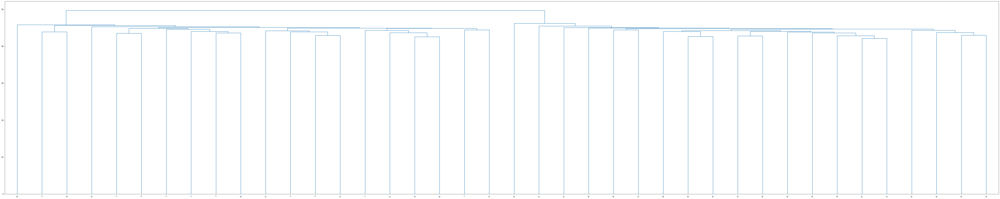

In [62]:
Z5 = hierarchy.linkage(np.array(data.T), 'average', 'euclidean')
plt.figure(figsize=(100, 20))
dn = hierarchy.dendrogram(Z5)
plt.show()

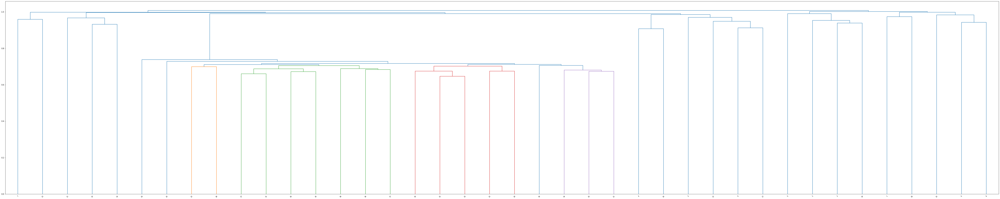

In [63]:
Z6 = hierarchy.linkage(np.array(data.T), 'average', 'correlation')
plt.figure(figsize=(100, 20))
dn = hierarchy.dendrogram(Z6)
plt.show()

# part f

In [73]:
data = scipy.io.loadmat('two_spiral.mat')
mat = scipy.io.loadmat('two_spiral.mat')
mat = {k:v for k, v in mat.items() if k[0] != '_'}
for k,v in mat.items():
    z=v[0]
df = pd.DataFrame(z[0][0], 
             columns=['x', 'y'])
df

,x,y
0,-12.600745,0.857422
1,9.043950,-3.787806
2,-10.921683,-5.092583
3,7.742325,4.754169
4,-4.341004,-10.375196
...,...,...
1995,-7.872228,-3.945092
1996,5.704146,10.172922
1997,11.153319,-6.871548
1998,7.098060,9.271025


Text(0.5, 1.0, 'Input Data')

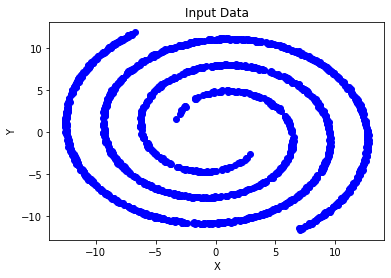

In [74]:
plt.plot(df.iloc[:, 0], df.iloc[:, 1], 'bo')
plt.xlabel('X')
plt.ylabel('Y')
plt.title('Input Data')

In [75]:
def euc_dist(a, b, ax=1):
    return np.linalg.norm(a - b, axis=ax)

In [77]:
def kmeans_clustering(data, k):
    c_x = np.random.randint(np.min(data[:, 0]), np.max(data[:, 0]), size=k)
    c_y = np.random.randint(np.min(data[:, 1]), np.max(data[:, 1]), size=k)
    centers = [list(a) for a in zip(c_x, c_y)]
    plt.scatter(data[:, 0], data[:, 1], c='#050505', s=7)
    plt.scatter(c_x, c_y, marker='*', s=200, c='g')
    plt.title('original data with initialized random centroids')
    plt.xlabel('feature1')
    plt.ylabel('feature2')

    new_centers = []
    while not np.array_equal(new_centers, np.array(centers)):
        if new_centers:
            centers = new_centers
            new_centers = []

        clusters = np.zeros(len(data))
        for i in range(len(data)):
            distances = euc_dist(data[i], centers)
            cluster = np.argmin(distances)
            clusters[i] = cluster
        colors = ['r', 'g', 'b', 'y', 'c', 'm', 'k']
        fig, ax = plt.subplots()
        for i in range(k):
            points = np.array([data[j] for j in range(len(data)) if clusters[j] == i])
            new_centers.append(np.mean(points, axis=0))
            ax.scatter(points[:, 0], points[:, 1], s=7, c=colors[i])

        ax.scatter(np.array(centers)[:, 0], np.array(centers)[:, 1], marker='*', s=200, c='#FFDEAD')
        plt.title('kmeans clustering with k=' + str(k))
        plt.xlabel('feature1')
        plt.ylabel('feature2')
        plt.show()

    return clusters

In [78]:
def find_minimum_index(distances):
    min_row_index = 0
    min_col_index = 0
    min_value = math.inf
    for i in range(len(distances)):
        for j in range(len(distances[i])):
            if distances[i][j] < min_value and i != j:
                min_row_index = i
                min_col_index = j
                min_value = distances[i][j]
    return min_row_index, min_col_index


def hierarchical_bottom_up_clustering(data):
    result = []
    clusters = np.zeros(len(data))
    for i in range(len(data)):
        clusters[i] = i
    distances = [[0 for x in range(len(data))] for y in range(len(data))]
    for i in range(len(data)):
        for j in range(len(data)):
            distances[i][j] = euc_dist(data[i], data[j], None)

    for k in range(len(data) - 1):
        min_row_index, min_col_index = find_minimum_index(distances)
        for i in range(len(clusters)):
            if clusters[i] == min_col_index:
                clusters[i] = min_row_index
            if clusters[i] > min_col_index:
                clusters[i] -= 1

        if k == len(data) - 3:
            result = clusters.copy()
            colors = ['r', 'g']
            fig, ax = plt.subplots()
            for i in range(2):
                points = np.array([data[j] for j in range(len(data)) if clusters[j] == i])
                ax.scatter(points[:, 0], points[:, 1], s=7, c=colors[i])
            plt.title('hierarchical clustering(single linkage) with two cluster')
            plt.xlabel('feature1')
            plt.ylabel('feature2')
            plt.show()
        distances = single_linkage(distances, min_row_index, min_col_index)
    return result

In [79]:
def hierarchical_bottom_up_clustering2(data):
    result = []
    clusters = np.zeros(len(data))
    for i in range(len(data)):
        clusters[i] = i

    distances = [[0 for x in range(len(data))] for y in range(len(data))]
    for i in range(len(data)):
        for j in range(len(data)):
            distances[i][j] = euc_dist(data[i], data[j], None)

    for k in range(len(data) - 1):
        min_row_index, min_col_index = find_minimum_index(distances)
        for i in range(len(clusters)):
            if clusters[i] == min_col_index:
                clusters[i] = min_row_index
            if clusters[i] > min_col_index:
                clusters[i] -= 1
            if k == len(data) - 3:
            result = clusters.copy()
            colors = ['r', 'g']
            fig, ax = plt.subplots()
            for i in range(2):
                points = np.array([data[j] for j in range(len(data)) if clusters[j] == i])
                ax.scatter(points[:, 0], points[:, 1], s=7, c=colors[i])
            plt.title('hierarchical clustering(complete linkage) with two cluster')
            plt.xlabel('feature1')
            plt.ylabel('feature2')
            plt.show()
        distances = complete_linkage(distances, min_row_index, min_col_index)
    return result

In [80]:
def complete_linkage(dist, c1, c2):
    distances = dist
    col1 = dist[:][c1]
    col2 = dist[:][c2]
    col1 = np.delete(col1, c2, 0)
    col2 = np.delete(col2, c2, 0)
    distances = np.delete(distances, c2, 0)
    distances = np.delete(distances, c2, 1)
    for i in range(0, c1):
        distances[c1][i] = np.max([dist[c1][i], dist[c2][i]])
        distances[i][c1] = np.max([dist[c1][i], dist[c2][i]])
    distances[c1][c1] = 0
    for i in range(c1 + 1, len(distances)):
        distances[c1][i] = np.max([col1[i], col2[i]])
        distances[i][c1] = np.max([col1[i], col2[i]])
    return distances


In [81]:
def single_linkage(dist, c1, c2):
    distances = dist
    col1 = dist[:][c1]
    col2 = dist[:][c2]
    col1 = np.delete(col1, c2, 0)
    col2 = np.delete(col2, c2, 0)
    distances = np.delete(distances, c2, 0)
    distances = np.delete(distances, c2, 1)
    for i in range(0, c1):
        distances[c1][i] = np.min([dist[c1][i], dist[c2][i]])
        distances[i][c1] = np.min([dist[c1][i], dist[c2][i]])
    distances[c1][c1] = 0
    for i in range(c1 + 1, len(distances)):
        distances[c1][i] = np.min([col1[i], col2[i]])
        distances[i][c1] = np.min([col1[i], col2[i]])
    return distances

In [82]:
def purity_score(y_true, y_pred):
    contingency_matrix = metrics.cluster.contingency_matrix(y_true, y_pred)
    return np.sum(np.amax(contingency_matrix, axis=0)) / np.sum(contingency_matrix) 

In [83]:
np.array(df)[:, :2]

array([[-12.60074484,   0.85742237],
       [  9.04395005,  -3.78780621],
       [-10.9216829 ,  -5.09258338],
       ...,
       [ 11.15331884,  -6.87154829],
       [  7.09806018,   9.27102461],
       [ -4.27935268,   9.67005977]])

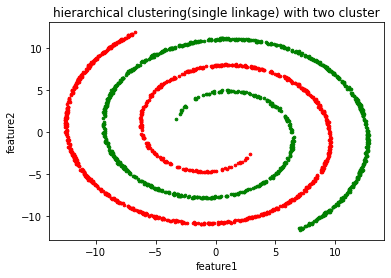

In [85]:
result = hierarchical_bottom_up_clustering(np.array(df)[:, :2])

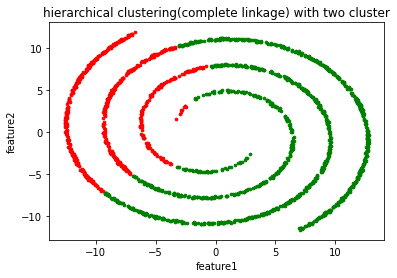

In [86]:
result2 = hierarchical_bottom_up_clustering2(np.array(df)[:, :2])

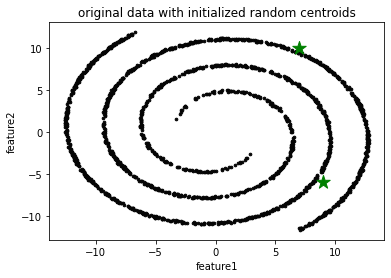

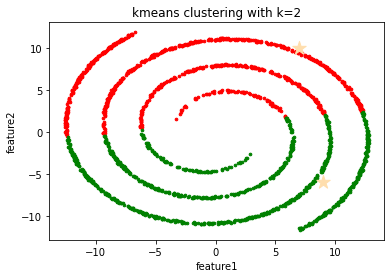

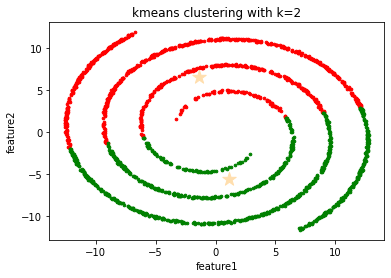

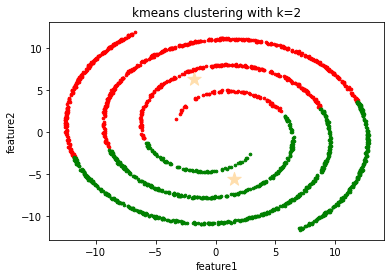

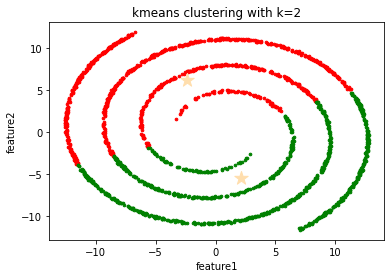

...

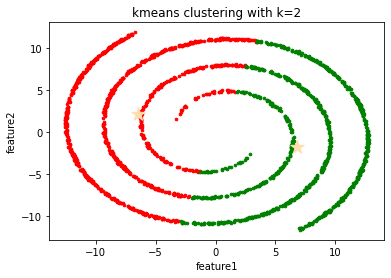

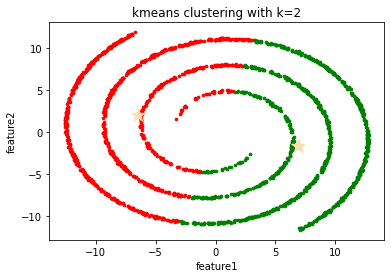

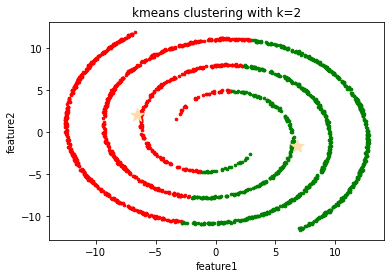

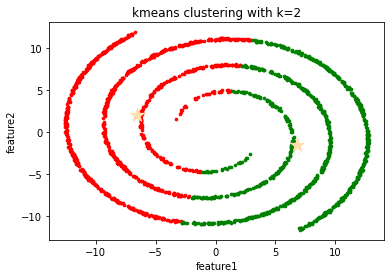

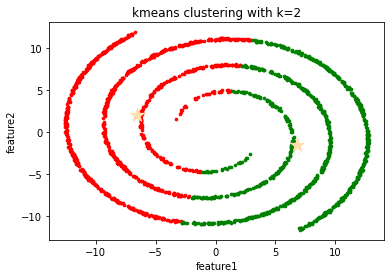

In [87]:
result3 = kmeans_clustering(np.array(df)[:, :2], 2)

In [88]:
df2 = pd.DataFrame(z[0][1], 
             columns=['label'])
df2 -=1
data=np.array(df2)
data_label=data.reshape(2000,)

In [94]:
print('\nsingle linkage:', normalized_mutual_info_score(data_label, result))
print('score of single linkage:', purity_score(data_label, result))
print('\ncomplete linkage:', normalized_mutual_info_score(data_label, result2))
print('score of complete linkage:', purity_score(data_label, result2))
print('\nkmeans:', normalized_mutual_info_score(data_label, result3))
print('score of kmeans:', purity_score(data_label, result3))


single linkage: 1.0
score of single linkage: 1.0

complete linkage: 0.036320148104460596
score of complete linkage: 0.6045

kmeans: 0.023528929442967347
score of kmeans: 0.59
